Première étape on installe les programmes nécéssaires à l'entrainement de l'IA

In [10]:
!pip install stable-baselines3
!pip install gym
!pip install matplotlib

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [2]:
import gymnasium as gym
# On import la librairie gymnasium qu'on renome gym dans le contexte d'execution du fichier

from stable_baselines3 import DQN
# Ici on import de la librairie stable_baselines3 l'object DQN



## Environement 

L'environement est élément avec lequel l'IA va intéragir.
Cette environement peut représenter un jeu vidéo, une simulation de déplacement de piéton.

Durant ce stage, nous allons utiliser la librairie **gym**. Qui met à disposition à un ensemble d'environement sur lequels nous pouvons entrainer une IA. 

https://www.gymlibrary.dev/environments/atari/
https://www.gymlibrary.dev/environments/mujoco/

### CartPole

In [14]:
env = gym.make("CartPole-v1", render_mode="human") 


Ici on instancie l'environement, il s'agit de l'environement suivant.
https://www.gymlibrary.dev/environments/classic_control/cart_pole/
Qui représente un pendule est l'objectif est de ne pas faire tomber le baton.
**render_mode** est un argument permetant d'afficher l'environement au sens graphique du terme.

le lien ci dessous définit l'ensemble des méthodes de l'environement

https://www.gymlibrary.dev/api/core/

### Espace d'action 

L'environement définit un espace d'action, ça corresponds au action que nous pouvons faire pour interagir avec l'environement.

Si on étais sur mario, cela correspondrais au touche de la manette.

 **action_space** nous définit le type d'action.

In [15]:
env.action_space

Discrete(2)

Ici on nous que l'espace d'action est discret, l'opposé de continue ( valeur à virgule, par example la pédale d'accélération d'une voiture )

Dans notre cas l'IA peut faire deux choix à tous instant :
- aller à droite
- aller à gauche 

### Espace d'observation

L'espace d'observation, nous donne l'état de l'environement.  

Par example avec Mario l'espace d'observation pourrais être l'image du jeu. Grâce à cette image nous savons quand est-ce qu'il faut faire sauter mario ou non. 

Dans **observation_space**, nous donne les spécification de l'état, à quoi ressemble l'état. 

In [16]:
env.observation_space

Box([-4.8000002e+00 -3.4028235e+38 -4.1887903e-01 -3.4028235e+38], [4.8000002e+00 3.4028235e+38 4.1887903e-01 3.4028235e+38], (4,), float32)

Ici ça parrais complexe à lire, voir moche. 

C'est pouyr ça que nous allons regarder la documentation, qui est un plus belle.
https://www.gymlibrary.dev/environments/classic_control/cart_pole/#observation-space

Nous avons donc 4 informations étant des valeur continue :
- *cart position* : la position du cart
- *Cart Velocity* : la vitesse du cart
- *Pole Angle* : l'angle du baton
- *Pole Angular Velocity* : la vitesse de chute du baton





#### Donc à partir de ces informations Quelle action prendre Sébastien ? 



écrit ta réponse

Tu n'en sait rien et bien moi non plus. Et je n'y connais rien en physique. On va donc "demander" à l'IA de faire ce choix pour nous. Pour ça on doit définir l'objectif de notre système

### Récompense

 On peut vulgariser l'entrainement d'une IA à l'aide de la boite de skinner 
 
 !!! ATTENTION C'EST UNE VULGARISATION !!!!
 
 https://fr.wikipedia.org/wiki/Bo%C3%AEte_de_Skinner
 
 Vidéo de 3 minutes de la boite de skinner 
 
 https://www.youtube.com/watch?v=TuT2358C2bU
 
 Ainsi on va dirriger le comportement de notre IA en maximisant la fonction récompense. 
 
 Donc à chaque choix de l'IA l'environement va soit:
 - le récompenser
 - le punir
 

In [17]:
env.reward_range

(-inf, inf)

Ici la récompense est continue et varie de - l'infinie à + l'infinie.

Si on regarde la documentation à la récompense est 1 si le baton n'est pas tombé sinon 0

## Deep Reinforcement Learning

Afin de déterminer l'action à prendre en fonction de l'état qui maximise la récompense. 

Pendant ton stage tu va utiliser des solutions de Deep Reinforcement Learning. Tu utiliseras une librairie python **stable_baseline3** qui stocke un ensemble d'algorithm de **deep reinforcement learning**, qui te permettras d'utiliser ces algorithmes comme des boites noires ( au sens où tu ne connais pas le comportement de ces boites )

**Deep** veut dire qu'on utilise des réseaux de neuronnes.

**Reinforcement Learning** veut dire  qu'on utilise des méthode d'apprentissage basé des récompense cumulative.

### DQN : Deep Q Network

Pendant ton stage tu utiliseras l'algorithm DQN pour Deep Q Network. Au vu du nom ça contiens un réseau de neuronnes. Il reste une lettre à définir le Q.

#### Q learning

Pour nous allons voir le grand père de cette algorithm le Q learning

Voici d'abbord quelques références : 
- https://www.datacamp.com/tutorial/introduction-q-learning-beginner-tutorial


##### Q Table 

le Q learning ce construit sur une Q table. C'est une tableau à deux dimension. Chaque collones corresponds à une action, chaque ligne à un état. La valeur d'un cases action, état corresponds à l'espérance de récompense pour ce couple. 

Ainsi le principe du Q learning est de tester beaucoup de combinaison d'état,action afin de remplir ce tableau. Lorsque l'IA devras choisir une action çà l'aide du Q-learning il prendras l'action qui à la plus grande espérance de récompense pour l'état courrant. 

##### Limites

Cependant lorsque l'environement définie un espace d'observation continue ( un angle, une distance ... ). Il faut convertir ces valeur continue en valeur discrète et donc perdre de la précision et avoir un Q table de plus en plus en fonction de la précision voulue. 

####  DQN 

Pour pallier à ce problème, on utilise des réseaux de neuronnes permettant d'accepter des valeurs et d'obtenir le compromis forte précision et espace mémoire.

Pour sélectionner la meilleur action, le principe reste le même. Le réseau de neuronnes prends en paramètres l'état de l'environement et renvoie pour chaque action l'espérance de récompense. Et donc l'agent choisie l'action avec la plus haute espérance.



## Entrainement de l'agent

Il faut d'abbord commencer par entrainer l'agent/IA. C'est à dire à chaque étape l'agent va prendre un choix et obtenir une récompense puis mettre à jours son réseaux de neuronnes afin de maximiser la récompense.

Le code vient de & la docs ce trouve sur :

https://stable-baselines3.readthedocs.io/en/master/modules/dqn.html

Tu auras des explications sur les paramètres et leur usages

In [ ]:
learning_rate = 0.0001
gamma=0.99

In [6]:
import os
import gymnasium as gym
from stable_baselines3 import DQN
from stable_baselines3.common.monitor import Monitor
from logging_utils import SaveOnBestTrainingRewardCallback

log_dir = "/tmp/gym/DQN/CartPole"
os.makedirs(log_dir, exist_ok=True)

env = gym.make("CartPole-v1", # name of your gym environement  
               render_mode=None,#"human"
              )
env = Monitor(env, log_dir)

callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir)
model = DQN("MlpPolicy", # type de réseaux de neuronnes 
            env, # passe l'environement
            verbose=1, # mode verbeux ( affiche plus d'information )
            learning_rate=learning_rate, # un paramètre que tu devras tester
    gamma=gamma, # un paramètre que tu devras tester 
           )
trained_model = model.learn(
    total_timesteps=100000, # temps d'entrainement
    log_interval=4, # intervalle de remonter des données
    callback=callback, # Utiliser pour stocker des métriques
    
) 
# renvoie un modèle entrainé
model.save("dqn_cartpole") # sauvegarde le modèle entrainé dans un fichier
model = DQN.load("dqn_cartpole") # charge le fichier

Using cpu device
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.5     |
|    ep_rew_mean      | 24.5     |
|    exploration_rate | 0.991    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 23150    |
|    time_elapsed     | 0        |
|    total_timesteps  | 98       |
----------------------------------
Num timesteps: 100
Best mean reward: -inf - Last mean reward per episode: 24.50
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean      | 21.2     |
|    exploration_rate | 0.984    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 12968    |
|    time_elapsed     | 0        |
|    total_timesteps  | 170      |
----------------------------------
Num timesteps: 200
Best mean reward: 24.

Num timesteps: 1700
Best mean reward: 26.65 - Last mean reward per episode: 23.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.3     |
|    ep_rew_mean      | 23.3     |
|    exploration_rate | 0.832    |
| time/               |          |
|    episodes         | 76       |
|    fps              | 12466    |
|    time_elapsed     | 0        |
|    total_timesteps  | 1770     |
----------------------------------
Num timesteps: 1800
Best mean reward: 26.65 - Last mean reward per episode: 23.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23       |
|    exploration_rate | 0.825    |
| time/               |          |
|    episodes         | 80       |
|    fps              | 12358    |
|    time_elapsed     | 0        |
|    total_timesteps  | 1843     |
----------------------------------
Num timesteps: 1900
Best mean reward: 26.65 - Last mean reward per

Num timesteps: 3300
Best mean reward: 26.65 - Last mean reward per episode: 21.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.684    |
| time/               |          |
|    episodes         | 148      |
|    fps              | 12738    |
|    time_elapsed     | 0        |
|    total_timesteps  | 3329     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.678    |
| time/               |          |
|    episodes         | 152      |
|    fps              | 12811    |
|    time_elapsed     | 0        |
|    total_timesteps  | 3391     |
----------------------------------
Num timesteps: 3400
Best mean reward: 26.65 - Last mean reward per episode: 21.41
----------------------------------
| rollout/            |        

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.535    |
| time/               |          |
|    episodes         | 224      |
|    fps              | 12819    |
|    time_elapsed     | 0        |
|    total_timesteps  | 4895     |
----------------------------------
Num timesteps: 4900
Best mean reward: 26.65 - Last mean reward per episode: 21.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean      | 21.6     |
|    exploration_rate | 0.529    |
| time/               |          |
|    episodes         | 228      |
|    fps              | 12780    |
|    time_elapsed     | 0        |
|    total_timesteps  | 4957     |
----------------------------------
Num timesteps: 5000
Best mean reward: 26.65 - Last mean reward per episode: 21.48
----------------------------------
| rollout/            |        

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.388    |
| time/               |          |
|    episodes         | 296      |
|    fps              | 12653    |
|    time_elapsed     | 0        |
|    total_timesteps  | 6445     |
----------------------------------
Num timesteps: 6500
Best mean reward: 26.65 - Last mean reward per episode: 21.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.378    |
| time/               |          |
|    episodes         | 300      |
|    fps              | 12666    |
|    time_elapsed     | 0        |
|    total_timesteps  | 6547     |
----------------------------------
Num timesteps: 6600
Best mean reward: 26.65 - Last mean reward per episode: 21.43
----------------------------------
| rollout/            |        

Num timesteps: 8100
Best mean reward: 26.65 - Last mean reward per episode: 21.39
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.228    |
| time/               |          |
|    episodes         | 372      |
|    fps              | 12662    |
|    time_elapsed     | 0        |
|    total_timesteps  | 8125     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.7     |
|    ep_rew_mean      | 20.7     |
|    exploration_rate | 0.224    |
| time/               |          |
|    episodes         | 376      |
|    fps              | 12671    |
|    time_elapsed     | 0        |
|    total_timesteps  | 8170     |
----------------------------------
Num timesteps: 8200
Best mean reward: 26.65 - Last mean reward per episode: 20.89
----------------------------------
| rollout/            |        

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.1     |
|    ep_rew_mean      | 21.1     |
|    exploration_rate | 0.0802   |
| time/               |          |
|    episodes         | 448      |
|    fps              | 12547    |
|    time_elapsed     | 0        |
|    total_timesteps  | 9682     |
----------------------------------
Num timesteps: 9700
Best mean reward: 26.65 - Last mean reward per episode: 21.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.072    |
| time/               |          |
|    episodes         | 452      |
|    fps              | 12461    |
|    time_elapsed     | 0        |
|    total_timesteps  | 9768     |
----------------------------------
Num timesteps: 9800
Best mean reward: 26.65 - Last mean reward per episode: 20.79
----------------------------------
| rollout/            |        

Num timesteps: 11200
Best mean reward: 26.65 - Last mean reward per episode: 21.63
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.9     |
|    ep_rew_mean      | 20.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 524      |
|    fps              | 11953    |
|    time_elapsed     | 0        |
|    total_timesteps  | 11253    |
----------------------------------
Num timesteps: 11300
Best mean reward: 26.65 - Last mean reward per episode: 21.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.9     |
|    ep_rew_mean      | 20.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 528      |
|    fps              | 11926    |
|    time_elapsed     | 0        |
|    total_timesteps  | 11364    |
----------------------------------
Num timesteps: 11400
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 12900
Best mean reward: 26.65 - Last mean reward per episode: 22.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 596      |
|    fps              | 11930    |
|    time_elapsed     | 1        |
|    total_timesteps  | 12972    |
----------------------------------
Num timesteps: 13000
Best mean reward: 26.65 - Last mean reward per episode: 22.39
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 600      |
|    fps              | 11923    |
|    time_elapsed     | 1        |
|    total_timesteps  | 13036    |
----------------------------------
Num timesteps: 13100
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 14500
Best mean reward: 26.65 - Last mean reward per episode: 22.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 668      |
|    fps              | 11849    |
|    time_elapsed     | 1        |
|    total_timesteps  | 14557    |
----------------------------------
Num timesteps: 14600
Best mean reward: 26.65 - Last mean reward per episode: 22.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 672      |
|    fps              | 11833    |
|    time_elapsed     | 1        |
|    total_timesteps  | 14635    |
----------------------------------
Num timesteps: 14700
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 16100
Best mean reward: 26.65 - Last mean reward per episode: 22.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 740      |
|    fps              | 11865    |
|    time_elapsed     | 1        |
|    total_timesteps  | 16140    |
----------------------------------
Num timesteps: 16200
Best mean reward: 26.65 - Last mean reward per episode: 22.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 744      |
|    fps              | 11862    |
|    time_elapsed     | 1        |
|    total_timesteps  | 16238    |
----------------------------------
Num timesteps: 16300
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 17800
Best mean reward: 26.65 - Last mean reward per episode: 23.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 812      |
|    fps              | 11723    |
|    time_elapsed     | 1        |
|    total_timesteps  | 17873    |
----------------------------------
Num timesteps: 17900
Best mean reward: 26.65 - Last mean reward per episode: 23.59
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.8     |
|    ep_rew_mean      | 23.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 816      |
|    fps              | 11712    |
|    time_elapsed     | 1        |
|    total_timesteps  | 17950    |
----------------------------------
Num timesteps: 18000
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 19400
Best mean reward: 26.65 - Last mean reward per episode: 22.20
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 884      |
|    fps              | 11811    |
|    time_elapsed     | 1        |
|    total_timesteps  | 19470    |
----------------------------------
Num timesteps: 19500
Best mean reward: 26.65 - Last mean reward per episode: 22.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 888      |
|    fps              | 11821    |
|    time_elapsed     | 1        |
|    total_timesteps  | 19576    |
----------------------------------
Num timesteps: 19600
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 21000
Best mean reward: 26.65 - Last mean reward per episode: 21.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 956      |
|    fps              | 11794    |
|    time_elapsed     | 1        |
|    total_timesteps  | 21042    |
----------------------------------
Num timesteps: 21100
Best mean reward: 26.65 - Last mean reward per episode: 21.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean      | 21.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 960      |
|    fps              | 11795    |
|    time_elapsed     | 1        |
|    total_timesteps  | 21104    |
----------------------------------
----------------------------------
| rollout/            |      

Num timesteps: 22600
Best mean reward: 26.65 - Last mean reward per episode: 22.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1028     |
|    fps              | 11820    |
|    time_elapsed     | 1        |
|    total_timesteps  | 22669    |
----------------------------------
Num timesteps: 22700
Best mean reward: 26.65 - Last mean reward per episode: 22.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1032     |
|    fps              | 11825    |
|    time_elapsed     | 1        |
|    total_timesteps  | 22747    |
----------------------------------
Num timesteps: 22800
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 24300
Best mean reward: 26.65 - Last mean reward per episode: 23.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1100     |
|    fps              | 11904    |
|    time_elapsed     | 2        |
|    total_timesteps  | 24386    |
----------------------------------
Num timesteps: 24400
Best mean reward: 26.65 - Last mean reward per episode: 23.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean      | 23.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1104     |
|    fps              | 11911    |
|    time_elapsed     | 2        |
|    total_timesteps  | 24493    |
----------------------------------
Num timesteps: 24500
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 25900
Best mean reward: 26.65 - Last mean reward per episode: 22.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1176     |
|    fps              | 11831    |
|    time_elapsed     | 2        |
|    total_timesteps  | 25951    |
----------------------------------
Num timesteps: 26000
Best mean reward: 26.65 - Last mean reward per episode: 20.95
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.9     |
|    ep_rew_mean      | 20.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1180     |
|    fps              | 11807    |
|    time_elapsed     | 2        |
|    total_timesteps  | 26002    |
----------------------------------
Num timesteps: 26100
Best mean reward: 26.65 - Last mean reward 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1248     |
|    fps              | 11751    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27455    |
----------------------------------
Num timesteps: 27500
Best mean reward: 26.65 - Last mean reward per episode: 20.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1252     |
|    fps              | 11752    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27534    |
----------------------------------
Num timesteps: 27600
Best mean reward: 26.65 - Last mean reward per episode: 20.70
----------------------------------
| rollout/            |      

Num timesteps: 29100
Best mean reward: 26.65 - Last mean reward per episode: 21.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1324     |
|    fps              | 11765    |
|    time_elapsed     | 2        |
|    total_timesteps  | 29106    |
----------------------------------
Num timesteps: 29200
Best mean reward: 26.65 - Last mean reward per episode: 21.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1328     |
|    fps              | 11767    |
|    time_elapsed     | 2        |
|    total_timesteps  | 29243    |
----------------------------------
Num timesteps: 29300
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 30700
Best mean reward: 26.65 - Last mean reward per episode: 21.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1396     |
|    fps              | 11780    |
|    time_elapsed     | 2        |
|    total_timesteps  | 30741    |
----------------------------------
Num timesteps: 30800
Best mean reward: 26.65 - Last mean reward per episode: 21.45
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1400     |
|    fps              | 11763    |
|    time_elapsed     | 2        |
|    total_timesteps  | 30801    |
----------------------------------
----------------------------------
| rollout/            |      

Num timesteps: 32500
Best mean reward: 26.65 - Last mean reward per episode: 24.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24       |
|    ep_rew_mean      | 24       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1468     |
|    fps              | 11846    |
|    time_elapsed     | 2        |
|    total_timesteps  | 32552    |
----------------------------------
Num timesteps: 32600
Best mean reward: 26.65 - Last mean reward per episode: 24.13
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean      | 24.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1472     |
|    fps              | 11846    |
|    time_elapsed     | 2        |
|    total_timesteps  | 32630    |
----------------------------------
----------------------------------
| rollout/            |      

Num timesteps: 34100
Best mean reward: 26.65 - Last mean reward per episode: 23.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1540     |
|    fps              | 11904    |
|    time_elapsed     | 2        |
|    total_timesteps  | 34137    |
----------------------------------
Num timesteps: 34200
Best mean reward: 26.65 - Last mean reward per episode: 22.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1544     |
|    fps              | 11904    |
|    time_elapsed     | 2        |
|    total_timesteps  | 34204    |
----------------------------------
Num timesteps: 34300
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 35700
Best mean reward: 26.65 - Last mean reward per episode: 22.26
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1612     |
|    fps              | 11949    |
|    time_elapsed     | 2        |
|    total_timesteps  | 35713    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1616     |
|    fps              | 11961    |
|    time_elapsed     | 2        |
|    total_timesteps  | 35796    |
----------------------------------
Num timesteps: 35800
Best mean reward: 26.65 - Last mean reward per episode: 22.32
Num timesteps: 35900
Best mean reward: 26.65 - Last mean reward 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1684     |
|    fps              | 11911    |
|    time_elapsed     | 3        |
|    total_timesteps  | 37255    |
----------------------------------
Num timesteps: 37300
Best mean reward: 26.65 - Last mean reward per episode: 22.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1688     |
|    fps              | 11891    |
|    time_elapsed     | 3        |
|    total_timesteps  | 37332    |
----------------------------------
Num timesteps: 37400
Best mean reward: 26.65 - Last mean reward per episode: 22.10
----------------------------------
| rollout/            |      

Num timesteps: 38900
Best mean reward: 26.65 - Last mean reward per episode: 22.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1756     |
|    fps              | 11881    |
|    time_elapsed     | 3        |
|    total_timesteps  | 38910    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1760     |
|    fps              | 11891    |
|    time_elapsed     | 3        |
|    total_timesteps  | 38992    |
----------------------------------
Num timesteps: 39000
Best mean reward: 26.65 - Last mean reward per episode: 22.69
----------------------------------
| rollout/            |      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1828     |
|    fps              | 11860    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40576    |
----------------------------------
Num timesteps: 40600
Best mean reward: 26.65 - Last mean reward per episode: 22.95
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1832     |
|    fps              | 11862    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40653    |
----------------------------------
Num timesteps: 40700
Best mean reward: 26.65 - Last mean reward per episode: 22.68
----------------------------------
| rollout/            |      

Num timesteps: 42200
Best mean reward: 26.65 - Last mean reward per episode: 23.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1900     |
|    fps              | 11867    |
|    time_elapsed     | 3        |
|    total_timesteps  | 42254    |
----------------------------------
Num timesteps: 42300
Best mean reward: 26.65 - Last mean reward per episode: 22.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1904     |
|    fps              | 11865    |
|    time_elapsed     | 3        |
|    total_timesteps  | 42366    |
----------------------------------
Num timesteps: 42400
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 43800
Best mean reward: 26.65 - Last mean reward per episode: 22.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1972     |
|    fps              | 11847    |
|    time_elapsed     | 3        |
|    total_timesteps  | 43871    |
----------------------------------
Num timesteps: 43900
Best mean reward: 26.65 - Last mean reward per episode: 22.44
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 1976     |
|    fps              | 11853    |
|    time_elapsed     | 3        |
|    total_timesteps  | 43993    |
----------------------------------
Num timesteps: 44000
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 45400
Best mean reward: 26.65 - Last mean reward per episode: 21.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2044     |
|    fps              | 11816    |
|    time_elapsed     | 3        |
|    total_timesteps  | 45442    |
----------------------------------
Num timesteps: 45500
Best mean reward: 26.65 - Last mean reward per episode: 21.62
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2048     |
|    fps              | 11813    |
|    time_elapsed     | 3        |
|    total_timesteps  | 45554    |
----------------------------------
Num timesteps: 45600
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 47200
Best mean reward: 26.65 - Last mean reward per episode: 23.77
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2116     |
|    fps              | 11826    |
|    time_elapsed     | 3        |
|    total_timesteps  | 47216    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2120     |
|    fps              | 11833    |
|    time_elapsed     | 3        |
|    total_timesteps  | 47298    |
----------------------------------
Num timesteps: 47300
Best mean reward: 26.65 - Last mean reward per episode: 23.66
Num timesteps: 47400
Best mean reward: 26.65 - Last mean reward 

Num timesteps: 48800
Best mean reward: 26.65 - Last mean reward per episode: 21.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2192     |
|    fps              | 11815    |
|    time_elapsed     | 4        |
|    total_timesteps  | 48860    |
----------------------------------
Num timesteps: 48900
Best mean reward: 26.65 - Last mean reward per episode: 21.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2196     |
|    fps              | 11815    |
|    time_elapsed     | 4        |
|    total_timesteps  | 48936    |
----------------------------------
Num timesteps: 49000
Best mean reward: 26.65 - Last mean reward 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.6     |
|    ep_rew_mean      | 18.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2264     |
|    fps              | 11479    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50164    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.454    |
|    n_updates        | 40       |
----------------------------------
Num timesteps: 50200
Best mean reward: 26.65 - Last mean reward per episode: 18.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.3     |
|    ep_rew_mean      | 18.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2268     |
|    fps              | 11382    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50205    |
| train/              |          |
|    le

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.9     |
|    ep_rew_mean      | 12.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2324     |
|    fps              | 10386    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50759    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.162    |
|    n_updates        | 189      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2328     |
|    fps              | 10328    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50797    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.147    |
|    n_updates      

Num timesteps: 51300
Best mean reward: 26.65 - Last mean reward per episode: 9.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 9.66     |
|    ep_rew_mean      | 9.66     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2384     |
|    fps              | 9575     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51330    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0262   |
|    n_updates        | 332      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 9.62     |
|    ep_rew_mean      | 9.62     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2388     |
|    fps              | 9531     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51366    |
| train/              |          |
|    lea

Num timesteps: 52500
Best mean reward: 26.65 - Last mean reward per episode: 15.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.3     |
|    ep_rew_mean      | 16.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2440     |
|    fps              | 8298     |
|    time_elapsed     | 6        |
|    total_timesteps  | 52536    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00647  |
|    n_updates        | 633      |
----------------------------------
Num timesteps: 52600
Best mean reward: 26.65 - Last mean reward per episode: 16.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.9     |
|    ep_rew_mean      | 16.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2444     |
|    fps              | 8203     |
|    time_elapsed     | 6    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.5     |
|    ep_rew_mean      | 24.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2496     |
|    fps              | 7246     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53890    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000645 |
|    n_updates        | 972      |
----------------------------------
Num timesteps: 53900
Best mean reward: 26.65 - Last mean reward per episode: 24.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25       |
|    ep_rew_mean      | 25       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2500     |
|    fps              | 7187     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53978    |
| train/              |          |
|    le

Num timesteps: 55000
Best mean reward: 26.76 - Last mean reward per episode: 22.67
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2552     |
|    fps              | 6642     |
|    time_elapsed     | 8        |
|    total_timesteps  | 55062    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000297 |
|    n_updates        | 1265     |
----------------------------------
Num timesteps: 55100
Best mean reward: 26.76 - Last mean reward per episode: 22.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2556     |
|    fps              | 6599     |
|    time_elapsed     | 8    

Num timesteps: 56200
Best mean reward: 26.76 - Last mean reward per episode: 21.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2608     |
|    fps              | 5910     |
|    time_elapsed     | 9        |
|    total_timesteps  | 56289    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000497 |
|    n_updates        | 1572     |
----------------------------------
Num timesteps: 56300
Best mean reward: 26.76 - Last mean reward per episode: 21.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2612     |
|    fps              | 5866     |
|    time_elapsed     | 9    

Num timesteps: 57700
Best mean reward: 26.76 - Last mean reward per episode: 24.39
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.6     |
|    ep_rew_mean      | 24.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2664     |
|    fps              | 5279     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57760    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000163 |
|    n_updates        | 1939     |
----------------------------------
Num timesteps: 57800
Best mean reward: 26.76 - Last mean reward per episode: 24.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.9     |
|    ep_rew_mean      | 24.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2668     |
|    fps              | 5238     |
|    time_elapsed     | 11   

Num timesteps: 59200
Best mean reward: 27.28 - Last mean reward per episode: 27.30
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 27.3     |
|    ep_rew_mean      | 27.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2716     |
|    fps              | 4800     |
|    time_elapsed     | 12       |
|    total_timesteps  | 59227    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 4.43e-05 |
|    n_updates        | 2306     |
----------------------------------
Num timesteps: 59300
Best mean reward: 27.30 - Last mean reward per episode: 27.42
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 27.4     |
|    ep_rew_mean      | 27.4     |
|    exploration_rate | 0.05     |
| time/           

Num timesteps: 60800
Best mean reward: 30.35 - Last mean reward per episode: 30.75
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 31.2     |
|    ep_rew_mean      | 31.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2764     |
|    fps              | 4361     |
|    time_elapsed     | 13       |
|    total_timesteps  | 60878    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0369   |
|    n_updates        | 2719     |
----------------------------------
Num timesteps: 60900
Best mean reward: 30.75 - Last mean reward per episode: 31.18
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 31.1     |
|    ep_rew_mean      | 31.1     |
|    exploration_rate | 0.05     |
| time/           

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25.3     |
|    ep_rew_mean      | 25.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2820     |
|    fps              | 4134     |
|    time_elapsed     | 14       |
|    total_timesteps  | 61876    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0164   |
|    n_updates        | 2968     |
----------------------------------
Num timesteps: 61900
Best mean reward: 31.18 - Last mean reward per episode: 25.31
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25       |
|    ep_rew_mean      | 25       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2824     |
|    fps              | 4116     |
|    time_elapsed     | 15       |
|    total_timesteps  | 61974    |
| train/              |          |
|    le

Num timesteps: 63100
Best mean reward: 31.18 - Last mean reward per episode: 19.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.7     |
|    ep_rew_mean      | 19.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2876     |
|    fps              | 3900     |
|    time_elapsed     | 16       |
|    total_timesteps  | 63110    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0096   |
|    n_updates        | 3277     |
----------------------------------
Num timesteps: 63200
Best mean reward: 31.18 - Last mean reward per episode: 19.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.3     |
|    ep_rew_mean      | 20.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2880     |
|    fps              | 3881     |
|    time_elapsed     | 16   

Num timesteps: 63900
Best mean reward: 31.18 - Last mean reward per episode: 17.05
Num timesteps: 64000
Best mean reward: 31.18 - Last mean reward per episode: 18.22
Num timesteps: 64100
Best mean reward: 31.18 - Last mean reward per episode: 18.86
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.4     |
|    ep_rew_mean      | 19.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2936     |
|    fps              | 3696     |
|    time_elapsed     | 17       |
|    total_timesteps  | 64157    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0019   |
|    n_updates        | 3539     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.2     |
|    ep_rew_mean      | 19.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes   

Num timesteps: 64800
Best mean reward: 31.18 - Last mean reward per episode: 14.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.3     |
|    ep_rew_mean      | 14.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 2996     |
|    fps              | 3594     |
|    time_elapsed     | 18       |
|    total_timesteps  | 64837    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0148   |
|    n_updates        | 3709     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.1     |
|    ep_rew_mean      | 14.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3000     |
|    fps              | 3588     |
|    time_elapsed     | 18       |
|    total_timesteps  | 64876    |
| train/              |          |
|    le

Num timesteps: 65400
Best mean reward: 31.18 - Last mean reward per episode: 10.76
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 10.8     |
|    ep_rew_mean      | 10.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3056     |
|    fps              | 3511     |
|    time_elapsed     | 18       |
|    total_timesteps  | 65433    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0151   |
|    n_updates        | 3858     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 10.7     |
|    ep_rew_mean      | 10.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3060     |
|    fps              | 3507     |
|    time_elapsed     | 18       |
|    total_timesteps  | 65468    |
| train/              |          |
|    le

Num timesteps: 66100
Best mean reward: 31.18 - Last mean reward per episode: 10.85
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 10.9     |
|    ep_rew_mean      | 10.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3116     |
|    fps              | 3425     |
|    time_elapsed     | 19       |
|    total_timesteps  | 66118    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.015    |
|    n_updates        | 4029     |
----------------------------------
Num timesteps: 66200
Best mean reward: 31.18 - Last mean reward per episode: 11.34
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.2     |
|    ep_rew_mean      | 11.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3120     |
|    fps              | 3414     |
|    time_elapsed     | 19   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.2     |
|    ep_rew_mean      | 14.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3176     |
|    fps              | 3317     |
|    time_elapsed     | 20       |
|    total_timesteps  | 67039    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00136  |
|    n_updates        | 4259     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.2     |
|    ep_rew_mean      | 14.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3180     |
|    fps              | 3312     |
|    time_elapsed     | 20       |
|    total_timesteps  | 67075    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000999 |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.2     |
|    ep_rew_mean      | 13.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3236     |
|    fps              | 3237     |
|    time_elapsed     | 20       |
|    total_timesteps  | 67774    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0177   |
|    n_updates        | 4443     |
----------------------------------
Num timesteps: 67800
Best mean reward: 31.18 - Last mean reward per episode: 13.15
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.2     |
|    ep_rew_mean      | 13.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3240     |
|    fps              | 3233     |
|    time_elapsed     | 20       |
|    total_timesteps  | 67811    |
| train/              |          |
|    le

Num timesteps: 68500
Best mean reward: 31.18 - Last mean reward per episode: 11.86
Num timesteps: 68600
Best mean reward: 31.18 - Last mean reward per episode: 11.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13       |
|    ep_rew_mean      | 13       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3296     |
|    fps              | 3142     |
|    time_elapsed     | 21       |
|    total_timesteps  | 68654    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0286   |
|    n_updates        | 4663     |
----------------------------------
Num timesteps: 68700
Best mean reward: 31.18 - Last mean reward per episode: 13.00
Num timesteps: 68800
Best mean reward: 31.18 - Last mean reward per episode: 13.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.6     |
|    ep_rew_mean      | 14.6     |
|  

Num timesteps: 69600
Best mean reward: 31.18 - Last mean reward per episode: 15.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.7     |
|    ep_rew_mean      | 15.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3352     |
|    fps              | 3049     |
|    time_elapsed     | 22       |
|    total_timesteps  | 69618    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00199  |
|    n_updates        | 4904     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.7     |
|    ep_rew_mean      | 15.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3356     |
|    fps              | 3044     |
|    time_elapsed     | 22       |
|    total_timesteps  | 69655    |
| train/              |          |
|    le

Num timesteps: 70400
Best mean reward: 31.18 - Last mean reward per episode: 14.03
Num timesteps: 70500
Best mean reward: 31.18 - Last mean reward per episode: 14.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15       |
|    ep_rew_mean      | 15       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3412     |
|    fps              | 2921     |
|    time_elapsed     | 24       |
|    total_timesteps  | 70510    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0934   |
|    n_updates        | 5127     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.4     |
|    ep_rew_mean      | 15.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3416     |
|    fps              | 2914     |
|    time_elapsed     | 24   

Num timesteps: 72100
Best mean reward: 31.18 - Last mean reward per episode: 23.39
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.8     |
|    ep_rew_mean      | 23.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3468     |
|    fps              | 2789     |
|    time_elapsed     | 25       |
|    total_timesteps  | 72143    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0104   |
|    n_updates        | 5535     |
----------------------------------
Num timesteps: 72200
Best mean reward: 31.18 - Last mean reward per episode: 23.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.9     |
|    ep_rew_mean      | 24.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3472     |
|    fps              | 2780     |
|    time_elapsed     | 26   

Num timesteps: 74000
Best mean reward: 33.39 - Last mean reward per episode: 33.47
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 33.4     |
|    ep_rew_mean      | 33.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3520     |
|    fps              | 2656     |
|    time_elapsed     | 27       |
|    total_timesteps  | 74030    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0384   |
|    n_updates        | 6007     |
----------------------------------
Num timesteps: 74100
Best mean reward: 33.47 - Last mean reward per episode: 33.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 33       |
|    ep_rew_mean      | 33       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3524     |
|    f

Num timesteps: 75800
Best mean reward: 36.71 - Last mean reward per episode: 37.35
Saving new best model to /tmp/gym/DQN/CartPole/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 37.4     |
|    ep_rew_mean      | 37.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3568     |
|    fps              | 2536     |
|    time_elapsed     | 29       |
|    total_timesteps  | 75879    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0335   |
|    n_updates        | 6469     |
----------------------------------
Num timesteps: 75900
Best mean reward: 37.35 - Last mean reward per episode: 37.36
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 76000
Best mean reward: 37.36 - Last mean reward per episode: 37.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 38       |
|    

Num timesteps: 78600
Best mean reward: 53.01 - Last mean reward per episode: 53.01
Num timesteps: 78700
Best mean reward: 53.01 - Last mean reward per episode: 53.01
Num timesteps: 78800
Best mean reward: 53.01 - Last mean reward per episode: 54.64
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 78900
Best mean reward: 54.64 - Last mean reward per episode: 54.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 56.1     |
|    ep_rew_mean      | 56.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3604     |
|    fps              | 2367     |
|    time_elapsed     | 33       |
|    total_timesteps  | 78987    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00524  |
|    n_updates        | 7246     |
----------------------------------
Num timesteps: 79000
Best mean reward: 54.64 - Last mean reward per episode: 56.06
Sa

Num timesteps: 82200
Best mean reward: 72.92 - Last mean reward per episode: 73.92
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 82300
Best mean reward: 73.92 - Last mean reward per episode: 74.83
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 82400
Best mean reward: 74.83 - Last mean reward per episode: 74.83
Num timesteps: 82500
Best mean reward: 74.83 - Last mean reward per episode: 74.83
Num timesteps: 82600
Best mean reward: 74.83 - Last mean reward per episode: 77.21
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 82700
Best mean reward: 77.21 - Last mean reward per episode: 77.21
Num timesteps: 82800
Best mean reward: 77.21 - Last mean reward per episode: 77.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 80       |
|    ep_rew_mean      | 80       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3640     |


Num timesteps: 86800
Best mean reward: 111.42 - Last mean reward per episode: 113.56
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 86900
Best mean reward: 113.56 - Last mean reward per episode: 113.56
Num timesteps: 87000
Best mean reward: 113.56 - Last mean reward per episode: 114.84
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 87100
Best mean reward: 114.84 - Last mean reward per episode: 114.87
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 87200
Best mean reward: 114.87 - Last mean reward per episode: 114.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 116      |
|    ep_rew_mean      | 116      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3664     |
|    fps              | 2094     |
|    time_elapsed     | 41       |
|    total_timesteps  | 87260    |
| train/              |          |
|    learning_ra

Num timesteps: 92000
Best mean reward: 147.81 - Last mean reward per episode: 147.81
Num timesteps: 92100
Best mean reward: 147.81 - Last mean reward per episode: 147.81
Num timesteps: 92200
Best mean reward: 147.81 - Last mean reward per episode: 152.34
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 92300
Best mean reward: 152.34 - Last mean reward per episode: 152.34
Num timesteps: 92400
Best mean reward: 152.34 - Last mean reward per episode: 152.34
Num timesteps: 92500
Best mean reward: 152.34 - Last mean reward per episode: 152.34
Num timesteps: 92600
Best mean reward: 152.34 - Last mean reward per episode: 154.63
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 92700
Best mean reward: 154.63 - Last mean reward per episode: 154.63
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 154      |
|    ep_rew_mean      | 154      |
|    exploration_rate | 0.05     |
| time/               |      

Num timesteps: 98400
Best mean reward: 198.81 - Last mean reward per episode: 198.81
Num timesteps: 98500
Best mean reward: 198.81 - Last mean reward per episode: 198.81
Num timesteps: 98600
Best mean reward: 198.81 - Last mean reward per episode: 201.72
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 98700
Best mean reward: 201.72 - Last mean reward per episode: 201.72
Num timesteps: 98800
Best mean reward: 201.72 - Last mean reward per episode: 201.72
Num timesteps: 98900
Best mean reward: 201.72 - Last mean reward per episode: 201.72
Num timesteps: 99000
Best mean reward: 201.72 - Last mean reward per episode: 201.72
Num timesteps: 99100
Best mean reward: 201.72 - Last mean reward per episode: 206.37
Saving new best model to /tmp/gym/DQN/CartPole/best_model
Num timesteps: 99200
Best mean reward: 206.37 - Last mean reward per episode: 206.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 208      |
|    ep_rew_me

### Afficher la récompense 

In [10]:
log_dir

'/tmp/gym/DQN/CartPole'

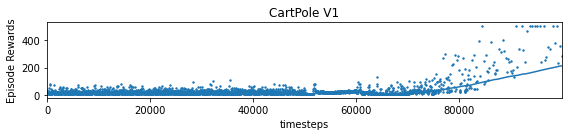

In [7]:
from stable_baselines3.common import results_plotter

# Helper from the library
results_plotter.plot_results(
    [log_dir], 1e5, results_plotter.X_TIMESTEPS, "CartPole V1"
)

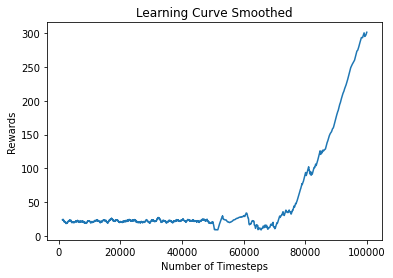

In [8]:
from logging_utils import plot_results
logs_dirs_with_tag = [(f"/tmp/gym/DQN/CartPole_lr-{lr}",lr) for lr in learning_rate]

plot_results(log_dir)

## Teste de l'agent 

Une fois l'agent entrainé il faut le tester et vérifier que le comportement obtenu est le bon ou proche du bon.

In [ ]:
obs, info = env.reset() # réinitialisation de l'environement 
# obs corresponds à l'observation 
# info contiens des information aditionelle
while True:
    action, _states = model.predict(obs, deterministic=True)  # le réseaux de neuronnes choisie une action
    obs, reward, terminated, truncated, info = env.step(action) # execute l'environemenet d'un step / d'un tour d'horloge
    if terminated or truncated:
        obs, info = env.reset()

## Display multiple parameters 



In [12]:
import os
import gymnasium as gym
from stable_baselines3 import DQN
from stable_baselines3.common.monitor import Monitor
from logging_utils import SaveOnBestTrainingRewardCallback

learning_rate = [0.1,0.01,0.001]
for lr in learning_rate:
    log_dir = f"/tmp/gym/DQN/CartPole_lr-{lr}"
    os.makedirs(log_dir, exist_ok=True)

    env = gym.make("CartPole-v1", # name of your gym environement  
                   render_mode=None,#"human"
                  )
    env = Monitor(env, log_dir)

    callback = SaveOnBestTrainingRewardCallback(check_freq=100, log_dir=log_dir) 
    model = DQN("MlpPolicy", # type de réseaux de neuronnes 
                env, # passe l'environement
                verbose=1, # mode verbeux ( affiche plus d'information )
                learning_rate=0.0001, # un paramètre que tu devras tester
        gamma=0.99, # un paramètre que tu devras tester 
               )
    trained_model = model.learn(
        total_timesteps=1000000, # temps d'entrainement
        log_interval=4, #  nombre d'épisode avant les logs 
        callback=callback, # Utiliser pour sauvegarder le modèle pendant l'entrainement

    ) 
    # renvoie un modèle entrainé
    model.save(f"dqn_cartpole_{lr}") # sauvegarde le modèle entrai
    

Using cpu device
Wrapping the env in a DummyVecEnv.
   index     r   l         t
0      0  26.0  26  0.006912
1      1  16.0  16  0.008336
2      2  34.0  34  0.010763
Num timesteps: 100
Best mean reward: -inf - Last mean reward per episode: 25.33
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25.2     |
|    ep_rew_mean      | 25.2     |
|    exploration_rate | 0.999    |
| time/               |          |
|    episodes         | 4        |
|    fps              | 2700     |
|    time_elapsed     | 0        |
|    total_timesteps  | 101      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.5     |
|    ep_rew_mean      | 24.5     |
|    exploration_rate | 0.998    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 4677     |
|    time_elapsed     

    index     r   l         t
0       0  26.0  26  0.006912
1       1  16.0  16  0.008336
2       2  34.0  34  0.010763
3       3  25.0  25  0.041234
4       4  12.0  12  0.042304
5       5  23.0  23  0.043261
6       6  30.0  30  0.044506
7       7  30.0  30  0.045765
8       8  38.0  38  0.051365
9       9  16.0  16  0.052074
10     10  19.0  19  0.052855
11     11  46.0  46  0.058683
12     12  13.0  13  0.059914
13     13  13.0  13  0.060552
14     14  17.0  17  0.061275
15     15  18.0  18  0.062038
16     16  11.0  11  0.064190
17     17  18.0  18  0.070923
18     18  31.0  31  0.073059
19     19  15.0  15  0.073757
20     20  24.0  24  0.075741
21     21  26.0  26  0.081756
22     22  15.0  15  0.082457
23     23  27.0  27  0.083570
24     24  23.0  23  0.084891
25     25  15.0  15  0.085524
26     26  13.0  13  0.086066
27     27  38.0  38  0.091528
28     28  16.0  16  0.093297
29     29  17.0  17  0.094059
30     30  33.0  33  0.095485
31     31  23.0  23  0.100652
32     32 

    index     r   l         t
0       0  26.0  26  0.006912
1       1  16.0  16  0.008336
2       2  34.0  34  0.010763
3       3  25.0  25  0.041234
4       4  12.0  12  0.042304
..    ...   ...  ..       ...
56     56  12.0  12  0.148021
57     57  14.0  14  0.152364
58     58  15.0  15  0.153032
59     59  24.0  24  0.154043
60     60  17.0  17  0.155304

[61 rows x 4 columns]
Num timesteps: 1300
Best mean reward: 25.33 - Last mean reward per episode: 20.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21       |
|    ep_rew_mean      | 21       |
|    exploration_rate | 0.987    |
| time/               |          |
|    episodes         | 64       |
|    fps              | 8493     |
|    time_elapsed     | 0        |
|    total_timesteps  | 1346     |
----------------------------------
    index     r   l         t
0       0  26.0  26  0.006912
1       1  16.0  16  0.008336
2       2  34.0  34  0.010763
3       3  25.0  25  0.041234


     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
101    101  34.0  34  0.228161
102    102  17.0  17  0.228825
103    103  12.0  12  0.229289
104    104  34.0  34  0.231053
105    105  15.0  15  0.231636

[106 rows x 4 columns]
Num timesteps: 2200
Best mean reward: 25.33 - Last mean reward per episode: 20.59
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.978    |
| time/               |          |
|    episodes         | 108      |
|    fps              | 9722     |
|    time_elapsed     | 0        |
|    total_timesteps  | 2271     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
146    146  10.0  10  0.309784
147    147  14.0  14  0.310357
148    148  16.0  16  0.311527
149    149  19.0  19  0.312304
150    150  12.0  12  0.312809

[151 rows x 4 columns]
Num timesteps: 3200
Best mean reward: 25.33 - Last mean reward per episode: 21.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.969    |
| time/               |          |
|    episodes         | 152      |
|    fps              | 10246    |
|    time_elapsed     | 0        |
|    total_timesteps  | 3211     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.1     |
|    ep_rew_mean      | 21.1    

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
189    189  18.0  18  0.382444
190    190  46.0  46  0.384661
191    191  15.0  15  0.385247
192    192  18.0  18  0.386483
193    193  14.0  14  0.387169

[194 rows x 4 columns]
Num timesteps: 4100
Best mean reward: 25.33 - Last mean reward per episode: 21.46
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.961    |
| time/               |          |
|    episodes         | 196      |
|    fps              | 10632    |
|    time_elapsed     | 0        |
|    total_timesteps  | 4125     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
231    231  16.0  16  0.456232
232    232  18.0  18  0.457620
233    233  27.0  27  0.458631
234    234  20.0  20  0.459442
235    235  15.0  15  0.460046

[236 rows x 4 columns]
Num timesteps: 5000
Best mean reward: 25.33 - Last mean reward per episode: 21.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.5     |
|    ep_rew_mean      | 20.5     |
|    exploration_rate | 0.952    |
| time/               |          |
|    episodes         | 240      |
|    fps              | 10922    |
|    time_elapsed     | 0        |
|    total_timesteps  | 5046     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
274    274  21.0  21  0.545247
275    275  27.0  27  0.547523
276    276  58.0  58  0.559071
277    277   8.0   8  0.559814
278    278  25.0  25  0.561830

[279 rows x 4 columns]
Num timesteps: 6000
Best mean reward: 25.33 - Last mean reward per episode: 21.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.943    |
| time/               |          |
|    episodes         | 280      |
|    fps              | 10615    |
|    time_elapsed     | 0        |
|    total_timesteps  | 6038     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
317    317  13.0  13  0.636777
318    318  11.0  11  0.641442
319    319  30.0  30  0.644861
320    320  33.0  33  0.648918
321    321  33.0  33  0.651707

[322 rows x 4 columns]
Num timesteps: 6900
Best mean reward: 25.33 - Last mean reward per episode: 21.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.934    |
| time/               |          |
|    episodes         | 324      |
|    fps              | 10555    |
|    time_elapsed     | 0        |
|    total_timesteps  | 6923     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
360    360  52.0  52  0.747794
361    361  24.0  24  0.748945
362    362  12.0  12  0.749472
363    363  14.0  14  0.750056
364    364  16.0  16  0.751196

[365 rows x 4 columns]
Num timesteps: 7800
Best mean reward: 25.33 - Last mean reward per episode: 21.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.925    |
| time/               |          |
|    episodes         | 368      |
|    fps              | 10420    |
|    time_elapsed     | 0        |
|    total_timesteps  | 7872     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
401    401  61.0  61  0.840129
402    402  17.0  17  0.844481
403    403  19.0  19  0.845220
404    404  40.0  40  0.847154
405    405  30.0  30  0.848256

[406 rows x 4 columns]
Num timesteps: 8800
Best mean reward: 25.33 - Last mean reward per episode: 22.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.916    |
| time/               |          |
|    episodes         | 408      |
|    fps              | 10390    |
|    time_elapsed     | 0        |
|    total_timesteps  | 8817     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.907    |
| time/               |          |
|    episodes         | 452      |
|    fps              | 10471    |
|    time_elapsed     | 0        |
|    total_timesteps  | 9791     |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
447    447  13.0  13  0.935105
448    448  13.0  13  0.936239
449    449  25.0  25  0.937386
450    450  10.0  10  0.937857
451    451  25.0  25  0.938911

[452 rows x 4 columns]
Num timesteps: 9800
Best mean reward: 25.33 - Last mean reward per episode: 23.20
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  2

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
488    488  37.0  37  1.011447
489    489  35.0  35  1.012758
490    490  18.0  18  1.013443
491    491  11.0  11  1.013871
492    492  16.0  16  1.015044

[493 rows x 4 columns]
Num timesteps: 10700
Best mean reward: 25.33 - Last mean reward per episode: 22.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.898    |
| time/               |          |
|    episodes         | 496      |
|    fps              | 10568    |
|    time_elapsed     | 1        |
|    total_timesteps  | 10749    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
534    534  26.0  26  1.092785
535    535  39.0  39  1.094241
536    536  17.0  17  1.095414
537    537  18.0  18  1.096105
538    538  12.0  12  1.096556

[539 rows x 4 columns]
Num timesteps: 11700
Best mean reward: 25.33 - Last mean reward per episode: 21.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.889    |
| time/               |          |
|    episodes         | 540      |
|    fps              | 10693    |
|    time_elapsed     | 1        |
|    total_timesteps  | 11730    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.88     |
| time/               |          |
|    episodes         | 580      |
|    fps              | 10645    |
|    time_elapsed     | 1        |
|    total_timesteps  | 12678    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
575    575  11.0  11  1.191588
576    576  19.0  19  1.193023
577    577  10.0  10  1.193447
578    578  14.0  14  1.194040
579    579  17.0  17  1.194780

[580 rows x 4 columns]
Num timesteps: 12700
Best mean reward: 25.33 - Last mean reward per episode: 22.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23     

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.87     |
| time/               |          |
|    episodes         | 624      |
|    fps              | 10608    |
|    time_elapsed     | 1        |
|    total_timesteps  | 13682    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
619    619  18.0  18  1.289262
620    620  15.0  15  1.291151
621    621  29.0  29  1.292308
622    622  22.0  22  1.293161
623    623  12.0  12  1.293633

[624 rows x 4 columns]
Num timesteps: 13700
Best mean reward: 25.33 - Last mean reward per episode: 22.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7   

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
660    660  41.0  41  1.371022
661    661  46.0  46  1.372920
662    662   9.0   9  1.373419
663    663  16.0  16  1.374205
664    664  17.0  17  1.376114

[665 rows x 4 columns]
Num timesteps: 14600
Best mean reward: 25.33 - Last mean reward per episode: 22.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.86     |
| time/               |          |
|    episodes         | 668      |
|    fps              | 10646    |
|    time_elapsed     | 1        |
|    total_timesteps  | 14696    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
696    696  19.0  19  1.465590
697    697  13.0  13  1.469932
698    698  32.0  32  1.471514
699    699  20.0  20  1.472582
700    700  11.0  11  1.474231

[701 rows x 4 columns]
Num timesteps: 15600
Best mean reward: 25.33 - Last mean reward per episode: 23.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.3     |
|    ep_rew_mean      | 24.3     |
|    exploration_rate | 0.851    |
| time/               |          |
|    episodes         | 704      |
|    fps              | 10605    |
|    time_elapsed     | 1        |
|    total_timesteps  | 15682    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.9     |
|    ep_rew_mean      | 24.9     |
|    exploration_rate | 0.843    |
| time/               |          |
|    episodes         | 744      |
|    fps              | 10614    |
|    time_elapsed     | 1        |
|    total_timesteps  | 16574    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
739    739  19.0  19  1.555149
740    740  17.0  17  1.557018
741    741  10.0  10  1.557870
742    742  31.0  31  1.563581
743    743  44.0  44  1.565345

[744 rows x 4 columns]
Num timesteps: 16600
Best mean reward: 25.33 - Last mean reward per episode: 24.91
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
781    781  22.0  22  1.636168
782    782  19.0  19  1.642041
783    783  19.0  19  1.644557
784    784  11.0  11  1.646596
785    785  19.0  19  1.647427

[786 rows x 4 columns]
Num timesteps: 17500
Best mean reward: 25.33 - Last mean reward per episode: 22.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.834    |
| time/               |          |
|    episodes         | 788      |
|    fps              | 10622    |
|    time_elapsed     | 1        |
|    total_timesteps  | 17517    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22     

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
825    825  25.0  25  1.737988
826    826  13.0  13  1.738632
827    827  32.0  32  1.740020
828    828  20.0  20  1.741492
829    829  14.0  14  1.742093

[830 rows x 4 columns]
Num timesteps: 18400
Best mean reward: 25.33 - Last mean reward per episode: 21.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean      | 21.2     |
|    exploration_rate | 0.825    |
| time/               |          |
|    episodes         | 832      |
|    fps              | 10579    |
|    time_elapsed     | 1        |
|    total_timesteps  | 18458    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
864    864  27.0  27  1.829762
865    865  62.0  62  1.835707
866    866  17.0  17  1.836422
867    867  27.0  27  1.837511
868    868  14.0  14  1.838991

[869 rows x 4 columns]
Num timesteps: 19400
Best mean reward: 25.33 - Last mean reward per episode: 22.77
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.815    |
| time/               |          |
|    episodes         | 872      |
|    fps              | 10552    |
|    time_elapsed     | 1        |
|    total_timesteps  | 19450    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
907    907  37.0  37  1.920250
908    908  14.0  14  1.926738
909    909  13.0  13  1.927441
910    910  12.0  12  1.927955
911    911  49.0  49  1.929918

[912 rows x 4 columns]
Num timesteps: 20300
Best mean reward: 25.33 - Last mean reward per episode: 23.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.806    |
| time/               |          |
|    episodes         | 916      |
|    fps              | 10531    |
|    time_elapsed     | 1        |
|    total_timesteps  | 20385    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean      | 21.2     |
|    exploration_rate | 0.798    |
| time/               |          |
|    episodes         | 960      |
|    fps              | 10514    |
|    time_elapsed     | 2        |
|    total_timesteps  | 21286    |
----------------------------------
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  25.0  25  0.041234
4        4  12.0  12  0.042304
..     ...   ...  ..       ...
955    955  12.0  12  2.024997
956    956  13.0  13  2.026025
957    957  26.0  26  2.027061
958    958   9.0   9  2.027422
959    959  26.0  26  2.028426

[960 rows x 4 columns]
Num timesteps: 21300
Best mean reward: 25.33 - Last mean reward per episode: 21.25
     index     r   l         t
0        0  26.0  26  0.006912
1        1  16.0  16  0.008336
2        2  34.0  34  0.010763
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean      | 21.6     |
|    exploration_rate | 0.789    |
| time/               |          |
|    episodes         | 1004     |
|    fps              | 10550    |
|    time_elapsed     | 2        |
|    total_timesteps  | 22259    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1001   1001  19.0  19  2.112648
1002   1002  13.0  13  2.113186
1003   1003  12.0  12  2.113678
1004   1004  15.0  15  2.114771
1005   1005  16.0  16  2.115438

[1006 rows x 4 columns]
Num timesteps: 22300
Best mean reward: 25.33 - Last mean reward per episode: 21.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.78     |
| time/               |          |
|    episodes         | 1044     |
|    fps              | 10515    |
|    time_elapsed     | 2        |
|    total_timesteps  | 23158    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1040   1040  24.0  24  2.203526
1041   1041  14.0  14  2.204156
1042   1042  30.0  30  2.205651
1043   1043  12.0  12  2.206220
1044   1044  33.0  33  2.208438

[1045 rows x 4 columns]
Num timesteps: 23200
Best mean reward: 25.33 - Last mean reward per episode: 21.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1078   1078  24.0  24  2.293839
1079   1079  26.0  26  2.299269
1080   1080  27.0  27  2.300911
1081   1081  21.0  21  2.301750
1082   1082  13.0  13  2.302297

[1083 rows x 4 columns]
Num timesteps: 24200
Best mean reward: 25.33 - Last mean reward per episode: 23.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.77     |
| time/               |          |
|    episodes         | 1084     |
|    fps              | 10505    |
|    time_elapsed     | 2        |
|    total_timesteps  | 24210    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.1     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.3     |
|    ep_rew_mean      | 23.3     |
|    exploration_rate | 0.762    |
| time/               |          |
|    episodes         | 1128     |
|    fps              | 10519    |
|    time_elapsed     | 2        |
|    total_timesteps  | 25088    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1123   1123  39.0  39  2.384498
1124   1124  22.0  22  2.386060
1125   1125  14.0  14  2.386685
1126   1126  24.0  24  2.387742
1127   1127  17.0  17  2.388657

[1128 rows x 4 columns]
Num timesteps: 25100
Best mean reward: 25.33 - Last mean reward per episode: 23.30
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.753    |
| time/               |          |
|    episodes         | 1168     |
|    fps              | 10452    |
|    time_elapsed     | 2        |
|    total_timesteps  | 25996    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1163   1163  14.0  14  2.473153
1164   1164  19.0  19  2.483068
1165   1165  22.0  22  2.485078
1166   1166  33.0  33  2.487884
1167   1167  35.0  35  2.490811

[1168 rows x 4 columns]
Num timesteps: 26000
Best mean reward: 25.33 - Last mean reward per episode: 21.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1205   1205  10.0  10  2.567747
1206   1206  14.0  14  2.568315
1207   1207  56.0  56  2.576077
1208   1208  11.0  11  2.577916
1209   1209  51.0  51  2.581952

[1210 rows x 4 columns]
Num timesteps: 26900
Best mean reward: 25.33 - Last mean reward per episode: 21.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.744    |
| time/               |          |
|    episodes         | 1212     |
|    fps              | 10416    |
|    time_elapsed     | 2        |
|    total_timesteps  | 26911    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1243   1243  37.0  37  2.671448
1244   1244  21.0  21  2.673258
1245   1245  14.0  14  2.673995
1246   1246  16.0  16  2.674926
1247   1247  21.0  21  2.675886

[1248 rows x 4 columns]
Num timesteps: 27800
Best mean reward: 25.33 - Last mean reward per episode: 22.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.735    |
| time/               |          |
|    episodes         | 1252     |
|    fps              | 10392    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27883    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1286   1286  13.0  13  2.768861
1287   1287  22.0  22  2.769728
1288   1288  14.0  14  2.770823
1289   1289  13.0  13  2.771377
1290   1290  30.0  30  2.772667

[1291 rows x 4 columns]
Num timesteps: 28700
Best mean reward: 25.33 - Last mean reward per episode: 22.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.727    |
| time/               |          |
|    episodes         | 1292     |
|    fps              | 10339    |
|    time_elapsed     | 2        |
|    total_timesteps  | 28704    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1328   1328  10.0  10  2.864518
1329   1329  12.0  12  2.868673
1330   1330  18.0  18  2.869418
1331   1331  19.0  19  2.870142
1332   1332  15.0  15  2.871316

[1333 rows x 4 columns]
Num timesteps: 29600
Best mean reward: 25.33 - Last mean reward per episode: 21.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.718    |
| time/               |          |
|    episodes         | 1336     |
|    fps              | 10299    |
|    time_elapsed     | 2        |
|    total_timesteps  | 29660    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.709    |
| time/               |          |
|    episodes         | 1376     |
|    fps              | 10261    |
|    time_elapsed     | 2        |
|    total_timesteps  | 30591    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1371   1371  17.0  17  2.982584
1372   1372  13.0  13  2.983529
1373   1373  12.0  12  2.984030
1374   1374  11.0  11  2.984522
1375   1375  16.0  16  2.985172

[1376 rows x 4 columns]
Num timesteps: 30600
Best mean reward: 25.33 - Last mean reward per episode: 22.31
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1415   1415  17.0  17  3.070978
1416   1416  30.0  30  3.074331
1417   1417  13.0  13  3.075946
1418   1418  21.0  21  3.077774
1419   1419  12.0  12  3.078835

[1420 rows x 4 columns]
Num timesteps: 31400
Best mean reward: 25.33 - Last mean reward per episode: 20.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6     |
|    exploration_rate | 0.701    |
| time/               |          |
|    episodes         | 1424     |
|    fps              | 10205    |
|    time_elapsed     | 3        |
|    total_timesteps  | 31479    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1458   1458  32.0  32  3.158327
1459   1459  12.0  12  3.159059
1460   1460  17.0  17  3.160370
1461   1461  10.0  10  3.160903
1462   1462  21.0  21  3.161757

[1463 rows x 4 columns]
Num timesteps: 32300
Best mean reward: 25.33 - Last mean reward per episode: 19.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.6     |
|    ep_rew_mean      | 19.6     |
|    exploration_rate | 0.693    |
| time/               |          |
|    episodes         | 1464     |
|    fps              | 10216    |
|    time_elapsed     | 3        |
|    total_timesteps  | 32307    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1497   1497  37.0  37  3.232635
1498   1498  19.0  19  3.237061
1499   1499  19.0  19  3.237857
1500   1500  51.0  51  3.240386
1501   1501  21.0  21  3.241240

[1502 rows x 4 columns]
Num timesteps: 33200
Best mean reward: 25.33 - Last mean reward per episode: 21.92
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.684    |
| time/               |          |
|    episodes         | 1504     |
|    fps              | 10247    |
|    time_elapsed     | 3        |
|    total_timesteps  | 33222    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1536   1536  34.0  34  3.328168
1537   1537  22.0  22  3.329170
1538   1538  17.0  17  3.329818
1539   1539  39.0  39  3.335057
1540   1540  26.0  26  3.336496

[1541 rows x 4 columns]
Num timesteps: 34200
Best mean reward: 25.33 - Last mean reward per episode: 23.15
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.675    |
| time/               |          |
|    episodes         | 1544     |
|    fps              | 10245    |
|    time_elapsed     | 3        |
|    total_timesteps  | 34239    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1577   1577  12.0  12  3.408869
1578   1578  30.0  30  3.410123
1579   1579  16.0  16  3.414812
1580   1580  15.0  15  3.416225
1581   1581  19.0  19  3.417001

[1582 rows x 4 columns]
Num timesteps: 35100
Best mean reward: 25.33 - Last mean reward per episode: 23.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean      | 23.9     |
|    exploration_rate | 0.666    |
| time/               |          |
|    episodes         | 1584     |
|    fps              | 10273    |
|    time_elapsed     | 3        |
|    total_timesteps  | 35144    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1615   1615  27.0  27  3.512774
1616   1616  10.0  10  3.514302
1617   1617   8.0   8  3.515001
1618   1618  15.0  15  3.516256
1619   1619  38.0  38  3.519399

[1620 rows x 4 columns]
Num timesteps: 36000
Best mean reward: 25.33 - Last mean reward per episode: 22.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.657    |
| time/               |          |
|    episodes         | 1624     |
|    fps              | 10228    |
|    time_elapsed     | 3        |
|    total_timesteps  | 36066    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.8     |
|    ep_rew_mean      | 23.8     |
|    exploration_rate | 0.649    |
| time/               |          |
|    episodes         | 1664     |
|    fps              | 10239    |
|    time_elapsed     | 3        |
|    total_timesteps  | 36995    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1659   1659  49.0  49  3.608869
1660   1660  44.0  44  3.614948
1661   1661  12.0  12  3.615455
1662   1662  23.0  23  3.616318
1663   1663  16.0  16  3.616927

[1664 rows x 4 columns]
Num timesteps: 37000
Best mean reward: 25.33 - Last mean reward per episode: 23.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.8     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1697   1697  37.0  37  3.688135
1698   1698  15.0  15  3.694327
1699   1699  17.0  17  3.695125
1700   1700  15.0  15  3.696365
1701   1701  28.0  28  3.697500

[1702 rows x 4 columns]
Num timesteps: 37900
Best mean reward: 25.33 - Last mean reward per episode: 22.96
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.6     |
|    ep_rew_mean      | 23.6     |
|    exploration_rate | 0.639    |
| time/               |          |
|    episodes         | 1704     |
|    fps              | 10255    |
|    time_elapsed     | 3        |
|    total_timesteps  | 37962    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.5     |
|    ep_rew_mean      | 24.5     |
|    exploration_rate | 0.631    |
| time/               |          |
|    episodes         | 1740     |
|    fps              | 10255    |
|    time_elapsed     | 3        |
|    total_timesteps  | 38883    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1736   1736  13.0  13  3.793803
1737   1737  11.0  11  3.794293
1738   1738  13.0  13  3.794822
1739   1739  12.0  12  3.795321
1740   1740  12.0  12  3.796181

[1741 rows x 4 columns]
Num timesteps: 38900
Best mean reward: 25.33 - Last mean reward per episode: 24.45
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.4     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.3     |
|    ep_rew_mean      | 24.3     |
|    exploration_rate | 0.622    |
| time/               |          |
|    episodes         | 1780     |
|    fps              | 10245    |
|    time_elapsed     | 3        |
|    total_timesteps  | 39776    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1776   1776  23.0  23  3.883989
1777   1777  12.0  12  3.884523
1778   1778  19.0  19  3.885302
1779   1779  18.0  18  3.886023
1780   1780  16.0  16  3.887326

[1781 rows x 4 columns]
Num timesteps: 39800
Best mean reward: 25.33 - Last mean reward per episode: 24.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.8     |
|    ep_rew_mean      | 23.8     |
|    exploration_rate | 0.613    |
| time/               |          |
|    episodes         | 1820     |
|    fps              | 10253    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40779    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1816   1816  16.0  16  3.978220
1817   1817  18.0  18  3.979012
1818   1818  14.0  14  3.979586
1819   1819  24.0  24  3.980801
1820   1820  13.0  13  3.981932

[1821 rows x 4 columns]
Num timesteps: 40800
Best mean reward: 25.67 - Last mean reward per episode: 23.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1853   1853  17.0  17  4.058923
1854   1854  27.0  27  4.060040
1855   1855  18.0  18  4.060787
1856   1856  14.0  14  4.062242
1857   1857  15.0  15  4.062913

[1858 rows x 4 columns]
Num timesteps: 41700
Best mean reward: 25.67 - Last mean reward per episode: 23.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.7     |
|    ep_rew_mean      | 24.7     |
|    exploration_rate | 0.603    |
| time/               |          |
|    episodes         | 1860     |
|    fps              | 10274    |
|    time_elapsed     | 4        |
|    total_timesteps  | 41784    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1894   1894  30.0  30  4.144616
1895   1895  27.0  27  4.149707
1896   1896  12.0  12  4.150693
1897   1897  47.0  47  4.152586
1898   1898  16.0  16  4.153252

[1899 rows x 4 columns]
Num timesteps: 42700
Best mean reward: 25.67 - Last mean reward per episode: 23.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.6     |
|    ep_rew_mean      | 23.6     |
|    exploration_rate | 0.594    |
| time/               |          |
|    episodes         | 1900     |
|    fps              | 10278    |
|    time_elapsed     | 4        |
|    total_timesteps  | 42718    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.586    |
| time/               |          |
|    episodes         | 1944     |
|    fps              | 10272    |
|    time_elapsed     | 4        |
|    total_timesteps  | 43559    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1941   1941  10.0  10  4.242630
1942   1942  18.0  18  4.243409
1943   1943  22.0  22  4.244311
1944   1944  15.0  15  4.245621
1945   1945  24.0  24  4.246678

[1946 rows x 4 columns]
Num timesteps: 43600
Best mean reward: 25.67 - Last mean reward per episode: 21.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
1976   1976  21.0  21  4.318043
1977   1977  19.0  19  4.322899
1978   1978  10.0  10  4.323917
1979   1979   8.0   8  4.324910
1980   1980  72.0  72  4.332800

[1981 rows x 4 columns]
Num timesteps: 44500
Best mean reward: 25.67 - Last mean reward per episode: 22.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.577    |
| time/               |          |
|    episodes         | 1984     |
|    fps              | 10275    |
|    time_elapsed     | 4        |
|    total_timesteps  | 44556    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2018   2018  18.0  18  4.402109
2019   2019  24.0  24  4.406512
2020   2020  20.0  20  4.408101
2021   2021  12.0  12  4.408736
2022   2022  36.0  36  4.410182

[2023 rows x 4 columns]
Num timesteps: 45400
Best mean reward: 25.67 - Last mean reward per episode: 22.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.569    |
| time/               |          |
|    episodes         | 2024     |
|    fps              | 10292    |
|    time_elapsed     | 4        |
|    total_timesteps  | 45404    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean  

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2061   2061  30.0  30  4.495337
2062   2062  14.0  14  4.495979
2063   2063  17.0  17  4.496700
2064   2064  12.0  12  4.497710
2065   2065  40.0  40  4.499342

[2066 rows x 4 columns]
Num timesteps: 46300
Best mean reward: 25.67 - Last mean reward per episode: 21.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.56     |
| time/               |          |
|    episodes         | 2068     |
|    fps              | 10298    |
|    time_elapsed     | 4        |
|    total_timesteps  | 46358    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.01

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2104   2104  20.0  20  4.574859
2105   2105  18.0  18  4.575876
2106   2106  15.0  15  4.576581
2107   2107  19.0  19  4.577365
2108   2108  26.0  26  4.579065

[2109 rows x 4 columns]
Num timesteps: 47200
Best mean reward: 25.67 - Last mean reward per episode: 20.86
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2106   2106  15.0  15  4.576581
2107   2107  19.0  19  4.577365
2108   2108  26.0  26  4.579065
2109   2109  55.0  55  4.585232
2110   2110  39.0  39  4.586693

[2111 rows x 4 columns]
Num timesteps: 47300
Best mean reward: 25.67 - Last mean reward per episode: 21.47
----------------

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2146   2146  23.0  23  4.681933
2147   2147  24.0  24  4.688489
2148   2148  33.0  33  4.690729
2149   2149  27.0  27  4.692086
2150   2150  13.0  13  4.692711

[2151 rows x 4 columns]
Num timesteps: 48200
Best mean reward: 25.67 - Last mean reward per episode: 22.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.542    |
| time/               |          |
|    episodes         | 2152     |
|    fps              | 10270    |
|    time_elapsed     | 4        |
|    total_timesteps  | 48208    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23       |
|    exploration_rate | 0.533    |
| time/               |          |
|    episodes         | 2188     |
|    fps              | 10272    |
|    time_elapsed     | 4        |
|    total_timesteps  | 49108    |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2186   2186  76.0  76  4.779642
2187   2187  11.0  11  4.784244
2188   2188  36.0  36  4.786446
2189   2189  20.0  20  4.787289
2190   2190  28.0  28  4.788405

[2191 rows x 4 columns]
Num timesteps: 49200
Best mean reward: 25.67 - Last mean reward per episode: 23.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.6     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.525    |
| time/               |          |
|    episodes         | 2232     |
|    fps              | 10229    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50033    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.497    |
|    n_updates        | 8        |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.524    |
| time/               |          |
|    episodes         | 2236     |
|    fps              | 10175    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50082    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.481    |
|    n_updates      

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2270   2270  20.0  20  5.196078
2271   2271   8.0   8  5.201301
2272   2272  11.0  11  5.207473
2273   2273  10.0  10  5.214860
2274   2274  17.0  17  5.225309

[2275 rows x 4 columns]
Num timesteps: 50600
Best mean reward: 25.67 - Last mean reward per episode: 18.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.1     |
|    ep_rew_mean      | 18.1     |
|    exploration_rate | 0.519    |
| time/               |          |
|    episodes         | 2276     |
|    fps              | 9666     |
|    time_elapsed     | 5        |
|    total_timesteps  | 50610    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.231    |
|    n_updates        | 152      |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.6     |
|    ep_rew_mean      | 14.6     |
|    exploration_rate | 0.514    |
| time/               |          |
|    episodes         | 2316     |
|    fps              | 9059     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51187    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0341   |
|    n_updates        | 296      |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2311   2311  16.0  16  5.615206
2312   2312  19.0  19  5.628380
2313   2313   9.0   9  5.633289
2314   2314  19.0  19  5.646101
2315   2315  12.0  12  5.653869

[2316 rows x 4 columns]
Num timesteps: 51200
Best mean reward: 25.67 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.2     |
|    ep_rew_mean      | 14.2     |
|    exploration_rate | 0.508    |
| time/               |          |
|    episodes         | 2356     |
|    fps              | 8511     |
|    time_elapsed     | 6        |
|    total_timesteps  | 51781    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0126   |
|    n_updates        | 445      |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2352   2352  17.0  17  6.053901
2353   2353  16.0  16  6.064377
2354   2354  14.0  14  6.072541
2355   2355  22.0  22  6.087603
2356   2356  14.0  14  6.097265

[2357 rows x 4 columns]
Num timesteps: 51800
Best mean reward: 25.67 - Last mean reward pe

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2386   2386  12.0  12  6.602353
2387   2387  12.0  12  6.610277
2388   2388  18.0  18  6.621372
2389   2389  12.0  12  6.628474
2390   2390  13.0  13  6.637859

[2391 rows x 4 columns]
Num timesteps: 52600
Best mean reward: 25.67 - Last mean reward per episode: 17.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.7     |
|    ep_rew_mean      | 17.7     |
|    exploration_rate | 0.5      |
| time/               |          |
|    episodes         | 2392     |
|    fps              | 7887     |
|    time_elapsed     | 6        |
|    total_timesteps  | 52608    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0041   |
|    n_updates        | 651      |
------------------

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2425   2425  13.0  13  7.175480
2426   2426  16.0  16  7.185691
2427   2427  12.0  12  7.193443
2428   2428   9.0   9  7.202146
2429   2429  14.0  14  7.211027

[2430 rows x 4 columns]
Num timesteps: 53400
Best mean reward: 25.67 - Last mean reward per episode: 19.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.1     |
|    ep_rew_mean      | 20.1     |
|    exploration_rate | 0.493    |
| time/               |          |
|    episodes         | 2432     |
|    fps              | 7369     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53421    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00202  |
|    n_updates        | 855      |
------------------

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2465   2465  12.0  12  7.688855
2466   2466  21.0  21  7.701458
2467   2467  18.0  18  7.714005
2468   2468  13.0  13  7.722173
2469   2469  18.0  18  7.732564

[2470 rows x 4 columns]
Num timesteps: 54100
Best mean reward: 25.67 - Last mean reward per episode: 19.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19       |
|    ep_rew_mean      | 19       |
|    exploration_rate | 0.486    |
| time/               |          |
|    episodes         | 2472     |
|    fps              | 6979     |
|    time_elapsed     | 7        |
|    total_timesteps  | 54123    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00119  |
|    n_updates        | 1030     |
------------------

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2506   2506  13.0  13  8.194553
2507   2507  16.0  16  8.204972
2508   2508  14.0  14  8.215760
2509   2509  16.0  16  8.226381
2510   2510  24.0  24  8.241303

[2511 rows x 4 columns]
Num timesteps: 54800
Best mean reward: 25.67 - Last mean reward per episode: 17.96
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18       |
|    ep_rew_mean      | 18       |
|    exploration_rate | 0.479    |
| time/               |          |
|    episodes         | 2512     |
|    fps              | 6639     |
|    time_elapsed     | 8        |
|    total_timesteps  | 54803    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000761 |
|    n_updates        | 1200     |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.9     |
|    ep_rew_mean      | 16.9     |
|    exploration_rate | 0.473    |
| time/               |          |
|    episodes         | 2552     |
|    fps              | 6350     |
|    time_elapsed     | 8        |
|    total_timesteps  | 55476    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000574 |
|    n_updates        | 1368     |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2548   2548  16.0  16  8.704573
2549   2549  20.0  20  8.717722
2550   2550  21.0  21  8.731384
2551   2551  13.0  13  8.739156
2552   2552  14.0  14  8.750272

[2553 rows x 4 columns]
Num timesteps: 55500
Best mean reward: 25.67 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.9     |
|    ep_rew_mean      | 16.9     |
|    exploration_rate | 0.466    |
| time/               |          |
|    episodes         | 2592     |
|    fps              | 6063     |
|    time_elapsed     | 9        |
|    total_timesteps  | 56198    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000233 |
|    n_updates        | 1549     |
----------------------------------
      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2587   2587  13.0  13  9.228938
2588   2588  14.0  14  9.238944
2589   2589  14.0  14  9.250649
2590   2590  16.0  16  9.262424
2591   2591  17.0  17  9.272752

[2592 rows x 4 columns]
Num timesteps: 56200
Best mean reward: 25.67 - Last mean reward pe

      index     r   l         t
0         0  26.0  26  0.006912
1         1  16.0  16  0.008336
2         2  34.0  34  0.010763
3         3  25.0  25  0.041234
4         4  12.0  12  0.042304
...     ...   ...  ..       ...
2624   2624  12.0  12  9.768583
2625   2625  14.0  14  9.779402
2626   2626  24.0  24  9.793750
2627   2627  10.0  10  9.799109
2628   2628  23.0  23  9.815742

[2629 rows x 4 columns]
Num timesteps: 56900
Best mean reward: 25.67 - Last mean reward per episode: 18.34
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.2     |
|    ep_rew_mean      | 18.2     |
|    exploration_rate | 0.459    |
| time/               |          |
|    episodes         | 2632     |
|    fps              | 5779     |
|    time_elapsed     | 9        |
|    total_timesteps  | 56946    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 7.25e-05 |
|    n_updates        | 1736     |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.8     |
|    ep_rew_mean      | 19.8     |
|    exploration_rate | 0.452    |
| time/               |          |
|    episodes         | 2668     |
|    fps              | 5537     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57699    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000544 |
|    n_updates        | 1924     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2663   2663  20.0  20  10.379746
2664   2664  18.0  18  10.393088
2665   2665  14.0  14  10.404459
2666   2666  13.0  13  10.413056
2667   2667  16.0  16  10.423371

[2668 rows x 4 columns]
Num timesteps: 57700
Best mean reward: 25.67 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.7     |
|    ep_rew_mean      | 20.7     |
|    exploration_rate | 0.444    |
| time/               |          |
|    episodes         | 2700     |
|    fps              | 5294     |
|    time_elapsed     | 11       |
|    total_timesteps  | 58474    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000237 |
|    n_updates        | 2118     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2696   2696  24.0  24  10.979051
2697   2697  29.0  29  11.006185
2698   2698  31.0  31  11.028849
2699   2699  27.0  27  11.048735
2700   2700  18.0  18  11.063932

[2701 rows x 4 columns]
Num timesteps: 58500
Best mean reward: 25.67 - Last me

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2729   2729  17.0  17  11.554921
2730   2730  17.0  17  11.566231
2731   2731  31.0  31  11.594544
2732   2732  16.0  16  11.604533
2733   2733  17.0  17  11.624390

[2734 rows x 4 columns]
Num timesteps: 59200
Best mean reward: 25.67 - Last mean reward per episode: 22.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.437    |
| time/               |          |
|    episodes         | 2736     |
|    fps              | 5063     |
|    time_elapsed     | 11       |
|    total_timesteps  | 59225    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000504 |
|    n_updates        | 2306     |
------

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2766   2766  16.0  16  12.163618
2767   2767  16.0  16  12.173941
2768   2768  18.0  18  12.186579
2769   2769  21.0  21  12.199784
2770   2770  26.0  26  12.215297

[2771 rows x 4 columns]
Num timesteps: 59900
Best mean reward: 25.67 - Last mean reward per episode: 21.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.1     |
|    ep_rew_mean      | 21.1     |
|    exploration_rate | 0.431    |
| time/               |          |
|    episodes         | 2772     |
|    fps              | 4899     |
|    time_elapsed     | 12       |
|    total_timesteps  | 59917    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000329 |
|    n_updates        | 2479     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.2     |
|    ep_rew_mean      | 24.2     |
|    exploration_rate | 0.421    |
| time/               |          |
|    episodes         | 2800     |
|    fps              | 4650     |
|    time_elapsed     | 13       |
|    total_timesteps  | 60897    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0143   |
|    n_updates        | 2724     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2795   2795  17.0  17  13.046815
2796   2796  15.0  15  13.058869
2797   2797  36.0  36  13.082745
2798   2798  11.0  11  13.091912
2799   2799  12.0  12  13.098621

[2800 rows x 4 columns]
Num timesteps: 60900
Best mean reward: 25.67 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.415    |
| time/               |          |
|    episodes         | 2836     |
|    fps              | 4498     |
|    time_elapsed     | 13       |
|    total_timesteps  | 61565    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.014    |
|    n_updates        | 2891     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2831   2831  25.0  25  13.624618
2832   2832  17.0  17  13.635886
2833   2833  23.0  23  13.658501
2834   2834  16.0  16  13.669662
2835   2835  31.0  31  13.690893

[2836 rows x 4 columns]
Num timesteps: 61600
Best mean reward: 25.67 - Last me

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2862   2862  54.0  54  14.265970
2863   2863  17.0  17  14.277047
2864   2864  25.0  25  14.298628
2865   2865  17.0  17  14.309714
2866   2866  15.0  15  14.320312

[2867 rows x 4 columns]
Num timesteps: 62400
Best mean reward: 25.67 - Last mean reward per episode: 25.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25.7     |
|    ep_rew_mean      | 25.7     |
|    exploration_rate | 0.407    |
| time/               |          |
|    episodes         | 2868     |
|    fps              | 4353     |
|    time_elapsed     | 14       |
|    total_timesteps  | 62401    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00933  |
|    n_updates        | 3100     |
------

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2887   2887  13.0  13  15.053202
2888   2888  23.0  23  15.069160
2889   2889  64.0  64  15.121958
2890   2890  33.0  33  15.144887
2891   2891  19.0  19  15.156341

[2892 rows x 4 columns]
Num timesteps: 63400
Best mean reward: 27.61 - Last mean reward per episode: 26.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 26.7     |
|    ep_rew_mean      | 26.7     |
|    exploration_rate | 0.398    |
| time/               |          |
|    episodes         | 2892     |
|    fps              | 4182     |
|    time_elapsed     | 15       |
|    total_timesteps  | 63400    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0128   |
|    n_updates        | 3349     |
------

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2926   2926  11.0  11  15.554162
2927   2927  15.0  15  15.564866
2928   2928  34.0  34  15.592010
2929   2929  13.0  13  15.600328
2930   2930  10.0  10  15.607765

[2931 rows x 4 columns]
Num timesteps: 64000
Best mean reward: 27.61 - Last mean reward per episode: 25.35
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 25.2     |
|    ep_rew_mean      | 25.2     |
|    exploration_rate | 0.392    |
| time/               |          |
|    episodes         | 2932     |
|    fps              | 4097     |
|    time_elapsed     | 15       |
|    total_timesteps  | 64001    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00491  |
|    n_updates        | 3500     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.386    |
| time/               |          |
|    episodes         | 2968     |
|    fps              | 4005     |
|    time_elapsed     | 16       |
|    total_timesteps  | 64614    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00764  |
|    n_updates        | 3653     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2964   2964  18.0  18  16.025229
2965   2965  13.0  13  16.044891
2966   2966  17.0  17  16.063161
2967   2967  85.0  85  16.136105
2968   2968  76.0  76  16.208432

[2969 rows x 4 columns]
Num timesteps: 64700
Best mean reward: 27.61 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.2     |
|    ep_rew_mean      | 19.2     |
|    exploration_rate | 0.378    |
| time/               |          |
|    episodes         | 3000     |
|    fps              | 3866     |
|    time_elapsed     | 16       |
|    total_timesteps  | 65451    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00975  |
|    n_updates        | 3862     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
2998   2998  14.0  14  16.908715
2999   2999  10.0  10  16.930355
3000   3000  14.0  14  16.947565
3001   3001  10.0  10  16.956707
3002   3002  11.0  11  16.967125

[3003 rows x 4 columns]
Num timesteps: 65500
Best mean reward: 27.61 - Last me

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3029   3029  10.0  10  17.492740
3030   3030  12.0  12  17.500971
3031   3031  10.0  10  17.508906
3032   3032  10.0  10  17.515352
3033   3033  11.0  11  17.523049

[3034 rows x 4 columns]
Num timesteps: 66200
Best mean reward: 27.61 - Last mean reward per episode: 21.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.371    |
| time/               |          |
|    episodes         | 3036     |
|    fps              | 3775     |
|    time_elapsed     | 17       |
|    total_timesteps  | 66221    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0174   |
|    n_updates        | 4055     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.6     |
|    ep_rew_mean      | 19.6     |
|    exploration_rate | 0.365    |
| time/               |          |
|    episodes         | 3072     |
|    fps              | 3711     |
|    time_elapsed     | 18       |
|    total_timesteps  | 66858    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00645  |
|    n_updates        | 4214     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3069   3069  16.0  16  18.005060
3070   3070  12.0  12  18.012885
3071   3071   9.0   9  18.019067
3072   3072  11.0  11  18.027742
3073   3073  16.0  16  18.038974

[3074 rows x 4 columns]
Num timesteps: 66900
Best mean reward: 27.61 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean      | 21.6     |
|    exploration_rate | 0.357    |
| time/               |          |
|    episodes         | 3104     |
|    fps              | 3631     |
|    time_elapsed     | 18       |
|    total_timesteps  | 67661    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0151   |
|    n_updates        | 4415     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3100   3100  10.0  10  18.611554
3101   3101   8.0   8  18.617046
3102   3102  14.0  14  18.627143
3103   3103  12.0  12  18.635235
3104   3104  10.0  10  18.642817

[3105 rows x 4 columns]
Num timesteps: 67700
Best mean reward: 27.61 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.35     |
| time/               |          |
|    episodes         | 3140     |
|    fps              | 3568     |
|    time_elapsed     | 19       |
|    total_timesteps  | 68393    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0177   |
|    n_updates        | 4598     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3135   3135   9.0   9  19.069145
3136   3136  74.0  74  19.125016
3137   3137  19.0  19  19.137841
3138   3138  36.0  36  19.161085
3139   3139  11.0  11  19.168968

[3140 rows x 4 columns]
Num timesteps: 68400
Best mean reward: 27.61 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.9     |
|    ep_rew_mean      | 19.9     |
|    exploration_rate | 0.344    |
| time/               |          |
|    episodes         | 3180     |
|    fps              | 3511     |
|    time_elapsed     | 19       |
|    total_timesteps  | 69085    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00676  |
|    n_updates        | 4771     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3176   3176  17.0  17  19.647780
3177   3177  17.0  17  19.659228
3178   3178  14.0  14  19.669584
3179   3179  11.0  11  19.677438
3180   3180  12.0  12  19.686609

[3181 rows x 4 columns]
Num timesteps: 69100
Best mean reward: 27.61 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.1     |
|    ep_rew_mean      | 18.1     |
|    exploration_rate | 0.337    |
| time/               |          |
|    episodes         | 3220     |
|    fps              | 3456     |
|    time_elapsed     | 20       |
|    total_timesteps  | 69775    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0119   |
|    n_updates        | 4943     |
----------------------------------
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3216   3216  14.0  14  20.164375
3217   3217  16.0  16  20.175076
3218   3218  14.0  14  20.185066
3219   3219  10.0  10  20.190624
3220   3220   8.0   8  20.196604

[3221 rows x 4 columns]
Num timesteps: 69800
Best mean reward: 27.61 - Last me

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3248   3248  136.0  136  20.667895
3249   3249   75.0   75  20.717887
3250   3250   16.0   16  20.728717
3251   3251   35.0   35  20.757372
3252   3252   54.0   54  20.794388

[3253 rows x 4 columns]
Num timesteps: 70600
Best mean reward: 27.61 - Last mean reward per episode: 19.44
      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3250   3250  16.0  16  20.728717
3251   3251  35.0  35  20.757372
3252   3252  54.0  54  20.794388
3253   3253  62.0  62  20.840870
3254   3254  24.0  24  20.857127

[3255 rows x 4 columns]
Num timesteps: 70700
Best mean reward: 27.61 - Last

      index     r   l          t
0         0  26.0  26   0.006912
1         1  16.0  16   0.008336
2         2  34.0  34   0.010763
3         3  25.0  25   0.041234
4         4  12.0  12   0.042304
...     ...   ...  ..        ...
3271   3271  18.0  18  21.292237
3272   3272  19.0  19  21.304747
3273   3273  19.0  19  21.324237
3274   3274  23.0  23  21.340373
3275   3275  92.0  92  21.406622

[3276 rows x 4 columns]
Num timesteps: 71600
Best mean reward: 27.61 - Last mean reward per episode: 23.92
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3273   3273   19.0   19  21.324237
3274   3274   23.0   23  21.340373
3275   3275   92.0   92  21.406622
3276   3276  196.0  196  21.562048
3277   3277   28.0   28  21.581117

[3278 rows x 4 columns]
Num timesteps: 71700
Best mean reward: 27.61 - Last

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 37.1     |
|    ep_rew_mean      | 37.1     |
|    exploration_rate | 0.308    |
| time/               |          |
|    episodes         | 3288     |
|    fps              | 3234     |
|    time_elapsed     | 22       |
|    total_timesteps  | 72888    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0484   |
|    n_updates        | 5721     |
----------------------------------
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3283   3283  163.0  163  22.168898
3284   3284  150.0  150  22.286829
3285   3285  158.0  158  22.410274
3286   3286   24.0   24  22.426331
3287   3287  157.0  157  22.541642

[3288 rows x 4 columns]
Num timesteps: 72900
Best mean

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3291   3291  106.0  106  22.933972
3292   3292   67.0   67  22.990281
3293   3293   78.0   78  23.054092
3294   3294  371.0  371  23.333200
3295   3295   37.0   37  23.356857

[3296 rows x 4 columns]
Num timesteps: 74100
Best mean reward: 45.85 - Last mean reward per episode: 45.85
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3291   3291  106.0  106  22.933972
3292   3292   67.0   67  22.990281
3293   3293   78.0   78  23.054092
3294   3294  371.0  371  23.333200
3295   3295   37.0   37  23.356857

[3296 rows x 4 columns]
Num timesteps: 74200
Best m

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3296   3296  424.0  424  23.668082
3297   3297  500.0  500  24.040440
3298   3298  260.0  260  24.230723
3299   3299  156.0  156  24.347315
3300   3300  119.0  119  24.445418

[3301 rows x 4 columns]
Num timesteps: 75600
Best mean reward: 59.85 - Last mean reward per episode: 59.85
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3296   3296  424.0  424  23.668082
3297   3297  500.0  500  24.040440
3298   3298  260.0  260  24.230723
3299   3299  156.0  156  24.347315
3300   3300  119.0  119  24.445418

[3301 rows x 4 columns]
Num timesteps: 75700
Best m

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3301   3301  500.0  500  24.822795
3302   3302  500.0  500  25.204752
3303   3303  157.0  157  25.329885
3304   3304   61.0   61  25.380168
3305   3305  320.0  320  25.622967

[3306 rows x 4 columns]
Num timesteps: 77100
Best mean reward: 74.69 - Last mean reward per episode: 74.69
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3301   3301  500.0  500  24.822795
3302   3302  500.0  500  25.204752
3303   3303  157.0  157  25.329885
3304   3304   61.0   61  25.380168
3305   3305  320.0  320  25.622967

[3306 rows x 4 columns]
Num timesteps: 77200
Best m

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3307   3307  500.0  500  26.265686
3308   3308  106.0  106  26.345677
3309   3309   19.0   19  26.368114
3310   3310  130.0  130  26.468398
3311   3311   17.0   17  26.479136

[3312 rows x 4 columns]
Num timesteps: 78400
Best mean reward: 85.02 - Last mean reward per episode: 85.02
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3308   3308  106.0  106  26.345677
3309   3309   19.0   19  26.368114
3310   3310  130.0  130  26.468398
3311   3311   17.0   17  26.479136
3312   3312  367.0  367  26.764853

[3313 rows x 4 columns]
Num timesteps: 78500
Best m

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3319   3319   10.0   10  27.481078
3320   3320   46.0   46  27.514576
3321   3321   57.0   57  27.564114
3322   3322  123.0  123  27.661039
3323   3323   11.0   11  27.669179

[3324 rows x 4 columns]
Num timesteps: 79600
Best mean reward: 96.31 - Last mean reward per episode: 96.30
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3320   3320   46.0   46  27.514576
3321   3321   57.0   57  27.564114
3322   3322  123.0  123  27.661039
3323   3323   11.0   11  27.669179
3324   3324   80.0   80  27.731899

[3325 rows x 4 columns]
Num timesteps: 79700
Best m

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3330   3330   13.0   13  28.114281
3331   3331   16.0   16  28.124673
3332   3332   15.0   15  28.135896
3333   3333   15.0   15  28.146500
3334   3334  376.0  376  28.431135

[3335 rows x 4 columns]
Num timesteps: 81000
Best mean reward: 105.02 - Last mean reward per episode: 105.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 110      |
|    ep_rew_mean      | 110      |
|    exploration_rate | 0.23     |
| time/               |          |
|    episodes         | 3336     |
|    fps              | 2814     |
|    time_elapsed     | 28       |
|    total_timesteps  | 81074    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00713  |
|    n_updates 

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3333   3333   15.0   15  28.146500
3334   3334  376.0  376  28.431135
3335   3335  500.0  500  28.810159
3336   3336  500.0  500  29.189406
3337   3337  500.0  500  29.568890

[3338 rows x 4 columns]
Num timesteps: 82500
Best mean reward: 119.71 - Last mean reward per episode: 119.71
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3334   3334  376.0  376  28.431135
3335   3335  500.0  500  28.810159
3336   3336  500.0  500  29.189406
3337   3337  500.0  500  29.568890
3338   3338  500.0  500  29.951768

[3339 rows x 4 columns]
Num timesteps: 82600
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3337   3337  500.0  500  29.568890
3338   3338  500.0  500  29.951768
3339   3339  500.0  500  30.335892
3340   3340  400.0  400  30.646419
3341   3341  500.0  500  31.025887

[3342 rows x 4 columns]
Num timesteps: 84000
Best mean reward: 133.44 - Last mean reward per episode: 138.25
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3337   3337  500.0  500  29.568890
3338   3338  500.0  500  29.951768
3339   3339  500.0  500  30.335892
3340   3340  400.0  400  30.646419
3341   3341  500.0  

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3340   3340  400.0  400  30.646419
3341   3341  500.0  500  31.025887
3342   3342  500.0  500  31.404967
3343   3343  500.0  500  31.786780
3344   3344  260.0  260  31.989905

[3345 rows x 4 columns]
Num timesteps: 85400
Best mean reward: 150.43 - Last mean reward per episode: 150.43
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3340   3340  400.0  400  30.646419
3341   3341  500.0  500  31.025887
3342   3342  500.0  500  31.404967
3343   3343  500.0  500  31.786780
3344   3344  260.0  260  31.989905

[3345 rows x 4 columns]
Num timesteps: 85500
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3344   3344  260.0  260  31.989905
3345   3345  392.0  392  32.289101
3346   3346  272.0  272  32.494520
3347   3347  500.0  500  32.878467
3348   3348  500.0  500  33.267189

[3349 rows x 4 columns]
Num timesteps: 86900
Best mean reward: 161.28 - Last mean reward per episode: 164.92
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3344   3344  260.0  260  31.989905
3345   3345  392.0  392  32.289101
3346   3346  272.0  272  32.494520
3347   3347  500.0  500  32.878467
3348   3348  500.0  

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3347   3347  500.0  500  32.878467
3348   3348  500.0  500  33.267189
3349   3349  500.0  500  33.643093
3350   3350  500.0  500  34.029901
3351   3351  433.0  433  34.368486

[3352 rows x 4 columns]
Num timesteps: 88400
Best mean reward: 174.01 - Last mean reward per episode: 177.99
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3347   3347  500.0  500  32.878467
3348   3348  500.0  500  33.267189
3349   3349  500.0  500  33.643093
3350   3350  500.0  500  34.029901
3351   3351  433.0  

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3350   3350  500.0  500  34.029901
3351   3351  433.0  433  34.368486
3352   3352  376.0  376  34.662438
3353   3353  346.0  346  34.930266
3354   3354  500.0  500  35.324517

[3355 rows x 4 columns]
Num timesteps: 89900
Best mean reward: 188.81 - Last mean reward per episode: 188.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 192      |
|    ep_rew_mean      | 192      |
|    exploration_rate | 0.146    |
| time/               |          |
|    episodes         | 3356     |
|    fps              | 2524     |
|    time_elapsed     | 35       |
|    total_timesteps  | 89934    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0563   |
|    n_updates 

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3354   3354  500.0  500  35.324517
3355   3355  381.0  381  35.621426
3356   3356  454.0  454  35.970199
3357   3357  331.0  331  36.236552
3358   3358  394.0  394  36.544831

[3359 rows x 4 columns]
Num timesteps: 91300
Best mean reward: 203.32 - Last mean reward per episode: 203.32
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3354   3354  500.0  500  35.324517
3355   3355  381.0  381  35.621426
3356   3356  454.0  454  35.970199
3357   3357  331.0  331  36.236552
3358   3358  394.0  394  36.544831

[3359 rows x 4 columns]
Num timesteps: 91400
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3357   3357  331.0  331  36.236552
3358   3358  394.0  394  36.544831
3359   3359  312.0  312  36.787901
3360   3360  500.0  500  37.196001
3361   3361  482.0  482  37.582619

[3362 rows x 4 columns]
Num timesteps: 92800
Best mean reward: 215.79 - Last mean reward per episode: 215.79
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3358   3358  394.0  394  36.544831
3359   3359  312.0  312  36.787901
3360   3360  500.0  500  37.196001
3361   3361  482.0  482  37.582619
3362   3362  467.0  467  37.955765

[3363 rows x 4 columns]
Num timesteps: 92900
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3361   3361  482.0  482  37.582619
3362   3362  467.0  467  37.955765
3363   3363  268.0  268  38.174617
3364   3364  339.0  339  38.446357
3365   3365  500.0  500  38.847146

[3366 rows x 4 columns]
Num timesteps: 94200
Best mean reward: 230.34 - Last mean reward per episode: 230.34
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3361   3361  482.0  482  37.582619
3362   3362  467.0  467  37.955765
3363   3363  268.0  268  38.174617
3364   3364  339.0  339  38.446357
3365   3365  500.0  500  38.847146

[3366 rows x 4 columns]
Num timesteps: 94300
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3365   3365  500.0  500  38.847146
3366   3366  396.0  396  39.166561
3367   3367  378.0  378  39.473958
3368   3368  329.0  329  39.740806
3369   3369  294.0  294  39.973155

[3370 rows x 4 columns]
Num timesteps: 95600
Best mean reward: 241.54 - Last mean reward per episode: 241.54
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3365   3365  500.0  500  38.847146
3366   3366  396.0  396  39.166561
3367   3367  378.0  378  39.473958
3368   3368  329.0  329  39.740806
3369   3369  294.0  294  39.973155

[3370 rows x 4 columns]
Num timesteps: 95700
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3368   3368  329.0  329  39.740806
3369   3369  294.0  294  39.973155
3370   3370  500.0  500  40.355938
3371   3371  499.0  499  40.737781
3372   3372  500.0  500  41.146951

[3373 rows x 4 columns]
Num timesteps: 97100
Best mean reward: 255.93 - Last mean reward per episode: 255.93
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3368   3368  329.0  329  39.740806
3369   3369  294.0  294  39.973155
3370   3370  500.0  500  40.355938
3371   3371  499.0  499  40.737781
3372   3372  500.0  500  41.146951

[3373 rows x 4 columns]
Num timesteps: 97200
Best

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3372   3372  500.0  500  41.146951
3373   3373  456.0  456  41.521395
3374   3374  277.0  277  41.750653
3375   3375  479.0  479  42.137533
3376   3376  419.0  419  42.470407

[3377 rows x 4 columns]
Num timesteps: 98600
Best mean reward: 266.71 - Last mean reward per episode: 268.94
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3372   3372  500.0  500  41.146951
3373   3373  456.0  456  41.521395
3374   3374  277.0  277  41.750653
3375   3375  479.0  479  42.137533
3376   3376  419.0  

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3376   3376  419.0  419  42.470407
3377   3377  319.0  319  42.753489
3378   3378  379.0  379  43.060153
3379   3379  285.0  285  43.281025
3380   3380  301.0  301  43.522074

[3381 rows x 4 columns]
Num timesteps: 100000
Best mean reward: 277.02 - Last mean reward per episode: 277.02
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3376   3376  419.0  419  42.470407
3377   3377  319.0  319  42.753489
3378   3378  379.0  379  43.060153
3379   3379  285.0  285  43.281025
3380   3380  301.0  301  43.522074

[3381 rows x 4 columns]
Num timesteps: 100100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3380   3380  301.0  301  43.522074
3381   3381  380.0  380  43.823279
3382   3382  393.0  393  44.135863
3383   3383  426.0  426  44.470007
3384   3384  365.0  365  44.761485

[3385 rows x 4 columns]
Num timesteps: 101500
Best mean reward: 288.07 - Last mean reward per episode: 288.07
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3380   3380  301.0  301  43.522074
3381   3381  380.0  380  43.823279
3382   3382  393.0  393  44.135863
3383   3383  426.0  426  44.470007
3384   3384  365.0  365  44.761485

[3385 rows x 4 columns]
Num timesteps: 101600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3383   3383  426.0  426  44.470007
3384   3384  365.0  365  44.761485
3385   3385  311.0  311  45.009243
3386   3386  411.0  411  45.338424
3387   3387  500.0  500  45.738862

[3388 rows x 4 columns]
Num timesteps: 103000
Best mean reward: 296.90 - Last mean reward per episode: 296.90
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3384   3384  365.0  365  44.761485
3385   3385  311.0  311  45.009243
3386   3386  411.0  411  45.338424
3387   3387  500.0  500  45.738862
3388   3388  500.0  500  46.141317

[3389 rows x 4 columns]
Num timesteps: 103100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3387   3387  500.0  500  45.738862
3388   3388  500.0  500  46.141317
3389   3389  401.0  401  46.484634
3390   3390  359.0  359  46.799387
3391   3391  500.0  500  47.220211

[3392 rows x 4 columns]
Num timesteps: 104500
Best mean reward: 309.45 - Last mean reward per episode: 309.45
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3387   3387  500.0  500  45.738862
3388   3388  500.0  500  46.141317
3389   3389  401.0  401  46.484634
3390   3390  359.0  359  46.799387
3391   3391  500.0  500  47.220211

[3392 rows x 4 columns]
Num timesteps: 104600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3391   3391  500.0  500  47.220211
3392   3392  384.0  384  47.552016
3393   3393  394.0  394  47.891108
3394   3394  306.0  306  48.158162
3395   3395  442.0  442  48.530112

[3396 rows x 4 columns]
Num timesteps: 106000
Best mean reward: 319.18 - Last mean reward per episode: 319.18
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3391   3391  500.0  500  47.220211
3392   3392  384.0  384  47.552016
3393   3393  394.0  394  47.891108
3394   3394  306.0  306  48.158162
3395   3395  442.0  442  48.530112

[3396 rows x 4 columns]
Num timesteps: 106100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3395   3395  442.0  442  48.530112
3396   3396  349.0  349  48.829794
3397   3397  461.0  461  49.199158
3398   3398  308.0  308  49.457675
3399   3399  481.0  481  49.850613

[3400 rows x 4 columns]
Num timesteps: 107500
Best mean reward: 319.18 - Last mean reward per episode: 321.77
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3395   3395  442.0  442  48.530112
3396   3396  349.0  349  48.829794
3397   3397  461.0  461  49.199158
3398   3398  308.0  308  49.457675
3399   3399  481.0 

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3399   3399  481.0  481  49.850613
3400   3400  389.0  389  50.172569
3401   3401  314.0  314  50.434256
3402   3402  304.0  304  50.690843
3403   3403  426.0  426  51.050572

[3404 rows x 4 columns]
Num timesteps: 109000
Best mean reward: 324.47 - Last mean reward per episode: 323.34
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3399   3399  481.0  481  49.850613
3400   3400  389.0  389  50.172569
3401   3401  314.0  314  50.434256
3402   3402  304.0  304  50.690843
3403   3403  426.0  426  51.050572

[3404 rows x 4 columns]
Num timesteps: 109100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3404   3404  301.0  301  51.307157
3405   3405  302.0  302  51.562275
3406   3406  293.0  293  51.810442
3407   3407  298.0  298  52.066172
3408   3408  393.0  393  52.400653

[3409 rows x 4 columns]
Num timesteps: 110500
Best mean reward: 325.74 - Last mean reward per episode: 325.90
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3404   3404  301.0  301  51.307157
3405   3405  302.0  302  51.562275
3406   3406  293.0  293  51.810442
3407   3407  298.0  298  52.066172
3408   3408  393.0 

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3408   3408  393.0  393  52.400653
3409   3409  255.0  255  52.621889
3410   3410  407.0  407  52.969926
3411   3411  356.0  356  53.278475
3412   3412  304.0  304  53.539522

[3413 rows x 4 columns]
Num timesteps: 111900
Best mean reward: 334.42 - Last mean reward per episode: 333.79
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3408   3408  393.0  393  52.400653
3409   3409  255.0  255  52.621889
3410   3410  407.0  407  52.969926
3411   3411  356.0  356  53.278475
3412   3412  304.0  304  53.539522

[3413 rows x 4 columns]
Num timesteps: 112000
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3411   3411  356.0  356  53.278475
3412   3412  304.0  304  53.539522
3413   3413  500.0  500  53.959862
3414   3414  294.0  294  54.205694
3415   3415  500.0  500  54.633771

[3416 rows x 4 columns]
Num timesteps: 113400
Best mean reward: 339.08 - Last mean reward per episode: 339.08
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3411   3411  356.0  356  53.278475
3412   3412  304.0  304  53.539522
3413   3413  500.0  500  53.959862
3414   3414  294.0  294  54.205694
3415   3415  500.0  500  54.633771

[3416 rows x 4 columns]
Num timesteps: 113500
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3415   3415  500.0  500  54.633771
3416   3416  500.0  500  55.060800
3417   3417  306.0  306  55.331195
3418   3418  458.0  458  55.693734
3419   3419  325.0  325  55.970169

[3420 rows x 4 columns]
Num timesteps: 114800
Best mean reward: 353.48 - Last mean reward per episode: 353.48
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3415   3415  500.0  500  54.633771
3416   3416  500.0  500  55.060800
3417   3417  306.0  306  55.331195
3418   3418  458.0  458  55.693734
3419   3419  325.0  325  55.970169

[3420 rows x 4 columns]
Num timesteps: 114900
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3419   3419  325.0  325  55.970169
3420   3420  343.0  343  56.271500
3421   3421  500.0  500  56.698271
3422   3422  253.0  253  56.909671
3423   3423  313.0  313  57.179904

[3424 rows x 4 columns]
Num timesteps: 116200
Best mean reward: 365.20 - Last mean reward per episode: 365.20
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3419   3419  325.0  325  55.970169
3420   3420  343.0  343  56.271500
3421   3421  500.0  500  56.698271
3422   3422  253.0  253  56.909671
3423   3423  313.0  313  57.179904

[3424 rows x 4 columns]
Num timesteps: 116300
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3423   3423  313.0  313  57.179904
3424   3424  434.0  434  57.555142
3425   3425  432.0  432  57.918829
3426   3426  296.0  296  58.178773
3427   3427  350.0  350  58.469992

[3428 rows x 4 columns]
Num timesteps: 117700
Best mean reward: 371.59 - Last mean reward per episode: 374.96
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.1/best_model
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3423   3423  313.0  313  57.179904
3424   3424  434.0  434  57.555142
3425   3425  432.0  432  57.918829
3426   3426  296.0  296  58.178773
3427   3427  350.0 

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3426   3426  296.0  296  58.178773
3427   3427  350.0  350  58.469992
3428   3428  402.0  402  58.814624
3429   3429  444.0  444  59.198581
3430   3430  323.0  323  59.476971

[3431 rows x 4 columns]
Num timesteps: 119200
Best mean reward: 386.26 - Last mean reward per episode: 386.26
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 391      |
|    ep_rew_mean      | 391      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3432     |
|    fps              | 1991     |
|    time_elapsed     | 59       |
|    total_timesteps  | 119226   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0156   |
|    n_updates

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3431   3431  448.0  448  59.867424
3432   3432  351.0  351  60.167056
3433   3433  394.0  394  60.505415
3434   3434  235.0  235  60.713135
3435   3435  272.0  272  60.931658

[3436 rows x 4 columns]
Num timesteps: 120600
Best mean reward: 397.73 - Last mean reward per episode: 394.04
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3431   3431  448.0  448  59.867424
3432   3432  351.0  351  60.167056
3433   3433  394.0  394  60.505415
3434   3434  235.0  235  60.713135
3435   3435  272.0  272  60.931658

[3436 rows x 4 columns]
Num timesteps: 120700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3436   3436  318.0  318  61.200317
3437   3437  200.0  200  61.369853
3438   3438  412.0  412  61.721792
3439   3439  300.0  300  61.976436
3440   3440  292.0  292  62.212562

[3441 rows x 4 columns]
Num timesteps: 122100
Best mean reward: 397.73 - Last mean reward per episode: 385.26
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3436   3436  318.0  318  61.200317
3437   3437  200.0  200  61.369853
3438   3438  412.0  412  61.721792
3439   3439  300.0  300  61.976436
3440   3440  292.0  292  62.212562

[3441 rows x 4 columns]
Num timesteps: 122200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3441   3441  295.0  295  62.463667
3442   3442  280.0  280  62.700401
3443   3443  222.0  222  62.887731
3444   3444  234.0  234  63.090739
3445   3445  407.0  407  63.438158

[3446 rows x 4 columns]
Num timesteps: 123600
Best mean reward: 397.73 - Last mean reward per episode: 378.12
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3441   3441  295.0  295  62.463667
3442   3442  280.0  280  62.700401
3443   3443  222.0  222  62.887731
3444   3444  234.0  234  63.090739
3445   3445  407.0  407  63.438158

[3446 rows x 4 columns]
Num timesteps: 123700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3445   3445  407.0  407  63.438158
3446   3446  345.0  345  63.727397
3447   3447  296.0  296  63.979591
3448   3448  328.0  328  64.248115
3449   3449  338.0  338  64.530711

[3450 rows x 4 columns]
Num timesteps: 125100
Best mean reward: 397.73 - Last mean reward per episode: 373.47
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3445   3445  407.0  407  63.438158
3446   3446  345.0  345  63.727397
3447   3447  296.0  296  63.979591
3448   3448  328.0  328  64.248115
3449   3449  338.0  338  64.530711

[3450 rows x 4 columns]
Num timesteps: 125200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3449   3449  338.0  338  64.530711
3450   3450  500.0  500  64.949944
3451   3451  500.0  500  65.388054
3452   3452  326.0  326  65.661926
3453   3453  284.0  284  65.905255

[3454 rows x 4 columns]
Num timesteps: 126600
Best mean reward: 397.73 - Last mean reward per episode: 373.02
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3449   3449  338.0  338  64.530711
3450   3450  500.0  500  64.949944
3451   3451  500.0  500  65.388054
3452   3452  326.0  326  65.661926
3453   3453  284.0  284  65.905255

[3454 rows x 4 columns]
Num timesteps: 126700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3454   3454  500.0  500  66.321700
3455   3455  264.0  264  66.549271
3456   3456  279.0  279  66.782314
3457   3457  387.0  387  67.112356
3458   3458  305.0  305  67.370566

[3459 rows x 4 columns]
Num timesteps: 128100
Best mean reward: 397.73 - Last mean reward per episode: 369.77
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3454   3454  500.0  500  66.321700
3455   3455  264.0  264  66.549271
3456   3456  279.0  279  66.782314
3457   3457  387.0  387  67.112356
3458   3458  305.0  305  67.370566

[3459 rows x 4 columns]
Num timesteps: 128200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3458   3458  305.0  305  67.370566
3459   3459  324.0  324  67.642589
3460   3460  256.0  256  67.852084
3461   3461  283.0  283  68.093786
3462   3462  365.0  365  68.401299

[3463 rows x 4 columns]
Num timesteps: 129600
Best mean reward: 397.73 - Last mean reward per episode: 364.44
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3458   3458  305.0  305  67.370566
3459   3459  324.0  324  67.642589
3460   3460  256.0  256  67.852084
3461   3461  283.0  283  68.093786
3462   3462  365.0  365  68.401299

[3463 rows x 4 columns]
Num timesteps: 129700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3463   3463  500.0  500  68.819226
3464   3464  245.0  245  69.020736
3465   3465  269.0  269  69.251181
3466   3466  271.0  271  69.484049
3467   3467  317.0  317  69.749426

[3468 rows x 4 columns]
Num timesteps: 131000
Best mean reward: 397.73 - Last mean reward per episode: 361.65
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3463   3463  500.0  500  68.819226
3464   3464  245.0  245  69.020736
3465   3465  269.0  269  69.251181
3466   3466  271.0  271  69.484049
3467   3467  317.0  317  69.749426

[3468 rows x 4 columns]
Num timesteps: 131100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3467   3467  317.0  317  69.749426
3468   3468  353.0  353  70.050290
3469   3469  321.0  321  70.320979
3470   3470  314.0  314  70.591854
3471   3471  312.0  312  70.839645

[3472 rows x 4 columns]
Num timesteps: 132500
Best mean reward: 397.73 - Last mean reward per episode: 358.43
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3467   3467  317.0  317  69.749426
3468   3468  353.0  353  70.050290
3469   3469  321.0  321  70.320979
3470   3470  314.0  314  70.591854
3471   3471  312.0  312  70.839645

[3472 rows x 4 columns]
Num timesteps: 132600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3471   3471  312.0  312  70.839645
3472   3472  476.0  476  71.237547
3473   3473  348.0  348  71.536762
3474   3474  500.0  500  71.949077
3475   3475  297.0  297  72.200579

[3476 rows x 4 columns]
Num timesteps: 134000
Best mean reward: 397.73 - Last mean reward per episode: 357.52
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3471   3471  312.0  312  70.839645
3472   3472  476.0  476  71.237547
3473   3473  348.0  348  71.536762
3474   3474  500.0  500  71.949077
3475   3475  297.0  297  72.200579

[3476 rows x 4 columns]
Num timesteps: 134100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3475   3475  297.0  297  72.200579
3476   3476  351.0  351  72.493217
3477   3477  328.0  328  72.767145
3478   3478  372.0  372  73.069555
3479   3479  500.0  500  73.490571

[3480 rows x 4 columns]
Num timesteps: 135500
Best mean reward: 397.73 - Last mean reward per episode: 359.01
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3475   3475  297.0  297  72.200579
3476   3476  351.0  351  72.493217
3477   3477  328.0  328  72.767145
3478   3478  372.0  372  73.069555
3479   3479  500.0  500  73.490571

[3480 rows x 4 columns]
Num timesteps: 135600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3479   3479  500.0  500  73.490571
3480   3480  467.0  467  73.890958
3481   3481  359.0  359  74.200017
3482   3482  328.0  328  74.473899
3483   3483  485.0  485  74.878561

[3484 rows x 4 columns]
Num timesteps: 137100
Best mean reward: 397.73 - Last mean reward per episode: 360.40
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3479   3479  500.0  500  73.490571
3480   3480  467.0  467  73.890958
3481   3481  359.0  359  74.200017
3482   3482  328.0  328  74.473899
3483   3483  485.0  485  74.878561

[3484 rows x 4 columns]
Num timesteps: 137200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3484   3484  241.0  241  75.077624
3485   3485  306.0  306  75.339972
3486   3486  233.0  233  75.541227
3487   3487  340.0  340  75.828499
3488   3488  231.0  231  76.023453

[3489 rows x 4 columns]
Num timesteps: 138600
Best mean reward: 397.73 - Last mean reward per episode: 353.04
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3485   3485  306.0  306  75.339972
3486   3486  233.0  233  75.541227
3487   3487  340.0  340  75.828499
3488   3488  231.0  231  76.023453
3489   3489  314.0  314  76.275778

[3490 rows x 4 columns]
Num timesteps: 138700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3488   3488  231.0  231  76.023453
3489   3489  314.0  314  76.275778
3490   3490  322.0  322  76.535794
3491   3491  383.0  383  76.863794
3492   3492  404.0  404  77.198004

[3493 rows x 4 columns]
Num timesteps: 140100
Best mean reward: 397.73 - Last mean reward per episode: 350.83
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3489   3489  314.0  314  76.275778
3490   3490  322.0  322  76.535794
3491   3491  383.0  383  76.863794
3492   3492  404.0  404  77.198004
3493   3493  350.0  350  77.490563

[3494 rows x 4 columns]
Num timesteps: 140200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3493   3493  350.0  350  77.490563
3494   3494  235.0  235  77.685812
3495   3495  258.0  258  77.914457
3496   3496  340.0  340  78.187585
3497   3497  345.0  345  78.485421

[3498 rows x 4 columns]
Num timesteps: 141600
Best mean reward: 397.73 - Last mean reward per episode: 346.59
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3494   3494  235.0  235  77.685812
3495   3495  258.0  258  77.914457
3496   3496  340.0  340  78.187585
3497   3497  345.0  345  78.485421
3498   3498  350.0  350  78.780565

[3499 rows x 4 columns]
Num timesteps: 141700
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3497   3497  345.0  345  78.485421
3498   3498  350.0  350  78.780565
3499   3499  468.0  468  79.178100
3500   3500  468.0  468  79.575632
3501   3501  296.0  296  79.826514

[3502 rows x 4 columns]
Num timesteps: 143100
Best mean reward: 397.73 - Last mean reward per episode: 347.49
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3497   3497  345.0  345  78.485421
3498   3498  350.0  350  78.780565
3499   3499  468.0  468  79.178100
3500   3500  468.0  468  79.575632
3501   3501  296.0  296  79.826514

[3502 rows x 4 columns]
Num timesteps: 143200
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3502   3502  292.0  292  80.074617
3503   3503  262.0  262  80.292678
3504   3504  405.0  405  80.636874
3505   3505  318.0  318  80.902024
3506   3506  231.0  231  81.098186

[3507 rows x 4 columns]
Num timesteps: 144600
Best mean reward: 397.73 - Last mean reward per episode: 346.31
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 346      |
|    ep_rew_mean      | 346      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3508     |
|    fps              | 1779     |
|    time_elapsed     | 81       |
|    total_timesteps  | 144675   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0131   |
|    n_updates

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3506   3506  231.0  231  81.098186
3507   3507  252.0  252  81.298499
3508   3508  265.0  265  81.527251
3509   3509  375.0  375  81.846339
3510   3510  500.0  500  82.264007

[3511 rows x 4 columns]
Num timesteps: 146100
Best mean reward: 397.73 - Last mean reward per episode: 346.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 346      |
|    ep_rew_mean      | 346      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3512     |
|    fps              | 1771     |
|    time_elapsed     | 82       |
|    total_timesteps  | 146113   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00458  |
|    n_updates

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3511   3511  298.0  298  82.502434
3512   3512  318.0  318  82.769783
3513   3513  443.0  443  83.139350
3514   3514  317.0  317  83.405859
3515   3515  262.0  262  83.628246

[3516 rows x 4 columns]
Num timesteps: 147500
Best mean reward: 397.73 - Last mean reward per episode: 343.54
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3511   3511  298.0  298  82.502434
3512   3512  318.0  318  82.769783
3513   3513  443.0  443  83.139350
3514   3514  317.0  317  83.405859
3515   3515  262.0  262  83.628246

[3516 rows x 4 columns]
Num timesteps: 147600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3515   3515  262.0  262  83.628246
3516   3516  370.0  370  83.943127
3517   3517  438.0  438  84.311799
3518   3518  405.0  405  84.650172
3519   3519  284.0  284  84.892385

[3520 rows x 4 columns]
Num timesteps: 149000
Best mean reward: 397.73 - Last mean reward per episode: 342.62
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3515   3515  262.0  262  83.628246
3516   3516  370.0  370  83.943127
3517   3517  438.0  438  84.311799
3518   3518  405.0  405  84.650172
3519   3519  284.0  284  84.892385

[3520 rows x 4 columns]
Num timesteps: 149100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3520   3520  296.0  296  85.140796
3521   3521  252.0  252  85.351001
3522   3522  358.0  358  85.639295
3523   3523  331.0  331  85.917421
3524   3524  285.0  285  86.152021

[3525 rows x 4 columns]
Num timesteps: 150500
Best mean reward: 397.73 - Last mean reward per episode: 339.41
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3520   3520  296.0  296  85.140796
3521   3521  252.0  252  85.351001
3522   3522  358.0  358  85.639295
3523   3523  331.0  331  85.917421
3524   3524  285.0  285  86.152021

[3525 rows x 4 columns]
Num timesteps: 150600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3525   3525  346.0  346  86.445192
3526   3526  274.0  274  86.655215
3527   3527  273.0  273  86.879067
3528   3528  237.0  237  87.082405
3529   3529  285.0  285  87.315192

[3530 rows x 4 columns]
Num timesteps: 152000
Best mean reward: 397.73 - Last mean reward per episode: 334.32
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3525   3525  346.0  346  86.445192
3526   3526  274.0  274  86.655215
3527   3527  273.0  273  86.879067
3528   3528  237.0  237  87.082405
3529   3529  285.0  285  87.315192

[3530 rows x 4 columns]
Num timesteps: 152100
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3530   3530  309.0  309  87.573608
3531   3531  340.0  340  87.862826
3532   3532  224.0  224  88.050324
3533   3533  447.0  447  88.418436
3534   3534  248.0  248  88.624342

[3535 rows x 4 columns]
Num timesteps: 153500
Best mean reward: 397.73 - Last mean reward per episode: 332.49
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3530   3530  309.0  309  87.573608
3531   3531  340.0  340  87.862826
3532   3532  224.0  224  88.050324
3533   3533  447.0  447  88.418436
3534   3534  248.0  248  88.624342

[3535 rows x 4 columns]
Num timesteps: 153600
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3535   3535  196.0  196  88.789831
3536   3536  261.0  261  89.016005
3537   3537  320.0  320  89.282781
3538   3538  315.0  315  89.549865
3539   3539  278.0  278  89.787094

[3540 rows x 4 columns]
Num timesteps: 154900
Best mean reward: 397.73 - Last mean reward per episode: 331.17
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3535   3535  196.0  196  88.789831
3536   3536  261.0  261  89.016005
3537   3537  320.0  320  89.282781
3538   3538  315.0  315  89.549865
3539   3539  278.0  278  89.787094

[3540 rows x 4 columns]
Num timesteps: 155000
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3539   3539  278.0  278  89.787094
3540   3540  335.0  335  90.065621
3541   3541  305.0  305  90.319224
3542   3542  270.0  270  90.551162
3543   3543  500.0  500  90.979874

[3544 rows x 4 columns]
Num timesteps: 156400
Best mean reward: 397.73 - Last mean reward per episode: 334.38
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3539   3539  278.0  278  89.787094
3540   3540  335.0  335  90.065621
3541   3541  305.0  305  90.319224
3542   3542  270.0  270  90.551162
3543   3543  500.0  500  90.979874

[3544 rows x 4 columns]
Num timesteps: 156500
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3543   3543  500.0  500  90.979874
3544   3544  278.0  278  91.219547
3545   3545  338.0  338  91.498766
3546   3546  307.0  307  91.756238
3547   3547  377.0  377  92.075538

[3548 rows x 4 columns]
Num timesteps: 157900
Best mean reward: 397.73 - Last mean reward per episode: 334.56
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3544   3544  278.0  278  91.219547
3545   3545  338.0  338  91.498766
3546   3546  307.0  307  91.756238
3547   3547  377.0  377  92.075538
3548   3548  398.0  398  92.411161

[3549 rows x 4 columns]
Num timesteps: 158000
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3549   3549  305.0  305  92.671564
3550   3550  252.0  252  92.878151
3551   3551  252.0  252  93.095581
3552   3552  228.0  228  93.287098
3553   3553  253.0  253  93.501012

[3554 rows x 4 columns]
Num timesteps: 159400
Best mean reward: 397.73 - Last mean reward per episode: 328.68
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3550   3550  252.0  252  92.878151
3551   3551  252.0  252  93.095581
3552   3552  228.0  228  93.287098
3553   3553  253.0  253  93.501012
3554   3554  232.0  232  93.695235

[3555 rows x 4 columns]
Num timesteps: 159500
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3555   3555  333.0  333  93.974388
3556   3556  245.0  245  94.185023
3557   3557  223.0  223  94.372085
3558   3558  286.0  286  94.617504
3559   3559  229.0  229  94.809526

[3560 rows x 4 columns]
Num timesteps: 160800
Best mean reward: 397.73 - Last mean reward per episode: 323.57
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3555   3555  333.0  333  93.974388
3556   3556  245.0  245  94.185023
3557   3557  223.0  223  94.372085
3558   3558  286.0  286  94.617504
3559   3559  229.0  229  94.809526

[3560 rows x 4 columns]
Num timesteps: 160900
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3559   3559  229.0  229  94.809526
3560   3560  308.0  308  95.060258
3561   3561  252.0  252  95.274796
3562   3562  238.0  238  95.475261
3563   3563  320.0  320  95.744492

[3564 rows x 4 columns]
Num timesteps: 162300
Best mean reward: 397.73 - Last mean reward per episode: 320.71
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3560   3560  308.0  308  95.060258
3561   3561  252.0  252  95.274796
3562   3562  238.0  238  95.475261
3563   3563  320.0  320  95.744492
3564   3564  460.0  460  96.129798

[3565 rows x 4 columns]
Num timesteps: 162400
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3564   3564  460.0  460  96.129798
3565   3565  228.0  228  96.321105
3566   3566  309.0  309  96.576195
3567   3567  327.0  327  96.856837
3568   3568  329.0  329  97.132406

[3569 rows x 4 columns]
Num timesteps: 163800
Best mean reward: 397.73 - Last mean reward per episode: 322.69
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3564   3564  460.0  460  96.129798
3565   3565  228.0  228  96.321105
3566   3566  309.0  309  96.576195
3567   3567  327.0  327  96.856837
3568   3568  329.0  329  97.132406

[3569 rows x 4 columns]
Num timesteps: 163900
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3569   3569  390.0  390  97.455752
3570   3570  264.0  264  97.668697
3571   3571  269.0  269  97.892080
3572   3572  324.0  324  98.169484
3573   3573  302.0  302  98.424657

[3574 rows x 4 columns]
Num timesteps: 165300
Best mean reward: 397.73 - Last mean reward per episode: 320.47
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3570   3570  264.0  264  97.668697
3571   3571  269.0  269  97.892080
3572   3572  324.0  324  98.169484
3573   3573  302.0  302  98.424657
3574   3574  303.0  303  98.678377

[3575 rows x 4 columns]
Num timesteps: 165400
Be

      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3575   3575  291.0  291  98.925352
3576   3576  203.0  203  99.081022
3577   3577  247.0  247  99.295712
3578   3578  209.0  209  99.471355
3579   3579  279.0  279  99.708229

[3580 rows x 4 columns]
Num timesteps: 166700
Best mean reward: 397.73 - Last mean reward per episode: 312.31
      index      r    l          t
0         0   26.0   26   0.006912
1         1   16.0   16   0.008336
2         2   34.0   34   0.010763
3         3   25.0   25   0.041234
4         4   12.0   12   0.042304
...     ...    ...  ...        ...
3575   3575  291.0  291  98.925352
3576   3576  203.0  203  99.081022
3577   3577  247.0  247  99.295712
3578   3578  209.0  209  99.471355
3579   3579  279.0  279  99.708229

[3580 rows x 4 columns]
Num timesteps: 166800
Be

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3579   3579  279.0  279   99.708229
3580   3580  304.0  304   99.967386
3581   3581  389.0  389  100.298485
3582   3582  414.0  414  100.646724
3583   3583  248.0  248  100.855181

[3584 rows x 4 columns]
Num timesteps: 168200
Best mean reward: 397.73 - Last mean reward per episode: 309.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3580   3580  304.0  304   99.967386
3581   3581  389.0  389  100.298485
3582   3582  414.0  414  100.646724
3583   3583  248.0  248  100.855181
3584   3584  242.0  242  101.065793

[3585 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3585   3585  255.0  255  101.279471
3586   3586  220.0  220  101.454965
3587   3587  185.0  185  101.612779
3588   3588  225.0  225  101.812759
3589   3589  232.0  232  102.000584

[3590 rows x 4 columns]
Num timesteps: 169700
Best mean reward: 397.73 - Last mean reward per episode: 306.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3586   3586  220.0  220  101.454965
3587   3587  185.0  185  101.612779
3588   3588  225.0  225  101.812759
3589   3589  232.0  232  102.000584
3590   3590  420.0  420  102.356924

[3591 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3590   3590  420.0  420  102.356924
3591   3591  394.0  394  102.681269
3592   3592  279.0  279  102.921551
3593   3593  248.0  248  103.126848
3594   3594  299.0  299  103.383096

[3595 rows x 4 columns]
Num timesteps: 171200
Best mean reward: 397.73 - Last mean reward per episode: 305.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 306      |
|    ep_rew_mean      | 306      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3596     |
|    fps              | 1652     |
|    time_elapsed     | 103      |
|    total_timesteps  | 171262   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.243    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3595   3595  285.0  285  103.622442
3596   3596  299.0  299  103.880729
3597   3597  304.0  304  104.139193
3598   3598  486.0  486  104.546713
3599   3599  246.0  246  104.753179

[3600 rows x 4 columns]
Num timesteps: 172600
Best mean reward: 397.73 - Last mean reward per episode: 304.46
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3595   3595  285.0  285  103.622442
3596   3596  299.0  299  103.880729
3597   3597  304.0  304  104.139193
3598   3598  486.0  486  104.546713
3599   3599  246.0  246  104.753179

[3600 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3599   3599  246.0  246  104.753179
3600   3600  333.0  333  105.032060
3601   3601  285.0  285  105.275064
3602   3602  248.0  248  105.485321
3603   3603  353.0  353  105.790486

[3604 rows x 4 columns]
Num timesteps: 174100
Best mean reward: 397.73 - Last mean reward per episode: 303.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3600   3600  333.0  333  105.032060
3601   3601  285.0  285  105.275064
3602   3602  248.0  248  105.485321
3603   3603  353.0  353  105.790486
3604   3604  377.0  377  106.107923

[3605 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3604   3604  377.0  377  106.107923
3605   3605  237.0  237  106.308584
3606   3606  433.0  433  106.669449
3607   3607  293.0  293  106.915679
3608   3608  307.0  307  107.176332

[3609 rows x 4 columns]
Num timesteps: 175600
Best mean reward: 397.73 - Last mean reward per episode: 305.23
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3604   3604  377.0  377  106.107923
3605   3605  237.0  237  106.308584
3606   3606  433.0  433  106.669449
3607   3607  293.0  293  106.915679
3608   3608  307.0  307  107.176332

[3609 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3609   3609  251.0  251  107.393022
3610   3610  348.0  348  107.683125
3611   3611  356.0  356  107.991220
3612   3612  417.0  417  108.341760
3613   3613  260.0  260  108.555380

[3614 rows x 4 columns]
Num timesteps: 177100
Best mean reward: 397.73 - Last mean reward per episode: 302.21
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3609   3609  251.0  251  107.393022
3610   3610  348.0  348  107.683125
3611   3611  356.0  356  107.991220
3612   3612  417.0  417  108.341760
3613   3613  260.0  260  108.555380

[3614 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3614   3614  289.0  289  108.802593
3615   3615  266.0  266  109.025800
3616   3616  250.0  250  109.227607
3617   3617  333.0  333  109.501058
3618   3618  243.0  243  109.702014

[3619 rows x 4 columns]
Num timesteps: 178600
Best mean reward: 397.73 - Last mean reward per episode: 298.10
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3614   3614  289.0  289  108.802593
3615   3615  266.0  266  109.025800
3616   3616  250.0  250  109.227607
3617   3617  333.0  333  109.501058
3618   3618  243.0  243  109.702014

[3619 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3619   3619  267.0  267  109.929320
3620   3620  252.0  252  110.137921
3621   3621  262.0  262  110.359431
3622   3622  310.0  310  110.620719
3623   3623  365.0  365  110.928113

[3624 rows x 4 columns]
Num timesteps: 180000
Best mean reward: 397.73 - Last mean reward per episode: 297.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3619   3619  267.0  267  109.929320
3620   3620  252.0  252  110.137921
3621   3621  262.0  262  110.359431
3622   3622  310.0  310  110.620719
3623   3623  365.0  365  110.928113

[3624 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3624   3624  304.0  304  111.180290
3625   3625  242.0  242  111.386438
3626   3626  261.0  261  111.610611
3627   3627  311.0  311  111.872819
3628   3628  282.0  282  112.112206

[3629 rows x 4 columns]
Num timesteps: 181500
Best mean reward: 397.73 - Last mean reward per episode: 297.30
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3624   3624  304.0  304  111.180290
3625   3625  242.0  242  111.386438
3626   3626  261.0  261  111.610611
3627   3627  311.0  311  111.872819
3628   3628  282.0  282  112.112206

[3629 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3628   3628  282.0  282  112.112206
3629   3629  404.0  404  112.457144
3630   3630  394.0  394  112.790366
3631   3631  356.0  356  113.086056
3632   3632  226.0  226  113.281980

[3633 rows x 4 columns]
Num timesteps: 183000
Best mean reward: 397.73 - Last mean reward per episode: 299.52
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3629   3629  404.0  404  112.457144
3630   3630  394.0  394  112.790366
3631   3631  356.0  356  113.086056
3632   3632  226.0  226  113.281980
3633   3633  345.0  345  113.573548

[3634 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3633   3633  345.0  345  113.573548
3634   3634  261.0  261  113.797527
3635   3635  366.0  366  114.101092
3636   3636  292.0  292  114.351300
3637   3637  257.0  257  114.563686

[3638 rows x 4 columns]
Num timesteps: 184500
Best mean reward: 397.73 - Last mean reward per episode: 300.01
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3634   3634  261.0  261  113.797527
3635   3635  366.0  366  114.101092
3636   3636  292.0  292  114.351300
3637   3637  257.0  257  114.563686
3638   3638  294.0  294  114.809293

[3639 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3638   3638  294.0  294  114.809293
3639   3639  255.0  255  115.022049
3640   3640  204.0  204  115.194652
3641   3641  382.0  382  115.521778
3642   3642  324.0  324  115.794161

[3643 rows x 4 columns]
Num timesteps: 186000
Best mean reward: 397.73 - Last mean reward per episode: 299.57
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 298      |
|    ep_rew_mean      | 298      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3644     |
|    fps              | 1602     |
|    time_elapsed     | 116      |
|    total_timesteps  | 186056   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00482  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3643   3643  364.0  364  116.107113
3644   3644  225.0  225  116.297031
3645   3645  281.0  281  116.536961
3646   3646  406.0  406  116.868986
3647   3647  242.0  242  117.079537

[3648 rows x 4 columns]
Num timesteps: 187400
Best mean reward: 397.73 - Last mean reward per episode: 296.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3644   3644  225.0  225  116.297031
3645   3645  281.0  281  116.536961
3646   3646  406.0  406  116.868986
3647   3647  242.0  242  117.079537
3648   3648  245.0  245  117.280806

[3649 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3648   3648  245.0  245  117.280806
3649   3649  474.0  474  117.683095
3650   3650  320.0  320  117.958215
3651   3651  281.0  281  118.198172
3652   3652  275.0  275  118.431187

[3653 rows x 4 columns]
Num timesteps: 188900
Best mean reward: 397.73 - Last mean reward per episode: 298.35
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3648   3648  245.0  245  117.280806
3649   3649  474.0  474  117.683095
3650   3650  320.0  320  117.958215
3651   3651  281.0  281  118.198172
3652   3652  275.0  275  118.431187

[3653 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3653   3653  243.0  243  118.635310
3654   3654  303.0  303  118.882826
3655   3655  328.0  328  119.158611
3656   3656  342.0  342  119.454434
3657   3657  266.0  266  119.675037

[3658 rows x 4 columns]
Num timesteps: 190400
Best mean reward: 397.73 - Last mean reward per episode: 300.31
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3653   3653  243.0  243  118.635310
3654   3654  303.0  303  118.882826
3655   3655  328.0  328  119.158611
3656   3656  342.0  342  119.454434
3657   3657  266.0  266  119.675037

[3658 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3658   3658  335.0  335  119.962435
3659   3659  293.0  293  120.211892
3660   3660  365.0  365  120.517739
3661   3661  298.0  298  120.775290
3662   3662  295.0  295  121.025697

[3663 rows x 4 columns]
Num timesteps: 191900
Best mean reward: 397.73 - Last mean reward per episode: 303.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3658   3658  335.0  335  119.962435
3659   3659  293.0  293  120.211892
3660   3660  365.0  365  120.517739
3661   3661  298.0  298  120.775290
3662   3662  295.0  295  121.025697

[3663 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3663   3663  257.0  257  121.248272
3664   3664  282.0  282  121.487525
3665   3665  251.0  251  121.696613
3666   3666  290.0  290  121.941334
3667   3667  277.0  277  122.177834

[3668 rows x 4 columns]
Num timesteps: 193300
Best mean reward: 397.73 - Last mean reward per episode: 300.17
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3663   3663  257.0  257  121.248272
3664   3664  282.0  282  121.487525
3665   3665  251.0  251  121.696613
3666   3666  290.0  290  121.941334
3667   3667  277.0  277  122.177834

[3668 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3668   3668  217.0  217  122.358672
3669   3669  268.0  268  122.589249
3670   3670  328.0  328  122.862904
3671   3671  408.0  408  123.210565
3672   3672  233.0  233  123.401893

[3673 rows x 4 columns]
Num timesteps: 194800
Best mean reward: 397.73 - Last mean reward per episode: 298.95
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3668   3668  217.0  217  122.358672
3669   3669  268.0  268  122.589249
3670   3670  328.0  328  122.862904
3671   3671  408.0  408  123.210565
3672   3672  233.0  233  123.401893

[3673 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3673   3673  325.0  325  123.686067
3674   3674  266.0  266  123.887088
3675   3675  274.0  274  124.120737
3676   3676  360.0  360  124.430206
3677   3677  222.0  222  124.611494

[3678 rows x 4 columns]
Num timesteps: 196300
Best mean reward: 397.73 - Last mean reward per episode: 299.96
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3674   3674  266.0  266  123.887088
3675   3675  274.0  274  124.120737
3676   3676  360.0  360  124.430206
3677   3677  222.0  222  124.611494
3678   3678  227.0  227  124.803289

[3679 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3678   3678  227.0  227  124.803289
3679   3679  402.0  402  125.140084
3680   3680  290.0  290  125.389562
3681   3681  259.0  259  125.612840
3682   3682  288.0  288  125.842302

[3683 rows x 4 columns]
Num timesteps: 197800
Best mean reward: 397.73 - Last mean reward per episode: 298.67
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3678   3678  227.0  227  124.803289
3679   3679  402.0  402  125.140084
3680   3680  290.0  290  125.389562
3681   3681  259.0  259  125.612840
3682   3682  288.0  288  125.842302

[3683 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 304      |
|    ep_rew_mean      | 304      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3688     |
|    fps              | 1565     |
|    time_elapsed     | 127      |
|    total_timesteps  | 199238   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0035   |
|    n_updates        | 37309    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3683   3683  374.0  374  126.165169
3684   3684  370.0  370  126.480444
3685   3685  295.0  295  126.727831
3686   3686  269.0  269  126.958519
3687   3687  333.0  333  127.243050

[3688 rows x 4 columns]
Num timesteps: 199

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3687   3687  333.0  333  127.243050
3688   3688  391.0  391  127.580241
3689   3689  339.0  339  127.849045
3690   3690  313.0  313  128.098970
3691   3691  416.0  416  128.425913

[3692 rows x 4 columns]
Num timesteps: 200700
Best mean reward: 397.73 - Last mean reward per episode: 305.46
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3687   3687  333.0  333  127.243050
3688   3688  391.0  391  127.580241
3689   3689  339.0  339  127.849045
3690   3690  313.0  313  128.098970
3691   3691  416.0  416  128.425913

[3692 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3692   3692  261.0  261  128.645553
3693   3693  298.0  298  128.900132
3694   3694  344.0  344  129.163901
3695   3695  242.0  242  129.375043
3696   3696  243.0  243  129.575724

[3697 rows x 4 columns]
Num timesteps: 202200
Best mean reward: 397.73 - Last mean reward per episode: 305.24
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3692   3692  261.0  261  128.645553
3693   3693  298.0  298  128.900132
3694   3694  344.0  344  129.163901
3695   3695  242.0  242  129.375043
3696   3696  243.0  243  129.575724

[3697 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3697   3697  291.0  291  129.801541
3698   3698  420.0  420  130.138280
3699   3699  247.0  247  130.353630
3700   3700  374.0  374  130.647403
3701   3701  256.0  256  130.863134

[3702 rows x 4 columns]
Num timesteps: 203700
Best mean reward: 397.73 - Last mean reward per episode: 304.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3697   3697  291.0  291  129.801541
3698   3698  420.0  420  130.138280
3699   3699  247.0  247  130.353630
3700   3700  374.0  374  130.647403
3701   3701  256.0  256  130.863134

[3702 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3702   3702  223.0  223  131.040161
3703   3703  237.0  237  131.240005
3704   3704  368.0  368  131.554713
3705   3705  298.0  298  131.802510
3706   3706  252.0  252  132.020337

[3707 rows x 4 columns]
Num timesteps: 205200
Best mean reward: 397.73 - Last mean reward per episode: 301.88
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3702   3702  223.0  223  131.040161
3703   3703  237.0  237  131.240005
3704   3704  368.0  368  131.554713
3705   3705  298.0  298  131.802510
3706   3706  252.0  252  132.020337

[3707 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3707   3707  292.0  292  132.263007
3708   3708  241.0  241  132.466357
3709   3709  247.0  247  132.680686
3710   3710  364.0  364  132.977808
3711   3711  238.0  238  133.184316

[3712 rows x 4 columns]
Num timesteps: 206600
Best mean reward: 397.73 - Last mean reward per episode: 300.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3707   3707  292.0  292  132.263007
3708   3708  241.0  241  132.466357
3709   3709  247.0  247  132.680686
3710   3710  364.0  364  132.977808
3711   3711  238.0  238  133.184316

[3712 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3711   3711  238.0  238  133.184316
3712   3712  326.0  326  133.445941
3713   3713  489.0  489  133.856090
3714   3714  282.0  282  134.096238
3715   3715  378.0  378  134.417659

[3716 rows x 4 columns]
Num timesteps: 208100
Best mean reward: 397.73 - Last mean reward per episode: 302.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3711   3711  238.0  238  133.184316
3712   3712  326.0  326  133.445941
3713   3713  489.0  489  133.856090
3714   3714  282.0  282  134.096238
3715   3715  378.0  378  134.417659

[3716 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3715   3715  378.0  378  134.417659
3716   3716  353.0  353  134.711085
3717   3717  352.0  352  135.013458
3718   3718  246.0  246  135.214562
3719   3719  500.0  500  135.639729

[3720 rows x 4 columns]
Num timesteps: 209600
Best mean reward: 397.73 - Last mean reward per episode: 306.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3715   3715  378.0  378  134.417659
3716   3716  353.0  353  134.711085
3717   3717  352.0  352  135.013458
3718   3718  246.0  246  135.214562
3719   3719  500.0  500  135.639729

[3720 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3720   3720  358.0  358  135.952481
3721   3721  255.0  255  136.160559
3722   3722  342.0  342  136.454690
3723   3723  198.0  198  136.621531
3724   3724  253.0  253  136.826058

[3725 rows x 4 columns]
Num timesteps: 211100
Best mean reward: 397.73 - Last mean reward per episode: 305.29
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3721   3721  255.0  255  136.160559
3722   3722  342.0  342  136.454690
3723   3723  198.0  198  136.621531
3724   3724  253.0  253  136.826058
3725   3725  371.0  371  137.140250

[3726 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3726   3726  251.0  251  137.349881
3727   3727  193.0  193  137.509507
3728   3728  229.0  229  137.703533
3729   3729  321.0  321  137.964876
3730   3730  383.0  383  138.288849

[3731 rows x 4 columns]
Num timesteps: 212600
Best mean reward: 397.73 - Last mean reward per episode: 303.83
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3726   3726  251.0  251  137.349881
3727   3727  193.0  193  137.509507
3728   3728  229.0  229  137.703533
3729   3729  321.0  321  137.964876
3730   3730  383.0  383  138.288849

[3731 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3731   3731  352.0  352  138.586586
3732   3732  206.0  206  138.762507
3733   3733  241.0  241  138.969130
3734   3734  276.0  276  139.199505
3735   3735  260.0  260  139.424262

[3736 rows x 4 columns]
Num timesteps: 214000
Best mean reward: 397.73 - Last mean reward per episode: 301.64
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3731   3731  352.0  352  138.586586
3732   3732  206.0  206  138.762507
3733   3733  241.0  241  138.969130
3734   3734  276.0  276  139.199505
3735   3735  260.0  260  139.424262

[3736 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3736   3736  438.0  438  139.793504
3737   3737  271.0  271  140.028379
3738   3738  241.0  241  140.212116
3739   3739  216.0  216  140.368591
3740   3740  215.0  215  140.551606

[3741 rows x 4 columns]
Num timesteps: 215500
Best mean reward: 397.73 - Last mean reward per episode: 302.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3737   3737  271.0  271  140.028379
3738   3738  241.0  241  140.212116
3739   3739  216.0  216  140.368591
3740   3740  215.0  215  140.551606
3741   3741  272.0  272  140.787262

[3742 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3742   3742  256.0  256  141.004461
3743   3743  253.0  253  141.224031
3744   3744  345.0  345  141.493100
3745   3745  230.0  230  141.688154
3746   3746  233.0  233  141.874758

[3747 rows x 4 columns]
Num timesteps: 217000
Best mean reward: 397.73 - Last mean reward per episode: 298.50
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 299      |
|    ep_rew_mean      | 299      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3748     |
|    fps              | 1527     |
|    time_elapsed     | 142      |
|    total_timesteps  | 217064   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0163   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3748   3748  282.0  282  142.320692
3749   3749  216.0  216  142.505085
3750   3750  290.0  290  142.754497
3751   3751  236.0  236  142.949169
3752   3752  268.0  268  143.178224

[3753 rows x 4 columns]
Num timesteps: 218400
Best mean reward: 397.73 - Last mean reward per episode: 295.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3748   3748  282.0  282  142.320692
3749   3749  216.0  216  142.505085
3750   3750  290.0  290  142.754497
3751   3751  236.0  236  142.949169
3752   3752  268.0  268  143.178224

[3753 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3752   3752  268.0  268  143.178224
3753   3753  394.0  394  143.508328
3754   3754  269.0  269  143.734488
3755   3755  315.0  315  143.985156
3756   3756  291.0  291  144.229237

[3757 rows x 4 columns]
Num timesteps: 219900
Best mean reward: 397.73 - Last mean reward per episode: 296.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3752   3752  268.0  268  143.178224
3753   3753  394.0  394  143.508328
3754   3754  269.0  269  143.734488
3755   3755  315.0  315  143.985156
3756   3756  291.0  291  144.229237

[3757 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3757   3757  481.0  481  144.631333
3758   3758  337.0  337  144.905164
3759   3759  287.0  287  145.151035
3760   3760  359.0  359  145.449945
3761   3761  288.0  288  145.696277

[3762 rows x 4 columns]
Num timesteps: 221400
Best mean reward: 397.73 - Last mean reward per episode: 297.99
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3757   3757  481.0  481  144.631333
3758   3758  337.0  337  144.905164
3759   3759  287.0  287  145.151035
3760   3760  359.0  359  145.449945
3761   3761  288.0  288  145.696277

[3762 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3761   3761  288.0  288  145.696277
3762   3762  298.0  298  145.947611
3763   3763  393.0  393  146.280580
3764   3764  299.0  299  146.535412
3765   3765  287.0  287  146.772120

[3766 rows x 4 columns]
Num timesteps: 222900
Best mean reward: 397.73 - Last mean reward per episode: 299.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3762   3762  298.0  298  145.947611
3763   3763  393.0  393  146.280580
3764   3764  299.0  299  146.535412
3765   3765  287.0  287  146.772120
3766   3766  329.0  329  147.044412

[3767 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 299      |
|    ep_rew_mean      | 299      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3772     |
|    fps              | 1513     |
|    time_elapsed     | 148      |
|    total_timesteps  | 224343   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0133   |
|    n_updates        | 43585    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3767   3767  252.0  252  147.261209
3768   3768  259.0  259  147.477377
3769   3769  258.0  258  147.697366
3770   3770  274.0  274  147.931803
3771   3771  317.0  317  148.195530

[3772 rows x 4 columns]
Num timesteps: 224

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3771   3771  317.0  317  148.195530
3772   3772  276.0  276  148.420234
3773   3773  282.0  282  148.641918
3774   3774  262.0  262  148.861035
3775   3775  411.0  411  149.195231

[3776 rows x 4 columns]
Num timesteps: 225800
Best mean reward: 397.73 - Last mean reward per episode: 300.25
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3772   3772  276.0  276  148.420234
3773   3773  282.0  282  148.641918
3774   3774  262.0  262  148.861035
3775   3775  411.0  411  149.195231
3776   3776  228.0  228  149.392792

[3777 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3776   3776  228.0  228  149.392792
3777   3777  254.0  254  149.603049
3778   3778  430.0  430  149.958452
3779   3779  281.0  281  150.197472
3780   3780  274.0  274  150.433538

[3781 rows x 4 columns]
Num timesteps: 227300
Best mean reward: 397.73 - Last mean reward per episode: 299.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3776   3776  228.0  228  149.392792
3777   3777  254.0  254  149.603049
3778   3778  430.0  430  149.958452
3779   3779  281.0  281  150.197472
3780   3780  274.0  274  150.433538

[3781 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3781   3781  411.0  411  150.783314
3782   3782  351.0  351  151.087331
3783   3783  300.0  300  151.327516
3784   3784  398.0  398  151.669721
3785   3785  221.0  221  151.854205

[3786 rows x 4 columns]
Num timesteps: 228800
Best mean reward: 397.73 - Last mean reward per episode: 300.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3781   3781  411.0  411  150.783314
3782   3782  351.0  351  151.087331
3783   3783  300.0  300  151.327516
3784   3784  398.0  398  151.669721
3785   3785  221.0  221  151.854205

[3786 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3786   3786  294.0  294  152.105240
3787   3787  361.0  361  152.403252
3788   3788  351.0  351  152.701312
3789   3789  325.0  325  152.978943
3790   3790  241.0  241  153.175961

[3791 rows x 4 columns]
Num timesteps: 230300
Best mean reward: 397.73 - Last mean reward per episode: 300.13
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3786   3786  294.0  294  152.105240
3787   3787  361.0  361  152.403252
3788   3788  351.0  351  152.701312
3789   3789  325.0  325  152.978943
3790   3790  241.0  241  153.175961

[3791 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3791   3791  259.0  259  153.392531
3792   3792  255.0  255  153.612010
3793   3793  242.0  242  153.815102
3794   3794  280.0  280  154.061863
3795   3795  225.0  225  154.252128

[3796 rows x 4 columns]
Num timesteps: 231700
Best mean reward: 397.73 - Last mean reward per episode: 297.13
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3791   3791  259.0  259  153.392531
3792   3792  255.0  255  153.612010
3793   3793  242.0  242  153.815102
3794   3794  280.0  280  154.061863
3795   3795  225.0  225  154.252128

[3796 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3797   3797  264.0  264  154.678170
3798   3798  254.0  254  154.899009
3799   3799  243.0  243  155.103931
3800   3800  211.0  211  155.284262
3801   3801  322.0  322  155.566814

[3802 rows x 4 columns]
Num timesteps: 233200
Best mean reward: 397.73 - Last mean reward per episode: 294.33
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3797   3797  264.0  264  154.678170
3798   3798  254.0  254  154.899009
3799   3799  243.0  243  155.103931
3800   3800  211.0  211  155.284262
3801   3801  322.0  322  155.566814

[3802 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 293      |
|    ep_rew_mean      | 293      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3808     |
|    fps              | 1495     |
|    time_elapsed     | 156      |
|    total_timesteps  | 234680   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00974  |
|    n_updates        | 46169    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3803   3803  313.0  313  156.035338
3804   3804  273.0  273  156.269654
3805   3805  232.0  232  156.465696
3806   3806  261.0  261  156.685806
3807   3807  259.0  259  156.901404

[3808 rows x 4 columns]
Num timesteps: 234

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3808   3808  250.0  250  157.121973
3809   3809  257.0  257  157.336710
3810   3810  230.0  230  157.539471
3811   3811  257.0  257  157.749000
3812   3812  283.0  283  157.992318

[3813 rows x 4 columns]
Num timesteps: 236100
Best mean reward: 397.73 - Last mean reward per episode: 291.98
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3808   3808  250.0  250  157.121973
3809   3809  257.0  257  157.336710
3810   3810  230.0  230  157.539471
3811   3811  257.0  257  157.749000
3812   3812  283.0  283  157.992318

[3813 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 282      |
|    ep_rew_mean      | 282      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3820     |
|    fps              | 1490     |
|    time_elapsed     | 159      |
|    total_timesteps  | 237593   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00985  |
|    n_updates        | 46898    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3815   3815  238.0  238  158.603985
3816   3816  237.0  237  158.812025
3817   3817  215.0  215  158.991162
3818   3818  212.0  212  159.169710
3819   3819  239.0  239  159.372195

[3820 rows x 4 columns]
Num timesteps: 237

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3820   3820  209.0  209  159.552479
3821   3821  284.0  284  159.787701
3822   3822  269.0  269  160.019352
3823   3823  218.0  218  160.205488
3824   3824  297.0  297  160.451639

[3825 rows x 4 columns]
Num timesteps: 239000
Best mean reward: 397.73 - Last mean reward per episode: 281.05
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3820   3820  209.0  209  159.552479
3821   3821  284.0  284  159.787701
3822   3822  269.0  269  160.019352
3823   3823  218.0  218  160.205488
3824   3824  297.0  297  160.451639

[3825 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3826   3826  241.0  241  160.915357
3827   3827  301.0  301  161.174312
3828   3828  221.0  221  161.362417
3829   3829  289.0  289  161.609479
3830   3830  253.0  253  161.821389

[3831 rows x 4 columns]
Num timesteps: 240500
Best mean reward: 397.73 - Last mean reward per episode: 279.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3826   3826  241.0  241  160.915357
3827   3827  301.0  301  161.174312
3828   3828  221.0  221  161.362417
3829   3829  289.0  289  161.609479
3830   3830  253.0  253  161.821389

[3831 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3831   3831  205.0  205  161.998183
3832   3832  224.0  224  162.192641
3833   3833  395.0  395  162.529856
3834   3834  233.0  233  162.726874
3835   3835  289.0  289  162.974330

[3836 rows x 4 columns]
Num timesteps: 241900
Best mean reward: 397.73 - Last mean reward per episode: 279.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3831   3831  205.0  205  161.998183
3832   3832  224.0  224  162.192641
3833   3833  395.0  395  162.529856
3834   3834  233.0  233  162.726874
3835   3835  289.0  289  162.974330

[3836 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3836   3836  271.0  271  163.208725
3837   3837  254.0  254  163.419559
3838   3838  372.0  372  163.752574
3839   3839  409.0  409  164.086633
3840   3840  249.0  249  164.296868

[3841 rows x 4 columns]
Num timesteps: 243400
Best mean reward: 397.73 - Last mean reward per episode: 281.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3836   3836  271.0  271  163.208725
3837   3837  254.0  254  163.419559
3838   3838  372.0  372  163.752574
3839   3839  409.0  409  164.086633
3840   3840  249.0  249  164.296868

[3841 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3840   3840  249.0  249  164.296868
3841   3841  321.0  321  164.572827
3842   3842  215.0  215  164.750826
3843   3843  267.0  267  164.972440
3844   3844  277.0  277  165.209450

[3845 rows x 4 columns]
Num timesteps: 244900
Best mean reward: 397.73 - Last mean reward per episode: 281.14
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3841   3841  321.0  321  164.572827
3842   3842  215.0  215  164.750826
3843   3843  267.0  267  164.972440
3844   3844  277.0  277  165.209450
3845   3845  500.0  500  165.631891

[3846 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3846   3846  243.0  243  165.842471
3847   3847  269.0  269  166.067996
3848   3848  313.0  313  166.332680
3849   3849  257.0  257  166.551769
3850   3850  249.0  249  166.759810

[3851 rows x 4 columns]
Num timesteps: 246400
Best mean reward: 397.73 - Last mean reward per episode: 284.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3846   3846  243.0  243  165.842471
3847   3847  269.0  269  166.067996
3848   3848  313.0  313  166.332680
3849   3849  257.0  257  166.551769
3850   3850  249.0  249  166.759810

[3851 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3851   3851  268.0  268  166.971360
3852   3852  243.0  243  167.183393
3853   3853  416.0  416  167.533363
3854   3854  249.0  249  167.734915
3855   3855  243.0  243  167.945178

[3856 rows x 4 columns]
Num timesteps: 247800
Best mean reward: 397.73 - Last mean reward per episode: 283.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3851   3851  268.0  268  166.971360
3852   3852  243.0  243  167.183393
3853   3853  416.0  416  167.533363
3854   3854  249.0  249  167.734915
3855   3855  243.0  243  167.945178

[3856 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3856   3856  495.0  495  168.361791
3857   3857  299.0  299  168.612594
3858   3858  248.0  248  168.820140
3859   3859  237.0  237  169.023267
3860   3860  301.0  301  169.279767

[3861 rows x 4 columns]
Num timesteps: 249300
Best mean reward: 397.73 - Last mean reward per episode: 282.10
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3856   3856  495.0  495  168.361791
3857   3857  299.0  299  168.612594
3858   3858  248.0  248  168.820140
3859   3859  237.0  237  169.023267
3860   3860  301.0  301  169.279767

[3861 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3862   3862  263.0  263  169.728190
3863   3863  230.0  230  169.923526
3864   3864  235.0  235  170.117458
3865   3865  227.0  227  170.318533
3866   3866  249.0  249  170.529208

[3867 rows x 4 columns]
Num timesteps: 250800
Best mean reward: 397.73 - Last mean reward per episode: 277.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3862   3862  263.0  263  169.728190
3863   3863  230.0  230  169.923526
3864   3864  235.0  235  170.117458
3865   3865  227.0  227  170.318533
3866   3866  249.0  249  170.529208

[3867 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3867   3867  193.0  193  170.697157
3868   3868  299.0  299  170.950463
3869   3869  330.0  330  171.233093
3870   3870  185.0  185  171.392192
3871   3871  192.0  192  171.557016

[3872 rows x 4 columns]
Num timesteps: 252200
Best mean reward: 397.73 - Last mean reward per episode: 276.20
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3868   3868  299.0  299  170.950463
3869   3869  330.0  330  171.233093
3870   3870  185.0  185  171.392192
3871   3871  192.0  192  171.557016
3872   3872  264.0  264  171.784403

[3873 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3873   3873  265.0  265  172.006501
3874   3874  279.0  279  172.246293
3875   3875  243.0  243  172.455212
3876   3876  320.0  320  172.727090
3877   3877  283.0  283  172.969841

[3878 rows x 4 columns]
Num timesteps: 253700
Best mean reward: 397.73 - Last mean reward per episode: 275.61
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3873   3873  265.0  265  172.006501
3874   3874  279.0  279  172.246293
3875   3875  243.0  243  172.455212
3876   3876  320.0  320  172.727090
3877   3877  283.0  283  172.969841

[3878 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3878   3878  303.0  303  173.222816
3879   3879  207.0  207  173.392882
3880   3880  307.0  307  173.655163
3881   3881  277.0  277  173.894847
3882   3882  246.0  246  174.102074

[3883 rows x 4 columns]
Num timesteps: 255200
Best mean reward: 397.73 - Last mean reward per episode: 271.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 272      |
|    ep_rew_mean      | 272      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3884     |
|    fps              | 1464     |
|    time_elapsed     | 174      |
|    total_timesteps  | 255258   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00689  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3883   3883  301.0  301  174.358703
3884   3884  245.0  245  174.572508
3885   3885  365.0  365  174.875371
3886   3886  267.0  267  175.106342
3887   3887  242.0  242  175.310850

[3888 rows x 4 columns]
Num timesteps: 256600
Best mean reward: 397.73 - Last mean reward per episode: 270.00
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3884   3884  245.0  245  174.572508
3885   3885  365.0  365  174.875371
3886   3886  267.0  267  175.106342
3887   3887  242.0  242  175.310850
3888   3888  239.0  239  175.517865

[3889 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3889   3889   93.0   93  175.598480
3890   3890  243.0  243  175.802879
3891   3891  264.0  264  176.030366
3892   3892  234.0  234  176.227906
3893   3893  464.0  464  176.618885

[3894 rows x 4 columns]
Num timesteps: 258100
Best mean reward: 397.73 - Last mean reward per episode: 268.64
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3889   3889   93.0   93  175.598480
3890   3890  243.0  243  175.802879
3891   3891  264.0  264  176.030366
3892   3892  234.0  234  176.227906
3893   3893  464.0  464  176.618885

[3894 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3894   3894  374.0  374  176.927003
3895   3895  241.0  241  177.136521
3896   3896  189.0  189  177.297034
3897   3897  241.0  241  177.495693
3898   3898  492.0  492  177.913492

[3899 rows x 4 columns]
Num timesteps: 259600
Best mean reward: 397.73 - Last mean reward per episode: 271.21
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3894   3894  374.0  374  176.927003
3895   3895  241.0  241  177.136521
3896   3896  189.0  189  177.297034
3897   3897  241.0  241  177.495693
3898   3898  492.0  492  177.913492

[3899 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3897   3897  241.0  241  177.495693
3898   3898  492.0  492  177.913492
3899   3899  500.0  500  178.331577
3900   3900  496.0  496  178.755919
3901   3901  449.0  449  179.133363

[3902 rows x 4 columns]
Num timesteps: 261100
Best mean reward: 397.73 - Last mean reward per episode: 277.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3897   3897  241.0  241  177.495693
3898   3898  492.0  492  177.913492
3899   3899  500.0  500  178.331577
3900   3900  496.0  496  178.755919
3901   3901  449.0  449  179.133363

[3902 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3903   3903  260.0  260  179.644110
3904   3904  305.0  305  179.897970
3905   3905  221.0  221  180.084008
3906   3906  255.0  255  180.296090
3907   3907  214.0  214  180.474464

[3908 rows x 4 columns]
Num timesteps: 262600
Best mean reward: 397.73 - Last mean reward per episode: 278.20
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3904   3904  305.0  305  179.897970
3905   3905  221.0  221  180.084008
3906   3906  255.0  255  180.296090
3907   3907  214.0  214  180.474464
3908   3908  193.0  193  180.640849

[3909 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3909   3909  168.0  168  180.786807
3910   3910  220.0  220  180.970386
3911   3911  230.0  230  181.168591
3912   3912  212.0  212  181.348578
3913   3913  388.0  388  181.678180

[3914 rows x 4 columns]
Num timesteps: 264100
Best mean reward: 397.73 - Last mean reward per episode: 277.06
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3910   3910  220.0  220  180.970386
3911   3911  230.0  230  181.168591
3912   3912  212.0  212  181.348578
3913   3913  388.0  388  181.678180
3914   3914  252.0  252  181.886039

[3915 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3915   3915  249.0  249  182.096389
3916   3916  257.0  257  182.312524
3917   3917  247.0  247  182.520873
3918   3918  289.0  289  182.761158
3919   3919  250.0  250  182.967375

[3920 rows x 4 columns]
Num timesteps: 265500
Best mean reward: 397.73 - Last mean reward per episode: 278.62
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3915   3915  249.0  249  182.096389
3916   3916  257.0  257  182.312524
3917   3917  247.0  247  182.520873
3918   3918  289.0  289  182.761158
3919   3919  250.0  250  182.967375

[3920 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3921   3921  199.0  199  183.315845
3922   3922  266.0  266  183.544530
3923   3923  183.0  183  183.686157
3924   3924  239.0  239  183.886533
3925   3925  224.0  224  184.074135

[3926 rows x 4 columns]
Num timesteps: 267000
Best mean reward: 397.73 - Last mean reward per episode: 276.01
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3921   3921  199.0  199  183.315845
3922   3922  266.0  266  183.544530
3923   3923  183.0  183  183.686157
3924   3924  239.0  239  183.886533
3925   3925  224.0  224  184.074135

[3926 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3926   3926  422.0  422  184.436735
3927   3927  316.0  316  184.701454
3928   3928  210.0  210  184.879513
3929   3929  328.0  328  185.136920
3930   3930  229.0  229  185.329220

[3931 rows x 4 columns]
Num timesteps: 268500
Best mean reward: 397.73 - Last mean reward per episode: 278.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 278      |
|    ep_rew_mean      | 278      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3932     |
|    fps              | 1447     |
|    time_elapsed     | 185      |
|    total_timesteps  | 268521   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.328    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3931   3931  232.0  232  185.517571
3932   3932  226.0  226  185.705784
3933   3933  286.0  286  185.951192
3934   3934  212.0  212  186.130481
3935   3935  243.0  243  186.331476

[3936 rows x 4 columns]
Num timesteps: 269900
Best mean reward: 397.73 - Last mean reward per episode: 276.54
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3932   3932  226.0  226  185.705784
3933   3933  286.0  286  185.951192
3934   3934  212.0  212  186.130481
3935   3935  243.0  243  186.331476
3936   3936  452.0  452  186.721169

[3937 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3936   3936  452.0  452  186.721169
3937   3937  199.0  199  186.891536
3938   3938  248.0  248  187.096980
3939   3939  243.0  243  187.306139
3940   3940  500.0  500  187.735451

[3941 rows x 4 columns]
Num timesteps: 271400
Best mean reward: 397.73 - Last mean reward per episode: 277.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3936   3936  452.0  452  186.721169
3937   3937  199.0  199  186.891536
3938   3938  248.0  248  187.096980
3939   3939  243.0  243  187.306139
3940   3940  500.0  500  187.735451

[3941 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3942   3942  246.0  246  188.311505
3943   3943  223.0  223  188.492613
3944   3944  276.0  276  188.729728
3945   3945  245.0  245  188.937969
3946   3946  226.0  226  189.127280

[3947 rows x 4 columns]
Num timesteps: 272900
Best mean reward: 397.73 - Last mean reward per episode: 275.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3942   3942  246.0  246  188.311505
3943   3943  223.0  223  188.492613
3944   3944  276.0  276  188.729728
3945   3945  245.0  245  188.937969
3946   3946  226.0  226  189.127280

[3947 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 278      |
|    ep_rew_mean      | 278      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3952     |
|    fps              | 1440     |
|    time_elapsed     | 190      |
|    total_timesteps  | 274357   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.224    |
|    n_updates        | 56089    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3947   3947  363.0  363  189.433535
3948   3948  384.0  384  189.745328
3949   3949  304.0  304  190.002284
3950   3950  211.0  211  190.184305
3951   3951  303.0  303  190.443557

[3952 rows x 4 columns]
Num timesteps: 274

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3952   3952  330.0  330  190.729482
3953   3953  212.0  212  190.913940
3954   3954  266.0  266  191.141825
3955   3955  237.0  237  191.347759
3956   3956  215.0  215  191.532142

[3957 rows x 4 columns]
Num timesteps: 275800
Best mean reward: 397.73 - Last mean reward per episode: 274.03
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3952   3952  330.0  330  190.729482
3953   3953  212.0  212  190.913940
3954   3954  266.0  266  191.141825
3955   3955  237.0  237  191.347759
3956   3956  215.0  215  191.532142

[3957 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3958   3958  407.0  407  192.151711
3959   3959  267.0  267  192.383233
3960   3960  221.0  221  192.569702
3961   3961  232.0  232  192.759254
3962   3962  236.0  236  192.955744

[3963 rows x 4 columns]
Num timesteps: 277300
Best mean reward: 397.73 - Last mean reward per episode: 274.73
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3958   3958  407.0  407  192.151711
3959   3959  267.0  267  192.383233
3960   3960  221.0  221  192.569702
3961   3961  232.0  232  192.759254
3962   3962  236.0  236  192.955744

[3963 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3962   3962  236.0  236  192.955744
3963   3963  232.0  232  193.159932
3964   3964  282.0  282  193.403077
3965   3965  245.0  245  193.607520
3966   3966  500.0  500  194.034838

[3967 rows x 4 columns]
Num timesteps: 278800
Best mean reward: 397.73 - Last mean reward per episode: 277.91
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 279      |
|    ep_rew_mean      | 279      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3968     |
|    fps              | 1435     |
|    time_elapsed     | 194      |
|    total_timesteps  | 278845   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.253    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3968   3968  216.0  216  194.464939
3969   3969  204.0  204  194.638336
3970   3970  266.0  266  194.863475
3971   3971  324.0  324  195.139416
3972   3972  308.0  308  195.400614

[3973 rows x 4 columns]
Num timesteps: 280200
Best mean reward: 397.73 - Last mean reward per episode: 279.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3968   3968  216.0  216  194.464939
3969   3969  204.0  204  194.638336
3970   3970  266.0  266  194.863475
3971   3971  324.0  324  195.139416
3972   3972  308.0  308  195.400614

[3973 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3973   3973  265.0  265  195.627438
3974   3974  233.0  233  195.813006
3975   3975  248.0  248  196.025500
3976   3976  244.0  244  196.232468
3977   3977  266.0  266  196.467033

[3978 rows x 4 columns]
Num timesteps: 281700
Best mean reward: 397.73 - Last mean reward per episode: 278.02
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3974   3974  233.0  233  195.813006
3975   3975  248.0  248  196.025500
3976   3976  244.0  244  196.232468
3977   3977  266.0  266  196.467033
3978   3978  342.0  342  196.756430

[3979 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3978   3978  342.0  342  196.756430
3979   3979  236.0  236  196.956469
3980   3980  482.0  482  197.359322
3981   3981  268.0  268  197.591994
3982   3982  274.0  274  197.828451

[3983 rows x 4 columns]
Num timesteps: 283200
Best mean reward: 397.73 - Last mean reward per episode: 280.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 280      |
|    ep_rew_mean      | 280      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3984     |
|    fps              | 1430     |
|    time_elapsed     | 198      |
|    total_timesteps  | 283229   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.573    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3984   3984  245.0  245  198.211639
3985   3985  244.0  244  198.421773
3986   3986  208.0  208  198.599987
3987   3987  270.0  270  198.825668
3988   3988  221.0  221  199.022685

[3989 rows x 4 columns]
Num timesteps: 284600
Best mean reward: 397.73 - Last mean reward per episode: 278.01
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3985   3985  244.0  244  198.421773
3986   3986  208.0  208  198.599987
3987   3987  270.0  270  198.825668
3988   3988  221.0  221  199.022685
3989   3989  246.0  246  199.236811

[3990 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3989   3989  246.0  246  199.236811
3990   3990  469.0  469  199.634116
3991   3991  318.0  318  199.900540
3992   3992  208.0  208  200.072342
3993   3993  236.0  236  200.271787

[3994 rows x 4 columns]
Num timesteps: 286100
Best mean reward: 397.73 - Last mean reward per episode: 279.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3990   3990  469.0  469  199.634116
3991   3991  318.0  318  199.900540
3992   3992  208.0  208  200.072342
3993   3993  236.0  236  200.271787
3994   3994  210.0  210  200.461369

[3995 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3995   3995  296.0  296  200.701678
3996   3996  298.0  298  200.950941
3997   3997  303.0  303  201.218344
3998   3998  209.0  209  201.386889
3999   3999  298.0  298  201.641534

[4000 rows x 4 columns]
Num timesteps: 287600
Best mean reward: 397.73 - Last mean reward per episode: 275.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
3995   3995  296.0  296  200.701678
3996   3996  298.0  298  200.950941
3997   3997  303.0  303  201.218344
3998   3998  209.0  209  201.386889
3999   3999  298.0  298  201.641534

[4000 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4000   4000  223.0  223  201.830214
4001   4001  218.0  218  202.016542
4002   4002  350.0  350  202.309640
4003   4003  309.0  309  202.579240
4004   4004  476.0  476  202.976143

[4005 rows x 4 columns]
Num timesteps: 289100
Best mean reward: 397.73 - Last mean reward per episode: 272.74
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4000   4000  223.0  223  201.830214
4001   4001  218.0  218  202.016542
4002   4002  350.0  350  202.309640
4003   4003  309.0  309  202.579240
4004   4004  476.0  476  202.976143

[4005 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4005   4005  384.0  384  203.304819
4006   4006  248.0  248  203.517766
4007   4007  239.0  239  203.714901
4008   4008  224.0  224  203.906450
4009   4009  239.0  239  204.116843

[4010 rows x 4 columns]
Num timesteps: 290600
Best mean reward: 397.73 - Last mean reward per episode: 275.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4006   4006  248.0  248  203.517766
4007   4007  239.0  239  203.714901
4008   4008  224.0  224  203.906450
4009   4009  239.0  239  204.116843
4010   4010  256.0  256  204.334293

[4011 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4010   4010  256.0  256  204.334293
4011   4011  296.0  296  204.588802
4012   4012  260.0  260  204.811264
4013   4013  256.0  256  205.025153
4014   4014  443.0  443  205.402245

[4015 rows x 4 columns]
Num timesteps: 292100
Best mean reward: 397.73 - Last mean reward per episode: 277.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 277      |
|    ep_rew_mean      | 277      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4016     |
|    fps              | 1421     |
|    time_elapsed     | 205      |
|    total_timesteps  | 292122   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00684  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4015   4015  193.0  193  205.562413
4016   4016  402.0  402  205.893354
4017   4017  202.0  202  206.065946
4018   4018  310.0  310  206.319744
4019   4019  329.0  329  206.600039

[4020 rows x 4 columns]
Num timesteps: 293500
Best mean reward: 397.73 - Last mean reward per episode: 279.10
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4015   4015  193.0  193  205.562413
4016   4016  402.0  402  205.893354
4017   4017  202.0  202  206.065946
4018   4018  310.0  310  206.319744
4019   4019  329.0  329  206.600039

[4020 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4020   4020  338.0  338  206.886193
4021   4021  249.0  249  207.094831
4022   4022  229.0  229  207.292500
4023   4023  420.0  420  207.657624
4024   4024  340.0  340  207.938190

[4025 rows x 4 columns]
Num timesteps: 295000
Best mean reward: 397.73 - Last mean reward per episode: 283.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4020   4020  338.0  338  206.886193
4021   4021  249.0  249  207.094831
4022   4022  229.0  229  207.292500
4023   4023  420.0  420  207.657624
4024   4024  340.0  340  207.938190

[4025 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4026   4026  225.0  225  208.291380
4027   4027  315.0  315  208.554389
4028   4028  266.0  266  208.782761
4029   4029  270.0  270  209.010427
4030   4030  235.0  235  209.204424

[4031 rows x 4 columns]
Num timesteps: 296500
Best mean reward: 397.73 - Last mean reward per episode: 281.62
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4026   4026  225.0  225  208.291380
4027   4027  315.0  315  208.554389
4028   4028  266.0  266  208.782761
4029   4029  270.0  270  209.010427
4030   4030  235.0  235  209.204424

[4031 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4031   4031  260.0  260  209.426084
4032   4032  350.0  350  209.725034
4033   4033  311.0  311  209.989019
4034   4034  272.0  272  210.222527
4035   4035  231.0  231  210.419188

[4036 rows x 4 columns]
Num timesteps: 297900
Best mean reward: 397.73 - Last mean reward per episode: 283.87
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4031   4031  260.0  260  209.426084
4032   4032  350.0  350  209.725034
4033   4033  311.0  311  209.989019
4034   4034  272.0  272  210.222527
4035   4035  231.0  231  210.419188

[4036 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4037   4037  289.0  289  210.897977
4038   4038  246.0  246  211.103403
4039   4039  366.0  366  211.420000
4040   4040   43.0   43  211.452439
4041   4041  214.0  214  211.637074

[4042 rows x 4 columns]
Num timesteps: 299400
Best mean reward: 397.73 - Last mean reward per episode: 277.22
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4037   4037  289.0  289  210.897977
4038   4038  246.0  246  211.103403
4039   4039  366.0  366  211.420000
4040   4040   43.0   43  211.452439
4041   4041  214.0  214  211.637074

[4042 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4041   4041  214.0  214  211.637074
4042   4042  378.0  378  211.958201
4043   4043  500.0  500  212.387380
4044   4044  420.0  420  212.744250
4045   4045  226.0  226  212.944737

[4046 rows x 4 columns]
Num timesteps: 300900
Best mean reward: 397.73 - Last mean reward per episode: 282.56
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4041   4041  214.0  214  211.637074
4042   4042  378.0  378  211.958201
4043   4043  500.0  500  212.387380
4044   4044  420.0  420  212.744250
4045   4045  226.0  226  212.944737

[4046 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4046   4046  283.0  283  213.185628
4047   4047  278.0  278  213.402403
4048   4048  315.0  315  213.669510
4049   4049  187.0  187  213.830400
4050   4050  240.0  240  214.038830

[4051 rows x 4 columns]
Num timesteps: 302400
Best mean reward: 397.73 - Last mean reward per episode: 280.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 281      |
|    ep_rew_mean      | 281      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4052     |
|    fps              | 1411     |
|    time_elapsed     | 214      |
|    total_timesteps  | 302453   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.27     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4051   4051  328.0  328  214.315810
4052   4052  242.0  242  214.517071
4053   4053  261.0  261  214.742302
4054   4054  409.0  409  215.071450
4055   4055  328.0  328  215.348044

[4056 rows x 4 columns]
Num timesteps: 303800
Best mean reward: 397.73 - Last mean reward per episode: 282.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4051   4051  328.0  328  214.315810
4052   4052  242.0  242  214.517071
4053   4053  261.0  261  214.742302
4054   4054  409.0  409  215.071450
4055   4055  328.0  328  215.348044

[4056 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4056   4056  224.0  224  215.544620
4057   4057  353.0  353  215.841023
4058   4058  233.0  233  216.042312
4059   4059  189.0  189  216.196764
4060   4060  463.0  463  216.594173

[4061 rows x 4 columns]
Num timesteps: 305300
Best mean reward: 397.73 - Last mean reward per episode: 283.27
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4056   4056  224.0  224  215.544620
4057   4057  353.0  353  215.841023
4058   4058  233.0  233  216.042312
4059   4059  189.0  189  216.196764
4060   4060  463.0  463  216.594173

[4061 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4061   4061  296.0  296  216.846591
4062   4062  252.0  252  217.061604
4063   4063  227.0  227  217.250217
4064   4064  292.0  292  217.500100
4065   4065  338.0  338  217.786831

[4066 rows x 4 columns]
Num timesteps: 306800
Best mean reward: 397.73 - Last mean reward per episode: 285.05
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4061   4061  296.0  296  216.846591
4062   4062  252.0  252  217.061604
4063   4063  227.0  227  217.250217
4064   4064  292.0  292  217.500100
4065   4065  338.0  338  217.786831

[4066 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4066   4066  412.0  412  218.126822
4067   4067  424.0  424  218.487800
4068   4068  301.0  301  218.745623
4069   4069  294.0  294  218.995706
4070   4070  300.0  300  219.252311

[4071 rows x 4 columns]
Num timesteps: 308300
Best mean reward: 397.73 - Last mean reward per episode: 287.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4066   4066  412.0  412  218.126822
4067   4067  424.0  424  218.487800
4068   4068  301.0  301  218.745623
4069   4069  294.0  294  218.995706
4070   4070  300.0  300  219.252311

[4071 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4070   4070  300.0  300  219.252311
4071   4071  267.0  267  219.479396
4072   4072  310.0  310  219.744379
4073   4073  237.0  237  219.953096
4074   4074  430.0  430  220.309846

[4075 rows x 4 columns]
Num timesteps: 309800
Best mean reward: 397.73 - Last mean reward per episode: 288.74
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4070   4070  300.0  300  219.252311
4071   4071  267.0  267  219.479396
4072   4072  310.0  310  219.744379
4073   4073  237.0  237  219.953096
4074   4074  430.0  430  220.309846

[4075 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4075   4075  405.0  405  220.659359
4076   4076  286.0  286  220.905313
4077   4077  359.0  359  221.209105
4078   4078  281.0  281  221.451277
4079   4079  306.0  306  221.710500

[4080 rows x 4 columns]
Num timesteps: 311200
Best mean reward: 397.73 - Last mean reward per episode: 291.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4075   4075  405.0  405  220.659359
4076   4076  286.0  286  220.905313
4077   4077  359.0  359  221.209105
4078   4078  281.0  281  221.451277
4079   4079  306.0  306  221.710500

[4080 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4080   4080  180.0  180  221.865889
4081   4081  226.0  226  222.058710
4082   4082  233.0  233  222.261788
4083   4083  485.0  485  222.669743
4084   4084  230.0  230  222.872575

[4085 rows x 4 columns]
Num timesteps: 312700
Best mean reward: 397.73 - Last mean reward per episode: 290.52
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4080   4080  180.0  180  221.865889
4081   4081  226.0  226  222.058710
4082   4082  233.0  233  222.261788
4083   4083  485.0  485  222.669743
4084   4084  230.0  230  222.872575

[4085 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4084   4084  230.0  230  222.872575
4085   4085  386.0  386  223.202634
4086   4086  254.0  254  223.397479
4087   4087  294.0  294  223.639526
4088   4088  500.0  500  224.058858

[4089 rows x 4 columns]
Num timesteps: 314200
Best mean reward: 397.73 - Last mean reward per episode: 295.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4085   4085  386.0  386  223.202634
4086   4086  254.0  254  223.397479
4087   4087  294.0  294  223.639526
4088   4088  500.0  500  224.058858
4089   4089  302.0  302  224.318742

[4090 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4090   4090  252.0  252  224.539955
4091   4091  193.0  193  224.706213
4092   4092  259.0  259  224.923664
4093   4093  280.0  280  225.161369
4094   4094  246.0  246  225.367025

[4095 rows x 4 columns]
Num timesteps: 315700
Best mean reward: 397.73 - Last mean reward per episode: 293.88
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 293      |
|    ep_rew_mean      | 293      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4096     |
|    fps              | 1399     |
|    time_elapsed     | 225      |
|    total_timesteps  | 315746   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0133   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4096   4096  259.0  259  225.814416
4097   4097  261.0  261  226.034989
4098   4098  254.0  254  226.255713
4099   4099  298.0  298  226.511471
4100   4100  242.0  242  226.715690

[4101 rows x 4 columns]
Num timesteps: 317100
Best mean reward: 397.73 - Last mean reward per episode: 293.29
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4096   4096  259.0  259  225.814416
4097   4097  261.0  261  226.034989
4098   4098  254.0  254  226.255713
4099   4099  298.0  298  226.511471
4100   4100  242.0  242  226.715690

[4101 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4101   4101  159.0  159  226.855131
4102   4102  235.0  235  227.053303
4103   4103  363.0  363  227.352741
4104   4104  326.0  326  227.623730
4105   4105  259.0  259  227.841094

[4106 rows x 4 columns]
Num timesteps: 318600
Best mean reward: 397.73 - Last mean reward per episode: 289.34
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4102   4102  235.0  235  227.053303
4103   4103  363.0  363  227.352741
4104   4104  326.0  326  227.623730
4105   4105  259.0  259  227.841094
4106   4106  276.0  276  228.061136

[4107 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 291      |
|    ep_rew_mean      | 291      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4112     |
|    fps              | 1396     |
|    time_elapsed     | 229      |
|    total_timesteps  | 320078   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.02     |
|    n_updates        | 67519    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4107   4107  346.0  346  228.356961
4108   4108  279.0  279  228.594055
4109   4109  337.0  337  228.881635
4110   4110  216.0  216  229.064440
4111   4111  222.0  222  229.249955

[4112 rows x 4 columns]
Num timesteps: 320

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4112   4112  270.0  270  229.482068
4113   4113  217.0  217  229.666831
4114   4114  262.0  262  229.890707
4115   4115  262.0  262  230.108890
4116   4116  213.0  213  230.296053

[4117 rows x 4 columns]
Num timesteps: 321500
Best mean reward: 397.73 - Last mean reward per episode: 287.78
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4113   4113  217.0  217  229.666831
4114   4114  262.0  262  229.890707
4115   4115  262.0  262  230.108890
4116   4116  213.0  213  230.296053
4117   4117  286.0  286  230.510578

[4118 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4118   4118  213.0  213  230.699131
4119   4119  342.0  342  230.986453
4120   4120  294.0  294  231.240063
4121   4121  240.0  240  231.439137
4122   4122  274.0  274  231.674805

[4123 rows x 4 columns]
Num timesteps: 323000
Best mean reward: 397.73 - Last mean reward per episode: 287.70
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4118   4118  213.0  213  230.699131
4119   4119  342.0  342  230.986453
4120   4120  294.0  294  231.240063
4121   4121  240.0  240  231.439137
4122   4122  274.0  274  231.674805

[4123 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4123   4123  410.0  410  232.023212
4124   4124  240.0  240  232.234214
4125   4125  192.0  192  232.384668
4126   4126  229.0  229  232.585459
4127   4127  243.0  243  232.782166

[4128 rows x 4 columns]
Num timesteps: 324400
Best mean reward: 397.73 - Last mean reward per episode: 285.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4124   4124  240.0  240  232.234214
4125   4125  192.0  192  232.384668
4126   4126  229.0  229  232.585459
4127   4127  243.0  243  232.782166
4128   4128  230.0  230  232.976741

[4129 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4130   4130  207.0  207  233.314222
4131   4131  219.0  219  233.508519
4132   4132  217.0  217  233.695356
4133   4133  287.0  287  233.943969
4134   4134  230.0  230  234.141703

[4135 rows x 4 columns]
Num timesteps: 325900
Best mean reward: 397.73 - Last mean reward per episode: 282.01
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4130   4130  207.0  207  233.314222
4131   4131  219.0  219  233.508519
4132   4132  217.0  217  233.695356
4133   4133  287.0  287  233.943969
4134   4134  230.0  230  234.141703

[4135 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4135   4135  345.0  345  234.429477
4136   4136  213.0  213  234.616493
4137   4137  259.0  259  234.848268
4138   4138  334.0  334  235.114587
4139   4139  229.0  229  235.319147

[4140 rows x 4 columns]
Num timesteps: 327300
Best mean reward: 397.73 - Last mean reward per episode: 281.84
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4135   4135  345.0  345  234.429477
4136   4136  213.0  213  234.616493
4137   4137  259.0  259  234.848268
4138   4138  334.0  334  235.114587
4139   4139  229.0  229  235.319147

[4140 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4141   4141  315.0  315  235.794141
4142   4142  263.0  263  236.023530
4143   4143  230.0  230  236.219468
4144   4144   52.0   52  236.268306
4145   4145  335.0  335  236.550734

[4146 rows x 4 columns]
Num timesteps: 328800
Best mean reward: 397.73 - Last mean reward per episode: 278.34
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4141   4141  315.0  315  235.794141
4142   4142  263.0  263  236.023530
4143   4143  230.0  230  236.219468
4144   4144   52.0   52  236.268306
4145   4145  335.0  335  236.550734

[4146 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4150   4150   39.0   39  237.354006
4151   4151  213.0  213  237.545381
4152   4152  265.0  265  237.766105
4153   4153   40.0   40  237.804369
4154   4154   13.0   13  237.814095

[4155 rows x 4 columns]
Num timesteps: 330200
Best mean reward: 397.73 - Last mean reward per episode: 267.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4150   4150   39.0   39  237.354006
4151   4151  213.0  213  237.545381
4152   4152  265.0  265  237.766105
4153   4153   40.0   40  237.804369
4154   4154   13.0   13  237.814095

[4155 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4157   4157  169.0  169  238.285280
4158   4158  201.0  201  238.457770
4159   4159  186.0  186  238.618189
4160   4160  155.0  155  238.753107
4161   4161  241.0  241  238.956719

[4162 rows x 4 columns]
Num timesteps: 331600
Best mean reward: 397.73 - Last mean reward per episode: 260.09
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4158   4158  201.0  201  238.457770
4159   4159  186.0  186  238.618189
4160   4160  155.0  155  238.753107
4161   4161  241.0  241  238.956719
4162   4162  182.0  182  239.114808

[4163 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4166   4166  187.0  187  239.726283
4167   4167   26.0   26  239.747340
4168   4168  169.0  169  239.892322
4169   4169  207.0  207  240.063524
4170   4170  168.0  168  240.210359

[4171 rows x 4 columns]
Num timesteps: 333000
Best mean reward: 397.73 - Last mean reward per episode: 246.42
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4166   4166  187.0  187  239.726283
4167   4167   26.0   26  239.747340
4168   4168  169.0  169  239.892322
4169   4169  207.0  207  240.063524
4170   4170  168.0  168  240.210359

[4171 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4174   4174  165.0  165  240.839954
4175   4175  154.0  154  240.965480
4176   4176  185.0  185  241.128272
4177   4177  184.0  184  241.288957
4178   4178  180.0  180  241.438936

[4179 rows x 4 columns]
Num timesteps: 334400
Best mean reward: 397.73 - Last mean reward per episode: 235.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4174   4174  165.0  165  240.839954
4175   4175  154.0  154  240.965480
4176   4176  185.0  185  241.128272
4177   4177  184.0  184  241.288957
4178   4178  180.0  180  241.438936

[4179 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 223      |
|    ep_rew_mean      | 223      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4188     |
|    fps              | 1383     |
|    time_elapsed     | 242      |
|    total_timesteps  | 335759   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00404  |
|    n_updates        | 71439    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4183   4183  159.0  159  242.003173
4184   4184  179.0  179  242.160619
4185   4185  148.0  148  242.285452
4186   4186  203.0  203  242.460641
4187   4187  190.0  190  242.624184

[4188 rows x 4 columns]
Num timesteps: 335

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4191   4191  172.0  172  243.113706
4192   4192  194.0  194  243.282238
4193   4193  214.0  214  243.461765
4194   4194  149.0  149  243.586015
4195   4195  184.0  184  243.745911

[4196 rows x 4 columns]
Num timesteps: 337100
Best mean reward: 397.73 - Last mean reward per episode: 213.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4191   4191  172.0  172  243.113706
4192   4192  194.0  194  243.282238
4193   4193  214.0  214  243.461765
4194   4194  149.0  149  243.586015
4195   4195  184.0  184  243.745911

[4196 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4199   4199  175.0  175  244.322754
4200   4200  155.0  155  244.450963
4201   4201  160.0  160  244.587675
4202   4202  198.0  198  244.742515
4203   4203  160.0  160  244.875257

[4204 rows x 4 columns]
Num timesteps: 338500
Best mean reward: 397.73 - Last mean reward per episode: 205.82
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4200   4200  155.0  155  244.450963
4201   4201  160.0  160  244.587675
4202   4202  198.0  198  244.742515
4203   4203  160.0  160  244.875257
4204   4204  194.0  194  245.033256

[4205 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4207   4207  162.0  162  245.463886
4208   4208  174.0  174  245.543399
4209   4209  191.0  191  245.640262
4210   4210  185.0  185  245.733186
4211   4211  175.0  175  245.834572

[4212 rows x 4 columns]
Num timesteps: 339900
Best mean reward: 397.73 - Last mean reward per episode: 197.70
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4207   4207  162.0  162  245.463886
4208   4208  174.0  174  245.543399
4209   4209  191.0  191  245.640262
4210   4210  185.0  185  245.733186
4211   4211  175.0  175  245.834572

[4212 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4215   4215  142.0  142  246.510296
4216   4216  161.0  161  246.639856
4217   4217  149.0  149  246.771106
4218   4218  171.0  171  246.919899
4219   4219  147.0  147  247.041663

[4220 rows x 4 columns]
Num timesteps: 341300
Best mean reward: 397.73 - Last mean reward per episode: 191.13
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4215   4215  142.0  142  246.510296
4216   4216  161.0  161  246.639856
4217   4217  149.0  149  246.771106
4218   4218  171.0  171  246.919899
4219   4219  147.0  147  247.041663

[4220 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4225   4225  145.0  145  247.752313
4226   4226  146.0  146  247.882035
4227   4227  160.0  160  248.016150
4228   4228  157.0  157  248.154454
4229   4229  151.0  151  248.278247

[4230 rows x 4 columns]
Num timesteps: 342700
Best mean reward: 397.73 - Last mean reward per episode: 180.11
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4225   4225  145.0  145  247.752313
4226   4226  146.0  146  247.882035
4227   4227  160.0  160  248.016150
4228   4228  157.0  157  248.154454
4229   4229  151.0  151  248.278247

[4230 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4235   4235   12.0   12  248.811103
4236   4236  143.0  143  248.938134
4237   4237  159.0  159  249.076179
4238   4238  143.0  143  249.197031
4239   4239  137.0  137  249.318614

[4240 rows x 4 columns]
Num timesteps: 344000
Best mean reward: 397.73 - Last mean reward per episode: 166.87
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4236   4236  143.0  143  248.938134
4237   4237  159.0  159  249.076179
4238   4238  143.0  143  249.197031
4239   4239  137.0  137  249.318614
4240   4240  140.0  140  249.433614

[4241 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4245   4245  135.0  135  250.051543
4246   4246  164.0  164  250.196076
4247   4247  157.0  157  250.335071
4248   4248  145.0  145  250.459686
4249   4249  144.0  144  250.577329

[4250 rows x 4 columns]
Num timesteps: 345400
Best mean reward: 397.73 - Last mean reward per episode: 158.44
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4245   4245  135.0  135  250.051543
4246   4246  164.0  164  250.196076
4247   4247  157.0  157  250.335071
4248   4248  145.0  145  250.459686
4249   4249  144.0  144  250.577329

[4250 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4254   4254  144.0  144  251.196829
4255   4255  136.0  136  251.312271
4256   4256  165.0  165  251.458605
4257   4257  145.0  145  251.533342
4258   4258  139.0  139  251.606030

[4259 rows x 4 columns]
Num timesteps: 346800
Best mean reward: 397.73 - Last mean reward per episode: 158.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 158      |
|    ep_rew_mean      | 158      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4260     |
|    fps              | 1378     |
|    time_elapsed     | 251      |
|    total_timesteps  | 346839   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.853    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4263   4263  152.0  152  251.980293
4264   4264  137.0  137  252.053527
4265   4265  160.0  160  252.140023
4266   4266  142.0  142  252.212493
4267   4267  143.0  143  252.288725

[4268 rows x 4 columns]
Num timesteps: 348100
Best mean reward: 397.73 - Last mean reward per episode: 156.28
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4264   4264  137.0  137  252.053527
4265   4265  160.0  160  252.140023
4266   4266  142.0  142  252.212493
4267   4267  143.0  143  252.288725
4268   4268  158.0  158  252.367704

[4269 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4272   4272  144.0  144  252.669147
4273   4273  149.0  149  252.747038
4274   4274  185.0  185  252.834719
4275   4275  137.0  137  252.909527
4276   4276  140.0  140  252.977607

[4277 rows x 4 columns]
Num timesteps: 349500
Best mean reward: 397.73 - Last mean reward per episode: 153.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4273   4273  149.0  149  252.747038
4274   4274  185.0  185  252.834719
4275   4275  137.0  137  252.909527
4276   4276  140.0  140  252.977607
4277   4277  140.0  140  253.052021

[4278 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4282   4282  143.0  143  253.423216
4283   4283  144.0  144  253.492165
4284   4284  129.0  129  253.560354
4285   4285  135.0  135  253.625821
4286   4286  137.0  137  253.690985

[4287 rows x 4 columns]
Num timesteps: 350900
Best mean reward: 397.73 - Last mean reward per episode: 152.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 152      |
|    ep_rew_mean      | 152      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4288     |
|    fps              | 1382     |
|    time_elapsed     | 253      |
|    total_timesteps  | 350934   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.056    |
| 

[4296 rows x 4 columns]
Num timesteps: 352100
Best mean reward: 397.73 - Last mean reward per episode: 149.89
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4292   4292  136.0  136  254.113235
4293   4293  142.0  142  254.182250
4294   4294  137.0  137  254.254525
4295   4295  139.0  139  254.321602
4296   4296  136.0  136  254.389175

[4297 rows x 4 columns]
Num timesteps: 352200
Best mean reward: 397.73 - Last mean reward per episode: 149.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4292   4292  136.0  136  254.113235
4293   4293  142.0  142  254.182250
4294   4294  137.0  137

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4301   4301  139.0  139  254.700292
4302   4302  143.0  143  254.773137
4303   4303  144.0  144  254.842084
4304   4304  157.0  157  254.926378
4305   4305  135.0  135  254.990979

[4306 rows x 4 columns]
Num timesteps: 353500
Best mean reward: 397.73 - Last mean reward per episode: 145.98
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4302   4302  143.0  143  254.773137
4303   4303  144.0  144  254.842084
4304   4304  157.0  157  254.926378
4305   4305  135.0  135  254.990979
4306   4306  136.0  136  255.062975

[4307 rows x 4 columns]


[4317 rows x 4 columns]
Num timesteps: 354700
Best mean reward: 397.73 - Last mean reward per episode: 138.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4313   4313  141.0  141  255.475248
4314   4314  169.0  169  255.560411
4315   4315   18.0   18  255.569729
4316   4316  133.0  133  255.634985
4317   4317  143.0  143  255.705089

[4318 rows x 4 columns]
Num timesteps: 354800
Best mean reward: 397.73 - Last mean reward per episode: 138.59
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4313   4313  141.0  141  255.475248
4314   4314  169.0  169  255.560411
4315   4315   18.0   18

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4322   4322  134.0  134  256.205028
4323   4323  182.0  182  256.344876
4324   4324  139.0  139  256.458637
4325   4325  132.0  132  256.562321
4326   4326  144.0  144  256.673963

[4327 rows x 4 columns]
Num timesteps: 356100
Best mean reward: 397.73 - Last mean reward per episode: 138.72
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4322   4322  134.0  134  256.205028
4323   4323  182.0  182  256.344876
4324   4324  139.0  139  256.458637
4325   4325  132.0  132  256.562321
4326   4326  144.0  144  256.673963

[4327 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4332   4332  140.0  140  257.255661
4333   4333  158.0  158  257.377342
4334   4334  119.0  119  257.475233
4335   4335  134.0  134  257.578274
4336   4336  133.0  133  257.688629

[4337 rows x 4 columns]
Num timesteps: 357400
Best mean reward: 397.73 - Last mean reward per episode: 138.98
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4332   4332  140.0  140  257.255661
4333   4333  158.0  158  257.377342
4334   4334  119.0  119  257.475233
4335   4335  134.0  134  257.578274
4336   4336  133.0  133  257.688629

[4337 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 136      |
|    ep_rew_mean      | 136      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4348     |
|    fps              | 1385     |
|    time_elapsed     | 258      |
|    total_timesteps  | 358757   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.744    |
|    n_updates        | 77189    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4343   4343  141.0  141  258.519886
4344   4344  128.0  128  258.629565
4345   4345  136.0  136  258.751495
4346   4346  131.0  131  258.863472
4347   4347   16.0   16  258.876149

[4348 rows x 4 columns]
Num timesteps: 358

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4352   4352  146.0  146  259.470676
4353   4353  142.0  142  259.590074
4354   4354  136.0  136  259.711965
4355   4355  127.0  127  259.821118
4356   4356  142.0  142  259.939150

[4357 rows x 4 columns]
Num timesteps: 360100
Best mean reward: 397.73 - Last mean reward per episode: 135.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4353   4353  142.0  142  259.590074
4354   4354  136.0  136  259.711965
4355   4355  127.0  127  259.821118
4356   4356  142.0  142  259.939150
4357   4357  131.0  131  260.058619

[4358 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4363   4363  119.0  119  260.706323
4364   4364  117.0  117  260.806719
4365   4365   16.0   16  260.826340
4366   4366  143.0  143  260.948370
4367   4367  128.0  128  261.056938

[4368 rows x 4 columns]
Num timesteps: 361400
Best mean reward: 397.73 - Last mean reward per episode: 132.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4364   4364  117.0  117  260.806719
4365   4365   16.0   16  260.826340
4366   4366  143.0  143  260.948370
4367   4367  128.0  128  261.056938
4368   4368  131.0  131  261.172243

[4369 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 130      |
|    ep_rew_mean      | 130      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4380     |
|    fps              | 1382     |
|    time_elapsed     | 262      |
|    total_timesteps  | 362787   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.146    |
|    n_updates        | 78196    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4375   4375  131.0  131  261.926357
4376   4376  137.0  137  262.051635
4377   4377  118.0  118  262.148934
4378   4378  125.0  125  262.251647
4379   4379  127.0  127  262.359994

[4380 rows x 4 columns]
Num timesteps: 362

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4388   4388   70.0   70  263.021333
4389   4389  120.0  120  263.124177
4390   4390  128.0  128  263.237886
4391   4391   20.0   20  263.254276
4392   4392  126.0  126  263.362033

[4393 rows x 4 columns]
Num timesteps: 364000
Best mean reward: 397.73 - Last mean reward per episode: 123.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4389   4389  120.0  120  263.124177
4390   4390  128.0  128  263.237886
4391   4391   20.0   20  263.254276
4392   4392  126.0  126  263.362033
4393   4393  126.0  126  263.470499

[4394 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4399   4399  121.0  121  264.130200
4400   4400  124.0  124  264.236557
4401   4401   13.0   13  264.246116
4402   4402  120.0  120  264.348211
4403   4403  123.0  123  264.460766

[4404 rows x 4 columns]
Num timesteps: 365300
Best mean reward: 397.73 - Last mean reward per episode: 121.34
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4400   4400  124.0  124  264.236557
4401   4401   13.0   13  264.246116
4402   4402  120.0  120  264.348211
4403   4403  123.0  123  264.460766
4404   4404  126.0  126  264.569155

[4405 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4411   4411  124.0  124  265.291518
4412   4412  120.0  120  265.402861
4413   4413  118.0  118  265.506078
4414   4414  123.0  123  265.613211
4415   4415   12.0   12  265.622600

[4416 rows x 4 columns]
Num timesteps: 366600
Best mean reward: 397.73 - Last mean reward per episode: 120.40
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4412   4412  120.0  120  265.402861
4413   4413  118.0  118  265.506078
4414   4414  123.0  123  265.613211
4415   4415   12.0   12  265.622600
4416   4416  115.0  115  265.719613

[4417 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4423   4423  119.0  119  266.363691
4424   4424   16.0   16  266.377295
4425   4425  119.0  119  266.478445
4426   4426  118.0  118  266.576979
4427   4427  116.0  116  266.675284

[4428 rows x 4 columns]
Num timesteps: 367900
Best mean reward: 397.73 - Last mean reward per episode: 115.55
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4424   4424   16.0   16  266.377295
4425   4425  119.0  119  266.478445
4426   4426  118.0  118  266.576979
4427   4427  116.0  116  266.675284
4428   4428  124.0  124  266.788433

[4429 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4435   4435  117.0  117  267.418510
4436   4436  116.0  116  267.518034
4437   4437  139.0  139  267.639560
4438   4438   19.0   19  267.653284
4439   4439  129.0  129  267.763401

[4440 rows x 4 columns]
Num timesteps: 369200
Best mean reward: 397.73 - Last mean reward per episode: 112.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4437   4437  139.0  139  267.639560
4438   4438   19.0   19  267.653284
4439   4439  129.0  129  267.763401
4440   4440  128.0  128  267.884669
4441   4441   14.0   14  267.895315

[4442 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4448   4448  115.0  115  268.600007
4449   4449  117.0  117  268.700024
4450   4450  115.0  115  268.798238
4451   4451  120.0  120  268.899819
4452   4452  125.0  125  269.006215

[4453 rows x 4 columns]
Num timesteps: 370500
Best mean reward: 397.73 - Last mean reward per episode: 110.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4448   4448  115.0  115  268.600007
4449   4449  117.0  117  268.700024
4450   4450  115.0  115  268.798238
4451   4451  120.0  120  268.899819
4452   4452  125.0  125  269.006215

[4453 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4460   4460  115.0  115  269.739983
4461   4461  110.0  110  269.832542
4462   4462  107.0  107  269.924860
4463   4463  111.0  111  270.020410
4464   4464  106.0  106  270.104270

[4465 rows x 4 columns]
Num timesteps: 371800
Best mean reward: 397.73 - Last mean reward per episode: 107.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4461   4461  110.0  110  269.832542
4462   4462  107.0  107  269.924860
4463   4463  111.0  111  270.020410
4464   4464  106.0  106  270.104270
4465   4465  113.0  113  270.202583

[4466 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4471   4471  108.0  108  270.820201
4472   4472  118.0  118  270.923099
4473   4473  120.0  120  271.032995
4474   4474  118.0  118  271.132038
4475   4475  108.0  108  271.225278

[4476 rows x 4 columns]
Num timesteps: 373100
Best mean reward: 397.73 - Last mean reward per episode: 107.59
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4473   4473  120.0  120  271.032995
4474   4474  118.0  118  271.132038
4475   4475  108.0  108  271.225278
4476   4476  108.0  108  271.318148
4477   4477   18.0   18  271.333501

[4478 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4484   4484  114.0  114  271.981721
4485   4485  111.0  111  272.076858
4486   4486  110.0  110  272.170168
4487   4487  109.0  109  272.262497
4488   4488  113.0  113  272.361518

[4489 rows x 4 columns]
Num timesteps: 374400
Best mean reward: 397.73 - Last mean reward per episode: 108.27
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4485   4485  111.0  111  272.076858
4486   4486  110.0  110  272.170168
4487   4487  109.0  109  272.262497
4488   4488  113.0  113  272.361518
4489   4489  111.0  111  272.453876

[4490 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4498   4498  110.0  110  273.011696
4499   4499  113.0  113  273.108941
4500   4500  105.0  105  273.202378
4501   4501  121.0  121  273.306334
4502   4502  112.0  112  273.401736

[4503 rows x 4 columns]
Num timesteps: 375700
Best mean reward: 397.73 - Last mean reward per episode: 104.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 105      |
|    ep_rew_mean      | 105      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4504     |
|    fps              | 1373     |
|    time_elapsed     | 273      |
|    total_timesteps  | 375702   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00636  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4513   4513  102.0  102  274.266362
4514   4514  105.0  105  274.355851
4515   4515   24.0   24  274.374970
4516   4516  113.0  113  274.472346
4517   4517   16.0   16  274.484970

[4518 rows x 4 columns]
Num timesteps: 376900
Best mean reward: 397.73 - Last mean reward per episode: 100.62
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.3     |
|    ep_rew_mean      | 99.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4520     |
|    fps              | 1372     |
|    time_elapsed     | 274      |
|    total_timesteps  | 376987   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.795    |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99       |
|    ep_rew_mean      | 99       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4532     |
|    fps              | 1372     |
|    time_elapsed     | 275      |
|    total_timesteps  | 378173   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0774   |
|    n_updates        | 82043    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4527   4527   18.0   18  275.251392
4528   4528   99.0   99  275.340985
4529   4529  107.0  107  275.433393
4530   4530  112.0  112  275.531576
4531   4531  113.0  113  275.634907

[4532 rows x 4 columns]
Num timesteps: 378

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4541   4541   21.0   21  276.867998
4542   4542  119.0  119  276.979316
4543   4543  107.0  107  277.070935
4544   4544  108.0  108  277.193010
4545   4545   14.0   14  277.207569

[4546 rows x 4 columns]
Num timesteps: 379400
Best mean reward: 397.73 - Last mean reward per episode: 96.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4542   4542  119.0  119  276.979316
4543   4543  107.0  107  277.070935
4544   4544  108.0  108  277.193010
4545   4545   14.0   14  277.207569
4546   4546  107.0  107  277.335065

[4547 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4555   4555  102.0  102  278.136914
4556   4556  109.0  109  278.230483
4557   4557  105.0  105  278.330430
4558   4558   13.0   13  278.340130
4559   4559  100.0  100  278.427491

[4560 rows x 4 columns]
Num timesteps: 380600
Best mean reward: 397.73 - Last mean reward per episode: 92.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4556   4556  109.0  109  278.230483
4557   4557  105.0  105  278.330430
4558   4558   13.0   13  278.340130
4559   4559  100.0  100  278.427491
4560   4560   97.0   97  278.514207

[4561 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4572   4572  102.0  102  279.350952
4573   4573  102.0  102  279.439043
4574   4574   98.0   98  279.522646
4575   4575   15.0   15  279.534967
4576   4576   16.0   16  279.548285

[4577 rows x 4 columns]
Num timesteps: 381800
Best mean reward: 397.73 - Last mean reward per episode: 86.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4573   4573  102.0  102  279.439043
4574   4574   98.0   98  279.522646
4575   4575   15.0   15  279.534967
4576   4576   16.0   16  279.548285
4577   4577   96.0   96  279.630980

[4578 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4587   4587   17.0   17  280.357820
4588   4588   22.0   22  280.376279
4589   4589   20.0   20  280.392203
4590   4590   28.0   28  280.421430
4591   4591  104.0  104  280.510333

[4592 rows x 4 columns]
Num timesteps: 383000
Best mean reward: 397.73 - Last mean reward per episode: 82.68
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4588   4588   22.0   22  280.376279
4589   4589   20.0   20  280.392203
4590   4590   28.0   28  280.421430
4591   4591  104.0  104  280.510333
4592   4592   93.0   93  280.592152

[4593 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4605   4605  21.0  21  281.436092
4606   4606  16.0  16  281.448878
4607   4607  98.0  98  281.524333
4608   4608  95.0  95  281.607790
4609   4609  17.0  17  281.620739

[4610 rows x 4 columns]
Num timesteps: 384200
Best mean reward: 397.73 - Last mean reward per episode: 80.33
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4605   4605  21.0  21  281.436092
4606   4606  16.0  16  281.448878
4607   4607  98.0  98  281.524333
4608   4608  95.0  95  281.607790
4609   4609  17.0  17  281.620739

[4610 rows x 4 columns]
Num timesteps: 384300
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4619   4619   98.0   98  282.358098
4620   4620   97.0   97  282.446700
4621   4621   91.0   91  282.527507
4622   4622   93.0   93  282.608591
4623   4623  104.0  104  282.699111

[4624 rows x 4 columns]
Num timesteps: 385500
Best mean reward: 397.73 - Last mean reward per episode: 80.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4620   4620   97.0   97  282.446700
4621   4621   91.0   91  282.527507
4622   4622   93.0   93  282.608591
4623   4623  104.0  104  282.699111
4624   4624   91.0   91  282.783499

[4625 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4637   4637  103.0  103  283.513679
4638   4638   97.0   97  283.602225
4639   4639   94.0   94  283.678802
4640   4640  102.0  102  283.800843
4641   4641  101.0  101  283.904958

[4642 rows x 4 columns]
Num timesteps: 386700
Best mean reward: 397.73 - Last mean reward per episode: 77.27
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4638   4638   97.0   97  283.602225
4639   4639   94.0   94  283.678802
4640   4640  102.0  102  283.800843
4641   4641  101.0  101  283.904958
4642   4642   99.0   99  283.994581

[4643 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4651   4651   18.0   18  284.712949
4652   4652   96.0   96  284.797078
4653   4653  106.0  106  284.892988
4654   4654   95.0   95  284.983335
4655   4655   99.0   99  285.078031

[4656 rows x 4 columns]
Num timesteps: 388000
Best mean reward: 397.73 - Last mean reward per episode: 77.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4652   4652   96.0   96  284.797078
4653   4653  106.0  106  284.892988
4654   4654   95.0   95  284.983335
4655   4655   99.0   99  285.078031
4656   4656  100.0  100  285.169546

[4657 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4668   4668   93.0   93  286.085833
4669   4669  102.0  102  286.193178
4670   4670   98.0   98  286.279948
4671   4671   94.0   94  286.362817
4672   4672   22.0   22  286.382084

[4673 rows x 4 columns]
Num timesteps: 389400
Best mean reward: 397.73 - Last mean reward per episode: 77.79
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4669   4669  102.0  102  286.193178
4670   4670   98.0   98  286.279948
4671   4671   94.0   94  286.362817
4672   4672   22.0   22  286.382084
4673   4673   94.0   94  286.465506

[4674 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4684   4684   14.0   14  287.244816
4685   4685   93.0   93  287.343112
4686   4686  100.0  100  287.453100
4687   4687   96.0   96  287.558955
4688   4688   16.0   16  287.577437

[4689 rows x 4 columns]
Num timesteps: 390600
Best mean reward: 397.73 - Last mean reward per episode: 78.22
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4686   4686  100.0  100  287.453100
4687   4687   96.0   96  287.558955
4688   4688   16.0   16  287.577437
4689   4689   93.0   93  287.666830
4690   4690   15.0   15  287.676941

[4691 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4700   4700  100.0  100  288.497734
4701   4701   98.0   98  288.586284
4702   4702   97.0   97  288.676358
4703   4703   23.0   23  288.702995
4704   4704   90.0   90  288.775419

[4705 rows x 4 columns]
Num timesteps: 391900
Best mean reward: 397.73 - Last mean reward per episode: 79.38
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4701   4701  98.0  98  288.586284
4702   4702  97.0  97  288.676358
4703   4703  23.0  23  288.702995
4704   4704  90.0  90  288.775419
4705   4705  98.0  98  288.866468

[4706 rows x 4 columns]
Num timesteps: 392000
Bes

Num timesteps: 393100
Best mean reward: 397.73 - Last mean reward per episode: 80.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 80.8     |
|    ep_rew_mean      | 80.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4720     |
|    fps              | 1355     |
|    time_elapsed     | 289      |
|    total_timesteps  | 393112   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
|    n_updates        | 85777    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4715   4715   96.0   96  289.704134
4716   4716  101.0  101  289.822346
4717   4717   16.0   16  289.844897
4718   4718   17.0   17  289.8

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4729   4729   99.0   99  290.773673
4730   4730   96.0   96  290.861382
4731   4731   98.0   98  290.956898
4732   4732   11.0   11  290.968458
4733   4733  104.0  104  291.063579

[4734 rows x 4 columns]
Num timesteps: 394400
Best mean reward: 397.73 - Last mean reward per episode: 81.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 82.5     |
|    ep_rew_mean      | 82.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4736     |
|    fps              | 1354     |
|    time_elapsed     | 291      |
|    total_timesteps  | 394430   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.533    |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4746   4746  18.0  18  292.169055
4747   4747  19.0  19  292.184678
4748   4748  16.0  16  292.198944
4749   4749  94.0  94  292.285573
4750   4750  17.0  17  292.298882

[4751 rows x 4 columns]
Num timesteps: 395600
Best mean reward: 397.73 - Last mean reward per episode: 81.10
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.9     |
|    ep_rew_mean      | 81.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4752     |
|    fps              | 1353     |
|    time_elapsed     | 292      |
|    total_timesteps  | 395693   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
|    n_updates        | 864

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4760   4760  99.0  99  293.079893
4761   4761  97.0  97  293.164384
4762   4762  14.0  14  293.174280
4763   4763  96.0  96  293.258271
4764   4764  97.0  97  293.346823

[4765 rows x 4 columns]
Num timesteps: 396800
Best mean reward: 397.73 - Last mean reward per episode: 81.44
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4761   4761  97.0  97  293.164384
4762   4762  14.0  14  293.174280
4763   4763  96.0  96  293.258271
4764   4764  97.0  97  293.346823
4765   4765  90.0  90  293.423521

[4766 rows x 4 columns]
Num timesteps: 396900
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4776   4776   94.0   94  294.021587
4777   4777   96.0   96  294.106720
4778   4778   96.0   96  294.191294
4779   4779  104.0  104  294.282139
4780   4780  101.0  101  294.377132

[4781 rows x 4 columns]
Num timesteps: 398000
Best mean reward: 397.73 - Last mean reward per episode: 79.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4777   4777   96.0   96  294.106720
4778   4778   96.0   96  294.191294
4779   4779  104.0  104  294.282139
4780   4780  101.0  101  294.377132
4781   4781   92.0   92  294.460477

[4782 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4794   4794   99.0   99  295.490556
4795   4795  101.0  101  295.591464
4796   4796   94.0   94  295.677678
4797   4797  100.0  100  295.764397
4798   4798   17.0   17  295.777771

[4799 rows x 4 columns]
Num timesteps: 399300
Best mean reward: 397.73 - Last mean reward per episode: 79.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 79.1     |
|    ep_rew_mean      | 79.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4800     |
|    fps              | 1349     |
|    time_elapsed     | 295      |
|    total_timesteps  | 399394   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.647    |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4809   4809  92.0  92  296.534084
4810   4810  14.0  14  296.541677
4811   4811  97.0  97  296.602523
4812   4812  94.0  94  296.701639
4813   4813  92.0  92  296.789609

[4814 rows x 4 columns]
Num timesteps: 400500
Best mean reward: 397.73 - Last mean reward per episode: 77.29
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4810   4810  14.0  14  296.541677
4811   4811  97.0  97  296.602523
4812   4812  94.0  94  296.701639
4813   4813  92.0  92  296.789609
4814   4814  98.0  98  296.877741

[4815 rows x 4 columns]
Num timesteps: 400600
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4824   4824   18.0   18  297.610533
4825   4825   99.0   99  297.678701
4826   4826  101.0  101  297.742939
4827   4827   95.0   95  297.832476
4828   4828   96.0   96  297.946627

[4829 rows x 4 columns]
Num timesteps: 401700
Best mean reward: 397.73 - Last mean reward per episode: 77.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75.8     |
|    ep_rew_mean      | 75.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4832     |
|    fps              | 1347     |
|    time_elapsed     | 298      |
|    total_timesteps  | 401785   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.403    |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.7     |
|    ep_rew_mean      | 73.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4848     |
|    fps              | 1346     |
|    time_elapsed     | 299      |
|    total_timesteps  | 402844   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00969  |
|    n_updates        | 88210    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4843   4843  103.0  103  299.034870
4844   4844   94.0   94  299.118434
4845   4845   18.0   18  299.141637
4846   4846   21.0   21  299.158262
4847   4847   17.0   17  299.171287

[4848 rows x 4 columns]
Num timesteps: 402

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4859   4859   14.0   14  300.040970
4860   4860   95.0   95  300.158044
4861   4861   18.0   18  300.173600
4862   4862  106.0  106  300.293203
4863   4863   95.0   95  300.378631

[4864 rows x 4 columns]
Num timesteps: 404100
Best mean reward: 397.73 - Last mean reward per episode: 73.89
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4860   4860   95.0   95  300.158044
4861   4861   18.0   18  300.173600
4862   4862  106.0  106  300.293203
4863   4863   95.0   95  300.378631
4864   4864   98.0   98  300.468565

[4865 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75       |
|    ep_rew_mean      | 75       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4880     |
|    fps              | 1344     |
|    time_elapsed     | 301      |
|    total_timesteps  | 405347   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.952    |
|    n_updates        | 88836    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4875   4875  104.0  104  301.305885
4876   4876   95.0   95  301.411777
4877   4877   91.0   91  301.495792
4878   4878  100.0  100  301.584028
4879   4879   17.0   17  301.597081

[4880 rows x 4 columns]
Num timesteps: 405

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4889   4889  92.0  92  302.505418
4890   4890  95.0  95  302.605315
4891   4891  94.0  94  302.692148
4892   4892  15.0  15  302.714489
4893   4893  97.0  97  302.793218

[4894 rows x 4 columns]
Num timesteps: 406600
Best mean reward: 397.73 - Last mean reward per episode: 77.17
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4890   4890  95.0  95  302.605315
4891   4891  94.0  94  302.692148
4892   4892  15.0  15  302.714489
4893   4893  97.0  97  302.793218
4894   4894  94.0  94  302.877296

[4895 rows x 4 columns]
Num timesteps: 406700
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4903   4903   97.0   97  303.656602
4904   4904   15.0   15  303.676822
4905   4905  101.0  101  303.768302
4906   4906   22.0   22  303.793374
4907   4907  106.0  106  303.892261

[4908 rows x 4 columns]
Num timesteps: 407800
Best mean reward: 397.73 - Last mean reward per episode: 77.96
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4904   4904   15.0   15  303.676822
4905   4905  101.0  101  303.768302
4906   4906   22.0   22  303.793374
4907   4907  106.0  106  303.892261
4908   4908   96.0   96  303.978951

[4909 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4919   4919  95.0  95  304.935553
4920   4920  91.0  91  305.012019
4921   4921  21.0  21  305.035974
4922   4922  90.0  90  305.119496
4923   4923  17.0  17  305.133422

[4924 rows x 4 columns]
Num timesteps: 409100
Best mean reward: 397.73 - Last mean reward per episode: 77.88
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
4922   4922  90.0  90  305.119496
4923   4923  17.0  17  305.133422
4924   4924  93.0  93  305.215970
4925   4925  18.0  18  305.230833
4926   4926  14.0  14  305.240659

[4927 rows x 4 columns]
Num timesteps: 409200
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4936   4936   99.0   99  305.971772
4937   4937  101.0  101  306.077312
4938   4938  100.0  100  306.166795
4939   4939   29.0   29  306.189251
4940   4940  101.0  101  306.277462

[4941 rows x 4 columns]
Num timesteps: 410300
Best mean reward: 397.73 - Last mean reward per episode: 79.03
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4937   4937  101.0  101  306.077312
4938   4938  100.0  100  306.166795
4939   4939   29.0   29  306.189251
4940   4940  101.0  101  306.277462
4941   4941   99.0   99  306.380336

[4942 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4953   4953   23.0   23  307.114757
4954   4954   18.0   18  307.128659
4955   4955  103.0  103  307.230396
4956   4956   98.0   98  307.317163
4957   4957  102.0  102  307.405193

[4958 rows x 4 columns]
Num timesteps: 411500
Best mean reward: 397.73 - Last mean reward per episode: 78.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 77.7     |
|    ep_rew_mean      | 77.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4960     |
|    fps              | 1338     |
|    time_elapsed     | 307      |
|    total_timesteps  | 411529   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.488    |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 77.2     |
|    ep_rew_mean      | 77.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4976     |
|    fps              | 1335     |
|    time_elapsed     | 308      |
|    total_timesteps  | 412769   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0117   |
|    n_updates        | 90692    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4972   4972   15.0   15  308.756418
4973   4973   96.0   96  308.858545
4974   4974  102.0  102  308.963205
4975   4975   18.0   18  308.979836
4976   4976   17.0   17  308.996335

[4977 rows x 4 columns]
Num timesteps: 412

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4988   4988  102.0  102  309.795366
4989   4989   96.0   96  309.881488
4990   4990   97.0   97  309.972891
4991   4991  100.0  100  310.081378
4992   4992   21.0   21  310.099903

[4993 rows x 4 columns]
Num timesteps: 413900
Best mean reward: 397.73 - Last mean reward per episode: 73.89
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
4989   4989   96.0   96  309.881488
4990   4990   97.0   97  309.972891
4991   4991  100.0  100  310.081378
4992   4992   21.0   21  310.099903
4993   4993  101.0  101  310.190940

[4994 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 74       |
|    ep_rew_mean      | 74       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5008     |
|    fps              | 1333     |
|    time_elapsed     | 311      |
|    total_timesteps  | 415136   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.33     |
|    n_updates        | 91283    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5004   5004   96.0   96  310.974900
5005   5005   94.0   94  311.056890
5006   5006   95.0   95  311.148462
5007   5007  101.0  101  311.240840
5008   5008   20.0   20  311.258232

[5009 rows x 4 columns]
Num timesteps: 415

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5021   5021  95.0  95  312.067604
5022   5022  22.0  22  312.083862
5023   5023  14.0  14  312.095957
5024   5024  97.0  97  312.163418
5025   5025  98.0  98  312.264143

[5026 rows x 4 columns]
Num timesteps: 416300
Best mean reward: 397.73 - Last mean reward per episode: 71.43
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 71.5     |
|    ep_rew_mean      | 71.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5028     |
|    fps              | 1333     |
|    time_elapsed     | 312      |
|    total_timesteps  | 416391   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00745  |
|    n_updates        | 915

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 69       |
|    ep_rew_mean      | 69       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5044     |
|    fps              | 1332     |
|    time_elapsed     | 313      |
|    total_timesteps  | 417493   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.159    |
|    n_updates        | 91873    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5039   5039  102.0  102  312.994560
5040   5040   99.0   99  313.081673
5041   5041   97.0   97  313.165262
5042   5042  107.0  107  313.260205
5043   5043   95.0   95  313.343397

[5044 rows x 4 columns]
Num timesteps: 417

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5052   5052   96.0   96  314.062787
5053   5053   97.0   97  314.152210
5054   5054   15.0   15  314.165022
5055   5055   95.0   95  314.247000
5056   5056  108.0  108  314.339542

[5057 rows x 4 columns]
Num timesteps: 418700
Best mean reward: 397.73 - Last mean reward per episode: 72.26
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5053   5053   97.0   97  314.152210
5054   5054   15.0   15  314.165022
5055   5055   95.0   95  314.247000
5056   5056  108.0  108  314.339542
5057   5057   98.0   98  314.422717

[5058 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5069   5069  94.0  94  315.154851
5070   5070  92.0  92  315.235254
5071   5071  14.0  14  315.244891
5072   5072  97.0  97  315.328970
5073   5073  98.0  98  315.404514

[5074 rows x 4 columns]
Num timesteps: 419900
Best mean reward: 397.73 - Last mean reward per episode: 72.25
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5070   5070   92.0   92  315.235254
5071   5071   14.0   14  315.244891
5072   5072   97.0   97  315.328970
5073   5073   98.0   98  315.404514
5074   5074  101.0  101  315.492010

[5075 rows x 4 columns]
Num timesteps: 420000
Bes

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5084   5084  91.0  91  316.133828
5085   5085  99.0  99  316.217859
5086   5086  99.0  99  316.305282
5087   5087  91.0  91  316.383761
5088   5088  93.0  93  316.465143

[5089 rows x 4 columns]
Num timesteps: 421100
Best mean reward: 397.73 - Last mean reward per episode: 75.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5085   5085   99.0   99  316.217859
5086   5086   99.0   99  316.305282
5087   5087   91.0   91  316.383761
5088   5088   93.0   93  316.465143
5089   5089  100.0  100  316.552049

[5090 rows x 4 columns]
Num timesteps: 421200
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5102   5102   18.0   18  317.230170
5103   5103  100.0  100  317.316080
5104   5104  101.0  101  317.403174
5105   5105   91.0   91  317.483827
5106   5106   14.0   14  317.495854

[5107 rows x 4 columns]
Num timesteps: 422300
Best mean reward: 397.73 - Last mean reward per episode: 72.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 72.3     |
|    ep_rew_mean      | 72.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5108     |
|    fps              | 1329     |
|    time_elapsed     | 317      |
|    total_timesteps  | 422370   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00916  |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.8     |
|    ep_rew_mean      | 73.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5124     |
|    fps              | 1329     |
|    time_elapsed     | 318      |
|    total_timesteps  | 423466   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00948  |
|    n_updates        | 93366    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5119   5119  105.0  105  318.323510
5120   5120   30.0   30  318.346936
5121   5121   21.0   21  318.362839
5122   5122   93.0   93  318.445451
5123   5123   97.0   97  318.529433

[5124 rows x 4 columns]
Num timesteps: 423

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5138   5138  101.0  101  319.303663
5139   5139   20.0   20  319.318931
5140   5140   94.0   94  319.400719
5141   5141   18.0   18  319.423550
5142   5142   97.0   97  319.500199

[5143 rows x 4 columns]
Num timesteps: 424600
Best mean reward: 397.73 - Last mean reward per episode: 72.00
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5138   5138  101.0  101  319.303663
5139   5139   20.0   20  319.318931
5140   5140   94.0   94  319.400719
5141   5141   18.0   18  319.423550
5142   5142   97.0   97  319.500199

[5143 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5151   5151   15.0   15  320.180652
5152   5152   95.0   95  320.263692
5153   5153   96.0   96  320.347836
5154   5154   95.0   95  320.433868
5155   5155  102.0  102  320.528890

[5156 rows x 4 columns]
Num timesteps: 425800
Best mean reward: 397.73 - Last mean reward per episode: 72.63
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5152   5152   95.0   95  320.263692
5153   5153   96.0   96  320.347836
5154   5154   95.0   95  320.433868
5155   5155  102.0  102  320.528890
5156   5156   93.0   93  320.612015

[5157 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5170   5170   19.0   19  321.303769
5171   5171   96.0   96  321.386447
5172   5172   94.0   94  321.468183
5173   5173   16.0   16  321.480953
5174   5174  102.0  102  321.570471

[5175 rows x 4 columns]
Num timesteps: 427000
Best mean reward: 397.73 - Last mean reward per episode: 70.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70       |
|    ep_rew_mean      | 70       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5176     |
|    fps              | 1327     |
|    time_elapsed     | 321      |
|    total_timesteps  | 427072   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.443    |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5185   5185   97.0   97  322.290430
5186   5186  101.0  101  322.376663
5187   5187   93.0   93  322.451628
5188   5188   94.0   94  322.533220
5189   5189   17.0   17  322.553789

[5190 rows x 4 columns]
Num timesteps: 428200
Best mean reward: 397.73 - Last mean reward per episode: 69.17
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5186   5186  101.0  101  322.376663
5187   5187   93.0   93  322.451628
5188   5188   94.0   94  322.533220
5189   5189   17.0   17  322.553789
5190   5190   98.0   98  322.639712

[5191 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5201   5201   16.0   16  323.353008
5202   5202   95.0   95  323.435881
5203   5203   98.0   98  323.520072
5204   5204   15.0   15  323.533366
5205   5205  110.0  110  323.629939

[5206 rows x 4 columns]
Num timesteps: 429400
Best mean reward: 397.73 - Last mean reward per episode: 70.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5202   5202   95.0   95  323.435881
5203   5203   98.0   98  323.520072
5204   5204   15.0   15  323.533366
5205   5205  110.0  110  323.629939
5206   5206   92.0   92  323.710995

[5207 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.8     |
|    ep_rew_mean      | 70.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5224     |
|    fps              | 1326     |
|    time_elapsed     | 324      |
|    total_timesteps  | 430541   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.624    |
|    n_updates        | 95135    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5220   5220   23.0   23  324.475213
5221   5221  100.0  100  324.560867
5222   5222   98.0   98  324.646948
5223   5223   19.0   19  324.662585
5224   5224   13.0   13  324.673141

[5225 rows x 4 columns]
Num timesteps: 430

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5236   5236   95.0   95  325.267591
5237   5237  101.0  101  325.353520
5238   5238  102.0  102  325.441169
5239   5239   97.0   97  325.525954
5240   5240   96.0   96  325.609942

[5241 rows x 4 columns]
Num timesteps: 431700
Best mean reward: 397.73 - Last mean reward per episode: 71.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5237   5237  101.0  101  325.353520
5238   5238  102.0  102  325.441169
5239   5239   97.0   97  325.525954
5240   5240   96.0   96  325.609942
5241   5241  104.0  104  325.698856

[5242 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5254   5254  16.0  16  326.422514
5255   5255  96.0  96  326.505524
5256   5256  19.0  19  326.515921
5257   5257  96.0  96  326.597515
5258   5258  30.0  30  326.627237

[5259 rows x 4 columns]
Num timesteps: 432900
Best mean reward: 397.73 - Last mean reward per episode: 67.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 68.3     |
|    ep_rew_mean      | 68.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5260     |
|    fps              | 1325     |
|    time_elapsed     | 326      |
|    total_timesteps  | 432909   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00753  |
|    n_updates        | 957

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5272   5272  100.0  100  327.524900
5273   5273   16.0   16  327.537479
5274   5274   96.0   96  327.620222
5275   5275   18.0   18  327.633549
5276   5276   14.0   14  327.644408

[5277 rows x 4 columns]
Num timesteps: 434000
Best mean reward: 397.73 - Last mean reward per episode: 68.22
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5274   5274  96.0  96  327.620222
5275   5275  18.0  18  327.633549
5276   5276  14.0  14  327.644408
5277   5277  17.0  17  327.664438
5278   5278  13.0  13  327.674001

[5279 rows x 4 columns]
Num timesteps: 434100
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5290   5290   14.0   14  328.347402
5291   5291  100.0  100  328.434963
5292   5292   90.0   90  328.507743
5293   5293   95.0   95  328.590637
5294   5294  104.0  104  328.679790

[5295 rows x 4 columns]
Num timesteps: 435200
Best mean reward: 397.73 - Last mean reward per episode: 67.56
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.5     |
|    ep_rew_mean      | 67.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5296     |
|    fps              | 1324     |
|    time_elapsed     | 328      |
|    total_timesteps  | 435295   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.862    |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5307   5307  89.0  89  329.394265
5308   5308  93.0  93  329.475082
5309   5309  97.0  97  329.558437
5310   5310  21.0  21  329.576766
5311   5311  98.0  98  329.659953

[5312 rows x 4 columns]
Num timesteps: 436400
Best mean reward: 397.73 - Last mean reward per episode: 66.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5310   5310   21.0   21  329.576766
5311   5311   98.0   98  329.659953
5312   5312  100.0  100  329.747525
5313   5313   18.0   18  329.763182
5314   5314   19.0   19  329.776706

[5315 rows x 4 columns]
Num timesteps: 436500
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5332   5332   13.0   13  330.355061
5333   5333   15.0   15  330.367681
5334   5334  100.0  100  330.454743
5335   5335   17.0   17  330.467800
5336   5336   95.0   95  330.552783

[5337 rows x 4 columns]
Num timesteps: 437400
Best mean reward: 397.73 - Last mean reward per episode: 61.55
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5333   5333   15.0   15  330.367681
5334   5334  100.0  100  330.454743
5335   5335   17.0   17  330.467800
5336   5336   95.0   95  330.552783
5337   5337   99.0   99  330.635271

[5338 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5350   5350  101.0  101  331.257963
5351   5351   92.0   92  331.339870
5352   5352   91.0   91  331.422694
5353   5353   92.0   92  331.503355
5354   5354   98.0   98  331.587127

[5355 rows x 4 columns]
Num timesteps: 438600
Best mean reward: 397.73 - Last mean reward per episode: 59.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 59.9     |
|    ep_rew_mean      | 59.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5356     |
|    fps              | 1322     |
|    time_elapsed     | 331      |
|    total_timesteps  | 438661   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00706  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5365   5365   93.0   93  332.452826
5366   5366  100.0  100  332.539702
5367   5367   21.0   21  332.557686
5368   5368   22.0   22  332.578496
5369   5369   88.0   88  332.648288

[5370 rows x 4 columns]
Num timesteps: 439800
Best mean reward: 397.73 - Last mean reward per episode: 61.63
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 60.9     |
|    ep_rew_mean      | 60.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5372     |
|    fps              | 1322     |
|    time_elapsed     | 332      |
|    total_timesteps  | 439842   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0104   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 63.1     |
|    ep_rew_mean      | 63.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5388     |
|    fps              | 1321     |
|    time_elapsed     | 333      |
|    total_timesteps  | 440988   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.907    |
|    n_updates        | 97746    |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5383   5383  97.0  97  333.479426
5384   5384  91.0  91  333.560619
5385   5385  23.0  23  333.579643
5386   5386  18.0  18  333.593136
5387   5387  96.0  96  333.676869

[5388 rows x 4 columns]
Num timesteps: 441000
Best mean reward: 39

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5399   5399   24.0   24  334.264488
5400   5400   97.0   97  334.347820
5401   5401  100.0  100  334.433444
5402   5402   97.0   97  334.517699
5403   5403   94.0   94  334.598544

[5404 rows x 4 columns]
Num timesteps: 442100
Best mean reward: 397.73 - Last mean reward per episode: 62.49
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5401   5401  100.0  100  334.433444
5402   5402   97.0   97  334.517699
5403   5403   94.0   94  334.598544
5404   5404   91.0   91  334.674780
5405   5405   31.0   31  334.699062

[5406 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 66       |
|    ep_rew_mean      | 66       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5420     |
|    fps              | 1320     |
|    time_elapsed     | 335      |
|    total_timesteps  | 443385   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00982  |
|    n_updates        | 98346    |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5415   5415  100.0  100  335.414528
5416   5416  100.0  100  335.502044
5417   5417   99.0   99  335.588585
5418   5418   97.0   97  335.673180
5419   5419   95.0   95  335.756426

[5420 rows x 4 columns]
Num timesteps: 443

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5430   5430  101.0  101  336.544754
5431   5431   17.0   17  336.565947
5432   5432  102.0  102  336.660676
5433   5433   28.0   28  336.683189
5434   5434   96.0   96  336.767265

[5435 rows x 4 columns]
Num timesteps: 444600
Best mean reward: 397.73 - Last mean reward per episode: 72.63
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.5     |
|    ep_rew_mean      | 73.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5436     |
|    fps              | 1319     |
|    time_elapsed     | 336      |
|    total_timesteps  | 444642   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0105   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5446   5446  101.0  101  337.788594
5447   5447   22.0   22  337.804527
5448   5448   16.0   16  337.817382
5449   5449   11.0   11  337.826118
5450   5450   19.0   19  337.841468

[5451 rows x 4 columns]
Num timesteps: 445800
Best mean reward: 397.73 - Last mean reward per episode: 75.86
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 76       |
|    ep_rew_mean      | 76       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5452     |
|    fps              | 1319     |
|    time_elapsed     | 337      |
|    total_timesteps  | 445886   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00641  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5462   5462  106.0  106  338.585104
5463   5463   99.0   99  338.671077
5464   5464   94.0   94  338.752783
5465   5465   17.0   17  338.761701
5466   5466   98.0   98  338.836610

[5467 rows x 4 columns]
Num timesteps: 447000
Best mean reward: 397.73 - Last mean reward per episode: 72.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.5     |
|    ep_rew_mean      | 73.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5468     |
|    fps              | 1319     |
|    time_elapsed     | 338      |
|    total_timesteps  | 447043   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00822  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5476   5476   16.0   16  339.573418
5477   5477   95.0   95  339.657104
5478   5478  102.0  102  339.743322
5479   5479   18.0   18  339.758926
5480   5480   99.0   99  339.846045

[5481 rows x 4 columns]
Num timesteps: 448200
Best mean reward: 397.73 - Last mean reward per episode: 76.69
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5478   5478  102.0  102  339.743322
5479   5479   18.0   18  339.758926
5480   5480   99.0   99  339.846045
5481   5481   93.0   93  339.926427
5482   5482   20.0   20  339.942713

[5483 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5492   5492   41.0   41  340.522981
5493   5493  102.0  102  340.611519
5494   5494  104.0  104  340.700589
5495   5495   93.0   93  340.780851
5496   5496  103.0  103  340.870455

[5497 rows x 4 columns]
Num timesteps: 449400
Best mean reward: 397.73 - Last mean reward per episode: 77.73
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5493   5493  102.0  102  340.611519
5494   5494  104.0  104  340.700589
5495   5495   93.0   93  340.780851
5496   5496  103.0  103  340.870455
5497   5497   98.0   98  340.953033

[5498 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5511   5511  102.0  102  341.721546
5512   5512   95.0   95  341.801455
5513   5513   21.0   21  341.825449
5514   5514   14.0   14  341.835764
5515   5515   91.0   91  341.915840

[5516 rows x 4 columns]
Num timesteps: 450600
Best mean reward: 397.73 - Last mean reward per episode: 75.25
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5513   5513  21.0  21  341.825449
5514   5514  14.0  14  341.835764
5515   5515  91.0  91  341.915840
5516   5516  96.0  96  342.000171
5517   5517  20.0  20  342.016517

[5518 rows x 4 columns]
Num timesteps: 450700
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5528   5528   97.0   97  342.741402
5529   5529   91.0   91  342.823668
5530   5530   99.0   99  342.910873
5531   5531   22.0   22  342.929724
5532   5532  102.0  102  343.058587

[5533 rows x 4 columns]
Num timesteps: 451800
Best mean reward: 397.73 - Last mean reward per episode: 73.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5529   5529   91.0   91  342.823668
5530   5530   99.0   99  342.910873
5531   5531   22.0   22  342.929724
5532   5532  102.0  102  343.058587
5533   5533  101.0  101  343.178423

[5534 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.5     |
|    ep_rew_mean      | 70.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5552     |
|    fps              | 1315     |
|    time_elapsed     | 344      |
|    total_timesteps  | 452941   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0129   |
|    n_updates        | 100735   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5550   5550  91.0  91  344.120949
5551   5551  92.0  92  344.202008
5552   5552  14.0  14  344.212865
5553   5553  11.0  11  344.221855
5554   5554  15.0  15  344.234337

[5555 rows x 4 columns]
Num timesteps: 453000
Best mean reward: 39

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5570   5570  18.0  18  345.106012
5571   5571  17.0  17  345.126575
5572   5572  18.0  18  345.140833
5573   5573  23.0  23  345.159594
5574   5574  19.0  19  345.175089

[5575 rows x 4 columns]
Num timesteps: 454100
Best mean reward: 397.73 - Last mean reward per episode: 63.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 63.6     |
|    ep_rew_mean      | 63.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5576     |
|    fps              | 1315     |
|    time_elapsed     | 345      |
|    total_timesteps  | 454155   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0245   |
|    n_updates        | 101

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 64.8     |
|    ep_rew_mean      | 64.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5592     |
|    fps              | 1314     |
|    time_elapsed     | 346      |
|    total_timesteps  | 455345   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00382  |
|    n_updates        | 101336   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5590   5590  17.0  17  346.256717
5591   5591  89.0  89  346.339772
5592   5592  21.0  21  346.357354
5593   5593  18.0  18  346.370823
5594   5594  16.0  16  346.384003

[5595 rows x 4 columns]
Num timesteps: 455400
Best mean reward: 39

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5607   5607   91.0   91  346.975300
5608   5608  101.0  101  347.064698
5609   5609  100.0  100  347.150120
5610   5610   20.0   20  347.166044
5611   5611   31.0   31  347.189727

[5612 rows x 4 columns]
Num timesteps: 456400
Best mean reward: 397.73 - Last mean reward per episode: 59.66
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5608   5608  101.0  101  347.064698
5609   5609  100.0  100  347.150120
5610   5610   20.0   20  347.166044
5611   5611   31.0   31  347.189727
5612   5612  188.0  188  347.362456

[5613 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5624   5624  90.0  90  348.314517
5625   5625  92.0  92  348.396714
5626   5626  98.0  98  348.487249
5627   5627  21.0  21  348.505115
5628   5628  27.0  27  348.528672

[5629 rows x 4 columns]
Num timesteps: 457600
Best mean reward: 397.73 - Last mean reward per episode: 61.47
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5625   5625  92.0  92  348.396714
5626   5626  98.0  98  348.487249
5627   5627  21.0  21  348.505115
5628   5628  27.0  27  348.528672
5629   5629  18.0  18  348.551161

[5630 rows x 4 columns]
Num timesteps: 457700
Best mean reward: 397.73 - 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 61.4     |
|    ep_rew_mean      | 61.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5648     |
|    fps              | 1311     |
|    time_elapsed     | 349      |
|    total_timesteps  | 458855   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0805   |
|    n_updates        | 102213   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5644   5644  101.0  101  349.652580
5645   5645   98.0   98  349.741218
5646   5646   93.0   93  349.822840
5647   5647   23.0   23  349.843671
5648   5648   16.0   16  349.857650

[5649 rows x 4 columns]
Num timesteps: 458

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5662   5662   99.0   99  350.793003
5663   5663  100.0  100  350.891458
5664   5664   16.0   16  350.905590
5665   5665   20.0   20  350.922810
5666   5666   16.0   16  350.936579

[5667 rows x 4 columns]
Num timesteps: 460000
Best mean reward: 397.73 - Last mean reward per episode: 62.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 61.4     |
|    ep_rew_mean      | 61.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5668     |
|    fps              | 1310     |
|    time_elapsed     | 350      |
|    total_timesteps  | 460005   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.852    |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5682   5682  94.0  94  352.140371
5683   5683  27.0  27  352.170574
5684   5684  96.0  96  352.255759
5685   5685  12.0  12  352.265409
5686   5686  12.0  12  352.275016

[5687 rows x 4 columns]
Num timesteps: 461100
Best mean reward: 397.73 - Last mean reward per episode: 59.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 60.2     |
|    ep_rew_mean      | 60.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5688     |
|    fps              | 1308     |
|    time_elapsed     | 352      |
|    total_timesteps  | 461146   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00578  |
|    n_updates        | 102

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5698   5698  95.0  95  353.176084
5699   5699  98.0  98  353.267892
5700   5700  19.0  19  353.284098
5701   5701  14.0  14  353.296442
5702   5702  99.0  99  353.381026

[5703 rows x 4 columns]
Num timesteps: 462300
Best mean reward: 397.73 - Last mean reward per episode: 65.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 66       |
|    ep_rew_mean      | 66       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5704     |
|    fps              | 1308     |
|    time_elapsed     | 353      |
|    total_timesteps  | 462388   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0107   |
|    n_updates        | 103

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5715   5715  97.0  97  354.158953
5716   5716  19.0  19  354.175100
5717   5717  97.0  97  354.261235
5718   5718  18.0  18  354.276094
5719   5719  13.0  13  354.293119

[5720 rows x 4 columns]
Num timesteps: 463400
Best mean reward: 397.73 - Last mean reward per episode: 63.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5717   5717   97.0   97  354.261235
5718   5718   18.0   18  354.276094
5719   5719   13.0   13  354.293119
5720   5720  100.0  100  354.380142
5721   5721   16.0   16  354.392733

[5722 rows x 4 columns]
Num timesteps: 463500
Bes

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 65.5     |
|    ep_rew_mean      | 65.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5736     |
|    fps              | 1307     |
|    time_elapsed     | 355      |
|    total_timesteps  | 464640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 2.23     |
|    n_updates        | 103659   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5732   5732  102.0  102  355.066107
5733   5733  264.0  264  355.303764
5734   5734   96.0   96  355.386729
5735   5735   94.0   94  355.467477
5736   5736   22.0   22  355.487543

[5737 rows x 4 columns]
Num timesteps: 464

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 68.7     |
|    ep_rew_mean      | 68.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5752     |
|    fps              | 1306     |
|    time_elapsed     | 356      |
|    total_timesteps  | 465877   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0113   |
|    n_updates        | 103969   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5747   5747  103.0  103  356.272937
5748   5748   98.0   98  356.357883
5749   5749   13.0   13  356.367544
5750   5750   92.0   92  356.445768
5751   5751  103.0  103  356.538376

[5752 rows x 4 columns]
Num timesteps: 465

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.5     |
|    ep_rew_mean      | 70.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5768     |
|    fps              | 1306     |
|    time_elapsed     | 357      |
|    total_timesteps  | 467050   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0333   |
|    n_updates        | 104262   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5764   5764   21.0   21  357.402541
5765   5765   98.0   98  357.484771
5766   5766  105.0  105  357.576542
5767   5767   14.0   14  357.589285
5768   5768   22.0   22  357.607831

[5769 rows x 4 columns]
Num timesteps: 467

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5781   5781  98.0  98  358.348525
5782   5782  18.0  18  358.361976
5783   5783  93.0  93  358.431831
5784   5784  98.0  98  358.516980
5785   5785  16.0  16  358.529915

[5786 rows x 4 columns]
Num timesteps: 468200
Best mean reward: 397.73 - Last mean reward per episode: 70.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 71       |
|    ep_rew_mean      | 71       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5788     |
|    fps              | 1305     |
|    time_elapsed     | 358      |
|    total_timesteps  | 468248   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0104   |
|    n_updates        | 104

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5797   5797  96.0  96  359.286597
5798   5798  88.0  88  359.355978
5799   5799  97.0  97  359.440531
5800   5800  90.0  90  359.518231
5801   5801  97.0  97  359.607727

[5802 rows x 4 columns]
Num timesteps: 469400
Best mean reward: 397.73 - Last mean reward per episode: 71.50
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5798   5798  88.0  88  359.355978
5799   5799  97.0  97  359.440531
5800   5800  90.0  90  359.518231
5801   5801  97.0  97  359.607727
5802   5802  92.0  92  359.692744

[5803 rows x 4 columns]
Num timesteps: 469500
Best mean reward: 397.73 - 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 72.1     |
|    ep_rew_mean      | 72.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5820     |
|    fps              | 1303     |
|    time_elapsed     | 360      |
|    total_timesteps  | 470512   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0122   |
|    n_updates        | 105127   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5815   5815  102.0  102  360.582870
5816   5816   93.0   93  360.669335
5817   5817   95.0   95  360.800704
5818   5818   21.0   21  360.818604
5819   5819   16.0   16  360.917333

[5820 rows x 4 columns]
Num timesteps: 470

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5834   5834  94.0  94  362.071166
5835   5835  91.0  91  362.148770
5836   5836  19.0  19  362.175707
5837   5837  15.0  15  362.188549
5838   5838  95.0  95  362.271960

[5839 rows x 4 columns]
Num timesteps: 471700
Best mean reward: 397.73 - Last mean reward per episode: 67.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.7     |
|    ep_rew_mean      | 67.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5840     |
|    fps              | 1301     |
|    time_elapsed     | 362      |
|    total_timesteps  | 471723   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00462  |
|    n_updates        | 105

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5854   5854   93.0   93  363.099686
5855   5855   19.0   19  363.115729
5856   5856  101.0  101  363.209253
5857   5857   15.0   15  363.222086
5858   5858   97.0   97  363.308266

[5859 rows x 4 columns]
Num timesteps: 472800
Best mean reward: 397.73 - Last mean reward per episode: 62.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 63.6     |
|    ep_rew_mean      | 63.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5860     |
|    fps              | 1301     |
|    time_elapsed     | 363      |
|    total_timesteps  | 472866   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 2.09     |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5870   5870   96.0   96  364.024610
5871   5871   92.0   92  364.104786
5872   5872   90.0   90  364.174263
5873   5873   98.0   98  364.260379
5874   5874  101.0  101  364.346881

[5875 rows x 4 columns]
Num timesteps: 474000
Best mean reward: 397.73 - Last mean reward per episode: 64.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 64.4     |
|    ep_rew_mean      | 64.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5876     |
|    fps              | 1300     |
|    time_elapsed     | 364      |
|    total_timesteps  | 474097   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00839  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5885   5885   19.0   19  365.075358
5886   5886  100.0  100  365.162284
5887   5887  105.0  105  365.252515
5888   5888  100.0  100  365.340317
5889   5889   15.0   15  365.352844

[5890 rows x 4 columns]
Num timesteps: 475200
Best mean reward: 397.73 - Last mean reward per episode: 67.19
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5886   5886  100.0  100  365.162284
5887   5887  105.0  105  365.252515
5888   5888  100.0  100  365.340317
5889   5889   15.0   15  365.352844
5890   5890   94.0   94  365.434011

[5891 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5902   5902  19.0  19  366.132178
5903   5903  97.0  97  366.218107
5904   5904  17.0  17  366.232305
5905   5905  16.0  16  366.252828
5906   5906  96.0  96  366.336537

[5907 rows x 4 columns]
Num timesteps: 476400
Best mean reward: 397.73 - Last mean reward per episode: 65.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 65.8     |
|    ep_rew_mean      | 65.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5908     |
|    fps              | 1300     |
|    time_elapsed     | 366      |
|    total_timesteps  | 476404   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00423  |
|    n_updates        | 106

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5919   5919   18.0   18  367.259105
5920   5920   21.0   21  367.277164
5921   5921   17.0   17  367.290796
5922   5922   21.0   21  367.309335
5923   5923  102.0  102  367.398556

[5924 rows x 4 columns]
Num timesteps: 477500
Best mean reward: 397.73 - Last mean reward per episode: 66.55
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5920   5920   21.0   21  367.277164
5921   5921   17.0   17  367.290796
5922   5922   21.0   21  367.309335
5923   5923  102.0  102  367.398556
5924   5924   95.0   95  367.486835

[5925 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5936   5936   98.0   98  368.225361
5937   5937  103.0  103  368.315133
5938   5938   21.0   21  368.331820
5939   5939   16.0   16  368.344523
5940   5940   98.0   98  368.429444

[5941 rows x 4 columns]
Num timesteps: 478700
Best mean reward: 397.73 - Last mean reward per episode: 68.32
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5937   5937  103.0  103  368.315133
5938   5938   21.0   21  368.331820
5939   5939   16.0   16  368.344523
5940   5940   98.0   98  368.429444
5941   5941   99.0   99  368.515544

[5942 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 69.7     |
|    ep_rew_mean      | 69.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5960     |
|    fps              | 1298     |
|    time_elapsed     | 369      |
|    total_timesteps  | 479839   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0115   |
|    n_updates        | 107459   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5955   5955   96.0   96  369.294612
5956   5956   14.0   14  369.305271
5957   5957   92.0   92  369.385619
5958   5958  101.0  101  369.475356
5959   5959   18.0   18  369.489830

[5960 rows x 4 columns]
Num timesteps: 479

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5972   5972  97.0  97  370.213995
5973   5973  95.0  95  370.297209
5974   5974  98.0  98  370.384106
5975   5975  15.0  15  370.394615
5976   5976  93.0  93  370.478454

[5977 rows x 4 columns]
Num timesteps: 481000
Best mean reward: 397.73 - Last mean reward per episode: 68.69
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
5973   5973   95.0   95  370.297209
5974   5974   98.0   98  370.384106
5975   5975   15.0   15  370.394615
5976   5976   93.0   93  370.478454
5977   5977  103.0  103  370.566139

[5978 rows x 4 columns]
Num timesteps: 481100
Bes

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5993   5993  91.0  91  371.384403
5994   5994  17.0  17  371.397739
5995   5995  21.0  21  371.416028
5996   5996  18.0  18  371.430021
5997   5997  18.0  18  371.445010

[5998 rows x 4 columns]
Num timesteps: 482100
Best mean reward: 397.73 - Last mean reward per episode: 62.52
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
5994   5994  17.0  17  371.397739
5995   5995  21.0  21  371.416028
5996   5996  18.0  18  371.430021
5997   5997  18.0  18  371.445010
5998   5998  16.0  16  371.465525

[5999 rows x 4 columns]
Num timesteps: 482200
Best mean reward: 397.73 - 

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6011   6011  16.0  16  372.196496
6012   6012  19.0  19  372.212760
6013   6013  92.0  92  372.292518
6014   6014  20.0  20  372.308125
6015   6015  96.0  96  372.393886

[6016 rows x 4 columns]
Num timesteps: 483200
Best mean reward: 397.73 - Last mean reward per episode: 61.40
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6012   6012  19.0  19  372.212760
6013   6013  92.0  92  372.292518
6014   6014  20.0  20  372.308125
6015   6015  96.0  96  372.393886
6016   6016  95.0  95  372.481974

[6017 rows x 4 columns]
Num timesteps: 483300
Best mean reward: 397.73 - 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 63.7     |
|    ep_rew_mean      | 63.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6032     |
|    fps              | 1297     |
|    time_elapsed     | 373      |
|    total_timesteps  | 484460   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00904  |
|    n_updates        | 108614   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6027   6027   97.0   97  373.188417
6028   6028   93.0   93  373.269764
6029   6029   92.0   92  373.352313
6030   6030  105.0  105  373.436878
6031   6031   94.0   94  373.524029

[6032 rows x 4 columns]
Num timesteps: 484

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6042   6042   94.0   94  374.265415
6043   6043   99.0   99  374.350017
6044   6044  102.0  102  374.437110
6045   6045  104.0  104  374.528758
6046   6046   18.0   18  374.545312

[6047 rows x 4 columns]
Num timesteps: 485700
Best mean reward: 397.73 - Last mean reward per episode: 65.65
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 66.5     |
|    ep_rew_mean      | 66.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6048     |
|    fps              | 1296     |
|    time_elapsed     | 374      |
|    total_timesteps  | 485733   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.023    |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6060   6060  98.0  98  375.423166
6061   6061  95.0  95  375.507290
6062   6062  12.0  12  375.516827
6063   6063  21.0  21  375.533981
6064   6064  15.0  15  375.545286

[6065 rows x 4 columns]
Num timesteps: 486800
Best mean reward: 397.73 - Last mean reward per episode: 65.04
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6061   6061  95.0  95  375.507290
6062   6062  12.0  12  375.516827
6063   6063  21.0  21  375.533981
6064   6064  15.0  15  375.545286
6065   6065  96.0  96  375.629319

[6066 rows x 4 columns]
Num timesteps: 486900
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6076   6076   90.0   90  376.389605
6077   6077   98.0   98  376.475912
6078   6078   98.0   98  376.561207
6079   6079   20.0   20  376.576731
6080   6080  103.0  103  376.666903

[6081 rows x 4 columns]
Num timesteps: 488000
Best mean reward: 397.73 - Last mean reward per episode: 68.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6078   6078   98.0   98  376.561207
6079   6079   20.0   20  376.576731
6080   6080  103.0  103  376.666903
6081   6081   18.0   18  376.689741
6082   6082   23.0   23  376.706810

[6083 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6091   6091   90.0   90  377.458757
6092   6092   99.0   99  377.544569
6093   6093   99.0   99  377.630491
6094   6094  101.0  101  377.717489
6095   6095   20.0   20  377.733408

[6096 rows x 4 columns]
Num timesteps: 489300
Best mean reward: 397.73 - Last mean reward per episode: 71.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6092   6092   99.0   99  377.544569
6093   6093   99.0   99  377.630491
6094   6094  101.0  101  377.717489
6095   6095   20.0   20  377.733408
6096   6096   98.0   98  377.817357

[6097 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6109   6109  24.0  24  378.544184
6110   6110  95.0  95  378.625509
6111   6111  87.0  87  378.702312
6112   6112  97.0  97  378.787825
6113   6113  20.0  20  378.804037

[6114 rows x 4 columns]
Num timesteps: 490500
Best mean reward: 397.73 - Last mean reward per episode: 74.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 74.1     |
|    ep_rew_mean      | 74.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6116     |
|    fps              | 1294     |
|    time_elapsed     | 378      |
|    total_timesteps  | 490557   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00638  |
|    n_updates        | 110

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6130   6130  88.0  88  379.547758
6131   6131  23.0  23  379.574822
6132   6132  98.0  98  379.670108
6133   6133  12.0  12  379.679603
6134   6134  89.0  89  379.756792

[6135 rows x 4 columns]
Num timesteps: 491600
Best mean reward: 397.73 - Last mean reward per episode: 68.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 68.9     |
|    ep_rew_mean      | 68.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6136     |
|    fps              | 1294     |
|    time_elapsed     | 379      |
|    total_timesteps  | 491614   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.011    |
|    n_updates        | 110

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.1     |
|    ep_rew_mean      | 67.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6152     |
|    fps              | 1293     |
|    time_elapsed     | 380      |
|    total_timesteps  | 492750   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.86     |
|    n_updates        | 110687   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6147   6147   96.0   96  380.545716
6148   6148   16.0   16  380.559593
6149   6149  100.0  100  380.652323
6150   6150   96.0   96  380.739568
6151   6151   98.0   98  380.829904

[6152 rows x 4 columns]
Num timesteps: 492

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6164   6164   93.0   93  381.637560
6165   6165   92.0   92  381.720022
6166   6166  103.0  103  381.818090
6167   6167   20.0   20  381.834815
6168   6168   16.0   16  381.856104

[6169 rows x 4 columns]
Num timesteps: 494000
Best mean reward: 397.73 - Last mean reward per episode: 68.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6165   6165   92.0   92  381.720022
6166   6166  103.0  103  381.818090
6167   6167   20.0   20  381.834815
6168   6168   16.0   16  381.856104
6169   6169   90.0   90  381.942897

[6170 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.5     |
|    ep_rew_mean      | 67.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6188     |
|    fps              | 1292     |
|    time_elapsed     | 383      |
|    total_timesteps  | 495274   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.7      |
|    n_updates        | 111318   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6183   6183  16.0  16  383.081803
6184   6184  19.0  19  383.096976
6185   6185  18.0  18  383.113699
6186   6186  91.0  91  383.201847
6187   6187  93.0  93  383.294811

[6188 rows x 4 columns]
Num timesteps: 495300
Best mean reward: 39

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6201   6201   91.0   91  384.832413
6202   6202  100.0  100  384.999846
6203   6203   95.0   95  385.145364
6204   6204   15.0   15  385.164179
6205   6205   17.0   17  385.201459

[6206 rows x 4 columns]
Num timesteps: 496400
Best mean reward: 397.73 - Last mean reward per episode: 63.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6202   6202  100.0  100  384.999846
6203   6203   95.0   95  385.145364
6204   6204   15.0   15  385.164179
6205   6205   17.0   17  385.201459
6206   6206  101.0  101  385.398639

[6207 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6217   6217  18.0  18  386.573503
6218   6218  13.0  13  386.596710
6219   6219  94.0  94  386.761695
6220   6220  23.0  23  386.785139
6221   6221  95.0  95  386.880225

[6222 rows x 4 columns]
Num timesteps: 497600
Best mean reward: 397.73 - Last mean reward per episode: 66.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.6     |
|    ep_rew_mean      | 67.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6224     |
|    fps              | 1285     |
|    time_elapsed     | 386      |
|    total_timesteps  | 497630   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
|    n_updates        | 111

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6235   6235   92.0   92  387.913621
6236   6236   96.0   96  387.997818
6237   6237   13.0   13  388.007678
6238   6238  100.0  100  388.095730
6239   6239   95.0   95  388.182846

[6240 rows x 4 columns]
Num timesteps: 498700
Best mean reward: 397.73 - Last mean reward per episode: 67.61
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6236   6236   96.0   96  387.997818
6237   6237   13.0   13  388.007678
6238   6238  100.0  100  388.095730
6239   6239   95.0   95  388.182846
6240   6240   94.0   94  388.273635

[6241 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 68.3     |
|    ep_rew_mean      | 68.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6256     |
|    fps              | 1284     |
|    time_elapsed     | 389      |
|    total_timesteps  | 499964   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0218   |
|    n_updates        | 112490   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6251   6251  100.0  100  389.031506
6252   6252   91.0   91  389.112363
6253   6253  162.0  162  389.241427
6254   6254   90.0   90  389.317341
6255   6255   11.0   11  389.321857

[6256 rows x 4 columns]
Num timesteps: 500

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.2     |
|    ep_rew_mean      | 70.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6272     |
|    fps              | 1283     |
|    time_elapsed     | 390      |
|    total_timesteps  | 501140   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.941    |
|    n_updates        | 112784   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6267   6267  99.0  99  390.130785
6268   6268  94.0  94  390.214226
6269   6269  99.0  99  390.291826
6270   6270  23.0  23  390.322102
6271   6271  17.0  17  390.338166

[6272 rows x 4 columns]
Num timesteps: 501200
Best mean reward: 39

Num timesteps: 502200
Best mean reward: 397.73 - Last mean reward per episode: 67.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6286   6286   14.0   14  391.013413
6287   6287   98.0   98  391.097906
6288   6288   23.0   23  391.117087
6289   6289  170.0  170  391.266258
6290   6290   99.0   99  391.353921

[6291 rows x 4 columns]
Num timesteps: 502300
Best mean reward: 397.73 - Last mean reward per episode: 67.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.7     |
|    ep_rew_mean      | 67.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6292     |
|    fps              | 1283     |
|    time_elapsed     | 391      |
|    total_timesteps  | 502356   |
| train/              |

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6302   6302   96.0   96  392.076318
6303   6303   92.0   92  392.157055
6304   6304   89.0   89  392.234879
6305   6305   97.0   97  392.320498
6306   6306  103.0  103  392.407325

[6307 rows x 4 columns]
Num timesteps: 503500
Best mean reward: 397.73 - Last mean reward per episode: 70.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.1     |
|    ep_rew_mean      | 70.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6308     |
|    fps              | 1283     |
|    time_elapsed     | 392      |
|    total_timesteps  | 503581   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0146   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6320   6320   23.0   23  393.125147
6321   6321   93.0   93  393.207015
6322   6322  104.0  104  393.296819
6323   6323   15.0   15  393.314868
6324   6324   16.0   16  393.329728

[6325 rows x 4 columns]
Num timesteps: 504600
Best mean reward: 397.73 - Last mean reward per episode: 67.96
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6321   6321   93.0   93  393.207015
6322   6322  104.0  104  393.296819
6323   6323   15.0   15  393.314868
6324   6324   16.0   16  393.329728
6325   6325  100.0  100  393.415384

[6326 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6335   6335  93.0  93  394.044969
6336   6336  91.0  91  394.132697
6337   6337  99.0  99  394.219928
6338   6338  94.0  94  394.300181
6339   6339  96.0  96  394.384226

[6340 rows x 4 columns]
Num timesteps: 505800
Best mean reward: 397.73 - Last mean reward per episode: 70.50
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6338   6338   94.0   94  394.300181
6339   6339   96.0   96  394.384226
6340   6340  104.0  104  394.475548
6341   6341   18.0   18  394.491303
6342   6342   18.0   18  394.504458

[6343 rows x 4 columns]
Num timesteps: 505900
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6352   6352   87.0   87  395.205065
6353   6353   16.0   16  395.217898
6354   6354  101.0  101  395.305130
6355   6355  100.0  100  395.393094
6356   6356  103.0  103  395.480585

[6357 rows x 4 columns]
Num timesteps: 507000
Best mean reward: 397.73 - Last mean reward per episode: 69.19
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6353   6353   16.0   16  395.217898
6354   6354  101.0  101  395.305130
6355   6355  100.0  100  395.393094
6356   6356  103.0  103  395.480585
6357   6357  102.0  102  395.571460

[6358 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6367   6367   96.0   96  396.182626
6368   6368   98.0   98  396.269229
6369   6369  101.0  101  396.356448
6370   6370  100.0  100  396.443604
6371   6371   16.0   16  396.464484

[6372 rows x 4 columns]
Num timesteps: 508200
Best mean reward: 397.73 - Last mean reward per episode: 69.70
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6368   6368   98.0   98  396.269229
6369   6369  101.0  101  396.356448
6370   6370  100.0  100  396.443604
6371   6371   16.0   16  396.464484
6372   6372  104.0  104  396.555031

[6373 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6382   6382   93.0   93  397.364743
6383   6383   21.0   21  397.380625
6384   6384  164.0  164  397.526491
6385   6385   19.0   19  397.541997
6386   6386   18.0   18  397.557155

[6387 rows x 4 columns]
Num timesteps: 509500
Best mean reward: 397.73 - Last mean reward per episode: 75.04
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75.9     |
|    ep_rew_mean      | 75.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6388     |
|    fps              | 1281     |
|    time_elapsed     | 397      |
|    total_timesteps  | 509562   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0147   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6396   6396  103.0  103  398.431243
6397   6397  101.0  101  398.523749
6398   6398  106.0  106  398.616604
6399   6399   14.0   14  398.629271
6400   6400   93.0   93  398.711701

[6401 rows x 4 columns]
Num timesteps: 510700
Best mean reward: 397.73 - Last mean reward per episode: 77.07
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6398   6398  106.0  106  398.616604
6399   6399   14.0   14  398.629271
6400   6400   93.0   93  398.711701
6401   6401   92.0   92  398.795161
6402   6402   15.0   15  398.809845

[6403 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6412   6412   93.0   93  399.724210
6413   6413   16.0   16  399.737950
6414   6414   95.0   95  399.827839
6415   6415  103.0  103  399.922641
6416   6416   24.0   24  399.943370

[6417 rows x 4 columns]
Num timesteps: 511900
Best mean reward: 397.73 - Last mean reward per episode: 77.99
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6413   6413   16.0   16  399.737950
6414   6414   95.0   95  399.827839
6415   6415  103.0  103  399.922641
6416   6416   24.0   24  399.943370
6417   6417  101.0  101  400.036759

[6418 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6427   6427   16.0   16  400.712945
6428   6428   96.0   96  400.801359
6429   6429   96.0   96  400.890926
6430   6430  106.0  106  400.987175
6431   6431   99.0   99  401.080399

[6432 rows x 4 columns]
Num timesteps: 513100
Best mean reward: 397.73 - Last mean reward per episode: 80.37
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6428   6428   96.0   96  400.801359
6429   6429   96.0   96  400.890926
6430   6430  106.0  106  400.987175
6431   6431   99.0   99  401.080399
6432   6432   92.0   92  401.177634

[6433 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6442   6442  100.0  100  401.914308
6443   6443   32.0   32  401.947123
6444   6444   95.0   95  402.032110
6445   6445   95.0   95  402.117131
6446   6446   95.0   95  402.191511

[6447 rows x 4 columns]
Num timesteps: 514400
Best mean reward: 397.73 - Last mean reward per episode: 80.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 80.5     |
|    ep_rew_mean      | 80.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6448     |
|    fps              | 1278     |
|    time_elapsed     | 402      |
|    total_timesteps  | 514402   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.951    |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6458   6458   95.0   95  403.160222
6459   6459  101.0  101  403.265028
6460   6460   94.0   94  403.362152
6461   6461   98.0   98  403.462237
6462   6462   17.0   17  403.477539

[6463 rows x 4 columns]
Num timesteps: 515600
Best mean reward: 397.73 - Last mean reward per episode: 81.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.6     |
|    ep_rew_mean      | 81.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6464     |
|    fps              | 1277     |
|    time_elapsed     | 403      |
|    total_timesteps  | 515654   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00502  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6476   6476   94.0   94  404.464064
6477   6477   42.0   42  404.508329
6478   6478  102.0  102  404.618627
6479   6479   16.0   16  404.633848
6480   6480  100.0  100  404.729486

[6481 rows x 4 columns]
Num timesteps: 516700
Best mean reward: 397.73 - Last mean reward per episode: 77.22
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6477   6477   42.0   42  404.508329
6478   6478  102.0  102  404.618627
6479   6479   16.0   16  404.633848
6480   6480  100.0  100  404.729486
6481   6481   96.0   96  404.834605

[6482 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6492   6492   97.0   97  405.617972
6493   6493   25.0   25  405.640075
6494   6494   94.0   94  405.724886
6495   6495  104.0  104  405.822202
6496   6496   94.0   94  405.910244

[6497 rows x 4 columns]
Num timesteps: 517900
Best mean reward: 397.73 - Last mean reward per episode: 75.76
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6493   6493   25.0   25  405.640075
6494   6494   94.0   94  405.724886
6495   6495  104.0  104  405.822202
6496   6496   94.0   94  405.910244
6497   6497   98.0   98  405.999335

[6498 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6507   6507   92.0   92  406.779784
6508   6508   20.0   20  406.797236
6509   6509   16.0   16  406.810362
6510   6510  162.0  162  406.963874
6511   6511   16.0   16  406.978640

[6512 rows x 4 columns]
Num timesteps: 519100
Best mean reward: 397.73 - Last mean reward per episode: 75.02
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6508   6508   20.0   20  406.797236
6509   6509   16.0   16  406.810362
6510   6510  162.0  162  406.963874
6511   6511   16.0   16  406.978640
6512   6512   95.0   95  407.067947

[6513 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 76.6     |
|    ep_rew_mean      | 76.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6528     |
|    fps              | 1274     |
|    time_elapsed     | 408      |
|    total_timesteps  | 520347   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.01     |
|    n_updates        | 117586   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6523   6523  101.0  101  407.844828
6524   6524   95.0   95  407.935272
6525   6525   97.0   97  408.021951
6526   6526  100.0  100  408.113604
6527   6527  101.0  101  408.201914

[6528 rows x 4 columns]
Num timesteps: 520

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6537   6537   14.0   14  408.982772
6538   6538   18.0   18  408.999144
6539   6539  101.0  101  409.090195
6540   6540   95.0   95  409.180579
6541   6541   94.0   94  409.266706

[6542 rows x 4 columns]
Num timesteps: 521600
Best mean reward: 397.73 - Last mean reward per episode: 76.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 76.1     |
|    ep_rew_mean      | 76.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6544     |
|    fps              | 1274     |
|    time_elapsed     | 409      |
|    total_timesteps  | 521628   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.08     |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6554   6554   14.0   14  410.078799
6555   6555  105.0  105  410.173388
6556   6556   98.0   98  410.260164
6557   6557   91.0   91  410.336982
6558   6558   19.0   19  410.352679

[6559 rows x 4 columns]
Num timesteps: 522800
Best mean reward: 397.73 - Last mean reward per episode: 75.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75.2     |
|    ep_rew_mean      | 75.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6560     |
|    fps              | 1273     |
|    time_elapsed     | 410      |
|    total_timesteps  | 522868   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0145   |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6568   6568  97.0  97  411.171949
6569   6569  98.0  98  411.262474
6570   6570  98.0  98  411.350855
6571   6571  98.0  98  411.440705
6572   6572  22.0  22  411.460042

[6573 rows x 4 columns]
Num timesteps: 524000
Best mean reward: 397.73 - Last mean reward per episode: 77.81
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6569   6569  98.0  98  411.262474
6570   6570  98.0  98  411.350855
6571   6571  98.0  98  411.440705
6572   6572  22.0  22  411.460042
6573   6573  91.0  91  411.543496

[6574 rows x 4 columns]
Num timesteps: 524100
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6584   6584   95.0   95  412.133191
6585   6585   97.0   97  412.221587
6586   6586  104.0  104  412.314424
6587   6587   91.0   91  412.394148
6588   6588   98.0   98  412.486191

[6589 rows x 4 columns]
Num timesteps: 525200
Best mean reward: 397.73 - Last mean reward per episode: 77.91
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 78       |
|    ep_rew_mean      | 78       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6592     |
|    fps              | 1273     |
|    time_elapsed     | 412      |
|    total_timesteps  | 525258   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0136   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6600   6600   23.0   23  413.248935
6601   6601  103.0  103  413.340393
6602   6602   23.0   23  413.365065
6603   6603   99.0   99  413.450287
6604   6604   93.0   93  413.526620

[6605 rows x 4 columns]
Num timesteps: 526400
Best mean reward: 397.73 - Last mean reward per episode: 77.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6601   6601  103.0  103  413.340393
6602   6602   23.0   23  413.365065
6603   6603   99.0   99  413.450287
6604   6604   93.0   93  413.526620
6605   6605  103.0  103  413.627062

[6606 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6615   6615  108.0  108  414.502917
6616   6616  101.0  101  414.595338
6617   6617   23.0   23  414.620809
6618   6618   99.0   99  414.709504
6619   6619   22.0   22  414.727785

[6620 rows x 4 columns]
Num timesteps: 527700
Best mean reward: 397.73 - Last mean reward per episode: 78.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6616   6616  101.0  101  414.595338
6617   6617   23.0   23  414.620809
6618   6618   99.0   99  414.709504
6619   6619   22.0   22  414.727785
6620   6620  101.0  101  414.818588

[6621 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6630   6630  100.0  100  415.563497
6631   6631   98.0   98  415.643615
6632   6632  102.0  102  415.745064
6633   6633   91.0   91  415.821562
6634   6634   98.0   98  415.909468

[6635 rows x 4 columns]
Num timesteps: 529000
Best mean reward: 397.73 - Last mean reward per episode: 79.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 79.1     |
|    ep_rew_mean      | 79.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6636     |
|    fps              | 1271     |
|    time_elapsed     | 415      |
|    total_timesteps  | 529088   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.87     |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6643   6643  22.0  22  416.626272
6644   6644  99.0  99  416.716761
6645   6645  96.0  96  416.804032
6646   6646  94.0  94  416.892256
6647   6647  99.0  99  416.981096

[6648 rows x 4 columns]
Num timesteps: 530200
Best mean reward: 397.73 - Last mean reward per episode: 82.44
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6645   6645   96.0   96  416.804032
6646   6646   94.0   94  416.892256
6647   6647   99.0   99  416.981096
6648   6648  102.0  102  417.075444
6649   6649   22.0   22  417.093020

[6650 rows x 4 columns]
Num timesteps: 530300
Bes

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6659   6659  23.0  23  417.913610
6660   6660  94.0  94  417.998306
6661   6661  98.0  98  418.088246
6662   6662  23.0  23  418.107925
6663   6663  22.0  22  418.125329

[6664 rows x 4 columns]
Num timesteps: 531400
Best mean reward: 397.73 - Last mean reward per episode: 81.76
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6661   6661  98.0  98  418.088246
6662   6662  23.0  23  418.107925
6663   6663  22.0  22  418.125329
6664   6664  99.0  99  418.216030
6665   6665  23.0  23  418.235365

[6666 rows x 4 columns]
Num timesteps: 531500
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6674   6674  102.0  102  418.934472
6675   6675   92.0   92  419.020233
6676   6676   93.0   93  419.108557
6677   6677   99.0   99  419.196597
6678   6678   95.0   95  419.282732

[6679 rows x 4 columns]
Num timesteps: 532700
Best mean reward: 397.73 - Last mean reward per episode: 84.05
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 84       |
|    ep_rew_mean      | 84       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6680     |
|    fps              | 1270     |
|    time_elapsed     | 419      |
|    total_timesteps  | 532744   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00875  |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6689   6689   97.0   97  420.083782
6690   6690  101.0  101  420.175104
6691   6691   28.0   28  420.197783
6692   6692   96.0   96  420.285545
6693   6693  106.0  106  420.380902

[6694 rows x 4 columns]
Num timesteps: 533900
Best mean reward: 397.73 - Last mean reward per episode: 84.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6690   6690  101.0  101  420.175104
6691   6691   28.0   28  420.197783
6692   6692   96.0   96  420.285545
6693   6693  106.0  106  420.380902
6694   6694   95.0   95  420.475430

[6695 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6703   6703   93.0   93  421.279148
6704   6704  107.0  107  421.395986
6705   6705   90.0   90  421.483531
6706   6706  100.0  100  421.581249
6707   6707   93.0   93  421.689277

[6708 rows x 4 columns]
Num timesteps: 535200
Best mean reward: 397.73 - Last mean reward per episode: 85.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6704   6704  107.0  107  421.395986
6705   6705   90.0   90  421.483531
6706   6706  100.0  100  421.581249
6707   6707   93.0   93  421.689277
6708   6708   96.0   96  421.793987

[6709 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6719   6719  98.0  98  422.646493
6720   6720  99.0  99  422.755332
6721   6721  92.0  92  422.842554
6722   6722  97.0  97  422.942810
6723   6723  98.0  98  423.068593

[6724 rows x 4 columns]
Num timesteps: 536400
Best mean reward: 397.73 - Last mean reward per episode: 84.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6720   6720   99.0   99  422.755332
6721   6721   92.0   92  422.842554
6722   6722   97.0   97  422.942810
6723   6723   98.0   98  423.068593
6724   6724  100.0  100  423.193383

[6725 rows x 4 columns]
Num timesteps: 536500
Bes

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6734   6734  94.0  94  423.977355
6735   6735  94.0  94  424.063444
6736   6736  97.0  97  424.153774
6737   6737  93.0  93  424.242396
6738   6738  97.0  97  424.333495

[6739 rows x 4 columns]
Num timesteps: 537700
Best mean reward: 397.73 - Last mean reward per episode: 82.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 82.8     |
|    ep_rew_mean      | 82.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6740     |
|    fps              | 1267     |
|    time_elapsed     | 424      |
|    total_timesteps  | 537749   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00383  |
|    n_updates        | 121

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 80       |
|    ep_rew_mean      | 80       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6756     |
|    fps              | 1266     |
|    time_elapsed     | 425      |
|    total_timesteps  | 538884   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.867    |
|    n_updates        | 122220   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6751   6751   20.0   20  425.220047
6752   6752   92.0   92  425.308250
6753   6753   17.0   17  425.322803
6754   6754  105.0  105  425.423814
6755   6755   95.0   95  425.520152

[6756 rows x 4 columns]
Num timesteps: 538

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6766   6766   92.0   92  426.489642
6767   6767   21.0   21  426.516646
6768   6768  102.0  102  426.618851
6769   6769   25.0   25  426.642064
6770   6770   97.0   97  426.734710

[6771 rows x 4 columns]
Num timesteps: 540100
Best mean reward: 397.73 - Last mean reward per episode: 81.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.7     |
|    ep_rew_mean      | 81.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6772     |
|    fps              | 1265     |
|    time_elapsed     | 426      |
|    total_timesteps  | 540141   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00963  |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6782   6782  96.0  96  427.662402
6783   6783  95.0  95  427.750334
6784   6784  98.0  98  427.844002
6785   6785  14.0  14  427.854810
6786   6786  97.0  97  427.944663

[6787 rows x 4 columns]
Num timesteps: 541400
Best mean reward: 397.73 - Last mean reward per episode: 80.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 80.9     |
|    ep_rew_mean      | 80.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6788     |
|    fps              | 1264     |
|    time_elapsed     | 428      |
|    total_timesteps  | 541428   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0152   |
|    n_updates        | 122

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6797   6797  102.0  102  428.800525
6798   6798   17.0   17  428.815140
6799   6799   93.0   93  428.903847
6800   6800   91.0   91  428.994302
6801   6801  103.0  103  429.094044

[6802 rows x 4 columns]
Num timesteps: 542600
Best mean reward: 397.73 - Last mean reward per episode: 79.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6798   6798   17.0   17  428.815140
6799   6799   93.0   93  428.903847
6800   6800   91.0   91  428.994302
6801   6801  103.0  103  429.094044
6802   6802   93.0   93  429.180639

[6803 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6812   6812   91.0   91  429.945722
6813   6813   96.0   96  430.086413
6814   6814  100.0  100  430.187959
6815   6815   96.0   96  430.274885
6816   6816   91.0   91  430.393001

[6817 rows x 4 columns]
Num timesteps: 543800
Best mean reward: 397.73 - Last mean reward per episode: 80.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6813   6813   96.0   96  430.086413
6814   6814  100.0  100  430.187959
6815   6815   96.0   96  430.274885
6816   6816   91.0   91  430.393001
6817   6817  104.0  104  430.498671

[6818 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6828   6828   16.0   16  431.136903
6829   6829   92.0   92  431.224322
6830   6830   95.0   95  431.315273
6831   6831  101.0  101  431.408793
6832   6832  103.0  103  431.507197

[6833 rows x 4 columns]
Num timesteps: 545000
Best mean reward: 397.73 - Last mean reward per episode: 78.64
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6829   6829   92.0   92  431.224322
6830   6830   95.0   95  431.315273
6831   6831  101.0  101  431.408793
6832   6832  103.0  103  431.507197
6833   6833   94.0   94  431.593916

[6834 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6844   6844   96.0   96  432.337699
6845   6845   96.0   96  432.429131
6846   6846  102.0  102  432.525727
6847   6847   25.0   25  432.547283
6848   6848   23.0   23  432.569940

[6849 rows x 4 columns]
Num timesteps: 546200
Best mean reward: 397.73 - Last mean reward per episode: 77.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6845   6845   96.0   96  432.429131
6846   6846  102.0  102  432.525727
6847   6847   25.0   25  432.547283
6848   6848   23.0   23  432.569940
6849   6849   97.0   97  432.661369

[6850 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6860   6860   16.0   16  433.432831
6861   6861   16.0   16  433.447098
6862   6862   94.0   94  433.537786
6863   6863  101.0  101  433.632558
6864   6864   94.0   94  433.722460

[6865 rows x 4 columns]
Num timesteps: 547400
Best mean reward: 397.73 - Last mean reward per episode: 76.66
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6861   6861   16.0   16  433.447098
6862   6862   94.0   94  433.537786
6863   6863  101.0  101  433.632558
6864   6864   94.0   94  433.722460
6865   6865   92.0   92  433.811340

[6866 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6877   6877  34.0  34  434.596211
6878   6878  92.0  92  434.681213
6879   6879  15.0  15  434.703008
6880   6880  98.0  98  434.808365
6881   6881  91.0  91  434.925033

[6882 rows x 4 columns]
Num timesteps: 548600
Best mean reward: 397.73 - Last mean reward per episode: 76.63
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6878   6878  92.0  92  434.681213
6879   6879  15.0  15  434.703008
6880   6880  98.0  98  434.808365
6881   6881  91.0  91  434.925033
6882   6882  99.0  99  435.024081

[6883 rows x 4 columns]
Num timesteps: 548700
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6893   6893   21.0   21  435.808097
6894   6894   96.0   96  435.908549
6895   6895  100.0  100  436.003851
6896   6896  103.0  103  436.102624
6897   6897   19.0   19  436.119468

[6898 rows x 4 columns]
Num timesteps: 549800
Best mean reward: 397.73 - Last mean reward per episode: 75.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6894   6894   96.0   96  435.908549
6895   6895  100.0  100  436.003851
6896   6896  103.0  103  436.102624
6897   6897   19.0   19  436.119468
6898   6898  105.0  105  436.220277

[6899 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6908   6908   98.0   98  436.979030
6909   6909  101.0  101  437.078628
6910   6910   94.0   94  437.168226
6911   6911   96.0   96  437.259723
6912   6912   20.0   20  437.277170

[6913 rows x 4 columns]
Num timesteps: 551000
Best mean reward: 397.73 - Last mean reward per episode: 75.76
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6910   6910   94.0   94  437.168226
6911   6911   96.0   96  437.259723
6912   6912   20.0   20  437.277170
6913   6913  102.0  102  437.375093
6914   6914   14.0   14  437.385969

[6915 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6925   6925   91.0   91  438.088761
6926   6926   94.0   94  438.191969
6927   6927   91.0   91  438.289034
6928   6928  100.0  100  438.392960
6929   6929   91.0   91  438.474156

[6930 rows x 4 columns]
Num timesteps: 552200
Best mean reward: 397.73 - Last mean reward per episode: 75.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.9     |
|    ep_rew_mean      | 73.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6932     |
|    fps              | 1259     |
|    time_elapsed     | 438      |
|    total_timesteps  | 552230   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00757  |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 71.9     |
|    ep_rew_mean      | 71.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6948     |
|    fps              | 1258     |
|    time_elapsed     | 439      |
|    total_timesteps  | 553351   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.83     |
|    n_updates        | 125837   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6943   6943   91.0   91  439.389383
6944   6944   13.0   13  439.403627
6945   6945   18.0   18  439.418035
6946   6946   91.0   91  439.504506
6947   6947  101.0  101  439.600962

[6948 rows x 4 columns]
Num timesteps: 553

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6960   6960  20.0  20  440.443035
6961   6961  94.0  94  440.534854
6962   6962  93.0  93  440.624660
6963   6963  94.0  94  440.716608
6964   6964  18.0  18  440.732483

[6965 rows x 4 columns]
Num timesteps: 554600
Best mean reward: 397.73 - Last mean reward per episode: 71.71
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
6961   6961  94.0  94  440.534854
6962   6962  93.0  93  440.624660
6963   6963  94.0  94  440.716608
6964   6964  18.0  18  440.732483
6965   6965  99.0  99  440.826069

[6966 rows x 4 columns]
Num timesteps: 554700
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6976   6976   96.0   96  441.701998
6977   6977  104.0  104  441.796670
6978   6978   93.0   93  441.882871
6979   6979   90.0   90  441.965435
6980   6980   22.0   22  441.985480

[6981 rows x 4 columns]
Num timesteps: 555900
Best mean reward: 397.73 - Last mean reward per episode: 73.30
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6977   6977  104.0  104  441.796670
6978   6978   93.0   93  441.882871
6979   6979   90.0   90  441.965435
6980   6980   22.0   22  441.985480
6981   6981   98.0   98  442.075019

[6982 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
6993   6993   93.0   93  442.779016
6994   6994   91.0   91  442.866570
6995   6995   95.0   95  442.953402
6996   6996   18.0   18  442.979058
6997   6997  103.0  103  443.073700

[6998 rows x 4 columns]
Num timesteps: 557100
Best mean reward: 397.73 - Last mean reward per episode: 72.28
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 72.2     |
|    ep_rew_mean      | 72.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7000     |
|    fps              | 1257     |
|    time_elapsed     | 443      |
|    total_timesteps  | 557197   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0115   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.7     |
|    ep_rew_mean      | 70.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7016     |
|    fps              | 1256     |
|    time_elapsed     | 444      |
|    total_timesteps  | 558259   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.755    |
|    n_updates        | 127064   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7013   7013  90.0  90  444.128512
7014   7014  99.0  99  444.219791
7015   7015  12.0  12  444.229373
7016   7016  16.0  16  444.244016
7017   7017  17.0  17  444.257628

[7018 rows x 4 columns]
Num timesteps: 558300
Best mean reward: 39

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7028   7028   16.0   16  445.009683
7029   7029   94.0   94  445.097183
7030   7030  102.0  102  445.190891
7031   7031   99.0   99  445.283156
7032   7032   15.0   15  445.295324

[7033 rows x 4 columns]
Num timesteps: 559400
Best mean reward: 397.73 - Last mean reward per episode: 71.54
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7029   7029   94.0   94  445.097183
7030   7030  102.0  102  445.190891
7031   7031   99.0   99  445.283156
7032   7032   15.0   15  445.295324
7033   7033   93.0   93  445.382831

[7034 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7045   7045   18.0   18  446.198243
7046   7046  100.0  100  446.303334
7047   7047   98.0   98  446.404412
7048   7048   12.0   12  446.415911
7049   7049  101.0  101  446.521154

[7050 rows x 4 columns]
Num timesteps: 560600
Best mean reward: 397.73 - Last mean reward per episode: 70.82
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7046   7046  100.0  100  446.303334
7047   7047   98.0   98  446.404412
7048   7048   12.0   12  446.415911
7049   7049  101.0  101  446.521154
7050   7050  106.0  106  446.625687

[7051 rows x 4 columns]
N

[7065 rows x 4 columns]
Num timesteps: 561700
Best mean reward: 397.73 - Last mean reward per episode: 71.79
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7061   7061  105.0  105  447.386855
7062   7062   96.0   96  447.483984
7063   7063   99.0   99  447.582054
7064   7064   91.0   91  447.666578
7065   7065   18.0   18  447.691472

[7066 rows x 4 columns]
Num timesteps: 561800
Best mean reward: 397.73 - Last mean reward per episode: 70.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.8     |
|    ep_rew_mean      | 70.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7068     |
|    fps              | 1254     |
|    time_elapsed     | 447      |
|    total_timesteps  | 561899   |

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7076   7076  91.0  91  448.836523
7077   7077  93.0  93  448.932942
7078   7078  89.0  89  449.029059
7079   7079  96.0  96  449.135054
7080   7080  14.0  14  449.148442

[7081 rows x 4 columns]
Num timesteps: 563000
Best mean reward: 397.73 - Last mean reward per episode: 71.62
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7077   7077  93.0  93  448.932942
7078   7078  89.0  89  449.029059
7079   7079  96.0  96  449.135054
7080   7080  14.0  14  449.148442
7081   7081  92.0  92  449.260497

[7082 rows x 4 columns]
Num timesteps: 563100
Best mean reward: 397.73 - 

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7091   7091  97.0  97  450.221172
7092   7092  99.0  99  450.326207
7093   7093  14.0  14  450.338094
7094   7094  15.0  15  450.351986
7095   7095  93.0  93  450.448382

[7096 rows x 4 columns]
Num timesteps: 564200
Best mean reward: 397.73 - Last mean reward per episode: 72.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7093   7093   14.0   14  450.338094
7094   7094   15.0   15  450.351986
7095   7095   93.0   93  450.448382
7096   7096  104.0  104  450.578988
7097   7097   17.0   17  450.597616

[7098 rows x 4 columns]
Num timesteps: 564300
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7106   7106   99.0   99  451.508245
7107   7107  105.0  105  451.618159
7108   7108   95.0   95  451.715707
7109   7109  102.0  102  451.818474
7110   7110   98.0   98  451.924677

[7111 rows x 4 columns]
Num timesteps: 565500
Best mean reward: 397.73 - Last mean reward per episode: 75.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 74.6     |
|    ep_rew_mean      | 74.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7112     |
|    fps              | 1251     |
|    time_elapsed     | 451      |
|    total_timesteps  | 565501   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.13     |
|  

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7122   7122  94.0  94  452.864846
7123   7123  98.0  98  452.964129
7124   7124  93.0  93  453.057358
7125   7125  14.0  14  453.070817
7126   7126  97.0  97  453.168287

[7127 rows x 4 columns]
Num timesteps: 566700
Best mean reward: 397.73 - Last mean reward per episode: 77.10
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 77.2     |
|    ep_rew_mean      | 77.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7128     |
|    fps              | 1250     |
|    time_elapsed     | 453      |
|    total_timesteps  | 566791   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.958    |
|    n_updates        | 129

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7134   7134  107.0  107  454.037869
7135   7135   94.0   94  454.132871
7136   7136   95.0   95  454.230896
7137   7137  100.0  100  454.331296
7138   7138   97.0   97  454.437278

[7139 rows x 4 columns]
Num timesteps: 568000
Best mean reward: 397.73 - Last mean reward per episode: 80.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.1     |
|    ep_rew_mean      | 81.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7140     |
|    fps              | 1249     |
|    time_elapsed     | 454      |
|    total_timesteps  | 568008   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00783  |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 82.8     |
|    ep_rew_mean      | 82.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7156     |
|    fps              | 1248     |
|    time_elapsed     | 455      |
|    total_timesteps  | 569180   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0161   |
|    n_updates        | 129794   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7151   7151  102.0  102  455.335884
7152   7152  100.0  100  455.434497
7153   7153   98.0   98  455.531070
7154   7154  102.0  102  455.659348
7155   7155  103.0  103  455.799217

[7156 rows x 4 columns]
Num timesteps: 569

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7164   7164  104.0  104  456.725879
7165   7165   98.0   98  456.829045
7166   7166   16.0   16  456.843629
7167   7167   33.0   33  456.882137
7168   7168  168.0  168  457.046091

[7169 rows x 4 columns]
Num timesteps: 570400
Best mean reward: 397.73 - Last mean reward per episode: 83.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7165   7165   98.0   98  456.829045
7166   7166   16.0   16  456.843629
7167   7167   33.0   33  456.882137
7168   7168  168.0  168  457.046091
7169   7169  103.0  103  457.147470

[7170 rows x 4 columns]
N

Num timesteps: 571600
Best mean reward: 397.73 - Last mean reward per episode: 84.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 84.2     |
|    ep_rew_mean      | 84.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7184     |
|    fps              | 1247     |
|    time_elapsed     | 458      |
|    total_timesteps  | 571619   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0132   |
|    n_updates        | 130404   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7179   7179   92.0   92  457.960246
7180   7180   99.0   99  458.059723
7181   7181   22.0   22  458.088033
7182   7182  103.0  103  458.1

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7195   7195  106.0  106  459.219759
7196   7196   15.0   15  459.236465
7197   7197   92.0   92  459.336477
7198   7198   89.0   89  459.428287
7199   7199   93.0   93  459.518529

[7200 rows x 4 columns]
Num timesteps: 572900
Best mean reward: 397.73 - Last mean reward per episode: 83.74
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7196   7196  15.0  15  459.236465
7197   7197  92.0  92  459.336477
7198   7198  89.0  89  459.428287
7199   7199  93.0  93  459.518529
7200   7200  94.0  94  459.611554

[7201 rows x 4 columns]
Num timesteps: 573000
Bes

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7213   7213   97.0   97  460.342354
7214   7214   97.0   97  460.432562
7215   7215   23.0   23  460.452791
7216   7216   94.0   94  460.541316
7217   7217  144.0  144  460.673154

[7218 rows x 4 columns]
Num timesteps: 574100
Best mean reward: 397.73 - Last mean reward per episode: 80.94
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7214   7214   97.0   97  460.432562
7215   7215   23.0   23  460.452791
7216   7216   94.0   94  460.541316
7217   7217  144.0  144  460.673154
7218   7218   92.0   92  460.760261

[7219 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 76.6     |
|    ep_rew_mean      | 76.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7236     |
|    fps              | 1245     |
|    time_elapsed     | 461      |
|    total_timesteps  | 575275   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0264   |
|    n_updates        | 131318   |
----------------------------------
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7232   7232  97.0  97  461.704184
7233   7233  95.0  95  461.801294
7234   7234  16.0  16  461.817401
7235   7235  17.0  17  461.832335
7236   7236  20.0  20  461.852861

[7237 rows x 4 columns]
Num timesteps: 575300
Best mean reward: 39

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7249   7249  19.0  19  462.814324
7250   7250  94.0  94  462.908610
7251   7251  94.0  94  463.005232
7252   7252  20.0  20  463.027585
7253   7253  17.0  17  463.041744

[7254 rows x 4 columns]
Num timesteps: 576500
Best mean reward: 397.73 - Last mean reward per episode: 74.80
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7250   7250  94.0  94  462.908610
7251   7251  94.0  94  463.005232
7252   7252  20.0  20  463.027585
7253   7253  17.0  17  463.041744
7254   7254  93.0  93  463.135336

[7255 rows x 4 columns]
Num timesteps: 576600
Best mean reward: 397.73 - 

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7264   7264  97.0  97  464.032083
7265   7265  98.0  98  464.131586
7266   7266  93.0  93  464.227200
7267   7267  17.0  17  464.242433
7268   7268  18.0  18  464.258606

[7269 rows x 4 columns]
Num timesteps: 577700
Best mean reward: 397.73 - Last mean reward per episode: 72.76
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7265   7265  98.0  98  464.131586
7266   7266  93.0  93  464.227200
7267   7267  17.0  17  464.242433
7268   7268  18.0  18  464.258606
7269   7269  94.0  94  464.355230

[7270 rows x 4 columns]
Num timesteps: 577800
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7279   7279  102.0  102  465.193389
7280   7280   95.0   95  465.290356
7281   7281   95.0   95  465.385775
7282   7282   18.0   18  465.402935
7283   7283  100.0  100  465.503328

[7284 rows x 4 columns]
Num timesteps: 578900
Best mean reward: 397.73 - Last mean reward per episode: 72.75
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7280   7280   95.0   95  465.290356
7281   7281   95.0   95  465.385775
7282   7282   18.0   18  465.402935
7283   7283  100.0  100  465.503328
7284   7284   91.0   91  465.599471

[7285 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7295   7295   93.0   93  466.435224
7296   7296   98.0   98  466.525139
7297   7297  105.0  105  466.641779
7298   7298   18.0   18  466.657407
7299   7299   17.0   17  466.672357

[7300 rows x 4 columns]
Num timesteps: 580100
Best mean reward: 397.73 - Last mean reward per episode: 71.88
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7296   7296   98.0   98  466.525139
7297   7297  105.0  105  466.641779
7298   7298   18.0   18  466.657407
7299   7299   17.0   17  466.672357
7300   7300  101.0  101  466.776206

[7301 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7308   7308  100.0  100  467.715935
7309   7309   18.0   18  467.732148
7310   7310  202.0  202  467.989057
7311   7311   99.0   99  468.101214
7312   7312  101.0  101  468.229712

[7313 rows x 4 columns]
Num timesteps: 581400
Best mean reward: 397.73 - Last mean reward per episode: 77.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7309   7309   18.0   18  467.732148
7310   7310  202.0  202  467.989057
7311   7311   99.0   99  468.101214
7312   7312  101.0  101  468.229712
7313   7313   98.0   98  468.367060

[7314 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7323   7323  11.0  11  469.388390
7324   7324  88.0  88  469.485209
7325   7325  98.0  98  469.585750
7326   7326  27.0  27  469.611583
7327   7327  96.0  96  469.711445

[7328 rows x 4 columns]
Num timesteps: 582700
Best mean reward: 397.73 - Last mean reward per episode: 78.37
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7323   7323  11.0  11  469.388390
7324   7324  88.0  88  469.485209
7325   7325  98.0  98  469.585750
7326   7326  27.0  27  469.611583
7327   7327  96.0  96  469.711445

[7328 rows x 4 columns]
Num timesteps: 582800
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7335   7335   95.0   95  470.742744
7336   7336  154.0  154  470.911791
7337   7337   97.0   97  471.048726
7338   7338   94.0   94  471.230765
7339   7339   96.0   96  471.345027

[7340 rows x 4 columns]
Num timesteps: 584000
Best mean reward: 397.73 - Last mean reward per episode: 83.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7336   7336  154.0  154  470.911791
7337   7337   97.0   97  471.048726
7338   7338   94.0   94  471.230765
7339   7339   96.0   96  471.345027
7340   7340  104.0  104  471.459754

[7341 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7350   7350  156.0  156  472.623571
7351   7351   16.0   16  472.638319
7352   7352  103.0  103  472.752816
7353   7353   95.0   95  472.843815
7354   7354  100.0  100  472.951241

[7355 rows x 4 columns]
Num timesteps: 585300
Best mean reward: 397.73 - Last mean reward per episode: 87.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 86.7     |
|    ep_rew_mean      | 86.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7356     |
|    fps              | 1237     |
|    time_elapsed     | 472      |
|    total_timesteps  | 585315   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0107   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7363   7363  102.0  102  473.701071
7364   7364  101.0  101  473.811374
7365   7365   90.0   90  473.910249
7366   7366   96.0   96  474.001646
7367   7367  164.0  164  474.171844

[7368 rows x 4 columns]
Num timesteps: 586500
Best mean reward: 397.73 - Last mean reward per episode: 88.29
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7364   7364  101.0  101  473.811374
7365   7365   90.0   90  473.910249
7366   7366   96.0   96  474.001646
7367   7367  164.0  164  474.171844
7368   7368  102.0  102  474.276986

[7369 rows x 4 columns]
N

      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7379   7379  94.0  94  475.601546
7380   7380  93.0  93  475.667988
7381   7381  16.0  16  475.675988
7382   7382  99.0  99  475.736739
7383   7383  18.0  18  475.745823

[7384 rows x 4 columns]
Num timesteps: 587800
Best mean reward: 397.73 - Last mean reward per episode: 89.01
      index     r   l           t
0         0  26.0  26    0.006912
1         1  16.0  16    0.008336
2         2  34.0  34    0.010763
3         3  25.0  25    0.041234
4         4  12.0  12    0.042304
...     ...   ...  ..         ...
7380   7380  93.0  93  475.667988
7381   7381  16.0  16  475.675988
7382   7382  99.0  99  475.736739
7383   7383  18.0  18  475.745823
7384   7384  94.0  94  475.803795

[7385 rows x 4 columns]
Num timesteps: 587900
Best mean reward: 397.73 - 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7392   7392  108.0  108  476.616354
7393   7393   98.0   98  476.724109
7394   7394  105.0  105  476.838246
7395   7395  103.0  103  476.950565
7396   7396   99.0   99  477.053369

[7397 rows x 4 columns]
Num timesteps: 589100
Best mean reward: 397.73 - Last mean reward per episode: 91.92
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7393   7393   98.0   98  476.724109
7394   7394  105.0  105  476.838246
7395   7395  103.0  103  476.950565
7396   7396   99.0   99  477.053369
7397   7397   92.0   92  477.150596

[7398 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7406   7406   92.0   92  477.968209
7407   7407   14.0   14  477.980286
7408   7408  140.0  140  478.134278
7409   7409   96.0   96  478.234655
7410   7410  103.0  103  478.342112

[7411 rows x 4 columns]
Num timesteps: 590400
Best mean reward: 397.73 - Last mean reward per episode: 91.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 91.4     |
|    ep_rew_mean      | 91.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7412     |
|    fps              | 1234     |
|    time_elapsed     | 478      |
|    total_timesteps  | 590428   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0271   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7420   7420  100.0  100  479.436795
7421   7421  114.0  114  479.553093
7422   7422   91.0   91  479.653351
7423   7423   91.0   91  479.747649
7424   7424   13.0   13  479.762636

[7425 rows x 4 columns]
Num timesteps: 591700
Best mean reward: 397.73 - Last mean reward per episode: 92.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7421   7421  114.0  114  479.553093
7422   7422   91.0   91  479.653351
7423   7423   91.0   91  479.747649
7424   7424   13.0   13  479.762636
7425   7425   97.0   97  479.863390

[7426 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7435   7435   90.0   90  480.680152
7436   7436   93.0   93  480.782609
7437   7437   96.0   96  480.886576
7438   7438  100.0  100  480.992783
7439   7439   91.0   91  481.089155

[7440 rows x 4 columns]
Num timesteps: 593000
Best mean reward: 397.73 - Last mean reward per episode: 89.95
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7436   7436   93.0   93  480.782609
7437   7437   96.0   96  480.886576
7438   7438  100.0  100  480.992783
7439   7439   91.0   91  481.089155
7440   7440  102.0  102  481.196290

[7441 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7451   7451  100.0  100  482.170939
7452   7452   17.0   17  482.186969
7453   7453  103.0  103  482.296180
7454   7454   90.0   90  482.396328
7455   7455   19.0   19  482.414465

[7456 rows x 4 columns]
Num timesteps: 594200
Best mean reward: 397.73 - Last mean reward per episode: 88.49
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7451   7451  100.0  100  482.170939
7452   7452   17.0   17  482.186969
7453   7453  103.0  103  482.296180
7454   7454   90.0   90  482.396328
7455   7455   19.0   19  482.414465

[7456 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7464   7464   95.0   95  483.633984
7465   7465   99.0   99  483.747515
7466   7466   91.0   91  483.845760
7467   7467   99.0   99  483.946599
7468   7468  104.0  104  484.054408

[7469 rows x 4 columns]
Num timesteps: 595500
Best mean reward: 397.73 - Last mean reward per episode: 88.87
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7465   7465   99.0   99  483.747515
7466   7466   91.0   91  483.845760
7467   7467   99.0   99  483.946599
7468   7468  104.0  104  484.054408
7469   7469   97.0   97  484.159780

[7470 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7478   7478   99.0   99  485.092159
7479   7479   94.0   94  485.208075
7480   7480   93.0   93  485.314019
7481   7481   94.0   94  485.438177
7482   7482  100.0  100  485.601525

[7483 rows x 4 columns]
Num timesteps: 596800
Best mean reward: 397.73 - Last mean reward per episode: 89.55
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 90.4     |
|    ep_rew_mean      | 90.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7484     |
|    fps              | 1228     |
|    time_elapsed     | 485      |
|    total_timesteps  | 596831   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0254   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7491   7491   93.0   93  487.535657
7492   7492  133.0  133  487.723352
7493   7493   98.0   98  487.842445
7494   7494  100.0  100  487.954953
7495   7495  102.0  102  488.100079

[7496 rows x 4 columns]
Num timesteps: 598000
Best mean reward: 397.73 - Last mean reward per episode: 89.18
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7492   7492  133.0  133  487.723352
7493   7493   98.0   98  487.842445
7494   7494  100.0  100  487.954953
7495   7495  102.0  102  488.100079
7496   7496  104.0  104  488.584537

[7497 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 88.7     |
|    ep_rew_mean      | 88.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7512     |
|    fps              | 1221     |
|    time_elapsed     | 490      |
|    total_timesteps  | 599295   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.715    |
|    n_updates        | 137323   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7507   7507   19.0   19  489.768105
7508   7508  141.0  141  490.021807
7509   7509  107.0  107  490.237935
7510   7510  108.0  108  490.431469
7511   7511  102.0  102  490.573549

[7512 rows x 4 columns]
Num timesteps: 599

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7519   7519  102.0  102  491.619916
7520   7520  145.0  145  491.876319
7521   7521  106.0  106  492.085438
7522   7522  111.0  111  492.243051
7523   7523  101.0  101  492.396016

[7524 rows x 4 columns]
Num timesteps: 600500
Best mean reward: 397.73 - Last mean reward per episode: 87.52
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7520   7520  145.0  145  491.876319
7521   7521  106.0  106  492.085438
7522   7522  111.0  111  492.243051
7523   7523  101.0  101  492.396016
7524   7524  115.0  115  492.523377

[7525 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7532   7532  126.0  126  493.364120
7533   7533  133.0  133  493.578146
7534   7534  111.0  111  493.727339
7535   7535  107.0  107  493.956122
7536   7536  109.0  109  494.101075

[7537 rows x 4 columns]
Num timesteps: 601800
Best mean reward: 397.73 - Last mean reward per episode: 91.07
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7533   7533  133.0  133  493.578146
7534   7534  111.0  111  493.727339
7535   7535  107.0  107  493.956122
7536   7536  109.0  109  494.101075
7537   7537   99.0   99  494.458930

[7538 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7545   7545  139.0  139  495.445946
7546   7546  104.0  104  495.547243
7547   7547  100.0  100  495.638548
7548   7548  105.0  105  495.751346
7549   7549  104.0  104  495.865283

[7550 rows x 4 columns]
Num timesteps: 603100
Best mean reward: 397.73 - Last mean reward per episode: 92.64
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7546   7546  104.0  104  495.547243
7547   7547  100.0  100  495.638548
7548   7548  105.0  105  495.751346
7549   7549  104.0  104  495.865283
7550   7550  102.0  102  495.968058

[7551 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 93.9     |
|    ep_rew_mean      | 93.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7564     |
|    fps              | 1215     |
|    time_elapsed     | 497      |
|    total_timesteps  | 604350   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0366   |
|    n_updates        | 138587   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7559   7559   93.0   93  496.860982
7560   7560  100.0  100  496.972720
7561   7561   99.0   99  497.059353
7562   7562   95.0   95  497.137182
7563   7563   91.0   91  497.221643

[7564 rows x 4 columns]
Num timesteps: 604

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7571   7571   96.0   96  497.948668
7572   7572  130.0  130  498.066246
7573   7573  132.0  132  498.304599
7574   7574  100.0  100  498.481045
7575   7575  103.0  103  498.638149

[7576 rows x 4 columns]
Num timesteps: 605700
Best mean reward: 397.73 - Last mean reward per episode: 94.84
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7572   7572  130.0  130  498.066246
7573   7573  132.0  132  498.304599
7574   7574  100.0  100  498.481045
7575   7575  103.0  103  498.638149
7576   7576   97.0   97  498.737178

[7577 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7583   7583  136.0  136  499.526078
7584   7584   98.0   98  499.608193
7585   7585  122.0  122  499.714626
7586   7586   94.0   94  499.798022
7587   7587   95.0   95  499.862822

[7588 rows x 4 columns]
Num timesteps: 607100
Best mean reward: 397.73 - Last mean reward per episode: 98.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7584   7584   98.0   98  499.608193
7585   7585  122.0  122  499.714626
7586   7586   94.0   94  499.798022
7587   7587   95.0   95  499.862822
7588   7588  104.0  104  499.957130

[7589 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7596   7596   12.0   12  500.653182
7597   7597  101.0  101  500.739188
7598   7598  125.0  125  500.874983
7599   7599  141.0  141  500.996231
7600   7600  142.0  142  501.117735

[7601 rows x 4 columns]
Num timesteps: 608400
Best mean reward: 397.73 - Last mean reward per episode: 99.76
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7597   7597  101.0  101  500.739188
7598   7598  125.0  125  500.874983
7599   7599  141.0  141  500.996231
7600   7600  142.0  142  501.117735
7601   7601   95.0   95  501.208847

[7602 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7610   7610  106.0  106  501.904779
7611   7611   24.0   24  501.923634
7612   7612  113.0  113  502.030927
7613   7613   95.0   95  502.111632
7614   7614  110.0  110  502.212747

[7615 rows x 4 columns]
Num timesteps: 609700
Best mean reward: 397.73 - Last mean reward per episode: 100.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7616     |
|    fps              | 1213     |
|    time_elapsed     | 502      |
|    total_timesteps  | 609750   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0331   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7623   7623  105.0  105  502.944597
7624   7624  133.0  133  503.056768
7625   7625  132.0  132  503.167455
7626   7626  102.0  102  503.256113
7627   7627  129.0  129  503.372057

[7628 rows x 4 columns]
Num timesteps: 611000
Best mean reward: 397.73 - Last mean reward per episode: 100.99
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7624   7624  133.0  133  503.056768
7625   7625  132.0  132  503.167455
7626   7626  102.0  102  503.256113
7627   7627  129.0  129  503.372057
7628   7628  133.0  133  503.481295

[7629 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7636   7636   97.0   97  504.172273
7637   7637  132.0  132  504.283329
7638   7638  133.0  133  504.405016
7639   7639   95.0   95  504.485701
7640   7640   19.0   19  504.499712

[7641 rows x 4 columns]
Num timesteps: 612300
Best mean reward: 397.73 - Last mean reward per episode: 101.11
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7637   7637  132.0  132  504.283329
7638   7638  133.0  133  504.405016
7639   7639   95.0   95  504.485701
7640   7640   19.0   19  504.499712
7641   7641  105.0  105  504.590042

[7642 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7650   7650  123.0  123  505.425215
7651   7651  141.0  141  505.543411
7652   7652   17.0   17  505.556928
7653   7653  107.0  107  505.645077
7654   7654   21.0   21  505.660564

[7655 rows x 4 columns]
Num timesteps: 613600
Best mean reward: 397.73 - Last mean reward per episode: 100.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.4     |
|    ep_rew_mean      | 99.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7656     |
|    fps              | 1213     |
|    time_elapsed     | 505      |
|    total_timesteps  | 613602   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0098   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7665   7665   18.0   18  506.248835
7666   7666   91.0   91  506.321506
7667   7667  131.0  131  506.415418
7668   7668  147.0  147  506.483937
7669   7669  143.0  143  506.552330

[7670 rows x 4 columns]
Num timesteps: 614800
Best mean reward: 397.73 - Last mean reward per episode: 98.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7666   7666   91.0   91  506.321506
7667   7667  131.0  131  506.415418
7668   7668  147.0  147  506.483937
7669   7669  143.0  143  506.552330
7670   7670  100.0  100  506.599555

[7671 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7676   7676  131.0  131  507.143248
7677   7677  139.0  139  507.269087
7678   7678   18.0   18  507.282633
7679   7679  129.0  129  507.391568
7680   7680  101.0  101  507.479578

[7681 rows x 4 columns]
Num timesteps: 616100
Best mean reward: 397.73 - Last mean reward per episode: 97.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7677   7677  139.0  139  507.269087
7678   7678   18.0   18  507.282633
7679   7679  129.0  129  507.391568
7680   7680  101.0  101  507.479578
7681   7681  127.0  127  507.596274

[7682 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7690   7690  122.0  122  508.404178
7691   7691  103.0  103  508.493965
7692   7692   97.0   97  508.579112
7693   7693   13.0   13  508.590879
7694   7694  131.0  131  508.700628

[7695 rows x 4 columns]
Num timesteps: 617400
Best mean reward: 397.73 - Last mean reward per episode: 96.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7690   7690  122.0  122  508.404178
7691   7691  103.0  103  508.493965
7692   7692   97.0   97  508.579112
7693   7693   13.0   13  508.590879
7694   7694  131.0  131  508.700628

[7695 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7702   7702   91.0   91  509.385964
7703   7703  124.0  124  509.492563
7704   7704  129.0  129  509.611351
7705   7705  167.0  167  509.751948
7706   7706  106.0  106  509.842951

[7707 rows x 4 columns]
Num timesteps: 618700
Best mean reward: 397.73 - Last mean reward per episode: 97.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.3     |
|    ep_rew_mean      | 97.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7708     |
|    fps              | 1213     |
|    time_elapsed     | 509      |
|    total_timesteps  | 618785   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0162   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.5     |
|    ep_rew_mean      | 99.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7720     |
|    fps              | 1213     |
|    time_elapsed     | 510      |
|    total_timesteps  | 619978   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0134   |
|    n_updates        | 142494   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7715   7715  137.0  137  510.624582
7716   7716  100.0  100  510.715997
7717   7717   57.0   57  510.759534
7718   7718  122.0  122  510.865188
7719   7719   93.0   93  510.946962

[7720 rows x 4 columns]
Num timesteps: 620

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7727   7727  103.0  103  511.611163
7728   7728   97.0   97  511.697092
7729   7729  136.0  136  511.820315
7730   7730   99.0   99  511.907112
7731   7731   98.0   98  511.993068

[7732 rows x 4 columns]
Num timesteps: 621300
Best mean reward: 397.73 - Last mean reward per episode: 98.00
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7728   7728   97.0   97  511.697092
7729   7729  136.0  136  511.820315
7730   7730   99.0   99  511.907112
7731   7731   98.0   98  511.993068
7732   7732  101.0  101  512.080265

[7733 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7742   7742  137.0  137  512.905303
7743   7743  128.0  128  513.006832
7744   7744   14.0   14  513.025425
7745   7745   20.0   20  513.051488
7746   7746  148.0  148  513.176037

[7747 rows x 4 columns]
Num timesteps: 622600
Best mean reward: 397.73 - Last mean reward per episode: 96.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 96.7     |
|    ep_rew_mean      | 96.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7748     |
|    fps              | 1213     |
|    time_elapsed     | 513      |
|    total_timesteps  | 622693   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0591   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7754   7754  121.0  121  513.845280
7755   7755   95.0   95  513.927620
7756   7756  101.0  101  514.017813
7757   7757  130.0  130  514.126112
7758   7758   98.0   98  514.212540

[7759 rows x 4 columns]
Num timesteps: 623900
Best mean reward: 397.73 - Last mean reward per episode: 99.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.2     |
|    ep_rew_mean      | 99.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7760     |
|    fps              | 1213     |
|    time_elapsed     | 514      |
|    total_timesteps  | 623907   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0319   |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7765   7765  124.0  124  515.006291
7766   7766  123.0  123  515.117504
7767   7767   98.0   98  515.200810
7768   7768  129.0  129  515.311590
7769   7769  121.0  121  515.413964

[7770 rows x 4 columns]
Num timesteps: 625200
Best mean reward: 397.73 - Last mean reward per episode: 103.59
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7766   7766  123.0  123  515.117504
7767   7767   98.0   98  515.200810
7768   7768  129.0  129  515.311590
7769   7769  121.0  121  515.413964
7770   7770  129.0  129  515.523391

[7771 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7784     |
|    fps              | 1212     |
|    time_elapsed     | 516      |
|    total_timesteps  | 626477   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.745    |
|    n_updates        | 144119   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7779   7779  132.0  132  516.322497
7780   7780   19.0   19  516.338553
7781   7781   95.0   95  516.421070
7782   7782  138.0  138  516.536401
7783   7783   21.0   21  516.554213

[7784 rows x 4 columns]
Num timesteps: 626

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7791   7791   92.0   92  517.139929
7792   7792  103.0  103  517.227180
7793   7793   97.0   97  517.304208
7794   7794  123.0  123  517.409790
7795   7795  126.0  126  517.523404

[7796 rows x 4 columns]
Num timesteps: 627700
Best mean reward: 397.73 - Last mean reward per episode: 100.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7793   7793   97.0   97  517.304208
7794   7794  123.0  123  517.409790
7795   7795  126.0  126  517.523404
7796   7796   93.0   93  517.604139
7797   7797   96.0   96  517.679853

[7798 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7804   7804   91.0   91  518.242514
7805   7805   99.0   99  518.329102
7806   7806  137.0  137  518.443467
7807   7807  129.0  129  518.561792
7808   7808   98.0   98  518.646500

[7809 rows x 4 columns]
Num timesteps: 629000
Best mean reward: 397.73 - Last mean reward per episode: 100.26
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7806   7806  137.0  137  518.443467
7807   7807  129.0  129  518.561792
7808   7808   98.0   98  518.646500
7809   7809  121.0  121  518.746078
7810   7810   16.0   16  518.758796

[7811 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7818   7818   99.0   99  519.472207
7819   7819   15.0   15  519.484098
7820   7820  124.0  124  519.599111
7821   7821   94.0   94  519.673503
7822   7822  121.0  121  519.776716

[7823 rows x 4 columns]
Num timesteps: 630300
Best mean reward: 397.73 - Last mean reward per episode: 99.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 100      |
|    ep_rew_mean      | 100      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7824     |
|    fps              | 1212     |
|    time_elapsed     | 519      |
|    total_timesteps  | 630361   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.899    |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7829   7829  128.0  128  520.440334
7830   7830  133.0  133  520.561647
7831   7831  108.0  108  520.655117
7832   7832  131.0  131  520.765465
7833   7833  134.0  134  520.884457

[7834 rows x 4 columns]
Num timesteps: 631600
Best mean reward: 397.73 - Last mean reward per episode: 100.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7836     |
|    fps              | 1212     |
|    time_elapsed     | 521      |
|    total_timesteps  | 631659   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.152    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7841   7841  133.0  133  521.603241
7842   7842  133.0  133  521.716863
7843   7843  134.0  134  521.837101
7844   7844  118.0  118  521.938883
7845   7845  143.0  143  522.057285

[7846 rows x 4 columns]
Num timesteps: 632900
Best mean reward: 397.73 - Last mean reward per episode: 104.37
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7842   7842  133.0  133  521.716863
7843   7843  134.0  134  521.837101
7844   7844  118.0  118  521.938883
7845   7845  143.0  143  522.057285
7846   7846  136.0  136  522.171144

[7847 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 103      |
|    ep_rew_mean      | 103      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7860     |
|    fps              | 1212     |
|    time_elapsed     | 523      |
|    total_timesteps  | 634183   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00863  |
|    n_updates        | 146045   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7855   7855  120.0  120  522.961051
7856   7856  126.0  126  523.071195
7857   7857   98.0   98  523.156263
7858   7858   20.0   20  523.172152
7859   7859   19.0   19  523.187527

[7860 rows x 4 columns]
Num timesteps: 634

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7866   7866   99.0   99  523.815664
7867   7867  121.0  121  523.921255
7868   7868  130.0  130  524.029894
7869   7869  116.0  116  524.133502
7870   7870  129.0  129  524.256008

[7871 rows x 4 columns]
Num timesteps: 635500
Best mean reward: 397.73 - Last mean reward per episode: 101.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7872     |
|    fps              | 1212     |
|    time_elapsed     | 524      |
|    total_timesteps  | 635512   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.373    |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 103      |
|    ep_rew_mean      | 103      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7884     |
|    fps              | 1211     |
|    time_elapsed     | 525      |
|    total_timesteps  | 636771   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0464   |
|    n_updates        | 146692   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7880   7880  125.0  125  525.275718
7881   7881  129.0  129  525.403119
7882   7882  124.0  124  525.508685
7883   7883   18.0   18  525.521898
7884   7884   21.0   21  525.538223

[7885 rows x 4 columns]
Num timesteps: 636

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7891   7891  132.0  132  526.385155
7892   7892  115.0  115  526.486272
7893   7893  123.0  123  526.605637
7894   7894   98.0   98  526.686957
7895   7895   95.0   95  526.772074

[7896 rows x 4 columns]
Num timesteps: 638000
Best mean reward: 397.73 - Last mean reward per episode: 103.83
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7892   7892  115.0  115  526.486272
7893   7893  123.0  123  526.605637
7894   7894   98.0   98  526.686957
7895   7895   95.0   95  526.772074
7896   7896   99.0   99  526.864790

[7897 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7904   7904  121.0  121  527.563994
7905   7905   23.0   23  527.582767
7906   7906  119.0  119  527.693244
7907   7907  129.0  129  527.802562
7908   7908  129.0  129  527.916487

[7909 rows x 4 columns]
Num timesteps: 639300
Best mean reward: 397.73 - Last mean reward per episode: 103.49
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7905   7905   23.0   23  527.582767
7906   7906  119.0  119  527.693244
7907   7907  129.0  129  527.802562
7908   7908  129.0  129  527.916487
7909   7909  120.0  120  528.024077

[7910 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7919   7919  126.0  126  528.980490
7920   7920   22.0   22  528.999645
7921   7921   14.0   14  529.008903
7922   7922   22.0   22  529.027520
7923   7923   17.0   17  529.049675

[7924 rows x 4 columns]
Num timesteps: 640600
Best mean reward: 397.73 - Last mean reward per episode: 101.46
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7920   7920   22.0   22  528.999645
7921   7921   14.0   14  529.008903
7922   7922   22.0   22  529.027520
7923   7923   17.0   17  529.049675
7924   7924  133.0  133  529.162291

[7925 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7934   7934  127.0  127  529.805259
7935   7935  100.0  100  529.891649
7936   7936  128.0  128  530.010527
7937   7937  125.0  125  530.118015
7938   7938  133.0  133  530.235432

[7939 rows x 4 columns]
Num timesteps: 641900
Best mean reward: 397.73 - Last mean reward per episode: 99.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.2     |
|    ep_rew_mean      | 99.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7940     |
|    fps              | 1210     |
|    time_elapsed     | 530      |
|    total_timesteps  | 641989   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.19     |
|  

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7945   7945  125.0  125  530.946670
7946   7946  125.0  125  531.053868
7947   7947  125.0  125  531.165040
7948   7948  132.0  132  531.291628
7949   7949  123.0  123  531.401859

[7950 rows x 4 columns]
Num timesteps: 643200
Best mean reward: 397.73 - Last mean reward per episode: 97.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7946   7946  125.0  125  531.053868
7947   7947  125.0  125  531.165040
7948   7948  132.0  132  531.291628
7949   7949  123.0  123  531.401859
7950   7950  119.0  119  531.509262

[7951 rows x 4 columns]
N

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7957   7957  133.0  133  532.327999
7958   7958  124.0  124  532.436889
7959   7959  126.0  126  532.553598
7960   7960   23.0   23  532.570753
7961   7961   14.0   14  532.582058

[7962 rows x 4 columns]
Num timesteps: 644500
Best mean reward: 397.73 - Last mean reward per episode: 100.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7958   7958  124.0  124  532.436889
7959   7959  126.0  126  532.553598
7960   7960   23.0   23  532.570753
7961   7961   14.0   14  532.582058
7962   7962  139.0  139  532.698498

[7963 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7968   7968  137.0  137  533.357572
7969   7969   19.0   19  533.372810
7970   7970  131.0  131  533.496162
7971   7971  127.0  127  533.620145
7972   7972  119.0  119  533.774759

[7973 rows x 4 columns]
Num timesteps: 645800
Best mean reward: 397.73 - Last mean reward per episode: 101.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7969   7969   19.0   19  533.372810
7970   7970  131.0  131  533.496162
7971   7971  127.0  127  533.620145
7972   7972  119.0  119  533.774759
7973   7973  133.0  133  533.895733

[7974 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7979   7979  116.0  116  534.558810
7980   7980  124.0  124  534.703301
7981   7981  131.0  131  534.805135
7982   7982  124.0  124  535.003246
7983   7983  126.0  126  535.126112

[7984 rows x 4 columns]
Num timesteps: 647200
Best mean reward: 397.73 - Last mean reward per episode: 103.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7980   7980  124.0  124  534.703301
7981   7981  131.0  131  534.805135
7982   7982  124.0  124  535.003246
7983   7983  126.0  126  535.126112
7984   7984  133.0  133  535.245795

[7985 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7991   7991   18.0   18  535.897787
7992   7992  126.0  126  536.013832
7993   7993  134.0  134  536.130706
7994   7994  123.0  123  536.236113
7995   7995  131.0  131  536.343351

[7996 rows x 4 columns]
Num timesteps: 648600
Best mean reward: 397.73 - Last mean reward per episode: 105.06
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
7992   7992  126.0  126  536.013832
7993   7993  134.0  134  536.130706
7994   7994  123.0  123  536.236113
7995   7995  131.0  131  536.343351
7996   7996  131.0  131  536.462405

[7997 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8003   8003  121.0  121  537.156871
8004   8004   93.0   93  537.239928
8005   8005  117.0  117  537.349454
8006   8006  122.0  122  537.455479
8007   8007  126.0  126  537.568673

[8008 rows x 4 columns]
Num timesteps: 649900
Best mean reward: 397.73 - Last mean reward per episode: 107.50
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8003   8003  121.0  121  537.156871
8004   8004   93.0   93  537.239928
8005   8005  117.0  117  537.349454
8006   8006  122.0  122  537.455479
8007   8007  126.0  126  537.568673

[8008 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8014   8014   24.0   24  538.455006
8015   8015  131.0  131  538.582443
8016   8016  126.0  126  538.696028
8017   8017  132.0  132  538.809968
8018   8018  139.0  139  538.940721

[8019 rows x 4 columns]
Num timesteps: 651300
Best mean reward: 397.73 - Last mean reward per episode: 109.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 109      |
|    ep_rew_mean      | 109      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8020     |
|    fps              | 1208     |
|    time_elapsed     | 539      |
|    total_timesteps  | 651363   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0669   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8026   8026  123.0  123  539.750901
8027   8027  129.0  129  539.869689
8028   8028  127.0  127  539.990812
8029   8029  133.0  133  540.097994
8030   8030  115.0  115  540.198954

[8031 rows x 4 columns]
Num timesteps: 652600
Best mean reward: 397.73 - Last mean reward per episode: 115.97
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8026   8026  123.0  123  539.750901
8027   8027  129.0  129  539.869689
8028   8028  127.0  127  539.990812
8029   8029  133.0  133  540.097994
8030   8030  115.0  115  540.198954

[8031 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8036   8036  122.0  122  540.915517
8037   8037  138.0  138  541.052902
8038   8038  144.0  144  541.174403
8039   8039  121.0  121  541.279139
8040   8040  126.0  126  541.379618

[8041 rows x 4 columns]
Num timesteps: 653900
Best mean reward: 397.73 - Last mean reward per episode: 117.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8036   8036  122.0  122  540.915517
8037   8037  138.0  138  541.052902
8038   8038  144.0  144  541.174403
8039   8039  121.0  121  541.279139
8040   8040  126.0  126  541.379618

[8041 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8046   8046  123.0  123  542.045202
8047   8047  120.0  120  542.160238
8048   8048  125.0  125  542.291245
8049   8049  126.0  126  542.415649
8050   8050  135.0  135  542.534874

[8051 rows x 4 columns]
Num timesteps: 655300
Best mean reward: 397.73 - Last mean reward per episode: 119.13
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 119      |
|    ep_rew_mean      | 119      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8052     |
|    fps              | 1207     |
|    time_elapsed     | 542      |
|    total_timesteps  | 655314   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.886    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8056   8056  149.0  149  543.232812
8057   8057  137.0  137  543.355932
8058   8058  138.0  138  543.475664
8059   8059  134.0  134  543.587792
8060   8060   94.0   94  543.671698

[8061 rows x 4 columns]
Num timesteps: 656600
Best mean reward: 397.73 - Last mean reward per episode: 120.37
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8057   8057  137.0  137  543.355932
8058   8058  138.0  138  543.475664
8059   8059  134.0  134  543.587792
8060   8060   94.0   94  543.671698
8061   8061  145.0  145  543.800879

[8062 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8068   8068  120.0  120  544.534684
8069   8069  135.0  135  544.654260
8070   8070   21.0   21  544.670179
8071   8071   15.0   15  544.682133
8072   8072  134.0  134  544.795169

[8073 rows x 4 columns]
Num timesteps: 657900
Best mean reward: 397.73 - Last mean reward per episode: 120.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8069   8069  135.0  135  544.654260
8070   8070   21.0   21  544.670179
8071   8071   15.0   15  544.682133
8072   8072  134.0  134  544.795169
8073   8073  119.0  119  544.906897

[8074 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8079   8079  124.0  124  545.540494
8080   8080  123.0  123  545.644748
8081   8081  136.0  136  545.759511
8082   8082  136.0  136  545.882957
8083   8083  120.0  120  546.012272

[8084 rows x 4 columns]
Num timesteps: 659200
Best mean reward: 397.73 - Last mean reward per episode: 120.40
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8081   8081  136.0  136  545.759511
8082   8082  136.0  136  545.882957
8083   8083  120.0  120  546.012272
8084   8084  123.0  123  546.119884
8085   8085   15.0   15  546.132142

[8086 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8091   8091  128.0  128  546.797672
8092   8092  152.0  152  546.926397
8093   8093   20.0   20  546.942006
8094   8094  137.0  137  547.057330
8095   8095  125.0  125  547.176057

[8096 rows x 4 columns]
Num timesteps: 660500
Best mean reward: 397.73 - Last mean reward per episode: 119.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8091   8091  128.0  128  546.797672
8092   8092  152.0  152  546.926397
8093   8093   20.0   20  546.942006
8094   8094  137.0  137  547.057330
8095   8095  125.0  125  547.176057

[8096 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 121      |
|    ep_rew_mean      | 121      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8108     |
|    fps              | 1206     |
|    time_elapsed     | 548      |
|    total_timesteps  | 661986   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00846  |
|    n_updates        | 152996   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8103   8103  126.0  126  548.102197
8104   8104  121.0  121  548.223520
8105   8105  114.0  114  548.352305
8106   8106  120.0  120  548.458100
8107   8107  117.0  117  548.559971

[8108 rows x 4 columns]
Num timesteps: 662

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8113   8113  120.0  120  549.235218
8114   8114  128.0  128  549.343389
8115   8115  136.0  136  549.466552
8116   8116  135.0  135  549.582310
8117   8117  122.0  122  549.704865

[8118 rows x 4 columns]
Num timesteps: 663300
Best mean reward: 397.73 - Last mean reward per episode: 121.94
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8113   8113  120.0  120  549.235218
8114   8114  128.0  128  549.343389
8115   8115  136.0  136  549.466552
8116   8116  135.0  135  549.582310
8117   8117  122.0  122  549.704865

[8118 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8124   8124  128.0  128  550.401668
8125   8125  127.0  127  550.519269
8126   8126  124.0  124  550.649213
8127   8127  136.0  136  550.766803
8128   8128   20.0   20  550.783175

[8129 rows x 4 columns]
Num timesteps: 664600
Best mean reward: 397.73 - Last mean reward per episode: 121.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8125   8125  127.0  127  550.519269
8126   8126  124.0  124  550.649213
8127   8127  136.0  136  550.766803
8128   8128   20.0   20  550.783175
8129   8129  140.0  140  550.910074

[8130 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8136   8136  126.0  126  551.564349
8137   8137  130.0  130  551.683910
8138   8138  123.0  123  551.788124
8139   8139   13.0   13  551.800006
8140   8140  132.0  132  551.912483

[8141 rows x 4 columns]
Num timesteps: 665900
Best mean reward: 397.73 - Last mean reward per episode: 118.78
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8137   8137  130.0  130  551.683910
8138   8138  123.0  123  551.788124
8139   8139   13.0   13  551.800006
8140   8140  132.0  132  551.912483
8141   8141  132.0  132  552.032203

[8142 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8147   8147  131.0  131  552.672227
8148   8148  128.0  128  552.781979
8149   8149  122.0  122  552.894698
8150   8150  126.0  126  553.001194
8151   8151  131.0  131  553.111847

[8152 rows x 4 columns]
Num timesteps: 667200
Best mean reward: 397.73 - Last mean reward per episode: 118.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8148   8148  128.0  128  552.781979
8149   8149  122.0  122  552.894698
8150   8150  126.0  126  553.001194
8151   8151  131.0  131  553.111847
8152   8152  123.0  123  553.221662

[8153 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8158   8158  111.0  111  553.881711
8159   8159  127.0  127  553.993456
8160   8160  124.0  124  554.100124
8161   8161  131.0  131  554.219805
8162   8162  146.0  146  554.342596

[8163 rows x 4 columns]
Num timesteps: 668600
Best mean reward: 397.73 - Last mean reward per episode: 118.22
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 118      |
|    ep_rew_mean      | 118      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8164     |
|    fps              | 1206     |
|    time_elapsed     | 554      |
|    total_timesteps  | 668693   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0099   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8169   8169  137.0  137  555.030662
8170   8170  118.0  118  555.132718
8171   8171   99.0   99  555.217071
8172   8172  111.0  111  555.313150
8173   8173  126.0  126  555.428979

[8174 rows x 4 columns]
Num timesteps: 669900
Best mean reward: 397.73 - Last mean reward per episode: 119.06
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8170   8170  118.0  118  555.132718
8171   8171   99.0   99  555.217071
8172   8172  111.0  111  555.313150
8173   8173  126.0  126  555.428979
8174   8174  114.0  114  555.526377

[8175 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8181   8181  120.0  120  556.166509
8182   8182  125.0  125  556.274532
8183   8183  125.0  125  556.393885
8184   8184  123.0  123  556.501669
8185   8185  116.0  116  556.601388

[8186 rows x 4 columns]
Num timesteps: 671200
Best mean reward: 397.73 - Last mean reward per episode: 118.54
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8182   8182  125.0  125  556.274532
8183   8183  125.0  125  556.393885
8184   8184  123.0  123  556.501669
8185   8185  116.0  116  556.601388
8186   8186  115.0  115  556.700160

[8187 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8193   8193  124.0  124  557.434084
8194   8194   23.0   23  557.460716
8195   8195  120.0  120  557.563303
8196   8196  125.0  125  557.676047
8197   8197  122.0  122  557.781677

[8198 rows x 4 columns]
Num timesteps: 672500
Best mean reward: 397.73 - Last mean reward per episode: 117.39
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8193   8193  124.0  124  557.434084
8194   8194   23.0   23  557.460716
8195   8195  120.0  120  557.563303
8196   8196  125.0  125  557.676047
8197   8197  122.0  122  557.781677

[8198 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8204   8204   28.0   28  558.436455
8205   8205  126.0  126  558.532881
8206   8206  117.0  117  558.632276
8207   8207  130.0  130  558.742854
8208   8208  119.0  119  558.853891

[8209 rows x 4 columns]
Num timesteps: 673800
Best mean reward: 397.73 - Last mean reward per episode: 115.92
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8205   8205  126.0  126  558.532881
8206   8206  117.0  117  558.632276
8207   8207  130.0  130  558.742854
8208   8208  119.0  119  558.853891
8209   8209  114.0  114  558.951066

[8210 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8216   8216  120.0  120  559.690068
8217   8217  122.0  122  559.793911
8218   8218  118.0  118  559.896834
8219   8219   25.0   25  559.923682
8220   8220  132.0  132  560.037366

[8221 rows x 4 columns]
Num timesteps: 675100
Best mean reward: 397.73 - Last mean reward per episode: 113.70
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8217   8217  122.0  122  559.793911
8218   8218  118.0  118  559.896834
8219   8219   25.0   25  559.923682
8220   8220  132.0  132  560.037366
8221   8221  117.0  117  560.137641

[8222 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8228   8228  115.0  115  560.776753
8229   8229  118.0  118  560.885303
8230   8230  115.0  115  560.983722
8231   8231  121.0  121  561.086913
8232   8232  119.0  119  561.189492

[8233 rows x 4 columns]
Num timesteps: 676400
Best mean reward: 397.73 - Last mean reward per episode: 114.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8229   8229  118.0  118  560.885303
8230   8230  115.0  115  560.983722
8231   8231  121.0  121  561.086913
8232   8232  119.0  119  561.189492
8233   8233  123.0  123  561.295904

[8234 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8239   8239  116.0  116  561.927402
8240   8240  117.0  117  562.029263
8241   8241  120.0  120  562.124760
8242   8242  113.0  113  562.233476
8243   8243  120.0  120  562.335404

[8244 rows x 4 columns]
Num timesteps: 677700
Best mean reward: 397.73 - Last mean reward per episode: 115.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8240   8240  117.0  117  562.029263
8241   8241  120.0  120  562.124760
8242   8242  113.0  113  562.233476
8243   8243  120.0  120  562.335404
8244   8244  121.0  121  562.432184

[8245 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8251   8251  112.0  112  563.159486
8252   8252  118.0  118  563.261493
8253   8253  113.0  113  563.326347
8254   8254  115.0  115  563.386695
8255   8255  120.0  120  563.446300

[8256 rows x 4 columns]
Num timesteps: 679100
Best mean reward: 397.73 - Last mean reward per episode: 113.87
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8252   8252  118.0  118  563.261493
8253   8253  113.0  113  563.326347
8254   8254  115.0  115  563.386695
8255   8255  120.0  120  563.446300
8256   8256  121.0  121  563.506648

[8257 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8262   8262  123.0  123  563.894490
8263   8263  111.0  111  563.984304
8264   8264  121.0  121  564.083022
8265   8265  120.0  120  564.187658
8266   8266  122.0  122  564.290904

[8267 rows x 4 columns]
Num timesteps: 680500
Best mean reward: 397.73 - Last mean reward per episode: 114.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 114      |
|    ep_rew_mean      | 114      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8268     |
|    fps              | 1205     |
|    time_elapsed     | 564      |
|    total_timesteps  | 680508   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8274   8274  110.0  110  565.164673
8275   8275  117.0  117  565.271177
8276   8276  117.0  117  565.372230
8277   8277  115.0  115  565.471182
8278   8278  117.0  117  565.573228

[8279 rows x 4 columns]
Num timesteps: 681800
Best mean reward: 397.73 - Last mean reward per episode: 115.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8280     |
|    fps              | 1205     |
|    time_elapsed     | 565      |
|    total_timesteps  | 681899   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.615    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8285   8285  121.0  121  566.288771
8286   8286  121.0  121  566.438754
8287   8287  120.0  120  566.562865
8288   8288  111.0  111  566.669778
8289   8289  117.0  117  566.771062

[8290 rows x 4 columns]
Num timesteps: 683100
Best mean reward: 397.73 - Last mean reward per episode: 114.57
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8286   8286  121.0  121  566.438754
8287   8287  120.0  120  566.562865
8288   8288  111.0  111  566.669778
8289   8289  117.0  117  566.771062
8290   8290  127.0  127  566.880046

[8291 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8296   8296  114.0  114  567.479244
8297   8297  120.0  120  567.587567
8298   8298  118.0  118  567.698602
8299   8299  129.0  129  567.808111
8300   8300  116.0  116  567.905875

[8301 rows x 4 columns]
Num timesteps: 684400
Best mean reward: 397.73 - Last mean reward per episode: 115.24
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8297   8297  120.0  120  567.587567
8298   8298  118.0  118  567.698602
8299   8299  129.0  129  567.808111
8300   8300  116.0  116  567.905875
8301   8301  116.0  116  568.005897

[8302 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8307   8307  120.0  120  568.607169
8308   8308  118.0  118  568.709983
8309   8309  109.0  109  568.803136
8310   8310  107.0  107  568.896095
8311   8311  126.0  126  569.014158

[8312 rows x 4 columns]
Num timesteps: 685700
Best mean reward: 397.73 - Last mean reward per episode: 115.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8308   8308  118.0  118  568.709983
8309   8309  109.0  109  568.803136
8310   8310  107.0  107  568.896095
8311   8311  126.0  126  569.014158
8312   8312  114.0  114  569.125439

[8313 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8319   8319  110.0  110  569.947890
8320   8320  126.0  126  570.055812
8321   8321  114.0  114  570.155762
8322   8322  108.0  108  570.248789
8323   8323  113.0  113  570.344614

[8324 rows x 4 columns]
Num timesteps: 687000
Best mean reward: 397.73 - Last mean reward per episode: 115.96
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8319   8319  110.0  110  569.947890
8320   8320  126.0  126  570.055812
8321   8321  114.0  114  570.155762
8322   8322  108.0  108  570.248789
8323   8323  113.0  113  570.344614

[8324 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8331   8331  120.0  120  571.107172
8332   8332  112.0  112  571.204232
8333   8333  122.0  122  571.310739
8334   8334  118.0  118  571.412427
8335   8335  122.0  122  571.526014

[8336 rows x 4 columns]
Num timesteps: 688400
Best mean reward: 397.73 - Last mean reward per episode: 115.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8332   8332  112.0  112  571.204232
8333   8333  122.0  122  571.310739
8334   8334  118.0  118  571.412427
8335   8335  122.0  122  571.526014
8336   8336  116.0  116  571.625811

[8337 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8343   8343  110.0  110  572.323088
8344   8344  109.0  109  572.416512
8345   8345  116.0  116  572.511917
8346   8346  116.0  116  572.615731
8347   8347  117.0  117  572.716252

[8348 rows x 4 columns]
Num timesteps: 689700
Best mean reward: 397.73 - Last mean reward per episode: 115.49
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8344   8344  109.0  109  572.416512
8345   8345  116.0  116  572.511917
8346   8346  116.0  116  572.615731
8347   8347  117.0  117  572.716252
8348   8348  110.0  110  572.812941

[8349 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8355   8355   22.0   22  573.437930
8356   8356  117.0  117  573.552447
8357   8357  122.0  122  573.650414
8358   8358  116.0  116  573.751042
8359   8359  117.0  117  573.851807

[8360 rows x 4 columns]
Num timesteps: 691000
Best mean reward: 397.73 - Last mean reward per episode: 114.37
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8356   8356  117.0  117  573.552447
8357   8357  122.0  122  573.650414
8358   8358  116.0  116  573.751042
8359   8359  117.0  117  573.851807
8360   8360  113.0  113  573.954915

[8361 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 114      |
|    ep_rew_mean      | 114      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8372     |
|    fps              | 1204     |
|    time_elapsed     | 575      |
|    total_timesteps  | 692374   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00872  |
|    n_updates        | 160593   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8368   8368  112.0  112  574.756083
8369   8369  114.0  114  574.852322
8370   8370  114.0  114  574.949924
8371   8371  113.0  113  575.046327
8372   8372   25.0   25  575.066149

[8373 rows x 4 columns]
Num timesteps: 692

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8379   8379  115.0  115  575.758896
8380   8380  113.0  113  575.856355
8381   8381  111.0  111  575.951936
8382   8382  113.0  113  576.049285
8383   8383  122.0  122  576.155327

[8384 rows x 4 columns]
Num timesteps: 693600
Best mean reward: 397.73 - Last mean reward per episode: 112.09
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8380   8380  113.0  113  575.856355
8381   8381  111.0  111  575.951936
8382   8382  113.0  113  576.049285
8383   8383  122.0  122  576.155327
8384   8384  110.0  110  576.252927

[8385 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8396     |
|    fps              | 1203     |
|    time_elapsed     | 577      |
|    total_timesteps  | 694974   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0144   |
|    n_updates        | 161243   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8391   8391  121.0  121  577.045206
8392   8392  122.0  122  577.157022
8393   8393  127.0  127  577.256608
8394   8394  115.0  115  577.354665
8395   8395  116.0  116  577.453806

[8396 rows x 4 columns]
Num timesteps: 695

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8403   8403  112.0  112  578.228370
8404   8404  114.0  114  578.285755
8405   8405  120.0  120  578.345951
8406   8406  113.0  113  578.402787
8407   8407  110.0  110  578.457819

[8408 rows x 4 columns]
Num timesteps: 696400
Best mean reward: 397.73 - Last mean reward per episode: 111.97
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8404   8404  114.0  114  578.285755
8405   8405  120.0  120  578.345951
8406   8406  113.0  113  578.402787
8407   8407  110.0  110  578.457819
8408   8408  113.0  113  578.515604

[8409 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8415   8415  117.0  117  578.884377
8416   8416  122.0  122  578.957952
8417   8417  115.0  115  579.049535
8418   8418  124.0  124  579.140013
8419   8419  114.0  114  579.230601

[8420 rows x 4 columns]
Num timesteps: 697700
Best mean reward: 397.73 - Last mean reward per episode: 111.39
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8416   8416  122.0  122  578.957952
8417   8417  115.0  115  579.049535
8418   8418  124.0  124  579.140013
8419   8419  114.0  114  579.230601
8420   8420  113.0  113  579.327190

[8421 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8432     |
|    fps              | 1204     |
|    time_elapsed     | 580      |
|    total_timesteps  | 699048   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0194   |
|    n_updates        | 162261   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8427   8427  117.0  117  580.037879
8428   8428  121.0  121  580.150794
8429   8429  115.0  115  580.246203
8430   8430  110.0  110  580.341827
8431   8431  109.0  109  580.436283

[8432 rows x 4 columns]
Num timesteps: 699

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8439   8439  115.0  115  581.220261
8440   8440  110.0  110  581.321838
8441   8441  114.0  114  581.444612
8442   8442  105.0  105  581.553001
8443   8443  112.0  112  581.678063

[8444 rows x 4 columns]
Num timesteps: 700400
Best mean reward: 397.73 - Last mean reward per episode: 111.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8440   8440  110.0  110  581.321838
8441   8441  114.0  114  581.444612
8442   8442  105.0  105  581.553001
8443   8443  112.0  112  581.678063
8444   8444  112.0  112  581.778813

[8445 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8456     |
|    fps              | 1203     |
|    time_elapsed     | 582      |
|    total_timesteps  | 701765   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.808    |
|    n_updates        | 162941   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8452   8452  117.0  117  582.582881
8453   8453  115.0  115  582.682949
8454   8454  122.0  122  582.781219
8455   8455  117.0  117  582.878498
8456   8456   33.0   33  582.904264

[8457 rows x 4 columns]
Num timesteps: 701

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 111      |
|    ep_rew_mean      | 111      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8468     |
|    fps              | 1203     |
|    time_elapsed     | 584      |
|    total_timesteps  | 703062   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.031    |
|    n_updates        | 163265   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8463   8463  116.0  116  583.600957
8464   8464  116.0  116  583.709798
8465   8465  114.0  114  583.807488
8466   8466  116.0  116  583.906718
8467   8467  123.0  123  584.012615

[8468 rows x 4 columns]
Num timesteps: 703

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8474   8474  119.0  119  584.785251
8475   8475  115.0  115  584.885818
8476   8476  127.0  127  585.003432
8477   8477  121.0  121  585.104923
8478   8478  113.0  113  585.201884

[8479 rows x 4 columns]
Num timesteps: 704400
Best mean reward: 397.73 - Last mean reward per episode: 113.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8480     |
|    fps              | 1203     |
|    time_elapsed     | 585      |
|    total_timesteps  | 704459   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0122   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8486   8486  115.0  115  585.993785
8487   8487  110.0  110  586.088109
8488   8488  110.0  110  586.184863
8489   8489  107.0  107  586.278151
8490   8490  109.0  109  586.371085

[8491 rows x 4 columns]
Num timesteps: 705700
Best mean reward: 397.73 - Last mean reward per episode: 113.17
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8486   8486  115.0  115  585.993785
8487   8487  110.0  110  586.088109
8488   8488  110.0  110  586.184863
8489   8489  107.0  107  586.278151
8490   8490  109.0  109  586.371085

[8491 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8498   8498  113.0  113  587.187708
8499   8499  114.0  114  587.285049
8500   8500  116.0  116  587.384777
8501   8501  110.0  110  587.478446
8502   8502   16.0   16  587.490775

[8503 rows x 4 columns]
Num timesteps: 707000
Best mean reward: 397.73 - Last mean reward per episode: 111.96
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8498   8498  113.0  113  587.187708
8499   8499  114.0  114  587.285049
8500   8500  116.0  116  587.384777
8501   8501  110.0  110  587.478446
8502   8502   16.0   16  587.490775

[8503 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8509   8509  113.0  113  588.168754
8510   8510  127.0  127  588.284341
8511   8511  112.0  112  588.383099
8512   8512  114.0  114  588.480910
8513   8513  115.0  115  588.583344

[8514 rows x 4 columns]
Num timesteps: 708300
Best mean reward: 397.73 - Last mean reward per episode: 111.93
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8510   8510  127.0  127  588.284341
8511   8511  112.0  112  588.383099
8512   8512  114.0  114  588.480910
8513   8513  115.0  115  588.583344
8514   8514  117.0  117  588.683172

[8515 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8520   8520  112.0  112  589.335122
8521   8521  114.0  114  589.433515
8522   8522  114.0  114  589.532997
8523   8523  117.0  117  589.632403
8524   8524  110.0  110  589.736407

[8525 rows x 4 columns]
Num timesteps: 709600
Best mean reward: 397.73 - Last mean reward per episode: 112.63
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8521   8521  114.0  114  589.433515
8522   8522  114.0  114  589.532997
8523   8523  117.0  117  589.632403
8524   8524  110.0  110  589.736407
8525   8525  115.0  115  589.833800

[8526 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8531   8531  112.0  112  590.438842
8532   8532  117.0  117  590.548006
8533   8533  134.0  134  590.677130
8534   8534  126.0  126  590.782838
8535   8535  119.0  119  590.893285

[8536 rows x 4 columns]
Num timesteps: 710900
Best mean reward: 397.73 - Last mean reward per episode: 113.21
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8532   8532  117.0  117  590.548006
8533   8533  134.0  134  590.677130
8534   8534  126.0  126  590.782838
8535   8535  119.0  119  590.893285
8536   8536  127.0  127  590.992478

[8537 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8543   8543  109.0  109  591.615706
8544   8544  125.0  125  591.728533
8545   8545  122.0  122  591.861906
8546   8546  127.0  127  591.981383
8547   8547  113.0  113  592.092398

[8548 rows x 4 columns]
Num timesteps: 712200
Best mean reward: 397.73 - Last mean reward per episode: 113.05
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8544   8544  125.0  125  591.728533
8545   8545  122.0  122  591.861906
8546   8546  127.0  127  591.981383
8547   8547  113.0  113  592.092398
8548   8548  120.0  120  592.198169

[8549 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 114      |
|    ep_rew_mean      | 114      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8560     |
|    fps              | 1202     |
|    time_elapsed     | 593      |
|    total_timesteps  | 713563   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0141   |
|    n_updates        | 165890   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8555   8555  109.0  109  592.912389
8556   8556  118.0  118  593.024218
8557   8557  114.0  114  593.121724
8558   8558  128.0  128  593.231014
8559   8559  108.0  108  593.324903

[8560 rows x 4 columns]
Num timesteps: 713

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8566   8566  112.0  112  594.073819
8567   8567  112.0  112  594.186005
8568   8568  119.0  119  594.306114
8569   8569  114.0  114  594.405560
8570   8570  117.0  117  594.508782

[8571 rows x 4 columns]
Num timesteps: 714900
Best mean reward: 397.73 - Last mean reward per episode: 114.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 114      |
|    ep_rew_mean      | 114      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8572     |
|    fps              | 1202     |
|    time_elapsed     | 594      |
|    total_timesteps  | 714958   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.04     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8578   8578   24.0   24  595.309259
8579   8579  110.0  110  595.387463
8580   8580  120.0  120  595.489495
8581   8581  127.0  127  595.599564
8582   8582  121.0  121  595.702494

[8583 rows x 4 columns]
Num timesteps: 716200
Best mean reward: 397.73 - Last mean reward per episode: 113.87
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8578   8578   24.0   24  595.309259
8579   8579  110.0  110  595.387463
8580   8580  120.0  120  595.489495
8581   8581  127.0  127  595.599564
8582   8582  121.0  121  595.702494

[8583 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8589   8589  117.0  117  596.510947
8590   8590  117.0  117  596.611265
8591   8591  111.0  111  596.708170
8592   8592  113.0  113  596.805376
8593   8593  123.0  123  596.911167

[8594 rows x 4 columns]
Num timesteps: 717500
Best mean reward: 397.73 - Last mean reward per episode: 114.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8590   8590  117.0  117  596.611265
8591   8591  111.0  111  596.708170
8592   8592  113.0  113  596.805376
8593   8593  123.0  123  596.911167
8594   8594  116.0  116  597.010517

[8595 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8600   8600  114.0  114  597.608986
8601   8601  123.0  123  597.718834
8602   8602  118.0  118  597.821404
8603   8603  118.0  118  597.924977
8604   8604  118.0  118  598.027070

[8605 rows x 4 columns]
Num timesteps: 718800
Best mean reward: 397.73 - Last mean reward per episode: 115.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8601   8601  123.0  123  597.718834
8602   8602  118.0  118  597.821404
8603   8603  118.0  118  597.924977
8604   8604  118.0  118  598.027070
8605   8605  118.0  118  598.130882

[8606 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8611   8611  119.0  119  598.829590
8612   8612  122.0  122  598.928856
8613   8613  116.0  116  599.028857
8614   8614  115.0  115  599.127895
8615   8615  114.0  114  599.227121

[8616 rows x 4 columns]
Num timesteps: 720100
Best mean reward: 397.73 - Last mean reward per episode: 116.06
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8612   8612  122.0  122  598.928856
8613   8613  116.0  116  599.028857
8614   8614  115.0  115  599.127895
8615   8615  114.0  114  599.227121
8616   8616  117.0  117  599.329061

[8617 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8622   8622  126.0  126  600.018201
8623   8623  123.0  123  600.164452
8624   8624  114.0  114  600.305833
8625   8625  131.0  131  600.437389
8626   8626  120.0  120  600.561292

[8627 rows x 4 columns]
Num timesteps: 721500
Best mean reward: 397.73 - Last mean reward per episode: 116.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8628     |
|    fps              | 1201     |
|    time_elapsed     | 600      |
|    total_timesteps  | 721542   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0089   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8633   8633  127.0  127  601.371779
8634   8634  124.0  124  601.499697
8635   8635  122.0  122  601.606249
8636   8636  123.0  123  601.714674
8637   8637  120.0  120  601.818696

[8638 rows x 4 columns]
Num timesteps: 722800
Best mean reward: 397.73 - Last mean reward per episode: 117.23
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8633   8633  127.0  127  601.371779
8634   8634  124.0  124  601.499697
8635   8635  122.0  122  601.606249
8636   8636  123.0  123  601.714674
8637   8637  120.0  120  601.818696

[8638 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8643   8643  123.0  123  602.443291
8644   8644  121.0  121  602.579638
8645   8645  125.0  125  602.714232
8646   8646  125.0  125  602.849699
8647   8647  125.0  125  602.960953

[8648 rows x 4 columns]
Num timesteps: 724100
Best mean reward: 397.73 - Last mean reward per episode: 118.46
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8644   8644  121.0  121  602.579638
8645   8645  125.0  125  602.714232
8646   8646  125.0  125  602.849699
8647   8647  125.0  125  602.960953
8648   8648  122.0  122  603.076271

[8649 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 119      |
|    ep_rew_mean      | 119      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8660     |
|    fps              | 1200     |
|    time_elapsed     | 604      |
|    total_timesteps  | 725444   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0235   |
|    n_updates        | 168860   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8655   8655  112.0  112  603.828441
8656   8656  122.0  122  603.922034
8657   8657  120.0  120  604.033331
8658   8658  113.0  113  604.128331
8659   8659  114.0  114  604.226046

[8660 rows x 4 columns]
Num timesteps: 725

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8666   8666   28.0   28  604.874092
8667   8667  118.0  118  604.982852
8668   8668  120.0  120  605.086666
8669   8669  123.0  123  605.198521
8670   8670  122.0  122  605.300560

[8671 rows x 4 columns]
Num timesteps: 726800
Best mean reward: 397.73 - Last mean reward per episode: 118.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 118      |
|    ep_rew_mean      | 118      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8672     |
|    fps              | 1200     |
|    time_elapsed     | 605      |
|    total_timesteps  | 726804   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0175   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8678   8678  122.0  122  606.059109
8679   8679  118.0  118  606.161265
8680   8680  123.0  123  606.267024
8681   8681  130.0  130  606.385462
8682   8682  140.0  140  606.503841

[8683 rows x 4 columns]
Num timesteps: 728100
Best mean reward: 397.73 - Last mean reward per episode: 118.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 119      |
|    ep_rew_mean      | 119      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8684     |
|    fps              | 1200     |
|    time_elapsed     | 606      |
|    total_timesteps  | 728187   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0179   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8688   8688  125.0  125  607.203575
8689   8689  127.0  127  607.322119
8690   8690  112.0  112  607.430353
8691   8691  121.0  121  607.534882
8692   8692  118.0  118  607.635510

[8693 rows x 4 columns]
Num timesteps: 729400
Best mean reward: 397.73 - Last mean reward per episode: 119.44
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8689   8689  127.0  127  607.322119
8690   8690  112.0  112  607.430353
8691   8691  121.0  121  607.534882
8692   8692  118.0  118  607.635510
8693   8693  119.0  119  607.746469

[8694 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8699   8699  124.0  124  608.369266
8700   8700  126.0  126  608.487503
8701   8701  133.0  133  608.611529
8702   8702  120.0  120  608.714684
8703   8703  121.0  121  608.819210

[8704 rows x 4 columns]
Num timesteps: 730700
Best mean reward: 397.73 - Last mean reward per episode: 119.93
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8701   8701  133.0  133  608.611529
8702   8702  120.0  120  608.714684
8703   8703  121.0  121  608.819210
8704   8704  125.0  125  608.926475
8705   8705   28.0   28  608.948148

[8706 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8711   8711  126.0  126  609.595083
8712   8712  119.0  119  609.715694
8713   8713  121.0  121  609.833573
8714   8714  121.0  121  609.944909
8715   8715  127.0  127  610.062528

[8716 rows x 4 columns]
Num timesteps: 732100
Best mean reward: 397.73 - Last mean reward per episode: 119.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8712   8712  119.0  119  609.715694
8713   8713  121.0  121  609.833573
8714   8714  121.0  121  609.944909
8715   8715  127.0  127  610.062528
8716   8716  140.0  140  610.181984

[8717 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8722   8722  115.0  115  610.807938
8723   8723  122.0  122  610.920692
8724   8724  126.0  126  611.027622
8725   8725  128.0  128  611.137616
8726   8726  140.0  140  611.261639

[8727 rows x 4 columns]
Num timesteps: 733500
Best mean reward: 397.73 - Last mean reward per episode: 119.91
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 120      |
|    ep_rew_mean      | 120      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8728     |
|    fps              | 1199     |
|    time_elapsed     | 611      |
|    total_timesteps  | 733539   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.31     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8733   8733  126.0  126  612.012470
8734   8734  136.0  136  612.134416
8735   8735  122.0  122  612.239730
8736   8736  126.0  126  612.346978
8737   8737  123.0  123  612.451891

[8738 rows x 4 columns]
Num timesteps: 734800
Best mean reward: 397.73 - Last mean reward per episode: 119.95
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8733   8733  126.0  126  612.012470
8734   8734  136.0  136  612.134416
8735   8735  122.0  122  612.239730
8736   8736  126.0  126  612.346978
8737   8737  123.0  123  612.451891

[8738 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8743   8743  133.0  133  613.184502
8744   8744  127.0  127  613.294122
8745   8745  116.0  116  613.393875
8746   8746  133.0  133  613.516019
8747   8747  121.0  121  613.619591

[8748 rows x 4 columns]
Num timesteps: 736100
Best mean reward: 397.73 - Last mean reward per episode: 120.44
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8744   8744  127.0  127  613.294122
8745   8745  116.0  116  613.393875
8746   8746  133.0  133  613.516019
8747   8747  121.0  121  613.619591
8748   8748  117.0  117  613.721105

[8749 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8754   8754  122.0  122  614.385293
8755   8755  123.0  123  614.488782
8756   8756  126.0  126  614.598433
8757   8757  128.0  128  614.708039
8758   8758  126.0  126  614.790677

[8759 rows x 4 columns]
Num timesteps: 737500
Best mean reward: 397.73 - Last mean reward per episode: 120.82
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 121      |
|    ep_rew_mean      | 121      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8760     |
|    fps              | 1199     |
|    time_elapsed     | 614      |
|    total_timesteps  | 737548   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0168   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8765   8765  129.0  129  615.242562
8766   8766  127.0  127  615.317217
8767   8767  127.0  127  615.383988
8768   8768  127.0  127  615.452318
8769   8769  123.0  123  615.515894

[8770 rows x 4 columns]
Num timesteps: 738800
Best mean reward: 397.73 - Last mean reward per episode: 122.30
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8765   8765  129.0  129  615.242562
8766   8766  127.0  127  615.317217
8767   8767  127.0  127  615.383988
8768   8768  127.0  127  615.452318
8769   8769  123.0  123  615.515894

[8770 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8775   8775  124.0  124  615.921566
8776   8776  133.0  133  616.013188
8777   8777  128.0  128  616.121220
8778   8778  127.0  127  616.225413
8779   8779  123.0  123  616.327815

[8780 rows x 4 columns]
Num timesteps: 740100
Best mean reward: 397.73 - Last mean reward per episode: 123.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8776   8776  133.0  133  616.013188
8777   8777  128.0  128  616.121220
8778   8778  127.0  127  616.225413
8779   8779  123.0  123  616.327815
8780   8780  129.0  129  616.437986

[8781 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8786   8786  124.0  124  617.099442
8787   8787  126.0  126  617.206873
8788   8788  128.0  128  617.316399
8789   8789  127.0  127  617.433205
8790   8790  128.0  128  617.543315

[8791 rows x 4 columns]
Num timesteps: 741500
Best mean reward: 397.73 - Last mean reward per episode: 123.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 124      |
|    ep_rew_mean      | 124      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8792     |
|    fps              | 1200     |
|    time_elapsed     | 617      |
|    total_timesteps  | 741555   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 2.62     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8796   8796  126.0  126  618.271780
8797   8797  121.0  121  618.376390
8798   8798  122.0  122  618.484180
8799   8799  139.0  139  618.601778
8800   8800  132.0  132  618.715977

[8801 rows x 4 columns]
Num timesteps: 742800
Best mean reward: 397.73 - Last mean reward per episode: 124.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8797   8797  121.0  121  618.376390
8798   8798  122.0  122  618.484180
8799   8799  139.0  139  618.601778
8800   8800  132.0  132  618.715977
8801   8801  124.0  124  618.830885

[8802 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8807   8807  128.0  128  619.486327
8808   8808  131.0  131  619.600145
8809   8809  123.0  123  619.714534
8810   8810  130.0  130  619.827899
8811   8811  126.0  126  619.935855

[8812 rows x 4 columns]
Num timesteps: 744100
Best mean reward: 397.73 - Last mean reward per episode: 125.49
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8807   8807  128.0  128  619.486327
8808   8808  131.0  131  619.600145
8809   8809  123.0  123  619.714534
8810   8810  130.0  130  619.827899
8811   8811  126.0  126  619.935855

[8812 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8818   8818  123.0  123  620.715965
8819   8819  130.0  130  620.826367
8820   8820  114.0  114  620.934601
8821   8821  133.0  133  621.048694
8822   8822  131.0  131  621.160305

[8823 rows x 4 columns]
Num timesteps: 745500
Best mean reward: 397.73 - Last mean reward per episode: 125.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8824     |
|    fps              | 1200     |
|    time_elapsed     | 621      |
|    total_timesteps  | 745594   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00931  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8828   8828  126.0  126  621.833533
8829   8829  125.0  125  621.941979
8830   8830  123.0  123  622.048421
8831   8831  131.0  131  622.172727
8832   8832  128.0  128  622.287059

[8833 rows x 4 columns]
Num timesteps: 746800
Best mean reward: 397.73 - Last mean reward per episode: 125.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8829   8829  125.0  125  621.941979
8830   8830  123.0  123  622.048421
8831   8831  131.0  131  622.172727
8832   8832  128.0  128  622.287059
8833   8833  127.0  127  622.397790

[8834 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8844     |
|    fps              | 1199     |
|    time_elapsed     | 623      |
|    total_timesteps  | 748164   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0496   |
|    n_updates        | 174540   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8839   8839  129.0  129  623.095375
8840   8840  132.0  132  623.212254
8841   8841  131.0  131  623.336256
8842   8842  127.0  127  623.447348
8843   8843  123.0  123  623.554639

[8844 rows x 4 columns]
Num timesteps: 748

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8849   8849  131.0  131  624.220209
8850   8850  131.0  131  624.332149
8851   8851  123.0  123  624.437874
8852   8852  137.0  137  624.562557
8853   8853  129.0  129  624.673140

[8854 rows x 4 columns]
Num timesteps: 749500
Best mean reward: 397.73 - Last mean reward per episode: 126.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8850   8850  131.0  131  624.332149
8851   8851  123.0  123  624.437874
8852   8852  137.0  137  624.562557
8853   8853  129.0  129  624.673140
8854   8854  126.0  126  624.783739

[8855 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8859   8859  129.0  129  625.205956
8860   8860  135.0  135  625.273235
8861   8861  131.0  131  625.339165
8862   8862  129.0  129  625.416202
8863   8863  135.0  135  625.523789

[8864 rows x 4 columns]
Num timesteps: 750800
Best mean reward: 397.73 - Last mean reward per episode: 127.13
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8860   8860  135.0  135  625.273235
8861   8861  131.0  131  625.339165
8862   8862  129.0  129  625.416202
8863   8863  135.0  135  625.523789
8864   8864  134.0  134  625.641238

[8865 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8869   8869  129.0  129  626.218664
8870   8870  125.0  125  626.325516
8871   8871  138.0  138  626.448169
8872   8872  127.0  127  626.557376
8873   8873  133.0  133  626.670890

[8874 rows x 4 columns]
Num timesteps: 752200
Best mean reward: 397.73 - Last mean reward per episode: 127.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8870   8870  125.0  125  626.325516
8871   8871  138.0  138  626.448169
8872   8872  127.0  127  626.557376
8873   8873  133.0  133  626.670890
8874   8874  141.0  141  626.800209

[8875 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8879   8879  141.0  141  627.409893
8880   8880  127.0  127  627.529707
8881   8881  130.0  130  627.639374
8882   8882  142.0  142  627.773021
8883   8883  139.0  139  627.866030

[8884 rows x 4 columns]
Num timesteps: 753500
Best mean reward: 397.73 - Last mean reward per episode: 128.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8880   8880  127.0  127  627.529707
8881   8881  130.0  130  627.639374
8882   8882  142.0  142  627.773021
8883   8883  139.0  139  627.866030
8884   8884  133.0  133  627.930442

[8885 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8889   8889  133.0  133  628.479304
8890   8890  132.0  132  628.591864
8891   8891  145.0  145  628.723120
8892   8892  135.0  135  628.838673
8893   8893  129.0  129  628.948470

[8894 rows x 4 columns]
Num timesteps: 754900
Best mean reward: 397.73 - Last mean reward per episode: 129.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8890   8890  132.0  132  628.591864
8891   8891  145.0  145  628.723120
8892   8892  135.0  135  628.838673
8893   8893  129.0  129  628.948470
8894   8894  136.0  136  629.073108

[8895 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8899   8899  143.0  143  629.663849
8900   8900  143.0  143  629.816300
8901   8901  135.0  135  629.948426
8902   8902  127.0  127  630.082608
8903   8903  138.0  138  630.204504

[8904 rows x 4 columns]
Num timesteps: 756200
Best mean reward: 397.73 - Last mean reward per episode: 130.72
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8900   8900  143.0  143  629.816300
8901   8901  135.0  135  629.948426
8902   8902  127.0  127  630.082608
8903   8903  138.0  138  630.204504
8904   8904  132.0  132  630.318174

[8905 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8909   8909  137.0  137  630.920143
8910   8910  131.0  131  631.032783
8911   8911  126.0  126  631.147308
8912   8912  124.0  124  631.250139
8913   8913  120.0  120  631.348672

[8914 rows x 4 columns]
Num timesteps: 757600
Best mean reward: 397.73 - Last mean reward per episode: 131.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8910   8910  131.0  131  631.032783
8911   8911  126.0  126  631.147308
8912   8912  124.0  124  631.250139
8913   8913  120.0  120  631.348672
8914   8914  143.0  143  631.476935

[8915 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8919   8919  128.0  128  632.047041
8920   8920  138.0  138  632.173323
8921   8921  131.0  131  632.286100
8922   8922  128.0  128  632.390626
8923   8923  140.0  140  632.517020

[8924 rows x 4 columns]
Num timesteps: 758900
Best mean reward: 397.73 - Last mean reward per episode: 132.09
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8920   8920  138.0  138  632.173323
8921   8921  131.0  131  632.286100
8922   8922  128.0  128  632.390626
8923   8923  140.0  140  632.517020
8924   8924  143.0  143  632.634154

[8925 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8930   8930  135.0  135  633.325977
8931   8931  122.0  122  633.431183
8932   8932  140.0  140  633.559459
8933   8933  129.0  129  633.667273
8934   8934  132.0  132  633.760653

[8935 rows x 4 columns]
Num timesteps: 760300
Best mean reward: 397.73 - Last mean reward per episode: 132.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8930   8930  135.0  135  633.325977
8931   8931  122.0  122  633.431183
8932   8932  140.0  140  633.559459
8933   8933  129.0  129  633.667273
8934   8934  132.0  132  633.760653

[8935 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8939   8939  128.0  128  634.332694
8940   8940  136.0  136  634.450495
8941   8941  138.0  138  634.578484
8942   8942  143.0  143  634.702106
8943   8943  139.0  139  634.821865

[8944 rows x 4 columns]
Num timesteps: 761600
Best mean reward: 397.73 - Last mean reward per episode: 133.23
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8940   8940  136.0  136  634.450495
8941   8941  138.0  138  634.578484
8942   8942  143.0  143  634.702106
8943   8943  139.0  139  634.821865
8944   8944  135.0  135  634.947189

[8945 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8950   8950  137.0  137  635.663165
8951   8951  147.0  147  635.791937
8952   8952  130.0  130  635.913763
8953   8953  138.0  138  636.031820
8954   8954  132.0  132  636.147855

[8955 rows x 4 columns]
Num timesteps: 763000
Best mean reward: 397.73 - Last mean reward per episode: 133.98
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8950   8950  137.0  137  635.663165
8951   8951  147.0  147  635.791937
8952   8952  130.0  130  635.913763
8953   8953  138.0  138  636.031820
8954   8954  132.0  132  636.147855

[8955 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8959   8959  139.0  139  636.743723
8960   8960  137.0  137  636.875609
8961   8961  140.0  140  636.997563
8962   8962  138.0  138  637.114685
8963   8963  152.0  152  637.273404

[8964 rows x 4 columns]
Num timesteps: 764300
Best mean reward: 397.73 - Last mean reward per episode: 134.83
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8960   8960  137.0  137  636.875609
8961   8961  140.0  140  636.997563
8962   8962  138.0  138  637.114685
8963   8963  152.0  152  637.273404
8964   8964  147.0  147  637.442919

[8965 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8969   8969  133.0  133  638.081284
8970   8970  145.0  145  638.212357
8971   8971  143.0  143  638.338122
8972   8972  144.0  144  638.471407
8973   8973  134.0  134  638.599643

[8974 rows x 4 columns]
Num timesteps: 765700
Best mean reward: 397.73 - Last mean reward per episode: 135.61
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8970   8970  145.0  145  638.212357
8971   8971  143.0  143  638.338122
8972   8972  144.0  144  638.471407
8973   8973  134.0  134  638.599643
8974   8974  126.0  126  638.700814

[8975 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8979   8979  118.0  118  639.297965
8980   8980  130.0  130  639.405519
8981   8981  141.0  141  639.534036
8982   8982  149.0  149  639.663821
8983   8983  140.0  140  639.784234

[8984 rows x 4 columns]
Num timesteps: 767000
Best mean reward: 397.73 - Last mean reward per episode: 135.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8979   8979  118.0  118  639.297965
8980   8980  130.0  130  639.405519
8981   8981  141.0  141  639.534036
8982   8982  149.0  149  639.663821
8983   8983  140.0  140  639.784234

[8984 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8989   8989  139.0  139  640.539037
8990   8990  138.0  138  640.658782
8991   8991  151.0  151  640.786660
8992   8992  134.0  134  640.910770
8993   8993  134.0  134  641.016329

[8994 rows x 4 columns]
Num timesteps: 768400
Best mean reward: 397.73 - Last mean reward per episode: 135.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8990   8990  138.0  138  640.658782
8991   8991  151.0  151  640.786660
8992   8992  134.0  134  640.910770
8993   8993  134.0  134  641.016329
8994   8994  119.0  119  641.119080

[8995 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8999   8999  144.0  144  641.722694
9000   9000  137.0  137  641.847856
9001   9001  133.0  133  641.966210
9002   9002  128.0  128  642.084026
9003   9003  132.0  132  642.197524

[9004 rows x 4 columns]
Num timesteps: 769700
Best mean reward: 397.73 - Last mean reward per episode: 135.54
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
8999   8999  144.0  144  641.722694
9000   9000  137.0  137  641.847856
9001   9001  133.0  133  641.966210
9002   9002  128.0  128  642.084026
9003   9003  132.0  132  642.197524

[9004 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9010   9010  115.0  115  642.892146
9011   9011  134.0  134  643.016015
9012   9012  135.0  135  643.132486
9013   9013  136.0  136  643.248064
9014   9014  134.0  134  643.375180

[9015 rows x 4 columns]
Num timesteps: 771100
Best mean reward: 397.73 - Last mean reward per episode: 134.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 134      |
|    ep_rew_mean      | 134      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9016     |
|    fps              | 1198     |
|    time_elapsed     | 643      |
|    total_timesteps  | 771150   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00881  |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9020   9020  143.0  143  644.093552
9021   9021  142.0  142  644.212327
9022   9022  134.0  134  644.334944
9023   9023  144.0  144  644.457859
9024   9024  149.0  149  644.587157

[9025 rows x 4 columns]
Num timesteps: 772400
Best mean reward: 397.73 - Last mean reward per episode: 134.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9020   9020  143.0  143  644.093552
9021   9021  142.0  142  644.212327
9022   9022  134.0  134  644.334944
9023   9023  144.0  144  644.457859
9024   9024  149.0  149  644.587157

[9025 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9030   9030  138.0  138  645.355341
9031   9031  137.0  137  645.475725
9032   9032  145.0  145  645.626859
9033   9033  131.0  131  645.753517
9034   9034  134.0  134  645.867009

[9035 rows x 4 columns]
Num timesteps: 773800
Best mean reward: 397.73 - Last mean reward per episode: 135.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9030   9030  138.0  138  645.355341
9031   9031  137.0  137  645.475725
9032   9032  145.0  145  645.626859
9033   9033  131.0  131  645.753517
9034   9034  134.0  134  645.867009

[9035 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9039   9039  135.0  135  646.503995
9040   9040  143.0  143  646.660208
9041   9041  142.0  142  646.861637
9042   9042  141.0  141  647.000099
9043   9043  137.0  137  647.118971

[9044 rows x 4 columns]
Num timesteps: 775100
Best mean reward: 397.73 - Last mean reward per episode: 135.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9040   9040  143.0  143  646.660208
9041   9041  142.0  142  646.861637
9042   9042  141.0  141  647.000099
9043   9043  137.0  137  647.118971
9044   9044  136.0  136  647.255877

[9045 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9049   9049  144.0  144  647.892497
9050   9050  138.0  138  648.031269
9051   9051  146.0  146  648.153156
9052   9052  153.0  153  648.281634
9053   9053  150.0  150  648.416416

[9054 rows x 4 columns]
Num timesteps: 776500
Best mean reward: 397.73 - Last mean reward per episode: 136.11
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9050   9050  138.0  138  648.031269
9051   9051  146.0  146  648.153156
9052   9052  153.0  153  648.281634
9053   9053  150.0  150  648.416416
9054   9054  125.0  125  648.522845

[9055 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9059   9059  139.0  139  649.153561
9060   9060  143.0  143  649.295483
9061   9061  148.0  148  649.423156
9062   9062   22.0   22  649.441199
9063   9063  145.0  145  649.573048

[9064 rows x 4 columns]
Num timesteps: 777800
Best mean reward: 397.73 - Last mean reward per episode: 134.99
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9060   9060  143.0  143  649.295483
9061   9061  148.0  148  649.423156
9062   9062   22.0   22  649.441199
9063   9063  145.0  145  649.573048
9064   9064  139.0  139  649.693667

[9065 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9070   9070  135.0  135  650.526116
9071   9071   24.0   24  650.545128
9072   9072  125.0  125  650.653049
9073   9073  123.0  123  650.759590
9074   9074  124.0  124  650.874413

[9075 rows x 4 columns]
Num timesteps: 779200
Best mean reward: 397.73 - Last mean reward per episode: 133.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 134      |
|    ep_rew_mean      | 134      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9076     |
|    fps              | 1197     |
|    time_elapsed     | 650      |
|    total_timesteps  | 779244   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0508   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9081   9081  125.0  125  651.745119
9082   9082  127.0  127  651.845996
9083   9083  145.0  145  651.971704
9084   9084  137.0  137  652.097391
9085   9085  135.0  135  652.212161

[9086 rows x 4 columns]
Num timesteps: 780600
Best mean reward: 397.73 - Last mean reward per episode: 132.89
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9082   9082  127.0  127  651.845996
9083   9083  145.0  145  651.971704
9084   9084  137.0  137  652.097391
9085   9085  135.0  135  652.212161
9086   9086  146.0  146  652.334054

[9087 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9091   9091  154.0  154  653.039261
9092   9092  125.0  125  653.167947
9093   9093  155.0  155  653.323619
9094   9094  160.0  160  653.472702
9095   9095  138.0  138  653.588954

[9096 rows x 4 columns]
Num timesteps: 782000
Best mean reward: 397.73 - Last mean reward per episode: 133.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9091   9091  154.0  154  653.039261
9092   9092  125.0  125  653.167947
9093   9093  155.0  155  653.323619
9094   9094  160.0  160  653.472702
9095   9095  138.0  138  653.588954

[9096 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9099   9099  145.0  145  654.135806
9100   9100  160.0  160  654.271086
9101   9101  188.0  188  654.437661
9102   9102  168.0  168  654.610647
9103   9103  141.0  141  654.759339

[9104 rows x 4 columns]
Num timesteps: 783400
Best mean reward: 397.73 - Last mean reward per episode: 135.74
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9100   9100  160.0  160  654.271086
9101   9101  188.0  188  654.437661
9102   9102  168.0  168  654.610647
9103   9103  141.0  141  654.759339
9104   9104  150.0  150  654.932230

[9105 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9108   9108  149.0  149  655.542205
9109   9109  162.0  162  655.700890
9110   9110  159.0  159  655.823135
9111   9111  152.0  152  655.960654
9112   9112  147.0  147  656.086132

[9113 rows x 4 columns]
Num timesteps: 784800
Best mean reward: 397.73 - Last mean reward per episode: 139.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9109   9109  162.0  162  655.700890
9110   9110  159.0  159  655.823135
9111   9111  152.0  152  655.960654
9112   9112  147.0  147  656.086132
9113   9113  142.0  142  656.213180

[9114 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9118   9118  144.0  144  656.860584
9119   9119  150.0  150  656.989365
9120   9120  162.0  162  657.157029
9121   9121  140.0  140  657.277658
9122   9122  150.0  150  657.433221

[9123 rows x 4 columns]
Num timesteps: 786200
Best mean reward: 397.73 - Last mean reward per episode: 140.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 140      |
|    ep_rew_mean      | 140      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9124     |
|    fps              | 1195     |
|    time_elapsed     | 657      |
|    total_timesteps  | 786291   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0159   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9127   9127  177.0  177  658.172667
9128   9128  145.0  145  658.311749
9129   9129  139.0  139  658.434240
9130   9130  166.0  166  658.609194
9131   9131  143.0  143  658.746192

[9132 rows x 4 columns]
Num timesteps: 787500
Best mean reward: 397.73 - Last mean reward per episode: 141.33
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9127   9127  177.0  177  658.172667
9128   9128  145.0  145  658.311749
9129   9129  139.0  139  658.434240
9130   9130  166.0  166  658.609194
9131   9131  143.0  143  658.746192

[9132 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9135   9135  167.0  167  659.336302
9136   9136  137.0  137  659.464306
9137   9137  156.0  156  659.618694
9138   9138  186.0  186  659.796786
9139   9139  150.0  150  659.934115

[9140 rows x 4 columns]
Num timesteps: 788900
Best mean reward: 397.73 - Last mean reward per episode: 142.69
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9136   9136  137.0  137  659.464306
9137   9137  156.0  156  659.618694
9138   9138  186.0  186  659.796786
9139   9139  150.0  150  659.934115
9140   9140  158.0  158  660.078560

[9141 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9146   9146  154.0  154  660.881179
9147   9147  148.0  148  661.006494
9148   9148  155.0  155  661.146790
9149   9149   41.0   41  661.176026
9150   9150  141.0  141  661.296243

[9151 rows x 4 columns]
Num timesteps: 790300
Best mean reward: 397.73 - Last mean reward per episode: 142.98
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9146   9146  154.0  154  660.881179
9147   9147  148.0  148  661.006494
9148   9148  155.0  155  661.146790
9149   9149   41.0   41  661.176026
9150   9150  141.0  141  661.296243

[9151 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9154   9154  165.0  165  661.830081
9155   9155  159.0  159  661.974820
9156   9156  170.0  170  662.126075
9157   9157  166.0  166  662.286326
9158   9158  170.0  170  662.452884

[9159 rows x 4 columns]
Num timesteps: 791700
Best mean reward: 397.73 - Last mean reward per episode: 144.26
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 144      |
|    ep_rew_mean      | 144      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9160     |
|    fps              | 1194     |
|    time_elapsed     | 662      |
|    total_timesteps  | 791702   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0206   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9163   9163  155.0  155  663.116227
9164   9164  194.0  194  663.284967
9165   9165  178.0  178  663.435974
9166   9166  140.0  140  663.582702
9167   9167  157.0  157  663.733229

[9168 rows x 4 columns]
Num timesteps: 793000
Best mean reward: 397.73 - Last mean reward per episode: 146.94
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9163   9163  155.0  155  663.116227
9164   9164  194.0  194  663.284967
9165   9165  178.0  178  663.435974
9166   9166  140.0  140  663.582702
9167   9167  157.0  157  663.733229

[9168 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9172   9172  168.0  168  664.486233
9173   9173  155.0  155  664.639206
9174   9174  141.0  141  664.773007
9175   9175  156.0  156  664.904634
9176   9176  180.0  180  665.071038

[9177 rows x 4 columns]
Num timesteps: 794500
Best mean reward: 397.73 - Last mean reward per episode: 150.59
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9173   9173  155.0  155  664.639206
9174   9174  141.0  141  664.773007
9175   9175  156.0  156  664.904634
9176   9176  180.0  180  665.071038
9177   9177  154.0  154  665.201368

[9178 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9180   9180  175.0  175  665.723472
9181   9181  159.0  159  665.863352
9182   9182  154.0  154  666.002741
9183   9183  170.0  170  666.143946
9184   9184  180.0  180  666.298006

[9185 rows x 4 columns]
Num timesteps: 795900
Best mean reward: 397.73 - Last mean reward per episode: 153.54
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9181   9181  159.0  159  665.863352
9182   9182  154.0  154  666.002741
9183   9183  170.0  170  666.143946
9184   9184  180.0  180  666.298006
9185   9185  157.0  157  666.452888

[9186 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9189   9189  155.0  155  667.037419
9190   9190  145.0  145  667.170517
9191   9191  149.0  149  667.296431
9192   9192  156.0  156  667.436917
9193   9193  191.0  191  667.603806

[9194 rows x 4 columns]
Num timesteps: 797300
Best mean reward: 397.73 - Last mean reward per episode: 155.26
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9190   9190  145.0  145  667.170517
9191   9191  149.0  149  667.296431
9192   9192  156.0  156  667.436917
9193   9193  191.0  191  667.603806
9194   9194  150.0  150  667.731153

[9195 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9197   9197  179.0  179  668.238965
9198   9198  164.0  164  668.400673
9199   9199  173.0  173  668.556623
9200   9200  167.0  167  668.711591
9201   9201  154.0  154  668.849211

[9202 rows x 4 columns]
Num timesteps: 798700
Best mean reward: 397.73 - Last mean reward per episode: 156.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9198   9198  164.0  164  668.400673
9199   9199  173.0  173  668.556623
9200   9200  167.0  167  668.711591
9201   9201  154.0  154  668.849211
9202   9202  136.0  136  668.978216

[9203 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9206   9206  142.0  142  669.514434
9207   9207  181.0  181  669.674464
9208   9208  187.0  187  669.839081
9209   9209  192.0  192  670.002462
9210   9210  163.0  163  670.158436

[9211 rows x 4 columns]
Num timesteps: 800100
Best mean reward: 397.73 - Last mean reward per episode: 156.91
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9206   9206  142.0  142  669.514434
9207   9207  181.0  181  669.674464
9208   9208  187.0  187  669.839081
9209   9209  192.0  192  670.002462
9210   9210  163.0  163  670.158436

[9211 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9214   9214  194.0  194  670.830540
9215   9215  176.0  176  670.990100
9216   9216  153.0  153  671.128615
9217   9217  178.0  178  671.277896
9218   9218  185.0  185  671.441095

[9219 rows x 4 columns]
Num timesteps: 801500
Best mean reward: 397.73 - Last mean reward per episode: 159.39
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9214   9214  194.0  194  670.830540
9215   9215  176.0  176  670.990100
9216   9216  153.0  153  671.128615
9217   9217  178.0  178  671.277896
9218   9218  185.0  185  671.441095

[9219 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9222   9222  181.0  181  672.082026
9223   9223  191.0  191  672.282647
9224   9224  186.0  186  672.555168
9225   9225  161.0  161  672.718015
9226   9226  184.0  184  672.936954

[9227 rows x 4 columns]
Num timesteps: 803000
Best mean reward: 397.73 - Last mean reward per episode: 161.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 162      |
|    ep_rew_mean      | 162      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9228     |
|    fps              | 1192     |
|    time_elapsed     | 673      |
|    total_timesteps  | 803071   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0093   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 164      |
|    ep_rew_mean      | 164      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9236     |
|    fps              | 1191     |
|    time_elapsed     | 675      |
|    total_timesteps  | 804488   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0841   |
|    n_updates        | 188621   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9231   9231  163.0  163  674.473018
9232   9232  179.0  179  674.645557
9233   9233  152.0  152  674.819030
9234   9234  174.0  174  675.013481
9235   9235  197.0  197  675.305675

[9236 rows x 4 columns]
Num timesteps: 804

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9239   9239  166.0  166  676.181951
9240   9240  199.0  199  676.357152
9241   9241  162.0  162  676.529876
9242   9242  180.0  180  676.720313
9243   9243  160.0  160  676.874045

[9244 rows x 4 columns]
Num timesteps: 805900
Best mean reward: 397.73 - Last mean reward per episode: 165.35
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9239   9239  166.0  166  676.181951
9240   9240  199.0  199  676.357152
9241   9241  162.0  162  676.529876
9242   9242  180.0  180  676.720313
9243   9243  160.0  160  676.874045

[9244 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9247   9247  175.0  175  677.516763
9248   9248  150.0  150  677.658906
9249   9249  185.0  185  677.832345
9250   9250  177.0  177  677.989497
9251   9251  167.0  167  678.168714

[9252 rows x 4 columns]
Num timesteps: 807300
Best mean reward: 397.73 - Last mean reward per episode: 168.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9247   9247  175.0  175  677.516763
9248   9248  150.0  150  677.658906
9249   9249  185.0  185  677.832345
9250   9250  177.0  177  677.989497
9251   9251  167.0  167  678.168714

[9252 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9255   9255  194.0  194  678.902943
9256   9256  185.0  185  679.068744
9257   9257  168.0  168  679.219119
9258   9258  190.0  190  679.386887
9259   9259  159.0  159  679.520432

[9260 rows x 4 columns]
Num timesteps: 808800
Best mean reward: 397.73 - Last mean reward per episode: 170.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9255   9255  194.0  194  678.902943
9256   9256  185.0  185  679.068744
9257   9257  168.0  168  679.219119
9258   9258  190.0  190  679.386887
9259   9259  159.0  159  679.520432

[9260 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9263   9263  188.0  188  680.205830
9264   9264  171.0  171  680.363370
9265   9265  175.0  175  680.531920
9266   9266  145.0  145  680.662779
9267   9267  170.0  170  680.806238

[9268 rows x 4 columns]
Num timesteps: 810200
Best mean reward: 397.73 - Last mean reward per episode: 172.03
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9263   9263  188.0  188  680.205830
9264   9264  171.0  171  680.363370
9265   9265  175.0  175  680.531920
9266   9266  145.0  145  680.662779
9267   9267  170.0  170  680.806238

[9268 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9271   9271  176.0  176  681.401586
9272   9272  183.0  183  681.565073
9273   9273  180.0  180  681.721083
9274   9274  154.0  154  681.849202
9275   9275  172.0  172  682.002443

[9276 rows x 4 columns]
Num timesteps: 811600
Best mean reward: 397.73 - Last mean reward per episode: 173.08
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9271   9271  176.0  176  681.401586
9272   9272  183.0  183  681.565073
9273   9273  180.0  180  681.721083
9274   9274  154.0  154  681.849202
9275   9275  172.0  172  682.002443

[9276 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9279   9279  173.0  173  682.582792
9280   9280  172.0  172  682.737144
9281   9281  180.0  180  682.891316
9282   9282  160.0  160  683.036303
9283   9283  179.0  179  683.195024

[9284 rows x 4 columns]
Num timesteps: 813000
Best mean reward: 397.73 - Last mean reward per episode: 173.31
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9279   9279  173.0  173  682.582792
9280   9280  172.0  172  682.737144
9281   9281  180.0  180  682.891316
9282   9282  160.0  160  683.036303
9283   9283  179.0  179  683.195024

[9284 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9287   9287  189.0  189  683.819161
9288   9288  171.0  171  683.972471
9289   9289  209.0  209  684.155249
9290   9290  205.0  205  684.335980
9291   9291  192.0  192  684.507827

[9292 rows x 4 columns]
Num timesteps: 814500
Best mean reward: 397.73 - Last mean reward per episode: 175.31
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9288   9288  171.0  171  683.972471
9289   9289  209.0  209  684.155249
9290   9290  205.0  205  684.335980
9291   9291  192.0  192  684.507827
9292   9292  158.0  158  684.644224

[9293 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9295   9295  166.0  166  685.142227
9296   9296  175.0  175  685.300353
9297   9297  188.0  188  685.462882
9298   9298  168.0  168  685.613180
9299   9299  163.0  163  685.759568

[9300 rows x 4 columns]
Num timesteps: 815900
Best mean reward: 397.73 - Last mean reward per episode: 175.66
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9295   9295  166.0  166  685.142227
9296   9296  175.0  175  685.300353
9297   9297  188.0  188  685.462882
9298   9298  168.0  168  685.613180
9299   9299  163.0  163  685.759568

[9300 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9303   9303  175.0  175  686.384456
9304   9304  157.0  157  686.519884
9305   9305  192.0  192  686.690936
9306   9306  189.0  189  686.859770
9307   9307  191.0  191  687.033835

[9308 rows x 4 columns]
Num timesteps: 817300
Best mean reward: 397.73 - Last mean reward per episode: 177.35
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9303   9303  175.0  175  686.384456
9304   9304  157.0  157  686.519884
9305   9305  192.0  192  686.690936
9306   9306  189.0  189  686.859770
9307   9307  191.0  191  687.033835

[9308 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9311   9311  151.0  151  687.642872
9312   9312  216.0  216  687.820233
9313   9313  182.0  182  687.978959
9314   9314  152.0  152  688.107397
9315   9315  176.0  176  688.265451

[9316 rows x 4 columns]
Num timesteps: 818700
Best mean reward: 397.73 - Last mean reward per episode: 177.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9311   9311  151.0  151  687.642872
9312   9312  216.0  216  687.820233
9313   9313  182.0  182  687.978959
9314   9314  152.0  152  688.107397
9315   9315  176.0  176  688.265451

[9316 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9318   9318  203.0  203  688.811574
9319   9319  178.0  178  688.971537
9320   9320  186.0  186  689.139422
9321   9321  223.0  223  689.336557
9322   9322  189.0  189  689.503510

[9323 rows x 4 columns]
Num timesteps: 820200
Best mean reward: 397.73 - Last mean reward per episode: 178.61
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 178      |
|    ep_rew_mean      | 178      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9324     |
|    fps              | 1189     |
|    time_elapsed     | 689      |
|    total_timesteps  | 820218   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0135   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9326   9326  191.0  191  690.113932
9327   9327  177.0  177  690.271677
9328   9328  188.0  188  690.440300
9329   9329  181.0  181  690.593235
9330   9330  172.0  172  690.748327

[9331 rows x 4 columns]
Num timesteps: 821600
Best mean reward: 397.73 - Last mean reward per episode: 178.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 178      |
|    ep_rew_mean      | 178      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9332     |
|    fps              | 1189     |
|    time_elapsed     | 690      |
|    total_timesteps  | 821630   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.53     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9334   9334  175.0  175  691.382921
9335   9335  173.0  173  691.536733
9336   9336  201.0  201  691.710577
9337   9337  161.0  161  691.856278
9338   9338  177.0  177  692.002963

[9339 rows x 4 columns]
Num timesteps: 823000
Best mean reward: 397.73 - Last mean reward per episode: 178.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 179      |
|    ep_rew_mean      | 179      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9340     |
|    fps              | 1189     |
|    time_elapsed     | 692      |
|    total_timesteps  | 823083   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0103   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9341   9341  190.0  190  692.480347
9342   9342  202.0  202  692.659365
9343   9343  192.0  192  692.829877
9344   9344  218.0  218  693.019989
9345   9345  195.0  195  693.191437

[9346 rows x 4 columns]
Num timesteps: 824400
Best mean reward: 397.73 - Last mean reward per episode: 179.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9342   9342  202.0  202  692.659365
9343   9343  192.0  192  692.829877
9344   9344  218.0  218  693.019989
9345   9345  195.0  195  693.191437
9346   9346  203.0  203  693.369713

[9347 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9349   9349  197.0  197  693.838650
9350   9350  204.0  204  694.036497
9351   9351  174.0  174  694.192333
9352   9352  154.0  154  694.332478
9353   9353  182.0  182  694.486670

[9354 rows x 4 columns]
Num timesteps: 825800
Best mean reward: 397.73 - Last mean reward per episode: 180.32
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9350   9350  204.0  204  694.036497
9351   9351  174.0  174  694.192333
9352   9352  154.0  154  694.332478
9353   9353  182.0  182  694.486670
9354   9354  185.0  185  694.649980

[9355 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9357   9357  179.0  179  695.121361
9358   9358  172.0  172  695.287045
9359   9359  193.0  193  695.457590
9360   9360  220.0  220  695.699527
9361   9361  196.0  196  695.942764

[9362 rows x 4 columns]
Num timesteps: 827200
Best mean reward: 397.73 - Last mean reward per episode: 180.06
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9357   9357  179.0  179  695.121361
9358   9358  172.0  172  695.287045
9359   9359  193.0  193  695.457590
9360   9360  220.0  220  695.699527
9361   9361  196.0  196  695.942764

[9362 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9364   9364  168.0  168  696.463675
9365   9365  197.0  197  696.649369
9366   9366  194.0  194  696.835530
9367   9367  185.0  185  697.021697
9368   9368  174.0  174  697.198798

[9369 rows x 4 columns]
Num timesteps: 828600
Best mean reward: 397.73 - Last mean reward per episode: 180.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9365   9365  197.0  197  696.649369
9366   9366  194.0  194  696.835530
9367   9367  185.0  185  697.021697
9368   9368  174.0  174  697.198798
9369   9369  207.0  207  697.454993

[9370 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9372   9372  191.0  191  697.975028
9373   9373  182.0  182  698.124130
9374   9374  159.0  159  698.271543
9375   9375  184.0  184  698.452304
9376   9376  195.0  195  698.631793

[9377 rows x 4 columns]
Num timesteps: 830000
Best mean reward: 397.73 - Last mean reward per episode: 181.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9373   9373  182.0  182  698.124130
9374   9374  159.0  159  698.271543
9375   9375  184.0  184  698.452304
9376   9376  195.0  195  698.631793
9377   9377  183.0  183  698.797783

[9378 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9380   9380  167.0  167  699.306245
9381   9381  201.0  201  699.504156
9382   9382  160.0  160  699.646972
9383   9383  193.0  193  699.832422
9384   9384  194.0  194  700.015423

[9385 rows x 4 columns]
Num timesteps: 831400
Best mean reward: 397.73 - Last mean reward per episode: 182.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9380   9380  167.0  167  699.306245
9381   9381  201.0  201  699.504156
9382   9382  160.0  160  699.646972
9383   9383  193.0  193  699.832422
9384   9384  194.0  194  700.015423

[9385 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9387   9387  182.0  182  700.544959
9388   9388  182.0  182  700.716022
9389   9389  199.0  199  700.910595
9390   9390  189.0  189  701.086762
9391   9391  172.0  172  701.259681

[9392 rows x 4 columns]
Num timesteps: 832800
Best mean reward: 397.73 - Last mean reward per episode: 182.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9388   9388  182.0  182  700.716022
9389   9389  199.0  199  700.910595
9390   9390  189.0  189  701.086762
9391   9391  172.0  172  701.259681
9392   9392  168.0  168  701.430243

[9393 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9396   9396  162.0  162  702.066174
9397   9397  185.0  185  702.208010
9398   9398  190.0  190  702.390105
9399   9399  170.0  170  702.572842
9400   9400  191.0  191  702.756763

[9401 rows x 4 columns]
Num timesteps: 834300
Best mean reward: 397.73 - Last mean reward per episode: 182.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9396   9396  162.0  162  702.066174
9397   9397  185.0  185  702.208010
9398   9398  190.0  190  702.390105
9399   9399  170.0  170  702.572842
9400   9400  191.0  191  702.756763

[9401 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9404   9404  165.0  165  703.392371
9405   9405  176.0  176  703.549104
9406   9406  167.0  167  703.698235
9407   9407  186.0  186  703.882634
9408   9408  188.0  188  704.087055

[9409 rows x 4 columns]
Num timesteps: 835700
Best mean reward: 397.73 - Last mean reward per episode: 182.33
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9404   9404  165.0  165  703.392371
9405   9405  176.0  176  703.549104
9406   9406  167.0  167  703.698235
9407   9407  186.0  186  703.882634
9408   9408  188.0  188  704.087055

[9409 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9412   9412  170.0  170  704.694865
9413   9413  182.0  182  704.853325
9414   9414  202.0  202  705.033588
9415   9415  173.0  173  705.187827
9416   9416  190.0  190  705.353255

[9417 rows x 4 columns]
Num timesteps: 837100
Best mean reward: 397.73 - Last mean reward per episode: 182.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9412   9412  170.0  170  704.694865
9413   9413  182.0  182  704.853325
9414   9414  202.0  202  705.033588
9415   9415  173.0  173  705.187827
9416   9416  190.0  190  705.353255

[9417 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9419   9419  188.0  188  705.888130
9420   9420  184.0  184  706.065082
9421   9421  180.0  180  706.233298
9422   9422  163.0  163  706.388378
9423   9423  179.0  179  706.553327

[9424 rows x 4 columns]
Num timesteps: 838500
Best mean reward: 397.73 - Last mean reward per episode: 181.25
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9420   9420  184.0  184  706.065082
9421   9421  180.0  180  706.233298
9422   9422  163.0  163  706.388378
9423   9423  179.0  179  706.553327
9424   9424  199.0  199  706.727488

[9425 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9427   9427  196.0  196  707.242965
9428   9428  190.0  190  707.402648
9429   9429  163.0  163  707.548806
9430   9430  174.0  174  707.701406
9431   9431  173.0  173  707.854645

[9432 rows x 4 columns]
Num timesteps: 839900
Best mean reward: 397.73 - Last mean reward per episode: 181.74
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9428   9428  190.0  190  707.402648
9429   9429  163.0  163  707.548806
9430   9430  174.0  174  707.701406
9431   9431  173.0  173  707.854645
9432   9432  186.0  186  708.009888

[9433 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 182      |
|    ep_rew_mean      | 182      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9440     |
|    fps              | 1186     |
|    time_elapsed     | 709      |
|    total_timesteps  | 841326   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00887  |
|    n_updates        | 197831   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9435   9435  167.0  167  708.534373
9436   9436  218.0  218  708.736214
9437   9437  151.0  151  708.877855
9438   9438  211.0  211  709.066583
9439   9439  170.0  170  709.222883

[9440 rows x 4 columns]
Num timesteps: 841

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9442   9442  174.0  174  709.757339
9443   9443  193.0  193  709.920045
9444   9444  216.0  216  710.117349
9445   9445  225.0  225  710.315212
9446   9446  188.0  188  710.482544

[9447 rows x 4 columns]
Num timesteps: 842800
Best mean reward: 397.73 - Last mean reward per episode: 183.10
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9442   9442  174.0  174  709.757339
9443   9443  193.0  193  709.920045
9444   9444  216.0  216  710.117349
9445   9445  225.0  225  710.315212
9446   9446  188.0  188  710.482544

[9447 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9449   9449  190.0  190  710.999818
9450   9450  173.0  173  711.145303
9451   9451  177.0  177  711.295992
9452   9452  215.0  215  711.488563
9453   9453  173.0  173  711.636269

[9454 rows x 4 columns]
Num timesteps: 844200
Best mean reward: 397.73 - Last mean reward per episode: 183.80
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9450   9450  173.0  173  711.145303
9451   9451  177.0  177  711.295992
9452   9452  215.0  215  711.488563
9453   9453  173.0  173  711.636269
9454   9454  177.0  177  711.784782

[9455 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9456   9456  205.0  205  712.117569
9457   9457  202.0  202  712.292133
9458   9458  168.0  168  712.441751
9459   9459  206.0  206  712.625781
9460   9460  242.0  242  712.820683

[9461 rows x 4 columns]
Num timesteps: 845600
Best mean reward: 397.73 - Last mean reward per episode: 184.90
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9457   9457  202.0  202  712.292133
9458   9458  168.0  168  712.441751
9459   9459  206.0  206  712.625781
9460   9460  242.0  242  712.820683
9461   9461  213.0  213  712.997367

[9462 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9463   9463  232.0  232  713.378580
9464   9464  189.0  189  713.539462
9465   9465  184.0  184  713.701414
9466   9466  209.0  209  713.884585
9467   9467  182.0  182  714.047048

[9468 rows x 4 columns]
Num timesteps: 847000
Best mean reward: 397.73 - Last mean reward per episode: 185.95
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9463   9463  232.0  232  713.378580
9464   9464  189.0  189  713.539462
9465   9465  184.0  184  713.701414
9466   9466  209.0  209  713.884585
9467   9467  182.0  182  714.047048

[9468 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9470   9470  181.0  181  714.609130
9471   9471  227.0  227  714.807567
9472   9472  245.0  245  715.018905
9473   9473  202.0  202  715.196781
9474   9474  211.0  211  715.381968

[9475 rows x 4 columns]
Num timesteps: 848500
Best mean reward: 397.73 - Last mean reward per episode: 188.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 189      |
|    ep_rew_mean      | 189      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9476     |
|    fps              | 1185     |
|    time_elapsed     | 715      |
|    total_timesteps  | 848566   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.57     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9477   9477  202.0  202  715.907366
9478   9478  220.0  220  716.105653
9479   9479  177.0  177  716.248090
9480   9480  196.0  196  716.421077
9481   9481  175.0  175  716.577322

[9482 rows x 4 columns]
Num timesteps: 849900
Best mean reward: 397.73 - Last mean reward per episode: 189.30
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9478   9478  220.0  220  716.105653
9479   9479  177.0  177  716.248090
9480   9480  196.0  196  716.421077
9481   9481  175.0  175  716.577322
9482   9482  192.0  192  716.745131

[9483 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9485   9485  214.0  214  717.222550
9486   9486  162.0  162  717.371422
9487   9487  199.0  199  717.552482
9488   9488  211.0  211  717.770933
9489   9489  189.0  189  717.960034

[9490 rows x 4 columns]
Num timesteps: 851400
Best mean reward: 397.73 - Last mean reward per episode: 189.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9486   9486  162.0  162  717.371422
9487   9487  199.0  199  717.552482
9488   9488  211.0  211  717.770933
9489   9489  189.0  189  717.960034
9490   9490  208.0  208  718.171619

[9491 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9492   9492  225.0  225  718.541976
9493   9493  215.0  215  718.742888
9494   9494  199.0  199  718.974347
9495   9495  227.0  227  719.191350
9496   9496  190.0  190  719.370750

[9497 rows x 4 columns]
Num timesteps: 852900
Best mean reward: 397.73 - Last mean reward per episode: 191.93
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9493   9493  215.0  215  718.742888
9494   9494  199.0  199  718.974347
9495   9495  227.0  227  719.191350
9496   9496  190.0  190  719.370750
9497   9497  197.0  197  719.555952

[9498 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9499   9499  190.0  190  719.913221
9500   9500  210.0  210  720.101992
9501   9501  219.0  219  720.290995
9502   9502  265.0  265  720.526269
9503   9503  190.0  190  720.684246

[9504 rows x 4 columns]
Num timesteps: 854300
Best mean reward: 397.73 - Last mean reward per episode: 194.24
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9499   9499  190.0  190  719.913221
9500   9500  210.0  210  720.101992
9501   9501  219.0  219  720.290995
9502   9502  265.0  265  720.526269
9503   9503  190.0  190  720.684246

[9504 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 196      |
|    ep_rew_mean      | 196      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9512     |
|    fps              | 1185     |
|    time_elapsed     | 722      |
|    total_timesteps  | 855748   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00494  |
|    n_updates        | 201436   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9507   9507  173.0  173  721.369227
9508   9508  182.0  182  721.535969
9509   9509  236.0  236  721.744160
9510   9510  169.0  169  721.923466
9511   9511  182.0  182  722.085079

[9512 rows x 4 columns]
Num timesteps: 855

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9514   9514  151.0  151  722.545858
9515   9515  190.0  190  722.711338
9516   9516  197.0  197  722.892359
9517   9517  173.0  173  723.056209
9518   9518  189.0  189  723.228448

[9519 rows x 4 columns]
Num timesteps: 857200
Best mean reward: 397.73 - Last mean reward per episode: 195.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 196      |
|    ep_rew_mean      | 196      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9520     |
|    fps              | 1185     |
|    time_elapsed     | 723      |
|    total_timesteps  | 857259   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0169   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9521   9521  173.0  173  723.748932
9522   9522  180.0  180  723.901089
9523   9523  207.0  207  724.081952
9524   9524  210.0  210  724.265406
9525   9525  239.0  239  724.455532

[9526 rows x 4 columns]
Num timesteps: 858600
Best mean reward: 397.73 - Last mean reward per episode: 197.35
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9522   9522  180.0  180  723.901089
9523   9523  207.0  207  724.081952
9524   9524  210.0  210  724.265406
9525   9525  239.0  239  724.455532
9526   9526  159.0  159  724.595109

[9527 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9529   9529  187.0  187  725.110591
9530   9530  230.0  230  725.317272
9531   9531  217.0  217  725.507800
9532   9532  168.0  168  725.656732
9533   9533   32.0   32  725.682016

[9534 rows x 4 columns]
Num timesteps: 860000
Best mean reward: 397.73 - Last mean reward per episode: 196.43
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9530   9530  230.0  230  725.317272
9531   9531  217.0  217  725.507800
9532   9532  168.0  168  725.656732
9533   9533   32.0   32  725.682016
9534   9534  187.0  187  725.846186

[9535 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9536   9536  193.0  193  726.179851
9537   9537  198.0  198  726.351545
9538   9538  180.0  180  726.502470
9539   9539  244.0  244  726.722235
9540   9540  221.0  221  726.914129

[9541 rows x 4 columns]
Num timesteps: 861400
Best mean reward: 397.73 - Last mean reward per episode: 197.23
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9537   9537  198.0  198  726.351545
9538   9538  180.0  180  726.502470
9539   9539  244.0  244  726.722235
9540   9540  221.0  221  726.914129
9541   9541  215.0  215  727.098640

[9542 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9544   9544   57.0   57  727.491983
9545   9545  191.0  191  727.659825
9546   9546  193.0  193  727.822461
9547   9547  182.0  182  727.982210
9548   9548  207.0  207  728.162391

[9549 rows x 4 columns]
Num timesteps: 862800
Best mean reward: 397.73 - Last mean reward per episode: 195.34
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9545   9545  191.0  191  727.659825
9546   9546  193.0  193  727.822461
9547   9547  182.0  182  727.982210
9548   9548  207.0  207  728.162391
9549   9549  188.0  188  728.326974

[9550 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9551   9551  222.0  222  728.662524
9552   9552  234.0  234  728.875260
9553   9553  209.0  209  729.057337
9554   9554  225.0  225  729.252873
9555   9555  202.0  202  729.430627

[9556 rows x 4 columns]
Num timesteps: 864200
Best mean reward: 397.73 - Last mean reward per episode: 197.08
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9551   9551  222.0  222  728.662524
9552   9552  234.0  234  728.875260
9553   9553  209.0  209  729.057337
9554   9554  225.0  225  729.252873
9555   9555  202.0  202  729.430627

[9556 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 196      |
|    ep_rew_mean      | 196      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9564     |
|    fps              | 1184     |
|    time_elapsed     | 730      |
|    total_timesteps  | 865672   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0132   |
|    n_updates        | 203917   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9559   9559   13.0   13  730.024257
9560   9560  234.0  234  730.224866
9561   9561  219.0  219  730.415477
9562   9562  185.0  185  730.579831
9563   9563  203.0  203  730.755813

[9564 rows x 4 columns]
Num timesteps: 865

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9565   9565  186.0  186  731.138621
9566   9566  336.0  336  731.431274
9567   9567  231.0  231  731.631388
9568   9568  146.0  146  731.757158
9569   9569  212.0  212  731.936044

[9570 rows x 4 columns]
Num timesteps: 867100
Best mean reward: 397.73 - Last mean reward per episode: 197.07
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9565   9565  186.0  186  731.138621
9566   9566  336.0  336  731.431274
9567   9567  231.0  231  731.631388
9568   9568  146.0  146  731.757158
9569   9569  212.0  212  731.936044

[9570 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9571   9571  212.0  212  732.300767
9572   9572  207.0  207  732.483394
9573   9573  217.0  217  732.670432
9574   9574  208.0  208  732.848838
9575   9575  233.0  233  733.056529

[9576 rows x 4 columns]
Num timesteps: 868500
Best mean reward: 397.73 - Last mean reward per episode: 197.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9572   9572  207.0  207  732.483394
9573   9573  217.0  217  732.670432
9574   9574  208.0  208  732.848838
9575   9575  233.0  233  733.056529
9576   9576  204.0  204  733.232769

[9577 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 198      |
|    ep_rew_mean      | 198      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9584     |
|    fps              | 1184     |
|    time_elapsed     | 734      |
|    total_timesteps  | 869933   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00906  |
|    n_updates        | 204983   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9579   9579  179.0  179  733.740223
9580   9580  195.0  195  733.911463
9581   9581  176.0  176  734.058640
9582   9582  220.0  220  734.246863
9583   9583  235.0  235  734.457197

[9584 rows x 4 columns]
Num timesteps: 870

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9586   9586  185.0  185  734.843724
9587   9587  197.0  197  735.015724
9588   9588  225.0  225  735.221483
9589   9589  222.0  222  735.415411
9590   9590  297.0  297  735.674461

[9591 rows x 4 columns]
Num timesteps: 871400
Best mean reward: 397.73 - Last mean reward per episode: 198.55
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9586   9586  185.0  185  734.843724
9587   9587  197.0  197  735.015724
9588   9588  225.0  225  735.221483
9589   9589  222.0  222  735.415411
9590   9590  297.0  297  735.674461

[9591 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9592   9592  188.0  188  735.995586
9593   9593  352.0  352  736.306938
9594   9594  219.0  219  736.496673
9595   9595  250.0  250  736.717383
9596   9596  239.0  239  736.923946

[9597 rows x 4 columns]
Num timesteps: 872800
Best mean reward: 397.73 - Last mean reward per episode: 200.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9592   9592  188.0  188  735.995586
9593   9593  352.0  352  736.306938
9594   9594  219.0  219  736.496673
9595   9595  250.0  250  736.717383
9596   9596  239.0  239  736.923946

[9597 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9598   9598  217.0  217  737.327022
9599   9599  261.0  261  737.548495
9600   9600  209.0  209  737.731544
9601   9601  209.0  209  737.913182
9602   9602  199.0  199  738.086364

[9603 rows x 4 columns]
Num timesteps: 874300
Best mean reward: 397.73 - Last mean reward per episode: 200.90
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 201      |
|    ep_rew_mean      | 201      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9604     |
|    fps              | 1184     |
|    time_elapsed     | 738      |
|    total_timesteps  | 874314   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.014    |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9604   9604  196.0  196  738.448676
9605   9605  255.0  255  738.667601
9606   9606  198.0  198  738.840073
9607   9607  243.0  243  739.057297
9608   9608  192.0  192  739.217343

[9609 rows x 4 columns]
Num timesteps: 875700
Best mean reward: 397.73 - Last mean reward per episode: 202.37
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9605   9605  255.0  255  738.667601
9606   9606  198.0  198  738.840073
9607   9607  243.0  243  739.057297
9608   9608  192.0  192  739.217343
9609   9609  310.0  310  739.485675

[9610 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9611   9611  218.0  218  739.874824
9612   9612  182.0  182  740.034010
9613   9613  210.0  210  740.217942
9614   9614  197.0  197  740.389977
9615   9615  215.0  215  740.577938

[9616 rows x 4 columns]
Num timesteps: 877100
Best mean reward: 397.73 - Last mean reward per episode: 204.78
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9612   9612  182.0  182  740.034010
9613   9613  210.0  210  740.217942
9614   9614  197.0  197  740.389977
9615   9615  215.0  215  740.577938
9616   9616  217.0  217  740.766622

[9617 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9618   9618  232.0  232  741.166908
9619   9619  193.0  193  741.334055
9620   9620  198.0  198  741.505655
9621   9621  188.0  188  741.668475
9622   9622  305.0  305  741.929712

[9623 rows x 4 columns]
Num timesteps: 878600
Best mean reward: 397.73 - Last mean reward per episode: 207.25
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9618   9618  232.0  232  741.166908
9619   9619  193.0  193  741.334055
9620   9620  198.0  198  741.505655
9621   9621  188.0  188  741.668475
9622   9622  305.0  305  741.929712

[9623 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9625   9625  196.0  196  742.467495
9626   9626  260.0  260  742.689739
9627   9627  185.0  185  742.854616
9628   9628  207.0  207  743.035453
9629   9629  205.0  205  743.214336

[9630 rows x 4 columns]
Num timesteps: 880000
Best mean reward: 397.73 - Last mean reward per episode: 208.00
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9625   9625  196.0  196  742.467495
9626   9626  260.0  260  742.689739
9627   9627  185.0  185  742.854616
9628   9628  207.0  207  743.035453
9629   9629  205.0  205  743.214336

[9630 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9629   9629  205.0  205  743.214336
9630   9630  238.0  238  743.419657
9631   9631  354.0  354  743.724333
9632   9632  279.0  279  743.962058
9633   9633  500.0  500  744.389279

[9634 rows x 4 columns]
Num timesteps: 881500
Best mean reward: 397.73 - Last mean reward per episode: 215.24
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9629   9629  205.0  205  743.214336
9630   9630  238.0  238  743.419657
9631   9631  354.0  354  743.724333
9632   9632  279.0  279  743.962058
9633   9633  500.0  500  744.389279

[9634 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9633   9633  500.0  500  744.389279
9634   9634  355.0  355  744.715660
9635   9635  314.0  314  744.989350
9636   9636  363.0  363  745.280326
9637   9637  260.0  260  745.513933

[9638 rows x 4 columns]
Num timesteps: 883000
Best mean reward: 397.73 - Last mean reward per episode: 220.52
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9634   9634  355.0  355  744.715660
9635   9635  314.0  314  744.989350
9636   9636  363.0  363  745.280326
9637   9637  260.0  260  745.513933
9638   9638  376.0  376  745.839251

[9639 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9638   9638  376.0  376  745.839251
9639   9639  224.0  224  746.035224
9640   9640  371.0  371  746.361110
9641   9641  355.0  355  746.665252
9642   9642  295.0  295  746.920980

[9643 rows x 4 columns]
Num timesteps: 884500
Best mean reward: 397.73 - Last mean reward per episode: 226.17
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 227      |
|    ep_rew_mean      | 227      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9644     |
|    fps              | 1183     |
|    time_elapsed     | 747      |
|    total_timesteps  | 884564   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0189   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9643   9643  283.0  283  747.168129
9644   9644  295.0  295  747.424930
9645   9645  429.0  429  747.792334
9646   9646  232.0  232  747.999616
9647   9647  337.0  337  748.291808

[9648 rows x 4 columns]
Num timesteps: 885900
Best mean reward: 397.73 - Last mean reward per episode: 233.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9643   9643  283.0  283  747.168129
9644   9644  295.0  295  747.424930
9645   9645  429.0  429  747.792334
9646   9646  232.0  232  747.999616
9647   9647  337.0  337  748.291808

[9648 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9647   9647  337.0  337  748.291808
9648   9648  407.0  407  748.643689
9649   9649  246.0  246  748.862777
9650   9650  245.0  245  749.071188
9651   9651  280.0  280  749.316122

[9652 rows x 4 columns]
Num timesteps: 887400
Best mean reward: 397.73 - Last mean reward per episode: 237.56
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9647   9647  337.0  337  748.291808
9648   9648  407.0  407  748.643689
9649   9649  246.0  246  748.862777
9650   9650  245.0  245  749.071188
9651   9651  280.0  280  749.316122

[9652 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9652   9652  500.0  500  749.753321
9653   9653  261.0  261  749.973783
9654   9654  500.0  500  750.409589
9655   9655  289.0  289  750.662552
9656   9656  314.0  314  750.918146

[9657 rows x 4 columns]
Num timesteps: 888900
Best mean reward: 397.73 - Last mean reward per episode: 245.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9652   9652  500.0  500  749.753321
9653   9653  261.0  261  749.973783
9654   9654  500.0  500  750.409589
9655   9655  289.0  289  750.662552
9656   9656  314.0  314  750.918146

[9657 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9655   9655  289.0  289  750.662552
9656   9656  314.0  314  750.918146
9657   9657  347.0  347  751.215713
9658   9658  500.0  500  751.652875
9659   9659  500.0  500  752.079796

[9660 rows x 4 columns]
Num timesteps: 890400
Best mean reward: 397.73 - Last mean reward per episode: 254.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9655   9655  289.0  289  750.662552
9656   9656  314.0  314  750.918146
9657   9657  347.0  347  751.215713
9658   9658  500.0  500  751.652875
9659   9659  500.0  500  752.079796

[9660 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9659   9659  500.0  500  752.079796
9660   9660  303.0  303  752.338302
9661   9661  500.0  500  752.733598
9662   9662  500.0  500  753.151434
9663   9663  254.0  254  753.373462

[9664 rows x 4 columns]
Num timesteps: 891900
Best mean reward: 397.73 - Last mean reward per episode: 261.31
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9659   9659  500.0  500  752.079796
9660   9660  303.0  303  752.338302
9661   9661  500.0  500  752.733598
9662   9662  500.0  500  753.151434
9663   9663  254.0  254  753.373462

[9664 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9662   9662  500.0  500  753.151434
9663   9663  254.0  254  753.373462
9664   9664  500.0  500  753.805840
9665   9665  500.0  500  754.240424
9666   9666  479.0  479  754.651804

[9667 rows x 4 columns]
Num timesteps: 893500
Best mean reward: 397.73 - Last mean reward per episode: 268.42
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9662   9662  500.0  500  753.151434
9663   9663  254.0  254  753.373462
9664   9664  500.0  500  753.805840
9665   9665  500.0  500  754.240424
9666   9666  479.0  479  754.651804

[9667 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9666   9666  479.0  479  754.651804
9667   9667  500.0  500  755.082561
9668   9668  500.0  500  755.523912
9669   9669  297.0  297  755.783154
9670   9670  271.0  271  756.015045

[9671 rows x 4 columns]
Num timesteps: 895000
Best mean reward: 397.73 - Last mean reward per episode: 276.08
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9666   9666  479.0  479  754.651804
9667   9667  500.0  500  755.082561
9668   9668  500.0  500  755.523912
9669   9669  297.0  297  755.783154
9670   9670  271.0  271  756.015045

[9671 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9669   9669  297.0  297  755.783154
9670   9670  271.0  271  756.015045
9671   9671  500.0  500  756.452523
9672   9672  466.0  466  756.860101
9673   9673  309.0  309  757.129023

[9674 rows x 4 columns]
Num timesteps: 896500
Best mean reward: 397.73 - Last mean reward per episode: 282.47
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9669   9669  297.0  297  755.783154
9670   9670  271.0  271  756.015045
9671   9671  500.0  500  756.452523
9672   9672  466.0  466  756.860101
9673   9673  309.0  309  757.129023

[9674 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9673   9673  309.0  309  757.129023
9674   9674  500.0  500  757.540124
9675   9675  224.0  224  757.733136
9676   9676  412.0  412  758.092412
9677   9677  500.0  500  758.519708

[9678 rows x 4 columns]
Num timesteps: 898000
Best mean reward: 397.73 - Last mean reward per episode: 290.44
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9673   9673  309.0  309  757.129023
9674   9674  500.0  500  757.540124
9675   9675  224.0  224  757.733136
9676   9676  412.0  412  758.092412
9677   9677  500.0  500  758.519708

[9678 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9677   9677  500.0  500  758.519708
9678   9678  372.0  372  758.828259
9679   9679  416.0  416  759.156890
9680   9680  233.0  233  759.343435
9681   9681  500.0  500  759.774842

[9682 rows x 4 columns]
Num timesteps: 899500
Best mean reward: 397.73 - Last mean reward per episode: 298.04
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9677   9677  500.0  500  758.519708
9678   9678  372.0  372  758.828259
9679   9679  416.0  416  759.156890
9680   9680  233.0  233  759.343435
9681   9681  500.0  500  759.774842

[9682 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9681   9681  500.0  500  759.774842
9682   9682  411.0  411  760.130835
9683   9683  352.0  352  760.427906
9684   9684  500.0  500  760.882316
9685   9685  269.0  269  761.119401

[9686 rows x 4 columns]
Num timesteps: 901000
Best mean reward: 397.73 - Last mean reward per episode: 306.20
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9681   9681  500.0  500  759.774842
9682   9682  411.0  411  760.130835
9683   9683  352.0  352  760.427906
9684   9684  500.0  500  760.882316
9685   9685  269.0  269  761.119401

[9686 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9685   9685  269.0  269  761.119401
9686   9686  387.0  387  761.457214
9687   9687  282.0  282  761.693947
9688   9688  321.0  321  761.980464
9689   9689  500.0  500  762.421288

[9690 rows x 4 columns]
Num timesteps: 902500
Best mean reward: 397.73 - Last mean reward per episode: 312.81
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9686   9686  387.0  387  761.457214
9687   9687  282.0  282  761.693947
9688   9688  321.0  321  761.980464
9689   9689  500.0  500  762.421288
9690   9690  290.0  290  762.669029

[9691 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9689   9689  500.0  500  762.421288
9690   9690  290.0  290  762.669029
9691   9691  407.0  407  763.002746
9692   9692  222.0  222  763.193983
9693   9693  500.0  500  763.631532

[9694 rows x 4 columns]
Num timesteps: 904000
Best mean reward: 397.73 - Last mean reward per episode: 316.72
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9689   9689  500.0  500  762.421288
9690   9690  290.0  290  762.669029
9691   9691  407.0  407  763.002746
9692   9692  222.0  222  763.193983
9693   9693  500.0  500  763.631532

[9694 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9693   9693  500.0  500  763.631532
9694   9694  430.0  430  764.006269
9695   9695  500.0  500  764.440585
9696   9696  268.0  268  764.660717
9697   9697  500.0  500  764.950136

[9698 rows x 4 columns]
Num timesteps: 905600
Best mean reward: 397.73 - Last mean reward per episode: 324.25
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9693   9693  500.0  500  763.631532
9694   9694  430.0  430  764.006269
9695   9695  500.0  500  764.440585
9696   9696  268.0  268  764.660717
9697   9697  500.0  500  764.950136

[9698 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9697   9697  500.0  500  764.950136
9698   9698  500.0  500  765.357521
9699   9699  342.0  342  765.658814
9700   9700  461.0  461  766.064369
9701   9701  289.0  289  766.320030

[9702 rows x 4 columns]
Num timesteps: 907100
Best mean reward: 397.73 - Last mean reward per episode: 331.21
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9697   9697  500.0  500  764.950136
9698   9698  500.0  500  765.357521
9699   9699  342.0  342  765.658814
9700   9700  461.0  461  766.064369
9701   9701  289.0  289  766.320030

[9702 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9700   9700  461.0  461  766.064369
9701   9701  289.0  289  766.320030
9702   9702  500.0  500  766.777515
9703   9703  283.0  283  767.063424
9704   9704  500.0  500  767.423412

[9705 rows x 4 columns]
Num timesteps: 908600
Best mean reward: 397.73 - Last mean reward per episode: 337.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9701   9701  289.0  289  766.320030
9702   9702  500.0  500  766.777515
9703   9703  283.0  283  767.063424
9704   9704  500.0  500  767.423412
9705   9705  361.0  361  767.741860

[9706 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9704   9704  500.0  500  767.423412
9705   9705  361.0  361  767.741860
9706   9706  282.0  282  767.990197
9707   9707  325.0  325  768.272085
9708   9708  500.0  500  768.707573

[9709 rows x 4 columns]
Num timesteps: 910100
Best mean reward: 397.73 - Last mean reward per episode: 343.66
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9704   9704  500.0  500  767.423412
9705   9705  361.0  361  767.741860
9706   9706  282.0  282  767.990197
9707   9707  325.0  325  768.272085
9708   9708  500.0  500  768.707573

[9709 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9709   9709  500.0  500  769.143479
9710   9710  352.0  352  769.452025
9711   9711  311.0  311  769.720989
9712   9712  237.0  237  769.915247
9713   9713  234.0  234  770.117345

[9714 rows x 4 columns]
Num timesteps: 911600
Best mean reward: 397.73 - Last mean reward per episode: 348.48
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9710   9710  352.0  352  769.452025
9711   9711  311.0  311  769.720989
9712   9712  237.0  237  769.915247
9713   9713  234.0  234  770.117345
9714   9714  240.0  240  770.331466

[9715 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9714   9714  240.0  240  770.331466
9715   9715  267.0  267  770.570519
9716   9716  380.0  380  770.899232
9717   9717  363.0  363  771.218108
9718   9718  370.0  370  771.543261

[9719 rows x 4 columns]
Num timesteps: 913100
Best mean reward: 397.73 - Last mean reward per episode: 353.83
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9714   9714  240.0  240  770.331466
9715   9715  267.0  267  770.570519
9716   9716  380.0  380  770.899232
9717   9717  363.0  363  771.218108
9718   9718  370.0  370  771.543261

[9719 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9719   9719  257.0  257  771.761783
9720   9720  230.0  230  771.963791
9721   9721  380.0  380  772.288668
9722   9722  231.0  231  772.493094
9723   9723  221.0  221  772.678310

[9724 rows x 4 columns]
Num timesteps: 914500
Best mean reward: 397.73 - Last mean reward per episode: 355.85
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9720   9720  230.0  230  771.963791
9721   9721  380.0  380  772.288668
9722   9722  231.0  231  772.493094
9723   9723  221.0  221  772.678310
9724   9724  252.0  252  772.894116

[9725 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9725   9725  234.0  234  773.100348
9726   9726  265.0  265  773.324013
9727   9727  249.0  249  773.544790
9728   9728  256.0  256  773.753029
9729   9729  228.0  228  773.957808

[9730 rows x 4 columns]
Num timesteps: 916000
Best mean reward: 397.73 - Last mean reward per episode: 358.24
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9726   9726  265.0  265  773.324013
9727   9727  249.0  249  773.544790
9728   9728  256.0  256  773.753029
9729   9729  228.0  228  773.957808
9730   9730  209.0  209  774.138906

[9731 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9730   9730  209.0  209  774.138906
9731   9731  426.0  426  774.506961
9732   9732  254.0  254  774.729789
9733   9733  306.0  306  774.994318
9734   9734  252.0  252  775.211253

[9735 rows x 4 columns]
Num timesteps: 917500
Best mean reward: 397.73 - Last mean reward per episode: 355.45
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9730   9730  209.0  209  774.138906
9731   9731  426.0  426  774.506961
9732   9732  254.0  254  774.729789
9733   9733  306.0  306  774.994318
9734   9734  252.0  252  775.211253

[9735 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9734   9734  252.0  252  775.211253
9735   9735  357.0  357  775.527871
9736   9736  389.0  389  775.864903
9737   9737  370.0  370  776.178993
9738   9738  364.0  364  776.495444

[9739 rows x 4 columns]
Num timesteps: 919000
Best mean reward: 397.73 - Last mean reward per episode: 357.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 358      |
|    ep_rew_mean      | 358      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9740     |
|    fps              | 1183     |
|    time_elapsed     | 776      |
|    total_timesteps  | 919042   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.84     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9740   9740  246.0  246  776.959700
9741   9741  228.0  228  777.164755
9742   9742  327.0  327  777.449452
9743   9743  253.0  253  777.666228
9744   9744  275.0  275  777.910507

[9745 rows x 4 columns]
Num timesteps: 920400
Best mean reward: 397.73 - Last mean reward per episode: 355.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9740   9740  246.0  246  776.959700
9741   9741  228.0  228  777.164755
9742   9742  327.0  327  777.449452
9743   9743  253.0  253  777.666228
9744   9744  275.0  275  777.910507

[9745 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9743   9743  253.0  253  777.666228
9744   9744  275.0  275  777.910507
9745   9745  358.0  358  778.227390
9746   9746  374.0  374  778.555434
9747   9747  314.0  314  778.828612

[9748 rows x 4 columns]
Num timesteps: 921900
Best mean reward: 397.73 - Last mean reward per episode: 355.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9744   9744  275.0  275  777.910507
9745   9745  358.0  358  778.227390
9746   9746  374.0  374  778.555434
9747   9747  314.0  314  778.828612
9748   9748  500.0  500  779.257800

[9749 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9749   9749  350.0  350  779.559951
9750   9750  292.0  292  779.815110
9751   9751  231.0  231  780.013880
9752   9752  246.0  246  780.232450
9753   9753  268.0  268  780.467895

[9754 rows x 4 columns]
Num timesteps: 923400
Best mean reward: 397.73 - Last mean reward per episode: 355.08
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9749   9749  350.0  350  779.559951
9750   9750  292.0  292  779.815110
9751   9751  231.0  231  780.013880
9752   9752  246.0  246  780.232450
9753   9753  268.0  268  780.467895

[9754 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9754   9754  233.0  233  780.669504
9755   9755  232.0  232  780.867988
9756   9756  500.0  500  781.301594
9757   9757  261.0  261  781.530562
9758   9758  328.0  328  781.811457

[9759 rows x 4 columns]
Num timesteps: 924900
Best mean reward: 397.73 - Last mean reward per episode: 351.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9754   9754  233.0  233  780.669504
9755   9755  232.0  232  780.867988
9756   9756  500.0  500  781.301594
9757   9757  261.0  261  781.530562
9758   9758  328.0  328  781.811457

[9759 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9759   9759  239.0  239  782.015700
9760   9760  260.0  260  782.243437
9761   9761  252.0  252  782.464702
9762   9762  215.0  215  782.648609
9763   9763  248.0  248  782.860934

[9764 rows x 4 columns]
Num timesteps: 926300
Best mean reward: 397.73 - Last mean reward per episode: 342.69
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9759   9759  239.0  239  782.015700
9760   9760  260.0  260  782.243437
9761   9761  252.0  252  782.464702
9762   9762  215.0  215  782.648609
9763   9763  248.0  248  782.860934

[9764 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9764   9764  486.0  486  783.288464
9765   9765  222.0  222  783.479799
9766   9766  283.0  283  783.633341
9767   9767  217.0  217  783.743559
9768   9768  480.0  480  784.003556

[9769 rows x 4 columns]
Num timesteps: 928000
Best mean reward: 397.73 - Last mean reward per episode: 334.78
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9765   9765  222.0  222  783.479799
9766   9766  283.0  283  783.633341
9767   9767  217.0  217  783.743559
9768   9768  480.0  480  784.003556
9769   9769  283.0  283  784.147088

[9770 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9770   9770  231.0  231  784.260527
9771   9771  228.0  228  784.403958
9772   9772  317.0  317  784.660170
9773   9773  219.0  219  784.848454
9774   9774  268.0  268  785.081896

[9775 rows x 4 columns]
Num timesteps: 929500
Best mean reward: 397.73 - Last mean reward per episode: 326.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 327      |
|    ep_rew_mean      | 327      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9776     |
|    fps              | 1183     |
|    time_elapsed     | 785      |
|    total_timesteps  | 929541   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.88     |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9775   9775  235.0  235  785.282003
9776   9776  221.0  221  785.472129
9777   9777  199.0  199  785.645532
9778   9778  255.0  255  785.868829
9779   9779  500.0  500  786.302171

[9780 rows x 4 columns]
Num timesteps: 930900
Best mean reward: 397.73 - Last mean reward per episode: 321.67
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9776   9776  221.0  221  785.472129
9777   9777  199.0  199  785.645532
9778   9778  255.0  255  785.868829
9779   9779  500.0  500  786.302171
9780   9780  263.0  263  786.526579

[9781 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9781   9781  232.0  232  786.720374
9782   9782  258.0  258  786.935355
9783   9783  311.0  311  787.195013
9784   9784  218.0  218  787.380368
9785   9785  224.0  224  787.592557

[9786 rows x 4 columns]
Num timesteps: 932400
Best mean reward: 397.73 - Last mean reward per episode: 314.08
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9781   9781  232.0  232  786.720374
9782   9782  258.0  258  786.935355
9783   9783  311.0  311  787.195013
9784   9784  218.0  218  787.380368
9785   9785  224.0  224  787.592557

[9786 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 309      |
|    ep_rew_mean      | 309      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9792     |
|    fps              | 1183     |
|    time_elapsed     | 789      |
|    total_timesteps  | 933862   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0105   |
|    n_updates        | 220965   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9787   9787  243.0  243  788.176828
9788   9788  258.0  258  788.416409
9789   9789  242.0  242  788.630119
9790   9790  254.0  254  788.860549
9791   9791  246.0  246  789.092415

[9792 rows x 4 columns]
Num timesteps: 933

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9791   9791  246.0  246  789.092415
9792   9792  319.0  319  789.373532
9793   9793  260.0  260  789.613353
9794   9794  271.0  271  789.848811
9795   9795  327.0  327  790.174020

[9796 rows x 4 columns]
Num timesteps: 935300
Best mean reward: 397.73 - Last mean reward per episode: 303.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9792   9792  319.0  319  789.373532
9793   9793  260.0  260  789.613353
9794   9794  271.0  271  789.848811
9795   9795  327.0  327  790.174020
9796   9796  352.0  352  790.477911

[9797 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9797   9797  263.0  263  790.711546
9798   9798  251.0  251  790.926340
9799   9799  232.0  232  791.173491
9800   9800  291.0  291  791.473340
9801   9801  245.0  245  791.687103

[9802 rows x 4 columns]
Num timesteps: 936900
Best mean reward: 397.73 - Last mean reward per episode: 296.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9798   9798  251.0  251  790.926340
9799   9799  232.0  232  791.173491
9800   9800  291.0  291  791.473340
9801   9801  245.0  245  791.687103
9802   9802  248.0  248  791.901627

[9803 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 291      |
|    ep_rew_mean      | 291      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9808     |
|    fps              | 1183     |
|    time_elapsed     | 793      |
|    total_timesteps  | 938396   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0151   |
|    n_updates        | 222098   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9803   9803  386.0  386  792.239808
9804   9804  241.0  241  792.446686
9805   9805  326.0  326  792.738301
9806   9806  304.0  304  793.010988
9807   9807  218.0  218  793.205063

[9808 rows x 4 columns]
Num timesteps: 938

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9808   9808  278.0  278  793.452845
9809   9809  225.0  225  793.652475
9810   9810  187.0  187  793.817666
9811   9811  271.0  271  794.064881
9812   9812  430.0  430  794.454745

[9813 rows x 4 columns]
Num timesteps: 939800
Best mean reward: 397.73 - Last mean reward per episode: 286.23
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9808   9808  278.0  278  793.452845
9809   9809  225.0  225  793.652475
9810   9810  187.0  187  793.817666
9811   9811  271.0  271  794.064881
9812   9812  430.0  430  794.454745

[9813 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9813   9813  244.0  244  794.674987
9814   9814  441.0  441  795.057304
9815   9815  339.0  339  795.346938
9816   9816  258.0  258  795.567635
9817   9817  230.0  230  795.770653

[9818 rows x 4 columns]
Num timesteps: 941300
Best mean reward: 397.73 - Last mean reward per episode: 286.51
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9813   9813  244.0  244  794.674987
9814   9814  441.0  441  795.057304
9815   9815  339.0  339  795.346938
9816   9816  258.0  258  795.567635
9817   9817  230.0  230  795.770653

[9818 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 284      |
|    ep_rew_mean      | 284      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9824     |
|    fps              | 1182     |
|    time_elapsed     | 797      |
|    total_timesteps  | 942751   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0212   |
|    n_updates        | 223187   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9819   9819  202.0  202  796.146240
9820   9820  349.0  349  796.438588
9821   9821  227.0  227  796.621015
9822   9822  221.0  221  796.820433
9823   9823  235.0  235  797.022623

[9824 rows x 4 columns]
Num timesteps: 942

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9824   9824  251.0  251  797.248230
9825   9825  266.0  266  797.475954
9826   9826  440.0  440  797.864260
9827   9827  185.0  185  798.018420
9828   9828  214.0  214  798.196646

[9829 rows x 4 columns]
Num timesteps: 944200
Best mean reward: 397.73 - Last mean reward per episode: 285.14
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9824   9824  251.0  251  797.248230
9825   9825  266.0  266  797.475954
9826   9826  440.0  440  797.864260
9827   9827  185.0  185  798.018420
9828   9828  214.0  214  798.196646

[9829 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 281      |
|    ep_rew_mean      | 281      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9836     |
|    fps              | 1182     |
|    time_elapsed     | 799      |
|    total_timesteps  | 945692   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00882  |
|    n_updates        | 223922   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9831   9831  221.0  221  798.738310
9832   9832  269.0  269  798.969207
9833   9833  235.0  235  799.177223
9834   9834  225.0  225  799.370257
9835   9835  232.0  232  799.570510

[9836 rows x 4 columns]
Num timesteps: 945

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9835   9835  232.0  232  799.570510
9836   9836  277.0  277  799.815680
9837   9837  226.0  226  800.009483
9838   9838  294.0  294  800.267106
9839   9839  386.0  386  800.608688

[9840 rows x 4 columns]
Num timesteps: 947100
Best mean reward: 397.73 - Last mean reward per episode: 278.33
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9836   9836  277.0  277  799.815680
9837   9837  226.0  226  800.009483
9838   9838  294.0  294  800.267106
9839   9839  386.0  386  800.608688
9840   9840  248.0  248  800.817474

[9841 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9841   9841  256.0  256  801.033174
9842   9842  232.0  232  801.246577
9843   9843  332.0  332  801.550055
9844   9844  252.0  252  801.769157
9845   9845  249.0  249  801.992552

[9846 rows x 4 columns]
Num timesteps: 948600
Best mean reward: 397.73 - Last mean reward per episode: 277.15
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9842   9842  232.0  232  801.246577
9843   9843  332.0  332  801.550055
9844   9844  252.0  252  801.769157
9845   9845  249.0  249  801.992552
9846   9846  232.0  232  802.228075

[9847 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 274      |
|    ep_rew_mean      | 274      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9852     |
|    fps              | 1182     |
|    time_elapsed     | 803      |
|    total_timesteps  | 950179   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0206   |
|    n_updates        | 225044   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9847   9847  235.0  235  802.458032
9848   9848  416.0  416  802.834458
9849   9849  215.0  215  803.037692
9850   9850  220.0  220  803.231163
9851   9851  417.0  417  803.572363

[9852 rows x 4 columns]
Num timesteps: 950

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9852   9852  254.0  254  803.805423
9853   9853  276.0  276  804.067066
9854   9854  238.0  238  804.369524
9855   9855  303.0  303  804.636910
9856   9856  261.0  261  804.870276

[9857 rows x 4 columns]
Num timesteps: 951600
Best mean reward: 397.73 - Last mean reward per episode: 272.42
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9852   9852  254.0  254  803.805423
9853   9853  276.0  276  804.067066
9854   9854  238.0  238  804.369524
9855   9855  303.0  303  804.636910
9856   9856  261.0  261  804.870276

[9857 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9857   9857  235.0  235  805.075613
9858   9858  284.0  284  805.323802
9859   9859  353.0  353  805.623282
9860   9860  349.0  349  805.967047
9861   9861  305.0  305  806.386346

[9862 rows x 4 columns]
Num timesteps: 953100
Best mean reward: 397.73 - Last mean reward per episode: 274.28
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9857   9857  235.0  235  805.075613
9858   9858  284.0  284  805.323802
9859   9859  353.0  353  805.623282
9860   9860  349.0  349  805.967047
9861   9861  305.0  305  806.386346

[9862 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9863   9863  239.0  239  806.763149
9864   9864  328.0  328  807.121111
9865   9865  234.0  234  807.328544
9866   9866  281.0  281  807.586453
9867   9867  203.0  203  807.769955

[9868 rows x 4 columns]
Num timesteps: 954600
Best mean reward: 397.73 - Last mean reward per episode: 272.39
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9863   9863  239.0  239  806.763149
9864   9864  328.0  328  807.121111
9865   9865  234.0  234  807.328544
9866   9866  281.0  281  807.586453
9867   9867  203.0  203  807.769955

[9868 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9869   9869  277.0  277  808.200242
9870   9870  304.0  304  808.459819
9871   9871  214.0  214  808.646213
9872   9872  227.0  227  808.841239
9873   9873  231.0  231  809.040445

[9874 rows x 4 columns]
Num timesteps: 956100
Best mean reward: 397.73 - Last mean reward per episode: 269.41
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9870   9870  304.0  304  808.459819
9871   9871  214.0  214  808.646213
9872   9872  227.0  227  808.841239
9873   9873  231.0  231  809.040445
9874   9874  201.0  201  809.216378

[9875 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9876   9876  206.0  206  809.658771
9877   9877  205.0  205  809.839331
9878   9878  222.0  222  810.036849
9879   9879  229.0  229  810.238377
9880   9880   71.0   71  810.305807

[9881 rows x 4 columns]
Num timesteps: 957500
Best mean reward: 397.73 - Last mean reward per episode: 264.36
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9876   9876  206.0  206  809.658771
9877   9877  205.0  205  809.839331
9878   9878  222.0  222  810.036849
9879   9879  229.0  229  810.238377
9880   9880   71.0   71  810.305807

[9881 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9882   9882  213.0  213  810.749541
9883   9883  237.0  237  810.954180
9884   9884  250.0  250  811.174742
9885   9885  298.0  298  811.434463
9886   9886  241.0  241  811.639173

[9887 rows x 4 columns]
Num timesteps: 959000
Best mean reward: 397.73 - Last mean reward per episode: 263.27
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9882   9882  213.0  213  810.749541
9883   9883  237.0  237  810.954180
9884   9884  250.0  250  811.174742
9885   9885  298.0  298  811.434463
9886   9886  241.0  241  811.639173

[9887 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9887   9887  214.0  214  811.823872
9888   9888  192.0  192  811.993686
9889   9889  304.0  304  812.265198
9890   9890  278.0  278  812.510915
9891   9891  323.0  323  812.790832

[9892 rows x 4 columns]
Num timesteps: 960400
Best mean reward: 397.73 - Last mean reward per episode: 263.95
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9887   9887  214.0  214  811.823872
9888   9888  192.0  192  811.993686
9889   9889  304.0  304  812.265198
9890   9890  278.0  278  812.510915
9891   9891  323.0  323  812.790832

[9892 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9892   9892  245.0  245  813.009620
9893   9893  211.0  211  813.192377
9894   9894  500.0  500  813.625874
9895   9895  278.0  278  813.856529
9896   9896  193.0  193  814.025327

[9897 rows x 4 columns]
Num timesteps: 961900
Best mean reward: 397.73 - Last mean reward per episode: 262.93
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9893   9893  211.0  211  813.192377
9894   9894  500.0  500  813.625874
9895   9895  278.0  278  813.856529
9896   9896  193.0  193  814.025327
9897   9897  257.0  257  814.254561

[9898 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9897   9897  257.0  257  814.254561
9898   9898  441.0  441  814.643006
9899   9899  248.0  248  814.864009
9900   9900  269.0  269  815.092207
9901   9901  238.0  238  815.306075

[9902 rows x 4 columns]
Num timesteps: 963400
Best mean reward: 397.73 - Last mean reward per episode: 264.64
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9898   9898  441.0  441  814.643006
9899   9899  248.0  248  814.864009
9900   9900  269.0  269  815.092207
9901   9901  238.0  238  815.306075
9902   9902  271.0  271  815.544407

[9903 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9903   9903  241.0  241  815.753230
9904   9904  281.0  281  816.000396
9905   9905  244.0  244  816.209229
9906   9906  299.0  299  816.471158
9907   9907  263.0  263  816.701777

[9908 rows x 4 columns]
Num timesteps: 964800
Best mean reward: 397.73 - Last mean reward per episode: 263.40
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9903   9903  241.0  241  815.753230
9904   9904  281.0  281  816.000396
9905   9905  244.0  244  816.209229
9906   9906  299.0  299  816.471158
9907   9907  263.0  263  816.701777

[9908 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9908   9908  260.0  260  816.924374
9909   9909  288.0  288  817.147084
9910   9910  429.0  429  817.366438
9911   9911  185.0  185  817.453789
9912   9912  217.0  217  817.569671

[9913 rows x 4 columns]
Num timesteps: 966300
Best mean reward: 397.73 - Last mean reward per episode: 263.28
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9909   9909  288.0  288  817.147084
9910   9910  429.0  429  817.366438
9911   9911  185.0  185  817.453789
9912   9912  217.0  217  817.569671
9913   9913  270.0  270  817.702555

[9914 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9914   9914  279.0  279  817.844003
9915   9915  238.0  238  817.971013
9916   9916  239.0  239  818.159088
9917   9917  266.0  266  818.385092
9918   9918  332.0  332  818.676724

[9919 rows x 4 columns]
Num timesteps: 967900
Best mean reward: 397.73 - Last mean reward per episode: 262.22
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 263      |
|    ep_rew_mean      | 263      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9920     |
|    fps              | 1182     |
|    time_elapsed     | 818      |
|    total_timesteps  | 967977   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0209   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 266      |
|    ep_rew_mean      | 266      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9924     |
|    fps              | 1182     |
|    time_elapsed     | 820      |
|    total_timesteps  | 969339   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.302    |
|    n_updates        | 229834   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9919   9919  238.0  238  818.880804
9920   9920  235.0  235  819.090775
9921   9921  249.0  249  819.304578
9922   9922  378.0  378  819.633788
9923   9923  500.0  500  820.068470

[9924 rows x 4 columns]
Num timesteps: 969

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9924   9924  272.0  272  820.309187
9925   9925  237.0  237  820.513543
9926   9926  256.0  256  820.741143
9927   9927  269.0  269  820.969601
9928   9928  220.0  220  821.159181

[9929 rows x 4 columns]
Num timesteps: 970800
Best mean reward: 397.73 - Last mean reward per episode: 264.86
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9925   9925  237.0  237  820.513543
9926   9926  256.0  256  820.741143
9927   9927  269.0  269  820.969601
9928   9928  220.0  220  821.159181
9929   9929  299.0  299  821.418936

[9930 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9930   9930  203.0  203  821.596828
9931   9931  281.0  281  821.842858
9932   9932  244.0  244  822.054479
9933   9933  236.0  236  822.249434
9934   9934  190.0  190  822.398450

[9935 rows x 4 columns]
Num timesteps: 972300
Best mean reward: 397.73 - Last mean reward per episode: 265.86
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 266      |
|    ep_rew_mean      | 266      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9936     |
|    fps              | 1181     |
|    time_elapsed     | 822      |
|    total_timesteps  | 972315   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0191   |
| 

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9935   9935  269.0  269  822.645725
9936   9936  269.0  269  822.873594
9937   9937  387.0  387  823.222733
9938   9938  189.0  189  823.388240
9939   9939  241.0  241  823.612677

[9940 rows x 4 columns]
Num timesteps: 973700
Best mean reward: 397.73 - Last mean reward per episode: 265.26
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9936   9936  269.0  269  822.873594
9937   9937  387.0  387  823.222733
9938   9938  189.0  189  823.388240
9939   9939  241.0  241  823.612677
9940   9940  303.0  303  823.878476

[9941 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9941   9941  312.0  312  824.176364
9942   9942  368.0  368  824.508047
9943   9943  246.0  246  824.729899
9944   9944  214.0  214  824.916036
9945   9945  258.0  258  825.146118

[9946 rows x 4 columns]
Num timesteps: 975200
Best mean reward: 397.73 - Last mean reward per episode: 266.58
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9941   9941  312.0  312  824.176364
9942   9942  368.0  368  824.508047
9943   9943  246.0  246  824.729899
9944   9944  214.0  214  824.916036
9945   9945  258.0  258  825.146118

[9946 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9947   9947  283.0  283  825.613501
9948   9948   53.0   53  825.656646
9949   9949  381.0  381  826.001407
9950   9950  221.0  221  826.195609
9951   9951  242.0  242  826.395558

[9952 rows x 4 columns]
Num timesteps: 976600
Best mean reward: 397.73 - Last mean reward per episode: 263.56
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9947   9947  283.0  283  825.613501
9948   9948   53.0   53  825.656646
9949   9949  381.0  381  826.001407
9950   9950  221.0  221  826.195609
9951   9951  242.0  242  826.395558

[9952 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9952   9952  204.0  204  826.574399
9953   9953  232.0  232  826.773613
9954   9954  341.0  341  827.076339
9955   9955  276.0  276  827.309611
9956   9956  237.0  237  827.520922

[9957 rows x 4 columns]
Num timesteps: 978100
Best mean reward: 397.73 - Last mean reward per episode: 263.14
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9953   9953  232.0  232  826.773613
9954   9954  341.0  341  827.076339
9955   9955  276.0  276  827.309611
9956   9956  237.0  237  827.520922
9957   9957  278.0  278  827.763501

[9958 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9957   9957  278.0  278  827.763501
9958   9958  321.0  321  828.061619
9959   9959  297.0  297  828.326292
9960   9960  264.0  264  828.556926
9961   9961  279.0  279  828.814494

[9962 rows x 4 columns]
Num timesteps: 979600
Best mean reward: 397.73 - Last mean reward per episode: 262.27
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9958   9958  321.0  321  828.061619
9959   9959  297.0  297  828.326292
9960   9960  264.0  264  828.556926
9961   9961  279.0  279  828.814494
9962   9962  366.0  366  829.150550

[9963 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9963   9963  322.0  322  829.438406
9964   9964  263.0  263  829.675559
9965   9965  265.0  265  829.927788
9966   9966  235.0  235  830.145694
9967   9967  216.0  216  830.336594

[9968 rows x 4 columns]
Num timesteps: 981000
Best mean reward: 397.73 - Last mean reward per episode: 264.12
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9963   9963  322.0  322  829.438406
9964   9964  263.0  263  829.675559
9965   9965  265.0  265  829.927788
9966   9966  235.0  235  830.145694
9967   9967  216.0  216  830.336594

[9968 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9969   9969  232.0  232  830.741823
9970   9970  276.0  276  830.964048
9971   9971  222.0  222  831.164979
9972   9972  265.0  265  831.387659
9973   9973  250.0  250  831.615983

[9974 rows x 4 columns]
Num timesteps: 982500
Best mean reward: 397.73 - Last mean reward per episode: 264.53
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9969   9969  232.0  232  830.741823
9970   9970  276.0  276  830.964048
9971   9971  222.0  222  831.164979
9972   9972  265.0  265  831.387659
9973   9973  250.0  250  831.615983

[9974 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 267      |
|    ep_rew_mean      | 267      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9980     |
|    fps              | 1181     |
|    time_elapsed     | 833      |
|    total_timesteps  | 983999   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0164   |
|    n_updates        | 233499   |
----------------------------------
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9975   9975  251.0  251  832.158647
9976   9976  303.0  303  832.447292
9977   9977  225.0  225  832.652720
9978   9978  199.0  199  832.826616
9979   9979  258.0  258  833.045280

[9980 rows x 4 columns]
Num timesteps: 984

      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9981   9981  276.0  276  833.531225
9982   9982  230.0  230  833.746817
9983   9983  211.0  211  833.939025
9984   9984  198.0  198  834.113346
9985   9985  191.0  191  834.282464

[9986 rows x 4 columns]
Num timesteps: 985400
Best mean reward: 397.73 - Last mean reward per episode: 266.65
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9981   9981  276.0  276  833.531225
9982   9982  230.0  230  833.746817
9983   9983  211.0  211  833.939025
9984   9984  198.0  198  834.113346
9985   9985  191.0  191  834.282464

[9986 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9987   9987  209.0  209  834.663980
9988   9988  192.0  192  834.830542
9989   9989  219.0  219  835.061220
9990   9990  228.0  228  835.262779
9991   9991  272.0  272  835.606971

[9992 rows x 4 columns]
Num timesteps: 986800
Best mean reward: 397.73 - Last mean reward per episode: 264.60
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9987   9987  209.0  209  834.663980
9988   9988  192.0  192  834.830542
9989   9989  219.0  219  835.061220
9990   9990  228.0  228  835.262779
9991   9991  272.0  272  835.606971

[9992 rows x 4 columns]


      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9994   9994  204.0  204  836.252543
9995   9995  279.0  279  836.515741
9996   9996  289.0  289  836.737100
9997   9997  202.0  202  837.225723
9998   9998  276.0  276  837.601780

[9999 rows x 4 columns]
Num timesteps: 988400
Best mean reward: 397.73 - Last mean reward per episode: 260.16
      index      r    l           t
0         0   26.0   26    0.006912
1         1   16.0   16    0.008336
2         2   34.0   34    0.010763
3         3   25.0   25    0.041234
4         4   12.0   12    0.042304
...     ...    ...  ...         ...
9994   9994  204.0  204  836.252543
9995   9995  279.0  279  836.515741
9996   9996  289.0  289  836.737100
9997   9997  202.0  202  837.225723
9998   9998  276.0  276  837.601780

[9999 rows x 4 columns]


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
9999    9999  217.0  217  838.208875
10000  10000  211.0  211  838.478638
10001  10001  261.0  261  838.808215
10002  10002  248.0  248  839.052342
10003  10003  223.0  223  839.252185

[10004 rows x 4 columns]
Num timesteps: 989700
Best mean reward: 397.73 - Last mean reward per episode: 259.09
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10000  10000  211.0  211  838.478638
10001  10001  261.0  261  838.808215
10002  10002  248.0  248  839.052342
10003  10003  223.0  223  839.252185
10004  10004  217.0  217  839.449691


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10006  10006  218.0  218  839.839041
10007  10007  185.0  185  840.022581
10008  10008  207.0  207  840.215883
10009  10009  226.0  226  840.421333
10010  10010  213.0  213  840.623703

[10011 rows x 4 columns]
Num timesteps: 991100
Best mean reward: 397.73 - Last mean reward per episode: 253.62
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10006  10006  218.0  218  839.839041
10007  10007  185.0  185  840.022581
10008  10008  207.0  207  840.215883
10009  10009  226.0  226  840.421333
10010  10010  213.0  213  840.623703


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10012  10012  209.0  209  841.004302
10013  10013  172.0  172  841.165011
10014  10014  210.0  210  841.350742
10015  10015  231.0  231  841.564967
10016  10016  212.0  212  841.813790

[10017 rows x 4 columns]
Num timesteps: 992400
Best mean reward: 397.73 - Last mean reward per episode: 251.65
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10012  10012  209.0  209  841.004302
10013  10013  172.0  172  841.165011
10014  10014  210.0  210  841.350742
10015  10015  231.0  231  841.564967
10016  10016  212.0  212  841.813790


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10019  10019  198.0  198  842.433173
10020  10020  179.0  179  843.096595
10021  10021  190.0  190  843.380607
10022  10022  233.0  233  843.781401
10023  10023  199.0  199  844.182943

[10024 rows x 4 columns]
Num timesteps: 993800
Best mean reward: 397.73 - Last mean reward per episode: 243.83
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10019  10019  198.0  198  842.433173
10020  10020  179.0  179  843.096595
10021  10021  190.0  190  843.380607
10022  10022  233.0  233  843.781401
10023  10023  199.0  199  844.182943


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10026  10026  199.0  199  844.779702
10027  10027  222.0  222  844.976871
10028  10028  196.0  196  845.151837
10029  10029  195.0  195  845.326297
10030  10030  229.0  229  845.541356

[10031 rows x 4 columns]
Num timesteps: 995200
Best mean reward: 397.73 - Last mean reward per episode: 241.00
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10026  10026  199.0  199  844.779702
10027  10027  222.0  222  844.976871
10028  10028  196.0  196  845.151837
10029  10029  195.0  195  845.326297
10030  10030  229.0  229  845.541356


       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10032  10032  208.0  208  845.961549
10033  10033  168.0  168  846.113561
10034  10034  198.0  198  846.287937
10035  10035  200.0  200  846.461254
10036  10036  186.0  186  846.614539

[10037 rows x 4 columns]
Num timesteps: 996500
Best mean reward: 397.73 - Last mean reward per episode: 238.07
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10032  10032  208.0  208  845.961549
10033  10033  168.0  168  846.113561
10034  10034  198.0  198  846.287937
10035  10035  200.0  200  846.461254
10036  10036  186.0  186  846.614539


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 232      |
|    ep_rew_mean      | 232      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 10044    |
|    fps              | 1176     |
|    time_elapsed     | 847      |
|    total_timesteps  | 997880   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.014    |
|    n_updates        | 236969   |
----------------------------------
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10039  10039  203.0  203  847.202494
10040  10040  231.0  231  847.406046
10041  10041  197.0  197  847.579723
10042  10042  202.0  202  847.758176
10043  10043  206.0  206  847.941190

[10044 rows x 4 columns]
Num t

       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10045  10045  235.0  235  848.349591
10046  10046  171.0  171  848.498687
10047  10047  198.0  198  848.676208
10048  10048  215.0  215  848.856185
10049  10049  207.0  207  849.047754

[10050 rows x 4 columns]
Num timesteps: 999200
Best mean reward: 397.73 - Last mean reward per episode: 230.45
       index      r    l           t
0          0   26.0   26    0.006912
1          1   16.0   16    0.008336
2          2   34.0   34    0.010763
3          3   25.0   25    0.041234
4          4   12.0   12    0.042304
...      ...    ...  ...         ...
10045  10045  235.0  235  848.349591
10046  10046  171.0  171  848.498687
10047  10047  198.0  198  848.676208
10048  10048  215.0  215  848.856185
10049  10049  207.0  207  849.047754


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.9     |
|    ep_rew_mean      | 18.9     |
|    exploration_rate | 0.996    |
| time/               |          |
|    episodes         | 20       |
|    fps              | 7213     |
|    time_elapsed     | 0        |
|    total_timesteps  | 377      |
----------------------------------
    index     r   l         t
0       0  24.0  24  0.007572
1       1  18.0  18  0.009577
2       2  16.0  16  0.011078
3       3  30.0  30  0.013741
4       4  21.0  21  0.024824
5       5  17.0  17  0.026442
6       6  15.0  15  0.027836
7       7  27.0  27  0.030130
8       8  10.0  10  0.031632
9       9  25.0  25  0.038083
10     10  22.0  22  0.040071
11     11  18.0  18  0.041604
12     12  13.0  13  0.043225
13     13  27.0  27  0.045499
14     14  18.0  18  0.051707
15     15  23.0  23  0.053742
16     16   9.0   9  0.054884
17     17  18.0  18  0.055719
18     18  11.0  11  0.056221
19     19  15.0

    index     r   l         t
0       0  24.0  24  0.007572
1       1  18.0  18  0.009577
2       2  16.0  16  0.011078
3       3  30.0  30  0.013741
4       4  21.0  21  0.024824
5       5  17.0  17  0.026442
6       6  15.0  15  0.027836
7       7  27.0  27  0.030130
8       8  10.0  10  0.031632
9       9  25.0  25  0.038083
10     10  22.0  22  0.040071
11     11  18.0  18  0.041604
12     12  13.0  13  0.043225
13     13  27.0  27  0.045499
14     14  18.0  18  0.051707
15     15  23.0  23  0.053742
16     16   9.0   9  0.054884
17     17  18.0  18  0.055719
18     18  11.0  11  0.056221
19     19  15.0  15  0.056882
20     20  19.0  19  0.058421
21     21  35.0  35  0.063488
22     22  28.0  28  0.064701
23     23  21.0  21  0.065576
24     24  14.0  14  0.066677
25     25  71.0  71  0.072765
26     26  19.0  19  0.073575
27     27  21.0  21  0.077466
28     28  22.0  22  0.079047
29     29  21.0  21  0.079937
30     30  20.0  20  0.080777
31     31  19.0  19  0.081585
32     32 

    index     r   l         t
0       0  24.0  24  0.007572
1       1  18.0  18  0.009577
2       2  16.0  16  0.011078
3       3  30.0  30  0.013741
4       4  21.0  21  0.024824
..    ...   ...  ..       ...
58     58  21.0  21  0.154957
59     59  21.0  21  0.155954
60     60  26.0  26  0.157941
61     61  12.0  12  0.158515
62     62   8.0   8  0.158917

[63 rows x 4 columns]
Num timesteps: 1500
Best mean reward: 24.14 - Last mean reward per episode: 23.62
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.986    |
| time/               |          |
|    episodes         | 64       |
|    fps              | 9526     |
|    time_elapsed     | 0        |
|    total_timesteps  | 1519     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.5     |
|    ep_rew_mean      | 23.5     |
|    explo

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.977    |
| time/               |          |
|    episodes         | 108      |
|    fps              | 9910     |
|    time_elapsed     | 0        |
|    total_timesteps  | 2392     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
103    103  19.0  19  0.242589
104    104  12.0  12  0.243722
105    105  20.0  20  0.244647
106    106  10.0  10  0.245123
107    107  16.0  16  0.245974

[108 rows x 4 columns]
Num timesteps: 2400
Best mean reward: 24.14 - Last mean reward per episode: 22.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.968    |
| time/               |          |
|    episodes         | 152      |
|    fps              | 10181    |
|    time_elapsed     | 0        |
|    total_timesteps  | 3366     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
148    148  19.0  19  0.333190
149    149  17.0  17  0.333955
150    150  17.0  17  0.334712
151    151  11.0  11  0.335227
152    152  18.0  18  0.336502

[153 rows x 4 columns]
Num timesteps: 3400
Best mean reward: 24.14 - Last mean reward per episode: 21.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4    

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
190    190  15.0  15  0.408404
191    191  20.0  20  0.412722
192    192  16.0  16  0.413970
193    193  36.0  36  0.415630
194    194  15.0  15  0.416344

[195 rows x 4 columns]
Num timesteps: 4300
Best mean reward: 24.14 - Last mean reward per episode: 21.34
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean      | 21.3     |
|    exploration_rate | 0.959    |
| time/               |          |
|    episodes         | 196      |
|    fps              | 10341    |
|    time_elapsed     | 0        |
|    total_timesteps  | 4302     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean      | 21.2    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.951    |
| time/               |          |
|    episodes         | 236      |
|    fps              | 10546    |
|    time_elapsed     | 0        |
|    total_timesteps  | 5209     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.95     |
| time/               |          |
|    episodes         | 240      |
|    fps              | 10629    |
|    time_elapsed     | 0        |
|    total_timesteps  | 5293     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
235    235  2

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
276    276  18.0  18  0.563670
277    277  27.0  27  0.564834
278    278  14.0  14  0.565460
279    279  18.0  18  0.566251
280    280  10.0  10  0.567040

[281 rows x 4 columns]
Num timesteps: 6100
Best mean reward: 24.14 - Last mean reward per episode: 21.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.5     |
|    ep_rew_mean      | 20.5     |
|    exploration_rate | 0.942    |
| time/               |          |
|    episodes         | 284      |
|    fps              | 10820    |
|    time_elapsed     | 0        |
|    total_timesteps  | 6148     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  3

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
320    320  27.0  27  0.644969
321    321  17.0  17  0.645941
322    322  20.0  20  0.646787
323    323  19.0  19  0.647787
324    324  26.0  26  0.649542

[325 rows x 4 columns]
Num timesteps: 7000
Best mean reward: 24.14 - Last mean reward per episode: 20.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.4     |
|    ep_rew_mean      | 20.4     |
|    exploration_rate | 0.933    |
| time/               |          |
|    episodes         | 328      |
|    fps              | 10836    |
|    time_elapsed     | 0        |
|    total_timesteps  | 7070     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  3

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
364    364  29.0  29  0.736386
365    365  25.0  25  0.737427
366    366  16.0  16  0.738092
367    367  13.0  13  0.738682
368    368  12.0  12  0.739569

[369 rows x 4 columns]
Num timesteps: 7900
Best mean reward: 24.14 - Last mean reward per episode: 20.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6     |
|    exploration_rate | 0.924    |
| time/               |          |
|    episodes         | 372      |
|    fps              | 10743    |
|    time_elapsed     | 0        |
|    total_timesteps  | 7966     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  3

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.916    |
| time/               |          |
|    episodes         | 408      |
|    fps              | 10626    |
|    time_elapsed     | 0        |
|    total_timesteps  | 8846     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
405    405  19.0  19  0.834938
406    406  27.0  27  0.836146
407    407  10.0  10  0.837013
408    408  27.0  27  0.838649
409    409  22.0  22  0.839559

[410 rows x 4 columns]
Num timesteps: 8900
Best mean reward: 24.14 - Last mean reward per episode: 22.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2    

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
446    446  24.0  24  0.914050
447    447  25.0  25  0.915152
448    448  26.0  26  0.916970
449    449  18.0  18  0.917740
450    450  13.0  13  0.918342

[451 rows x 4 columns]
Num timesteps: 9800
Best mean reward: 24.14 - Last mean reward per episode: 22.17
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.907    |
| time/               |          |
|    episodes         | 452      |
|    fps              | 10698    |
|    time_elapsed     | 0        |
|    total_timesteps  | 9833     |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  3

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.898    |
| time/               |          |
|    episodes         | 496      |
|    fps              | 10779    |
|    time_elapsed     | 0        |
|    total_timesteps  | 10761    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
493    493  13.0  13  1.001486
494    494  18.0  18  1.002273
495    495  13.0  13  1.002893
496    496   9.0   9  1.003659
497    497  12.0  12  1.004213

[498 rows x 4 columns]
Num timesteps: 10800
Best mean reward: 24.14 - Last mean reward per episode: 21.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5   

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
538    538  14.0  14  1.079302
539    539  19.0  19  1.080067
540    540  24.0  24  1.081493
541    541   9.0   9  1.081916
542    542  15.0  15  1.082561

[543 rows x 4 columns]
Num timesteps: 11700
Best mean reward: 24.14 - Last mean reward per episode: 20.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.889    |
| time/               |          |
|    episodes         | 544      |
|    fps              | 10816    |
|    time_elapsed     | 1        |
|    total_timesteps  | 11718    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6   

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
582    582  15.0  15  1.159629
583    583  32.0  32  1.164946
584    584  19.0  19  1.166279
585    585  14.0  14  1.166923
586    586  37.0  37  1.168560

[587 rows x 4 columns]
Num timesteps: 12700
Best mean reward: 24.14 - Last mean reward per episode: 20.77
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21       |
|    ep_rew_mean      | 21       |
|    exploration_rate | 0.879    |
| time/               |          |
|    episodes         | 588      |
|    fps              | 10886    |
|    time_elapsed     | 1        |
|    total_timesteps  | 12728    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.9     |
|    ep_rew_mean      | 20.9   

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
623    623  36.0  36  1.241826
624    624  53.0  53  1.247422
625    625  17.0  17  1.248135
626    626  27.0  27  1.249214
627    627  17.0  17  1.249908

[628 rows x 4 columns]
Num timesteps: 13600
Best mean reward: 24.14 - Last mean reward per episode: 21.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.87     |
| time/               |          |
|    episodes         | 632      |
|    fps              | 10920    |
|    time_elapsed     | 1        |
|    total_timesteps  | 13676    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
660    660  12.0  12  1.329803
661    661  19.0  19  1.330611
662    662  41.0  41  1.335387
663    663  24.0  24  1.336392
664    664  33.0  33  1.338068

[665 rows x 4 columns]
Num timesteps: 14600
Best mean reward: 24.14 - Last mean reward per episode: 23.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.2     |
|    ep_rew_mean      | 24.2     |
|    exploration_rate | 0.861    |
| time/               |          |
|    episodes         | 668      |
|    fps              | 10940    |
|    time_elapsed     | 1        |
|    total_timesteps  | 14667    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
700    700  42.0  42  1.406216
701    701  26.0  26  1.407441
702    702  31.0  31  1.412577
703    703  40.0  40  1.414363
704    704  17.0  17  1.415580

[705 rows x 4 columns]
Num timesteps: 15500
Best mean reward: 24.19 - Last mean reward per episode: 24.33
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.6     |
|    ep_rew_mean      | 24.6     |
|    exploration_rate | 0.852    |
| time/               |          |
|    episodes         | 708      |
|    fps              | 10956    |
|    time_elapsed     | 1        |
|    total_timesteps  | 15560    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1       

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
741    741  16.0  16  1.511505
742    742  23.0  23  1.512623
743    743  10.0  10  1.513150
744    744  13.0  13  1.522732
745    745  75.0  75  1.525779

[746 rows x 4 columns]
Num timesteps: 16400
Best mean reward: 24.56 - Last mean reward per episode: 23.59
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.844    |
| time/               |          |
|    episodes         | 748      |
|    fps              | 10750    |
|    time_elapsed     | 1        |
|    total_timesteps  | 16417    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8   

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
784    784  22.0  22  1.603650
785    785   9.0   9  1.604115
786    786  16.0  16  1.608442
787    787  15.0  15  1.609108
788    788  31.0  31  1.610904

[789 rows x 4 columns]
Num timesteps: 17300
Best mean reward: 24.56 - Last mean reward per episode: 21.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.835    |
| time/               |          |
|    episodes         | 792      |
|    fps              | 10740    |
|    time_elapsed     | 1        |
|    total_timesteps  | 17339    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
829    829  30.0  30  1.689434
830    830  74.0  74  1.692570
831    831  56.0  56  1.698528
832    832  16.0  16  1.699800
833    833  24.0  24  1.700909

[834 rows x 4 columns]
Num timesteps: 18300
Best mean reward: 24.56 - Last mean reward per episode: 22.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.826    |
| time/               |          |
|    episodes         | 836      |
|    fps              | 10764    |
|    time_elapsed     | 1        |
|    total_timesteps  | 18316    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5   

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
873    873  28.0  28  1.816743
874    874  13.0  13  1.824121
875    875  32.0  32  1.826070
876    876  15.0  15  1.829603
877    877  37.0  37  1.831443

[878 rows x 4 columns]
Num timesteps: 19200
Best mean reward: 24.56 - Last mean reward per episode: 21.82
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.817    |
| time/               |          |
|    episodes         | 880      |
|    fps              | 10463    |
|    time_elapsed     | 1        |
|    total_timesteps  | 19219    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
917    917  18.0  18  1.971272
918    918  41.0  41  1.976857
919    919  16.0  16  1.977618
920    920  24.0  24  1.979072
921    921   9.0   9  1.979519

[922 rows x 4 columns]
Num timesteps: 20200
Best mean reward: 24.56 - Last mean reward per episode: 22.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.808    |
| time/               |          |
|    episodes         | 924      |
|    fps              | 10197    |
|    time_elapsed     | 1        |
|    total_timesteps  | 20218    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  30.0  30  0.013741
4        4  21.0  21  0.024824
..     ...   ...  ..       ...
956    956  17.0  17  2.073209
957    957  14.0  14  2.073802
958    958  29.0  29  2.078805
959    959  44.0  44  2.080764
960    960  10.0  10  2.081933

[961 rows x 4 columns]
Num timesteps: 21200
Best mean reward: 24.56 - Last mean reward per episode: 24.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean      | 24.1     |
|    exploration_rate | 0.798    |
| time/               |          |
|    episodes         | 964      |
|    fps              | 10189    |
|    time_elapsed     | 2        |
|    total_timesteps  | 21258    |
----------------------------------
     index     r   l         t
0        0  24.0  24  0.007572
1        1  18.0  18  0.009577
2        2  16.0  16  0.011078
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.789    |
| time/               |          |
|    episodes         | 1004     |
|    fps              | 10202    |
|    time_elapsed     | 2        |
|    total_timesteps  | 22161    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1001   1001  27.0  27  2.174008
1002   1002  31.0  31  2.175185
1003   1003  25.0  25  2.176607
1004   1004  20.0  20  2.178177
1005   1005  11.0  11  2.178650

[1006 rows x 4 columns]
Num timesteps: 22200
Best mean reward: 24.56 - Last mean reward per episode: 23.28
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.781    |
| time/               |          |
|    episodes         | 1052     |
|    fps              | 10116    |
|    time_elapsed     | 2        |
|    total_timesteps  | 23098    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1047   1047  27.0  27  2.284209
1048   1048  26.0  26  2.285843
1049   1049  21.0  21  2.286774
1050   1050  13.0  13  2.287289
1051   1051  16.0  16  2.287886

[1052 rows x 4 columns]
Num timesteps: 23100
Best mean reward: 24.56 - Last mean reward per episode: 21.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.2     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.9     |
|    ep_rew_mean      | 20.9     |
|    exploration_rate | 0.772    |
| time/               |          |
|    episodes         | 1092     |
|    fps              | 10109    |
|    time_elapsed     | 2        |
|    total_timesteps  | 23975    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1088   1088  16.0  16  2.373211
1089   1089  30.0  30  2.374891
1090   1090  15.0  15  2.375614
1091   1091  11.0  11  2.376168
1092   1092  17.0  17  2.377453

[1093 rows x 4 columns]
Num timesteps: 24000
Best mean reward: 24.56 - Last mean reward per episode: 20.89
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.764    |
| time/               |          |
|    episodes         | 1132     |
|    fps              | 10118    |
|    time_elapsed     | 2        |
|    total_timesteps  | 24879    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1127   1127  20.0  20  2.455051
1128   1128  24.0  24  2.460003
1129   1129  17.0  17  2.460753
1130   1130  43.0  43  2.462673
1131   1131  17.0  17  2.463394

[1132 rows x 4 columns]
Num timesteps: 24900
Best mean reward: 24.56 - Last mean reward per episode: 21.85
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean  

Num timesteps: 25700
Best mean reward: 24.56 - Last mean reward per episode: 21.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.755    |
| time/               |          |
|    episodes         | 1172     |
|    fps              | 10126    |
|    time_elapsed     | 2        |
|    total_timesteps  | 25777    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1168   1168  24.0  24  2.540586
1169   1169  11.0  11  2.541112
1170   1170  50.0  50  2.547308
1171   1171  60.0  60  2.550035
1172   1172  16.0  16  2.551613

[1173 rows x 4 columns]
Num timesteps: 25800
Best mean reward: 24.56 - Last mean reward per episode: 22.13
----------------------------------
| rol

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1207   1207  23.0  23  2.622113
1208   1208  19.0  19  2.623521
1209   1209  16.0  16  2.624243
1210   1210  26.0  26  2.625415
1211   1211  10.0  10  2.625862

[1212 rows x 4 columns]
Num timesteps: 26600
Best mean reward: 24.56 - Last mean reward per episode: 21.76
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.747    |
| time/               |          |
|    episodes         | 1216     |
|    fps              | 10136    |
|    time_elapsed     | 2        |
|    total_timesteps  | 26664    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1250   1250  12.0  12  2.725284
1251   1251  36.0  36  2.726740
1252   1252  26.0  26  2.728304
1253   1253  17.0  17  2.729105
1254   1254  11.0  11  2.729587

[1255 rows x 4 columns]
Num timesteps: 27600
Best mean reward: 24.56 - Last mean reward per episode: 22.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.738    |
| time/               |          |
|    episodes         | 1256     |
|    fps              | 10116    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27622    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1294   1294  27.0  27  2.814937
1295   1295  14.0  14  2.815594
1296   1296  15.0  15  2.816772
1297   1297  18.0  18  2.817579
1298   1298  13.0  13  2.818196

[1299 rows x 4 columns]
Num timesteps: 28500
Best mean reward: 24.56 - Last mean reward per episode: 21.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.729    |
| time/               |          |
|    episodes         | 1300     |
|    fps              | 10117    |
|    time_elapsed     | 2        |
|    total_timesteps  | 28518    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20       |
|    ep_rew_mean      | 20       |
|    exploration_rate | 0.721    |
| time/               |          |
|    episodes         | 1344     |
|    fps              | 10151    |
|    time_elapsed     | 2        |
|    total_timesteps  | 29383    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1339   1339  15.0  15  2.895458
1340   1340  10.0  10  2.896310
1341   1341  26.0  26  2.897317
1342   1342  24.0  24  2.898256
1343   1343  17.0  17  2.898969

[1344 rows x 4 columns]
Num timesteps: 29400
Best mean reward: 24.56 - Last mean reward per episode: 20.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.4     |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1378   1378  17.0  17  2.966941
1379   1379  43.0  43  2.972165
1380   1380  34.0  34  2.973945
1381   1381  19.0  19  2.974758
1382   1382  18.0  18  2.975511

[1383 rows x 4 columns]
Num timesteps: 30300
Best mean reward: 24.56 - Last mean reward per episode: 21.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.712    |
| time/               |          |
|    episodes         | 1384     |
|    fps              | 10191    |
|    time_elapsed     | 2        |
|    total_timesteps  | 30323    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1415   1415   9.0   9  3.048595
1416   1416  24.0  24  3.054762
1417   1417  35.0  35  3.056419
1418   1418  10.0  10  3.056918
1419   1419  44.0  44  3.058879

[1420 rows x 4 columns]
Num timesteps: 31200
Best mean reward: 24.56 - Last mean reward per episode: 22.56
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1419   1419  44.0  44  3.058879
1420   1420  17.0  17  3.064866
1421   1421  13.0  13  3.066194
1422   1422  65.0  65  3.069414
1423   1423  15.0  15  3.070124

[1424 rows x 4 columns]
Num timesteps: 31300
Best mean reward: 24.56 - Last mean reward per episode: 23.02
----------------

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1458   1458   9.0   9  3.146857
1459   1459  13.0  13  3.151538
1460   1460  15.0  15  3.152658
1461   1461  42.0  42  3.154421
1462   1462  22.0  22  3.155317

[1463 rows x 4 columns]
Num timesteps: 32100
Best mean reward: 24.56 - Last mean reward per episode: 21.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.695    |
| time/               |          |
|    episodes         | 1464     |
|    fps              | 10175    |
|    time_elapsed     | 3        |
|    total_timesteps  | 32105    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.687    |
| time/               |          |
|    episodes         | 1504     |
|    fps              | 10208    |
|    time_elapsed     | 3        |
|    total_timesteps  | 32987    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1499   1499  30.0  30  3.226086
1500   1500  22.0  22  3.231997
1501   1501  11.0  11  3.232883
1502   1502  37.0  37  3.234744
1503   1503  22.0  22  3.236079

[1504 rows x 4 columns]
Num timesteps: 33000
Best mean reward: 24.56 - Last mean reward per episode: 21.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.3     |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1542   1542  22.0  22  3.322129
1543   1543  21.0  21  3.326567
1544   1544  13.0  13  3.327649
1545   1545  30.0  30  3.328930
1546   1546  47.0  47  3.331039

[1547 rows x 4 columns]
Num timesteps: 33900
Best mean reward: 24.56 - Last mean reward per episode: 21.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.1     |
|    ep_rew_mean      | 21.1     |
|    exploration_rate | 0.678    |
| time/               |          |
|    episodes         | 1548     |
|    fps              | 10180    |
|    time_elapsed     | 3        |
|    total_timesteps  | 33916    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.669    |
| time/               |          |
|    episodes         | 1588     |
|    fps              | 10215    |
|    time_elapsed     | 3        |
|    total_timesteps  | 34794    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1583   1583  12.0  12  3.407944
1584   1584  19.0  19  3.409220
1585   1585  12.0  12  3.409779
1586   1586  11.0  11  3.410266
1587   1587  10.0  10  3.410745

[1588 rows x 4 columns]
Num timesteps: 34800
Best mean reward: 24.56 - Last mean reward per episode: 21.49
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1626   1626  35.0  35  3.484906
1627   1627  22.0  22  3.489129
1628   1628  16.0  16  3.490165
1629   1629  22.0  22  3.491112
1630   1630  43.0  43  3.492842

[1631 rows x 4 columns]
Num timesteps: 35700
Best mean reward: 24.56 - Last mean reward per episode: 21.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.661    |
| time/               |          |
|    episodes         | 1632     |
|    fps              | 10227    |
|    time_elapsed     | 3        |
|    total_timesteps  | 35714    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1666   1666  22.0  22  3.558385
1667   1667  16.0  16  3.563494
1668   1668  12.0  12  3.564630
1669   1669  18.0  18  3.565477
1670   1670  27.0  27  3.566713

[1671 rows x 4 columns]
Num timesteps: 36600
Best mean reward: 24.56 - Last mean reward per episode: 21.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.7     |
|    ep_rew_mean      | 21.7     |
|    exploration_rate | 0.652    |
| time/               |          |
|    episodes         | 1672     |
|    fps              | 10260    |
|    time_elapsed     | 3        |
|    total_timesteps  | 36612    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1704   1704  12.0  12  3.636758
1705   1705  17.0  17  3.640915
1706   1706  19.0  19  3.641733
1707   1707  41.0  41  3.643563
1708   1708  11.0  11  3.644455

[1709 rows x 4 columns]
Num timesteps: 37500
Best mean reward: 24.56 - Last mean reward per episode: 22.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.643    |
| time/               |          |
|    episodes         | 1712     |
|    fps              | 10295    |
|    time_elapsed     | 3        |
|    total_timesteps  | 37541    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1743   1743  16.0  16  3.715076
1744   1744  35.0  35  3.721625
1745   1745  19.0  19  3.722507
1746   1746  16.0  16  3.723217
1747   1747  30.0  30  3.724508

[1748 rows x 4 columns]
Num timesteps: 38400
Best mean reward: 24.56 - Last mean reward per episode: 23.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.635    |
| time/               |          |
|    episodes         | 1752     |
|    fps              | 10317    |
|    time_elapsed     | 3        |
|    total_timesteps  | 38468    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1783   1783  20.0  20  3.797465
1784   1784  24.0  24  3.802875
1785   1785  32.0  32  3.804492
1786   1786  12.0  12  3.805058
1787   1787  19.0  19  3.805885

[1788 rows x 4 columns]
Num timesteps: 39300
Best mean reward: 24.56 - Last mean reward per episode: 22.43
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.626    |
| time/               |          |
|    episodes         | 1792     |
|    fps              | 10337    |
|    time_elapsed     | 3        |
|    total_timesteps  | 39383    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1823   1823  30.0  30  3.875206
1824   1824  30.0  30  3.880817
1825   1825  16.0  16  3.881553
1826   1826  24.0  24  3.882606
1827   1827  23.0  23  3.883601

[1828 rows x 4 columns]
Num timesteps: 40200
Best mean reward: 24.56 - Last mean reward per episode: 22.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.617    |
| time/               |          |
|    episodes         | 1832     |
|    fps              | 10362    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40293    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1866   1866  31.0  31  3.967082
1867   1867  26.0  26  3.968275
1868   1868  11.0  11  3.969188
1869   1869  27.0  27  3.970342
1870   1870  13.0  13  3.970946

[1871 rows x 4 columns]
Num timesteps: 41200
Best mean reward: 24.56 - Last mean reward per episode: 22.65
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.608    |
| time/               |          |
|    episodes         | 1872     |
|    fps              | 10380    |
|    time_elapsed     | 3        |
|    total_timesteps  | 41220    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1905   1905  13.0  13  4.044879
1906   1906  15.0  15  4.045560
1907   1907  11.0  11  4.046054
1908   1908  22.0  22  4.047493
1909   1909  25.0  25  4.048576

[1910 rows x 4 columns]
Num timesteps: 42100
Best mean reward: 24.56 - Last mean reward per episode: 23.76
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24       |
|    ep_rew_mean      | 24       |
|    exploration_rate | 0.6      |
| time/               |          |
|    episodes         | 1912     |
|    fps              | 10408    |
|    time_elapsed     | 4        |
|    total_timesteps  | 42156    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1946   1946  24.0  24  4.116550
1947   1947  17.0  17  4.121276
1948   1948  28.0  28  4.122965
1949   1949  40.0  40  4.124752
1950   1950  23.0  23  4.125770

[1951 rows x 4 columns]
Num timesteps: 43000
Best mean reward: 24.56 - Last mean reward per episode: 22.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7     |
|    exploration_rate | 0.591    |
| time/               |          |
|    episodes         | 1952     |
|    fps              | 10424    |
|    time_elapsed     | 4        |
|    total_timesteps  | 43008    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
1986   1986  12.0  12  4.207991
1987   1987  31.0  31  4.209347
1988   1988  24.0  24  4.210896
1989   1989  12.0  12  4.211493
1990   1990  11.0  11  4.212020

[1991 rows x 4 columns]
Num timesteps: 44000
Best mean reward: 24.56 - Last mean reward per episode: 22.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.582    |
| time/               |          |
|    episodes         | 1992     |
|    fps              | 10448    |
|    time_elapsed     | 4        |
|    total_timesteps  | 44021    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2024   2024  18.0  18  4.285790
2025   2025  14.0  14  4.286570
2026   2026  19.0  19  4.287462
2027   2027  25.0  25  4.288554
2028   2028  12.0  12  4.289552

[2029 rows x 4 columns]
Num timesteps: 44900
Best mean reward: 24.56 - Last mean reward per episode: 23.96
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.7     |
|    ep_rew_mean      | 23.7     |
|    exploration_rate | 0.573    |
| time/               |          |
|    episodes         | 2032     |
|    fps              | 10473    |
|    time_elapsed     | 4        |
|    total_timesteps  | 44953    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2065   2065  27.0  27  4.370754
2066   2066  15.0  15  4.371398
2067   2067  18.0  18  4.372083
2068   2068  11.0  11  4.373569
2069   2069  11.0  11  4.374663

[2070 rows x 4 columns]
Num timesteps: 45800
Best mean reward: 24.56 - Last mean reward per episode: 23.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.565    |
| time/               |          |
|    episodes         | 2072     |
|    fps              | 10469    |
|    time_elapsed     | 4        |
|    total_timesteps  | 45820    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8     |
|    exploration_rate | 0.557    |
| time/               |          |
|    episodes         | 2112     |
|    fps              | 10481    |
|    time_elapsed     | 4        |
|    total_timesteps  | 46661    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2108   2108  14.0  14  4.449421
2109   2109   9.0   9  4.449829
2110   2110  11.0  11  4.454005
2111   2111  54.0  54  4.456542
2112   2112  19.0  19  4.457822

[2113 rows x 4 columns]
Num timesteps: 46700
Best mean reward: 24.56 - Last mean reward per episode: 21.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2145   2145  40.0  40  4.541106
2146   2146  18.0  18  4.542137
2147   2147  18.0  18  4.542918
2148   2148  18.0  18  4.544929
2149   2149  13.0  13  4.545999

[2150 rows x 4 columns]
Num timesteps: 47600
Best mean reward: 24.56 - Last mean reward per episode: 22.22
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.4     |
|    ep_rew_mean      | 22.4     |
|    exploration_rate | 0.547    |
| time/               |          |
|    episodes         | 2152     |
|    fps              | 10473    |
|    time_elapsed     | 4        |
|    total_timesteps  | 47643    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.01

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.54     |
| time/               |          |
|    episodes         | 2192     |
|    fps              | 10479    |
|    time_elapsed     | 4        |
|    total_timesteps  | 48463    |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2188   2188  16.0  16  4.627363
2189   2189  13.0  13  4.627982
2190   2190  13.0  13  4.628541
2191   2191  15.0  15  4.629194
2192   2192  34.0  34  4.631307

[2193 rows x 4 columns]
Num timesteps: 48500
Best mean reward: 24.56 - Last mean reward per episode: 22.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2225   2225  30.0  30  4.702611
2226   2226  18.0  18  4.703427
2227   2227  10.0  10  4.703877
2228   2228  19.0  19  4.705092
2229   2229  19.0  19  4.705965

[2230 rows x 4 columns]
Num timesteps: 49400
Best mean reward: 24.56 - Last mean reward per episode: 22.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.531    |
| time/               |          |
|    episodes         | 2232     |
|    fps              | 10498    |
|    time_elapsed     | 4        |
|    total_timesteps  | 49413    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean  

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2266   2266  15.0  15  4.859376
2267   2267  12.0  12  4.866802
2268   2268  15.0  15  4.878319
2269   2269  16.0  16  4.889520
2270   2270  22.0  22  4.902702

[2271 rows x 4 columns]
Num timesteps: 50200
Best mean reward: 24.56 - Last mean reward per episode: 21.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.523    |
| time/               |          |
|    episodes         | 2272     |
|    fps              | 10218    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50212    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.507    |
|    n_updates        | 52       |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.6     |
|    ep_rew_mean      | 17.6     |
|    exploration_rate | 0.518    |
| time/               |          |
|    episodes         | 2312     |
|    fps              | 9539     |
|    time_elapsed     | 5        |
|    total_timesteps  | 50768    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.235    |
|    n_updates        | 191      |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2309   2309  16.0  16  5.306164
2310   2310  16.0  16  5.315631
2311   2311  19.0  19  5.326196
2312   2312  17.0  17  5.340256
2313   2313  12.0  12  5.347822

[2314 rows x 4 columns]
Num timesteps: 50800
Best mean reward: 24.56 - Last mean reward pe

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2349   2349  15.0  15  5.686579
2350   2350  13.0  13  5.694165
2351   2351  14.0  14  5.701555
2352   2352  12.0  12  5.709669
2353   2353  16.0  16  5.719702

[2354 rows x 4 columns]
Num timesteps: 51300
Best mean reward: 24.56 - Last mean reward per episode: 13.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.5     |
|    ep_rew_mean      | 13.5     |
|    exploration_rate | 0.512    |
| time/               |          |
|    episodes         | 2356     |
|    fps              | 8933     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51330    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0447   |
|    n_updates        | 332      |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.3     |
|    ep_rew_mean      | 13.3     |
|    exploration_rate | 0.507    |
| time/               |          |
|    episodes         | 2396     |
|    fps              | 8430     |
|    time_elapsed     | 6        |
|    total_timesteps  | 51886    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0146   |
|    n_updates        | 471      |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2392   2392  12.0  12  6.130372
2393   2393  15.0  15  6.141721
2394   2394  15.0  15  6.150947
2395   2395  13.0  13  6.158834
2396   2396  14.0  14  6.168207

[2397 rows x 4 columns]
Num timesteps: 51900
Best mean reward: 24.56 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.9     |
|    ep_rew_mean      | 13.9     |
|    exploration_rate | 0.502    |
| time/               |          |
|    episodes         | 2436     |
|    fps              | 7992     |
|    time_elapsed     | 6        |
|    total_timesteps  | 52452    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00894  |
|    n_updates        | 612      |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2434   2434  19.0  19  6.560604
2435   2435  14.0  14  6.566878
2436   2436  13.0  13  6.574375
2437   2437  13.0  13  6.582549
2438   2438  12.0  12  6.590609

[2439 rows x 4 columns]
Num timesteps: 52500
Best mean reward: 24.56 - Last mean reward pe

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2471   2471  14.0  14  6.963214
2472   2472  18.0  18  6.976815
2473   2473   9.0   9  6.985284
2474   2474   9.0   9  6.992000
2475   2475  13.0  13  7.002544

[2476 rows x 4 columns]
Num timesteps: 53000
Best mean reward: 24.56 - Last mean reward per episode: 13.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.8     |
|    ep_rew_mean      | 13.8     |
|    exploration_rate | 0.496    |
| time/               |          |
|    episodes         | 2480     |
|    fps              | 7533     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53040    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00127  |
|    n_updates        | 759      |
------------------

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2512   2512  13.0  13  7.461632
2513   2513  19.0  19  7.472633
2514   2514  13.0  13  7.481519
2515   2515  12.0  12  7.490860
2516   2516  20.0  20  7.506151

[2517 rows x 4 columns]
Num timesteps: 53600
Best mean reward: 24.56 - Last mean reward per episode: 14.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14       |
|    ep_rew_mean      | 14       |
|    exploration_rate | 0.49     |
| time/               |          |
|    episodes         | 2520     |
|    fps              | 7116     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53640    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00253  |
|    n_updates        | 909      |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.9     |
|    ep_rew_mean      | 13.9     |
|    exploration_rate | 0.485    |
| time/               |          |
|    episodes         | 2560     |
|    fps              | 6785     |
|    time_elapsed     | 7        |
|    total_timesteps  | 54189    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000473 |
|    n_updates        | 1047     |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2555   2555  10.0  10  7.959635
2556   2556  11.0  11  7.969317
2557   2557   8.0   8  7.975657
2558   2558  11.0  11  7.984408
2559   2559   8.0   8  7.990696

[2560 rows x 4 columns]
Num timesteps: 54200
Best mean reward: 24.56 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.9     |
|    ep_rew_mean      | 13.9     |
|    exploration_rate | 0.48     |
| time/               |          |
|    episodes         | 2600     |
|    fps              | 6446     |
|    time_elapsed     | 8        |
|    total_timesteps  | 54750    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000355 |
|    n_updates        | 1187     |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2598   2598  16.0  16  8.485704
2599   2599  17.0  17  8.497767
2600   2600  10.0  10  8.505345
2601   2601  18.0  18  8.518878
2602   2602   9.0   9  8.525326

[2603 rows x 4 columns]
Num timesteps: 54800
Best mean reward: 24.56 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14       |
|    ep_rew_mean      | 14       |
|    exploration_rate | 0.474    |
| time/               |          |
|    episodes         | 2640     |
|    fps              | 6173     |
|    time_elapsed     | 8        |
|    total_timesteps  | 55322    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000435 |
|    n_updates        | 1330     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.1     |
|    ep_rew_mean      | 14.1     |
|    exploration_rate | 0.474    |
| time/               |          |
|    episodes         | 2644     |
|    fps              | 6149     |
|    time_elapsed     | 9        |
|    total_timesteps  | 55383    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000327 |
|    n_updates      

      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2676   2676  11.0  11  9.386123
2677   2677  10.0  10  9.395009
2678   2678  19.0  19  9.407188
2679   2679   9.0   9  9.415662
2680   2680   8.0   8  9.422247

[2681 rows x 4 columns]
Num timesteps: 55900
Best mean reward: 24.56 - Last mean reward per episode: 13.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.8     |
|    ep_rew_mean      | 13.8     |
|    exploration_rate | 0.469    |
| time/               |          |
|    episodes         | 2684     |
|    fps              | 5914     |
|    time_elapsed     | 9        |
|    total_timesteps  | 55931    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000219 |
|    n_updates        | 1482     |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14       |
|    ep_rew_mean      | 14       |
|    exploration_rate | 0.464    |
| time/               |          |
|    episodes         | 2724     |
|    fps              | 5719     |
|    time_elapsed     | 9        |
|    total_timesteps  | 56460    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000128 |
|    n_updates        | 1614     |
----------------------------------
      index     r   l         t
0         0  24.0  24  0.007572
1         1  18.0  18  0.009577
2         2  16.0  16  0.011078
3         3  30.0  30  0.013741
4         4  21.0  21  0.024824
...     ...   ...  ..       ...
2722   2722  10.0  10  9.869831
2723   2723  10.0  10  9.876286
2724   2724  10.0  10  9.890198
2725   2725  11.0  11  9.900125
2726   2726  10.0  10  9.907366

[2727 rows x 4 columns]
Num timesteps: 56500
Best mean reward: 24.56 - Last mean reward pe

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
2760   2760  16.0  16  10.260498
2761   2761  14.0  14  10.269975
2762   2762  14.0  14  10.281286
2763   2763  23.0  23  10.296060
2764   2764   9.0   9  10.305096

[2765 rows x 4 columns]
Num timesteps: 57000
Best mean reward: 24.56 - Last mean reward per episode: 12.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.9     |
|    ep_rew_mean      | 12.9     |
|    exploration_rate | 0.458    |
| time/               |          |
|    episodes         | 2768     |
|    fps              | 5513     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57024    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 8.84e-05 |
|    n_updates        | 1755     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.9     |
|    ep_rew_mean      | 12.9     |
|    exploration_rate | 0.453    |
| time/               |          |
|    episodes         | 2808     |
|    fps              | 5327     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57537    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000266 |
|    n_updates        | 1884     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.8     |
|    ep_rew_mean      | 12.8     |
|    exploration_rate | 0.453    |
| time/               |          |
|    episodes         | 2812     |
|    fps              | 5313     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57584    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000261 |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.9     |
|    ep_rew_mean      | 13.9     |
|    exploration_rate | 0.448    |
| time/               |          |
|    episodes         | 2848     |
|    fps              | 5134     |
|    time_elapsed     | 11       |
|    total_timesteps  | 58139    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 7.42e-05 |
|    n_updates        | 2034     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
2847   2847  11.0  11  11.326786
2848   2848  12.0  12  11.336714
2849   2849  12.0  12  11.346680
2850   2850  24.0  24  11.364591
2851   2851  13.0  13  11.373782

[2852 rows x 4 columns]
Num timesteps: 58200
Best mean reward: 24.56 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 14.3     |
|    ep_rew_mean      | 14.3     |
|    exploration_rate | 0.442    |
| time/               |          |
|    episodes         | 2892     |
|    fps              | 4956     |
|    time_elapsed     | 11       |
|    total_timesteps  | 58756    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000136 |
|    n_updates        | 2188     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
2888   2888  10.0  10  11.829221
2889   2889  10.0  10  11.835844
2890   2890  21.0  21  11.851854
2891   2891  11.0  11  11.858755
2892   2892  29.0  29  11.881610

[2893 rows x 4 columns]
Num timesteps: 58800
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
2927   2927  15.0  15  12.255897
2928   2928  14.0  14  12.268089
2929   2929  12.0  12  12.276940
2930   2930  15.0  15  12.288311
2931   2931   9.0   9  12.294590

[2932 rows x 4 columns]
Num timesteps: 59300
Best mean reward: 24.56 - Last mean reward per episode: 13.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.7     |
|    ep_rew_mean      | 13.7     |
|    exploration_rate | 0.436    |
| time/               |          |
|    episodes         | 2936     |
|    fps              | 4809     |
|    time_elapsed     | 12       |
|    total_timesteps  | 59351    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 6.23e-05 |
|    n_updates        | 2337     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.4     |
|    ep_rew_mean      | 13.4     |
|    exploration_rate | 0.431    |
| time/               |          |
|    episodes         | 2976     |
|    fps              | 4674     |
|    time_elapsed     | 12       |
|    total_timesteps  | 59879    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000822 |
|    n_updates        | 2469     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
2972   2972  12.0  12  12.783756
2973   2973  11.0  11  12.791595
2974   2974  17.0  17  12.806095
2975   2975  14.0  14  12.815526
2976   2976  11.0  11  12.826022

[2977 rows x 4 columns]
Num timesteps: 59900
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3011   3011  10.0  10  13.218873
3012   3012  11.0  11  13.233962
3013   3013  14.0  14  13.243638
3014   3014  17.0  17  13.258125
3015   3015  11.0  11  13.265037

[3016 rows x 4 columns]
Num timesteps: 60400
Best mean reward: 24.56 - Last mean reward per episode: 13.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.9     |
|    ep_rew_mean      | 12.9     |
|    exploration_rate | 0.426    |
| time/               |          |
|    episodes         | 3020     |
|    fps              | 4542     |
|    time_elapsed     | 13       |
|    total_timesteps  | 60440    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.024    |
|    n_updates        | 2609     |
------

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3054   3054  15.0  15  13.736758
3055   3055  10.0  10  13.746056
3056   3056  12.0  12  13.755890
3057   3057  14.0  14  13.764961
3058   3058  14.0  14  13.775961

[3059 rows x 4 columns]
Num timesteps: 61000
Best mean reward: 24.56 - Last mean reward per episode: 13.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.7     |
|    ep_rew_mean      | 13.7     |
|    exploration_rate | 0.42     |
| time/               |          |
|    episodes         | 3060     |
|    fps              | 4423     |
|    time_elapsed     | 13       |
|    total_timesteps  | 61001    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0393   |
|    n_updates        | 2750     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.416    |
| time/               |          |
|    episodes         | 3104     |
|    fps              | 4317     |
|    time_elapsed     | 14       |
|    total_timesteps  | 61488    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0304   |
|    n_updates        | 2871     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3100   3100  11.0  11  14.217928
3101   3101  15.0  15  14.230307
3102   3102  10.0  10  14.237320
3103   3103   8.0   8  14.245766
3104   3104  11.0  11  14.259538

[3105 rows x 4 columns]
Num timesteps: 61500
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3142   3142  12.0  12  14.815281
3143   3143  17.0  17  14.828564
3144   3144  14.0  14  14.842162
3145   3145  13.0  13  14.852266
3146   3146  12.0  12  14.861675

[3147 rows x 4 columns]
Num timesteps: 62000
Best mean reward: 24.56 - Last mean reward per episode: 11.56
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.5     |
|    ep_rew_mean      | 11.5     |
|    exploration_rate | 0.411    |
| time/               |          |
|    episodes         | 3148     |
|    fps              | 4169     |
|    time_elapsed     | 14       |
|    total_timesteps  | 62008    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0114   |
|    n_updates        | 3001     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12       |
|    ep_rew_mean      | 12       |
|    exploration_rate | 0.406    |
| time/               |          |
|    episodes         | 3192     |
|    fps              | 4066     |
|    time_elapsed     | 15       |
|    total_timesteps  | 62553    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0122   |
|    n_updates        | 3138     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.9     |
|    ep_rew_mean      | 11.9     |
|    exploration_rate | 0.405    |
| time/               |          |
|    episodes         | 3196     |
|    fps              | 4059     |
|    time_elapsed     | 15       |
|    total_timesteps  | 62597    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0408   |
|    n_updates      

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3229   3229  12.0  12  15.829609
3230   3230  18.0  18  15.845512
3231   3231  18.0  18  15.858487
3232   3232  12.0  12  15.868911
3233   3233  12.0  12  15.878369

[3234 rows x 4 columns]
Num timesteps: 63100
Best mean reward: 24.56 - Last mean reward per episode: 12.51
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.5     |
|    ep_rew_mean      | 12.5     |
|    exploration_rate | 0.4      |
| time/               |          |
|    episodes         | 3236     |
|    fps              | 3969     |
|    time_elapsed     | 15       |
|    total_timesteps  | 63118    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0335   |
|    n_updates        | 3279     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.8     |
|    ep_rew_mean      | 12.8     |
|    exploration_rate | 0.396    |
| time/               |          |
|    episodes         | 3276     |
|    fps              | 3891     |
|    time_elapsed     | 16       |
|    total_timesteps  | 63631    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00681  |
|    n_updates        | 3407     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.8     |
|    ep_rew_mean      | 12.8     |
|    exploration_rate | 0.395    |
| time/               |          |
|    episodes         | 3280     |
|    fps              | 3887     |
|    time_elapsed     | 16       |
|    total_timesteps  | 63675    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00562  |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.3     |
|    ep_rew_mean      | 12.3     |
|    exploration_rate | 0.391    |
| time/               |          |
|    episodes         | 3320     |
|    fps              | 3823     |
|    time_elapsed     | 16       |
|    total_timesteps  | 64133    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00916  |
|    n_updates        | 3533     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.2     |
|    ep_rew_mean      | 12.2     |
|    exploration_rate | 0.39     |
| time/               |          |
|    episodes         | 3324     |
|    fps              | 3818     |
|    time_elapsed     | 16       |
|    total_timesteps  | 64176    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0269   |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.9     |
|    ep_rew_mean      | 11.9     |
|    exploration_rate | 0.386    |
| time/               |          |
|    episodes         | 3364     |
|    fps              | 3749     |
|    time_elapsed     | 17       |
|    total_timesteps  | 64670    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00756  |
|    n_updates        | 3667     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3360   3360   9.0   9  17.233674
3361   3361   9.0   9  17.239101
3362   3362   9.0   9  17.243512
3363   3363  12.0  12  17.252350
3364   3364  25.0  25  17.270509

[3365 rows x 4 columns]
Num timesteps: 64700
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3401   3401   8.0   8  17.662108
3402   3402   9.0   9  17.670151
3403   3403   9.0   9  17.676367
3404   3404  12.0  12  17.686191
3405   3405  11.0  11  17.695409

[3406 rows x 4 columns]
Num timesteps: 65200
Best mean reward: 24.56 - Last mean reward per episode: 12.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.38     |
| time/               |          |
|    episodes         | 3408     |
|    fps              | 3679     |
|    time_elapsed     | 17       |
|    total_timesteps  | 65237    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0376   |
|    n_updates        | 3809     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.6     |
|    ep_rew_mean      | 12.6     |
|    exploration_rate | 0.376    |
| time/               |          |
|    episodes         | 3448     |
|    fps              | 3623     |
|    time_elapsed     | 18       |
|    total_timesteps  | 65710    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0214   |
|    n_updates        | 3927     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.6     |
|    ep_rew_mean      | 12.6     |
|    exploration_rate | 0.375    |
| time/               |          |
|    episodes         | 3452     |
|    fps              | 3618     |
|    time_elapsed     | 18       |
|    total_timesteps  | 65765    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0331   |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12       |
|    ep_rew_mean      | 12       |
|    exploration_rate | 0.371    |
| time/               |          |
|    episodes         | 3492     |
|    fps              | 3564     |
|    time_elapsed     | 18       |
|    total_timesteps  | 66243    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0122   |
|    n_updates        | 4060     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.9     |
|    ep_rew_mean      | 11.9     |
|    exploration_rate | 0.37     |
| time/               |          |
|    episodes         | 3496     |
|    fps              | 3560     |
|    time_elapsed     | 18       |
|    total_timesteps  | 66282    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0153   |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.1     |
|    ep_rew_mean      | 12.1     |
|    exploration_rate | 0.366    |
| time/               |          |
|    episodes         | 3536     |
|    fps              | 3502     |
|    time_elapsed     | 19       |
|    total_timesteps  | 66774    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0194   |
|    n_updates        | 4193     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3533   3533  11.0  11  19.047101
3534   3534  12.0  12  19.056813
3535   3535  16.0  16  19.068926
3536   3536  12.0  12  19.078468
3537   3537   9.0   9  19.084695

[3538 rows x 4 columns]
Num timesteps: 66800
Best mean reward: 24.56 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.6     |
|    ep_rew_mean      | 11.6     |
|    exploration_rate | 0.361    |
| time/               |          |
|    episodes         | 3580     |
|    fps              | 3454     |
|    time_elapsed     | 19       |
|    total_timesteps  | 67265    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00806  |
|    n_updates        | 4316     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3578   3578   9.0   9  19.467099
3579   3579  10.0  10  19.475612
3580   3580  11.0  11  19.484516
3581   3581  13.0  13  19.496302
3582   3582  10.0  10  19.503759

[3583 rows x 4 columns]
Num timesteps: 67300
Best mean reward: 24.56 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.6     |
|    ep_rew_mean      | 11.6     |
|    exploration_rate | 0.356    |
| time/               |          |
|    episodes         | 3624     |
|    fps              | 3404     |
|    time_elapsed     | 19       |
|    total_timesteps  | 67768    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00596  |
|    n_updates        | 4441     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3622   3622  13.0  13  19.900998
3623   3623  11.0  11  19.907878
3624   3624   9.0   9  19.917879
3625   3625  12.0  12  19.926908
3626   3626  10.0  10  19.934246

[3627 rows x 4 columns]
Num timesteps: 67800
Best mean reward: 24.56 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 11.7     |
|    ep_rew_mean      | 11.7     |
|    exploration_rate | 0.351    |
| time/               |          |
|    episodes         | 3668     |
|    fps              | 3354     |
|    time_elapsed     | 20       |
|    total_timesteps  | 68296    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0268   |
|    n_updates        | 4573     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3663   3663  22.0  22  20.332810
3664   3664   9.0   9  20.342579
3665   3665  10.0  10  20.349664
3666   3666  11.0  11  20.358266
3667   3667  10.0  10  20.365554

[3668 rows x 4 columns]
Num timesteps: 68300
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3704   3704  12.0  12  20.785551
3705   3705  10.0  10  20.792625
3706   3706  10.0  10  20.801285
3707   3707  13.0  13  20.810535
3708   3708  14.0  14  20.822668

[3709 rows x 4 columns]
Num timesteps: 68800
Best mean reward: 24.56 - Last mean reward per episode: 11.92
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12       |
|    ep_rew_mean      | 12       |
|    exploration_rate | 0.346    |
| time/               |          |
|    episodes         | 3712     |
|    fps              | 3300     |
|    time_elapsed     | 20       |
|    total_timesteps  | 68826    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0341   |
|    n_updates        | 4706     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.2     |
|    ep_rew_mean      | 12.2     |
|    exploration_rate | 0.342    |
| time/               |          |
|    episodes         | 3752     |
|    fps              | 3261     |
|    time_elapsed     | 21       |
|    total_timesteps  | 69309    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0261   |
|    n_updates        | 4827     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.341    |
| time/               |          |
|    episodes         | 3756     |
|    fps              | 3257     |
|    time_elapsed     | 21       |
|    total_timesteps  | 69371    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0282   |
|    n_updates      

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.3     |
|    ep_rew_mean      | 12.3     |
|    exploration_rate | 0.336    |
| time/               |          |
|    episodes         | 3796     |
|    fps              | 3221     |
|    time_elapsed     | 21       |
|    total_timesteps  | 69864    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0129   |
|    n_updates        | 4965     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3793   3793   9.0   9  21.676862
3794   3794  11.0  11  21.685308
3795   3795   9.0   9  21.691926
3796   3796  13.0  13  21.704185
3797   3797  18.0  18  21.715272

[3798 rows x 4 columns]
Num timesteps: 69900
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3834   3834  10.0  10  22.079266
3835   3835  10.0  10  22.086962
3836   3836  10.0  10  22.093985
3837   3837  15.0  15  22.104928
3838   3838  10.0  10  22.113157

[3839 rows x 4 columns]
Num timesteps: 70400
Best mean reward: 24.56 - Last mean reward per episode: 12.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.331    |
| time/               |          |
|    episodes         | 3840     |
|    fps              | 3182     |
|    time_elapsed     | 22       |
|    total_timesteps  | 70408    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00733  |
|    n_updates        | 5101     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 12.4     |
|    ep_rew_mean      | 12.4     |
|    exploration_rate | 0.326    |
| time/               |          |
|    episodes         | 3884     |
|    fps              | 3142     |
|    time_elapsed     | 22       |
|    total_timesteps  | 70981    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0274   |
|    n_updates        | 5245     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3880   3880  12.0  12  22.570150
3881   3881  12.0  12  22.578480
3882   3882  11.0  11  22.586245
3883   3883  12.0  12  22.594665
3884   3884  13.0  13  22.604715

[3885 rows x 4 columns]
Num timesteps: 71000
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3917   3917  18.0  18  23.050414
3918   3918  15.0  15  23.061702
3919   3919  14.0  14  23.071296
3920   3920  10.0  10  23.079842
3921   3921  11.0  11  23.088543

[3922 rows x 4 columns]
Num timesteps: 71600
Best mean reward: 24.56 - Last mean reward per episode: 13.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.8     |
|    ep_rew_mean      | 13.8     |
|    exploration_rate | 0.32     |
| time/               |          |
|    episodes         | 3924     |
|    fps              | 3099     |
|    time_elapsed     | 23       |
|    total_timesteps  | 71612    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.023    |
|    n_updates        | 5402     |
------

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
3955   3955  13.0  13  23.532713
3956   3956  11.0  11  23.542092
3957   3957  22.0  22  23.558683
3958   3958  12.0  12  23.567351
3959   3959  15.0  15  23.576427

[3960 rows x 4 columns]
Num timesteps: 72200
Best mean reward: 24.56 - Last mean reward per episode: 14.86
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15       |
|    ep_rew_mean      | 15       |
|    exploration_rate | 0.314    |
| time/               |          |
|    episodes         | 3964     |
|    fps              | 3058     |
|    time_elapsed     | 23       |
|    total_timesteps  | 72258    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.029    |
|    n_updates        | 5564     |
------

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
3993   3993  104.0  104  24.049971
3994   3994   25.0   25  24.074137
3995   3995   46.0   46  24.105676
3996   3996   13.0   13  24.117116
3997   3997   17.0   17  24.128959

[3998 rows x 4 columns]
Num timesteps: 72900
Best mean reward: 24.56 - Last mean reward per episode: 16.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17       |
|    ep_rew_mean      | 17       |
|    exploration_rate | 0.307    |
| time/               |          |
|    episodes         | 4000     |
|    fps              | 3019     |
|    time_elapsed     | 24       |
|    total_timesteps  | 72918    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0637   |
|    n_updates   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.7     |
|    ep_rew_mean      | 15.7     |
|    exploration_rate | 0.302    |
| time/               |          |
|    episodes         | 4040     |
|    fps              | 2987     |
|    time_elapsed     | 24       |
|    total_timesteps  | 73439    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.106    |
|    n_updates        | 5859     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.4     |
|    ep_rew_mean      | 15.4     |
|    exploration_rate | 0.302    |
| time/               |          |
|    episodes         | 4044     |
|    fps              | 2985     |
|    time_elapsed     | 24       |
|    total_timesteps  | 73487    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0857   |
|    n_updates      

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4067   4067   17.0   17  24.923531
4068   4068   16.0   16  24.937216
4069   4069   12.0   12  24.946559
4070   4070   64.0   64  25.004712
4071   4071  273.0  273  25.231674

[4072 rows x 4 columns]
Num timesteps: 74300
Best mean reward: 24.56 - Last mean reward per episode: 18.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.4     |
|    ep_rew_mean      | 19.4     |
|    exploration_rate | 0.294    |
| time/               |          |
|    episodes         | 4076     |
|    fps              | 2933     |
|    time_elapsed     | 25       |
|    total_timesteps  | 74356    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.039    |
|    n_updates   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.2     |
|    ep_rew_mean      | 20.2     |
|    exploration_rate | 0.287    |
| time/               |          |
|    episodes         | 4108     |
|    fps              | 2890     |
|    time_elapsed     | 25       |
|    total_timesteps  | 75033    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00566  |
|    n_updates        | 6258     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4105   4105  15.0  15  25.942634
4106   4106  14.0  14  25.956626
4107   4107  12.0  12  25.965663
4108   4108  10.0  10  25.973927
4109   4109  15.0  15  25.985931

[4110 rows x 4 columns]
Num timesteps: 75100
Best mean reward: 24.56 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4135   4135  11.0  11  26.567728
4136   4136  13.0  13  26.578321
4137   4137  19.0  19  26.601785
4138   4138  14.0  14  26.618052
4139   4139  16.0  16  26.634657

[4140 rows x 4 columns]
Num timesteps: 75800
Best mean reward: 24.56 - Last mean reward per episode: 23.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.6     |
|    ep_rew_mean      | 23.6     |
|    exploration_rate | 0.279    |
| time/               |          |
|    episodes         | 4144     |
|    fps              | 2842     |
|    time_elapsed     | 26       |
|    total_timesteps  | 75847    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0539   |
|    n_updates        | 6461     |
------

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4175   4175  14.0  14  27.107716
4176   4176  14.0  14  27.120206
4177   4177  11.0  11  27.132784
4178   4178  12.0  12  27.142449
4179   4179  17.0  17  27.160203

[4180 rows x 4 columns]
Num timesteps: 76400
Best mean reward: 24.56 - Last mean reward per episode: 18.59
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4176   4176  14.0  14  27.120206
4177   4177  11.0  11  27.132784
4178   4178  12.0  12  27.142449
4179   4179  17.0  17  27.160203
4180   4180  15.0  15  27.200694

[4181 rows x 4 columns]
Num timesteps: 76500
Best mean reward: 24.56 - Last mean reward per episode

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4199   4199  15.0  15  27.970806
4200   4200  11.0  11  27.980044
4201   4201  21.0  21  28.002336
4202   4202  15.0  15  28.013715
4203   4203  19.0  19  28.028060

[4204 rows x 4 columns]
Num timesteps: 77400
Best mean reward: 24.56 - Last mean reward per episode: 23.67
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4201   4201   21.0   21  28.002336
4202   4202   15.0   15  28.013715
4203   4203   19.0   19  28.028060
4204   4204  130.0  130  28.125793
4205   4205   12.0   12  28.131901

[4206 rows x 4 columns]
Num timesteps: 77500
Best mean reward: 24.56 - Last

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.1     |
|    ep_rew_mean      | 23.1     |
|    exploration_rate | 0.258    |
| time/               |          |
|    episodes         | 4240     |
|    fps              | 2696     |
|    time_elapsed     | 28       |
|    total_timesteps  | 78105    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.039    |
|    n_updates        | 7026     |
----------------------------------
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4235   4235  14.0  14  28.908794
4236   4236  11.0  11  28.925048
4237   4237  13.0  13  28.937321
4238   4238  14.0  14  28.950388
4239   4239  13.0  13  28.973281

[4240 rows x 4 columns]
Num timesteps: 78200
Best mean reward: 24.80 - Last me

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4272   4272  12.0  12  29.707190
4273   4273  15.0  15  29.718002
4274   4274  11.0  11  29.727949
4275   4275  13.0  13  29.746994
4276   4276  16.0  16  29.761978

[4277 rows x 4 columns]
Num timesteps: 78900
Best mean reward: 25.86 - Last mean reward per episode: 24.73
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4272   4272  12.0  12  29.707190
4273   4273  15.0  15  29.718002
4274   4274  11.0  11  29.727949
4275   4275  13.0  13  29.746994
4276   4276  16.0  16  29.761978

[4277 rows x 4 columns]
Num timesteps: 79000
Best mean reward: 25.86 - Last mean reward per episode

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4303   4303  13.0  13  30.456951
4304   4304  16.0  16  30.471895
4305   4305  19.0  19  30.493289
4306   4306  14.0  14  30.504960
4307   4307  16.0  16  30.518533

[4308 rows x 4 columns]
Num timesteps: 79700
Best mean reward: 25.86 - Last mean reward per episode: 21.83
      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4303   4303  13.0  13  30.456951
4304   4304  16.0  16  30.471895
4305   4305  19.0  19  30.493289
4306   4306  14.0  14  30.504960
4307   4307  16.0  16  30.518533

[4308 rows x 4 columns]
Num timesteps: 79800
Best mean reward: 25.86 - Last mean reward per episode

      index     r   l          t
0         0  24.0  24   0.007572
1         1  18.0  18   0.009577
2         2  16.0  16   0.011078
3         3  30.0  30   0.013741
4         4  21.0  21   0.024824
...     ...   ...  ..        ...
4322   4322  65.0  65  31.304092
4323   4323  29.0  29  31.331751
4324   4324  67.0  67  31.381436
4325   4325  19.0  19  31.407687
4326   4326  81.0  81  31.466869

[4327 rows x 4 columns]
Num timesteps: 80900
Best mean reward: 28.49 - Last mean reward per episode: 28.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 29.6     |
|    ep_rew_mean      | 29.6     |
|    exploration_rate | 0.231    |
| time/               |          |
|    episodes         | 4328     |
|    fps              | 2562     |
|    time_elapsed     | 31       |
|    total_timesteps  | 80909    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.2      |
|    n_updates        | 7727     |
------

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4334   4334  154.0  154  32.259733
4335   4335   73.0   73  32.313479
4336   4336  108.0  108  32.406761
4337   4337  105.0  105  32.496387
4338   4338   77.0   77  32.574481

[4339 rows x 4 columns]
Num timesteps: 82100
Best mean reward: 39.18 - Last mean reward per episode: 39.81
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40.6     |
|    ep_rew_mean      | 40.6     |
|    exploration_rate | 0.219    |
| time/               |          |
|    episodes         | 4340     |
|    fps              | 2516     |
|    time_elapsed     | 32       |
|    total_timesteps  | 82167    |
| train/              |          |
|    learning_rate   

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4345   4345   93.0   93  33.169077
4346   4346   89.0   89  33.246580
4347   4347  105.0  105  33.335757
4348   4348  110.0  110  33.430857
4349   4349  157.0  157  33.561588

[4350 rows x 4 columns]
Num timesteps: 83300
Best mean reward: 46.02 - Last mean reward per episode: 47.16
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4346   4346   89.0   89  33.246580
4347   4347  105.0  105  33.335757
4348   4348  110.0  110  33.430857
4349   4349  157.0  157  33.561588
4350   4350  120.0  1

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 59.2     |
|    ep_rew_mean      | 59.2     |
|    exploration_rate | 0.197    |
| time/               |          |
|    episodes         | 4360     |
|    fps              | 2437     |
|    time_elapsed     | 34       |
|    total_timesteps  | 84546    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0471   |
|    n_updates        | 8636     |
----------------------------------
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4355   4355  241.0  241  34.264586
4356   4356  153.0  153  34.395053
4357   4357  116.0  116  34.493187
4358   4358  111.0  111  34.590641
4359   4359  113.0  113  34.688826

[4360 rows x 4 columns]
Num timesteps: 84600
Best mean

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4366   4366   87.0   87  35.415611
4367   4367   22.0   22  35.446333
4368   4368   97.0   97  35.535363
4369   4369  108.0  108  35.633268
4370   4370  133.0  133  35.743184

[4371 rows x 4 columns]
Num timesteps: 85800
Best mean reward: 68.81 - Last mean reward per episode: 70.05
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4366   4366   87.0   87  35.415611
4367   4367   22.0   22  35.446333
4368   4368   97.0   97  35.535363
4369   4369  108.0  108  35.633268
4370   4370  133.0  1

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4376   4376  106.0  106  36.501223
4377   4377  134.0  134  36.599611
4378   4378  124.0  124  36.704496
4379   4379  103.0  103  36.796612
4380   4380   85.0   85  36.861379

[4381 rows x 4 columns]
Num timesteps: 87100
Best mean reward: 78.68 - Last mean reward per episode: 80.33
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4376   4376  106.0  106  36.501223
4377   4377  134.0  134  36.599611
4378   4378  124.0  124  36.704496
4379   4379  103.0  103  36.796612
4380   4380   85.0   

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4385   4385  139.0  139  37.477413
4386   4386  147.0  147  37.616894
4387   4387  114.0  114  37.730026
4388   4388  121.0  121  37.871567
4389   4389  139.0  139  38.027702

[4390 rows x 4 columns]
Num timesteps: 88400
Best mean reward: 90.21 - Last mean reward per episode: 90.21
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4386   4386  147.0  147  37.616894
4387   4387  114.0  114  37.730026
4388   4388  121.0  121  37.871567
4389   4389  139.0  139  38.027702
4390   4390  125.0  125  38.163394

[4391 rows x 4 columns]
Num timesteps: 88500
Best m

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4394   4394  169.0  169  38.639390
4395   4395  199.0  199  38.809258
4396   4396  127.0  127  38.915750
4397   4397  195.0  195  39.087835
4398   4398  117.0  117  39.205621

[4399 rows x 4 columns]
Num timesteps: 89700
Best mean reward: 100.32 - Last mean reward per episode: 100.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.148    |
| time/               |          |
|    episodes         | 4400     |
|    fps              | 2280     |
|    time_elapsed     | 39       |
|    total_timesteps  | 89712    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0822   |
|    n_updates 

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4402   4402  147.0  147  39.715816
4403   4403  500.0  500  40.145759
4404   4404  151.0  151  40.278390
4405   4405  166.0  166  40.453233
4406   4406  141.0  141  40.581152

[4407 rows x 4 columns]
Num timesteps: 91200
Best mean reward: 114.01 - Last mean reward per episode: 114.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.133    |
| time/               |          |
|    episodes         | 4408     |
|    fps              | 2240     |
|    time_elapsed     | 40       |
|    total_timesteps  | 91224    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0244   |
|    n_updates 

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4411   4411  116.0  116  41.129926
4412   4412  115.0  115  41.237810
4413   4413  172.0  172  41.372883
4414   4414  121.0  121  41.479862
4415   4415  135.0  135  41.600297

[4416 rows x 4 columns]
Num timesteps: 92400
Best mean reward: 118.46 - Last mean reward per episode: 118.46
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4412   4412  115.0  115  41.237810
4413   4413  172.0  172  41.372883
4414   4414  121.0  121  41.479862
4415   4415  135.0  135  41.600297
4416   4416  171.0  171  41.747317

[4417 rows x 4 columns]
Num timesteps: 92500
Best

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 128      |
|    ep_rew_mean      | 128      |
|    exploration_rate | 0.11     |
| time/               |          |
|    episodes         | 4428     |
|    fps              | 2185     |
|    time_elapsed     | 42       |
|    total_timesteps  | 93675    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.158    |
|    n_updates        | 10918    |
----------------------------------
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4423   4423  138.0  138  42.460735
4424   4424  101.0  101  42.551633
4425   4425  119.0  119  42.657848
4426   4426  142.0  142  42.777163
4427   4427  112.0  112  42.872982

[4428 rows x 4 columns]
Num timesteps: 93700
Best mean

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4432   4432  136.0  136  43.369552
4433   4433  160.0  160  43.501421
4434   4434  112.0  112  43.600467
4435   4435  132.0  132  43.714704
4436   4436  219.0  219  43.910988

[4437 rows x 4 columns]
Num timesteps: 95000
Best mean reward: 129.22 - Last mean reward per episode: 130.33
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4433   4433  160.0  160  43.501421
4434   4434  112.0  112  43.600467
4435   4435  132.0  132  43.714704
4436   4436  219.0  219  43.910988
4437   4437  153.0 

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4442   4442  162.0  162  44.683555
4443   4443  113.0  113  44.786071
4444   4444  124.0  124  44.900849
4445   4445  117.0  117  45.008034
4446   4446  131.0  131  45.122277

[4447 rows x 4 columns]
Num timesteps: 96300
Best mean reward: 133.78 - Last mean reward per episode: 134.20
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4443   4443  113.0  113  44.786071
4444   4444  124.0  124  44.900849
4445   4445  117.0  117  45.008034
4446   4446  131.0  131  45.122277
4447   4447  130.0 

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4450   4450  146.0  146  45.680467
4451   4451  113.0  113  45.796473
4452   4452  186.0  186  45.955734
4453   4453  139.0  139  46.154772
4454   4454  178.0  178  46.327403

[4455 rows x 4 columns]
Num timesteps: 97600
Best mean reward: 136.34 - Last mean reward per episode: 136.98
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4450   4450  146.0  146  45.680467
4451   4451  113.0  113  45.796473
4452   4452  186.0  186  45.955734
4453   4453  139.0  139  46.154772
4454   4454  178.0 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 139      |
|    ep_rew_mean      | 139      |
|    exploration_rate | 0.0599   |
| time/               |          |
|    episodes         | 4464     |
|    fps              | 2046     |
|    time_elapsed     | 48       |
|    total_timesteps  | 98957    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0504   |
|    n_updates        | 12239    |
----------------------------------
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4459   4459  124.0  124  47.242101
4460   4460  258.0  258  47.704657
4461   4461  152.0  152  47.980484
4462   4462  111.0  111  48.159648
4463   4463  132.0  132  48.368227

[4464 rows x 4 columns]
Num timesteps: 99000
Best mean

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4467   4467  131.0  131  48.998813
4468   4468  140.0  140  49.133264
4469   4469  137.0  137  49.261652
4470   4470  185.0  185  49.441110
4471   4471  197.0  197  49.682697

[4472 rows x 4 columns]
Num timesteps: 100300
Best mean reward: 141.23 - Last mean reward per episode: 141.14
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4468   4468  140.0  140  49.133264
4469   4469  137.0  137  49.261652
4470   4470  185.0  185  49.441110
4471   4471  197.0  197  49.682697
4472   4472  246.0  246  49.917468

[4473 rows x 4 columns]
Num timesteps: 100400
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4475   4475  118.0  118  50.709820
4476   4476  154.0  154  50.888223
4477   4477  152.0  152  51.065797
4478   4478  218.0  218  51.290294
4479   4479  127.0  127  51.428698

[4480 rows x 4 columns]
Num timesteps: 101700
Best mean reward: 145.97 - Last mean reward per episode: 146.21
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4475   4475  118.0  118  50.709820
4476   4476  154.0  154  50.888223
4477   4477  152.0  152  51.065797
4478   4478  218.0  218  51.290294
4479   4479  127.0

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 150      |
|    ep_rew_mean      | 150      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4488     |
|    fps              | 1945     |
|    time_elapsed     | 52       |
|    total_timesteps  | 103069   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.211    |
|    n_updates        | 13267    |
----------------------------------
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4483   4483  349.0  349  52.226835
4484   4484  138.0  138  52.347879
4485   4485  153.0  153  52.516954
4486   4486  125.0  125  52.653081
4487   4487  202.0  202  52.989974

[4488 rows x 4 columns]
Num timesteps: 103100
Best mea

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4489   4489  147.0  147  53.217601
4490   4490  145.0  145  53.307410
4491   4491  137.0  137  53.409494
4492   4492  326.0  326  53.731847
4493   4493  143.0  143  53.869971

[4494 rows x 4 columns]
Num timesteps: 104400
Best mean reward: 153.01 - Last mean reward per episode: 153.01
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4489   4489  147.0  147  53.217601
4490   4490  145.0  145  53.307410
4491   4491  137.0  137  53.409494
4492   4492  326.0  326  53.731847
4493   4493  143.0  143  53.869971

[4494 rows x 4 columns]
Num timesteps: 104500
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4496   4496  184.0  184  54.722473
4497   4497  169.0  169  54.879017
4498   4498  155.0  155  54.999656
4499   4499  153.0  153  55.149259
4500   4500  261.0  261  55.394588

[4501 rows x 4 columns]
Num timesteps: 105800
Best mean reward: 158.02 - Last mean reward per episode: 159.22
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4496   4496  184.0  184  54.722473
4497   4497  169.0  169  54.879017
4498   4498  155.0  155  54.999656
4499   4499  153.0  153  55.149259
4500   4500  261.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4502   4502  173.0  173  55.853322
4503   4503  140.0  140  56.031082
4504   4504  271.0  271  56.267789
4505   4505  179.0  179  56.434425
4506   4506  425.0  425  56.833570

[4507 rows x 4 columns]
Num timesteps: 107300
Best mean reward: 161.02 - Last mean reward per episode: 161.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 162      |
|    ep_rew_mean      | 162      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4508     |
|    fps              | 1883     |
|    time_elapsed     | 57       |
|    total_timesteps  | 107393   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00107  |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4508   4508  180.0  180  57.194313
4509   4509  270.0  270  57.441034
4510   4510  139.0  139  57.567389
4511   4511  162.0  162  57.716470
4512   4512  292.0  292  57.982230

[4513 rows x 4 columns]
Num timesteps: 108600
Best mean reward: 166.32 - Last mean reward per episode: 166.32
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4509   4509  270.0  270  57.441034
4510   4510  139.0  139  57.567389
4511   4511  162.0  162  57.716470
4512   4512  292.0  292  57.982230
4513   4513  165.0  165  58.135816

[4514 rows x 4 columns]
Num timesteps: 108700
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4515   4515  207.0  207  58.430804
4516   4516  389.0  389  58.781417
4517   4517  152.0  152  58.912333
4518   4518  126.0  126  59.035814
4519   4519  204.0  204  59.268304

[4520 rows x 4 columns]
Num timesteps: 109900
Best mean reward: 169.78 - Last mean reward per episode: 170.70
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4516   4516  389.0  389  58.781417
4517   4517  152.0  152  58.912333
4518   4518  126.0  126  59.035814
4519   4519  204.0  204  59.268304
4520   4520  147.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4522   4522  226.0  226  59.866679
4523   4523  241.0  241  60.210810
4524   4524  290.0  290  60.644619
4525   4525  182.0  182  60.833288
4526   4526  275.0  275  61.120206

[4527 rows x 4 columns]
Num timesteps: 111300
Best mean reward: 175.98 - Last mean reward per episode: 177.31
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4522   4522  226.0  226  59.866679
4523   4523  241.0  241  60.210810
4524   4524  290.0  290  60.644619
4525   4525  182.0  182  60.833288
4526   4526  275.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4528   4528  259.0  259  61.627148
4529   4529  190.0  190  61.823268
4530   4530  174.0  174  61.984879
4531   4531  253.0  253  62.226665
4532   4532  191.0  191  62.408534

[4533 rows x 4 columns]
Num timesteps: 112600
Best mean reward: 181.63 - Last mean reward per episode: 182.18
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4528   4528  259.0  259  61.627148
4529   4529  190.0  190  61.823268
4530   4530  174.0  174  61.984879
4531   4531  253.0  253  62.226665
4532   4532  191.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4534   4534  172.0  172  62.842119
4535   4535  201.0  201  63.048972
4536   4536  293.0  293  63.336655
4537   4537  227.0  227  63.550112
4538   4538  185.0  185  63.706286

[4539 rows x 4 columns]
Num timesteps: 114000
Best mean reward: 187.03 - Last mean reward per episode: 187.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 187      |
|    ep_rew_mean      | 187      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4540     |
|    fps              | 1786     |
|    time_elapsed     | 63       |
|    total_timesteps  | 114069   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.147    |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4541   4541  199.0  199  64.192316
4542   4542  195.0  195  64.369274
4543   4543  154.0  154  64.547015
4544   4544  160.0  160  64.706811
4545   4545  282.0  282  64.965110

[4546 rows x 4 columns]
Num timesteps: 115300
Best mean reward: 189.10 - Last mean reward per episode: 190.75
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4541   4541  199.0  199  64.192316
4542   4542  195.0  195  64.369274
4543   4543  154.0  154  64.547015
4544   4544  160.0  160  64.706811
4545   4545  282.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4546   4546  190.0  190  65.137855
4547   4547  248.0  248  65.352966
4548   4548  301.0  301  65.612012
4549   4549  489.0  489  66.011917
4550   4550  236.0  236  66.220783

[4551 rows x 4 columns]
Num timesteps: 116700
Best mean reward: 196.94 - Last mean reward per episode: 197.84
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4546   4546  190.0  190  65.137855
4547   4547  248.0  248  65.352966
4548   4548  301.0  301  65.612012
4549   4549  489.0  489  66.011917
4550   4550  236.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4551   4551  147.0  147  66.360509
4552   4552  219.0  219  66.553227
4553   4553  274.0  274  66.788141
4554   4554  197.0  197  66.960112
4555   4555  231.0  231  67.163780

[4556 rows x 4 columns]
Num timesteps: 118000
Best mean reward: 200.05 - Last mean reward per episode: 199.37
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4552   4552  219.0  219  66.553227
4553   4553  274.0  274  66.788141
4554   4554  197.0  197  66.960112
4555   4555  231.0  231  67.163780
4556   4556  323.0  323  67.442903

[4557 rows x 4 columns]
Num timesteps: 118100
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4558   4558  201.0  201  67.799056
4559   4559  170.0  170  67.956145
4560   4560  142.0  142  68.080264
4561   4561  313.0  313  68.356252
4562   4562  176.0  176  68.516711

[4563 rows x 4 columns]
Num timesteps: 119400
Best mean reward: 204.44 - Last mean reward per episode: 204.44
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4558   4558  201.0  201  67.799056
4559   4559  170.0  170  67.956145
4560   4560  142.0  142  68.080264
4561   4561  313.0  313  68.356252
4562   4562  176.0  176  68.516711

[4563 rows x 4 columns]
Num timesteps: 119500
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4563   4563  239.0  239  68.733910
4564   4564  225.0  225  68.933930
4565   4565  297.0  297  69.199578
4566   4566  104.0  104  69.295683
4567   4567  256.0  256  69.518193

[4568 rows x 4 columns]
Num timesteps: 120700
Best mean reward: 209.78 - Last mean reward per episode: 209.78
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4564   4564  225.0  225  68.933930
4565   4565  297.0  297  69.199578
4566   4566  104.0  104  69.295683
4567   4567  256.0  256  69.518193
4568   4568  358.0  358  69.833361

[4569 rows x 4 columns]
Num timesteps: 120800
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4568   4568  358.0  358  69.833361
4569   4569  255.0  255  70.065293
4570   4570  312.0  312  70.342119
4571   4571  333.0  333  70.633221
4572   4572  261.0  261  70.872262

[4573 rows x 4 columns]
Num timesteps: 122100
Best mean reward: 215.92 - Last mean reward per episode: 215.92
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4568   4568  358.0  358  69.833361
4569   4569  255.0  255  70.065293
4570   4570  312.0  312  70.342119
4571   4571  333.0  333  70.633221
4572   4572  261.0  261  70.872262

[4573 rows x 4 columns]
Num timesteps: 122200
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4573   4573  352.0  352  71.177660
4574   4574  286.0  286  71.430452
4575   4575  295.0  295  71.691876
4576   4576  296.0  296  71.955029
4577   4577  337.0  337  72.247966

[4578 rows x 4 columns]
Num timesteps: 123500
Best mean reward: 220.01 - Last mean reward per episode: 221.86
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4573   4573  352.0  352  71.177660
4574   4574  286.0  286  71.430452
4575   4575  295.0  295  71.691876
4576   4576  296.0  296  71.955029
4577   4577  337.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4578   4578  228.0  228  72.455641
4579   4579  221.0  221  72.649677
4580   4580  259.0  259  72.875499
4581   4581  275.0  275  73.122726
4582   4582  329.0  329  73.409653

[4583 rows x 4 columns]
Num timesteps: 124900
Best mean reward: 226.85 - Last mean reward per episode: 226.85
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4578   4578  228.0  228  72.455641
4579   4579  221.0  221  72.649677
4580   4580  259.0  259  72.875499
4581   4581  275.0  275  73.122726
4582   4582  329.0  329  73.409653

[4583 rows x 4 columns]
Num timesteps: 125000
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4582   4582  329.0  329  73.409653
4583   4583  325.0  325  73.702663
4584   4584  252.0  252  73.917465
4585   4585  359.0  359  74.238132
4586   4586  373.0  373  74.560836

[4587 rows x 4 columns]
Num timesteps: 126400
Best mean reward: 232.29 - Last mean reward per episode: 232.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 233      |
|    ep_rew_mean      | 233      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4588     |
|    fps              | 1689     |
|    time_elapsed     | 74       |
|    total_timesteps  | 126413   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0085   |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4587   4587  317.0  317  74.839788
4588   4588  230.0  230  75.040965
4589   4589  203.0  203  75.224001
4590   4590  500.0  500  75.654770
4591   4591  263.0  263  75.891719

[4592 rows x 4 columns]
Num timesteps: 127700
Best mean reward: 238.58 - Last mean reward per episode: 239.84
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4587   4587  317.0  317  74.839788
4588   4588  230.0  230  75.040965
4589   4589  203.0  203  75.224001
4590   4590  500.0  500  75.654770
4591   4591  263.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4592   4592  228.0  228  76.093514
4593   4593  358.0  358  76.398161
4594   4594  334.0  334  76.681901
4595   4595  257.0  257  76.887048
4596   4596  189.0  189  77.052654

[4597 rows x 4 columns]
Num timesteps: 129200
Best mean reward: 241.01 - Last mean reward per episode: 239.38
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4593   4593  358.0  358  76.398161
4594   4594  334.0  334  76.681901
4595   4595  257.0  257  76.887048
4596   4596  189.0  189  77.052654
4597   4597  233.0  233  77.258748

[4598 rows x 4 columns]
Num timesteps: 129300
Be

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 243      |
|    ep_rew_mean      | 243      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4604     |
|    fps              | 1664     |
|    time_elapsed     | 78       |
|    total_timesteps  | 130639   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0402   |
|    n_updates        | 20159    |
----------------------------------
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4599   4599  228.0  228  77.643193
4600   4600  221.0  221  77.838081
4601   4601  225.0  225  78.038238
4602   4602  233.0  233  78.236614
4603   4603  295.0  295  78.498018

[4604 rows x 4 columns]
Num timesteps: 130700
Best mea

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4604   4604  279.0  279  78.747183
4605   4605  285.0  285  78.999340
4606   4606  194.0  194  79.160121
4607   4607  281.0  281  79.405257
4608   4608  318.0  318  79.679948

[4609 rows x 4 columns]
Num timesteps: 132100
Best mean reward: 244.42 - Last mean reward per episode: 244.23
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4604   4604  279.0  279  78.747183
4605   4605  285.0  285  78.999340
4606   4606  194.0  194  79.160121
4607   4607  281.0  281  79.405257
4608   4608  318.0  318  79.679948

[4609 rows x 4 columns]
Num timesteps: 132200
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4609   4609  285.0  285  79.928667
4610   4610  290.0  290  80.180149
4611   4611  229.0  229  80.375579
4612   4612  335.0  335  80.677753
4613   4613  334.0  334  80.976738

[4614 rows x 4 columns]
Num timesteps: 133600
Best mean reward: 248.68 - Last mean reward per episode: 248.68
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4609   4609  285.0  285  79.928667
4610   4610  290.0  290  80.180149
4611   4611  229.0  229  80.375579
4612   4612  335.0  335  80.677753
4613   4613  334.0  334  80.976738

[4614 rows x 4 columns]
Num timesteps: 133700
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4614   4614  294.0  294  81.237376
4615   4615  388.0  388  81.577068
4616   4616  237.0  237  81.781297
4617   4617  222.0  222  81.969033
4618   4618  351.0  351  82.256906

[4619 rows x 4 columns]
Num timesteps: 135100
Best mean reward: 253.60 - Last mean reward per episode: 253.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 254      |
|    ep_rew_mean      | 254      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4620     |
|    fps              | 1639     |
|    time_elapsed     | 82       |
|    total_timesteps  | 135165   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00436  |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4619   4619  204.0  204  82.434088
4620   4620  366.0  366  82.745727
4621   4621  252.0  252  82.959453
4622   4622  404.0  404  83.306235
4623   4623  221.0  221  83.492087

[4624 rows x 4 columns]
Num timesteps: 136500
Best mean reward: 258.81 - Last mean reward per episode: 258.61
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4619   4619  204.0  204  82.434088
4620   4620  366.0  366  82.745727
4621   4621  252.0  252  82.959453
4622   4622  404.0  404  83.306235
4623   4623  221.0  221  83.492087

[4624 rows x 4 columns]
Num timesteps: 136600
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4624   4624  224.0  224  83.679416
4625   4625  254.0  254  83.869761
4626   4626  264.0  264  84.082117
4627   4627  309.0  309  84.339141
4628   4628  165.0  165  84.480305

[4629 rows x 4 columns]
Num timesteps: 138000
Best mean reward: 260.07 - Last mean reward per episode: 259.13
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4625   4625  254.0  254  83.869761
4626   4626  264.0  264  84.082117
4627   4627  309.0  309  84.339141
4628   4628  165.0  165  84.480305
4629   4629  406.0  406  84.834748

[4630 rows x 4 columns]
Num timesteps: 138100
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4630   4630  266.0  266  85.058083
4631   4631  235.0  235  85.265823
4632   4632  262.0  262  85.484161
4633   4633  221.0  221  85.671679
4634   4634  310.0  310  85.942511

[4635 rows x 4 columns]
Num timesteps: 139500
Best mean reward: 263.38 - Last mean reward per episode: 263.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 263      |
|    ep_rew_mean      | 263      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4636     |
|    fps              | 1620     |
|    time_elapsed     | 86       |
|    total_timesteps  | 139516   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0036   |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4636   4636  227.0  227  86.288313
4637   4637  231.0  231  86.485127
4638   4638  201.0  201  86.656234
4639   4639  467.0  467  87.057145
4640   4640  215.0  215  87.245204

[4641 rows x 4 columns]
Num timesteps: 140900
Best mean reward: 265.73 - Last mean reward per episode: 266.33
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4636   4636  227.0  227  86.288313
4637   4637  231.0  231  86.485127
4638   4638  201.0  201  86.656234
4639   4639  467.0  467  87.057145
4640   4640  215.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4641   4641  251.0  251  87.465605
4642   4642  269.0  269  87.699502
4643   4643  220.0  220  87.882658
4644   4644  229.0  229  88.087579
4645   4645  455.0  455  88.478837

[4646 rows x 4 columns]
Num timesteps: 142300
Best mean reward: 268.94 - Last mean reward per episode: 270.67
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4641   4641  251.0  251  87.465605
4642   4642  269.0  269  87.699502
4643   4643  220.0  220  87.882658
4644   4644  229.0  229  88.087579
4645   4645  455.0

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4646   4646  286.0  286  88.725331
4647   4647  244.0  244  88.941252
4648   4648  302.0  302  89.199981
4649   4649  261.0  261  89.398245
4650   4650  229.0  229  89.610966

[4651 rows x 4 columns]
Num timesteps: 143800
Best mean reward: 271.63 - Last mean reward per episode: 269.25
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4646   4646  286.0  286  88.725331
4647   4647  244.0  244  88.941252
4648   4648  302.0  302  89.199981
4649   4649  261.0  261  89.398245
4650   4650  229.0  229  89.610966

[4651 rows x 4 columns]
Num timesteps: 143900
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4651   4651  381.0  381  89.945113
4652   4652  235.0  235  90.142550
4653   4653  478.0  478  90.659344
4654   4654  298.0  298  90.916686
4655   4655  189.0  189  91.089301

[4656 rows x 4 columns]
Num timesteps: 145200
Best mean reward: 274.80 - Last mean reward per episode: 274.38
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4651   4651  381.0  381  89.945113
4652   4652  235.0  235  90.142550
4653   4653  478.0  478  90.659344
4654   4654  298.0  298  90.916686
4655   4655  189.0  189  91.089301

[4656 rows x 4 columns]
Num timesteps: 145300
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4656   4656  337.0  337  91.450890
4657   4657  268.0  268  91.764290
4658   4658  299.0  299  92.031632
4659   4659  229.0  229  92.239205
4660   4660  208.0  208  92.421298

[4661 rows x 4 columns]
Num timesteps: 146700
Best mean reward: 277.45 - Last mean reward per episode: 277.45
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4656   4656  337.0  337  91.450890
4657   4657  268.0  268  91.764290
4658   4658  299.0  299  92.031632
4659   4659  229.0  229  92.239205
4660   4660  208.0  208  92.421298

[4661 rows x 4 columns]
Num timesteps: 146800
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4662   4662  182.0  182  92.823680
4663   4663  237.0  237  93.030980
4664   4664  293.0  293  93.278708
4665   4665  225.0  225  93.474842
4666   4666  288.0  288  93.720487

[4667 rows x 4 columns]
Num timesteps: 148200
Best mean reward: 279.07 - Last mean reward per episode: 279.07
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 279      |
|    ep_rew_mean      | 279      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4668     |
|    fps              | 1578     |
|    time_elapsed     | 93       |
|    total_timesteps  | 148285   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.436    |
|    n_updates

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4668   4668  257.0  257  94.150929
4669   4669  231.0  231  94.343261
4670   4670  240.0  240  94.553174
4671   4671  308.0  308  94.816529
4672   4672  251.0  251  95.023643

[4673 rows x 4 columns]
Num timesteps: 149700
Best mean reward: 279.07 - Last mean reward per episode: 276.63
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4668   4668  257.0  257  94.150929
4669   4669  231.0  231  94.343261
4670   4670  240.0  240  94.553174
4671   4671  308.0  308  94.816529
4672   4672  251.0  251  95.023643

[4673 rows x 4 columns]
Num timesteps: 149800
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4674   4674  293.0  293  95.485498
4675   4675  242.0  242  95.691510
4676   4676  230.0  230  95.885678
4677   4677  227.0  227  96.077649
4678   4678  389.0  389  96.417829

[4679 rows x 4 columns]
Num timesteps: 151200
Best mean reward: 279.07 - Last mean reward per episode: 274.94
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4674   4674  293.0  293  95.485498
4675   4675  242.0  242  95.691510
4676   4676  230.0  230  95.885678
4677   4677  227.0  227  96.077649
4678   4678  389.0  389  96.417829

[4679 rows x 4 columns]
Num timesteps: 151300
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4679   4679  181.0  181  96.572195
4680   4680  231.0  231  96.768183
4681   4681  242.0  242  96.969434
4682   4682  254.0  254  97.191286
4683   4683  258.0  258  97.477014

[4684 rows x 4 columns]
Num timesteps: 152600
Best mean reward: 279.07 - Last mean reward per episode: 272.51
      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4680   4680  231.0  231  96.768183
4681   4681  242.0  242  96.969434
4682   4682  254.0  254  97.191286
4683   4683  258.0  258  97.477014
4684   4684  244.0  244  97.692930

[4685 rows x 4 columns]
Num timesteps: 152700
Be

      index      r    l          t
0         0   24.0   24   0.007572
1         1   18.0   18   0.009577
2         2   16.0   16   0.011078
3         3   30.0   30   0.013741
4         4   21.0   21   0.024824
...     ...    ...  ...        ...
4686   4686  262.0  262  98.092593
4687   4687  255.0  255  98.310390
4688   4688  200.0  200  98.481343
4689   4689  174.0  174  98.631989
4690   4690  210.0  210  98.807581

[4691 rows x 4 columns]
Num timesteps: 154100
Best mean reward: 279.07 - Last mean reward per episode: 265.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 266      |
|    ep_rew_mean      | 266      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4692     |
|    fps              | 1557     |
|    time_elapsed     | 99       |
|    total_timesteps  | 154165   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0351   |
|    n_updates

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4692   4692  235.0  235   99.197310
4693   4693  222.0  222   99.390327
4694   4694  306.0  306   99.646123
4695   4695  212.0  212   99.823894
4696   4696  296.0  296  100.075236

[4697 rows x 4 columns]
Num timesteps: 155500
Best mean reward: 279.07 - Last mean reward per episode: 264.61
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4692   4692  235.0  235   99.197310
4693   4693  222.0  222   99.390327
4694   4694  306.0  306   99.646123
4695   4695  212.0  212   99.823894
4696   4696  296.0  296  100.075236

[4697 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4697   4697  178.0  178  100.226870
4698   4698  322.0  322  100.496048
4699   4699  265.0  265  100.747617
4700   4700  295.0  295  100.995684
4701   4701  297.0  297  101.249374

[4702 rows x 4 columns]
Num timesteps: 157000
Best mean reward: 279.07 - Last mean reward per episode: 266.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4698   4698  322.0  322  100.496048
4699   4699  265.0  265  100.747617
4700   4700  295.0  295  100.995684
4701   4701  297.0  297  101.249374
4702   4702  242.0  242  101.458005

[4703 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4703   4703  193.0  193  101.622645
4704   4704  222.0  222  101.811862
4705   4705  286.0  286  102.053085
4706   4706  258.0  258  102.268373
4707   4707  254.0  254  102.485731

[4708 rows x 4 columns]
Num timesteps: 158400
Best mean reward: 279.07 - Last mean reward per episode: 265.70
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4704   4704  222.0  222  101.811862
4705   4705  286.0  286  102.053085
4706   4706  258.0  258  102.268373
4707   4707  254.0  254  102.485731
4708   4708  199.0  199  102.654337

[4709 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4709   4709  278.0  278  102.918704
4710   4710  298.0  298  103.174977
4711   4711  320.0  320  103.444271
4712   4712  247.0  247  103.631601
4713   4713  237.0  237  103.835455

[4714 rows x 4 columns]
Num timesteps: 159900
Best mean reward: 279.07 - Last mean reward per episode: 263.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4709   4709  278.0  278  102.918704
4710   4710  298.0  298  103.174977
4711   4711  320.0  320  103.444271
4712   4712  247.0  247  103.631601
4713   4713  237.0  237  103.835455

[4714 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4715   4715  207.0  207  104.258781
4716   4716  302.0  302  104.532156
4717   4717  282.0  282  104.775003
4718   4718  256.0  256  104.992504
4719   4719  223.0  223  105.179394

[4720 rows x 4 columns]
Num timesteps: 161400
Best mean reward: 279.07 - Last mean reward per episode: 261.66
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4715   4715  207.0  207  104.258781
4716   4716  302.0  302  104.532156
4717   4717  282.0  282  104.775003
4718   4718  256.0  256  104.992504
4719   4719  223.0  223  105.179394

[4720 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4721   4721  267.0  267  105.558080
4722   4722  329.0  329  105.843804
4723   4723  202.0  202  106.013472
4724   4724  207.0  207  106.189667
4725   4725  224.0  224  106.379699

[4726 rows x 4 columns]
Num timesteps: 162900
Best mean reward: 279.07 - Last mean reward per episode: 258.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4721   4721  267.0  267  105.558080
4722   4722  329.0  329  105.843804
4723   4723  202.0  202  106.013472
4724   4724  207.0  207  106.189667
4725   4725  224.0  224  106.379699

[4726 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4727   4727  201.0  201  106.772191
4728   4728  233.0  233  106.968013
4729   4729  257.0  257  107.183763
4730   4730  340.0  340  107.477456
4731   4731  208.0  208  107.656383

[4732 rows x 4 columns]
Num timesteps: 164300
Best mean reward: 279.07 - Last mean reward per episode: 257.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4727   4727  201.0  201  106.772191
4728   4728  233.0  233  106.968013
4729   4729  257.0  257  107.183763
4730   4730  340.0  340  107.477456
4731   4731  208.0  208  107.656383

[4732 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4733   4733  219.0  219  108.036528
4734   4734  217.0  217  108.233546
4735   4735  226.0  226  108.415971
4736   4736  268.0  268  108.633208
4737   4737  268.0  268  108.857774

[4738 rows x 4 columns]
Num timesteps: 165800
Best mean reward: 279.07 - Last mean reward per episode: 256.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4734   4734  217.0  217  108.233546
4735   4735  226.0  226  108.415971
4736   4736  268.0  268  108.633208
4737   4737  268.0  268  108.857774
4738   4738  195.0  195  109.024848

[4739 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4739   4739  208.0  208  109.199392
4740   4740  247.0  247  109.417127
4741   4741  242.0  242  109.630386
4742   4742  273.0  273  109.861093
4743   4743  318.0  318  110.123989

[4744 rows x 4 columns]
Num timesteps: 167200
Best mean reward: 279.07 - Last mean reward per episode: 255.57
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4739   4739  208.0  208  109.199392
4740   4740  247.0  247  109.417127
4741   4741  242.0  242  109.630386
4742   4742  273.0  273  109.861093
4743   4743  318.0  318  110.123989

[4744 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4744   4744  326.0  326  110.397320
4745   4745  281.0  281  110.623736
4746   4746  250.0  250  110.776916
4747   4747  375.0  375  111.081721
4748   4748  247.0  247  111.317141

[4749 rows x 4 columns]
Num timesteps: 168700
Best mean reward: 279.07 - Last mean reward per episode: 255.20
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4744   4744  326.0  326  110.397320
4745   4745  281.0  281  110.623736
4746   4746  250.0  250  110.776916
4747   4747  375.0  375  111.081721
4748   4748  247.0  247  111.317141

[4749 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4750   4750  197.0  197  111.724684
4751   4751  213.0  213  111.902486
4752   4752  213.0  213  112.087076
4753   4753  227.0  227  112.276305
4754   4754  395.0  395  112.608674

[4755 rows x 4 columns]
Num timesteps: 170200
Best mean reward: 279.07 - Last mean reward per episode: 251.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4750   4750  197.0  197  111.724684
4751   4751  213.0  213  111.902486
4752   4752  213.0  213  112.087076
4753   4753  227.0  227  112.276305
4754   4754  395.0  395  112.608674

[4755 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4756   4756  250.0  250  113.050606
4757   4757  231.0  231  113.159576
4758   4758  189.0  189  113.253034
4759   4759  240.0  240  113.383324
4760   4760  261.0  261  113.590726

[4761 rows x 4 columns]
Num timesteps: 171600
Best mean reward: 279.07 - Last mean reward per episode: 250.59
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4756   4756  250.0  250  113.050606
4757   4757  231.0  231  113.159576
4758   4758  189.0  189  113.253034
4759   4759  240.0  240  113.383324
4760   4760  261.0  261  113.590726

[4761 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4762   4762  226.0  226  114.017939
4763   4763  244.0  244  114.228851
4764   4764  276.0  276  114.457331
4765   4765  212.0  212  114.642536
4766   4766  219.0  219  114.828125

[4767 rows x 4 columns]
Num timesteps: 173100
Best mean reward: 279.07 - Last mean reward per episode: 249.90
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4762   4762  226.0  226  114.017939
4763   4763  244.0  244  114.228851
4764   4764  276.0  276  114.457331
4765   4765  212.0  212  114.642536
4766   4766  219.0  219  114.828125

[4767 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4768   4768  177.0  177  115.207644
4769   4769  261.0  261  115.431473
4770   4770  236.0  236  115.623247
4771   4771  224.0  224  115.813178
4772   4772  229.0  229  116.011658

[4773 rows x 4 columns]
Num timesteps: 174500
Best mean reward: 279.07 - Last mean reward per episode: 248.56
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4768   4768  177.0  177  115.207644
4769   4769  261.0  261  115.431473
4770   4770  236.0  236  115.623247
4771   4771  224.0  224  115.813178
4772   4772  229.0  229  116.011658

[4773 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4774   4774  222.0  222  116.363042
4775   4775  174.0  174  116.509383
4776   4776  340.0  340  116.795871
4777   4777  304.0  304  117.053606
4778   4778  244.0  244  117.266122

[4779 rows x 4 columns]
Num timesteps: 176000
Best mean reward: 279.07 - Last mean reward per episode: 247.18
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4774   4774  222.0  222  116.363042
4775   4775  174.0  174  116.509383
4776   4776  340.0  340  116.795871
4777   4777  304.0  304  117.053606
4778   4778  244.0  244  117.266122

[4779 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4780   4780  243.0  243  117.638411
4781   4781  302.0  302  117.883954
4782   4782  201.0  201  118.059313
4783   4783  251.0  251  118.273065
4784   4784  269.0  269  118.498889

[4785 rows x 4 columns]
Num timesteps: 177400
Best mean reward: 279.07 - Last mean reward per episode: 247.70
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4780   4780  243.0  243  117.638411
4781   4781  302.0  302  117.883954
4782   4782  201.0  201  118.059313
4783   4783  251.0  251  118.273065
4784   4784  269.0  269  118.498889

[4785 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4786   4786  319.0  319  118.950354
4787   4787  202.0  202  119.147689
4788   4788  203.0  203  119.356780
4789   4789  323.0  323  119.632114
4790   4790  208.0  208  119.806255

[4791 rows x 4 columns]
Num timesteps: 178900
Best mean reward: 279.07 - Last mean reward per episode: 249.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4786   4786  319.0  319  118.950354
4787   4787  202.0  202  119.147689
4788   4788  203.0  203  119.356780
4789   4789  323.0  323  119.632114
4790   4790  208.0  208  119.806255

[4791 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4791   4791  257.0  257  119.999391
4792   4792  294.0  294  120.147859
4793   4793  228.0  228  120.257671
4794   4794  387.0  387  120.448682
4795   4795  200.0  200  120.548879

[4796 rows x 4 columns]
Num timesteps: 180300
Best mean reward: 279.07 - Last mean reward per episode: 250.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4791   4791  257.0  257  119.999391
4792   4792  294.0  294  120.147859
4793   4793  228.0  228  120.257671
4794   4794  387.0  387  120.448682
4795   4795  200.0  200  120.548879

[4796 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4796   4796  238.0  238  120.663771
4797   4797  385.0  385  120.858439
4798   4798  253.0  253  120.978338
4799   4799  324.0  324  121.193003
4800   4800  207.0  207  121.380491

[4801 rows x 4 columns]
Num timesteps: 181800
Best mean reward: 279.07 - Last mean reward per episode: 251.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4797   4797  385.0  385  120.858439
4798   4798  253.0  253  120.978338
4799   4799  324.0  324  121.193003
4800   4800  207.0  207  121.380491
4801   4801  184.0  184  121.555812

[4802 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4802   4802  252.0  252  121.759030
4803   4803  243.0  243  121.968449
4804   4804  238.0  238  122.166479
4805   4805  219.0  219  122.366976
4806   4806  368.0  368  122.682701

[4807 rows x 4 columns]
Num timesteps: 183300
Best mean reward: 279.07 - Last mean reward per episode: 251.37
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4802   4802  252.0  252  121.759030
4803   4803  243.0  243  121.968449
4804   4804  238.0  238  122.166479
4805   4805  219.0  219  122.366976
4806   4806  368.0  368  122.682701

[4807 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4808   4808  206.0  206  123.133684
4809   4809  250.0  250  123.430982
4810   4810  219.0  219  123.618939
4811   4811  221.0  221  123.812994
4812   4812  311.0  311  124.096882

[4813 rows x 4 columns]
Num timesteps: 184700
Best mean reward: 279.07 - Last mean reward per episode: 250.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4808   4808  206.0  206  123.133684
4809   4809  250.0  250  123.430982
4810   4810  219.0  219  123.618939
4811   4811  221.0  221  123.812994
4812   4812  311.0  311  124.096882

[4813 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4814   4814  225.0  225  124.472830
4815   4815  201.0  201  124.643937
4816   4816  195.0  195  124.801548
4817   4817  274.0  274  125.035790
4818   4818  465.0  465  125.482749

[4819 rows x 4 columns]
Num timesteps: 186200
Best mean reward: 279.07 - Last mean reward per episode: 250.83
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4814   4814  225.0  225  124.472830
4815   4815  201.0  201  124.643937
4816   4816  195.0  195  124.801548
4817   4817  274.0  274  125.035790
4818   4818  465.0  465  125.482749

[4819 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4819   4819  235.0  235  125.706349
4820   4820  257.0  257  125.922152
4821   4821  283.0  283  126.197257
4822   4822  241.0  241  126.384539
4823   4823  289.0  289  126.621781

[4824 rows x 4 columns]
Num timesteps: 187600
Best mean reward: 279.07 - Last mean reward per episode: 251.72
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4820   4820  257.0  257  125.922152
4821   4821  283.0  283  126.197257
4822   4822  241.0  241  126.384539
4823   4823  289.0  289  126.621781
4824   4824  183.0  183  126.774494

[4825 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4825   4825  195.0  195  126.939907
4826   4826  308.0  308  127.199116
4827   4827  275.0  275  127.434005
4828   4828  221.0  221  127.618987
4829   4829  253.0  253  127.835319

[4830 rows x 4 columns]
Num timesteps: 189100
Best mean reward: 279.07 - Last mean reward per episode: 252.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4826   4826  308.0  308  127.199116
4827   4827  275.0  275  127.434005
4828   4828  221.0  221  127.618987
4829   4829  253.0  253  127.835319
4830   4830  223.0  223  128.022766

[4831 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4830   4830  223.0  223  128.022766
4831   4831  382.0  382  128.349218
4832   4832  211.0  211  128.529552
4833   4833  238.0  238  128.712600
4834   4834  404.0  404  129.032730

[4835 rows x 4 columns]
Num timesteps: 190600
Best mean reward: 279.07 - Last mean reward per episode: 254.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4830   4830  223.0  223  128.022766
4831   4831  382.0  382  128.349218
4832   4832  211.0  211  128.529552
4833   4833  238.0  238  128.712600
4834   4834  404.0  404  129.032730

[4835 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4836   4836  203.0  203  129.490474
4837   4837  231.0  231  129.685644
4838   4838  227.0  227  129.878178
4839   4839  173.0  173  130.026891
4840   4840  216.0  216  130.234857

[4841 rows x 4 columns]
Num timesteps: 192000
Best mean reward: 279.07 - Last mean reward per episode: 254.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4836   4836  203.0  203  129.490474
4837   4837  231.0  231  129.685644
4838   4838  227.0  227  129.878178
4839   4839  173.0  173  130.026891
4840   4840  216.0  216  130.234857

[4841 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4842   4842  264.0  264  130.764076
4843   4843  189.0  189  130.917588
4844   4844  220.0  220  131.110213
4845   4845  287.0  287  131.366226
4846   4846  217.0  217  131.541861

[4847 rows x 4 columns]
Num timesteps: 193500
Best mean reward: 279.07 - Last mean reward per episode: 253.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 251      |
|    ep_rew_mean      | 251      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4848     |
|    fps              | 1469     |
|    time_elapsed     | 131      |
|    total_timesteps  | 193530   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0152   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4848   4848  202.0  202  131.893321
4849   4849  196.0  196  132.071414
4850   4850  286.0  286  132.282947
4851   4851  208.0  208  132.383238
4852   4852  338.0  338  132.546077

[4853 rows x 4 columns]
Num timesteps: 194900
Best mean reward: 279.07 - Last mean reward per episode: 252.57
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4848   4848  202.0  202  131.893321
4849   4849  196.0  196  132.071414
4850   4850  286.0  286  132.282947
4851   4851  208.0  208  132.383238
4852   4852  338.0  338  132.546077

[4853 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4854   4854  224.0  224  132.897986
4855   4855  203.0  203  133.006217
4856   4856  254.0  254  133.135622
4857   4857  214.0  214  133.265278
4858   4858  260.0  260  133.494039

[4859 rows x 4 columns]
Num timesteps: 196400
Best mean reward: 279.07 - Last mean reward per episode: 252.28
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4854   4854  224.0  224  132.897986
4855   4855  203.0  203  133.006217
4856   4856  254.0  254  133.135622
4857   4857  214.0  214  133.265278
4858   4858  260.0  260  133.494039

[4859 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4859   4859  314.0  314  133.796724
4860   4860  303.0  303  134.055829
4861   4861  233.0  233  134.253623
4862   4862  248.0  248  134.467698
4863   4863  199.0  199  134.636231

[4864 rows x 4 columns]
Num timesteps: 197800
Best mean reward: 279.07 - Last mean reward per episode: 252.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4860   4860  303.0  303  134.055829
4861   4861  233.0  233  134.253623
4862   4862  248.0  248  134.467698
4863   4863  199.0  199  134.636231
4864   4864  211.0  211  134.816281

[4865 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4866   4866  211.0  211  135.216220
4867   4867  198.0  198  135.382946
4868   4868  236.0  236  135.580873
4869   4869  230.0  230  135.782838
4870   4870  242.0  242  135.984521

[4871 rows x 4 columns]
Num timesteps: 199300
Best mean reward: 279.07 - Last mean reward per episode: 251.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 252      |
|    ep_rew_mean      | 252      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4872     |
|    fps              | 1464     |
|    time_elapsed     | 136      |
|    total_timesteps  | 199360   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.318    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4873   4873  187.0  187  136.523756
4874   4874  211.0  211  136.709018
4875   4875  196.0  196  136.883282
4876   4876  247.0  247  137.127212
4877   4877  242.0  242  137.330572

[4878 rows x 4 columns]
Num timesteps: 200700
Best mean reward: 279.07 - Last mean reward per episode: 250.03
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4873   4873  187.0  187  136.523756
4874   4874  211.0  211  136.709018
4875   4875  196.0  196  136.883282
4876   4876  247.0  247  137.127212
4877   4877  242.0  242  137.330572

[4878 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4878   4878  208.0  208  137.505957
4879   4879  262.0  262  137.740015
4880   4880  226.0  226  138.001724
4881   4881  392.0  392  138.356855
4882   4882  303.0  303  138.644972

[4883 rows x 4 columns]
Num timesteps: 202200
Best mean reward: 279.07 - Last mean reward per episode: 252.08
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4878   4878  208.0  208  137.505957
4879   4879  262.0  262  137.740015
4880   4880  226.0  226  138.001724
4881   4881  392.0  392  138.356855
4882   4882  303.0  303  138.644972

[4883 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4883   4883  282.0  282  138.884664
4884   4884  295.0  295  139.136117
4885   4885  232.0  232  139.341677
4886   4886  215.0  215  139.551986
4887   4887  224.0  224  139.745259

[4888 rows x 4 columns]
Num timesteps: 203600
Best mean reward: 279.07 - Last mean reward per episode: 251.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4884   4884  295.0  295  139.136117
4885   4885  232.0  232  139.341677
4886   4886  215.0  215  139.551986
4887   4887  224.0  224  139.745259
4888   4888  318.0  318  140.014265

[4889 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4889   4889  276.0  276  140.247433
4890   4890  215.0  215  140.429544
4891   4891  222.0  222  140.662840
4892   4892  339.0  339  140.988510
4893   4893  269.0  269  141.209209

[4894 rows x 4 columns]
Num timesteps: 205100
Best mean reward: 279.07 - Last mean reward per episode: 253.19
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4889   4889  276.0  276  140.247433
4890   4890  215.0  215  140.429544
4891   4891  222.0  222  140.662840
4892   4892  339.0  339  140.988510
4893   4893  269.0  269  141.209209

[4894 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4895   4895  327.0  327  141.783820
4896   4896  233.0  233  141.982807
4897   4897  183.0  183  142.133548
4898   4898  233.0  233  142.415029
4899   4899  215.0  215  142.704982

[4900 rows x 4 columns]
Num timesteps: 206500
Best mean reward: 279.07 - Last mean reward per episode: 250.24
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4895   4895  327.0  327  141.783820
4896   4896  233.0  233  141.982807
4897   4897  183.0  183  142.133548
4898   4898  233.0  233  142.415029
4899   4899  215.0  215  142.704982

[4900 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4901   4901  190.0  190  143.130173
4902   4902  348.0  348  143.439996
4903   4903  252.0  252  143.650756
4904   4904  209.0  209  143.835412
4905   4905  192.0  192  144.001107

[4906 rows x 4 columns]
Num timesteps: 208100
Best mean reward: 279.07 - Last mean reward per episode: 251.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4902   4902  348.0  348  143.439996
4903   4903  252.0  252  143.650756
4904   4904  209.0  209  143.835412
4905   4905  192.0  192  144.001107
4906   4906  228.0  228  144.246415

[4907 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4907   4907  195.0  195  144.444613
4908   4908  278.0  278  144.678709
4909   4909  252.0  252  144.948295
4910   4910  213.0  213  145.163910
4911   4911  213.0  213  145.343842

[4912 rows x 4 columns]
Num timesteps: 209500
Best mean reward: 279.07 - Last mean reward per episode: 249.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4908   4908  278.0  278  144.678709
4909   4909  252.0  252  144.948295
4910   4910  213.0  213  145.163910
4911   4911  213.0  213  145.343842
4912   4912  267.0  267  145.599543

[4913 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4914   4914  215.0  215  146.016497
4915   4915  170.0  170  146.174037
4916   4916  218.0  218  146.377798
4917   4917  194.0  194  146.535502
4918   4918  202.0  202  146.698570

[4919 rows x 4 columns]
Num timesteps: 211000
Best mean reward: 279.07 - Last mean reward per episode: 246.07
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 246      |
|    ep_rew_mean      | 246      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4920     |
|    fps              | 1436     |
|    time_elapsed     | 146      |
|    total_timesteps  | 211037   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.276    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4920   4920  292.0  292  147.154044
4921   4921  211.0  211  147.344022
4922   4922  239.0  239  147.566804
4923   4923  208.0  208  147.770640
4924   4924  221.0  221  147.984309

[4925 rows x 4 columns]
Num timesteps: 212400
Best mean reward: 279.07 - Last mean reward per episode: 245.29
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4921   4921  211.0  211  147.344022
4922   4922  239.0  239  147.566804
4923   4923  208.0  208  147.770640
4924   4924  221.0  221  147.984309
4925   4925  197.0  197  148.167622

[4926 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4926   4926  267.0  267  148.390653
4927   4927  445.0  445  148.822700
4928   4928  215.0  215  149.005228
4929   4929  230.0  230  149.195740
4930   4930  197.0  197  149.363484

[4931 rows x 4 columns]
Num timesteps: 213900
Best mean reward: 279.07 - Last mean reward per episode: 246.05
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 244      |
|    ep_rew_mean      | 244      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4932     |
|    fps              | 1430     |
|    time_elapsed     | 149      |
|    total_timesteps  | 213934   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00987  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4933   4933  222.0  222  149.938616
4934   4934  204.0  204  150.138206
4935   4935  228.0  228  150.358568
4936   4936  215.0  215  150.570308
4937   4937  213.0  213  150.747010

[4938 rows x 4 columns]
Num timesteps: 215300
Best mean reward: 279.07 - Last mean reward per episode: 241.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4933   4933  222.0  222  149.938616
4934   4934  204.0  204  150.138206
4935   4935  228.0  228  150.358568
4936   4936  215.0  215  150.570308
4937   4937  213.0  213  150.747010

[4938 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4939   4939  212.0  212  151.118321
4940   4940  319.0  319  151.395438
4941   4941  259.0  259  151.614447
4942   4942  213.0  213  151.804551
4943   4943  219.0  219  151.992959

[4944 rows x 4 columns]
Num timesteps: 216800
Best mean reward: 279.07 - Last mean reward per episode: 241.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4939   4939  212.0  212  151.118321
4940   4940  319.0  319  151.395438
4941   4941  259.0  259  151.614447
4942   4942  213.0  213  151.804551
4943   4943  219.0  219  151.992959

[4944 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4945   4945  246.0  246  152.441560
4946   4946  339.0  339  152.735207
4947   4947  254.0  254  152.950509
4948   4948  270.0  270  153.179070
4949   4949  229.0  229  153.371809

[4950 rows x 4 columns]
Num timesteps: 218300
Best mean reward: 279.07 - Last mean reward per episode: 243.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4945   4945  246.0  246  152.441560
4946   4946  339.0  339  152.735207
4947   4947  254.0  254  152.950509
4948   4948  270.0  270  153.179070
4949   4949  229.0  229  153.371809

[4950 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4951   4951  193.0  193  153.750165
4952   4952  213.0  213  153.928715
4953   4953  226.0  226  154.120093
4954   4954  217.0  217  154.303238
4955   4955  275.0  275  154.551343

[4956 rows x 4 columns]
Num timesteps: 219700
Best mean reward: 279.07 - Last mean reward per episode: 240.87
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4951   4951  193.0  193  153.750165
4952   4952  213.0  213  153.928715
4953   4953  226.0  226  154.120093
4954   4954  217.0  217  154.303238
4955   4955  275.0  275  154.551343

[4956 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4957   4957  250.0  250  155.010668
4958   4958  324.0  324  155.293494
4959   4959  214.0  214  155.472317
4960   4960  203.0  203  155.651929
4961   4961  200.0  200  155.827519

[4962 rows x 4 columns]
Num timesteps: 221200
Best mean reward: 279.07 - Last mean reward per episode: 239.18
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4957   4957  250.0  250  155.010668
4958   4958  324.0  324  155.293494
4959   4959  214.0  214  155.472317
4960   4960  203.0  203  155.651929
4961   4961  200.0  200  155.827519

[4962 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4963   4963  188.0  188  156.189120
4964   4964  258.0  258  156.420284
4965   4965  168.0  168  156.568730
4966   4966  218.0  218  156.757235
4967   4967  281.0  281  157.002872

[4968 rows x 4 columns]
Num timesteps: 222600
Best mean reward: 279.07 - Last mean reward per episode: 239.52
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4964   4964  258.0  258  156.420284
4965   4965  168.0  168  156.568730
4966   4966  218.0  218  156.757235
4967   4967  281.0  281  157.002872
4968   4968  187.0  187  157.167812

[4969 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4970   4970  227.0  227  157.569155
4971   4971  371.0  371  157.895254
4972   4972  199.0  199  158.073925
4973   4973  235.0  235  158.338067
4974   4974  190.0  190  158.511948

[4975 rows x 4 columns]
Num timesteps: 224200
Best mean reward: 279.07 - Last mean reward per episode: 240.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 241      |
|    ep_rew_mean      | 241      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4976     |
|    fps              | 1413     |
|    time_elapsed     | 158      |
|    total_timesteps  | 224266   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0159   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4975   4975  199.0  199  158.713640
4976   4976  228.0  228  158.925207
4977   4977  322.0  322  159.206715
4978   4978  193.0  193  159.377504
4979   4979  274.0  274  159.611333

[4980 rows x 4 columns]
Num timesteps: 225600
Best mean reward: 279.07 - Last mean reward per episode: 241.39
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4976   4976  228.0  228  158.925207
4977   4977  322.0  322  159.206715
4978   4978  193.0  193  159.377504
4979   4979  274.0  274  159.611333
4980   4980  321.0  321  159.942191

[4981 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4982   4982  334.0  334  160.660703
4983   4983  208.0  208  160.882890
4984   4984  228.0  228  161.245297
4985   4985  176.0  176  161.429675
4986   4986  343.0  343  161.822387

[4987 rows x 4 columns]
Num timesteps: 227200
Best mean reward: 279.07 - Last mean reward per episode: 240.43
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4982   4982  334.0  334  160.660703
4983   4983  208.0  208  160.882890
4984   4984  228.0  228  161.245297
4985   4985  176.0  176  161.429675
4986   4986  343.0  343  161.822387

[4987 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4987   4987  267.0  267  162.186308
4988   4988  261.0  261  162.460273
4989   4989  225.0  225  162.701580
4990   4990  328.0  328  163.033306
4991   4991  345.0  345  163.346205

[4992 rows x 4 columns]
Num timesteps: 228600
Best mean reward: 279.07 - Last mean reward per episode: 242.14
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4987   4987  267.0  267  162.186308
4988   4988  261.0  261  162.460273
4989   4989  225.0  225  162.701580
4990   4990  328.0  328  163.033306
4991   4991  345.0  345  163.346205

[4992 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4994   4994  219.0  219  164.011383
4995   4995  209.0  209  164.192073
4996   4996  228.0  228  164.390346
4997   4997  193.0  193  164.562123
4998   4998  213.0  213  164.767284

[4999 rows x 4 columns]
Num timesteps: 230100
Best mean reward: 279.07 - Last mean reward per episode: 238.52
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4994   4994  219.0  219  164.011383
4995   4995  209.0  209  164.192073
4996   4996  228.0  228  164.390346
4997   4997  193.0  193  164.562123
4998   4998  213.0  213  164.767284

[4999 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
4999   4999  182.0  182  164.929291
5000   5000  248.0  248  165.145204
5001   5001  230.0  230  165.346104
5002   5002  212.0  212  165.531343
5003   5003  259.0  259  165.784538

[5004 rows x 4 columns]
Num timesteps: 231500
Best mean reward: 279.07 - Last mean reward per episode: 237.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5000   5000  248.0  248  165.145204
5001   5001  230.0  230  165.346104
5002   5002  212.0  212  165.531343
5003   5003  259.0  259  165.784538
5004   5004  323.0  323  166.125496

[5005 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5006   5006  214.0  214  166.475500
5007   5007  249.0  249  166.692828
5008   5008  214.0  214  166.880029
5009   5009  285.0  285  167.128950
5010   5010  183.0  183  167.291414

[5011 rows x 4 columns]
Num timesteps: 233000
Best mean reward: 279.07 - Last mean reward per episode: 237.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 238      |
|    ep_rew_mean      | 238      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5012     |
|    fps              | 1391     |
|    time_elapsed     | 167      |
|    total_timesteps  | 233051   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.571    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5012   5012  210.0  210  167.644730
5013   5013  246.0  246  167.862923
5014   5014  190.0  190  168.024688
5015   5015  208.0  208  168.213279
5016   5016  201.0  201  168.389173

[5017 rows x 4 columns]
Num timesteps: 234400
Best mean reward: 279.07 - Last mean reward per episode: 237.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5012   5012  210.0  210  167.644730
5013   5013  246.0  246  167.862923
5014   5014  190.0  190  168.024688
5015   5015  208.0  208  168.213279
5016   5016  201.0  201  168.389173

[5017 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5018   5018  285.0  285  168.981301
5019   5019  210.0  210  169.172076
5020   5020  207.0  207  169.350972
5021   5021  249.0  249  169.557295
5022   5022  271.0  271  169.792967

[5023 rows x 4 columns]
Num timesteps: 235900
Best mean reward: 279.07 - Last mean reward per episode: 239.53
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 240      |
|    ep_rew_mean      | 240      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5024     |
|    fps              | 1388     |
|    time_elapsed     | 169      |
|    total_timesteps  | 235961   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0134   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5025   5025  246.0  246  170.469409
5026   5026  183.0  183  170.643283
5027   5027  160.0  160  170.793901
5028   5028  212.0  212  170.985214
5029   5029  179.0  179  171.146557

[5030 rows x 4 columns]
Num timesteps: 237300
Best mean reward: 279.07 - Last mean reward per episode: 236.74
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5025   5025  246.0  246  170.469409
5026   5026  183.0  183  170.643283
5027   5027  160.0  160  170.793901
5028   5028  212.0  212  170.985214
5029   5029  179.0  179  171.146557

[5030 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5032   5032  180.0  180  171.610413
5033   5033  193.0  193  171.782954
5034   5034  195.0  195  171.957932
5035   5035  255.0  255  172.192530
5036   5036  238.0  238  172.403288

[5037 rows x 4 columns]
Num timesteps: 238700
Best mean reward: 279.07 - Last mean reward per episode: 235.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5032   5032  180.0  180  171.610413
5033   5033  193.0  193  171.782954
5034   5034  195.0  195  171.957932
5035   5035  255.0  255  172.192530
5036   5036  238.0  238  172.403288

[5037 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5039   5039  193.0  193  172.979922
5040   5040  184.0  184  173.146334
5041   5041  258.0  258  173.379106
5042   5042  228.0  228  173.583208
5043   5043  168.0  168  173.738649

[5044 rows x 4 columns]
Num timesteps: 240200
Best mean reward: 279.07 - Last mean reward per episode: 233.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5039   5039  193.0  193  172.979922
5040   5040  184.0  184  173.146334
5041   5041  258.0  258  173.379106
5042   5042  228.0  228  173.583208
5043   5043  168.0  168  173.738649

[5044 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5045   5045  187.0  187  174.083437
5046   5046  192.0  192  174.262732
5047   5047  224.0  224  174.469866
5048   5048  258.0  258  174.684695
5049   5049  395.0  395  175.038483

[5050 rows x 4 columns]
Num timesteps: 241700
Best mean reward: 279.07 - Last mean reward per episode: 232.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5045   5045  187.0  187  174.083437
5046   5046  192.0  192  174.262732
5047   5047  224.0  224  174.469866
5048   5048  258.0  258  174.684695
5049   5049  395.0  395  175.038483

[5050 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5051   5051  203.0  203  175.457249
5052   5052  220.0  220  175.650296
5053   5053  333.0  333  175.945361
5054   5054  193.0  193  176.184371
5055   5055  188.0  188  176.364590

[5056 rows x 4 columns]
Num timesteps: 243100
Best mean reward: 279.07 - Last mean reward per episode: 232.91
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5052   5052  220.0  220  175.650296
5053   5053  333.0  333  175.945361
5054   5054  193.0  193  176.184371
5055   5055  188.0  188  176.364590
5056   5056  187.0  187  176.537144

[5057 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5058   5058  169.0  169  176.911314
5059   5059  171.0  171  177.068373
5060   5060  219.0  219  177.262889
5061   5061  277.0  277  177.511202
5062   5062  253.0  253  177.729435

[5063 rows x 4 columns]
Num timesteps: 244600
Best mean reward: 279.07 - Last mean reward per episode: 231.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5058   5058  169.0  169  176.911314
5059   5059  171.0  171  177.068373
5060   5060  219.0  219  177.262889
5061   5061  277.0  277  177.511202
5062   5062  253.0  253  177.729435

[5063 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5065   5065  218.0  218  178.421194
5066   5066  162.0  162  178.559687
5067   5067  211.0  211  178.737401
5068   5068  194.0  194  178.893123
5069   5069  158.0  158  179.022365

[5070 rows x 4 columns]
Num timesteps: 246000
Best mean reward: 279.07 - Last mean reward per episode: 231.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5065   5065  218.0  218  178.421194
5066   5066  162.0  162  178.559687
5067   5067  211.0  211  178.737401
5068   5068  194.0  194  178.893123
5069   5069  158.0  158  179.022365

[5070 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5071   5071  218.0  218  179.399829
5072   5072  155.0  155  179.527130
5073   5073  224.0  224  179.715790
5074   5074  200.0  200  179.884824
5075   5075  220.0  220  180.076334

[5076 rows x 4 columns]
Num timesteps: 247400
Best mean reward: 279.07 - Last mean reward per episode: 229.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5071   5071  218.0  218  179.399829
5072   5072  155.0  155  179.527130
5073   5073  224.0  224  179.715790
5074   5074  200.0  200  179.884824
5075   5075  220.0  220  180.076334

[5076 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5077   5077  293.0  293  180.580975
5078   5078  253.0  253  180.792035
5079   5079  228.0  228  180.975771
5080   5080  279.0  279  181.204024
5081   5081  221.0  221  181.388933

[5082 rows x 4 columns]
Num timesteps: 248900
Best mean reward: 279.07 - Last mean reward per episode: 229.52
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5078   5078  253.0  253  180.792035
5079   5079  228.0  228  180.975771
5080   5080  279.0  279  181.204024
5081   5081  221.0  221  181.388933
5082   5082  167.0  167  181.533106

[5083 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5085   5085  175.0  175  181.977755
5086   5086  192.0  192  182.138777
5087   5087  249.0  249  182.352244
5088   5088  188.0  188  182.513830
5089   5089  172.0  172  182.670481

[5090 rows x 4 columns]
Num timesteps: 250300
Best mean reward: 279.07 - Last mean reward per episode: 224.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5085   5085  175.0  175  181.977755
5086   5086  192.0  192  182.138777
5087   5087  249.0  249  182.352244
5088   5088  188.0  188  182.513830
5089   5089  172.0  172  182.670481

[5090 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5091   5091  173.0  173  183.052211
5092   5092  193.0  193  183.217433
5093   5093  205.0  205  183.387022
5094   5094  205.0  205  183.560490
5095   5095  176.0  176  183.704000

[5096 rows x 4 columns]
Num timesteps: 251700
Best mean reward: 279.07 - Last mean reward per episode: 220.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5092   5092  193.0  193  183.217433
5093   5093  205.0  205  183.387022
5094   5094  205.0  205  183.560490
5095   5095  176.0  176  183.704000
5096   5096  211.0  211  183.890923

[5097 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5099   5099  152.0  152  184.363665
5100   5100  188.0  188  184.517313
5101   5101  173.0  173  184.664000
5102   5102  234.0  234  184.859249
5103   5103  253.0  253  185.076774

[5104 rows x 4 columns]
Num timesteps: 253200
Best mean reward: 279.07 - Last mean reward per episode: 219.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5099   5099  152.0  152  184.363665
5100   5100  188.0  188  184.517313
5101   5101  173.0  173  184.664000
5102   5102  234.0  234  184.859249
5103   5103  253.0  253  185.076774

[5104 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5107   5107  167.0  167  185.669038
5108   5108  172.0  172  185.809291
5109   5109  195.0  195  185.976032
5110   5110  160.0  160  186.114266
5111   5111  102.0  102  186.196387

[5112 rows x 4 columns]
Num timesteps: 254600
Best mean reward: 279.07 - Last mean reward per episode: 214.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5108   5108  172.0  172  185.809291
5109   5109  195.0  195  185.976032
5110   5110  160.0  160  186.114266
5111   5111  102.0  102  186.196387
5112   5112  206.0  206  186.364873

[5113 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5115   5115  168.0  168  186.785410
5116   5116  166.0  166  186.904773
5117   5117  328.0  328  187.178577
5118   5118  181.0  181  187.331520
5119   5119  155.0  155  187.465578

[5120 rows x 4 columns]
Num timesteps: 256100
Best mean reward: 279.07 - Last mean reward per episode: 210.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5116   5116  166.0  166  186.904773
5117   5117  328.0  328  187.178577
5118   5118  181.0  181  187.331520
5119   5119  155.0  155  187.465578
5120   5120  161.0  161  187.597324

[5121 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5122   5122  186.0  186  188.013973
5123   5123  171.0  171  188.160846
5124   5124  196.0  196  188.335339
5125   5125  156.0  156  188.463880
5126   5126  253.0  253  188.683014

[5127 rows x 4 columns]
Num timesteps: 257600
Best mean reward: 279.07 - Last mean reward per episode: 207.54
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 208      |
|    ep_rew_mean      | 208      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5128     |
|    fps              | 1364     |
|    time_elapsed     | 188      |
|    total_timesteps  | 257644   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.989    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5128   5128  214.0  214  189.038257
5129   5129  161.0  161  189.177094
5130   5130  236.0  236  189.376482
5131   5131  209.0  209  189.552784
5132   5132  257.0  257  189.770909

[5133 rows x 4 columns]
Num timesteps: 259000
Best mean reward: 279.07 - Last mean reward per episode: 209.62
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5129   5129  161.0  161  189.177094
5130   5130  236.0  236  189.376482
5131   5131  209.0  209  189.552784
5132   5132  257.0  257  189.770909
5133   5133  311.0  311  190.031400

[5134 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5136   5136  227.0  227  190.594968
5137   5137  179.0  179  190.750053
5138   5138  155.0  155  190.873807
5139   5139  220.0  220  191.061682
5140   5140  169.0  169  191.194342

[5141 rows x 4 columns]
Num timesteps: 260400
Best mean reward: 279.07 - Last mean reward per episode: 209.35
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5136   5136  227.0  227  190.594968
5137   5137  179.0  179  190.750053
5138   5138  155.0  155  190.873807
5139   5139  220.0  220  191.061682
5140   5140  169.0  169  191.194342

[5141 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5143   5143  324.0  324  191.813128
5144   5144  206.0  206  191.988375
5145   5145  156.0  156  192.119384
5146   5146  193.0  193  192.285997
5147   5147  138.0  138  192.408044

[5148 rows x 4 columns]
Num timesteps: 261900
Best mean reward: 279.07 - Last mean reward per episode: 208.96
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5144   5144  206.0  206  191.988375
5145   5145  156.0  156  192.119384
5146   5146  193.0  193  192.285997
5147   5147  138.0  138  192.408044
5148   5148  148.0  148  192.531679

[5149 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5152   5152  173.0  173  193.119275
5153   5153  158.0  158  193.249837
5154   5154  161.0  161  193.388365
5155   5155  159.0  159  193.503607
5156   5156  153.0  153  193.638665

[5157 rows x 4 columns]
Num timesteps: 263300
Best mean reward: 279.07 - Last mean reward per episode: 201.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5152   5152  173.0  173  193.119275
5153   5153  158.0  158  193.249837
5154   5154  161.0  161  193.388365
5155   5155  159.0  159  193.503607
5156   5156  153.0  153  193.638665

[5157 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5161   5161  180.0  180  194.222862
5162   5162  155.0  155  194.352091
5163   5163  147.0  147  194.481895
5164   5164  145.0  145  194.602477
5165   5165  159.0  159  194.764156

[5166 rows x 4 columns]
Num timesteps: 264700
Best mean reward: 279.07 - Last mean reward per episode: 192.73
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5162   5162  155.0  155  194.352091
5163   5163  147.0  147  194.481895
5164   5164  145.0  145  194.602477
5165   5165  159.0  159  194.764156
5166   5166  194.0  194  194.949268

[5167 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5170   5170  177.0  177  195.408185
5171   5171  151.0  151  195.545007
5172   5172  177.0  177  195.709034
5173   5173  175.0  175  195.914944
5174   5174  154.0  154  196.049570

[5175 rows x 4 columns]
Num timesteps: 266100
Best mean reward: 279.07 - Last mean reward per episode: 189.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 189      |
|    ep_rew_mean      | 189      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5176     |
|    fps              | 1356     |
|    time_elapsed     | 196      |
|    total_timesteps  | 266115   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.021    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5179   5179  173.0  173  196.834426
5180   5180  175.0  175  196.988532
5181   5181  162.0  162  197.130107
5182   5182  170.0  170  197.270017
5183   5183  165.0  165  197.403134

[5184 rows x 4 columns]
Num timesteps: 267400
Best mean reward: 279.07 - Last mean reward per episode: 182.32
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5179   5179  173.0  173  196.834426
5180   5180  175.0  175  196.988532
5181   5181  162.0  162  197.130107
5182   5182  170.0  170  197.270017
5183   5183  165.0  165  197.403134

[5184 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5187   5187  154.0  154  197.951655
5188   5188  144.0  144  198.078894
5189   5189  169.0  169  198.224605
5190   5190  161.0  161  198.350139
5191   5191  185.0  185  198.511002

[5192 rows x 4 columns]
Num timesteps: 268800
Best mean reward: 279.07 - Last mean reward per episode: 179.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5188   5188  144.0  144  198.078894
5189   5189  169.0  169  198.224605
5190   5190  161.0  161  198.350139
5191   5191  185.0  185  198.511002
5192   5192  162.0  162  198.651155

[5193 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5196   5196  162.0  162  199.244432
5197   5197  173.0  173  199.392108
5198   5198  169.0  169  199.538038
5199   5199  161.0  161  199.670359
5200   5200  190.0  190  199.852371

[5201 rows x 4 columns]
Num timesteps: 270200
Best mean reward: 279.07 - Last mean reward per episode: 176.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5196   5196  162.0  162  199.244432
5197   5197  173.0  173  199.392108
5198   5198  169.0  169  199.538038
5199   5199  161.0  161  199.670359
5200   5200  190.0  190  199.852371

[5201 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5205   5205  145.0  145  200.583744
5206   5206  159.0  159  200.714064
5207   5207  137.0  137  200.836104
5208   5208  161.0  161  200.968069
5209   5209  157.0  157  201.103893

[5210 rows x 4 columns]
Num timesteps: 271600
Best mean reward: 279.07 - Last mean reward per episode: 173.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5206   5206  159.0  159  200.714064
5207   5207  137.0  137  200.836104
5208   5208  161.0  161  200.968069
5209   5209  157.0  157  201.103893
5210   5210  133.0  133  201.214579

[5211 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 169      |
|    ep_rew_mean      | 169      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5220     |
|    fps              | 1349     |
|    time_elapsed     | 202      |
|    total_timesteps  | 272958   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0167   |
|    n_updates        | 55739    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5215   5215  150.0  150  201.879400
5216   5216  158.0  158  202.014030
5217   5217   79.0   79  202.076144
5218   5218  133.0  133  202.192643
5219   5219  140.0  140  202.308803

[5220 rows x 4 columns]
Num timesteps: 273

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5223   5223  154.0  154  202.839320
5224   5224  151.0  151  202.971037
5225   5225  150.0  150  203.093765
5226   5226  169.0  169  203.231895
5227   5227  159.0  159  203.370676

[5228 rows x 4 columns]
Num timesteps: 274300
Best mean reward: 279.07 - Last mean reward per episode: 165.74
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5223   5223  154.0  154  202.839320
5224   5224  151.0  151  202.971037
5225   5225  150.0  150  203.093765
5226   5226  169.0  169  203.231895
5227   5227  159.0  159  203.370676

[5228 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5231   5231  185.0  185  204.065231
5232   5232  148.0  148  204.195234
5233   5233  156.0  156  204.323090
5234   5234  178.0  178  204.473789
5235   5235  144.0  144  204.588796

[5236 rows x 4 columns]
Num timesteps: 275700
Best mean reward: 279.07 - Last mean reward per episode: 162.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5231   5231  185.0  185  204.065231
5232   5232  148.0  148  204.195234
5233   5233  156.0  156  204.323090
5234   5234  178.0  178  204.473789
5235   5235  144.0  144  204.588796

[5236 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5240   5240  151.0  151  205.224853
5241   5241  145.0  145  205.346771
5242   5242  137.0  137  205.457903
5243   5243  209.0  209  205.625157
5244   5244  136.0  136  205.739021

[5245 rows x 4 columns]
Num timesteps: 277100
Best mean reward: 279.07 - Last mean reward per episode: 157.65
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5240   5240  151.0  151  205.224853
5241   5241  145.0  145  205.346771
5242   5242  137.0  137  205.457903
5243   5243  209.0  209  205.625157
5244   5244  136.0  136  205.739021

[5245 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5248   5248  149.0  149  206.312693
5249   5249  148.0  148  206.439221
5250   5250  149.0  149  206.561742
5251   5251  171.0  171  206.707586
5252   5252  154.0  154  206.829891

[5253 rows x 4 columns]
Num timesteps: 278500
Best mean reward: 279.07 - Last mean reward per episode: 157.67
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5249   5249  148.0  148  206.439221
5250   5250  149.0  149  206.561742
5251   5251  171.0  171  206.707586
5252   5252  154.0  154  206.829891
5253   5253  144.0  144  206.954181

[5254 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5258   5258  149.0  149  207.581975
5259   5259  187.0  187  207.743881
5260   5260  157.0  157  207.880557
5261   5261  141.0  141  207.998864
5262   5262   32.0   32  208.023567

[5263 rows x 4 columns]
Num timesteps: 279900
Best mean reward: 279.07 - Last mean reward per episode: 157.10
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 157      |
|    ep_rew_mean      | 157      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5264     |
|    fps              | 1344     |
|    time_elapsed     | 208      |
|    total_timesteps  | 279933   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0747   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5267   5267  124.0  124  208.610352
5268   5268  153.0  153  208.741335
5269   5269  125.0  125  208.847132
5270   5270  137.0  137  208.968451
5271   5271  168.0  168  209.101533

[5272 rows x 4 columns]
Num timesteps: 281200
Best mean reward: 279.07 - Last mean reward per episode: 156.76
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5268   5268  153.0  153  208.741335
5269   5269  125.0  125  208.847132
5270   5270  137.0  137  208.968451
5271   5271  168.0  168  209.101533
5272   5272  145.0  145  209.221482

[5273 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5277   5277  146.0  146  209.850274
5278   5278  152.0  152  209.982738
5279   5279  190.0  190  210.145855
5280   5280  139.0  139  210.246366
5281   5281  117.0  117  210.343792

[5282 rows x 4 columns]
Num timesteps: 282600
Best mean reward: 279.07 - Last mean reward per episode: 155.89
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5277   5277  146.0  146  209.850274
5278   5278  152.0  152  209.982738
5279   5279  190.0  190  210.145855
5280   5280  139.0  139  210.246366
5281   5281  117.0  117  210.343792

[5282 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5286   5286  145.0  145  210.973641
5287   5287  165.0  165  211.117680
5288   5288  153.0  153  211.234080
5289   5289  134.0  134  211.345996
5290   5290  130.0  130  211.460551

[5291 rows x 4 columns]
Num timesteps: 284000
Best mean reward: 279.07 - Last mean reward per episode: 154.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 154      |
|    ep_rew_mean      | 154      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5292     |
|    fps              | 1342     |
|    time_elapsed     | 211      |
|    total_timesteps  | 284053   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0109   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5295   5295  156.0  156  212.060543
5296   5296  153.0  153  212.206948
5297   5297  158.0  158  212.364178
5298   5298  150.0  150  212.505598
5299   5299  141.0  141  212.625129

[5300 rows x 4 columns]
Num timesteps: 285300
Best mean reward: 279.07 - Last mean reward per episode: 152.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5296   5296  153.0  153  212.206948
5297   5297  158.0  158  212.364178
5298   5298  150.0  150  212.505598
5299   5299  141.0  141  212.625129
5300   5300  146.0  146  212.747458

[5301 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5304   5304  148.0  148  213.245698
5305   5305  146.0  146  213.374069
5306   5306  156.0  156  213.502128
5307   5307  128.0  128  213.615101
5308   5308  148.0  148  213.737534

[5309 rows x 4 columns]
Num timesteps: 286700
Best mean reward: 279.07 - Last mean reward per episode: 151.83
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5305   5305  146.0  146  213.374069
5306   5306  156.0  156  213.502128
5307   5307  128.0  128  213.615101
5308   5308  148.0  148  213.737534
5309   5309  151.0  151  213.867383

[5310 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5314   5314  189.0  189  214.488751
5315   5315  146.0  146  214.611877
5316   5316  147.0  147  214.741977
5317   5317  141.0  141  214.857985
5318   5318  134.0  134  214.976647

[5319 rows x 4 columns]
Num timesteps: 288100
Best mean reward: 279.07 - Last mean reward per episode: 151.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 152      |
|    ep_rew_mean      | 152      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5320     |
|    fps              | 1339     |
|    time_elapsed     | 215      |
|    total_timesteps  | 288150   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.587    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5324   5324   22.0   22  215.601759
5325   5325  133.0  133  215.711513
5326   5326  143.0  143  215.838988
5327   5327  140.0  140  215.951841
5328   5328  167.0  167  216.095950

[5329 rows x 4 columns]
Num timesteps: 289400
Best mean reward: 279.07 - Last mean reward per episode: 147.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5325   5325  133.0  133  215.711513
5326   5326  143.0  143  215.838988
5327   5327  140.0  140  215.951841
5328   5328  167.0  167  216.095950
5329   5329  151.0  151  216.220203

[5330 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5334   5334  169.0  169  216.831990
5335   5335  180.0  180  216.985989
5336   5336  126.0  126  217.093652
5337   5337  146.0  146  217.222291
5338   5338  124.0  124  217.326386

[5339 rows x 4 columns]
Num timesteps: 290800
Best mean reward: 279.07 - Last mean reward per episode: 146.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5334   5334  169.0  169  216.831990
5335   5335  180.0  180  216.985989
5336   5336  126.0  126  217.093652
5337   5337  146.0  146  217.222291
5338   5338  124.0  124  217.326386

[5339 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5343   5343  138.0  138  217.933359
5344   5344  144.0  144  218.062640
5345   5345  128.0  128  218.169674
5346   5346  155.0  155  218.296358
5347   5347  144.0  144  218.422240

[5348 rows x 4 columns]
Num timesteps: 292100
Best mean reward: 279.07 - Last mean reward per episode: 144.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5344   5344  144.0  144  218.062640
5345   5345  128.0  128  218.169674
5346   5346  155.0  155  218.296358
5347   5347  144.0  144  218.422240
5348   5348  146.0  146  218.545366

[5349 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5353   5353  154.0  154  219.107265
5354   5354  160.0  160  219.247643
5355   5355  139.0  139  219.363455
5356   5356  144.0  144  219.494452
5357   5357  140.0  140  219.615837

[5358 rows x 4 columns]
Num timesteps: 293500
Best mean reward: 279.07 - Last mean reward per episode: 143.13
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5354   5354  160.0  160  219.247643
5355   5355  139.0  139  219.363455
5356   5356  144.0  144  219.494452
5357   5357  140.0  140  219.615837
5358   5358  144.0  144  219.735119

[5359 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5362   5362  130.0  130  220.232251
5363   5363  155.0  155  220.368457
5364   5364  130.0  130  220.477395
5365   5365  144.0  144  220.605161
5366   5366  167.0  167  220.757819

[5367 rows x 4 columns]
Num timesteps: 294900
Best mean reward: 279.07 - Last mean reward per episode: 144.04
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 144      |
|    ep_rew_mean      | 144      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5368     |
|    fps              | 1335     |
|    time_elapsed     | 220      |
|    total_timesteps  | 294920   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0173   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5372   5372  138.0  138  221.522668
5373   5373  149.0  149  221.649745
5374   5374  134.0  134  221.761352
5375   5375  122.0  122  221.877318
5376   5376  138.0  138  221.995898

[5377 rows x 4 columns]
Num timesteps: 296200
Best mean reward: 279.07 - Last mean reward per episode: 142.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5373   5373  149.0  149  221.649745
5374   5374  134.0  134  221.761352
5375   5375  122.0  122  221.877318
5376   5376  138.0  138  221.995898
5377   5377  140.0  140  222.112808

[5378 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5381   5381  144.0  144  222.596899
5382   5382  154.0  154  222.733179
5383   5383  152.0  152  222.875963
5384   5384  142.0  142  223.022924
5385   5385  147.0  147  223.159790

[5386 rows x 4 columns]
Num timesteps: 297600
Best mean reward: 279.07 - Last mean reward per episode: 142.81
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5382   5382  154.0  154  222.733179
5383   5383  152.0  152  222.875963
5384   5384  142.0  142  223.022924
5385   5385  147.0  147  223.159790
5386   5386  130.0  130  223.284324

[5387 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5391   5391  138.0  138  223.932981
5392   5392  123.0  123  224.033140
5393   5393  121.0  121  224.142799
5394   5394  157.0  157  224.292510
5395   5395  119.0  119  224.408771

[5396 rows x 4 columns]
Num timesteps: 298900
Best mean reward: 279.07 - Last mean reward per episode: 142.35
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5391   5391  138.0  138  223.932981
5392   5392  123.0  123  224.033140
5393   5393  121.0  121  224.142799
5394   5394  157.0  157  224.292510
5395   5395  119.0  119  224.408771

[5396 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5401   5401  140.0  140  225.123602
5402   5402  134.0  134  225.236375
5403   5403  140.0  140  225.354840
5404   5404  139.0  139  225.473262
5405   5405  135.0  135  225.593129

[5406 rows x 4 columns]
Num timesteps: 300300
Best mean reward: 279.07 - Last mean reward per episode: 140.87
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5402   5402  134.0  134  225.236375
5403   5403  140.0  140  225.354840
5404   5404  139.0  139  225.473262
5405   5405  135.0  135  225.593129
5406   5406  127.0  127  225.694950

[5407 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5411   5411  134.0  134  226.232266
5412   5412  137.0  137  226.356576
5413   5413  126.0  126  226.463330
5414   5414  115.0  115  226.561334
5415   5415  137.0  137  226.682425

[5416 rows x 4 columns]
Num timesteps: 301600
Best mean reward: 279.07 - Last mean reward per episode: 138.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5412   5412  137.0  137  226.356576
5413   5413  126.0  126  226.463330
5414   5414  115.0  115  226.561334
5415   5415  137.0  137  226.682425
5416   5416  115.0  115  226.802258

[5417 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5423   5423  130.0  130  227.538125
5424   5424  137.0  137  227.662233
5425   5425  120.0  120  227.763434
5426   5426  127.0  127  227.876957
5427   5427  132.0  132  227.981003

[5428 rows x 4 columns]
Num timesteps: 303000
Best mean reward: 279.07 - Last mean reward per episode: 137.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5424   5424  137.0  137  227.662233
5425   5425  120.0  120  227.763434
5426   5426  127.0  127  227.876957
5427   5427  132.0  132  227.981003
5428   5428  128.0  128  228.090836

[5429 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5434   5434  127.0  127  228.806104
5435   5435  138.0  138  228.960286
5436   5436  135.0  135  229.090699
5437   5437  140.0  140  229.210775
5438   5438  126.0  126  229.320738

[5439 rows x 4 columns]
Num timesteps: 304400
Best mean reward: 279.07 - Last mean reward per episode: 136.21
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5434   5434  127.0  127  228.806104
5435   5435  138.0  138  228.960286
5436   5436  135.0  135  229.090699
5437   5437  140.0  140  229.210775
5438   5438  126.0  126  229.320738

[5439 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5444   5444  128.0  128  230.114295
5445   5445  127.0  127  230.252754
5446   5446  127.0  127  230.397808
5447   5447  137.0  137  230.616328
5448   5448  125.0  125  230.741017

[5449 rows x 4 columns]
Num timesteps: 305700
Best mean reward: 279.07 - Last mean reward per episode: 134.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5444   5444  128.0  128  230.114295
5445   5445  127.0  127  230.252754
5446   5446  127.0  127  230.397808
5447   5447  137.0  137  230.616328
5448   5448  125.0  125  230.741017

[5449 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5455   5455  132.0  132  231.539688
5456   5456  115.0  115  231.645366
5457   5457  126.0  126  231.763411
5458   5458  136.0  136  231.898039
5459   5459  125.0  125  232.017751

[5460 rows x 4 columns]
Num timesteps: 307100
Best mean reward: 279.07 - Last mean reward per episode: 133.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5455   5455  132.0  132  231.539688
5456   5456  115.0  115  231.645366
5457   5457  126.0  126  231.763411
5458   5458  136.0  136  231.898039
5459   5459  125.0  125  232.017751

[5460 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5465   5465  117.0  117  232.840896
5466   5466  113.0  113  232.935204
5467   5467  137.0  137  233.048016
5468   5468  122.0  122  233.152951
5469   5469  155.0  155  233.288741

[5470 rows x 4 columns]
Num timesteps: 308500
Best mean reward: 279.07 - Last mean reward per episode: 132.26
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5466   5466  113.0  113  232.935204
5467   5467  137.0  137  233.048016
5468   5468  122.0  122  233.152951
5469   5469  155.0  155  233.288741
5470   5470  155.0  155  233.415904

[5471 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5475   5475  126.0  126  234.051074
5476   5476  127.0  127  234.158239
5477   5477  119.0  119  234.257919
5478   5478  134.0  134  234.369982
5479   5479  132.0  132  234.491701

[5480 rows x 4 columns]
Num timesteps: 309800
Best mean reward: 279.07 - Last mean reward per episode: 131.40
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5476   5476  127.0  127  234.158239
5477   5477  119.0  119  234.257919
5478   5478  134.0  134  234.369982
5479   5479  132.0  132  234.491701
5480   5480  165.0  165  234.641475

[5481 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5487   5487  127.0  127  235.451496
5488   5488  110.0  110  235.546740
5489   5489  111.0  111  235.652065
5490   5490  117.0  117  235.765248
5491   5491   13.0   13  235.776724

[5492 rows x 4 columns]
Num timesteps: 311200
Best mean reward: 279.07 - Last mean reward per episode: 127.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5488   5488  110.0  110  235.546740
5489   5489  111.0  111  235.652065
5490   5490  117.0  117  235.765248
5491   5491   13.0   13  235.776724
5492   5492  112.0  112  235.871765

[5493 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5504     |
|    fps              | 1318     |
|    time_elapsed     | 237      |
|    total_timesteps  | 312539   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0104   |
|    n_updates        | 65634    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5499   5499  120.0  120  236.607650
5500   5500  113.0  113  236.703473
5501   5501  108.0  108  236.794947
5502   5502  116.0  116  236.894008
5503   5503  119.0  119  237.005353

[5504 rows x 4 columns]
Num timesteps: 312

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5510   5510  133.0  133  237.820700
5511   5511  122.0  122  237.922611
5512   5512  120.0  120  238.023137
5513   5513  117.0  117  238.112599
5514   5514  122.0  122  238.218908

[5515 rows x 4 columns]
Num timesteps: 313900
Best mean reward: 279.07 - Last mean reward per episode: 125.32
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5510   5510  133.0  133  237.820700
5511   5511  122.0  122  237.922611
5512   5512  120.0  120  238.023137
5513   5513  117.0  117  238.112599
5514   5514  122.0  122  238.218908

[5515 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5521   5521  121.0  121  239.006087
5522   5522  114.0  114  239.131021
5523   5523  108.0  108  239.236732
5524   5524  116.0  116  239.338270
5525   5525  115.0  115  239.427793

[5526 rows x 4 columns]
Num timesteps: 315200
Best mean reward: 279.07 - Last mean reward per episode: 124.92
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5522   5522  114.0  114  239.131021
5523   5523  108.0  108  239.236732
5524   5524  116.0  116  239.338270
5525   5525  115.0  115  239.427793
5526   5526  113.0  113  239.525033

[5527 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5532   5532  137.0  137  240.148750
5533   5533  107.0  107  240.239995
5534   5534  130.0  130  240.350003
5535   5535  115.0  115  240.446476
5536   5536  120.0  120  240.540956

[5537 rows x 4 columns]
Num timesteps: 316500
Best mean reward: 279.07 - Last mean reward per episode: 123.61
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5532   5532  137.0  137  240.148750
5533   5533  107.0  107  240.239995
5534   5534  130.0  130  240.350003
5535   5535  115.0  115  240.446476
5536   5536  120.0  120  240.540956

[5537 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5543   5543  115.0  115  241.215113
5544   5544  116.0  116  241.313824
5545   5545  120.0  120  241.423614
5546   5546  119.0  119  241.524346
5547   5547  128.0  128  241.630019

[5548 rows x 4 columns]
Num timesteps: 317800
Best mean reward: 279.07 - Last mean reward per episode: 122.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5544   5544  116.0  116  241.313824
5545   5545  120.0  120  241.423614
5546   5546  119.0  119  241.524346
5547   5547  128.0  128  241.630019
5548   5548   38.0   38  241.665245

[5549 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 121      |
|    ep_rew_mean      | 121      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5560     |
|    fps              | 1314     |
|    time_elapsed     | 242      |
|    total_timesteps  | 319162   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00816  |
|    n_updates        | 67290    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5555   5555  111.0  111  242.428746
5556   5556  126.0  126  242.543386
5557   5557  124.0  124  242.648264
5558   5558  114.0  114  242.747316
5559   5559  122.0  122  242.857029

[5560 rows x 4 columns]
Num timesteps: 319

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5565   5565  132.0  132  243.478878
5566   5566  123.0  123  243.584939
5567   5567  117.0  117  243.683695
5568   5568  140.0  140  243.800723
5569   5569  115.0  115  243.898689

[5570 rows x 4 columns]
Num timesteps: 320500
Best mean reward: 279.07 - Last mean reward per episode: 119.65
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5566   5566  123.0  123  243.584939
5567   5567  117.0  117  243.683695
5568   5568  140.0  140  243.800723
5569   5569  115.0  115  243.898689
5570   5570  120.0  120  244.007720

[5571 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5577   5577  111.0  111  244.654862
5578   5578  107.0  107  244.744169
5579   5579  103.0  103  244.828095
5580   5580  109.0  109  244.930562
5581   5581  105.0  105  245.019593

[5582 rows x 4 columns]
Num timesteps: 321800
Best mean reward: 279.07 - Last mean reward per episode: 116.76
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5578   5578  107.0  107  244.744169
5579   5579  103.0  103  244.828095
5580   5580  109.0  109  244.930562
5581   5581  105.0  105  245.019593
5582   5582  114.0  114  245.115013

[5583 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5589   5589  117.0  117  245.794007
5590   5590  111.0  111  245.887875
5591   5591  108.0  108  245.976897
5592   5592  105.0  105  246.064446
5593   5593  117.0  117  246.163140

[5594 rows x 4 columns]
Num timesteps: 323100
Best mean reward: 279.07 - Last mean reward per episode: 116.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5590   5590  111.0  111  245.887875
5591   5591  108.0  108  245.976897
5592   5592  105.0  105  246.064446
5593   5593  117.0  117  246.163140
5594   5594  110.0  110  246.256841

[5595 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5601   5601  105.0  105  246.903911
5602   5602  106.0  106  246.992202
5603   5603  109.0  109  247.083418
5604   5604  110.0  110  247.175959
5605   5605  107.0  107  247.268223

[5606 rows x 4 columns]
Num timesteps: 324400
Best mean reward: 279.07 - Last mean reward per episode: 115.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5602   5602  106.0  106  246.992202
5603   5603  109.0  109  247.083418
5604   5604  110.0  110  247.175959
5605   5605  107.0  107  247.268223
5606   5606  111.0  111  247.361024

[5607 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5614   5614  117.0  117  248.025852
5615   5615  112.0  112  248.120237
5616   5616  102.0  102  248.209999
5617   5617  108.0  108  248.302589
5618   5618  111.0  111  248.395711

[5619 rows x 4 columns]
Num timesteps: 325700
Best mean reward: 279.07 - Last mean reward per episode: 113.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5620     |
|    fps              | 1311     |
|    time_elapsed     | 248      |
|    total_timesteps  | 325778   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00745  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5626   5626  110.0  110  249.117209
5627   5627  106.0  106  249.204471
5628   5628  113.0  113  249.301795
5629   5629  122.0  122  249.403919
5630   5630  107.0  107  249.495469

[5631 rows x 4 columns]
Num timesteps: 327000
Best mean reward: 279.07 - Last mean reward per episode: 112.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5632     |
|    fps              | 1310     |
|    time_elapsed     | 249      |
|    total_timesteps  | 327080   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0477   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5638   5638  103.0  103  250.230799
5639   5639  103.0  103  250.319380
5640   5640  103.0  103  250.410743
5641   5641  108.0  108  250.507018
5642   5642  109.0  109  250.601331

[5643 rows x 4 columns]
Num timesteps: 328300
Best mean reward: 279.07 - Last mean reward per episode: 110.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 111      |
|    ep_rew_mean      | 111      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5644     |
|    fps              | 1309     |
|    time_elapsed     | 250      |
|    total_timesteps  | 328346   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.863    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5650   5650  110.0  110  251.346762
5651   5651  121.0  121  251.449454
5652   5652  106.0  106  251.543209
5653   5653  100.0  100  251.629833
5654   5654  116.0  116  251.728963

[5655 rows x 4 columns]
Num timesteps: 329600
Best mean reward: 279.07 - Last mean reward per episode: 109.92
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 110      |
|    ep_rew_mean      | 110      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5656     |
|    fps              | 1309     |
|    time_elapsed     | 251      |
|    total_timesteps  | 329671   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.208    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5662   5662  114.0  114  252.496716
5663   5663  110.0  110  252.590702
5664   5664   99.0   99  252.675782
5665   5665  101.0  101  252.764565
5666   5666  117.0  117  252.866378

[5667 rows x 4 columns]
Num timesteps: 330900
Best mean reward: 279.07 - Last mean reward per episode: 108.55
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5668     |
|    fps              | 1308     |
|    time_elapsed     | 252      |
|    total_timesteps  | 330985   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.017    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5674   5674   97.0   97  253.597708
5675   5675  104.0  104  253.687455
5676   5676  110.0  110  253.782555
5677   5677   97.0   97  253.864890
5678   5678  102.0  102  253.938063

[5679 rows x 4 columns]
Num timesteps: 332200
Best mean reward: 279.07 - Last mean reward per episode: 107.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5680     |
|    fps              | 1307     |
|    time_elapsed     | 254      |
|    total_timesteps  | 332243   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00915  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5688   5688  111.0  111  254.764894
5689   5689  109.0  109  254.868719
5690   5690  101.0  101  254.956697
5691   5691   94.0   94  255.029811
5692   5692   97.0   97  255.115628

[5693 rows x 4 columns]
Num timesteps: 333500
Best mean reward: 279.07 - Last mean reward per episode: 105.66
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5689   5689  109.0  109  254.868719
5690   5690  101.0  101  254.956697
5691   5691   94.0   94  255.029811
5692   5692   97.0   97  255.115628
5693   5693  102.0  102  255.202183

[5694 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5700   5700  102.0  102  255.840940
5701   5701  106.0  106  255.935502
5702   5702  103.0  103  256.024812
5703   5703  102.0  102  256.112298
5704   5704   98.0   98  256.198846

[5705 rows x 4 columns]
Num timesteps: 334800
Best mean reward: 279.07 - Last mean reward per episode: 104.94
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5701   5701  106.0  106  255.935502
5702   5702  103.0  103  256.024812
5703   5703  102.0  102  256.112298
5704   5704   98.0   98  256.198846
5705   5705  101.0  101  256.284943

[5706 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5713   5713  104.0  104  256.992080
5714   5714  112.0  112  257.087258
5715   5715   22.0   22  257.103493
5716   5716   99.0   99  257.188859
5717   5717  108.0  108  257.287724

[5718 rows x 4 columns]
Num timesteps: 336100
Best mean reward: 279.07 - Last mean reward per episode: 104.42
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5714   5714  112.0  112  257.087258
5715   5715   22.0   22  257.103493
5716   5716   99.0   99  257.188859
5717   5717  108.0  108  257.287724
5718   5718  109.0  109  257.379613

[5719 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 103      |
|    ep_rew_mean      | 103      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5732     |
|    fps              | 1305     |
|    time_elapsed     | 258      |
|    total_timesteps  | 337397   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0109   |
|    n_updates        | 71849    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5727   5727  101.0  101  258.162255
5728   5728  103.0  103  258.251596
5729   5729   65.0   65  258.310952
5730   5730   98.0   98  258.388076
5731   5731   98.0   98  258.474429

[5732 rows x 4 columns]
Num timesteps: 337

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5739   5739   96.0   96  259.190735
5740   5740   99.0   99  259.276701
5741   5741  102.0  102  259.363710
5742   5742  101.0  101  259.448719
5743   5743  101.0  101  259.536938

[5744 rows x 4 columns]
Num timesteps: 338700
Best mean reward: 279.07 - Last mean reward per episode: 102.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5740   5740   99.0   99  259.276701
5741   5741  102.0  102  259.363710
5742   5742  101.0  101  259.448719
5743   5743  101.0  101  259.536938
5744   5744   98.0   98  259.621394

[5745 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5752   5752  100.0  100  260.343153
5753   5753  101.0  101  260.431576
5754   5754  110.0  110  260.526619
5755   5755  101.0  101  260.613912
5756   5756  110.0  110  260.709349

[5757 rows x 4 columns]
Num timesteps: 340000
Best mean reward: 279.07 - Last mean reward per episode: 101.95
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5753   5753  101.0  101  260.431576
5754   5754  110.0  110  260.526619
5755   5755  101.0  101  260.613912
5756   5756  110.0  110  260.709349
5757   5757  104.0  104  260.798729

[5758 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5765   5765   97.0   97  261.493251
5766   5766  115.0  115  261.606318
5767   5767   98.0   98  261.713574
5768   5768  103.0  103  261.810397
5769   5769   98.0   98  261.895772

[5770 rows x 4 columns]
Num timesteps: 341400
Best mean reward: 279.07 - Last mean reward per episode: 100.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5766   5766  115.0  115  261.606318
5767   5767   98.0   98  261.713574
5768   5768  103.0  103  261.810397
5769   5769   98.0   98  261.895772
5770   5770  103.0  103  261.993681

[5771 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5778   5778  101.0  101  262.712128
5779   5779  102.0  102  262.802971
5780   5780  106.0  106  262.894547
5781   5781  103.0  103  262.985742
5782   5782   97.0   97  263.069811

[5783 rows x 4 columns]
Num timesteps: 342700
Best mean reward: 279.07 - Last mean reward per episode: 100.55
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 100      |
|    ep_rew_mean      | 100      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5784     |
|    fps              | 1302     |
|    time_elapsed     | 263      |
|    total_timesteps  | 342711   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0203   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5791   5791  104.0  104  263.757698
5792   5792  102.0  102  263.854116
5793   5793  104.0  104  263.942239
5794   5794  105.0  105  264.033243
5795   5795   96.0   96  264.115592

[5796 rows x 4 columns]
Num timesteps: 343900
Best mean reward: 279.07 - Last mean reward per episode: 100.28
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5792   5792  102.0  102  263.854116
5793   5793  104.0  104  263.942239
5794   5794  105.0  105  264.033243
5795   5795   96.0   96  264.115592
5796   5796  102.0  102  264.218695

[5797 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5806   5806   97.0   97  265.001231
5807   5807   95.0   95  265.085803
5808   5808  100.0  100  265.175891
5809   5809  101.0  101  265.264755
5810   5810  101.0  101  265.353588

[5811 rows x 4 columns]
Num timesteps: 345200
Best mean reward: 279.07 - Last mean reward per episode: 97.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 98       |
|    ep_rew_mean      | 98       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5812     |
|    fps              | 1300     |
|    time_elapsed     | 265      |
|    total_timesteps  | 345249   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.596    |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 98.3     |
|    ep_rew_mean      | 98.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5824     |
|    fps              | 1300     |
|    time_elapsed     | 266      |
|    total_timesteps  | 346451   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00544  |
|    n_updates        | 74112    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5819   5819  102.0  102  266.132355
5820   5820   95.0   95  266.218190
5821   5821  101.0  101  266.308706
5822   5822  104.0  104  266.400031
5823   5823  105.0  105  266.492292

[5824 rows x 4 columns]
Num timesteps: 346

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5831   5831  102.0  102  267.210143
5832   5832   98.0   98  267.296858
5833   5833   98.0   98  267.384858
5834   5834  104.0  104  267.476533
5835   5835  100.0  100  267.565044

[5836 rows x 4 columns]
Num timesteps: 347700
Best mean reward: 279.07 - Last mean reward per episode: 98.55
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5832   5832   98.0   98  267.296858
5833   5833   98.0   98  267.384858
5834   5834  104.0  104  267.476533
5835   5835  100.0  100  267.565044
5836   5836  101.0  101  267.654672

[5837 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5846   5846   98.0   98  268.465058
5847   5847  108.0  108  268.559042
5848   5848  102.0  102  268.651110
5849   5849   13.0   13  268.660893
5850   5850  104.0  104  268.752343

[5851 rows x 4 columns]
Num timesteps: 349000
Best mean reward: 279.07 - Last mean reward per episode: 96.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 96.5     |
|    ep_rew_mean      | 96.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5852     |
|    fps              | 1298     |
|    time_elapsed     | 268      |
|    total_timesteps  | 349097   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.546    |
|  

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5858   5858  104.0  104  269.485464
5859   5859   99.0   99  269.573521
5860   5860  105.0  105  269.666340
5861   5861   99.0   99  269.754367
5862   5862   98.0   98  269.839720

[5863 rows x 4 columns]
Num timesteps: 350300
Best mean reward: 279.07 - Last mean reward per episode: 96.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 96.3     |
|    ep_rew_mean      | 96.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5864     |
|    fps              | 1297     |
|    time_elapsed     | 269      |
|    total_timesteps  | 350324   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0158   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 96.4     |
|    ep_rew_mean      | 96.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5876     |
|    fps              | 1297     |
|    time_elapsed     | 271      |
|    total_timesteps  | 351542   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.94     |
|    n_updates        | 75385    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5871   5871  106.0  106  270.647892
5872   5872   97.0   97  270.734077
5873   5873  106.0  106  270.828595
5874   5874  103.0  103  270.918056
5875   5875  102.0  102  271.009435

[5876 rows x 4 columns]
Num timesteps: 351

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5885   5885   13.0   13  271.741480
5886   5886  100.0  100  271.828674
5887   5887  100.0  100  271.916601
5888   5888  101.0  101  272.007533
5889   5889  101.0  101  272.096131

[5890 rows x 4 columns]
Num timesteps: 352800
Best mean reward: 279.07 - Last mean reward per episode: 95.61
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5886   5886  100.0  100  271.828674
5887   5887  100.0  100  271.916601
5888   5888  101.0  101  272.007533
5889   5889  101.0  101  272.096131
5890   5890  102.0  102  272.184621

[5891 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5897   5897   99.0   99  272.829291
5898   5898  104.0  104  272.920756
5899   5899  104.0  104  273.012614
5900   5900   99.0   99  273.099529
5901   5901  100.0  100  273.188725

[5902 rows x 4 columns]
Num timesteps: 354100
Best mean reward: 279.07 - Last mean reward per episode: 97.63
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5898   5898  104.0  104  272.920756
5899   5899  104.0  104  273.012614
5900   5900   99.0   99  273.099529
5901   5901  100.0  100  273.188725
5902   5902  104.0  104  273.280171

[5903 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5910   5910  105.0  105  274.016706
5911   5911  103.0  103  274.106818
5912   5912  110.0  110  274.206373
5913   5913   98.0   98  274.291608
5914   5914  103.0  103  274.382564

[5915 rows x 4 columns]
Num timesteps: 355400
Best mean reward: 279.07 - Last mean reward per episode: 98.13
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 98.2     |
|    ep_rew_mean      | 98.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5916     |
|    fps              | 1295     |
|    time_elapsed     | 274      |
|    total_timesteps  | 355463   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0121   |
|  

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5923   5923  101.0  101  275.183150
5924   5924   97.0   97  275.269726
5925   5925   14.0   14  275.281812
5926   5926   98.0   98  275.368333
5927   5927  102.0  102  275.460226

[5928 rows x 4 columns]
Num timesteps: 356600
Best mean reward: 279.07 - Last mean reward per episode: 97.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5924   5924   97.0   97  275.269726
5925   5925   14.0   14  275.281812
5926   5926   98.0   98  275.368333
5927   5927  102.0  102  275.460226
5928   5928  102.0  102  275.549850

[5929 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5936   5936   14.0   14  276.202030
5937   5937  101.0  101  276.291135
5938   5938   99.0   99  276.379368
5939   5939  102.0  102  276.470940
5940   5940   96.0   96  276.556851

[5941 rows x 4 columns]
Num timesteps: 357900
Best mean reward: 279.07 - Last mean reward per episode: 96.53
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5937   5937  101.0  101  276.291135
5938   5938   99.0   99  276.379368
5939   5939  102.0  102  276.470940
5940   5940   96.0   96  276.556851
5941   5941  104.0  104  276.641282

[5942 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5950   5950  109.0  109  277.359323
5951   5951  103.0  103  277.450272
5952   5952  104.0  104  277.543159
5953   5953  103.0  103  277.634121
5954   5954  101.0  101  277.723001

[5955 rows x 4 columns]
Num timesteps: 359200
Best mean reward: 279.07 - Last mean reward per episode: 97.34
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.3     |
|    ep_rew_mean      | 97.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5956     |
|    fps              | 1293     |
|    time_elapsed     | 277      |
|    total_timesteps  | 359244   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00948  |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.2     |
|    ep_rew_mean      | 97.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5968     |
|    fps              | 1292     |
|    time_elapsed     | 278      |
|    total_timesteps  | 360446   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.825    |
|    n_updates        | 77611    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5963   5963  102.0  102  278.524296
5964   5964  100.0  100  278.615489
5965   5965   95.0   95  278.699171
5966   5966   99.0   99  278.788279
5967   5967   99.0   99  278.876232

[5968 rows x 4 columns]
Num timesteps: 360

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5976   5976  108.0  108  279.799246
5977   5977  106.0  106  279.901798
5978   5978  103.0  103  279.991923
5979   5979  103.0  103  280.083745
5980   5980   14.0   14  280.096977

[5981 rows x 4 columns]
Num timesteps: 361700
Best mean reward: 279.07 - Last mean reward per episode: 96.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5976   5976  108.0  108  279.799246
5977   5977  106.0  106  279.901798
5978   5978  103.0  103  279.991923
5979   5979  103.0  103  280.083745
5980   5980   14.0   14  280.096977

[5981 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5988   5988  101.0  101  280.813540
5989   5989  104.0  104  280.902136
5990   5990  100.0  100  280.988290
5991   5991  102.0  102  281.077636
5992   5992   99.0   99  281.163988

[5993 rows x 4 columns]
Num timesteps: 363000
Best mean reward: 279.07 - Last mean reward per episode: 98.42
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
5989   5989  104.0  104  280.902136
5990   5990  100.0  100  280.988290
5991   5991  102.0  102  281.077636
5992   5992   99.0   99  281.163988
5993   5993  101.0  101  281.250503

[5994 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6001   6001  102.0  102  281.966401
6002   6002  102.0  102  282.050874
6003   6003  105.0  105  282.142071
6004   6004  101.0  101  282.229617
6005   6005   97.0   97  282.312916

[6006 rows x 4 columns]
Num timesteps: 364300
Best mean reward: 279.07 - Last mean reward per episode: 98.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6002   6002  102.0  102  282.050874
6003   6003  105.0  105  282.142071
6004   6004  101.0  101  282.229617
6005   6005   97.0   97  282.312916
6006   6006  105.0  105  282.402732

[6007 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6013   6013   99.0   99  283.010766
6014   6014  101.0  101  283.096953
6015   6015  102.0  102  283.192624
6016   6016  104.0  104  283.280717
6017   6017   99.0   99  283.361290

[6018 rows x 4 columns]
Num timesteps: 365600
Best mean reward: 279.07 - Last mean reward per episode: 98.37
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6014   6014  101.0  101  283.096953
6015   6015  102.0  102  283.192624
6016   6016  104.0  104  283.280717
6017   6017   99.0   99  283.361290
6018   6018  100.0  100  283.446315

[6019 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6026   6026   97.0   97  284.127948
6027   6027  102.0  102  284.216213
6028   6028  112.0  112  284.313888
6029   6029   99.0   99  284.398566
6030   6030  102.0  102  284.487106

[6031 rows x 4 columns]
Num timesteps: 366900
Best mean reward: 279.07 - Last mean reward per episode: 99.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 99.3     |
|    ep_rew_mean      | 99.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6032     |
|    fps              | 1289     |
|    time_elapsed     | 284      |
|    total_timesteps  | 366916   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.427    |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 101      |
|    ep_rew_mean      | 101      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6044     |
|    fps              | 1288     |
|    time_elapsed     | 285      |
|    total_timesteps  | 368176   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00412  |
|    n_updates        | 79543    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6039   6039   98.0   98  285.294535
6040   6040  104.0  104  285.384160
6041   6041  103.0  103  285.472539
6042   6042   98.0   98  285.559420
6043   6043  102.0  102  285.646581

[6044 rows x 4 columns]
Num timesteps: 368

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6051   6051   97.0   97  286.341431
6052   6052  104.0  104  286.433543
6053   6053  104.0  104  286.524079
6054   6054   97.0   97  286.610955
6055   6055  108.0  108  286.704275

[6056 rows x 4 columns]
Num timesteps: 369400
Best mean reward: 279.07 - Last mean reward per episode: 101.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6052   6052  104.0  104  286.433543
6053   6053  104.0  104  286.524079
6054   6054   97.0   97  286.610955
6055   6055  108.0  108  286.704275
6056   6056   95.0   95  286.786299

[6057 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6065   6065  105.0  105  287.493015
6066   6066   91.0   91  287.572646
6067   6067  106.0  106  287.664112
6068   6068  101.0  101  287.753896
6069   6069   99.0   99  287.838587

[6070 rows x 4 columns]
Num timesteps: 370700
Best mean reward: 279.07 - Last mean reward per episode: 100.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6066   6066   91.0   91  287.572646
6067   6067  106.0  106  287.664112
6068   6068  101.0  101  287.753896
6069   6069   99.0   99  287.838587
6070   6070  103.0  103  287.928821

[6071 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6077   6077   97.0   97  288.556880
6078   6078   98.0   98  288.640988
6079   6079  102.0  102  288.730787
6080   6080  111.0  111  288.825335
6081   6081  100.0  100  288.911652

[6082 rows x 4 columns]
Num timesteps: 372000
Best mean reward: 279.07 - Last mean reward per episode: 101.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6078   6078   98.0   98  288.640988
6079   6079  102.0  102  288.730787
6080   6080  111.0  111  288.825335
6081   6081  100.0  100  288.911652
6082   6082  104.0  104  289.000844

[6083 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 100      |
|    ep_rew_mean      | 100      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6096     |
|    fps              | 1286     |
|    time_elapsed     | 290      |
|    total_timesteps  | 373281   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.622    |
|    n_updates        | 80820    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6091   6091   99.0   99  289.795121
6092   6092   98.0   98  289.883359
6093   6093  116.0  116  289.981406
6094   6094   18.0   18  289.994188
6095   6095  106.0  106  290.086738

[6096 rows x 4 columns]
Num timesteps: 373

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6104   6104  103.0  103  290.838588
6105   6105  102.0  102  290.925430
6106   6106   17.0   17  290.938262
6107   6107  102.0  102  291.027876
6108   6108  102.0  102  291.116902

[6109 rows x 4 columns]
Num timesteps: 374500
Best mean reward: 279.07 - Last mean reward per episode: 98.89
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6105   6105  102.0  102  290.925430
6106   6106   17.0   17  290.938262
6107   6107  102.0  102  291.027876
6108   6108  102.0  102  291.116902
6109   6109  106.0  106  291.209918

[6110 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6118   6118   98.0   98  291.963722
6119   6119  101.0  101  292.050693
6120   6120   98.0   98  292.137651
6121   6121   99.0   99  292.228811
6122   6122   12.0   12  292.238932

[6123 rows x 4 columns]
Num timesteps: 375800
Best mean reward: 279.07 - Last mean reward per episode: 97.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.2     |
|    ep_rew_mean      | 97.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6124     |
|    fps              | 1285     |
|    time_elapsed     | 292      |
|    total_timesteps  | 375833   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.21     |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.4     |
|    ep_rew_mean      | 97.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6136     |
|    fps              | 1285     |
|    time_elapsed     | 293      |
|    total_timesteps  | 377099   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0105   |
|    n_updates        | 81774    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6131   6131  100.0  100  293.033479
6132   6132  109.0  109  293.128449
6133   6133  118.0  118  293.230263
6134   6134  100.0  100  293.315641
6135   6135  102.0  102  293.404694

[6136 rows x 4 columns]
Num timesteps: 377

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6143   6143  102.0  102  294.092704
6144   6144  101.0  101  294.172768
6145   6145  109.0  109  294.268126
6146   6146  103.0  103  294.357678
6147   6147  101.0  101  294.445048

[6148 rows x 4 columns]
Num timesteps: 378400
Best mean reward: 279.07 - Last mean reward per episode: 97.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6144   6144  101.0  101  294.172768
6145   6145  109.0  109  294.268126
6146   6146  103.0  103  294.357678
6147   6147  101.0  101  294.445048
6148   6148  107.0  107  294.540374

[6149 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6157   6157  101.0  101  295.264865
6158   6158  111.0  111  295.360706
6159   6159  111.0  111  295.457314
6160   6160  108.0  108  295.534840
6161   6161   99.0   99  295.619883

[6162 rows x 4 columns]
Num timesteps: 379700
Best mean reward: 279.07 - Last mean reward per episode: 97.90
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6158   6158  111.0  111  295.360706
6159   6159  111.0  111  295.457314
6160   6160  108.0  108  295.534840
6161   6161   99.0   99  295.619883
6162   6162  105.0  105  295.712096

[6163 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6170   6170  106.0  106  296.477517
6171   6171  103.0  103  296.565296
6172   6172  102.0  102  296.653620
6173   6173   21.0   21  296.664050
6174   6174  103.0  103  296.753582

[6175 rows x 4 columns]
Num timesteps: 381000
Best mean reward: 279.07 - Last mean reward per episode: 97.49
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.4     |
|    ep_rew_mean      | 97.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6176     |
|    fps              | 1283     |
|    time_elapsed     | 296      |
|    total_timesteps  | 381059   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0345   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 97.1     |
|    ep_rew_mean      | 97.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6188     |
|    fps              | 1283     |
|    time_elapsed     | 297      |
|    total_timesteps  | 382253   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00816  |
|    n_updates        | 83063    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6183   6183  101.0  101  297.531508
6184   6184  114.0  114  297.629341
6185   6185  100.0  100  297.717240
6186   6186  103.0  103  297.806523
6187   6187   18.0   18  297.821793

[6188 rows x 4 columns]
Num timesteps: 382

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6195   6195   99.0   99  298.454911
6196   6196  102.0  102  298.542454
6197   6197  116.0  116  298.641108
6198   6198  104.0  104  298.727962
6199   6199  108.0  108  298.818607

[6200 rows x 4 columns]
Num timesteps: 383500
Best mean reward: 279.07 - Last mean reward per episode: 98.06
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6196   6196  102.0  102  298.542454
6197   6197  116.0  116  298.641108
6198   6198  104.0  104  298.727962
6199   6199  108.0  108  298.818607
6200   6200  106.0  106  298.911080

[6201 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6209   6209   98.0   98  299.615344
6210   6210  102.0  102  299.701980
6211   6211  110.0  110  299.795135
6212   6212  100.0  100  299.881634
6213   6213  102.0  102  299.970046

[6214 rows x 4 columns]
Num timesteps: 384800
Best mean reward: 279.07 - Last mean reward per episode: 98.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6210   6210  102.0  102  299.701980
6211   6211  110.0  110  299.795135
6212   6212  100.0  100  299.881634
6213   6213  102.0  102  299.970046
6214   6214   98.0   98  300.054191

[6215 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6222   6222   15.0   15  300.644653
6223   6223  112.0  112  300.738328
6224   6224  101.0  101  300.824485
6225   6225  114.0  114  300.920424
6226   6226  105.0  105  301.019712

[6227 rows x 4 columns]
Num timesteps: 386100
Best mean reward: 279.07 - Last mean reward per episode: 98.50
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 98.5     |
|    ep_rew_mean      | 98.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6228     |
|    fps              | 1282     |
|    time_elapsed     | 301      |
|    total_timesteps  | 386107   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.61     |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 98.6     |
|    ep_rew_mean      | 98.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6240     |
|    fps              | 1281     |
|    time_elapsed     | 302      |
|    total_timesteps  | 387363   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0132   |
|    n_updates        | 84340    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6235   6235  101.0  101  301.824073
6236   6236  106.0  106  301.927151
6237   6237  104.0  104  302.027280
6238   6238  108.0  108  302.130509
6239   6239  101.0  101  302.226188

[6240 rows x 4 columns]
Num timesteps: 387

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6247   6247  101.0  101  302.945246
6248   6248  112.0  112  303.041749
6249   6249  100.0  100  303.127567
6250   6250   98.0   98  303.212993
6251   6251  114.0  114  303.328168

[6252 rows x 4 columns]
Num timesteps: 388700
Best mean reward: 279.07 - Last mean reward per episode: 98.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6248   6248  112.0  112  303.041749
6249   6249  100.0  100  303.127567
6250   6250   98.0   98  303.212993
6251   6251  114.0  114  303.328168
6252   6252  100.0  100  303.441103

[6253 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6260   6260   98.0   98  304.225728
6261   6261   15.0   15  304.237712
6262   6262  105.0  105  304.326576
6263   6263  115.0  115  304.433282
6264   6264  100.0  100  304.522096

[6265 rows x 4 columns]
Num timesteps: 390000
Best mean reward: 279.07 - Last mean reward per episode: 99.08
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6261   6261   15.0   15  304.237712
6262   6262  105.0  105  304.326576
6263   6263  115.0  115  304.433282
6264   6264  100.0  100  304.522096
6265   6265  119.0  119  304.622239

[6266 rows x 4 columns]
N

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6273   6273  108.0  108  305.348800
6274   6274  107.0  107  305.440636
6275   6275  104.0  104  305.530310
6276   6276  101.0  101  305.618984
6277   6277  110.0  110  305.713995

[6278 rows x 4 columns]
Num timesteps: 391300
Best mean reward: 279.07 - Last mean reward per episode: 100.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6274   6274  107.0  107  305.440636
6275   6275  104.0  104  305.530310
6276   6276  101.0  101  305.618984
6277   6277  110.0  110  305.713995
6278   6278  103.0  103  305.804144

[6279 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6285   6285  109.0  109  306.440434
6286   6286   99.0   99  306.533751
6287   6287  107.0  107  306.627547
6288   6288  115.0  115  306.729387
6289   6289  114.0  114  306.827131

[6290 rows x 4 columns]
Num timesteps: 392600
Best mean reward: 279.07 - Last mean reward per episode: 101.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6286   6286   99.0   99  306.533751
6287   6287  107.0  107  306.627547
6288   6288  115.0  115  306.729387
6289   6289  114.0  114  306.827131
6290   6290  101.0  101  306.916541

[6291 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6297   6297  104.0  104  307.538156
6298   6298  114.0  114  307.647235
6299   6299  102.0  102  307.739946
6300   6300  110.0  110  307.838042
6301   6301  119.0  119  307.942535

[6302 rows x 4 columns]
Num timesteps: 393900
Best mean reward: 279.07 - Last mean reward per episode: 101.96
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6298   6298  114.0  114  307.647235
6299   6299  102.0  102  307.739946
6300   6300  110.0  110  307.838042
6301   6301  119.0  119  307.942535
6302   6302  114.0  114  308.040213

[6303 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6309   6309  117.0  117  308.720847
6310   6310  102.0  102  308.808700
6311   6311  103.0  103  308.898872
6312   6312  112.0  112  308.996969
6313   6313  103.0  103  309.086359

[6314 rows x 4 columns]
Num timesteps: 395200
Best mean reward: 279.07 - Last mean reward per episode: 103.59
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6310   6310  102.0  102  308.808700
6311   6311  103.0  103  308.898872
6312   6312  112.0  112  308.996969
6313   6313  103.0  103  309.086359
6314   6314  102.0  102  309.172877

[6315 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6321   6321  120.0  120  309.809916
6322   6322  103.0  103  309.898558
6323   6323  119.0  119  310.005314
6324   6324  105.0  105  310.097689
6325   6325  106.0  106  310.186810

[6326 rows x 4 columns]
Num timesteps: 396500
Best mean reward: 279.07 - Last mean reward per episode: 105.19
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6322   6322  103.0  103  309.898558
6323   6323  119.0  119  310.005314
6324   6324  105.0  105  310.097689
6325   6325  106.0  106  310.186810
6326   6326  101.0  101  310.273513

[6327 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6334   6334  113.0  113  310.980782
6335   6335  107.0  107  311.070840
6336   6336  107.0  107  311.163338
6337   6337  106.0  106  311.251064
6338   6338  114.0  114  311.346359

[6339 rows x 4 columns]
Num timesteps: 397800
Best mean reward: 279.07 - Last mean reward per episode: 105.15
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 105      |
|    ep_rew_mean      | 105      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6340     |
|    fps              | 1277     |
|    time_elapsed     | 311      |
|    total_timesteps  | 397877   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0162   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6346   6346  106.0  106  312.067062
6347   6347  116.0  116  312.166204
6348   6348  120.0  120  312.269607
6349   6349  119.0  119  312.368913
6350   6350   99.0   99  312.452874

[6351 rows x 4 columns]
Num timesteps: 399100
Best mean reward: 279.07 - Last mean reward per episode: 105.88
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 106      |
|    ep_rew_mean      | 106      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6352     |
|    fps              | 1277     |
|    time_elapsed     | 312      |
|    total_timesteps  | 399183   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.463    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6358   6358  117.0  117  312.946729
6359   6359  114.0  114  313.005439
6360   6360   96.0   96  313.055410
6361   6361  116.0  116  313.111818
6362   6362  105.0  105  313.162558

[6363 rows x 4 columns]
Num timesteps: 400400
Best mean reward: 279.07 - Last mean reward per episode: 107.03
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6358   6358  117.0  117  312.946729
6359   6359  114.0  114  313.005439
6360   6360   96.0   96  313.055410
6361   6361  116.0  116  313.111818
6362   6362  105.0  105  313.162558

[6363 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6369   6369  108.0  108  313.554016
6370   6370  111.0  111  313.607105
6371   6371  112.0  112  313.662344
6372   6372  101.0  101  313.714332
6373   6373  119.0  119  313.775864

[6374 rows x 4 columns]
Num timesteps: 401700
Best mean reward: 279.07 - Last mean reward per episode: 107.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6370   6370  111.0  111  313.607105
6371   6371  112.0  112  313.662344
6372   6372  101.0  101  313.714332
6373   6373  119.0  119  313.775864
6374   6374  109.0  109  313.829756

[6375 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6381   6381   97.0   97  314.206066
6382   6382  103.0  103  314.256308
6383   6383  107.0  107  314.318718
6384   6384  111.0  111  314.378791
6385   6385  123.0  123  314.454668

[6386 rows x 4 columns]
Num timesteps: 403000
Best mean reward: 279.07 - Last mean reward per episode: 107.81
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6382   6382  103.0  103  314.256308
6383   6383  107.0  107  314.318718
6384   6384  111.0  111  314.378791
6385   6385  123.0  123  314.454668
6386   6386  112.0  112  314.514098

[6387 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6393   6393  124.0  124  315.095842
6394   6394  108.0  108  315.188004
6395   6395  112.0  112  315.279294
6396   6396   99.0   99  315.329089
6397   6397  108.0  108  315.384295

[6398 rows x 4 columns]
Num timesteps: 404300
Best mean reward: 279.07 - Last mean reward per episode: 108.35
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6394   6394  108.0  108  315.188004
6395   6395  112.0  112  315.279294
6396   6396   99.0   99  315.329089
6397   6397  108.0  108  315.384295
6398   6398  120.0  120  315.487083

[6399 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6405   6405  109.0  109  316.198952
6406   6406  112.0  112  316.317815
6407   6407  108.0  108  316.421918
6408   6408  117.0  117  316.521688
6409   6409  114.0  114  316.617333

[6410 rows x 4 columns]
Num timesteps: 405600
Best mean reward: 279.07 - Last mean reward per episode: 108.47
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6406   6406  112.0  112  316.317815
6407   6407  108.0  108  316.421918
6408   6408  117.0  117  316.521688
6409   6409  114.0  114  316.617333
6410   6410  115.0  115  316.715591

[6411 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6418   6418   98.0   98  317.391488
6419   6419  107.0  107  317.483483
6420   6420  110.0  110  317.579104
6421   6421   99.0   99  317.662737
6422   6422  109.0  109  317.757333

[6423 rows x 4 columns]
Num timesteps: 406900
Best mean reward: 279.07 - Last mean reward per episode: 108.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6424     |
|    fps              | 1280     |
|    time_elapsed     | 317      |
|    total_timesteps  | 406992   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00983  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6430   6430  110.0  110  318.482725
6431   6431  109.0  109  318.575315
6432   6432  111.0  111  318.671137
6433   6433  102.0  102  318.759553
6434   6434  106.0  106  318.849659

[6435 rows x 4 columns]
Num timesteps: 408200
Best mean reward: 279.07 - Last mean reward per episode: 108.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6436     |
|    fps              | 1280     |
|    time_elapsed     | 318      |
|    total_timesteps  | 408271   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0194   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6448     |
|    fps              | 1279     |
|    time_elapsed     | 320      |
|    total_timesteps  | 409496   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0118   |
|    n_updates        | 89873    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6443   6443  113.0  113  319.689141
6444   6444  110.0  110  319.786667
6445   6445  114.0  114  319.884598
6446   6446  101.0  101  319.973680
6447   6447  111.0  111  320.067519

[6448 rows x 4 columns]
Num timesteps: 409

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6454   6454  116.0  116  320.755173
6455   6455  104.0  104  320.845292
6456   6456  112.0  112  320.941377
6457   6457  111.0  111  321.044693
6458   6458  108.0  108  321.137228

[6459 rows x 4 columns]
Num timesteps: 410800
Best mean reward: 279.07 - Last mean reward per episode: 107.51
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6460     |
|    fps              | 1278     |
|    time_elapsed     | 321      |
|    total_timesteps  | 410838   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0228   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6466   6466  110.0  110  321.931940
6467   6467  109.0  109  322.025501
6468   6468  101.0  101  322.115412
6469   6469  110.0  110  322.211782
6470   6470  110.0  110  322.305118

[6471 rows x 4 columns]
Num timesteps: 412100
Best mean reward: 279.07 - Last mean reward per episode: 107.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6472     |
|    fps              | 1278     |
|    time_elapsed     | 322      |
|    total_timesteps  | 412162   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0284   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6478   6478  112.0  112  323.034132
6479   6479  109.0  109  323.128385
6480   6480  111.0  111  323.236213
6481   6481  108.0  108  323.350522
6482   6482  116.0  116  323.436957

[6483 rows x 4 columns]
Num timesteps: 413400
Best mean reward: 279.07 - Last mean reward per episode: 107.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6484     |
|    fps              | 1278     |
|    time_elapsed     | 323      |
|    total_timesteps  | 413464   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0108   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 107      |
|    ep_rew_mean      | 107      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6496     |
|    fps              | 1277     |
|    time_elapsed     | 324      |
|    total_timesteps  | 414697   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0136   |
|    n_updates        | 91174    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6491   6491  107.0  107  324.212795
6492   6492  108.0  108  324.306180
6493   6493  111.0  111  324.400056
6494   6494   99.0   99  324.475497
6495   6495  111.0  111  324.565413

[6496 rows x 4 columns]
Num timesteps: 414

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 107      |
|    ep_rew_mean      | 107      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6508     |
|    fps              | 1276     |
|    time_elapsed     | 325      |
|    total_timesteps  | 416037   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0119   |
|    n_updates        | 91509    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6503   6503  113.0  113  325.404800
6504   6504  108.0  108  325.499577
6505   6505  107.0  107  325.600481
6506   6506  115.0  115  325.700370
6507   6507  120.0  120  325.801548

[6508 rows x 4 columns]
Num timesteps: 416

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6520     |
|    fps              | 1276     |
|    time_elapsed     | 326      |
|    total_timesteps  | 417387   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.13     |
|    n_updates        | 91846    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6515   6515  109.0  109  326.581243
6516   6516  113.0  113  326.680519
6517   6517  115.0  115  326.775699
6518   6518  109.0  109  326.870245
6519   6519  110.0  110  326.965644

[6520 rows x 4 columns]
Num timesteps: 417

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6526   6526  113.0  113  327.643251
6527   6527  109.0  109  327.736308
6528   6528  115.0  115  327.835094
6529   6529  116.0  116  327.943764
6530   6530  115.0  115  328.040542

[6531 rows x 4 columns]
Num timesteps: 418700
Best mean reward: 279.07 - Last mean reward per episode: 108.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 109      |
|    ep_rew_mean      | 109      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6532     |
|    fps              | 1276     |
|    time_elapsed     | 328      |
|    total_timesteps  | 418731   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.69     |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6538   6538  116.0  116  328.824367
6539   6539  121.0  121  328.926063
6540   6540  109.0  109  329.023124
6541   6541  101.0  101  329.111165
6542   6542  112.0  112  329.206401

[6543 rows x 4 columns]
Num timesteps: 420000
Best mean reward: 279.07 - Last mean reward per episode: 110.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 110      |
|    ep_rew_mean      | 110      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6544     |
|    fps              | 1275     |
|    time_elapsed     | 329      |
|    total_timesteps  | 420080   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0286   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6549   6549  117.0  117  329.904555
6550   6550  109.0  109  329.998695
6551   6551  113.0  113  330.096589
6552   6552  110.0  110  330.192828
6553   6553  110.0  110  330.293427

[6554 rows x 4 columns]
Num timesteps: 421300
Best mean reward: 279.07 - Last mean reward per episode: 110.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6550   6550  109.0  109  329.998695
6551   6551  113.0  113  330.096589
6552   6552  110.0  110  330.192828
6553   6553  110.0  110  330.293427
6554   6554  116.0  116  330.391961

[6555 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6561   6561  106.0  106  331.076741
6562   6562  123.0  123  331.181625
6563   6563  112.0  112  331.278158
6564   6564  112.0  112  331.376273
6565   6565  111.0  111  331.469810

[6566 rows x 4 columns]
Num timesteps: 422600
Best mean reward: 279.07 - Last mean reward per episode: 110.56
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6562   6562  123.0  123  331.181625
6563   6563  112.0  112  331.278158
6564   6564  112.0  112  331.376273
6565   6565  111.0  111  331.469810
6566   6566  117.0  117  331.571997

[6567 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6573   6573  118.0  118  332.197644
6574   6574  118.0  118  332.297897
6575   6575  111.0  111  332.388238
6576   6576  118.0  118  332.489837
6577   6577  114.0  114  332.585983

[6578 rows x 4 columns]
Num timesteps: 423900
Best mean reward: 279.07 - Last mean reward per episode: 110.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6574   6574  118.0  118  332.297897
6575   6575  111.0  111  332.388238
6576   6576  118.0  118  332.489837
6577   6577  114.0  114  332.585983
6578   6578  116.0  116  332.685209

[6579 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6585   6585  101.0  101  333.319067
6586   6586  101.0  101  333.407929
6587   6587  114.0  114  333.516091
6588   6588  113.0  113  333.636457
6589   6589  101.0  101  333.734641

[6590 rows x 4 columns]
Num timesteps: 425200
Best mean reward: 279.07 - Last mean reward per episode: 111.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6586   6586  101.0  101  333.407929
6587   6587  114.0  114  333.516091
6588   6588  113.0  113  333.636457
6589   6589  101.0  101  333.734641
6590   6590  109.0  109  333.831135

[6591 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6597   6597   22.0   22  334.427283
6598   6598  110.0  110  334.523170
6599   6599  115.0  115  334.622119
6600   6600  117.0  117  334.746167
6601   6601  110.0  110  334.881116

[6602 rows x 4 columns]
Num timesteps: 426500
Best mean reward: 279.07 - Last mean reward per episode: 110.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6598   6598  110.0  110  334.523170
6599   6599  115.0  115  334.622119
6600   6600  117.0  117  334.746167
6601   6601  110.0  110  334.881116
6602   6602  117.0  117  335.013278

[6603 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6609   6609  109.0  109  335.727746
6610   6610  109.0  109  335.821420
6611   6611  110.0  110  335.916750
6612   6612  114.0  114  336.013745
6613   6613  110.0  110  336.109104

[6614 rows x 4 columns]
Num timesteps: 427800
Best mean reward: 279.07 - Last mean reward per episode: 110.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6610   6610  109.0  109  335.821420
6611   6611  110.0  110  335.916750
6612   6612  114.0  114  336.013745
6613   6613  110.0  110  336.109104
6614   6614  114.0  114  336.207164

[6615 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6620   6620  109.0  109  336.810351
6621   6621   97.0   97  336.894165
6622   6622  115.0  115  336.994652
6623   6623  117.0  117  337.101006
6624   6624  106.0  106  337.193974

[6625 rows x 4 columns]
Num timesteps: 429100
Best mean reward: 279.07 - Last mean reward per episode: 110.73
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6621   6621   97.0   97  336.894165
6622   6622  115.0  115  336.994652
6623   6623  117.0  117  337.101006
6624   6624  106.0  106  337.193974
6625   6625  115.0  115  337.291160

[6626 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6632   6632  116.0  116  338.000242
6633   6633  109.0  109  338.095455
6634   6634  112.0  112  338.190920
6635   6635  112.0  112  338.286245
6636   6636  109.0  109  338.372655

[6637 rows x 4 columns]
Num timesteps: 430400
Best mean reward: 279.07 - Last mean reward per episode: 110.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6633   6633  109.0  109  338.095455
6634   6634  112.0  112  338.190920
6635   6635  112.0  112  338.286245
6636   6636  109.0  109  338.372655
6637   6637  109.0  109  338.459095

[6638 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6643   6643  117.0  117  339.046770
6644   6644  107.0  107  339.141394
6645   6645  116.0  116  339.248509
6646   6646  119.0  119  339.349845
6647   6647  116.0  116  339.448967

[6648 rows x 4 columns]
Num timesteps: 431700
Best mean reward: 279.07 - Last mean reward per episode: 110.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6644   6644  107.0  107  339.141394
6645   6645  116.0  116  339.248509
6646   6646  119.0  119  339.349845
6647   6647  116.0  116  339.448967
6648   6648  113.0  113  339.544779

[6649 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 111      |
|    ep_rew_mean      | 111      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6660     |
|    fps              | 1272     |
|    time_elapsed     | 340      |
|    total_timesteps  | 433027   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.181    |
|    n_updates        | 95756    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6655   6655  120.0  120  340.030224
6656   6656  116.0  116  340.087572
6657   6657  121.0  121  340.146035
6658   6658  111.0  111  340.206906
6659   6659  121.0  121  340.266309

[6660 rows x 4 columns]
Num timesteps: 433

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6666   6666  116.0  116  340.682250
6667   6667  112.0  112  340.737433
6668   6668  119.0  119  340.795552
6669   6669  117.0  117  340.852840
6670   6670  117.0  117  340.910046

[6671 rows x 4 columns]
Num timesteps: 434400
Best mean reward: 279.07 - Last mean reward per episode: 112.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6672     |
|    fps              | 1274     |
|    time_elapsed     | 340      |
|    total_timesteps  | 434412   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0246   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6678   6678  111.0  111  341.378606
6679   6679  112.0  112  341.435241
6680   6680  109.0  109  341.507753
6681   6681  112.0  112  341.596512
6682   6682  116.0  116  341.693113

[6683 rows x 4 columns]
Num timesteps: 435700
Best mean reward: 279.07 - Last mean reward per episode: 112.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6684     |
|    fps              | 1274     |
|    time_elapsed     | 341      |
|    total_timesteps  | 435767   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.4      |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6689   6689  117.0  117  342.433532
6690   6690  111.0  111  342.543509
6691   6691  114.0  114  342.654526
6692   6692  111.0  111  342.758291
6693   6693  113.0  113  342.856488

[6694 rows x 4 columns]
Num timesteps: 437000
Best mean reward: 279.07 - Last mean reward per episode: 113.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6690   6690  111.0  111  342.543509
6691   6691  114.0  114  342.654526
6692   6692  111.0  111  342.758291
6693   6693  113.0  113  342.856488
6694   6694  123.0  123  342.961072

[6695 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6700   6700  117.0  117  343.582314
6701   6701  115.0  115  343.683670
6702   6702  114.0  114  343.779356
6703   6703  110.0  110  343.874821
6704   6704  116.0  116  343.985940

[6705 rows x 4 columns]
Num timesteps: 438300
Best mean reward: 279.07 - Last mean reward per episode: 114.61
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6701   6701  115.0  115  343.683670
6702   6702  114.0  114  343.779356
6703   6703  110.0  110  343.874821
6704   6704  116.0  116  343.985940
6705   6705  115.0  115  344.081836

[6706 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6712   6712  110.0  110  344.776650
6713   6713  114.0  114  344.866613
6714   6714  116.0  116  344.964420
6715   6715  111.0  111  345.059454
6716   6716  115.0  115  345.158918

[6717 rows x 4 columns]
Num timesteps: 439600
Best mean reward: 279.07 - Last mean reward per episode: 114.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6712   6712  110.0  110  344.776650
6713   6713  114.0  114  344.866613
6714   6714  116.0  116  344.964420
6715   6715  111.0  111  345.059454
6716   6716  115.0  115  345.158918

[6717 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6723   6723  109.0  109  345.909219
6724   6724  124.0  124  346.042865
6725   6725  117.0  117  346.143848
6726   6726  113.0  113  346.240832
6727   6727  118.0  118  346.343043

[6728 rows x 4 columns]
Num timesteps: 440900
Best mean reward: 279.07 - Last mean reward per episode: 114.87
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6724   6724  124.0  124  346.042865
6725   6725  117.0  117  346.143848
6726   6726  113.0  113  346.240832
6727   6727  118.0  118  346.343043
6728   6728  106.0  106  346.437975

[6729 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6735   6735  118.0  118  347.161589
6736   6736  122.0  122  347.273809
6737   6737  112.0  112  347.388486
6738   6738  117.0  117  347.500560
6739   6739  119.0  119  347.599530

[6740 rows x 4 columns]
Num timesteps: 442300
Best mean reward: 279.07 - Last mean reward per episode: 115.11
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6736   6736  122.0  122  347.273809
6737   6737  112.0  112  347.388486
6738   6738  117.0  117  347.500560
6739   6739  119.0  119  347.599530
6740   6740  110.0  110  347.699627

[6741 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6747   6747  118.0  118  348.475221
6748   6748  108.0  108  348.572084
6749   6749  110.0  110  348.668084
6750   6750  115.0  115  348.778162
6751   6751  115.0  115  348.848396

[6752 rows x 4 columns]
Num timesteps: 443700
Best mean reward: 279.07 - Last mean reward per episode: 115.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6748   6748  108.0  108  348.572084
6749   6749  110.0  110  348.668084
6750   6750  115.0  115  348.778162
6751   6751  115.0  115  348.848396
6752   6752  106.0  106  348.922873

[6753 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6759   6759  111.0  111  349.707581
6760   6760  117.0  117  349.815516
6761   6761  109.0  109  349.914123
6762   6762  121.0  121  350.019936
6763   6763  114.0  114  350.118369

[6764 rows x 4 columns]
Num timesteps: 445000
Best mean reward: 279.07 - Last mean reward per episode: 114.96
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6759   6759  111.0  111  349.707581
6760   6760  117.0  117  349.815516
6761   6761  109.0  109  349.914123
6762   6762  121.0  121  350.019936
6763   6763  114.0  114  350.118369

[6764 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6776     |
|    fps              | 1270     |
|    time_elapsed     | 351      |
|    total_timesteps  | 446358   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0223   |
|    n_updates        | 99089    |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6771   6771  114.0  114  350.928104
6772   6772  111.0  111  351.026034
6773   6773  112.0  112  351.126209
6774   6774  115.0  115  351.225756
6775   6775  118.0  118  351.328944

[6776 rows x 4 columns]
Num timesteps: 446

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6782   6782  107.0  107  352.043814
6783   6783  104.0  104  352.136631
6784   6784  112.0  112  352.236388
6785   6785  118.0  118  352.348699
6786   6786  118.0  118  352.451471

[6787 rows x 4 columns]
Num timesteps: 447700
Best mean reward: 279.07 - Last mean reward per episode: 115.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6788     |
|    fps              | 1269     |
|    time_elapsed     | 352      |
|    total_timesteps  | 447731   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0138   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6793   6793  106.0  106  353.171585
6794   6794  115.0  115  353.273757
6795   6795  112.0  112  353.372239
6796   6796  117.0  117  353.475568
6797   6797  115.0  115  353.577083

[6798 rows x 4 columns]
Num timesteps: 449000
Best mean reward: 279.07 - Last mean reward per episode: 114.78
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6794   6794  115.0  115  353.273757
6795   6795  112.0  112  353.372239
6796   6796  117.0  117  353.475568
6797   6797  115.0  115  353.577083
6798   6798  124.0  124  353.693236

[6799 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6805   6805  112.0  112  354.381366
6806   6806  114.0  114  354.480448
6807   6807  113.0  113  354.587064
6808   6808  116.0  116  354.689930
6809   6809  119.0  119  354.795522

[6810 rows x 4 columns]
Num timesteps: 450300
Best mean reward: 279.07 - Last mean reward per episode: 114.48
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6806   6806  114.0  114  354.480448
6807   6807  113.0  113  354.587064
6808   6808  116.0  116  354.689930
6809   6809  119.0  119  354.795522
6810   6810  110.0  110  354.893569

[6811 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6816   6816  116.0  116  355.518536
6817   6817  116.0  116  355.620790
6818   6818  114.0  114  355.721013
6819   6819  117.0  117  355.822251
6820   6820  121.0  121  355.938956

[6821 rows x 4 columns]
Num timesteps: 451600
Best mean reward: 279.07 - Last mean reward per episode: 114.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6817   6817  116.0  116  355.620790
6818   6818  114.0  114  355.721013
6819   6819  117.0  117  355.822251
6820   6820  121.0  121  355.938956
6821   6821  117.0  117  356.042302

[6822 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6827   6827  124.0  124  356.656984
6828   6828  115.0  115  356.759001
6829   6829  109.0  109  356.854172
6830   6830  115.0  115  356.955693
6831   6831  120.0  120  357.061054

[6832 rows x 4 columns]
Num timesteps: 452900
Best mean reward: 279.07 - Last mean reward per episode: 115.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6828   6828  115.0  115  356.759001
6829   6829  109.0  109  356.854172
6830   6830  115.0  115  356.955693
6831   6831  120.0  120  357.061054
6832   6832  116.0  116  357.170963

[6833 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6839   6839  112.0  112  357.890887
6840   6840  119.0  119  357.996069
6841   6841  110.0  110  358.092361
6842   6842  116.0  116  358.192388
6843   6843  111.0  111  358.287558

[6844 rows x 4 columns]
Num timesteps: 454200
Best mean reward: 279.07 - Last mean reward per episode: 114.83
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6840   6840  119.0  119  357.996069
6841   6841  110.0  110  358.092361
6842   6842  116.0  116  358.192388
6843   6843  111.0  111  358.287558
6844   6844  112.0  112  358.384902

[6845 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6856     |
|    fps              | 1267     |
|    time_elapsed     | 359      |
|    total_timesteps  | 455548   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.011    |
|    n_updates        | 101386   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6851   6851  109.0  109  359.069918
6852   6852  110.0  110  359.167315
6853   6853  115.0  115  359.271242
6854   6854  118.0  118  359.372662
6855   6855  118.0  118  359.472569

[6856 rows x 4 columns]
Num timesteps: 455

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6862   6862  117.0  117  360.181893
6863   6863  122.0  122  360.291085
6864   6864  119.0  119  360.397186
6865   6865  116.0  116  360.504758
6866   6866  114.0  114  360.602822

[6867 rows x 4 columns]
Num timesteps: 456900
Best mean reward: 279.07 - Last mean reward per episode: 114.77
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 115      |
|    ep_rew_mean      | 115      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6868     |
|    fps              | 1266     |
|    time_elapsed     | 360      |
|    total_timesteps  | 456930   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0142   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6874   6874  115.0  115  361.405082
6875   6875  108.0  108  361.519249
6876   6876  117.0  117  361.623266
6877   6877  116.0  116  361.723232
6878   6878  109.0  109  361.816556

[6879 rows x 4 columns]
Num timesteps: 458200
Best mean reward: 279.07 - Last mean reward per episode: 114.89
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6874   6874  115.0  115  361.405082
6875   6875  108.0  108  361.519249
6876   6876  117.0  117  361.623266
6877   6877  116.0  116  361.723232
6878   6878  109.0  109  361.816556

[6879 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6885   6885  111.0  111  362.537156
6886   6886  114.0  114  362.632258
6887   6887  121.0  121  362.736466
6888   6888  121.0  121  362.843258
6889   6889  120.0  120  362.945571

[6890 rows x 4 columns]
Num timesteps: 459500
Best mean reward: 279.07 - Last mean reward per episode: 115.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6885   6885  111.0  111  362.537156
6886   6886  114.0  114  362.632258
6887   6887  121.0  121  362.736466
6888   6888  121.0  121  362.843258
6889   6889  120.0  120  362.945571

[6890 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6897   6897  123.0  123  363.757091
6898   6898  121.0  121  363.859054
6899   6899  123.0  123  363.925915
6900   6900  109.0  109  363.980649
6901   6901  119.0  119  364.038339

[6902 rows x 4 columns]
Num timesteps: 460900
Best mean reward: 279.07 - Last mean reward per episode: 115.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6897   6897  123.0  123  363.757091
6898   6898  121.0  121  363.859054
6899   6899  123.0  123  363.925915
6900   6900  109.0  109  363.980649
6901   6901  119.0  119  364.038339

[6902 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6908   6908  125.0  125  364.450490
6909   6909  116.0  116  364.509020
6910   6910  121.0  121  364.569370
6911   6911  117.0  117  364.627287
6912   6912  120.0  120  364.686122

[6913 rows x 4 columns]
Num timesteps: 462200
Best mean reward: 279.07 - Last mean reward per episode: 116.16
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6908   6908  125.0  125  364.450490
6909   6909  116.0  116  364.509020
6910   6910  121.0  121  364.569370
6911   6911  117.0  117  364.627287
6912   6912  120.0  120  364.686122

[6913 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6919   6919  122.0  122  365.382487
6920   6920  126.0  126  365.490327
6921   6921  113.0  113  365.587319
6922   6922  120.0  120  365.680086
6923   6923  115.0  115  365.779174

[6924 rows x 4 columns]
Num timesteps: 463500
Best mean reward: 279.07 - Last mean reward per episode: 116.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6919   6919  122.0  122  365.382487
6920   6920  126.0  126  365.490327
6921   6921  113.0  113  365.587319
6922   6922  120.0  120  365.680086
6923   6923  115.0  115  365.779174

[6924 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 116      |
|    ep_rew_mean      | 116      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6936     |
|    fps              | 1266     |
|    time_elapsed     | 367      |
|    total_timesteps  | 464919   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.047    |
|    n_updates        | 103729   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6931   6931  112.0  112  366.620818
6932   6932  118.0  118  366.757786
6933   6933  118.0  118  366.882568
6934   6934  114.0  114  367.026088
6935   6935  116.0  116  367.128512

[6936 rows x 4 columns]
Num timesteps: 465

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6942   6942  119.0  119  367.832715
6943   6943  118.0  118  367.934787
6944   6944  112.0  112  368.030905
6945   6945  117.0  117  368.129024
6946   6946  125.0  125  368.242183

[6947 rows x 4 columns]
Num timesteps: 466300
Best mean reward: 279.07 - Last mean reward per episode: 116.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6948     |
|    fps              | 1266     |
|    time_elapsed     | 368      |
|    total_timesteps  | 466320   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00865  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6953   6953  115.0  115  368.923329
6954   6954  119.0  119  369.023126
6955   6955  111.0  111  369.118248
6956   6956  124.0  124  369.227784
6957   6957  117.0  117  369.328499

[6958 rows x 4 columns]
Num timesteps: 467600
Best mean reward: 279.07 - Last mean reward per episode: 117.03
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6954   6954  119.0  119  369.023126
6955   6955  111.0  111  369.118248
6956   6956  124.0  124  369.227784
6957   6957  117.0  117  369.328499
6958   6958  114.0  114  369.436342

[6959 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6964   6964  114.0  114  370.058509
6965   6965  110.0  110  370.151827
6966   6966  127.0  127  370.259922
6967   6967  119.0  119  370.361790
6968   6968  127.0  127  370.467745

[6969 rows x 4 columns]
Num timesteps: 468900
Best mean reward: 279.07 - Last mean reward per episode: 117.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6965   6965  110.0  110  370.151827
6966   6966  127.0  127  370.259922
6967   6967  119.0  119  370.361790
6968   6968  127.0  127  370.467745
6969   6969  113.0  113  370.573871

[6970 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6975   6975  123.0  123  371.217994
6976   6976  117.0  117  371.340486
6977   6977  116.0  116  371.458463
6978   6978  117.0  117  371.557843
6979   6979  117.0  117  371.658402

[6980 rows x 4 columns]
Num timesteps: 470200
Best mean reward: 279.07 - Last mean reward per episode: 117.78
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6976   6976  117.0  117  371.340486
6977   6977  116.0  116  371.458463
6978   6978  117.0  117  371.557843
6979   6979  117.0  117  371.658402
6980   6980  117.0  117  371.765991

[6981 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6987   6987  123.0  123  372.481754
6988   6988  114.0  114  372.578976
6989   6989  114.0  114  372.674468
6990   6990  120.0  120  372.776099
6991   6991  120.0  120  372.885056

[6992 rows x 4 columns]
Num timesteps: 471600
Best mean reward: 279.07 - Last mean reward per episode: 117.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6988   6988  114.0  114  372.578976
6989   6989  114.0  114  372.674468
6990   6990  120.0  120  372.776099
6991   6991  120.0  120  372.885056
6992   6992  117.0  117  372.984770

[6993 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
6999   6999  109.0  109  373.672051
7000   7000  120.0  120  373.774847
7001   7001  110.0  110  373.866755
7002   7002  124.0  124  373.972348
7003   7003  117.0  117  374.073061

[7004 rows x 4 columns]
Num timesteps: 472900
Best mean reward: 279.07 - Last mean reward per episode: 117.55
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7000   7000  120.0  120  373.774847
7001   7001  110.0  110  373.866755
7002   7002  124.0  124  373.972348
7003   7003  117.0  117  374.073061
7004   7004  108.0  108  374.165251

[7005 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7016     |
|    fps              | 1263     |
|    time_elapsed     | 375      |
|    total_timesteps  | 474284   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0924   |
|    n_updates        | 106070   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7011   7011  120.0  120  374.874435
7012   7012  119.0  119  374.977494
7013   7013  114.0  114  375.076650
7014   7014  115.0  115  375.174842
7015   7015  116.0  116  375.274098

[7016 rows x 4 columns]
Num timesteps: 474

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7022   7022  113.0  113  376.004148
7023   7023  116.0  116  376.103478
7024   7024  112.0  112  376.199669
7025   7025  116.0  116  376.298113
7026   7026  115.0  115  376.396772

[7027 rows x 4 columns]
Num timesteps: 475600
Best mean reward: 279.07 - Last mean reward per episode: 117.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7028     |
|    fps              | 1263     |
|    time_elapsed     | 376      |
|    total_timesteps  | 475687   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0173   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7033   7033  120.0  120  377.135133
7034   7034  114.0  114  377.247327
7035   7035  111.0  111  377.345813
7036   7036  124.0  124  377.437464
7037   7037  128.0  128  377.535994

[7038 rows x 4 columns]
Num timesteps: 476900
Best mean reward: 279.07 - Last mean reward per episode: 117.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7034   7034  114.0  114  377.247327
7035   7035  111.0  111  377.345813
7036   7036  124.0  124  377.437464
7037   7037  128.0  128  377.535994
7038   7038  108.0  108  377.625629

[7039 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7044   7044  113.0  113  378.256498
7045   7045  115.0  115  378.358182
7046   7046  112.0  112  378.465698
7047   7047  119.0  119  378.586561
7048   7048  114.0  114  378.704968

[7049 rows x 4 columns]
Num timesteps: 478200
Best mean reward: 279.07 - Last mean reward per episode: 117.32
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7045   7045  115.0  115  378.358182
7046   7046  112.0  112  378.465698
7047   7047  119.0  119  378.586561
7048   7048  114.0  114  378.704968
7049   7049  121.0  121  378.814713

[7050 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7055   7055  123.0  123  379.420639
7056   7056  119.0  119  379.530807
7057   7057  120.0  120  379.632209
7058   7058  120.0  120  379.733694
7059   7059  115.0  115  379.823190

[7060 rows x 4 columns]
Num timesteps: 479500
Best mean reward: 279.07 - Last mean reward per episode: 117.47
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7056   7056  119.0  119  379.530807
7057   7057  120.0  120  379.632209
7058   7058  120.0  120  379.733694
7059   7059  115.0  115  379.823190
7060   7060  116.0  116  379.922058

[7061 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7067   7067   15.0   15  380.563931
7068   7068  115.0  115  380.661149
7069   7069  121.0  121  380.765354
7070   7070  125.0  125  380.870660
7071   7071  120.0  120  380.972193

[7072 rows x 4 columns]
Num timesteps: 480800
Best mean reward: 279.07 - Last mean reward per episode: 116.42
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7067   7067   15.0   15  380.563931
7068   7068  115.0  115  380.661149
7069   7069  121.0  121  380.765354
7070   7070  125.0  125  380.870660
7071   7071  120.0  120  380.972193

[7072 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7078   7078  124.0  124  381.706431
7079   7079  120.0  120  381.806924
7080   7080  125.0  125  381.913102
7081   7081  122.0  122  382.028076
7082   7082  119.0  119  382.131292

[7083 rows x 4 columns]
Num timesteps: 482200
Best mean reward: 279.07 - Last mean reward per episode: 116.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7084     |
|    fps              | 1261     |
|    time_elapsed     | 382      |
|    total_timesteps  | 482238   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.2      |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7089   7089  109.0  109  382.900610
7090   7090  117.0  117  383.005077
7091   7091  116.0  116  383.106528
7092   7092  118.0  118  383.222570
7093   7093  121.0  121  383.329872

[7094 rows x 4 columns]
Num timesteps: 483500
Best mean reward: 279.07 - Last mean reward per episode: 116.67
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7090   7090  117.0  117  383.005077
7091   7091  116.0  116  383.106528
7092   7092  118.0  118  383.222570
7093   7093  121.0  121  383.329872
7094   7094  117.0  117  383.440498

[7095 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7100   7100  116.0  116  384.089950
7101   7101  125.0  125  384.203670
7102   7102  116.0  116  384.322217
7103   7103  123.0  123  384.446007
7104   7104  118.0  118  384.584329

[7105 rows x 4 columns]
Num timesteps: 484800
Best mean reward: 279.07 - Last mean reward per episode: 116.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7101   7101  125.0  125  384.203670
7102   7102  116.0  116  384.322217
7103   7103  123.0  123  384.446007
7104   7104  118.0  118  384.584329
7105   7105  121.0  121  384.703714

[7106 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7111   7111  120.0  120  385.366439
7112   7112  122.0  122  385.472782
7113   7113  118.0  118  385.579800
7114   7114  124.0  124  385.696357
7115   7115  122.0  122  385.814405

[7116 rows x 4 columns]
Num timesteps: 486100
Best mean reward: 279.07 - Last mean reward per episode: 117.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7112   7112  122.0  122  385.472782
7113   7113  118.0  118  385.579800
7114   7114  124.0  124  385.696357
7115   7115  122.0  122  385.814405
7116   7116  123.0  123  385.917592

[7117 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7123   7123  112.0  112  386.625651
7124   7124  121.0  121  386.728846
7125   7125  122.0  122  386.841033
7126   7126  118.0  118  386.940769
7127   7127  111.0  111  387.036016

[7128 rows x 4 columns]
Num timesteps: 487500
Best mean reward: 279.07 - Last mean reward per episode: 117.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7124   7124  121.0  121  386.728846
7125   7125  122.0  122  386.841033
7126   7126  118.0  118  386.940769
7127   7127  111.0  111  387.036016
7128   7128  123.0  123  387.141528

[7129 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7140     |
|    fps              | 1258     |
|    time_elapsed     | 388      |
|    total_timesteps  | 488841   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0277   |
|    n_updates        | 109710   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7135   7135  112.0  112  387.902459
7136   7136  118.0  118  388.004096
7137   7137  106.0  106  388.093686
7138   7138  119.0  119  388.203548
7139   7139  122.0  122  388.308527

[7140 rows x 4 columns]
Num timesteps: 488

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7146   7146  122.0  122  389.022997
7147   7147  114.0  114  389.119883
7148   7148  115.0  115  389.228903
7149   7149  112.0  112  389.325822
7150   7150  112.0  112  389.421956

[7151 rows x 4 columns]
Num timesteps: 490200
Best mean reward: 279.07 - Last mean reward per episode: 117.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7152     |
|    fps              | 1258     |
|    time_elapsed     | 389      |
|    total_timesteps  | 490250   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.825    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7157   7157  121.0  121  390.138086
7158   7158  119.0  119  390.241032
7159   7159  122.0  122  390.349617
7160   7160  126.0  126  390.458066
7161   7161  118.0  118  390.558984

[7162 rows x 4 columns]
Num timesteps: 491500
Best mean reward: 279.07 - Last mean reward per episode: 117.52
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7158   7158  119.0  119  390.241032
7159   7159  122.0  122  390.349617
7160   7160  126.0  126  390.458066
7161   7161  118.0  118  390.558984
7162   7162  115.0  115  390.658276

[7163 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7168   7168  114.0  114  391.289256
7169   7169  113.0  113  391.393028
7170   7170  121.0  121  391.498771
7171   7171  116.0  116  391.598049
7172   7172  119.0  119  391.698698

[7173 rows x 4 columns]
Num timesteps: 492800
Best mean reward: 279.07 - Last mean reward per episode: 118.57
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7169   7169  113.0  113  391.393028
7170   7170  121.0  121  391.498771
7171   7171  116.0  116  391.598049
7172   7172  119.0  119  391.698698
7173   7173  118.0  118  391.799888

[7174 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7179   7179  125.0  125  392.450176
7180   7180  118.0  118  392.570117
7181   7181  118.0  118  392.671479
7182   7182  125.0  125  392.776647
7183   7183  119.0  119  392.878039

[7184 rows x 4 columns]
Num timesteps: 494100
Best mean reward: 279.07 - Last mean reward per episode: 118.51
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7179   7179  125.0  125  392.450176
7180   7180  118.0  118  392.570117
7181   7181  118.0  118  392.671479
7182   7182  125.0  125  392.776647
7183   7183  119.0  119  392.878039

[7184 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7190   7190  124.0  124  393.597932
7191   7191  113.0  113  393.722005
7192   7192  122.0  122  393.846604
7193   7193  114.0  114  393.967425
7194   7194  124.0  124  394.063345

[7195 rows x 4 columns]
Num timesteps: 495500
Best mean reward: 279.07 - Last mean reward per episode: 118.74
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 119      |
|    ep_rew_mean      | 119      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7196     |
|    fps              | 1257     |
|    time_elapsed     | 394      |
|    total_timesteps  | 495511   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0079   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7201   7201  127.0  127  394.788361
7202   7202  115.0  115  394.885558
7203   7203  119.0  119  394.988209
7204   7204  127.0  127  395.095174
7205   7205  116.0  116  395.193962

[7206 rows x 4 columns]
Num timesteps: 496800
Best mean reward: 279.07 - Last mean reward per episode: 118.81
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7202   7202  115.0  115  394.885558
7203   7203  119.0  119  394.988209
7204   7204  127.0  127  395.095174
7205   7205  116.0  116  395.193962
7206   7206  116.0  116  395.301064

[7207 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7212   7212  124.0  124  395.957767
7213   7213  123.0  123  396.061663
7214   7214  117.0  117  396.164235
7215   7215  129.0  129  396.281876
7216   7216  114.0  114  396.379914

[7217 rows x 4 columns]
Num timesteps: 498100
Best mean reward: 279.07 - Last mean reward per episode: 118.76
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7213   7213  123.0  123  396.061663
7214   7214  117.0  117  396.164235
7215   7215  129.0  129  396.281876
7216   7216  114.0  114  396.379914
7217   7217  121.0  121  396.485175

[7218 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7223   7223  123.0  123  397.149290
7224   7224  113.0  113  397.263636
7225   7225  110.0  110  397.368078
7226   7226  125.0  125  397.482221
7227   7227  122.0  122  397.584601

[7228 rows x 4 columns]
Num timesteps: 499400
Best mean reward: 279.07 - Last mean reward per episode: 119.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7224   7224  113.0  113  397.263636
7225   7225  110.0  110  397.368078
7226   7226  125.0  125  397.482221
7227   7227  122.0  122  397.584601
7228   7228  121.0  121  397.691712

[7229 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7235   7235  116.0  116  398.477639
7236   7236  136.0  136  398.600993
7237   7237  126.0  126  398.727322
7238   7238  126.0  126  398.852065
7239   7239  113.0  113  398.966790

[7240 rows x 4 columns]
Num timesteps: 500800
Best mean reward: 279.07 - Last mean reward per episode: 119.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7235   7235  116.0  116  398.477639
7236   7236  136.0  136  398.600993
7237   7237  126.0  126  398.727322
7238   7238  126.0  126  398.852065
7239   7239  113.0  113  398.966790

[7240 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 120      |
|    ep_rew_mean      | 120      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7252     |
|    fps              | 1254     |
|    time_elapsed     | 400      |
|    total_timesteps  | 502234   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0137   |
|    n_updates        | 113058   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7247   7247  114.0  114  399.968287
7248   7248  125.0  125  400.078521
7249   7249  113.0  113  400.206357
7250   7250  128.0  128  400.329531
7251   7251  119.0  119  400.442400

[7252 rows x 4 columns]
Num timesteps: 502

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7258   7258  121.0  121  401.223969
7259   7259  115.0  115  401.335087
7260   7260  127.0  127  401.475678
7261   7261  123.0  123  401.591719
7262   7262  112.0  112  401.702044

[7263 rows x 4 columns]
Num timesteps: 503600
Best mean reward: 279.07 - Last mean reward per episode: 119.85
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 120      |
|    ep_rew_mean      | 120      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7264     |
|    fps              | 1253     |
|    time_elapsed     | 401      |
|    total_timesteps  | 503672   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0237   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7269   7269  119.0  119  402.438824
7270   7270  127.0  127  402.559998
7271   7271  114.0  114  402.661385
7272   7272  120.0  120  402.766252
7273   7273  118.0  118  402.870781

[7274 rows x 4 columns]
Num timesteps: 504900
Best mean reward: 279.07 - Last mean reward per episode: 119.77
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7270   7270  127.0  127  402.559998
7271   7271  114.0  114  402.661385
7272   7272  120.0  120  402.766252
7273   7273  118.0  118  402.870781
7274   7274  126.0  126  402.979712

[7275 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7280   7280  113.0  113  403.586580
7281   7281  118.0  118  403.696786
7282   7282  115.0  115  403.795485
7283   7283  120.0  120  403.898039
7284   7284  111.0  111  403.996371

[7285 rows x 4 columns]
Num timesteps: 506200
Best mean reward: 279.07 - Last mean reward per episode: 119.47
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7281   7281  118.0  118  403.696786
7282   7282  115.0  115  403.795485
7283   7283  120.0  120  403.898039
7284   7284  111.0  111  403.996371
7285   7285  110.0  110  404.092212

[7286 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7291   7291  117.0  117  404.720022
7292   7292  130.0  130  404.891668
7293   7293  112.0  112  405.008148
7294   7294  114.0  114  405.132931
7295   7295  121.0  121  405.246048

[7296 rows x 4 columns]
Num timesteps: 507500
Best mean reward: 279.07 - Last mean reward per episode: 119.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7292   7292  130.0  130  404.891668
7293   7293  112.0  112  405.008148
7294   7294  114.0  114  405.132931
7295   7295  121.0  121  405.246048
7296   7296  118.0  118  405.349764

[7297 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7302   7302  124.0  124  405.974221
7303   7303  118.0  118  406.084358
7304   7304  119.0  119  406.187821
7305   7305  118.0  118  406.288993
7306   7306  132.0  132  406.400728

[7307 rows x 4 columns]
Num timesteps: 508900
Best mean reward: 279.07 - Last mean reward per episode: 119.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 120      |
|    ep_rew_mean      | 120      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7308     |
|    fps              | 1251     |
|    time_elapsed     | 406      |
|    total_timesteps  | 508906   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.649    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7313   7313  122.0  122  407.126698
7314   7314  119.0  119  407.229358
7315   7315  131.0  131  407.342705
7316   7316  117.0  117  407.442049
7317   7317  118.0  118  407.551407

[7318 rows x 4 columns]
Num timesteps: 510200
Best mean reward: 279.07 - Last mean reward per episode: 119.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7314   7314  119.0  119  407.229358
7315   7315  131.0  131  407.342705
7316   7316  117.0  117  407.442049
7317   7317  118.0  118  407.551407
7318   7318  122.0  122  407.653567

[7319 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7324   7324  139.0  139  408.326291
7325   7325  121.0  121  408.435891
7326   7326  122.0  122  408.538753
7327   7327  121.0  121  408.645531
7328   7328  126.0  126  408.754309

[7329 rows x 4 columns]
Num timesteps: 511500
Best mean reward: 279.07 - Last mean reward per episode: 120.22
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7324   7324  139.0  139  408.326291
7325   7325  121.0  121  408.435891
7326   7326  122.0  122  408.538753
7327   7327  121.0  121  408.645531
7328   7328  126.0  126  408.754309

[7329 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 121      |
|    ep_rew_mean      | 121      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7340     |
|    fps              | 1251     |
|    time_elapsed     | 409      |
|    total_timesteps  | 512845   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0218   |
|    n_updates        | 115711   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7335   7335  119.0  119  409.503055
7336   7336  126.0  126  409.612142
7337   7337  124.0  124  409.717642
7338   7338  123.0  123  409.832761
7339   7339  128.0  128  409.942341

[7340 rows x 4 columns]
Num timesteps: 512

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7345   7345  121.0  121  410.584414
7346   7346  127.0  127  410.700059
7347   7347  113.0  113  410.796108
7348   7348  118.0  118  410.897163
7349   7349  121.0  121  411.016367

[7350 rows x 4 columns]
Num timesteps: 514200
Best mean reward: 279.07 - Last mean reward per episode: 120.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7346   7346  127.0  127  410.700059
7347   7347  113.0  113  410.796108
7348   7348  118.0  118  410.897163
7349   7349  121.0  121  411.016367
7350   7350  133.0  133  411.162525

[7351 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7356   7356  127.0  127  411.859636
7357   7357  124.0  124  411.966075
7358   7358  117.0  117  412.067370
7359   7359  132.0  132  412.189683
7360   7360  127.0  127  412.300930

[7361 rows x 4 columns]
Num timesteps: 515500
Best mean reward: 279.07 - Last mean reward per episode: 121.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7357   7357  124.0  124  411.966075
7358   7358  117.0  117  412.067370
7359   7359  132.0  132  412.189683
7360   7360  127.0  127  412.300930
7361   7361  127.0  127  412.408868

[7362 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7367   7367  130.0  130  413.062814
7368   7368  126.0  126  413.170678
7369   7369  123.0  123  413.272908
7370   7370  119.0  119  413.382709
7371   7371  123.0  123  413.477967

[7372 rows x 4 columns]
Num timesteps: 516900
Best mean reward: 279.07 - Last mean reward per episode: 122.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7368   7368  126.0  126  413.170678
7369   7369  123.0  123  413.272908
7370   7370  119.0  119  413.382709
7371   7371  123.0  123  413.477967
7372   7372  120.0  120  413.579403

[7373 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7378   7378  120.0  120  414.248518
7379   7379  126.0  126  414.353615
7380   7380  125.0  125  414.463747
7381   7381  129.0  129  414.581950
7382   7382  128.0  128  414.692147

[7383 rows x 4 columns]
Num timesteps: 518300
Best mean reward: 279.07 - Last mean reward per episode: 123.15
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 123      |
|    ep_rew_mean      | 123      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7384     |
|    fps              | 1249     |
|    time_elapsed     | 414      |
|    total_timesteps  | 518356   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.07     |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7389   7389  124.0  124  415.421592
7390   7390  128.0  128  415.537325
7391   7391  124.0  124  415.641303
7392   7392  121.0  121  415.740273
7393   7393  129.0  129  415.851274

[7394 rows x 4 columns]
Num timesteps: 519600
Best mean reward: 279.07 - Last mean reward per episode: 123.55
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7389   7389  124.0  124  415.421592
7390   7390  128.0  128  415.537325
7391   7391  124.0  124  415.641303
7392   7392  121.0  121  415.740273
7393   7393  129.0  129  415.851274

[7394 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7399   7399  127.0  127  416.487533
7400   7400  123.0  123  416.593763
7401   7401  127.0  127  416.703457
7402   7402  121.0  121  416.817941
7403   7403  123.0  123  416.925684

[7404 rows x 4 columns]
Num timesteps: 520900
Best mean reward: 279.07 - Last mean reward per episode: 124.15
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7400   7400  123.0  123  416.593763
7401   7401  127.0  127  416.703457
7402   7402  121.0  121  416.817941
7403   7403  123.0  123  416.925684
7404   7404  129.0  129  417.037343

[7405 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7410   7410  125.0  125  417.752160
7411   7411  123.0  123  417.861095
7412   7412  130.0  130  417.972122
7413   7413  121.0  121  418.077820
7414   7414  126.0  126  418.194402

[7415 rows x 4 columns]
Num timesteps: 522300
Best mean reward: 279.07 - Last mean reward per episode: 124.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7416     |
|    fps              | 1248     |
|    time_elapsed     | 418      |
|    total_timesteps  | 522334   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0299   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7420   7420  129.0  129  418.854846
7421   7421  119.0  119  418.956797
7422   7422  125.0  125  419.073825
7423   7423  126.0  126  419.181452
7424   7424  134.0  134  419.297771

[7425 rows x 4 columns]
Num timesteps: 523600
Best mean reward: 279.07 - Last mean reward per episode: 124.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7421   7421  119.0  119  418.956797
7422   7422  125.0  125  419.073825
7423   7423  126.0  126  419.181452
7424   7424  134.0  134  419.297771
7425   7425  130.0  130  419.417351

[7426 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7431   7431  124.0  124  420.055087
7432   7432  128.0  128  420.163139
7433   7433  123.0  123  420.266011
7434   7434  124.0  124  420.378692
7435   7435  127.0  127  420.488198

[7436 rows x 4 columns]
Num timesteps: 524900
Best mean reward: 279.07 - Last mean reward per episode: 124.99
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7432   7432  128.0  128  420.163139
7433   7433  123.0  123  420.266011
7434   7434  124.0  124  420.378692
7435   7435  127.0  127  420.488198
7436   7436  115.0  115  420.592223

[7437 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7442   7442  129.0  129  421.225502
7443   7443  122.0  122  421.316666
7444   7444  117.0  117  421.418349
7445   7445  124.0  124  421.524791
7446   7446  122.0  122  421.629107

[7447 rows x 4 columns]
Num timesteps: 526300
Best mean reward: 279.07 - Last mean reward per episode: 124.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7448     |
|    fps              | 1247     |
|    time_elapsed     | 421      |
|    total_timesteps  | 526319   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0148   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7453   7453  135.0  135  422.380464
7454   7454  130.0  130  422.489183
7455   7455  128.0  128  422.597226
7456   7456  132.0  132  422.710568
7457   7457  127.0  127  422.818735

[7458 rows x 4 columns]
Num timesteps: 527600
Best mean reward: 279.07 - Last mean reward per episode: 125.13
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7453   7453  135.0  135  422.380464
7454   7454  130.0  130  422.489183
7455   7455  128.0  128  422.597226
7456   7456  132.0  132  422.710568
7457   7457  127.0  127  422.818735

[7458 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7463   7463  121.0  121  423.465135
7464   7464  121.0  121  423.563703
7465   7465  129.0  129  423.667045
7466   7466  130.0  130  423.785395
7467   7467  118.0  118  423.882556

[7468 rows x 4 columns]
Num timesteps: 528900
Best mean reward: 279.07 - Last mean reward per episode: 124.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7464   7464  121.0  121  423.563703
7465   7465  129.0  129  423.667045
7466   7466  130.0  130  423.785395
7467   7467  118.0  118  423.882556
7468   7468  126.0  126  423.990432

[7469 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7480     |
|    fps              | 1247     |
|    time_elapsed     | 425      |
|    total_timesteps  | 530322   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.535    |
|    n_updates        | 120080   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7475   7475  121.0  121  424.737896
7476   7476  131.0  131  424.849772
7477   7477  126.0  126  424.962715
7478   7478  120.0  120  425.098104
7479   7479  118.0  118  425.200530

[7480 rows x 4 columns]
Num timesteps: 530

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7485   7485  117.0  117  425.877001
7486   7486  133.0  133  425.997100
7487   7487  118.0  118  426.099108
7488   7488  122.0  122  426.202888
7489   7489  127.0  127  426.311110

[7490 rows x 4 columns]
Num timesteps: 531700
Best mean reward: 279.07 - Last mean reward per episode: 124.95
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7486   7486  133.0  133  425.997100
7487   7487  118.0  118  426.099108
7488   7488  122.0  122  426.202888
7489   7489  127.0  127  426.311110
7490   7490  120.0  120  426.421251

[7491 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7496   7496  127.0  127  427.172338
7497   7497  135.0  135  427.297319
7498   7498  124.0  124  427.424122
7499   7499  125.0  125  427.546782
7500   7500  124.0  124  427.670510

[7501 rows x 4 columns]
Num timesteps: 533000
Best mean reward: 279.07 - Last mean reward per episode: 125.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7497   7497  135.0  135  427.297319
7498   7498  124.0  124  427.424122
7499   7499  125.0  125  427.546782
7500   7500  124.0  124  427.670510
7501   7501  120.0  120  427.783114

[7502 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7507   7507  124.0  124  428.425011
7508   7508  126.0  126  428.531623
7509   7509  136.0  136  428.645583
7510   7510  128.0  128  428.777977
7511   7511  124.0  124  428.919838

[7512 rows x 4 columns]
Num timesteps: 534400
Best mean reward: 279.07 - Last mean reward per episode: 125.08
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7508   7508  126.0  126  428.531623
7509   7509  136.0  136  428.645583
7510   7510  128.0  128  428.777977
7511   7511  124.0  124  428.919838
7512   7512  123.0  123  429.051762

[7513 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7518   7518  126.0  126  429.761088
7519   7519  121.0  121  429.865786
7520   7520  119.0  119  429.965120
7521   7521  136.0  136  430.079792
7522   7522  125.0  125  430.194206

[7523 rows x 4 columns]
Num timesteps: 535800
Best mean reward: 279.07 - Last mean reward per episode: 125.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7524     |
|    fps              | 1245     |
|    time_elapsed     | 430      |
|    total_timesteps  | 535839   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0121   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7529   7529  120.0  120  430.992511
7530   7530  127.0  127  431.124922
7531   7531  135.0  135  431.249673
7532   7532  124.0  124  431.356210
7533   7533  126.0  126  431.463643

[7534 rows x 4 columns]
Num timesteps: 537100
Best mean reward: 279.07 - Last mean reward per episode: 124.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7530   7530  127.0  127  431.124922
7531   7531  135.0  135  431.249673
7532   7532  124.0  124  431.356210
7533   7533  126.0  126  431.463643
7534   7534  120.0  120  431.565431

[7535 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7539   7539  132.0  132  432.107690
7540   7540  120.0  120  432.220077
7541   7541  121.0  121  432.337323
7542   7542  130.0  130  432.463870
7543   7543  128.0  128  432.598520

[7544 rows x 4 columns]
Num timesteps: 538400
Best mean reward: 279.07 - Last mean reward per episode: 124.88
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7540   7540  120.0  120  432.220077
7541   7541  121.0  121  432.337323
7542   7542  130.0  130  432.463870
7543   7543  128.0  128  432.598520
7544   7544  127.0  127  432.706663

[7545 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7550   7550  126.0  126  433.355419
7551   7551  141.0  141  433.485658
7552   7552  134.0  134  433.598992
7553   7553  129.0  129  433.707054
7554   7554  130.0  130  433.825806

[7555 rows x 4 columns]
Num timesteps: 539800
Best mean reward: 279.07 - Last mean reward per episode: 125.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7556     |
|    fps              | 1244     |
|    time_elapsed     | 433      |
|    total_timesteps  | 539853   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.162    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7560   7560  131.0  131  434.537473
7561   7561  135.0  135  434.652722
7562   7562  128.0  128  434.761068
7563   7563  129.0  129  434.869730
7564   7564  125.0  125  434.978396

[7565 rows x 4 columns]
Num timesteps: 541100
Best mean reward: 279.07 - Last mean reward per episode: 125.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7561   7561  135.0  135  434.652722
7562   7562  128.0  128  434.761068
7563   7563  129.0  129  434.869730
7564   7564  125.0  125  434.978396
7565   7565  122.0  122  435.127919

[7566 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7576     |
|    fps              | 1243     |
|    time_elapsed     | 436      |
|    total_timesteps  | 542472   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0162   |
|    n_updates        | 123117   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7571   7571  124.0  124  435.810753
7572   7572  147.0  147  435.937033
7573   7573  135.0  135  436.058952
7574   7574  132.0  132  436.171855
7575   7575  131.0  131  436.281690

[7576 rows x 4 columns]
Num timesteps: 542

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7580   7580  125.0  125  436.864752
7581   7581  138.0  138  436.981822
7582   7582  128.0  128  437.097393
7583   7583  129.0  129  437.206874
7584   7584  130.0  130  437.318668

[7585 rows x 4 columns]
Num timesteps: 543800
Best mean reward: 279.07 - Last mean reward per episode: 127.00
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7581   7581  138.0  138  436.981822
7582   7582  128.0  128  437.097393
7583   7583  129.0  129  437.206874
7584   7584  130.0  130  437.318668
7585   7585  136.0  136  437.440647

[7586 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7591   7591  133.0  133  438.118852
7592   7592  124.0  124  438.237438
7593   7593  132.0  132  438.353567
7594   7594  133.0  133  438.466252
7595   7595  134.0  134  438.588885

[7596 rows x 4 columns]
Num timesteps: 545200
Best mean reward: 279.07 - Last mean reward per episode: 127.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7592   7592  124.0  124  438.237438
7593   7593  132.0  132  438.353567
7594   7594  133.0  133  438.466252
7595   7595  134.0  134  438.588885
7596   7596  135.0  135  438.706599

[7597 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7602   7602  125.0  125  439.383292
7603   7603  136.0  136  439.499314
7604   7604  127.0  127  439.609990
7605   7605  130.0  130  439.730277
7606   7606  131.0  131  439.841831

[7607 rows x 4 columns]
Num timesteps: 546600
Best mean reward: 279.07 - Last mean reward per episode: 128.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 129      |
|    ep_rew_mean      | 129      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7608     |
|    fps              | 1242     |
|    time_elapsed     | 439      |
|    total_timesteps  | 546691   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0209   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7612   7612  129.0  129  440.553275
7613   7613  120.0  120  440.658759
7614   7614  128.0  128  440.776742
7615   7615  130.0  130  440.885715
7616   7616  125.0  125  440.988884

[7617 rows x 4 columns]
Num timesteps: 547900
Best mean reward: 279.07 - Last mean reward per episode: 128.96
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7613   7613  120.0  120  440.658759
7614   7614  128.0  128  440.776742
7615   7615  130.0  130  440.885715
7616   7616  125.0  125  440.988884
7617   7617  117.0  117  441.089236

[7618 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7622   7622  138.0  138  441.674020
7623   7623  131.0  131  441.785817
7624   7624  140.0  140  441.900751
7625   7625  139.0  139  442.008741
7626   7626  140.0  140  442.119859

[7627 rows x 4 columns]
Num timesteps: 549300
Best mean reward: 279.07 - Last mean reward per episode: 129.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 130      |
|    ep_rew_mean      | 130      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7628     |
|    fps              | 1242     |
|    time_elapsed     | 442      |
|    total_timesteps  | 549317   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.779    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7632   7632  139.0  139  442.812982
7633   7633  127.0  127  442.930563
7634   7634  121.0  121  443.047522
7635   7635  128.0  128  443.174589
7636   7636  131.0  131  443.313740

[7637 rows x 4 columns]
Num timesteps: 550600
Best mean reward: 279.07 - Last mean reward per episode: 130.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7633   7633  127.0  127  442.930563
7634   7634  121.0  121  443.047522
7635   7635  128.0  128  443.174589
7636   7636  131.0  131  443.313740
7637   7637  122.0  122  443.444001

[7638 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 132      |
|    ep_rew_mean      | 132      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7648     |
|    fps              | 1241     |
|    time_elapsed     | 444      |
|    total_timesteps  | 551985   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0101   |
|    n_updates        | 125496   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7643   7643  135.0  135  444.163339
7644   7644  128.0  128  444.273547
7645   7645  126.0  126  444.389896
7646   7646  149.0  149  444.514630
7647   7647  131.0  131  444.626580

[7648 rows x 4 columns]
Num timesteps: 552

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7653   7653  124.0  124  445.294461
7654   7654  132.0  132  445.411903
7655   7655  125.0  125  445.519262
7656   7656  126.0  126  445.628084
7657   7657  125.0  125  445.733039

[7658 rows x 4 columns]
Num timesteps: 553300
Best mean reward: 279.07 - Last mean reward per episode: 131.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7653   7653  124.0  124  445.294461
7654   7654  132.0  132  445.411903
7655   7655  125.0  125  445.519262
7656   7656  126.0  126  445.628084
7657   7657  125.0  125  445.733039

[7658 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7663   7663  136.0  136  446.446593
7664   7664  128.0  128  446.556216
7665   7665  134.0  134  446.668128
7666   7666  123.0  123  446.774208
7667   7667  131.0  131  446.893443

[7668 rows x 4 columns]
Num timesteps: 554700
Best mean reward: 279.07 - Last mean reward per episode: 132.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7664   7664  128.0  128  446.556216
7665   7665  134.0  134  446.668128
7666   7666  123.0  123  446.774208
7667   7667  131.0  131  446.893443
7668   7668  136.0  136  447.009093

[7669 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7673   7673  134.0  134  447.609208
7674   7674  133.0  133  447.720674
7675   7675  136.0  136  447.842125
7676   7676  131.0  131  447.955022
7677   7677  122.0  122  448.057305

[7678 rows x 4 columns]
Num timesteps: 556100
Best mean reward: 279.07 - Last mean reward per episode: 132.14
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7674   7674  133.0  133  447.720674
7675   7675  136.0  136  447.842125
7676   7676  131.0  131  447.955022
7677   7677  122.0  122  448.057305
7678   7678  130.0  130  448.174345

[7679 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7683   7683  125.0  125  448.711590
7684   7684  132.0  132  448.823836
7685   7685  129.0  129  448.941345
7686   7686  133.0  133  449.054997
7687   7687  130.0  130  449.167184

[7688 rows x 4 columns]
Num timesteps: 557400
Best mean reward: 279.07 - Last mean reward per episode: 132.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7684   7684  132.0  132  448.823836
7685   7685  129.0  129  448.941345
7686   7686  133.0  133  449.054997
7687   7687  130.0  130  449.167184
7688   7688  127.0  127  449.284392

[7689 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7694   7694  126.0  126  449.953664
7695   7695  137.0  137  450.076993
7696   7696  132.0  132  450.190932
7697   7697  122.0  122  450.295737
7698   7698  132.0  132  450.407237

[7699 rows x 4 columns]
Num timesteps: 558800
Best mean reward: 279.07 - Last mean reward per episode: 131.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 132      |
|    ep_rew_mean      | 132      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7700     |
|    fps              | 1240     |
|    time_elapsed     | 450      |
|    total_timesteps  | 558819   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0438   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7704   7704  123.0  123  451.064183
7705   7705  153.0  153  451.196163
7706   7706  125.0  125  451.301956
7707   7707  128.0  128  451.410840
7708   7708  124.0  124  451.517986

[7709 rows x 4 columns]
Num timesteps: 560100
Best mean reward: 279.07 - Last mean reward per episode: 131.65
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7705   7705  153.0  153  451.196163
7706   7706  125.0  125  451.301956
7707   7707  128.0  128  451.410840
7708   7708  124.0  124  451.517986
7709   7709  126.0  126  451.634410

[7710 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7715   7715  123.0  123  452.294688
7716   7716  140.0  140  452.421859
7717   7717  131.0  131  452.534232
7718   7718  127.0  127  452.640388
7719   7719  130.0  130  452.759527

[7720 rows x 4 columns]
Num timesteps: 561500
Best mean reward: 279.07 - Last mean reward per episode: 131.76
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7716   7716  140.0  140  452.421859
7717   7717  131.0  131  452.534232
7718   7718  127.0  127  452.640388
7719   7719  130.0  130  452.759527
7720   7720  129.0  129  452.868176

[7721 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7725   7725  137.0  137  453.468230
7726   7726  141.0  141  453.587783
7727   7727  134.0  134  453.709639
7728   7728  136.0  136  453.818002
7729   7729  135.0  135  453.933674

[7730 rows x 4 columns]
Num timesteps: 562900
Best mean reward: 279.07 - Last mean reward per episode: 131.86
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7726   7726  141.0  141  453.587783
7727   7727  134.0  134  453.709639
7728   7728  136.0  136  453.818002
7729   7729  135.0  135  453.933674
7730   7730  138.0  138  454.059896

[7731 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7735   7735  151.0  151  454.674553
7736   7736  149.0  149  454.801600
7737   7737  134.0  134  454.917942
7738   7738  131.0  131  455.039080
7739   7739  138.0  138  455.156456

[7740 rows x 4 columns]
Num timesteps: 564200
Best mean reward: 279.07 - Last mean reward per episode: 132.62
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7736   7736  149.0  149  454.801600
7737   7737  134.0  134  454.917942
7738   7738  131.0  131  455.039080
7739   7739  138.0  138  455.156456
7740   7740  137.0  137  455.274029

[7741 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7745   7745  144.0  144  455.900281
7746   7746  124.0  124  456.024143
7747   7747  148.0  148  456.170404
7748   7748  132.0  132  456.286314
7749   7749  125.0  125  456.397354

[7750 rows x 4 columns]
Num timesteps: 565600
Best mean reward: 279.07 - Last mean reward per episode: 132.74
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7746   7746  124.0  124  456.024143
7747   7747  148.0  148  456.170404
7748   7748  132.0  132  456.286314
7749   7749  125.0  125  456.397354
7750   7750  127.0  127  456.505345

[7751 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7755   7755  129.0  129  457.087932
7756   7756  125.0  125  457.207172
7757   7757  129.0  129  457.341804
7758   7758  123.0  123  457.483542
7759   7759  135.0  135  457.605892

[7760 rows x 4 columns]
Num timesteps: 566900
Best mean reward: 279.07 - Last mean reward per episode: 132.64
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7756   7756  125.0  125  457.207172
7757   7757  129.0  129  457.341804
7758   7758  123.0  123  457.483542
7759   7759  135.0  135  457.605892
7760   7760  132.0  132  457.718689

[7761 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7765   7765  145.0  145  458.303732
7766   7766  142.0  142  458.411451
7767   7767  134.0  134  458.515637
7768   7768  140.0  140  458.634461
7769   7769  136.0  136  458.756962

[7770 rows x 4 columns]
Num timesteps: 568300
Best mean reward: 279.07 - Last mean reward per episode: 132.90
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7766   7766  142.0  142  458.411451
7767   7767  134.0  134  458.515637
7768   7768  140.0  140  458.634461
7769   7769  136.0  136  458.756962
7770   7770  142.0  142  458.876320

[7771 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7775   7775  124.0  124  459.455459
7776   7776  127.0  127  459.566226
7777   7777  132.0  132  459.677240
7778   7778  128.0  128  459.795707
7779   7779  127.0  127  459.907336

[7780 rows x 4 columns]
Num timesteps: 569600
Best mean reward: 279.07 - Last mean reward per episode: 133.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7776   7776  127.0  127  459.566226
7777   7777  132.0  132  459.677240
7778   7778  128.0  128  459.795707
7779   7779  127.0  127  459.907336
7780   7780  139.0  139  460.022883

[7781 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7785   7785  168.0  168  460.625778
7786   7786  146.0  146  460.756767
7787   7787  125.0  125  460.862025
7788   7788  159.0  159  461.007280
7789   7789  123.0  123  461.111326

[7790 rows x 4 columns]
Num timesteps: 571000
Best mean reward: 279.07 - Last mean reward per episode: 134.02
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7786   7786  146.0  146  460.756767
7787   7787  125.0  125  460.862025
7788   7788  159.0  159  461.007280
7789   7789  123.0  123  461.111326
7790   7790  155.0  155  461.236081

[7791 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7795   7795  136.0  136  461.812020
7796   7796  153.0  153  461.947849
7797   7797  133.0  133  462.059633
7798   7798  149.0  149  462.182539
7799   7799  146.0  146  462.315887

[7800 rows x 4 columns]
Num timesteps: 572400
Best mean reward: 279.07 - Last mean reward per episode: 135.11
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7796   7796  153.0  153  461.947849
7797   7797  133.0  133  462.059633
7798   7798  149.0  149  462.182539
7799   7799  146.0  146  462.315887
7800   7800  139.0  139  462.435262

[7801 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7805   7805  144.0  144  463.051632
7806   7806  129.0  129  463.173554
7807   7807  141.0  141  463.304680
7808   7808  138.0  138  463.423124
7809   7809  145.0  145  463.572822

[7810 rows x 4 columns]
Num timesteps: 573800
Best mean reward: 279.07 - Last mean reward per episode: 136.16
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7806   7806  129.0  129  463.173554
7807   7807  141.0  141  463.304680
7808   7808  138.0  138  463.423124
7809   7809  145.0  145  463.572822
7810   7810  138.0  138  463.700621

[7811 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7815   7815  148.0  148  464.328056
7816   7816  155.0  155  464.463716
7817   7817  146.0  146  464.616299
7818   7818  127.0  127  464.724080
7819   7819  128.0  128  464.839981

[7820 rows x 4 columns]
Num timesteps: 575100
Best mean reward: 279.07 - Last mean reward per episode: 136.66
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7815   7815  148.0  148  464.328056
7816   7816  155.0  155  464.463716
7817   7817  146.0  146  464.616299
7818   7818  127.0  127  464.724080
7819   7819  128.0  128  464.839981

[7820 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7825   7825  141.0  141  465.635803
7826   7826  139.0  139  465.762978
7827   7827  144.0  144  465.911763
7828   7828  148.0  148  466.046964
7829   7829  127.0  127  466.166910

[7830 rows x 4 columns]
Num timesteps: 576500
Best mean reward: 279.07 - Last mean reward per episode: 137.05
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7825   7825  141.0  141  465.635803
7826   7826  139.0  139  465.762978
7827   7827  144.0  144  465.911763
7828   7828  148.0  148  466.046964
7829   7829  127.0  127  466.166910

[7830 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 137      |
|    ep_rew_mean      | 137      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7840     |
|    fps              | 1236     |
|    time_elapsed     | 467      |
|    total_timesteps  | 577837   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0147   |
|    n_updates        | 131959   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7835   7835  133.0  133  466.892189
7836   7836  141.0  141  467.011148
7837   7837  126.0  126  467.119351
7838   7838  133.0  133  467.238527
7839   7839  126.0  126  467.346841

[7840 rows x 4 columns]
Num timesteps: 577

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7844   7844  137.0  137  468.036357
7845   7845  142.0  142  468.152671
7846   7846  141.0  141  468.280935
7847   7847  134.0  134  468.394444
7848   7848  131.0  131  468.505714

[7849 rows x 4 columns]
Num timesteps: 579200
Best mean reward: 279.07 - Last mean reward per episode: 137.00
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7845   7845  142.0  142  468.152671
7846   7846  141.0  141  468.280935
7847   7847  134.0  134  468.394444
7848   7848  131.0  131  468.505714
7849   7849  129.0  129  468.628650

[7850 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7854   7854  126.0  126  469.246748
7855   7855  133.0  133  469.359140
7856   7856  144.0  144  469.488181
7857   7857  140.0  140  469.607122
7858   7858  182.0  182  469.766550

[7859 rows x 4 columns]
Num timesteps: 580600
Best mean reward: 279.07 - Last mean reward per episode: 138.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 138      |
|    ep_rew_mean      | 138      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7860     |
|    fps              | 1235     |
|    time_elapsed     | 469      |
|    total_timesteps  | 580669   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.669    |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 141      |
|    ep_rew_mean      | 141      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7868     |
|    fps              | 1235     |
|    time_elapsed     | 471      |
|    total_timesteps  | 581989   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0154   |
|    n_updates        | 132997   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7863   7863  170.0  170  470.508996
7864   7864  194.0  194  470.678865
7865   7865  178.0  178  470.828304
7866   7866  165.0  165  470.979452
7867   7867  137.0  137  471.100637

[7868 rows x 4 columns]
Num timesteps: 582

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7871   7871  142.0  142  471.656854
7872   7872  164.0  164  471.805076
7873   7873  135.0  135  471.919955
7874   7874  144.0  144  472.064188
7875   7875  171.0  171  472.210321

[7876 rows x 4 columns]
Num timesteps: 583300
Best mean reward: 279.07 - Last mean reward per episode: 141.54
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7872   7872  164.0  164  471.805076
7873   7873  135.0  135  471.919955
7874   7874  144.0  144  472.064188
7875   7875  171.0  171  472.210321
7876   7876  150.0  150  472.350200

[7877 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7881   7881  131.0  131  472.988827
7882   7882  154.0  154  473.136391
7883   7883  141.0  141  473.291460
7884   7884  163.0  163  473.441047
7885   7885  164.0  164  473.601895

[7886 rows x 4 columns]
Num timesteps: 584700
Best mean reward: 279.07 - Last mean reward per episode: 142.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7882   7882  154.0  154  473.136391
7883   7883  141.0  141  473.291460
7884   7884  163.0  163  473.441047
7885   7885  164.0  164  473.601895
7886   7886  140.0  140  473.725462

[7887 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7890   7890  137.0  137  474.249736
7891   7891  149.0  149  474.384023
7892   7892  138.0  138  474.504242
7893   7893  142.0  142  474.627208
7894   7894  172.0  172  474.794446

[7895 rows x 4 columns]
Num timesteps: 586100
Best mean reward: 279.07 - Last mean reward per episode: 143.59
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 144      |
|    ep_rew_mean      | 144      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7896     |
|    fps              | 1234     |
|    time_elapsed     | 474      |
|    total_timesteps  | 586142   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1        |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7899   7899  149.0  149  475.518259
7900   7900  139.0  139  475.644911
7901   7901  139.0  139  475.792189
7902   7902  146.0  146  475.928989
7903   7903  144.0  144  476.052388

[7904 rows x 4 columns]
Num timesteps: 587400
Best mean reward: 279.07 - Last mean reward per episode: 144.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7900   7900  139.0  139  475.644911
7901   7901  139.0  139  475.792189
7902   7902  146.0  146  475.928989
7903   7903  144.0  144  476.052388
7904   7904  189.0  189  476.221801

[7905 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7908   7908  143.0  143  476.783676
7909   7909  149.0  149  476.912750
7910   7910  152.0  152  477.051198
7911   7911  146.0  146  477.171096
7912   7912  148.0  148  477.322899

[7913 rows x 4 columns]
Num timesteps: 588800
Best mean reward: 279.07 - Last mean reward per episode: 145.86
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7909   7909  149.0  149  476.912750
7910   7910  152.0  152  477.051198
7911   7911  146.0  146  477.171096
7912   7912  148.0  148  477.322899
7913   7913  135.0  135  477.546474

[7914 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7917   7917  179.0  179  478.162957
7918   7918  128.0  128  478.305297
7919   7919  155.0  155  478.462337
7920   7920  158.0  158  478.632385
7921   7921  210.0  210  478.834493

[7922 rows x 4 columns]
Num timesteps: 590200
Best mean reward: 279.07 - Last mean reward per episode: 147.89
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7918   7918  128.0  128  478.305297
7919   7919  155.0  155  478.462337
7920   7920  158.0  158  478.632385
7921   7921  210.0  210  478.834493
7922   7922  128.0  128  478.966125

[7923 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7926   7926  142.0  142  479.564979
7927   7927  134.0  134  479.696625
7928   7928  153.0  153  479.838168
7929   7929  159.0  159  479.980205
7930   7930  156.0  156  480.127965

[7931 rows x 4 columns]
Num timesteps: 591600
Best mean reward: 279.07 - Last mean reward per episode: 148.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 149      |
|    ep_rew_mean      | 149      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7932     |
|    fps              | 1231     |
|    time_elapsed     | 480      |
|    total_timesteps  | 591628   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0104   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7935   7935  133.0  133  480.787560
7936   7936  153.0  153  480.936745
7937   7937  149.0  149  481.070946
7938   7938  136.0  136  481.204924
7939   7939  166.0  166  481.356852

[7940 rows x 4 columns]
Num timesteps: 592900
Best mean reward: 279.07 - Last mean reward per episode: 149.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7936   7936  153.0  153  480.936745
7937   7937  149.0  149  481.070946
7938   7938  136.0  136  481.204924
7939   7939  166.0  166  481.356852
7940   7940  141.0  141  481.497748

[7941 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7945   7945  152.0  152  482.150197
7946   7946  153.0  153  482.279633
7947   7947  144.0  144  482.410481
7948   7948  127.0  127  482.521171
7949   7949  128.0  128  482.630299

[7950 rows x 4 columns]
Num timesteps: 594300
Best mean reward: 279.07 - Last mean reward per episode: 149.66
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7946   7946  153.0  153  482.279633
7947   7947  144.0  144  482.410481
7948   7948  127.0  127  482.521171
7949   7949  128.0  128  482.630299
7950   7950  131.0  131  482.750453

[7951 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 150      |
|    ep_rew_mean      | 150      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7960     |
|    fps              | 1230     |
|    time_elapsed     | 483      |
|    total_timesteps  | 595674   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.32     |
|    n_updates        | 136418   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7955   7955  184.0  184  483.416980
7956   7956  128.0  128  483.534468
7957   7957  151.0  151  483.664570
7958   7958  153.0  153  483.811014
7959   7959  142.0  142  483.938178

[7960 rows x 4 columns]
Num timesteps: 595

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7964   7964  152.0  152  484.664315
7965   7965  131.0  131  484.776109
7966   7966  129.0  129  484.898202
7967   7967  150.0  150  485.025279
7968   7968  131.0  131  485.150054

[7969 rows x 4 columns]
Num timesteps: 597000
Best mean reward: 279.07 - Last mean reward per episode: 148.78
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7964   7964  152.0  152  484.664315
7965   7965  131.0  131  484.776109
7966   7966  129.0  129  484.898202
7967   7967  150.0  150  485.025279
7968   7968  131.0  131  485.150054

[7969 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7973   7973  161.0  161  486.046009
7974   7974  151.0  151  486.190299
7975   7975  142.0  142  486.389971
7976   7976  167.0  167  486.713154
7977   7977  140.0  140  486.992306

[7978 rows x 4 columns]
Num timesteps: 598400
Best mean reward: 279.07 - Last mean reward per episode: 148.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7974   7974  151.0  151  486.190299
7975   7975  142.0  142  486.389971
7976   7976  167.0  167  486.713154
7977   7977  140.0  140  486.992306
7978   7978  137.0  137  487.149253

[7979 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 149      |
|    ep_rew_mean      | 149      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7988     |
|    fps              | 1227     |
|    time_elapsed     | 488      |
|    total_timesteps  | 599797   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.864    |
|    n_updates        | 137449   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7983   7983  143.0  143  487.860724
7984   7984  144.0  144  488.001201
7985   7985  145.0  145  488.246324
7986   7986  125.0  125  488.445753
7987   7987  174.0  174  488.727743

[7988 rows x 4 columns]
Num timesteps: 599

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7991   7991  178.0  178  489.777743
7992   7992  143.0  143  489.923212
7993   7993  195.0  195  490.109827
7994   7994  141.0  141  490.258013
7995   7995  213.0  213  490.454121

[7996 rows x 4 columns]
Num timesteps: 601200
Best mean reward: 279.07 - Last mean reward per episode: 149.72
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
7992   7992  143.0  143  489.923212
7993   7993  195.0  195  490.109827
7994   7994  141.0  141  490.258013
7995   7995  213.0  213  490.454121
7996   7996  144.0  144  490.608253

[7997 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8000   8000  215.0  215  491.602681
8001   8001  177.0  177  491.832116
8002   8002  161.0  161  492.071774
8003   8003  156.0  156  492.382307
8004   8004  131.0  131  492.615097

[8005 rows x 4 columns]
Num timesteps: 602600
Best mean reward: 279.07 - Last mean reward per episode: 150.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8001   8001  177.0  177  491.832116
8002   8002  161.0  161  492.071774
8003   8003  156.0  156  492.382307
8004   8004  131.0  131  492.615097
8005   8005  164.0  164  492.836962

[8006 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8009   8009  149.0  149  493.679116
8010   8010  140.0  140  493.841238
8011   8011  174.0  174  494.001186
8012   8012  140.0  140  494.121825
8013   8013  177.0  177  494.284786

[8014 rows x 4 columns]
Num timesteps: 604000
Best mean reward: 279.07 - Last mean reward per episode: 151.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8009   8009  149.0  149  493.679116
8010   8010  140.0  140  493.841238
8011   8011  174.0  174  494.001186
8012   8012  140.0  140  494.121825
8013   8013  177.0  177  494.284786

[8014 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8018   8018  131.0  131  494.913810
8019   8019  144.0  144  495.040860
8020   8020  150.0  150  495.172516
8021   8021  137.0  137  495.317767
8022   8022  159.0  159  495.466125

[8023 rows x 4 columns]
Num timesteps: 605400
Best mean reward: 279.07 - Last mean reward per episode: 150.13
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 150      |
|    ep_rew_mean      | 150      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8024     |
|    fps              | 1221     |
|    time_elapsed     | 495      |
|    total_timesteps  | 605459   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0136   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8027   8027  137.0  137  496.293248
8028   8028  149.0  149  496.438555
8029   8029  186.0  186  496.611799
8030   8030  146.0  146  496.740854
8031   8031  160.0  160  496.883064

[8032 rows x 4 columns]
Num timesteps: 606800
Best mean reward: 279.07 - Last mean reward per episode: 150.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8028   8028  149.0  149  496.438555
8029   8029  186.0  186  496.611799
8030   8030  146.0  146  496.740854
8031   8031  160.0  160  496.883064
8032   8032  151.0  151  497.009159

[8033 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8035   8035  155.0  155  497.466486
8036   8036  141.0  141  497.595105
8037   8037  154.0  154  497.725665
8038   8038  181.0  181  497.888563
8039   8039  157.0  157  498.031647

[8040 rows x 4 columns]
Num timesteps: 608200
Best mean reward: 279.07 - Last mean reward per episode: 152.22
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8036   8036  141.0  141  497.595105
8037   8037  154.0  154  497.725665
8038   8038  181.0  181  497.888563
8039   8039  157.0  157  498.031647
8040   8040  239.0  239  498.241123

[8041 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8044   8044  143.0  143  498.819599
8045   8045  196.0  196  498.994776
8046   8046  152.0  152  499.137638
8047   8047  139.0  139  499.265277
8048   8048  151.0  151  499.424527

[8049 rows x 4 columns]
Num timesteps: 609600
Best mean reward: 279.07 - Last mean reward per episode: 154.87
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8045   8045  196.0  196  498.994776
8046   8046  152.0  152  499.137638
8047   8047  139.0  139  499.265277
8048   8048  151.0  151  499.424527
8049   8049  131.0  131  499.542162

[8050 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8054   8054  159.0  159  500.179294
8055   8055  125.0  125  500.287553
8056   8056  185.0  185  500.499075
8057   8057  153.0  153  500.658314
8058   8058  176.0  176  500.825803

[8059 rows x 4 columns]
Num timesteps: 611100
Best mean reward: 279.07 - Last mean reward per episode: 155.14
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8054   8054  159.0  159  500.179294
8055   8055  125.0  125  500.287553
8056   8056  185.0  185  500.499075
8057   8057  153.0  153  500.658314
8058   8058  176.0  176  500.825803

[8059 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8062   8062  159.0  159  501.715611
8063   8063  211.0  211  501.952992
8064   8064  165.0  165  502.193483
8065   8065  164.0  164  502.402598
8066   8066  219.0  219  502.731862

[8067 rows x 4 columns]
Num timesteps: 612500
Best mean reward: 279.07 - Last mean reward per episode: 157.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 157      |
|    ep_rew_mean      | 157      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8068     |
|    fps              | 1218     |
|    time_elapsed     | 502      |
|    total_timesteps  | 612582   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0117   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8070   8070  150.0  150  503.689362
8071   8071  162.0  162  504.018403
8072   8072  185.0  185  504.357746
8073   8073  224.0  224  505.034078
8074   8074  162.0  162  505.295982

[8075 rows x 4 columns]
Num timesteps: 613900
Best mean reward: 279.07 - Last mean reward per episode: 158.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 159      |
|    ep_rew_mean      | 159      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8076     |
|    fps              | 1214     |
|    time_elapsed     | 505      |
|    total_timesteps  | 613938   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0322   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8078   8078  147.0  147  506.377019
8079   8079  202.0  202  506.632499
8080   8080  170.0  170  506.819457
8081   8081  148.0  148  507.016641
8082   8082  180.0  180  507.222652

[8083 rows x 4 columns]
Num timesteps: 615300
Best mean reward: 279.07 - Last mean reward per episode: 160.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 162      |
|    ep_rew_mean      | 162      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8084     |
|    fps              | 1212     |
|    time_elapsed     | 507      |
|    total_timesteps  | 615381   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.32     |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8086   8086  135.0  135  507.868949
8087   8087  190.0  190  508.040122
8088   8088  177.0  177  508.236284
8089   8089  148.0  148  508.408059
8090   8090  204.0  204  508.600268

[8091 rows x 4 columns]
Num timesteps: 616700
Best mean reward: 279.07 - Last mean reward per episode: 163.63
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 163      |
|    ep_rew_mean      | 163      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8092     |
|    fps              | 1212     |
|    time_elapsed     | 508      |
|    total_timesteps  | 616771   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0232   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8094   8094  168.0  168  509.162251
8095   8095  174.0  174  509.321153
8096   8096  187.0  187  509.501938
8097   8097  160.0  160  509.644642
8098   8098  200.0  200  509.825489

[8099 rows x 4 columns]
Num timesteps: 618100
Best mean reward: 279.07 - Last mean reward per episode: 164.24
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 165      |
|    ep_rew_mean      | 165      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8100     |
|    fps              | 1211     |
|    time_elapsed     | 510      |
|    total_timesteps  | 618175   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0175   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8101   8101  171.0  171  510.497272
8102   8102  224.0  224  510.720986
8103   8103  256.0  256  511.054745
8104   8104  187.0  187  511.298816
8105   8105  147.0  147  511.465579

[8106 rows x 4 columns]
Num timesteps: 619500
Best mean reward: 279.07 - Last mean reward per episode: 166.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8102   8102  224.0  224  510.720986
8103   8103  256.0  256  511.054745
8104   8104  187.0  187  511.298816
8105   8105  147.0  147  511.465579
8106   8106  144.0  144  511.636370

[8107 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 167      |
|    ep_rew_mean      | 167      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8116     |
|    fps              | 1208     |
|    time_elapsed     | 513      |
|    total_timesteps  | 620969   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 2.24     |
|    n_updates        | 142742   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8111   8111  212.0  212  512.847996
8112   8112  151.0  151  513.074855
8113   8113  142.0  142  513.377343
8114   8114  147.0  147  513.589684
8115   8115  182.0  182  513.879739

[8116 rows x 4 columns]
Num timesteps: 621

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8119   8119  209.0  209  515.258098
8120   8120  138.0  138  515.495793
8121   8121  142.0  142  515.771515
8122   8122  164.0  164  516.021565
8123   8123  188.0  188  516.271877

[8124 rows x 4 columns]
Num timesteps: 622400
Best mean reward: 279.07 - Last mean reward per episode: 168.60
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8119   8119  209.0  209  515.258098
8120   8120  138.0  138  515.495793
8121   8121  142.0  142  515.771515
8122   8122  164.0  164  516.021565
8123   8123  188.0  188  516.271877

[8124 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8127   8127  201.0  201  517.457094
8128   8128  207.0  207  517.794667
8129   8129  176.0  176  518.044853
8130   8130  140.0  140  518.276517
8131   8131  225.0  225  518.695590

[8132 rows x 4 columns]
Num timesteps: 623900
Best mean reward: 279.07 - Last mean reward per episode: 171.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8127   8127  201.0  201  517.457094
8128   8128  207.0  207  517.794667
8129   8129  176.0  176  518.044853
8130   8130  140.0  140  518.276517
8131   8131  225.0  225  518.695590

[8132 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8135   8135  177.0  177  519.507625
8136   8136  155.0  155  519.673902
8137   8137  184.0  184  519.844669
8138   8138  178.0  178  520.037522
8139   8139  158.0  158  520.190732

[8140 rows x 4 columns]
Num timesteps: 625300
Best mean reward: 279.07 - Last mean reward per episode: 172.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8135   8135  177.0  177  519.507625
8136   8136  155.0  155  519.673902
8137   8137  184.0  184  519.844669
8138   8138  178.0  178  520.037522
8139   8139  158.0  158  520.190732

[8140 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8143   8143  137.0  137  520.860572
8144   8144  254.0  254  521.289683
8145   8145  216.0  216  521.698962
8146   8146  141.0  141  521.859568
8147   8147  185.0  185  522.054487

[8148 rows x 4 columns]
Num timesteps: 626700
Best mean reward: 279.07 - Last mean reward per episode: 172.67
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8143   8143  137.0  137  520.860572
8144   8144  254.0  254  521.289683
8145   8145  216.0  216  521.698962
8146   8146  141.0  141  521.859568
8147   8147  185.0  185  522.054487

[8148 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8151   8151  180.0  180  523.046426
8152   8152  170.0  170  523.268014
8153   8153  155.0  155  523.470774
8154   8154  143.0  143  523.666569
8155   8155  155.0  155  523.833967

[8156 rows x 4 columns]
Num timesteps: 628100
Best mean reward: 279.07 - Last mean reward per episode: 175.39
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8151   8151  180.0  180  523.046426
8152   8152  170.0  170  523.268014
8153   8153  155.0  155  523.470774
8154   8154  143.0  143  523.666569
8155   8155  155.0  155  523.833967

[8156 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8159   8159  182.0  182  524.849576
8160   8160  165.0  165  525.104498
8161   8161  143.0  143  525.412181
8162   8162  152.0  152  525.673454
8163   8163  216.0  216  525.997565

[8164 rows x 4 columns]
Num timesteps: 629500
Best mean reward: 279.07 - Last mean reward per episode: 175.92
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8159   8159  182.0  182  524.849576
8160   8160  165.0  165  525.104498
8161   8161  143.0  143  525.412181
8162   8162  152.0  152  525.673454
8163   8163  216.0  216  525.997565

[8164 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8167   8167  164.0  164  528.521471
8168   8168  180.0  180  528.754718
8169   8169  179.0  179  528.905132
8170   8170  273.0  273  529.271738
8171   8171  179.0  179  529.484318

[8172 rows x 4 columns]
Num timesteps: 631000
Best mean reward: 279.07 - Last mean reward per episode: 177.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8167   8167  164.0  164  528.521471
8168   8168  180.0  180  528.754718
8169   8169  179.0  179  528.905132
8170   8170  273.0  273  529.271738
8171   8171  179.0  179  529.484318

[8172 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8174   8174  180.0  180  530.168995
8175   8175  240.0  240  530.403729
8176   8176  196.0  196  530.603108
8177   8177  180.0  180  530.800889
8178   8178  238.0  238  531.061605

[8179 rows x 4 columns]
Num timesteps: 632500
Best mean reward: 279.07 - Last mean reward per episode: 179.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8174   8174  180.0  180  530.168995
8175   8175  240.0  240  530.403729
8176   8176  196.0  196  530.603108
8177   8177  180.0  180  530.800889
8178   8178  238.0  238  531.061605

[8179 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8181   8181  208.0  208  531.883749
8182   8182   54.0   54  531.944149
8183   8183  237.0  237  532.191984
8184   8184  206.0  206  532.429562
8185   8185  202.0  202  532.589733

[8186 rows x 4 columns]
Num timesteps: 633900
Best mean reward: 279.07 - Last mean reward per episode: 181.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8181   8181  208.0  208  531.883749
8182   8182   54.0   54  531.944149
8183   8183  237.0  237  532.191984
8184   8184  206.0  206  532.429562
8185   8185  202.0  202  532.589733

[8186 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8187   8187  180.0  180  533.064148
8188   8188  162.0  162  533.218192
8189   8189  151.0  151  533.365680
8190   8190  181.0  181  533.555241
8191   8191  326.0  326  533.897278

[8192 rows x 4 columns]
Num timesteps: 635300
Best mean reward: 279.07 - Last mean reward per episode: 183.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8188   8188  162.0  162  533.218192
8189   8189  151.0  151  533.365680
8190   8190  181.0  181  533.555241
8191   8191  326.0  326  533.897278
8192   8192  238.0  238  534.127847

[8193 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 187      |
|    ep_rew_mean      | 187      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8200     |
|    fps              | 1189     |
|    time_elapsed     | 535      |
|    total_timesteps  | 636918   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.014    |
|    n_updates        | 146729   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8195   8195  213.0  213  534.708123
8196   8196  205.0  205  534.901389
8197   8197  218.0  218  535.169009
8198   8198  229.0  229  535.398438
8199   8199  276.0  276  535.663966

[8200 rows x 4 columns]
Num timesteps: 637

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8202   8202  213.0  213  536.177691
8203   8203  234.0  234  536.402094
8204   8204  264.0  264  536.722032
8205   8205  137.0  137  536.867385
8206   8206  184.0  184  537.047562

[8207 rows x 4 columns]
Num timesteps: 638400
Best mean reward: 279.07 - Last mean reward per episode: 187.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 188      |
|    ep_rew_mean      | 188      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8208     |
|    fps              | 1188     |
|    time_elapsed     | 537      |
|    total_timesteps  | 638482   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.053    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8210   8210  180.0  180  537.723649
8211   8211  153.0  153  537.875248
8212   8212  167.0  167  538.025387
8213   8213  186.0  186  538.197518
8214   8214  191.0  191  538.378928

[8215 rows x 4 columns]
Num timesteps: 639800
Best mean reward: 279.07 - Last mean reward per episode: 188.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 189      |
|    ep_rew_mean      | 189      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8216     |
|    fps              | 1188     |
|    time_elapsed     | 538      |
|    total_timesteps  | 639853   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0238   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8217   8217  235.0  235  538.937298
8218   8218  171.0  171  539.112837
8219   8219  209.0  209  539.319506
8220   8220  139.0  139  539.455086
8221   8221  231.0  231  539.705284

[8222 rows x 4 columns]
Num timesteps: 641200
Best mean reward: 279.07 - Last mean reward per episode: 190.56
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8218   8218  171.0  171  539.112837
8219   8219  209.0  209  539.319506
8220   8220  139.0  139  539.455086
8221   8221  231.0  231  539.705284
8222   8222  264.0  264  539.991705

[8223 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8223   8223  134.0  134  540.129037
8224   8224  202.0  202  540.323410
8225   8225  238.0  238  540.551952
8226   8226  325.0  325  540.872999
8227   8227  151.0  151  541.028263

[8228 rows x 4 columns]
Num timesteps: 642600
Best mean reward: 279.07 - Last mean reward per episode: 192.29
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8224   8224  202.0  202  540.323410
8225   8225  238.0  238  540.551952
8226   8226  325.0  325  540.872999
8227   8227  151.0  151  541.028263
8228   8228  332.0  332  541.344976

[8229 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8230   8230  271.0  271  541.789091
8231   8231  276.0  276  542.072155
8232   8232  159.0  159  542.231502
8233   8233  193.0  193  542.428439
8234   8234  198.0  198  542.633714

[8235 rows x 4 columns]
Num timesteps: 644100
Best mean reward: 279.07 - Last mean reward per episode: 195.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 195      |
|    ep_rew_mean      | 195      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8236     |
|    fps              | 1186     |
|    time_elapsed     | 542      |
|    total_timesteps  | 644103   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0246   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8238   8238  177.0  177  543.508532
8239   8239  205.0  205  543.718559
8240   8240  191.0  191  543.919200
8241   8241  132.0  132  544.049437
8242   8242  146.0  146  544.201718

[8243 rows x 4 columns]
Num timesteps: 645500
Best mean reward: 279.07 - Last mean reward per episode: 197.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8238   8238  177.0  177  543.508532
8239   8239  205.0  205  543.718559
8240   8240  191.0  191  543.919200
8241   8241  132.0  132  544.049437
8242   8242  146.0  146  544.201718

[8243 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8246   8246  166.0  166  544.990978
8247   8247  231.0  231  545.222084
8248   8248  134.0  134  545.350994
8249   8249  211.0  211  545.563305
8250   8250  205.0  205  545.776675

[8251 rows x 4 columns]
Num timesteps: 647100
Best mean reward: 279.07 - Last mean reward per episode: 197.35
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 197      |
|    ep_rew_mean      | 197      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8252     |
|    fps              | 1185     |
|    time_elapsed     | 545      |
|    total_timesteps  | 647157   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0307   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8253   8253  191.0  191  546.306178
8254   8254  309.0  309  546.616135
8255   8255  235.0  235  546.845622
8256   8256  146.0  146  546.990479
8257   8257  351.0  351  547.341896

[8258 rows x 4 columns]
Num timesteps: 648600
Best mean reward: 279.07 - Last mean reward per episode: 201.20
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8253   8253  191.0  191  546.306178
8254   8254  309.0  309  546.616135
8255   8255  235.0  235  546.845622
8256   8256  146.0  146  546.990479
8257   8257  351.0  351  547.341896

[8258 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8259   8259  190.0  190  547.714388
8260   8260  205.0  205  547.902571
8261   8261  177.0  177  548.079296
8262   8262  324.0  324  548.400454
8263   8263  185.0  185  548.590883

[8264 rows x 4 columns]
Num timesteps: 650000
Best mean reward: 279.07 - Last mean reward per episode: 203.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8260   8260  205.0  205  547.902571
8261   8261  177.0  177  548.079296
8262   8262  324.0  324  548.400454
8263   8263  185.0  185  548.590883
8264   8264  191.0  191  548.784717

[8265 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8267   8267  151.0  151  549.303500
8268   8268  138.0  138  549.435491
8269   8269  206.0  206  549.640233
8270   8270  182.0  182  549.820445
8271   8271  296.0  296  550.123793

[8272 rows x 4 columns]
Num timesteps: 651400
Best mean reward: 279.07 - Last mean reward per episode: 204.37
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8267   8267  151.0  151  549.303500
8268   8268  138.0  138  549.435491
8269   8269  206.0  206  549.640233
8270   8270  182.0  182  549.820445
8271   8271  296.0  296  550.123793

[8272 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8275   8275  142.0  142  550.811424
8276   8276  196.0  196  551.014637
8277   8277  171.0  171  551.185960
8278   8278  225.0  225  551.411430
8279   8279  158.0  158  551.578549

[8280 rows x 4 columns]
Num timesteps: 652800
Best mean reward: 279.07 - Last mean reward per episode: 201.42
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8275   8275  142.0  142  550.811424
8276   8276  196.0  196  551.014637
8277   8277  171.0  171  551.185960
8278   8278  225.0  225  551.411430
8279   8279  158.0  158  551.578549

[8280 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8284   8284  189.0  189  552.432620
8285   8285  170.0  170  552.609869
8286   8286  142.0  142  552.751269
8287   8287   29.0   29  552.788992
8288   8288  182.0  182  552.978658

[8289 rows x 4 columns]
Num timesteps: 654200
Best mean reward: 279.07 - Last mean reward per episode: 196.15
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8285   8285  170.0  170  552.609869
8286   8286  142.0  142  552.751269
8287   8287   29.0   29  552.788992
8288   8288  182.0  182  552.978658
8289   8289  167.0  167  553.141084

[8290 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8291   8291  211.0  211  553.559853
8292   8292  198.0  198  553.780865
8293   8293  201.0  201  553.989332
8294   8294  226.0  226  554.227776
8295   8295  240.0  240  554.479234

[8296 rows x 4 columns]
Num timesteps: 655600
Best mean reward: 279.07 - Last mean reward per episode: 195.61
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8291   8291  211.0  211  553.559853
8292   8292  198.0  198  553.780865
8293   8293  201.0  201  553.989332
8294   8294  226.0  226  554.227776
8295   8295  240.0  240  554.479234

[8296 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 194      |
|    ep_rew_mean      | 194      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8304     |
|    fps              | 1181     |
|    time_elapsed     | 556      |
|    total_timesteps  | 657051   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0342   |
|    n_updates        | 151762   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8299   8299  181.0  181  555.260368
8300   8300  227.0  227  555.494250
8301   8301  180.0  180  555.676930
8302   8302  155.0  155  555.828893
8303   8303  176.0  176  556.006952

[8304 rows x 4 columns]
Num timesteps: 657

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8306   8306  295.0  295  556.644088
8307   8307  159.0  159  556.807977
8308   8308  148.0  148  556.953195
8309   8309  135.0  135  557.100585
8310   8310  239.0  239  557.337641

[8311 rows x 4 columns]
Num timesteps: 658500
Best mean reward: 279.07 - Last mean reward per episode: 193.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 194      |
|    ep_rew_mean      | 194      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8312     |
|    fps              | 1181     |
|    time_elapsed     | 557      |
|    total_timesteps  | 658535   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.011    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8313   8313  165.0  165  557.910131
8314   8314  262.0  262  558.206038
8315   8315  317.0  317  558.521272
8316   8316  216.0  216  558.756207
8317   8317  144.0  144  558.914000

[8318 rows x 4 columns]
Num timesteps: 659900
Best mean reward: 279.07 - Last mean reward per episode: 195.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8314   8314  262.0  262  558.206038
8315   8315  317.0  317  558.521272
8316   8316  216.0  216  558.756207
8317   8317  144.0  144  558.914000
8318   8318  172.0  172  559.095586

[8319 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8321   8321  164.0  164  559.591035
8322   8322  221.0  221  559.832542
8323   8323  194.0  194  560.047723
8324   8324  171.0  171  560.234739
8325   8325  198.0  198  560.476369

[8326 rows x 4 columns]
Num timesteps: 661300
Best mean reward: 279.07 - Last mean reward per episode: 193.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8321   8321  164.0  164  559.591035
8322   8322  221.0  221  559.832542
8323   8323  194.0  194  560.047723
8324   8324  171.0  171  560.234739
8325   8325  198.0  198  560.476369

[8326 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8329   8329  250.0  250  561.454357
8330   8330  143.0  143  561.609292
8331   8331  167.0  167  561.790522
8332   8332  184.0  184  562.013352
8333   8333  176.0  176  562.196894

[8334 rows x 4 columns]
Num timesteps: 662700
Best mean reward: 279.07 - Last mean reward per episode: 189.20
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8329   8329  250.0  250  561.454357
8330   8330  143.0  143  561.609292
8331   8331  167.0  167  561.790522
8332   8332  184.0  184  562.013352
8333   8333  176.0  176  562.196894

[8334 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8337   8337  163.0  163  562.937922
8338   8338  178.0  178  563.126034
8339   8339  155.0  155  563.297565
8340   8340  144.0  144  563.436155
8341   8341  157.0  157  563.602256

[8342 rows x 4 columns]
Num timesteps: 664100
Best mean reward: 279.07 - Last mean reward per episode: 187.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8338   8338  178.0  178  563.126034
8339   8339  155.0  155  563.297565
8340   8340  144.0  144  563.436155
8341   8341  157.0  157  563.602256
8342   8342  134.0  134  563.749136

[8343 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8346   8346  161.0  161  564.517017
8347   8347  141.0  141  564.668955
8348   8348  167.0  167  564.848455
8349   8349  144.0  144  564.995232
8350   8350  161.0  161  565.193553

[8351 rows x 4 columns]
Num timesteps: 665500
Best mean reward: 279.07 - Last mean reward per episode: 184.30
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 184      |
|    ep_rew_mean      | 184      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8352     |
|    fps              | 1177     |
|    time_elapsed     | 565      |
|    total_timesteps  | 665591   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00822  |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 179      |
|    ep_rew_mean      | 179      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8360     |
|    fps              | 1176     |
|    time_elapsed     | 566      |
|    total_timesteps  | 666890   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0401   |
|    n_updates        | 154222   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8355   8355  148.0  148  566.087920
8356   8356  195.0  195  566.296771
8357   8357  159.0  159  566.459311
8358   8358  151.0  151  566.649394
8359   8359  146.0  146  566.840872

[8360 rows x 4 columns]
Num timesteps: 666

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8363   8363  139.0  139  567.687448
8364   8364  134.0  134  567.834349
8365   8365  148.0  148  567.989456
8366   8366  161.0  161  568.161866
8367   8367  153.0  153  568.318622

[8368 rows x 4 columns]
Num timesteps: 668300
Best mean reward: 279.07 - Last mean reward per episode: 177.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8363   8363  139.0  139  567.687448
8364   8364  134.0  134  567.834349
8365   8365  148.0  148  567.989456
8366   8366  161.0  161  568.161866
8367   8367  153.0  153  568.318622

[8368 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8371   8371  155.0  155  568.992230
8372   8372  187.0  187  569.200027
8373   8373  162.0  162  569.374325
8374   8374  180.0  180  569.566331
8375   8375  156.0  156  569.724108

[8376 rows x 4 columns]
Num timesteps: 669700
Best mean reward: 279.07 - Last mean reward per episode: 175.71
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8372   8372  187.0  187  569.200027
8373   8373  162.0  162  569.374325
8374   8374  180.0  180  569.566331
8375   8375  156.0  156  569.724108
8376   8376  181.0  181  569.914779

[8377 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8379   8379  148.0  148  570.471702
8380   8380  221.0  221  570.705383
8381   8381  193.0  193  570.900483
8382   8382  195.0  195  571.100733
8383   8383  184.0  184  571.278087

[8384 rows x 4 columns]
Num timesteps: 671100
Best mean reward: 279.07 - Last mean reward per episode: 176.91
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8379   8379  148.0  148  570.471702
8380   8380  221.0  221  570.705383
8381   8381  193.0  193  570.900483
8382   8382  195.0  195  571.100733
8383   8383  184.0  184  571.278087

[8384 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8387   8387  193.0  193  571.915750
8388   8388  150.0  150  572.070394
8389   8389  199.0  199  572.251813
8390   8390  142.0  142  572.394548
8391   8391  197.0  197  572.604501

[8392 rows x 4 columns]
Num timesteps: 672500
Best mean reward: 279.07 - Last mean reward per episode: 177.53
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8387   8387  193.0  193  571.915750
8388   8388  150.0  150  572.070394
8389   8389  199.0  199  572.251813
8390   8390  142.0  142  572.394548
8391   8391  197.0  197  572.604501

[8392 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8396   8396  134.0  134  573.426551
8397   8397  170.0  170  573.592556
8398   8398  207.0  207  573.775525
8399   8399   91.0   91  573.856659
8400   8400  188.0  188  574.041148

[8401 rows x 4 columns]
Num timesteps: 674000
Best mean reward: 279.07 - Last mean reward per episode: 173.92
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8397   8397  170.0  170  573.592556
8398   8398  207.0  207  573.775525
8399   8399   91.0   91  573.856659
8400   8400  188.0  188  574.041148
8401   8401  166.0  166  574.189697

[8402 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8404   8404  130.0  130  574.647131
8405   8405  169.0  169  574.800117
8406   8406  176.0  176  574.966104
8407   8407  193.0  193  575.149231
8408   8408  155.0  155  575.293586

[8409 rows x 4 columns]
Num timesteps: 675400
Best mean reward: 279.07 - Last mean reward per episode: 173.16
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8405   8405  169.0  169  574.800117
8406   8406  176.0  176  574.966104
8407   8407  193.0  193  575.149231
8408   8408  155.0  155  575.293586
8409   8409  173.0  173  575.462888

[8410 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8413   8413  184.0  184  576.036437
8414   8414  138.0  138  576.161879
8415   8415  145.0  145  576.288491
8416   8416  192.0  192  576.463723
8417   8417  172.0  172  576.617818

[8418 rows x 4 columns]
Num timesteps: 676800
Best mean reward: 279.07 - Last mean reward per episode: 169.22
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8413   8413  184.0  184  576.036437
8414   8414  138.0  138  576.161879
8415   8415  145.0  145  576.288491
8416   8416  192.0  192  576.463723
8417   8417  172.0  172  576.617818

[8418 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8421   8421  193.0  193  577.338601
8422   8422  166.0  166  577.479475
8423   8423  182.0  182  577.636165
8424   8424  155.0  155  577.779919
8425   8425  177.0  177  577.927714

[8426 rows x 4 columns]
Num timesteps: 678200
Best mean reward: 279.07 - Last mean reward per episode: 169.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8421   8421  193.0  193  577.338601
8422   8422  166.0  166  577.479475
8423   8423  182.0  182  577.636165
8424   8424  155.0  155  577.779919
8425   8425  177.0  177  577.927714

[8426 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8427   8427  287.0  287  578.400025
8428   8428  166.0  166  578.548243
8429   8429  150.0  150  578.674563
8430   8430  193.0  193  578.840476
8431   8431  235.0  235  579.037338

[8432 rows x 4 columns]
Num timesteps: 679600
Best mean reward: 279.07 - Last mean reward per episode: 171.57
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8428   8428  166.0  166  578.548243
8429   8429  150.0  150  578.674563
8430   8430  193.0  193  578.840476
8431   8431  235.0  235  579.037338
8432   8432  186.0  186  579.200157

[8433 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8435   8435  149.0  149  579.622858
8436   8436  182.0  182  579.783505
8437   8437  163.0  163  579.922859
8438   8438  262.0  262  580.142024
8439   8439  112.0  112  580.237367

[8440 rows x 4 columns]
Num timesteps: 681000
Best mean reward: 279.07 - Last mean reward per episode: 171.63
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8436   8436  182.0  182  579.783505
8437   8437  163.0  163  579.922859
8438   8438  262.0  262  580.142024
8439   8439  112.0  112  580.237367
8440   8440  139.0  139  580.356618

[8441 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8443   8443  170.0  170  580.771346
8444   8444  153.0  153  580.900652
8445   8445  279.0  279  581.138453
8446   8446  166.0  166  581.284953
8447   8447  175.0  175  581.429100

[8448 rows x 4 columns]
Num timesteps: 682400
Best mean reward: 279.07 - Last mean reward per episode: 173.16
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8444   8444  153.0  153  580.900652
8445   8445  279.0  279  581.138453
8446   8446  166.0  166  581.284953
8447   8447  175.0  175  581.429100
8448   8448  127.0  127  581.541696

[8449 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8451   8451  191.0  191  581.949419
8452   8452  173.0  173  582.093258
8453   8453  279.0  279  582.338804
8454   8454  214.0  214  582.522057
8455   8455  255.0  255  582.735454

[8456 rows x 4 columns]
Num timesteps: 683800
Best mean reward: 279.07 - Last mean reward per episode: 175.43
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8451   8451  191.0  191  581.949419
8452   8452  173.0  173  582.093258
8453   8453  279.0  279  582.338804
8454   8454  214.0  214  582.522057
8455   8455  255.0  255  582.735454

[8456 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8459   8459  159.0  159  583.279461
8460   8460  163.0  163  583.424742
8461   8461  139.0  139  583.553221
8462   8462  187.0  187  583.715553
8463   8463  155.0  155  583.856457

[8464 rows x 4 columns]
Num timesteps: 685200
Best mean reward: 279.07 - Last mean reward per episode: 173.58
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8459   8459  159.0  159  583.279461
8460   8460  163.0  163  583.424742
8461   8461  139.0  139  583.553221
8462   8462  187.0  187  583.715553
8463   8463  155.0  155  583.856457

[8464 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 178      |
|    ep_rew_mean      | 178      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8472     |
|    fps              | 1173     |
|    time_elapsed     | 585      |
|    total_timesteps  | 686663   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0151   |
|    n_updates        | 159165   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8467   8467  217.0  217  584.599370
8468   8468  154.0  154  584.733997
8469   8469  173.0  173  584.887296
8470   8470  285.0  285  585.130107
8471   8471  153.0  153  585.259788

[8472 rows x 4 columns]
Num timesteps: 686

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8475   8475  152.0  152  585.805228
8476   8476  159.0  159  585.952386
8477   8477  244.0  244  586.197124
8478   8478  155.0  155  586.351971
8479   8479  149.0  149  586.471688

[8480 rows x 4 columns]
Num timesteps: 688000
Best mean reward: 279.07 - Last mean reward per episode: 176.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8475   8475  152.0  152  585.805228
8476   8476  159.0  159  585.952386
8477   8477  244.0  244  586.197124
8478   8478  155.0  155  586.351971
8479   8479  149.0  149  586.471688

[8480 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8483   8483  234.0  234  587.103264
8484   8484  202.0  202  587.283087
8485   8485  176.0  176  587.429965
8486   8486  150.0  150  587.564892
8487   8487  164.0  164  587.703642

[8488 rows x 4 columns]
Num timesteps: 689400
Best mean reward: 279.07 - Last mean reward per episode: 176.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8483   8483  234.0  234  587.103264
8484   8484  202.0  202  587.283087
8485   8485  176.0  176  587.429965
8486   8486  150.0  150  587.564892
8487   8487  164.0  164  587.703642

[8488 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8492   8492  144.0  144  588.477686
8493   8493  205.0  205  588.668560
8494   8494  114.0  114  588.767865
8495   8495  126.0  126  588.878107
8496   8496  139.0  139  588.995447

[8497 rows x 4 columns]
Num timesteps: 690900
Best mean reward: 279.07 - Last mean reward per episode: 175.20
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8492   8492  144.0  144  588.477686
8493   8493  205.0  205  588.668560
8494   8494  114.0  114  588.767865
8495   8495  126.0  126  588.878107
8496   8496  139.0  139  588.995447

[8497 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8499   8499  231.0  231  589.768741
8500   8500  192.0  192  590.067649
8501   8501  173.0  173  590.278680
8502   8502  183.0  183  590.594670
8503   8503  138.0  138  590.899896

[8504 rows x 4 columns]
Num timesteps: 692300
Best mean reward: 279.07 - Last mean reward per episode: 177.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8500   8500  192.0  192  590.067649
8501   8501  173.0  173  590.278680
8502   8502  183.0  183  590.594670
8503   8503  138.0  138  590.899896
8504   8504  141.0  141  591.022204

[8505 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8508   8508  188.0  188  591.831911
8509   8509  126.0  126  591.960728
8510   8510  174.0  174  592.277875
8511   8511  150.0  150  592.408177
8512   8512  142.0  142  592.547901

[8513 rows x 4 columns]
Num timesteps: 693700
Best mean reward: 279.07 - Last mean reward per episode: 177.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8508   8508  188.0  188  591.831911
8509   8509  126.0  126  591.960728
8510   8510  174.0  174  592.277875
8511   8511  150.0  150  592.408177
8512   8512  142.0  142  592.547901

[8513 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8517   8517  130.0  130  593.244257
8518   8518   18.0   18  593.253892
8519   8519  176.0  176  593.473337
8520   8520  221.0  221  593.803211
8521   8521  155.0  155  594.100183

[8522 rows x 4 columns]
Num timesteps: 695100
Best mean reward: 279.07 - Last mean reward per episode: 174.02
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8518   8518   18.0   18  593.253892
8519   8519  176.0  176  593.473337
8520   8520  221.0  221  593.803211
8521   8521  155.0  155  594.100183
8522   8522  251.0  251  594.499616

[8523 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8523   8523  244.0  244  595.073147
8524   8524  114.0  114  595.480251
8525   8525  237.0  237  596.061030
8526   8526  288.0  288  597.111423
8527   8527  149.0  149  597.359218

[8528 rows x 4 columns]
Num timesteps: 696500
Best mean reward: 279.07 - Last mean reward per episode: 174.64
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8524   8524  114.0  114  595.480251
8525   8525  237.0  237  596.061030
8526   8526  288.0  288  597.111423
8527   8527  149.0  149  597.359218
8528   8528  310.0  310  598.255499

[8529 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8531   8531  168.0  168  598.698501
8532   8532  141.0  141  598.868767
8533   8533  282.0  282  599.195431
8534   8534  160.0  160  599.395708
8535   8535  124.0  124  599.516314

[8536 rows x 4 columns]
Num timesteps: 697900
Best mean reward: 279.07 - Last mean reward per episode: 175.78
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8532   8532  141.0  141  598.868767
8533   8533  282.0  282  599.195431
8534   8534  160.0  160  599.395708
8535   8535  124.0  124  599.516314
8536   8536  171.0  171  599.791775

[8537 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8540   8540  149.0  149  600.608993
8541   8541  149.0  149  600.817218
8542   8542  157.0  157  600.987346
8543   8543  143.0  143  601.128127
8544   8544  126.0  126  601.259192

[8545 rows x 4 columns]
Num timesteps: 699300
Best mean reward: 279.07 - Last mean reward per episode: 175.14
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8541   8541  149.0  149  600.817218
8542   8542  157.0  157  600.987346
8543   8543  143.0  143  601.128127
8544   8544  126.0  126  601.259192
8545   8545  206.0  206  601.469350

[8546 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8547   8547  193.0  193  602.043295
8548   8548  154.0  154  602.187748
8549   8549  152.0  152  602.360063
8550   8550  122.0  122  602.487401
8551   8551  146.0  146  602.620091

[8552 rows x 4 columns]
Num timesteps: 700700
Best mean reward: 279.07 - Last mean reward per episode: 176.94
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8547   8547  193.0  193  602.043295
8548   8548  154.0  154  602.187748
8549   8549  152.0  152  602.360063
8550   8550  122.0  122  602.487401
8551   8551  146.0  146  602.620091

[8552 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8556   8556  244.0  244  603.601443
8557   8557  198.0  198  603.807416
8558   8558  150.0  150  603.971315
8559   8559  116.0  116  604.100151
8560   8560  114.0  114  604.225134

[8561 rows x 4 columns]
Num timesteps: 702100
Best mean reward: 279.07 - Last mean reward per episode: 174.92
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8556   8556  244.0  244  603.601443
8557   8557  198.0  198  603.807416
8558   8558  150.0  150  603.971315
8559   8559  116.0  116  604.100151
8560   8560  114.0  114  604.225134

[8561 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8564   8564  118.0  118  604.862841
8565   8565  117.0  117  604.973456
8566   8566  217.0  217  605.172055
8567   8567  235.0  235  605.390163
8568   8568  115.0  115  605.522436

[8569 rows x 4 columns]
Num timesteps: 703500
Best mean reward: 279.07 - Last mean reward per episode: 173.19
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8565   8565  117.0  117  604.973456
8566   8566  217.0  217  605.172055
8567   8567  235.0  235  605.390163
8568   8568  115.0  115  605.522436
8569   8569  193.0  193  605.763754

[8570 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 170      |
|    ep_rew_mean      | 170      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8580     |
|    fps              | 1160     |
|    time_elapsed     | 607      |
|    total_timesteps  | 704979   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.11     |
|    n_updates        | 163744   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8575   8575  305.0  305  607.157470
8576   8576  124.0  124  607.320688
8577   8577  120.0  120  607.442927
8578   8578  124.0  124  607.553475
8579   8579  116.0  116  607.653113

[8580 rows x 4 columns]
Num timesteps: 705

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8583   8583  111.0  111  608.475174
8584   8584  116.0  116  608.606107
8585   8585  122.0  122  608.734255
8586   8586  180.0  180  608.858859
8587   8587  120.0  120  608.967901

[8588 rows x 4 columns]
Num timesteps: 706300
Best mean reward: 279.07 - Last mean reward per episode: 168.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8583   8583  111.0  111  608.475174
8584   8584  116.0  116  608.606107
8585   8585  122.0  122  608.734255
8586   8586  180.0  180  608.858859
8587   8587  120.0  120  608.967901

[8588 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8593   8593  147.0  147  610.053475
8594   8594  160.0  160  610.185683
8595   8595  124.0  124  610.303958
8596   8596  151.0  151  610.432976
8597   8597  114.0  114  610.531923

[8598 rows x 4 columns]
Num timesteps: 707800
Best mean reward: 279.07 - Last mean reward per episode: 167.63
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8594   8594  160.0  160  610.185683
8595   8595  124.0  124  610.303958
8596   8596  151.0  151  610.432976
8597   8597  114.0  114  610.531923
8598   8598  121.0  121  610.645951

[8599 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 163      |
|    ep_rew_mean      | 163      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8608     |
|    fps              | 1159     |
|    time_elapsed     | 611      |
|    total_timesteps  | 709182   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0348   |
|    n_updates        | 164795   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8603   8603  253.0  253  611.346363
8604   8604  130.0  130  611.457888
8605   8605  120.0  120  611.578319
8606   8606  125.0  125  611.696481
8607   8607  145.0  145  611.823849

[8608 rows x 4 columns]
Num timesteps: 709

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8611   8611  120.0  120  612.566324
8612   8612  126.0  126  612.849303
8613   8613  118.0  118  613.051812
8614   8614  197.0  197  613.308085
8615   8615  150.0  150  613.446375

[8616 rows x 4 columns]
Num timesteps: 710500
Best mean reward: 279.07 - Last mean reward per episode: 162.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8611   8611  120.0  120  612.566324
8612   8612  126.0  126  612.849303
8613   8613  118.0  118  613.051812
8614   8614  197.0  197  613.308085
8615   8615  150.0  150  613.446375

[8616 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8620   8620  259.0  259  614.317259
8621   8621  116.0  116  614.417748
8622   8622  117.0  117  614.517173
8623   8623  265.0  265  614.775919
8624   8624  128.0  128  614.893992

[8625 rows x 4 columns]
Num timesteps: 711900
Best mean reward: 279.07 - Last mean reward per episode: 163.47
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8620   8620  259.0  259  614.317259
8621   8621  116.0  116  614.417748
8622   8622  117.0  117  614.517173
8623   8623  265.0  265  614.775919
8624   8624  128.0  128  614.893992

[8625 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 155      |
|    ep_rew_mean      | 155      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8636     |
|    fps              | 1157     |
|    time_elapsed     | 616      |
|    total_timesteps  | 713240   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.012    |
|    n_updates        | 165809   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8631   8631  140.0  140  615.819694
8632   8632  119.0  119  615.928760
8633   8633  116.0  116  616.030695
8634   8634  121.0  121  616.138228
8635   8635  151.0  151  616.306598

[8636 rows x 4 columns]
Num timesteps: 713

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8639   8639  231.0  231  616.933264
8640   8640  125.0  125  617.050783
8641   8641  280.0  280  617.305528
8642   8642  120.0  120  617.410306
8643   8643  200.0  200  617.583485

[8644 rows x 4 columns]
Num timesteps: 714600
Best mean reward: 279.07 - Last mean reward per episode: 155.02
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8639   8639  231.0  231  616.933264
8640   8640  125.0  125  617.050783
8641   8641  280.0  280  617.305528
8642   8642  120.0  120  617.410306
8643   8643  200.0  200  617.583485

[8644 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 155      |
|    ep_rew_mean      | 155      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8652     |
|    fps              | 1157     |
|    time_elapsed     | 618      |
|    total_timesteps  | 716048   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0371   |
|    n_updates        | 166511   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8647   8647  172.0  172  618.438497
8648   8648  120.0  120  618.541642
8649   8649  123.0  123  618.655484
8650   8650  112.0  112  618.751818
8651   8651  121.0  121  618.860301

[8652 rows x 4 columns]
Num timesteps: 716

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8655   8655  183.0  183  619.372568
8656   8656  120.0  120  619.477020
8657   8657  283.0  283  619.727623
8658   8658  117.0  117  619.827318
8659   8659  120.0  120  619.932388

[8660 rows x 4 columns]
Num timesteps: 717400
Best mean reward: 279.07 - Last mean reward per episode: 153.26
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8655   8655  183.0  183  619.372568
8656   8656  120.0  120  619.477020
8657   8657  283.0  283  619.727623
8658   8658  117.0  117  619.827318
8659   8659  120.0  120  619.932388

[8660 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8666   8666  116.0  116  620.779903
8667   8667  120.0  120  620.882788
8668   8668  159.0  159  621.009662
8669   8669  160.0  160  621.158184
8670   8670  124.0  124  621.264459

[8671 rows x 4 columns]
Num timesteps: 718800
Best mean reward: 279.07 - Last mean reward per episode: 150.61
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 151      |
|    ep_rew_mean      | 151      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8672     |
|    fps              | 1156     |
|    time_elapsed     | 621      |
|    total_timesteps  | 718890   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.026    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8675   8675  195.0  195  621.887566
8676   8676  124.0  124  622.002352
8677   8677  156.0  156  622.134646
8678   8678  117.0  117  622.234075
8679   8679  117.0  117  622.343865

[8680 rows x 4 columns]
Num timesteps: 720100
Best mean reward: 279.07 - Last mean reward per episode: 150.26
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8675   8675  195.0  195  621.887566
8676   8676  124.0  124  622.002352
8677   8677  156.0  156  622.134646
8678   8678  117.0  117  622.234075
8679   8679  117.0  117  622.343865

[8680 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8684   8684  121.0  121  623.054942
8685   8685  117.0  117  623.155035
8686   8686  115.0  115  623.260411
8687   8687  179.0  179  623.432693
8688   8688  115.0  115  623.550500

[8689 rows x 4 columns]
Num timesteps: 721500
Best mean reward: 279.07 - Last mean reward per episode: 149.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8685   8685  117.0  117  623.155035
8686   8686  115.0  115  623.260411
8687   8687  179.0  179  623.432693
8688   8688  115.0  115  623.550500
8689   8689  182.0  182  623.714384

[8690 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 149      |
|    ep_rew_mean      | 149      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8700     |
|    fps              | 1156     |
|    time_elapsed     | 625      |
|    total_timesteps  | 722957   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0232   |
|    n_updates        | 168239   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8695   8695  250.0  250  624.457214
8696   8696  125.0  125  624.590972
8697   8697  112.0  112  624.708440
8698   8698  134.0  134  624.850503
8699   8699  191.0  191  625.024694

[8700 rows x 4 columns]
Num timesteps: 723

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8703   8703  128.0  128  625.522437
8704   8704  206.0  206  625.699960
8705   8705  189.0  189  625.863141
8706   8706  113.0  113  625.963660
8707   8707  266.0  266  626.217492

[8708 rows x 4 columns]
Num timesteps: 724300
Best mean reward: 279.07 - Last mean reward per episode: 151.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8703   8703  128.0  128  625.522437
8704   8704  206.0  206  625.699960
8705   8705  189.0  189  625.863141
8706   8706  113.0  113  625.963660
8707   8707  266.0  266  626.217492

[8708 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8713   8713  125.0  125  627.025451
8714   8714  114.0  114  627.122615
8715   8715  114.0  114  627.189335
8716   8716  119.0  119  627.256857
8717   8717  119.0  119  627.315309

[8718 rows x 4 columns]
Num timesteps: 725700
Best mean reward: 279.07 - Last mean reward per episode: 149.02
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8714   8714  114.0  114  627.122615
8715   8715  114.0  114  627.189335
8716   8716  119.0  119  627.256857
8717   8717  119.0  119  627.315309
8718   8718  122.0  122  627.391452

[8719 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8722   8722  120.0  120  628.000788
8723   8723  125.0  125  628.107389
8724   8724  272.0  272  628.351158
8725   8725  122.0  122  628.461581
8726   8726  117.0  117  628.561347

[8727 rows x 4 columns]
Num timesteps: 727100
Best mean reward: 279.07 - Last mean reward per episode: 149.46
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 150      |
|    ep_rew_mean      | 150      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8728     |
|    fps              | 1156     |
|    time_elapsed     | 628      |
|    total_timesteps  | 727193   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0205   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8730   8730  205.0  205  629.083379
8731   8731  178.0  178  629.255390
8732   8732  104.0  104  629.347890
8733   8733  125.0  125  629.456097
8734   8734  352.0  352  629.758966

[8735 rows x 4 columns]
Num timesteps: 728500
Best mean reward: 279.07 - Last mean reward per episode: 153.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 153      |
|    ep_rew_mean      | 153      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8736     |
|    fps              | 1156     |
|    time_elapsed     | 629      |
|    total_timesteps  | 728513   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.44     |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8741   8741  119.0  119  630.511237
8742   8742  118.0  118  630.611097
8743   8743  135.0  135  630.725373
8744   8744  129.0  129  630.846477
8745   8745  120.0  120  630.939206

[8746 rows x 4 columns]
Num timesteps: 729800
Best mean reward: 279.07 - Last mean reward per episode: 146.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8742   8742  118.0  118  630.611097
8743   8743  135.0  135  630.725373
8744   8744  129.0  129  630.846477
8745   8745  120.0  120  630.939206
8746   8746  117.0  117  630.993384

[8747 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8750   8750  122.0  122  631.237105
8751   8751  122.0  122  631.303749
8752   8752  117.0  117  631.361654
8753   8753  278.0  278  631.510903
8754   8754  116.0  116  631.574338

[8755 rows x 4 columns]
Num timesteps: 731200
Best mean reward: 279.07 - Last mean reward per episode: 145.35
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 146      |
|    ep_rew_mean      | 146      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8756     |
|    fps              | 1157     |
|    time_elapsed     | 631      |
|    total_timesteps  | 731210   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0248   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8759   8759  119.0  119  632.018419
8760   8760  249.0  249  632.227483
8761   8761  202.0  202  632.401959
8762   8762  118.0  118  632.501649
8763   8763  122.0  122  632.606644

[8764 rows x 4 columns]
Num timesteps: 732500
Best mean reward: 279.07 - Last mean reward per episode: 146.32
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8759   8759  119.0  119  632.018419
8760   8760  249.0  249  632.227483
8761   8761  202.0  202  632.401959
8762   8762  118.0  118  632.501649
8763   8763  122.0  122  632.606644

[8764 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8770   8770  111.0  111  633.357085
8771   8771  117.0  117  633.464192
8772   8772  118.0  118  633.567379
8773   8773  116.0  116  633.669364
8774   8774  118.0  118  633.771186

[8775 rows x 4 columns]
Num timesteps: 733900
Best mean reward: 279.07 - Last mean reward per episode: 144.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 144      |
|    ep_rew_mean      | 144      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8776     |
|    fps              | 1157     |
|    time_elapsed     | 633      |
|    total_timesteps  | 733934   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00818  |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8780   8780  114.0  114  634.539553
8781   8781  121.0  121  634.645339
8782   8782  114.0  114  634.742008
8783   8783  117.0  117  634.841688
8784   8784  111.0  111  634.938494

[8785 rows x 4 columns]
Num timesteps: 735200
Best mean reward: 279.07 - Last mean reward per episode: 141.42
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8781   8781  121.0  121  634.645339
8782   8782  114.0  114  634.742008
8783   8783  117.0  117  634.841688
8784   8784  111.0  111  634.938494
8785   8785  248.0  248  635.172477

[8786 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8791   8791  114.0  114  635.821710
8792   8792  258.0  258  636.032081
8793   8793  122.0  122  636.136220
8794   8794  111.0  111  636.239968
8795   8795  118.0  118  636.336324

[8796 rows x 4 columns]
Num timesteps: 736600
Best mean reward: 279.07 - Last mean reward per episode: 141.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8792   8792  258.0  258  636.032081
8793   8793  122.0  122  636.136220
8794   8794  111.0  111  636.239968
8795   8795  118.0  118  636.336324
8796   8796  121.0  121  636.442338

[8797 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8802   8802  123.0  123  637.172379
8803   8803  107.0  107  637.265994
8804   8804  118.0  118  637.370664
8805   8805  116.0  116  637.480580
8806   8806  120.0  120  637.588094

[8807 rows x 4 columns]
Num timesteps: 738000
Best mean reward: 279.07 - Last mean reward per episode: 138.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 137      |
|    ep_rew_mean      | 137      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8808     |
|    fps              | 1157     |
|    time_elapsed     | 637      |
|    total_timesteps  | 738046   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0349   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8813   8813  118.0  118  638.350291
8814   8814  112.0  112  638.451142
8815   8815  119.0  119  638.558030
8816   8816  122.0  122  638.676780
8817   8817  117.0  117  638.780629

[8818 rows x 4 columns]
Num timesteps: 739300
Best mean reward: 279.07 - Last mean reward per episode: 136.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8814   8814  112.0  112  638.451142
8815   8815  119.0  119  638.558030
8816   8816  122.0  122  638.676780
8817   8817  117.0  117  638.780629
8818   8818  122.0  122  638.889657

[8819 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8824   8824  146.0  146  639.546752
8825   8825  127.0  127  639.657217
8826   8826  121.0  121  639.769167
8827   8827  129.0  129  639.899387
8828   8828  115.0  115  640.021223

[8829 rows x 4 columns]
Num timesteps: 740600
Best mean reward: 279.07 - Last mean reward per episode: 132.90
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8824   8824  146.0  146  639.546752
8825   8825  127.0  127  639.657217
8826   8826  121.0  121  639.769167
8827   8827  129.0  129  639.899387
8828   8828  115.0  115  640.021223

[8829 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8833   8833  128.0  128  640.715678
8834   8834  113.0  113  640.825422
8835   8835  122.0  122  640.932555
8836   8836  112.0  112  641.032740
8837   8837  120.0  120  641.160744

[8838 rows x 4 columns]
Num timesteps: 742000
Best mean reward: 279.07 - Last mean reward per episode: 130.11
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8834   8834  113.0  113  640.825422
8835   8835  122.0  122  640.932555
8836   8836  112.0  112  641.032740
8837   8837  120.0  120  641.160744
8838   8838  248.0  248  641.535207

[8839 rows x 4 columns]


Num timesteps: 743200
Best mean reward: 279.07 - Last mean reward per episode: 131.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8844   8844  133.0  133  642.092845
8845   8845  116.0  116  642.201440
8846   8846  142.0  142  642.332793
8847   8847  113.0  113  642.437080
8848   8848  114.0  114  642.564675

[8849 rows x 4 columns]
Num timesteps: 743300
Best mean reward: 279.07 - Last mean reward per episode: 130.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8845   8845  116.0  116  642.201440
8846   8846  142.0  142  642.332793
8847   8847  113.0  113  642.437080
8848   8848

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8856   8856  119.0  119  643.420151
8857   8857  116.0  116  643.521211
8858   8858  117.0  117  643.623779
8859   8859  115.0  115  643.724048
8860   8860  120.0  120  643.835569

[8861 rows x 4 columns]
Num timesteps: 744700
Best mean reward: 279.07 - Last mean reward per episode: 125.60
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8857   8857  116.0  116  643.521211
8858   8858  117.0  117  643.623779
8859   8859  115.0  115  643.724048
8860   8860  120.0  120  643.835569
8861   8861  123.0  123  643.945475

[8862 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8867   8867  115.0  115  644.572001
8868   8868  118.0  118  644.676223
8869   8869  120.0  120  644.778871
8870   8870  127.0  127  644.893338
8871   8871  112.0  112  644.958948

[8872 rows x 4 columns]
Num timesteps: 746000
Best mean reward: 279.07 - Last mean reward per episode: 125.00
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8868   8868  118.0  118  644.676223
8869   8869  120.0  120  644.778871
8870   8870  127.0  127  644.893338
8871   8871  112.0  112  644.958948
8872   8872  140.0  140  645.044816

[8873 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8879   8879  113.0  113  645.848562
8880   8880  118.0  118  645.962506
8881   8881  113.0  113  646.074179
8882   8882  115.0  115  646.186590
8883   8883  122.0  122  646.309985

[8884 rows x 4 columns]
Num timesteps: 747400
Best mean reward: 279.07 - Last mean reward per episode: 125.18
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8880   8880  118.0  118  645.962506
8881   8881  113.0  113  646.074179
8882   8882  115.0  115  646.186590
8883   8883  122.0  122  646.309985
8884   8884  109.0  109  646.413851

[8885 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8889   8889  123.0  123  647.130254
8890   8890  126.0  126  647.253130
8891   8891  117.0  117  647.384558
8892   8892  118.0  118  647.510199
8893   8893  121.0  121  647.647245

[8894 rows x 4 columns]
Num timesteps: 748800
Best mean reward: 279.07 - Last mean reward per episode: 122.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8890   8890  126.0  126  647.253130
8891   8891  117.0  117  647.384558
8892   8892  118.0  118  647.510199
8893   8893  121.0  121  647.647245
8894   8894  225.0  225  647.893117

[8895 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8901   8901  114.0  114  648.810843
8902   8902  114.0  114  648.918159
8903   8903  115.0  115  649.022013
8904   8904  116.0  116  649.124496
8905   8905  115.0  115  649.222606

[8906 rows x 4 columns]
Num timesteps: 750200
Best mean reward: 279.07 - Last mean reward per episode: 123.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8902   8902  114.0  114  648.918159
8903   8903  115.0  115  649.022013
8904   8904  116.0  116  649.124496
8905   8905  115.0  115  649.222606
8906   8906  128.0  128  649.336202

[8907 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8912   8912  119.0  119  650.166958
8913   8913  111.0  111  650.303937
8914   8914  120.0  120  650.430376
8915   8915  124.0  124  650.536906
8916   8916  120.0  120  650.651193

[8917 rows x 4 columns]
Num timesteps: 751500
Best mean reward: 279.07 - Last mean reward per episode: 123.43
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8913   8913  111.0  111  650.303937
8914   8914  120.0  120  650.430376
8915   8915  124.0  124  650.536906
8916   8916  120.0  120  650.651193
8917   8917  126.0  126  650.783420

[8918 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8923   8923  114.0  114  651.443757
8924   8924  123.0  123  651.552476
8925   8925  120.0  120  651.656914
8926   8926  125.0  125  651.769721
8927   8927  125.0  125  651.898267

[8928 rows x 4 columns]
Num timesteps: 752900
Best mean reward: 279.07 - Last mean reward per episode: 123.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8924   8924  123.0  123  651.552476
8925   8925  120.0  120  651.656914
8926   8926  125.0  125  651.769721
8927   8927  125.0  125  651.898267
8928   8928  120.0  120  652.003983

[8929 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8934   8934  132.0  132  652.752759
8935   8935  125.0  125  652.861727
8936   8936  116.0  116  652.969490
8937   8937  122.0  122  653.091016
8938   8938  129.0  129  653.203603

[8939 rows x 4 columns]
Num timesteps: 754300
Best mean reward: 279.07 - Last mean reward per episode: 122.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8934   8934  132.0  132  652.752759
8935   8935  125.0  125  652.861727
8936   8936  116.0  116  652.969490
8937   8937  122.0  122  653.091016
8938   8938  129.0  129  653.203603

[8939 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8944   8944  123.0  123  653.884380
8945   8945  130.0  130  654.002484
8946   8946  122.0  122  654.116780
8947   8947  125.0  125  654.295880
8948   8948  124.0  124  654.457682

[8949 rows x 4 columns]
Num timesteps: 755600
Best mean reward: 279.07 - Last mean reward per episode: 123.38
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8945   8945  130.0  130  654.002484
8946   8946  122.0  122  654.116780
8947   8947  125.0  125  654.295880
8948   8948  124.0  124  654.457682
8949   8949  125.0  125  654.611236

[8950 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8954   8954  127.0  127  655.394854
8955   8955  113.0  113  655.524203
8956   8956  124.0  124  655.635030
8957   8957  122.0  122  655.744586
8958   8958  118.0  118  655.852456

[8959 rows x 4 columns]
Num timesteps: 757000
Best mean reward: 279.07 - Last mean reward per episode: 125.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8960     |
|    fps              | 1154     |
|    time_elapsed     | 655      |
|    total_timesteps  | 757037   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0255   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8965   8965  118.0  118  656.607133
8966   8966  127.0  127  656.715378
8967   8967  131.0  131  656.836462
8968   8968  120.0  120  656.939688
8969   8969  122.0  122  657.044335

[8970 rows x 4 columns]
Num timesteps: 758300
Best mean reward: 279.07 - Last mean reward per episode: 125.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8966   8966  127.0  127  656.715378
8967   8967  131.0  131  656.836462
8968   8968  120.0  120  656.939688
8969   8969  122.0  122  657.044335
8970   8970  120.0  120  657.148842

[8971 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8976   8976  119.0  119  657.797796
8977   8977  124.0  124  657.913170
8978   8978  120.0  120  658.015600
8979   8979  117.0  117  658.117959
8980   8980  127.0  127  658.226053

[8981 rows x 4 columns]
Num timesteps: 759600
Best mean reward: 279.07 - Last mean reward per episode: 125.56
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8976   8976  119.0  119  657.797796
8977   8977  124.0  124  657.913170
8978   8978  120.0  120  658.015600
8979   8979  117.0  117  658.117959
8980   8980  127.0  127  658.226053

[8981 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8992     |
|    fps              | 1153     |
|    time_elapsed     | 659      |
|    total_timesteps  | 760952   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.81     |
|    n_updates        | 177737   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8987   8987  126.0  126  659.012074
8988   8988  120.0  120  659.118514
8989   8989  122.0  122  659.247144
8990   8990  120.0  120  659.347498
8991   8991  121.0  121  659.449882

[8992 rows x 4 columns]
Num timesteps: 761

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8997   8997  118.0  118  660.137170
8998   8998  121.0  121  660.246045
8999   8999  121.0  121  660.356745
9000   9000  122.0  122  660.467763
9001   9001  130.0  130  660.581860

[9002 rows x 4 columns]
Num timesteps: 762300
Best mean reward: 279.07 - Last mean reward per episode: 125.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
8998   8998  121.0  121  660.246045
8999   8999  121.0  121  660.356745
9000   9000  122.0  122  660.467763
9001   9001  130.0  130  660.581860
9002   9002  129.0  129  660.706988

[9003 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9007   9007  130.0  130  661.307815
9008   9008  137.0  137  661.435696
9009   9009  137.0  137  661.556865
9010   9010  132.0  132  661.674296
9011   9011  138.0  138  661.804332

[9012 rows x 4 columns]
Num timesteps: 763600
Best mean reward: 279.07 - Last mean reward per episode: 126.48
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9008   9008  137.0  137  661.435696
9009   9009  137.0  137  661.556865
9010   9010  132.0  132  661.674296
9011   9011  138.0  138  661.804332
9012   9012  136.0  136  661.925693

[9013 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9018   9018  128.0  128  662.725103
9019   9019  145.0  145  662.908990
9020   9020  125.0  125  663.053531
9021   9021  126.0  126  663.160894
9022   9022  122.0  122  663.279214

[9023 rows x 4 columns]
Num timesteps: 765000
Best mean reward: 279.07 - Last mean reward per episode: 127.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 128      |
|    ep_rew_mean      | 128      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9024     |
|    fps              | 1153     |
|    time_elapsed     | 663      |
|    total_timesteps  | 765079   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.484    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9028   9028  130.0  130  664.104876
9029   9029  120.0  120  664.220611
9030   9030  122.0  122  664.329286
9031   9031  121.0  121  664.441556
9032   9032  119.0  119  664.544964

[9033 rows x 4 columns]
Num timesteps: 766300
Best mean reward: 279.07 - Last mean reward per episode: 126.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9029   9029  120.0  120  664.220611
9030   9030  122.0  122  664.329286
9031   9031  121.0  121  664.441556
9032   9032  119.0  119  664.544964
9033   9033  128.0  128  664.674487

[9034 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9039   9039  129.0  129  665.382535
9040   9040  128.0  128  665.498584
9041   9041  116.0  116  665.611374
9042   9042  121.0  121  665.716855
9043   9043  121.0  121  665.828404

[9044 rows x 4 columns]
Num timesteps: 767600
Best mean reward: 279.07 - Last mean reward per episode: 126.34
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9040   9040  128.0  128  665.498584
9041   9041  116.0  116  665.611374
9042   9042  121.0  121  665.716855
9043   9043  121.0  121  665.828404
9044   9044  124.0  124  665.936063

[9045 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9056     |
|    fps              | 1152     |
|    time_elapsed     | 667      |
|    total_timesteps  | 769090   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.984    |
|    n_updates        | 179772   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9051   9051  136.0  136  666.953418
9052   9052  127.0  127  667.094577
9053   9053  129.0  129  667.238950
9054   9054  121.0  121  667.346318
9055   9055  129.0  129  667.454696

[9056 rows x 4 columns]
Num timesteps: 769

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9061   9061  126.0  126  668.107513
9062   9062  125.0  125  668.224134
9063   9063  124.0  124  668.340413
9064   9064  131.0  131  668.468057
9065   9065  115.0  115  668.565456

[9066 rows x 4 columns]
Num timesteps: 770400
Best mean reward: 279.07 - Last mean reward per episode: 125.87
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9062   9062  125.0  125  668.224134
9063   9063  124.0  124  668.340413
9064   9064  131.0  131  668.468057
9065   9065  115.0  115  668.565456
9066   9066  122.0  122  668.670798

[9067 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9072   9072  122.0  122  669.355124
9073   9073  130.0  130  669.491850
9074   9074  119.0  119  669.597133
9075   9075  120.0  120  669.703118
9076   9076  123.0  123  669.820158

[9077 rows x 4 columns]
Num timesteps: 771800
Best mean reward: 279.07 - Last mean reward per episode: 125.88
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9073   9073  130.0  130  669.491850
9074   9074  119.0  119  669.597133
9075   9075  120.0  120  669.703118
9076   9076  123.0  123  669.820158
9077   9077  126.0  126  669.938819

[9078 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9083   9083  124.0  124  670.647125
9084   9084  118.0  118  670.773769
9085   9085  126.0  126  671.019039
9086   9086  125.0  125  671.144402
9087   9087  123.0  123  671.265431

[9088 rows x 4 columns]
Num timesteps: 773100
Best mean reward: 279.07 - Last mean reward per episode: 126.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9083   9083  124.0  124  670.647125
9084   9084  118.0  118  670.773769
9085   9085  126.0  126  671.019039
9086   9086  125.0  125  671.144402
9087   9087  123.0  123  671.265431

[9088 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9094   9094  137.0  137  672.126745
9095   9095  121.0  121  672.233902
9096   9096  127.0  127  672.353766
9097   9097  127.0  127  672.462250
9098   9098  125.0  125  672.567716

[9099 rows x 4 columns]
Num timesteps: 774500
Best mean reward: 279.07 - Last mean reward per episode: 126.41
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9100     |
|    fps              | 1151     |
|    time_elapsed     | 672      |
|    total_timesteps  | 774585   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0112   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9104   9104  123.0  123  673.228391
9105   9105  128.0  128  673.349667
9106   9106  123.0  123  673.461262
9107   9107  125.0  125  673.567047
9108   9108  132.0  132  673.690565

[9109 rows x 4 columns]
Num timesteps: 775800
Best mean reward: 279.07 - Last mean reward per episode: 126.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9105   9105  128.0  128  673.349667
9106   9106  123.0  123  673.461262
9107   9107  125.0  125  673.567047
9108   9108  132.0  132  673.690565
9109   9109  126.0  126  673.799253

[9110 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9115   9115  135.0  135  674.556862
9116   9116  128.0  128  674.677780
9117   9117  119.0  119  674.793495
9118   9118  117.0  117  674.968080
9119   9119  131.0  131  675.125346

[9120 rows x 4 columns]
Num timesteps: 777200
Best mean reward: 279.07 - Last mean reward per episode: 125.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9116   9116  128.0  128  674.677780
9117   9117  119.0  119  674.793495
9118   9118  117.0  117  674.968080
9119   9119  131.0  131  675.125346
9120   9120  116.0  116  675.251591

[9121 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9126   9126  130.0  130  676.007400
9127   9127  126.0  126  676.135082
9128   9128  102.0  102  676.231436
9129   9129  123.0  123  676.362319
9130   9130  126.0  126  676.550792

[9131 rows x 4 columns]
Num timesteps: 778600
Best mean reward: 279.07 - Last mean reward per episode: 125.21
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 125      |
|    ep_rew_mean      | 125      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9132     |
|    fps              | 1150     |
|    time_elapsed     | 676      |
|    total_timesteps  | 778606   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0235   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9137   9137  133.0  133  677.680390
9138   9138  132.0  132  677.792127
9139   9139  115.0  115  677.899747
9140   9140  123.0  123  678.005460
9141   9141  131.0  131  678.117123

[9142 rows x 4 columns]
Num timesteps: 779900
Best mean reward: 279.07 - Last mean reward per episode: 125.62
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9137   9137  133.0  133  677.680390
9138   9138  132.0  132  677.792127
9139   9139  115.0  115  677.899747
9140   9140  123.0  123  678.005460
9141   9141  131.0  131  678.117123

[9142 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9147   9147  128.0  128  678.818047
9148   9148  126.0  126  678.943558
9149   9149  159.0  159  679.112259
9150   9150  131.0  131  679.227297
9151   9151  135.0  135  679.351666

[9152 rows x 4 columns]
Num timesteps: 781300
Best mean reward: 279.07 - Last mean reward per episode: 126.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9148   9148  126.0  126  678.943558
9149   9149  159.0  159  679.112259
9150   9150  131.0  131  679.227297
9151   9151  135.0  135  679.351666
9152   9152  125.0  125  679.459745

[9153 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9158   9158  130.0  130  680.188940
9159   9159  129.0  129  680.316201
9160   9160  136.0  136  680.474424
9161   9161  126.0  126  680.589821
9162   9162  131.0  131  680.705985

[9163 rows x 4 columns]
Num timesteps: 782700
Best mean reward: 279.07 - Last mean reward per episode: 126.95
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 127      |
|    ep_rew_mean      | 127      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9164     |
|    fps              | 1149     |
|    time_elapsed     | 680      |
|    total_timesteps  | 782791   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0145   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9167   9167  135.0  135  681.310925
9168   9168  132.0  132  681.430161
9169   9169  129.0  129  681.559986
9170   9170  132.0  132  681.674296
9171   9171  137.0  137  681.790590

[9172 rows x 4 columns]
Num timesteps: 784000
Best mean reward: 279.07 - Last mean reward per episode: 127.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9168   9168  132.0  132  681.430161
9169   9169  129.0  129  681.559986
9170   9170  132.0  132  681.674296
9171   9171  137.0  137  681.790590
9172   9172  130.0  130  681.912148

[9173 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9178   9178  125.0  125  682.603229
9179   9179  135.0  135  682.752220
9180   9180  129.0  129  682.892754
9181   9181  119.0  119  683.001652
9182   9182  137.0  137  683.121494

[9183 rows x 4 columns]
Num timesteps: 785400
Best mean reward: 279.07 - Last mean reward per episode: 128.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 129      |
|    ep_rew_mean      | 129      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9184     |
|    fps              | 1149     |
|    time_elapsed     | 683      |
|    total_timesteps  | 785442   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.204    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9187   9187  154.0  154  683.777080
9188   9188  128.0  128  683.886887
9189   9189  141.0  141  684.015052
9190   9190  135.0  135  684.131308
9191   9191  142.0  142  684.251097

[9192 rows x 4 columns]
Num timesteps: 786700
Best mean reward: 279.07 - Last mean reward per episode: 130.04
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9188   9188  128.0  128  683.886887
9189   9189  141.0  141  684.015052
9190   9190  135.0  135  684.131308
9191   9191  142.0  142  684.251097
9192   9192  136.0  136  684.375642

[9193 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9197   9197  146.0  146  684.983012
9198   9198  133.0  133  685.098150
9199   9199  156.0  156  685.237432
9200   9200  131.0  131  685.347912
9201   9201  126.0  126  685.457704

[9202 rows x 4 columns]
Num timesteps: 788100
Best mean reward: 279.07 - Last mean reward per episode: 131.18
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9198   9198  133.0  133  685.098150
9199   9199  156.0  156  685.237432
9200   9200  131.0  131  685.347912
9201   9201  126.0  126  685.457704
9202   9202  141.0  141  685.583932

[9203 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9207   9207  162.0  162  686.194077
9208   9208  125.0  125  686.301132
9209   9209  142.0  142  686.419196
9210   9210  128.0  128  686.535846
9211   9211  131.0  131  686.647791

[9212 rows x 4 columns]
Num timesteps: 789400
Best mean reward: 279.07 - Last mean reward per episode: 132.26
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9208   9208  125.0  125  686.301132
9209   9209  142.0  142  686.419196
9210   9210  128.0  128  686.535846
9211   9211  131.0  131  686.647791
9212   9212  130.0  130  686.760022

[9213 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9218   9218  139.0  139  687.468641
9219   9219  128.0  128  687.585550
9220   9220  143.0  143  687.706998
9221   9221  123.0  123  687.812999
9222   9222  126.0  126  687.918779

[9223 rows x 4 columns]
Num timesteps: 790800
Best mean reward: 279.07 - Last mean reward per episode: 133.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9218   9218  139.0  139  687.468641
9219   9219  128.0  128  687.585550
9220   9220  143.0  143  687.706998
9221   9221  123.0  123  687.812999
9222   9222  126.0  126  687.918779

[9223 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9227   9227  144.0  144  688.524822
9228   9228  140.0  140  688.656336
9229   9229  130.0  130  688.765966
9230   9230  136.0  136  688.880591
9231   9231  148.0  148  689.014439

[9232 rows x 4 columns]
Num timesteps: 792100
Best mean reward: 279.07 - Last mean reward per episode: 134.34
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9228   9228  140.0  140  688.656336
9229   9229  130.0  130  688.765966
9230   9230  136.0  136  688.880591
9231   9231  148.0  148  689.014439
9232   9232  135.0  135  689.130142

[9233 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9237   9237  129.0  129  689.714182
9238   9238  127.0  127  689.832057
9239   9239  141.0  141  689.972566
9240   9240  148.0  148  690.100193
9241   9241  160.0  160  690.244680

[9242 rows x 4 columns]
Num timesteps: 793500
Best mean reward: 279.07 - Last mean reward per episode: 135.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9238   9238  127.0  127  689.832057
9239   9239  141.0  141  689.972566
9240   9240  148.0  148  690.100193
9241   9241  160.0  160  690.244680
9242   9242  159.0  159  690.385068

[9243 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 136      |
|    ep_rew_mean      | 136      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9252     |
|    fps              | 1149     |
|    time_elapsed     | 691      |
|    total_timesteps  | 794837   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.782    |
|    n_updates        | 186209   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9247   9247  133.0  133  691.095874
9248   9248  138.0  138  691.220762
9249   9249  144.0  144  691.342515
9250   9250  141.0  141  691.463068
9251   9251  144.0  144  691.617991

[9252 rows x 4 columns]
Num timesteps: 794

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9256   9256  150.0  150  692.233216
9257   9257  130.0  130  692.314927
9258   9258  147.0  147  692.408044
9259   9259  135.0  135  692.484811
9260   9260  137.0  137  692.612618

[9261 rows x 4 columns]
Num timesteps: 796200
Best mean reward: 279.07 - Last mean reward per episode: 136.85
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9257   9257  130.0  130  692.314927
9258   9258  147.0  147  692.408044
9259   9259  135.0  135  692.484811
9260   9260  137.0  137  692.612618
9261   9261  129.0  129  692.732203

[9262 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 137      |
|    ep_rew_mean      | 137      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9272     |
|    fps              | 1149     |
|    time_elapsed     | 693      |
|    total_timesteps  | 797595   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0276   |
|    n_updates        | 186898   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9267   9267  132.0  132  693.389134
9268   9268  158.0  158  693.513861
9269   9269  144.0  144  693.648946
9270   9270  134.0  134  693.765649
9271   9271  126.0  126  693.871494

[9272 rows x 4 columns]
Num timesteps: 797

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9276   9276  149.0  149  694.506400
9277   9277  137.0  137  694.614658
9278   9278  135.0  135  694.730717
9279   9279  141.0  141  694.858890
9280   9280  151.0  151  694.987165

[9281 rows x 4 columns]
Num timesteps: 798900
Best mean reward: 279.07 - Last mean reward per episode: 138.28
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9276   9276  149.0  149  694.506400
9277   9277  137.0  137  694.614658
9278   9278  135.0  135  694.730717
9279   9279  141.0  141  694.858890
9280   9280  151.0  151  694.987165

[9281 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9285   9285  142.0  142  695.654923
9286   9286  163.0  163  695.825672
9287   9287  144.0  144  695.953634
9288   9288  149.0  149  696.082667
9289   9289  163.0  163  696.220403

[9290 rows x 4 columns]
Num timesteps: 800300
Best mean reward: 279.07 - Last mean reward per episode: 138.85
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9286   9286  163.0  163  695.825672
9287   9287  144.0  144  695.953634
9288   9288  149.0  149  696.082667
9289   9289  163.0  163  696.220403
9290   9290  144.0  144  696.350696

[9291 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 140      |
|    ep_rew_mean      | 140      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9300     |
|    fps              | 1149     |
|    time_elapsed     | 697      |
|    total_timesteps  | 801709   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0175   |
|    n_updates        | 187927   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9295   9295  150.0  150  697.044753
9296   9296  141.0  141  697.172525
9297   9297  137.0  137  697.274427
9298   9298  186.0  186  697.479783
9299   9299  138.0  138  697.612902

[9300 rows x 4 columns]
Num timesteps: 801

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 143      |
|    ep_rew_mean      | 143      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9308     |
|    fps              | 1149     |
|    time_elapsed     | 698      |
|    total_timesteps  | 803157   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.755    |
|    n_updates        | 188289   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9303   9303  382.0  382  698.391680
9304   9304  138.0  138  698.518978
9305   9305  135.0  135  698.625048
9306   9306  150.0  150  698.764279
9307   9307  147.0  147  698.888062

[9308 rows x 4 columns]
Num timesteps: 803

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 147      |
|    ep_rew_mean      | 147      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9316     |
|    fps              | 1149     |
|    time_elapsed     | 700      |
|    total_timesteps  | 804598   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0424   |
|    n_updates        | 188649   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9311   9311  150.0  150  699.412933
9312   9312  145.0  145  699.545233
9313   9313  408.0  408  699.900759
9314   9314  150.0  150  700.026712
9315   9315  130.0  130  700.141576

[9316 rows x 4 columns]
Num timesteps: 804

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9319   9319  140.0  140  700.717376
9320   9320  139.0  139  700.847784
9321   9321  139.0  139  700.979270
9322   9322  143.0  143  701.107237
9323   9323  141.0  141  701.232219

[9324 rows x 4 columns]
Num timesteps: 805900
Best mean reward: 279.07 - Last mean reward per episode: 148.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9320   9320  139.0  139  700.847784
9321   9321  139.0  139  700.979270
9322   9322  143.0  143  701.107237
9323   9323  141.0  141  701.232219
9324   9324  143.0  143  701.365433

[9325 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 154      |
|    ep_rew_mean      | 154      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9332     |
|    fps              | 1149     |
|    time_elapsed     | 702      |
|    total_timesteps  | 807392   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.14     |
|    n_updates        | 189347   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9327   9327  151.0  151  702.067799
9328   9328  156.0  156  702.200629
9329   9329  143.0  143  702.324493
9330   9330  174.0  174  702.477936
9331   9331  177.0  177  702.625684

[9332 rows x 4 columns]
Num timesteps: 807

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9335   9335  142.0  142  703.166688
9336   9336  137.0  137  703.297424
9337   9337  151.0  151  703.429549
9338   9338  162.0  162  703.580349
9339   9339  151.0  151  703.716443

[9340 rows x 4 columns]
Num timesteps: 808700
Best mean reward: 279.07 - Last mean reward per episode: 154.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9336   9336  137.0  137  703.297424
9337   9337  151.0  151  703.429549
9338   9338  162.0  162  703.580349
9339   9339  151.0  151  703.716443
9340   9340  153.0  153  703.838364

[9341 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9344   9344  152.0  152  704.196812
9345   9345  170.0  170  704.353888
9346   9346  223.0  223  704.566598
9347   9347  144.0  144  704.738922
9348   9348  148.0  148  704.904680

[9349 rows x 4 columns]
Num timesteps: 810100
Best mean reward: 279.07 - Last mean reward per episode: 156.56
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9344   9344  152.0  152  704.196812
9345   9345  170.0  170  704.353888
9346   9346  223.0  223  704.566598
9347   9347  144.0  144  704.738922
9348   9348  148.0  148  704.904680

[9349 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9352   9352  160.0  160  705.554801
9353   9353  161.0  161  705.707068
9354   9354  180.0  180  705.883382
9355   9355  160.0  160  706.028620
9356   9356  168.0  168  706.180627

[9357 rows x 4 columns]
Num timesteps: 811500
Best mean reward: 279.07 - Last mean reward per episode: 158.01
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9353   9353  161.0  161  705.707068
9354   9354  180.0  180  705.883382
9355   9355  160.0  160  706.028620
9356   9356  168.0  168  706.180627
9357   9357  194.0  194  706.354991

[9358 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 165      |
|    ep_rew_mean      | 165      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9364     |
|    fps              | 1148     |
|    time_elapsed     | 707      |
|    total_timesteps  | 812955   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0183   |
|    n_updates        | 190738   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9359   9359  166.0  166  706.707140
9360   9360  257.0  257  707.029511
9361   9361  500.0  500  707.483613
9362   9362  158.0  158  707.626914
9363   9363  183.0  183  707.808865

[9364 rows x 4 columns]
Num timesteps: 813

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9365   9365  174.0  174  708.137775
9366   9366  500.0  500  708.575896
9367   9367  155.0  155  708.713742
9368   9368  158.0  158  708.825836
9369   9369  143.0  143  708.956527

[9370 rows x 4 columns]
Num timesteps: 814400
Best mean reward: 279.07 - Last mean reward per episode: 168.96
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9366   9366  500.0  500  708.575896
9367   9367  155.0  155  708.713742
9368   9368  158.0  158  708.825836
9369   9369  143.0  143  708.956527
9370   9370  180.0  180  709.121856

[9371 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9372   9372  216.0  216  709.472972
9373   9373  163.0  163  709.612738
9374   9374  161.0  161  709.757715
9375   9375  176.0  176  709.904200
9376   9376  161.0  161  710.052205

[9377 rows x 4 columns]
Num timesteps: 815800
Best mean reward: 279.07 - Last mean reward per episode: 171.59
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9373   9373  163.0  163  709.612738
9374   9374  161.0  161  709.757715
9375   9375  176.0  176  709.904200
9376   9376  161.0  161  710.052205
9377   9377  364.0  364  710.380506

[9378 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9379   9379  179.0  179  710.781052
9380   9380  220.0  220  710.978704
9381   9381  186.0  186  711.180601
9382   9382  371.0  371  711.538517
9383   9383  168.0  168  711.778231

[9384 rows x 4 columns]
Num timesteps: 817300
Best mean reward: 279.07 - Last mean reward per episode: 179.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9379   9379  179.0  179  710.781052
9380   9380  220.0  220  710.978704
9381   9381  186.0  186  711.180601
9382   9382  371.0  371  711.538517
9383   9383  168.0  168  711.778231

[9384 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9384   9384  432.0  432  712.317428
9385   9385  209.0  209  712.553066
9386   9386  399.0  399  712.953494
9387   9387  176.0  176  713.130710
9388   9388  264.0  264  713.392935

[9389 rows x 4 columns]
Num timesteps: 818800
Best mean reward: 279.07 - Last mean reward per episode: 186.72
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9385   9385  209.0  209  712.553066
9386   9386  399.0  399  712.953494
9387   9387  176.0  176  713.130710
9388   9388  264.0  264  713.392935
9389   9389  169.0  169  713.552799

[9390 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9389   9389  169.0  169  713.552799
9390   9390  453.0  453  714.032053
9391   9391  197.0  197  714.255939
9392   9392  166.0  166  714.511889
9393   9393  500.0  500  715.021838

[9394 rows x 4 columns]
Num timesteps: 820300
Best mean reward: 279.07 - Last mean reward per episode: 193.91
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9390   9390  453.0  453  714.032053
9391   9391  197.0  197  714.255939
9392   9392  166.0  166  714.511889
9393   9393  500.0  500  715.021838
9394   9394  167.0  167  715.176695

[9395 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9395   9395  194.0  194  715.382241
9396   9396  398.0  398  715.776763
9397   9397  220.0  220  716.003630
9398   9398  358.0  358  716.425256
9399   9399  186.0  186  716.610854

[9400 rows x 4 columns]
Num timesteps: 821800
Best mean reward: 279.07 - Last mean reward per episode: 200.03
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9396   9396  398.0  398  715.776763
9397   9397  220.0  220  716.003630
9398   9398  358.0  358  716.425256
9399   9399  186.0  186  716.610854
9400   9400  183.0  183  716.775391

[9401 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9403   9403  172.0  172  717.260420
9404   9404  168.0  168  717.411925
9405   9405  175.0  175  717.574882
9406   9406  181.0  181  717.801736
9407   9407  179.0  179  717.999548

[9408 rows x 4 columns]
Num timesteps: 823200
Best mean reward: 279.07 - Last mean reward per episode: 199.54
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9404   9404  168.0  168  717.411925
9405   9405  175.0  175  717.574882
9406   9406  181.0  181  717.801736
9407   9407  179.0  179  717.999548
9408   9408  165.0  165  718.151448

[9409 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9409   9409  217.0  217  718.342383
9410   9410  228.0  228  718.550601
9411   9411  187.0  187  718.719366
9412   9412  393.0  393  719.073121
9413   9413  157.0  157  719.215733

[9414 rows x 4 columns]
Num timesteps: 824700
Best mean reward: 279.07 - Last mean reward per episode: 201.40
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9409   9409  217.0  217  718.342383
9410   9410  228.0  228  718.550601
9411   9411  187.0  187  718.719366
9412   9412  393.0  393  719.073121
9413   9413  157.0  157  719.215733

[9414 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9414   9414  479.0  479  719.678973
9415   9415  198.0  198  719.878540
9416   9416  378.0  378  720.270466
9417   9417  379.0  379  720.603371
9418   9418  198.0  198  720.780938

[9419 rows x 4 columns]
Num timesteps: 826300
Best mean reward: 279.07 - Last mean reward per episode: 209.93
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9414   9414  479.0  479  719.678973
9415   9415  198.0  198  719.878540
9416   9416  378.0  378  720.270466
9417   9417  379.0  379  720.603371
9418   9418  198.0  198  720.780938

[9419 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9419   9419  351.0  351  721.100718
9420   9420  295.0  295  721.377450
9421   9421  500.0  500  721.889826
9422   9422  167.0  167  722.042649
9423   9423  166.0  166  722.188164

[9424 rows x 4 columns]
Num timesteps: 827700
Best mean reward: 279.07 - Last mean reward per episode: 217.70
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9419   9419  351.0  351  721.100718
9420   9420  295.0  295  721.377450
9421   9421  500.0  500  721.889826
9422   9422  167.0  167  722.042649
9423   9423  166.0  166  722.188164

[9424 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9424   9424  238.0  238  722.403212
9425   9425  500.0  500  722.850313
9426   9426  332.0  332  723.146039
9427   9427  315.0  315  723.428697
9428   9428  150.0  150  723.570435

[9429 rows x 4 columns]
Num timesteps: 829200
Best mean reward: 279.07 - Last mean reward per episode: 222.06
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9425   9425  500.0  500  722.850313
9426   9426  332.0  332  723.146039
9427   9427  315.0  315  723.428697
9428   9428  150.0  150  723.570435
9429   9429  165.0  165  723.718438

[9430 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9430   9430  354.0  354  724.079041
9431   9431  194.0  194  724.278018
9432   9432  324.0  324  724.634469
9433   9433  185.0  185  724.776836
9434   9434  340.0  340  725.082233

[9435 rows x 4 columns]
Num timesteps: 830700
Best mean reward: 279.07 - Last mean reward per episode: 228.20
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9430   9430  354.0  354  724.079041
9431   9431  194.0  194  724.278018
9432   9432  324.0  324  724.634469
9433   9433  185.0  185  724.776836
9434   9434  340.0  340  725.082233

[9435 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9433   9433  185.0  185  724.776836
9434   9434  340.0  340  725.082233
9435   9435  500.0  500  725.529131
9436   9436  229.0  229  725.742217
9437   9437  500.0  500  726.202311

[9438 rows x 4 columns]
Num timesteps: 832200
Best mean reward: 279.07 - Last mean reward per episode: 236.19
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9433   9433  185.0  185  724.776836
9434   9434  340.0  340  725.082233
9435   9435  500.0  500  725.529131
9436   9436  229.0  229  725.742217
9437   9437  500.0  500  726.202311

[9438 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9436   9436  229.0  229  725.742217
9437   9437  500.0  500  726.202311
9438   9438  500.0  500  726.675848
9439   9439  500.0  500  727.186891
9440   9440  413.0  413  727.616293

[9441 rows x 4 columns]
Num timesteps: 833700
Best mean reward: 279.07 - Last mean reward per episode: 245.66
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9436   9436  229.0  229  725.742217
9437   9437  500.0  500  726.202311
9438   9438  500.0  500  726.675848
9439   9439  500.0  500  727.186891
9440   9440  413.0  413  727.616293

[9441 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9440   9440  413.0  413  727.616293
9441   9441  500.0  500  728.135486
9442   9442  348.0  348  728.444839
9443   9443  500.0  500  728.946321
9444   9444  500.0  500  729.471921

[9445 rows x 4 columns]
Num timesteps: 835200
Best mean reward: 279.07 - Last mean reward per episode: 257.77
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9440   9440  413.0  413  727.616293
9441   9441  500.0  500  728.135486
9442   9442  348.0  348  728.444839
9443   9443  500.0  500  728.946321
9444   9444  500.0  500  729.471921

[9445 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9443   9443  500.0  500  728.946321
9444   9444  500.0  500  729.471921
9445   9445  389.0  389  729.840263
9446   9446  384.0  384  730.234267
9447   9447  500.0  500  730.706371

[9448 rows x 4 columns]
Num timesteps: 836800
Best mean reward: 279.07 - Last mean reward per episode: 265.13
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9443   9443  500.0  500  728.946321
9444   9444  500.0  500  729.471921
9445   9445  389.0  389  729.840263
9446   9446  384.0  384  730.234267
9447   9447  500.0  500  730.706371

[9448 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9446   9446  384.0  384  730.234267
9447   9447  500.0  500  730.706371
9448   9448  500.0  500  731.196321
9449   9449  500.0  500  731.657069
9450   9450  500.0  500  732.115588

[9451 rows x 4 columns]
Num timesteps: 838400
Best mean reward: 279.07 - Last mean reward per episode: 275.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 279      |
|    ep_rew_mean      | 279      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9452     |
|    fps              | 1144     |
|    time_elapsed     | 732      |
|    total_timesteps  | 838429   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0177   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9449   9449  500.0  500  731.657069
9450   9450  500.0  500  732.115588
9451   9451  500.0  500  732.608867
9452   9452  500.0  500  733.137820
9453   9453  500.0  500  733.644813

[9454 rows x 4 columns]
Num timesteps: 839900
Best mean reward: 285.92 - Last mean reward per episode: 285.92
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9450   9450  500.0  500  732.115588
9451   9451  500.0  500  732.608867
9452   9452  500.0  500  733.137820
9453   9453  500.0  500  733.644813
9454   9454  500.0  500  734.143080

[9455 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9453   9453  500.0  500  733.644813
9454   9454  500.0  500  734.143080
9455   9455  500.0  500  734.464172
9456   9456  500.0  500  734.783723
9457   9457  217.0  217  734.994377

[9458 rows x 4 columns]
Num timesteps: 841300
Best mean reward: 296.07 - Last mean reward per episode: 296.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9453   9453  500.0  500  733.644813
9454   9454  500.0  500  734.143080
9455   9455  500.0  500  734.464172
9456   9456  500.0  500  734.783723
9457   9457  217.0  217  734.994377

[9458 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9456   9456  500.0  500  734.783723
9457   9457  217.0  217  734.994377
9458   9458  500.0  500  735.482055
9459   9459  500.0  500  735.965469
9460   9460  178.0  178  736.150149

[9461 rows x 4 columns]
Num timesteps: 842700
Best mean reward: 302.89 - Last mean reward per episode: 302.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9456   9456  500.0  500  734.783723
9457   9457  217.0  217  734.994377
9458   9458  500.0  500  735.482055
9459   9459  500.0  500  735.965469
9460   9460  178.0  178  736.150149

[9461 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9459   9459  500.0  500  735.965469
9460   9460  178.0  178  736.150149
9461   9461  500.0  500  736.622804
9462   9462  500.0  500  737.108517
9463   9463  500.0  500  737.581604

[9464 rows x 4 columns]
Num timesteps: 844100
Best mean reward: 308.69 - Last mean reward per episode: 308.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9459   9459  500.0  500  735.965469
9460   9460  178.0  178  736.150149
9461   9461  500.0  500  736.622804
9462   9462  500.0  500  737.108517
9463   9463  500.0  500  737.581604

[9464 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9463   9463  500.0  500  737.581604
9464   9464  500.0  500  738.044384
9465   9465  500.0  500  738.486758
9466   9466  500.0  500  739.047341
9467   9467   88.0   88  739.148735

[9468 rows x 4 columns]
Num timesteps: 845500
Best mean reward: 315.49 - Last mean reward per episode: 314.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9463   9463  500.0  500  737.581604
9464   9464  500.0  500  738.044384
9465   9465  500.0  500  738.486758
9466   9466  500.0  500  739.047341
9467   9467   88.0   88  739.148735

[9468 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9466   9466  500.0  500  739.047341
9467   9467   88.0   88  739.148735
9468   9468  500.0  500  739.710162
9469   9469  500.0  500  740.239306
9470   9470  500.0  500  740.748499

[9471 rows x 4 columns]
Num timesteps: 847000
Best mean reward: 321.81 - Last mean reward per episode: 325.01
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9466   9466  500.0  500  739.047341
9467   9467   88.0   88  739.148735
9468   9468  500.0  500  739.710162
9469   9469  500.0  500  740.23

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9469   9469  500.0  500  740.239306
9470   9470  500.0  500  740.748499
9471   9471  500.0  500  741.295563
9472   9472  428.0  428  741.890575
9473   9473  500.0  500  742.717692

[9474 rows x 4 columns]
Num timesteps: 848500
Best mean reward: 333.77 - Last mean reward per episode: 333.77
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9469   9469  500.0  500  740.239306
9470   9470  500.0  500  740.748499
9471   9471  500.0  500  741.295563
9472   9472  428.0  428  741.890575
9473   9473  500.0  500  742.717692

[9474 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9472   9472  428.0  428  741.890575
9473   9473  500.0  500  742.717692
9474   9474  500.0  500  743.312142
9475   9475  500.0  500  743.854163
9476   9476  500.0  500  744.441737

[9477 rows x 4 columns]
Num timesteps: 849900
Best mean reward: 340.40 - Last mean reward per episode: 343.79
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9472   9472  428.0  428  741.890575
9473   9473  500.0  500  742.717692
9474   9474  500.0  500  743.312142
9475   9475  500.0  500  743.85

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9475   9475  500.0  500  743.854163
9476   9476  500.0  500  744.441737
9477   9477  500.0  500  745.048798
9478   9478  500.0  500  745.688136
9479   9479  500.0  500  746.380526

[9480 rows x 4 columns]
Num timesteps: 851400
Best mean reward: 347.40 - Last mean reward per episode: 350.61
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9475   9475  500.0  500  743.854163
9476   9476  500.0  500  744.441737
9477   9477  500.0  500  745.048798
9478   9478  500.0  500  745.68

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9478   9478  500.0  500  745.688136
9479   9479  500.0  500  746.380526
9480   9480  500.0  500  746.957664
9481   9481  500.0  500  747.502662
9482   9482  500.0  500  748.015609

[9483 rows x 4 columns]
Num timesteps: 853000
Best mean reward: 357.84 - Last mean reward per episode: 357.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9478   9478  500.0  500  745.688136
9479   9479  500.0  500  746.380526
9480   9480  500.0  500  746.957664
9481   9481  500.0  500  747.502662
9482   9482  500.0  500  748.015609

[9483 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9481   9481  500.0  500  747.502662
9482   9482  500.0  500  748.015609
9483   9483  500.0  500  748.604321
9484   9484  500.0  500  749.526095
9485   9485  500.0  500  750.175630

[9486 rows x 4 columns]
Num timesteps: 854500
Best mean reward: 364.75 - Last mean reward per episode: 364.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9481   9481  500.0  500  747.502662
9482   9482  500.0  500  748.015609
9483   9483  500.0  500  748.604321
9484   9484  500.0  500  749.526095
9485   9485  500.0  500  750.175630

[9486 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9484   9484  500.0  500  749.526095
9485   9485  500.0  500  750.175630
9486   9486  500.0  500  750.692923
9487   9487  500.0  500  751.280410
9488   9488  500.0  500  751.854257

[9489 rows x 4 columns]
Num timesteps: 856000
Best mean reward: 371.36 - Last mean reward per episode: 371.36
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9484   9484  500.0  500  749.526095
9485   9485  500.0  500  750.175630
9486   9486  500.0  500  750.692923
9487   9487  500.0  500  751.280410
9488   9488  500.0  500  751.854257

[9489 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9487   9487  500.0  500  751.280410
9488   9488  500.0  500  751.854257
9489   9489  440.0  440  752.343067
9490   9490  345.0  345  752.743517
9491   9491  312.0  312  753.133880

[9492 rows x 4 columns]
Num timesteps: 857400
Best mean reward: 374.14 - Last mean reward per episode: 374.14
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9488   9488  500.0  500  751.854257
9489   9489  440.0  440  752.343067
9490   9490  345.0  345  752.743517
9491   9491  312.0  312  753.133880
9492   9492  500.0  500  753.721899

[9493 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9491   9491  312.0  312  753.133880
9492   9492  500.0  500  753.721899
9493   9493  500.0  500  754.366607
9494   9494  500.0  500  754.927197
9495   9495  403.0  403  755.355836

[9496 rows x 4 columns]
Num timesteps: 858900
Best mean reward: 380.81 - Last mean reward per episode: 382.90
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9491   9491  312.0  312  753.133880
9492   9492  500.0  500  753.721899
9493   9493  500.0  500  754.366607
9494   9494  500.0  500  754.92

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9494   9494  500.0  500  754.927197
9495   9495  403.0  403  755.355836
9496   9496  500.0  500  755.881443
9497   9497  500.0  500  756.409252
9498   9498  500.0  500  756.968935

[9499 rows x 4 columns]
Num timesteps: 860400
Best mean reward: 386.72 - Last mean reward per episode: 388.14
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9494   9494  500.0  500  754.927197
9495   9495  403.0  403  755.355836
9496   9496  500.0  500  755.881443
9497   9497  500.0  500  756.40

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9496   9496  500.0  500  755.881443
9497   9497  500.0  500  756.409252
9498   9498  500.0  500  756.968935
9499   9499  500.0  500  757.517792
9500   9500  500.0  500  758.039221

[9501 rows x 4 columns]
Num timesteps: 861800
Best mean reward: 394.45 - Last mean reward per episode: 394.45
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9497   9497  500.0  500  756.409252
9498   9498  500.0  500  756.968935
9499   9499  500.0  500  757.517792
9500   9500  500.0  500  758.039221
9501   9501  500.0  500  758.550088

[9502 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9499   9499  500.0  500  757.517792
9500   9500  500.0  500  758.039221
9501   9501  500.0  500  758.550088
9502   9502  500.0  500  759.093204
9503   9503  500.0  500  759.582417

[9504 rows x 4 columns]
Num timesteps: 863200
Best mean reward: 404.32 - Last mean reward per episode: 404.32
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9499   9499  500.0  500  757.517792
9500   9500  500.0  500  758.039221
9501   9501  500.0  500  758.550088
9502   9502  500.0  500  759.093204
9503   9503  500.0  500  759.582417

[9504 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9502   9502  500.0  500  759.093204
9503   9503  500.0  500  759.582417
9504   9504  500.0  500  760.054870
9505   9505  500.0  500  760.519290
9506   9506  500.0  500  760.995277

[9507 rows x 4 columns]
Num timesteps: 864700
Best mean reward: 414.08 - Last mean reward per episode: 414.08
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9502   9502  500.0  500  759.093204
9503   9503  500.0  500  759.582417
9504   9504  500.0  500  760.054870
9505   9505  500.0  500  760.519290
9506   9506  500.0  500  760.995277

[9507 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9505   9505  500.0  500  760.519290
9506   9506  500.0  500  760.995277
9507   9507  500.0  500  761.473227
9508   9508  500.0  500  761.972907
9509   9509  500.0  500  762.474674

[9510 rows x 4 columns]
Num timesteps: 866100
Best mean reward: 423.47 - Last mean reward per episode: 423.47
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9505   9505  500.0  500  760.519290
9506   9506  500.0  500  760.995277
9507   9507  500.0  500  761.473227
9508   9508  500.0  500  761.972907
9509   9509  500.0  500  762.474674

[9510 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9508   9508  500.0  500  761.972907
9509   9509  500.0  500  762.474674
9510   9510  500.0  500  762.965347
9511   9511  429.0  429  763.422844
9512   9512  500.0  500  763.883968

[9513 rows x 4 columns]
Num timesteps: 867500
Best mean reward: 429.68 - Last mean reward per episode: 429.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9508   9508  500.0  500  761.972907
9509   9509  500.0  500  762.474674
9510   9510  500.0  500  762.965347
9511   9511  429.0  429  763.422844
9512   9512  500.0  500  763.883968

[9513 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9511   9511  429.0  429  763.422844
9512   9512  500.0  500  763.883968
9513   9513  500.0  500  764.451619
9514   9514  500.0  500  764.897097
9515   9515  500.0  500  765.346742

[9516 rows x 4 columns]
Num timesteps: 869000
Best mean reward: 436.34 - Last mean reward per episode: 436.34
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9511   9511  429.0  429  763.422844
9512   9512  500.0  500  763.883968
9513   9513  500.0  500  764.451619
9514   9514  500.0  500  764.897097
9515   9515  500.0  500  765.346742

[9516 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9514   9514  500.0  500  764.897097
9515   9515  500.0  500  765.346742
9516   9516  500.0  500  765.830927
9517   9517  500.0  500  766.294955
9518   9518  500.0  500  766.758408

[9519 rows x 4 columns]
Num timesteps: 870500
Best mean reward: 441.79 - Last mean reward per episode: 441.79
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9514   9514  500.0  500  764.897097
9515   9515  500.0  500  765.346742
9516   9516  500.0  500  765.830927
9517   9517  500.0  500  766.294955
9518   9518  500.0  500  766.758408

[9519 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9517   9517  500.0  500  766.294955
9518   9518  500.0  500  766.758408
9519   9519  500.0  500  767.210069
9520   9520  500.0  500  767.656503
9521   9521  500.0  500  768.090614

[9522 rows x 4 columns]
Num timesteps: 871900
Best mean reward: 445.33 - Last mean reward per episode: 445.33
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9517   9517  500.0  500  766.294955
9518   9518  500.0  500  766.758408
9519   9519  500.0  500  767.210069
9520   9520  500.0  500  767.656503
9521   9521  500.0  500  768.090614

[9522 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9520   9520  500.0  500  767.656503
9521   9521  500.0  500  768.090614
9522   9522  408.0  408  768.449371
9523   9523  500.0  500  768.955394
9524   9524  500.0  500  769.457946

[9525 rows x 4 columns]
Num timesteps: 873300
Best mean reward: 453.70 - Last mean reward per episode: 453.70
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9520   9520  500.0  500  767.656503
9521   9521  500.0  500  768.090614
9522   9522  408.0  408  768.449371
9523   9523  500.0  500  768.955394
9524   9524  500.0  500  769.457946

[9525 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9523   9523  500.0  500  768.955394
9524   9524  500.0  500  769.457946
9525   9525  500.0  500  769.923665
9526   9526  500.0  500  770.322913
9527   9527  244.0  244  770.545034

[9528 rows x 4 columns]
Num timesteps: 874700
Best mean reward: 455.38 - Last mean reward per episode: 454.67
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9524   9524  500.0  500  769.457946
9525   9525  500.0  500  769.923665
9526   9526  500.0  500  770.322913
9527   9527  244.0  244  770.545034
9528   9528  311.0  311  770.814532

[9529 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9527   9527  244.0  244  770.545034
9528   9528  311.0  311  770.814532
9529   9529  500.0  500  771.317765
9530   9530  344.0  344  771.631139
9531   9531  500.0  500  772.102575

[9532 rows x 4 columns]
Num timesteps: 876100
Best mean reward: 459.63 - Last mean reward per episode: 462.59
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.01/best_model
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9527   9527  244.0  244  770.545034
9528   9528  311.0  311  770.814532
9529   9529  500.0  500  771.317765
9530   9530  344.0  344  771.63

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9530   9530  344.0  344  771.631139
9531   9531  500.0  500  772.102575
9532   9532  500.0  500  772.624706
9533   9533  291.0  291  772.931333
9534   9534  500.0  500  773.401443

[9535 rows x 4 columns]
Num timesteps: 877600
Best mean reward: 467.01 - Last mean reward per episode: 467.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 464      |
|    ep_rew_mean      | 464      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9536     |
|    fps              | 1134     |
|    time_elapsed     | 773      |
|    total_timesteps  | 877611   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.512    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9533   9533  291.0  291  772.931333
9534   9534  500.0  500  773.401443
9535   9535  244.0  244  773.622185
9536   9536  500.0  500  774.082560
9537   9537  500.0  500  774.569269

[9538 rows x 4 columns]
Num timesteps: 879100
Best mean reward: 467.16 - Last mean reward per episode: 467.16
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9534   9534  500.0  500  773.401443
9535   9535  244.0  244  773.622185
9536   9536  500.0  500  774.082560
9537   9537  500.0  500  774.569269
9538   9538  500.0  500  775.026496

[9539 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9536   9536  500.0  500  774.082560
9537   9537  500.0  500  774.569269
9538   9538  500.0  500  775.026496
9539   9539  500.0  500  775.471269
9540   9540  500.0  500  775.936089

[9541 rows x 4 columns]
Num timesteps: 880600
Best mean reward: 468.03 - Last mean reward per episode: 468.03
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9537   9537  500.0  500  774.569269
9538   9538  500.0  500  775.026496
9539   9539  500.0  500  775.471269
9540   9540  500.0  500  775.936089
9541   9541  500.0  500  776.367886

[9542 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9539   9539  500.0  500  775.471269
9540   9540  500.0  500  775.936089
9541   9541  500.0  500  776.367886
9542   9542  500.0  500  776.805486
9543   9543  500.0  500  777.260819

[9544 rows x 4 columns]
Num timesteps: 882000
Best mean reward: 469.55 - Last mean reward per episode: 469.55
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9539   9539  500.0  500  775.471269
9540   9540  500.0  500  775.936089
9541   9541  500.0  500  776.367886
9542   9542  500.0  500  776.805486
9543   9543  500.0  500  777.260819

[9544 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9543   9543  500.0  500  777.260819
9544   9544  500.0  500  777.721821
9545   9545  500.0  500  778.162085
9546   9546  500.0  500  778.650535
9547   9547  212.0  212  778.838733

[9548 rows x 4 columns]
Num timesteps: 883400
Best mean reward: 471.82 - Last mean reward per episode: 468.94
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9543   9543  500.0  500  777.260819
9544   9544  500.0  500  777.721821
9545   9545  500.0  500  778.162085
9546   9546  500.0  500  778.650535
9547   9547  212.0  212  778.838733

[9548 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 466      |
|    ep_rew_mean      | 466      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9552     |
|    fps              | 1134     |
|    time_elapsed     | 780      |
|    total_timesteps  | 884996   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0397   |
|    n_updates        | 208748   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9547   9547  212.0  212  778.838733
9548   9548  500.0  500  779.307423
9549   9549  173.0  173  779.453162
9550   9550  500.0  500  779.899457
9551   9551  500.0  500  780.366332

[9552 rows x 4 columns]
Num timesteps: 885

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9550   9550  500.0  500  779.899457
9551   9551  500.0  500  780.366332
9552   9552  500.0  500  780.816040
9553   9553  500.0  500  781.338798
9554   9554  500.0  500  782.008671

[9555 rows x 4 columns]
Num timesteps: 886500
Best mean reward: 471.82 - Last mean reward per episode: 465.67
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9550   9550  500.0  500  779.899457
9551   9551  500.0  500  780.366332
9552   9552  500.0  500  780.816040
9553   9553  500.0  500  781.338798
9554   9554  500.0  500  782.008671

[9555 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9553   9553  500.0  500  781.338798
9554   9554  500.0  500  782.008671
9555   9555  500.0  500  782.510402
9556   9556  500.0  500  782.963008
9557   9557  500.0  500  783.407422

[9558 rows x 4 columns]
Num timesteps: 888000
Best mean reward: 471.82 - Last mean reward per episode: 468.50
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9553   9553  500.0  500  781.338798
9554   9554  500.0  500  782.008671
9555   9555  500.0  500  782.510402
9556   9556  500.0  500  782.963008
9557   9557  500.0  500  783.407422

[9558 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9556   9556  500.0  500  782.963008
9557   9557  500.0  500  783.407422
9558   9558  500.0  500  783.842206
9559   9559  500.0  500  784.329525
9560   9560  259.0  259  784.568934

[9561 rows x 4 columns]
Num timesteps: 889600
Best mean reward: 471.82 - Last mean reward per episode: 469.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9556   9556  500.0  500  782.963008
9557   9557  500.0  500  783.407422
9558   9558  500.0  500  783.842206
9559   9559  500.0  500  784.329525
9560   9560  259.0  259  784.568934

[9561 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9559   9559  500.0  500  784.329525
9560   9560  259.0  259  784.568934
9561   9561  500.0  500  785.024558
9562   9562  500.0  500  785.756481
9563   9563  500.0  500  786.207886

[9564 rows x 4 columns]
Num timesteps: 891100
Best mean reward: 471.82 - Last mean reward per episode: 469.31
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9560   9560  259.0  259  784.568934
9561   9561  500.0  500  785.024558
9562   9562  500.0  500  785.756481
9563   9563  500.0  500  786.207886
9564   9564  365.0  365  786.535009

[9565 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9564   9564  365.0  365  786.535009
9565   9565  181.0  181  786.702416
9566   9566  500.0  500  787.212566
9567   9567  500.0  500  787.683098
9568   9568  252.0  252  787.902018

[9569 rows x 4 columns]
Num timesteps: 892700
Best mean reward: 471.82 - Last mean reward per episode: 466.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9564   9564  365.0  365  786.535009
9565   9565  181.0  181  786.702416
9566   9566  500.0  500  787.212566
9567   9567  500.0  500  787.683098
9568   9568  252.0  252  787.902018

[9569 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9567   9567  500.0  500  787.683098
9568   9568  252.0  252  787.902018
9569   9569  500.0  500  788.360097
9570   9570  500.0  500  788.803884
9571   9571  198.0  198  788.977096

[9572 rows x 4 columns]
Num timesteps: 894200
Best mean reward: 471.82 - Last mean reward per episode: 463.39
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9568   9568  252.0  252  787.902018
9569   9569  500.0  500  788.360097
9570   9570  500.0  500  788.803884
9571   9571  198.0  198  788.977096
9572   9572  500.0  500  789.429791

[9573 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9571   9571  198.0  198  788.977096
9572   9572  500.0  500  789.429791
9573   9573  216.0  216  789.623116
9574   9574  500.0  500  790.064300
9575   9575  500.0  500  790.508708

[9576 rows x 4 columns]
Num timesteps: 895700
Best mean reward: 471.82 - Last mean reward per episode: 461.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9571   9571  198.0  198  788.977096
9572   9572  500.0  500  789.429791
9573   9573  216.0  216  789.623116
9574   9574  500.0  500  790.064300
9575   9575  500.0  500  790.508708

[9576 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9574   9574  500.0  500  790.064300
9575   9575  500.0  500  790.508708
9576   9576  500.0  500  790.971879
9577   9577  500.0  500  791.478340
9578   9578  500.0  500  791.917904

[9579 rows x 4 columns]
Num timesteps: 897300
Best mean reward: 471.82 - Last mean reward per episode: 461.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9574   9574  500.0  500  790.064300
9575   9575  500.0  500  790.508708
9576   9576  500.0  500  790.971879
9577   9577  500.0  500  791.478340
9578   9578  500.0  500  791.917904

[9579 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9577   9577  500.0  500  791.478340
9578   9578  500.0  500  791.917904
9579   9579  500.0  500  792.354844
9580   9580  500.0  500  792.784043
9581   9581  500.0  500  793.214721

[9582 rows x 4 columns]
Num timesteps: 898800
Best mean reward: 471.82 - Last mean reward per episode: 461.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9577   9577  500.0  500  791.478340
9578   9578  500.0  500  791.917904
9579   9579  500.0  500  792.354844
9580   9580  500.0  500  792.784043
9581   9581  500.0  500  793.214721

[9582 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9581   9581  500.0  500  793.214721
9582   9582  500.0  500  793.643085
9583   9583  500.0  500  794.071752
9584   9584  500.0  500  794.501525
9585   9585  241.0  241  794.711234

[9586 rows x 4 columns]
Num timesteps: 900300
Best mean reward: 471.82 - Last mean reward per episode: 458.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9581   9581  500.0  500  793.214721
9582   9582  500.0  500  793.643085
9583   9583  500.0  500  794.071752
9584   9584  500.0  500  794.501525
9585   9585  241.0  241  794.711234

[9586 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9584   9584  500.0  500  794.501525
9585   9585  241.0  241  794.711234
9586   9586  500.0  500  795.145485
9587   9587  500.0  500  795.579020
9588   9588  216.0  216  795.766670

[9589 rows x 4 columns]
Num timesteps: 901800
Best mean reward: 471.82 - Last mean reward per episode: 455.84
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9585   9585  241.0  241  794.711234
9586   9586  500.0  500  795.145485
9587   9587  500.0  500  795.579020
9588   9588  216.0  216  795.766670
9589   9589  412.0  412  796.150462

[9590 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9588   9588  216.0  216  795.766670
9589   9589  412.0  412  796.150462
9590   9590  484.0  484  796.616163
9591   9591  500.0  500  797.079809
9592   9592  500.0  500  797.717186

[9593 rows x 4 columns]
Num timesteps: 903400
Best mean reward: 471.82 - Last mean reward per episode: 458.83
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9588   9588  216.0  216  795.766670
9589   9589  412.0  412  796.150462
9590   9590  484.0  484  796.616163
9591   9591  500.0  500  797.079809
9592   9592  500.0  500  797.717186

[9593 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9591   9591  500.0  500  797.079809
9592   9592  500.0  500  797.717186
9593   9593  500.0  500  798.205122
9594   9594  500.0  500  798.718279
9595   9595  297.0  297  799.020903

[9596 rows x 4 columns]
Num timesteps: 904900
Best mean reward: 471.82 - Last mean reward per episode: 457.77
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9591   9591  500.0  500  797.079809
9592   9592  500.0  500  797.717186
9593   9593  500.0  500  798.205122
9594   9594  500.0  500  798.718279
9595   9595  297.0  297  799.020903

[9596 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9595   9595  297.0  297  799.020903
9596   9596  500.0  500  799.492926
9597   9597  232.0  232  799.710153
9598   9598  500.0  500  800.223599
9599   9599  500.0  500  800.733324

[9600 rows x 4 columns]
Num timesteps: 906400
Best mean reward: 471.82 - Last mean reward per episode: 455.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9595   9595  297.0  297  799.020903
9596   9596  500.0  500  799.492926
9597   9597  232.0  232  799.710153
9598   9598  500.0  500  800.223599
9599   9599  500.0  500  800.733324

[9600 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9598   9598  500.0  500  800.223599
9599   9599  500.0  500  800.733324
9600   9600  500.0  500  801.214863
9601   9601  500.0  500  801.763795
9602   9602  500.0  500  802.359381

[9603 rows x 4 columns]
Num timesteps: 908000
Best mean reward: 471.82 - Last mean reward per episode: 455.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9598   9598  500.0  500  800.223599
9599   9599  500.0  500  800.733324
9600   9600  500.0  500  801.214863
9601   9601  500.0  500  801.763795
9602   9602  500.0  500  802.359381

[9603 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9601   9601  500.0  500  801.763795
9602   9602  500.0  500  802.359381
9603   9603  500.0  500  802.983255
9604   9604  500.0  500  803.818233
9605   9605  500.0  500  804.376637

[9606 rows x 4 columns]
Num timesteps: 909500
Best mean reward: 471.82 - Last mean reward per episode: 455.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9601   9601  500.0  500  801.763795
9602   9602  500.0  500  802.359381
9603   9603  500.0  500  802.983255
9604   9604  500.0  500  803.818233
9605   9605  500.0  500  804.376637

[9606 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9604   9604  500.0  500  803.818233
9605   9605  500.0  500  804.376637
9606   9606  500.0  500  804.916043
9607   9607  500.0  500  805.416784
9608   9608  500.0  500  805.869944

[9609 rows x 4 columns]
Num timesteps: 911000
Best mean reward: 471.82 - Last mean reward per episode: 455.09
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9604   9604  500.0  500  803.818233
9605   9605  500.0  500  804.376637
9606   9606  500.0  500  804.916043
9607   9607  500.0  500  805.416784
9608   9608  500.0  500  805.869944

[9609 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9607   9607  500.0  500  805.416784
9608   9608  500.0  500  805.869944
9609   9609  500.0  500  806.379151
9610   9610  500.0  500  806.901125
9611   9611  500.0  500  807.396259

[9612 rows x 4 columns]
Num timesteps: 912600
Best mean reward: 471.82 - Last mean reward per episode: 455.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9607   9607  500.0  500  805.416784
9608   9608  500.0  500  805.869944
9609   9609  500.0  500  806.379151
9610   9610  500.0  500  806.901125
9611   9611  500.0  500  807.396259

[9612 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9610   9610  500.0  500  806.901125
9611   9611  500.0  500  807.396259
9612   9612  500.0  500  807.846797
9613   9613  500.0  500  808.301558
9614   9614  500.0  500  808.750854

[9615 rows x 4 columns]
Num timesteps: 914200
Best mean reward: 471.82 - Last mean reward per episode: 455.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9610   9610  500.0  500  806.901125
9611   9611  500.0  500  807.396259
9612   9612  500.0  500  807.846797
9613   9613  500.0  500  808.301558
9614   9614  500.0  500  808.750854

[9615 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9613   9613  500.0  500  808.301558
9614   9614  500.0  500  808.750854
9615   9615  500.0  500  809.200998
9616   9616  500.0  500  809.659379
9617   9617  500.0  500  810.113795

[9618 rows x 4 columns]
Num timesteps: 915700
Best mean reward: 471.82 - Last mean reward per episode: 455.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9613   9613  500.0  500  808.301558
9614   9614  500.0  500  808.750854
9615   9615  500.0  500  809.200998
9616   9616  500.0  500  809.659379
9617   9617  500.0  500  810.113795

[9618 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9617   9617  500.0  500  810.113795
9618   9618  500.0  500  810.619917
9619   9619  500.0  500  811.080022
9620   9620  500.0  500  811.538270
9621   9621  174.0  174  811.692653

[9622 rows x 4 columns]
Num timesteps: 917200
Best mean reward: 471.82 - Last mean reward per episode: 452.54
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9617   9617  500.0  500  810.113795
9618   9618  500.0  500  810.619917
9619   9619  500.0  500  811.080022
9620   9620  500.0  500  811.538270
9621   9621  174.0  174  811.692653

[9622 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9620   9620  500.0  500  811.538270
9621   9621  174.0  174  811.692653
9622   9622  500.0  500  812.142851
9623   9623  500.0  500  812.593105
9624   9624  361.0  361  812.914871

[9625 rows x 4 columns]
Num timesteps: 918700
Best mean reward: 471.82 - Last mean reward per episode: 452.07
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9620   9620  500.0  500  811.538270
9621   9621  174.0  174  811.692653
9622   9622  500.0  500  812.142851
9623   9623  500.0  500  812.593105
9624   9624  361.0  361  812.914871

[9625 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9623   9623  500.0  500  812.593105
9624   9624  361.0  361  812.914871
9625   9625  500.0  500  813.361431
9626   9626  500.0  500  813.810181
9627   9627  500.0  500  814.250499

[9628 rows x 4 columns]
Num timesteps: 920300
Best mean reward: 471.82 - Last mean reward per episode: 454.63
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9624   9624  361.0  361  812.914871
9625   9625  500.0  500  813.361431
9626   9626  500.0  500  813.810181
9627   9627  500.0  500  814.250499
9628   9628  500.0  500  814.736956

[9629 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9627   9627  500.0  500  814.250499
9628   9628  500.0  500  814.736956
9629   9629  196.0  196  814.912923
9630   9630  500.0  500  815.374000
9631   9631  440.0  440  815.807053

[9632 rows x 4 columns]
Num timesteps: 921800
Best mean reward: 471.82 - Last mean reward per episode: 454.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9627   9627  500.0  500  814.250499
9628   9628  500.0  500  814.736956
9629   9629  196.0  196  814.912923
9630   9630  500.0  500  815.374000
9631   9631  440.0  440  815.807053

[9632 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 458      |
|    ep_rew_mean      | 458      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9636     |
|    fps              | 1129     |
|    time_elapsed     | 817      |
|    total_timesteps  | 923458   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.981    |
|    n_updates        | 218364   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9631   9631  440.0  440  815.807053
9632   9632  500.0  500  816.278615
9633   9633  500.0  500  816.717942
9634   9634  438.0  438  817.096087
9635   9635  500.0  500  817.567487

[9636 rows x 4 columns]
Num timesteps: 923

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9635   9635  500.0  500  817.567487
9636   9636  500.0  500  818.019899
9637   9637  193.0  193  818.189487
9638   9638  500.0  500  818.684319
9639   9639  162.0  162  818.832149

[9640 rows x 4 columns]
Num timesteps: 924900
Best mean reward: 471.82 - Last mean reward per episode: 452.02
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9636   9636  500.0  500  818.019899
9637   9637  193.0  193  818.189487
9638   9638  500.0  500  818.684319
9639   9639  162.0  162  818.832149
9640   9640  180.0  180  819.001634

[9641 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9639   9639  162.0  162  818.832149
9640   9640  180.0  180  819.001634
9641   9641  500.0  500  819.445333
9642   9642  500.0  500  819.899901
9643   9643  500.0  500  820.356929

[9644 rows x 4 columns]
Num timesteps: 926500
Best mean reward: 471.82 - Last mean reward per episode: 448.82
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9639   9639  162.0  162  818.832149
9640   9640  180.0  180  819.001634
9641   9641  500.0  500  819.445333
9642   9642  500.0  500  819.899901
9643   9643  500.0  500  820.356929

[9644 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9643   9643  500.0  500  820.356929
9644   9644  500.0  500  820.830121
9645   9645  500.0  500  821.309669
9646   9646  190.0  190  821.484969
9647   9647  170.0  170  821.636822

[9648 rows x 4 columns]
Num timesteps: 928000
Best mean reward: 471.82 - Last mean reward per episode: 445.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9643   9643  500.0  500  820.356929
9644   9644  500.0  500  820.830121
9645   9645  500.0  500  821.309669
9646   9646  190.0  190  821.484969
9647   9647  170.0  170  821.636822

[9648 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9647   9647  170.0  170  821.636822
9648   9648  500.0  500  822.024806
9649   9649  171.0  171  822.175378
9650   9650  500.0  500  822.600765
9651   9651  178.0  178  822.757650

[9652 rows x 4 columns]
Num timesteps: 929500
Best mean reward: 471.82 - Last mean reward per episode: 442.06
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9647   9647  170.0  170  821.636822
9648   9648  500.0  500  822.024806
9649   9649  171.0  171  822.175378
9650   9650  500.0  500  822.600765
9651   9651  178.0  178  822.757650

[9652 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9651   9651  178.0  178  822.757650
9652   9652  500.0  500  823.204507
9653   9653  500.0  500  823.655919
9654   9654  169.0  169  823.815147
9655   9655  500.0  500  824.258515

[9656 rows x 4 columns]
Num timesteps: 931000
Best mean reward: 471.82 - Last mean reward per episode: 438.75
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9651   9651  178.0  178  822.757650
9652   9652  500.0  500  823.204507
9653   9653  500.0  500  823.655919
9654   9654  169.0  169  823.815147
9655   9655  500.0  500  824.258515

[9656 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 436      |
|    ep_rew_mean      | 436      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9660     |
|    fps              | 1129     |
|    time_elapsed     | 825      |
|    total_timesteps  | 932574   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0195   |
|    n_updates        | 220643   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9655   9655  500.0  500  824.258515
9656   9656  301.0  301  824.527860
9657   9657  500.0  500  825.005599
9658   9658  500.0  500  825.472730
9659   9659  402.0  402  825.856118

[9660 rows x 4 columns]
Num timesteps: 932

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9659   9659  402.0  402  825.856118
9660   9660  208.0  208  826.042783
9661   9661  500.0  500  826.514590
9662   9662  500.0  500  827.006078
9663   9663  167.0  167  827.178030

[9664 rows x 4 columns]
Num timesteps: 934000
Best mean reward: 471.82 - Last mean reward per episode: 431.94
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9659   9659  402.0  402  825.856118
9660   9660  208.0  208  826.042783
9661   9661  500.0  500  826.514590
9662   9662  500.0  500  827.006078
9663   9663  167.0  167  827.178030

[9664 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9664   9664  220.0  220  827.386787
9665   9665  500.0  500  827.835362
9666   9666  249.0  249  828.070892
9667   9667   43.0   43  828.107424
9668   9668  500.0  500  828.558923

[9669 rows x 4 columns]
Num timesteps: 935500
Best mean reward: 471.82 - Last mean reward per episode: 429.08
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9664   9664  220.0  220  827.386787
9665   9665  500.0  500  827.835362
9666   9666  249.0  249  828.070892
9667   9667   43.0   43  828.107424
9668   9668  500.0  500  828.558923

[9669 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9668   9668  500.0  500  828.558923
9669   9669  500.0  500  829.051054
9670   9670  243.0  243  829.287338
9671   9671  500.0  500  829.759248
9672   9672  193.0  193  829.924470

[9673 rows x 4 columns]
Num timesteps: 937000
Best mean reward: 471.82 - Last mean reward per episode: 426.46
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9669   9669  500.0  500  829.051054
9670   9670  243.0  243  829.287338
9671   9671  500.0  500  829.759248
9672   9672  193.0  193  829.924470
9673   9673  162.0  162  830.071391

[9674 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9673   9673  162.0  162  830.071391
9674   9674  500.0  500  830.511203
9675   9675  174.0  174  830.664543
9676   9676  255.0  255  830.881103
9677   9677  500.0  500  831.326869

[9678 rows x 4 columns]
Num timesteps: 938500
Best mean reward: 471.82 - Last mean reward per episode: 420.21
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9673   9673  162.0  162  830.071391
9674   9674  500.0  500  830.511203
9675   9675  174.0  174  830.664543
9676   9676  255.0  255  830.881103
9677   9677  500.0  500  831.326869

[9678 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9678   9678  238.0  238  831.613718
9679   9679  250.0  250  831.830732
9680   9680  500.0  500  832.273643
9681   9681  228.0  228  832.486512
9682   9682  131.0  131  832.605704

[9683 rows x 4 columns]
Num timesteps: 940000
Best mean reward: 471.82 - Last mean reward per episode: 408.68
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9678   9678  238.0  238  831.613718
9679   9679  250.0  250  831.830732
9680   9680  500.0  500  832.273643
9681   9681  228.0  228  832.486512
9682   9682  131.0  131  832.605704

[9683 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9681   9681  228.0  228  832.486512
9682   9682  131.0  131  832.605704
9683   9683  500.0  500  833.134266
9684   9684  500.0  500  833.581017
9685   9685  500.0  500  834.013120

[9686 rows x 4 columns]
Num timesteps: 941500
Best mean reward: 471.82 - Last mean reward per episode: 411.27
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9681   9681  228.0  228  832.486512
9682   9682  131.0  131  832.605704
9683   9683  500.0  500  833.134266
9684   9684  500.0  500  833.581017
9685   9685  500.0  500  834.013120

[9686 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9684   9684  500.0  500  833.581017
9685   9685  500.0  500  834.013120
9686   9686  500.0  500  834.521925
9687   9687  500.0  500  835.085974
9688   9688  500.0  500  835.557869

[9689 rows x 4 columns]
Num timesteps: 943000
Best mean reward: 471.82 - Last mean reward per episode: 414.11
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9684   9684  500.0  500  833.581017
9685   9685  500.0  500  834.013120
9686   9686  500.0  500  834.521925
9687   9687  500.0  500  835.085974
9688   9688  500.0  500  835.557869

[9689 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9687   9687  500.0  500  835.085974
9688   9688  500.0  500  835.557869
9689   9689  500.0  500  836.104902
9690   9690  500.0  500  836.667941
9691   9691  500.0  500  837.209485

[9692 rows x 4 columns]
Num timesteps: 944600
Best mean reward: 471.82 - Last mean reward per episode: 415.15
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9688   9688  500.0  500  835.557869
9689   9689  500.0  500  836.104902
9690   9690  500.0  500  836.667941
9691   9691  500.0  500  837.209485
9692   9692  319.0  319  837.503972

[9693 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9691   9691  500.0  500  837.209485
9692   9692  319.0  319  837.503972
9693   9693  500.0  500  837.972480
9694   9694  186.0  186  838.147912
9695   9695  500.0  500  838.597968

[9696 rows x 4 columns]
Num timesteps: 946100
Best mean reward: 471.82 - Last mean reward per episode: 412.23
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9691   9691  500.0  500  837.209485
9692   9692  319.0  319  837.503972
9693   9693  500.0  500  837.972480
9694   9694  186.0  186  838.147912
9695   9695  500.0  500  838.597968

[9696 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9694   9694  186.0  186  838.147912
9695   9695  500.0  500  838.597968
9696   9696  492.0  492  839.057187
9697   9697  453.0  453  839.469186
9698   9698  500.0  500  839.911151

[9699 rows x 4 columns]
Num timesteps: 947700
Best mean reward: 471.82 - Last mean reward per episode: 414.36
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 414      |
|    ep_rew_mean      | 414      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9700     |
|    fps              | 1127     |
|    time_elapsed     | 840      |
|    total_timesteps  | 947785   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.019    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9698   9698  500.0  500  839.911151
9699   9699  500.0  500  840.370836
9700   9700  500.0  500  840.816546
9701   9701  500.0  500  841.265553
9702   9702  362.0  362  841.602110

[9703 rows x 4 columns]
Num timesteps: 949200
Best mean reward: 471.82 - Last mean reward per episode: 412.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9698   9698  500.0  500  839.911151
9699   9699  500.0  500  840.370836
9700   9700  500.0  500  840.816546
9701   9701  500.0  500  841.265553
9702   9702  362.0  362  841.602110

[9703 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9701   9701  500.0  500  841.265553
9702   9702  362.0  362  841.602110
9703   9703  500.0  500  842.043235
9704   9704  500.0  500  842.478407
9705   9705  500.0  500  842.917109

[9706 rows x 4 columns]
Num timesteps: 950700
Best mean reward: 471.82 - Last mean reward per episode: 412.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9701   9701  500.0  500  841.265553
9702   9702  362.0  362  841.602110
9703   9703  500.0  500  842.043235
9704   9704  500.0  500  842.478407
9705   9705  500.0  500  842.917109

[9706 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9704   9704  500.0  500  842.478407
9705   9705  500.0  500  842.917109
9706   9706  500.0  500  843.375759
9707   9707  500.0  500  843.879096
9708   9708  500.0  500  844.404757

[9709 rows x 4 columns]
Num timesteps: 952200
Best mean reward: 471.82 - Last mean reward per episode: 412.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9704   9704  500.0  500  842.478407
9705   9705  500.0  500  842.917109
9706   9706  500.0  500  843.375759
9707   9707  500.0  500  843.879096
9708   9708  500.0  500  844.404757

[9709 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9707   9707  500.0  500  843.879096
9708   9708  500.0  500  844.404757
9709   9709  500.0  500  844.938666
9710   9710  500.0  500  846.173674
9711   9711  500.0  500  847.041184

[9712 rows x 4 columns]
Num timesteps: 953700
Best mean reward: 471.82 - Last mean reward per episode: 412.98
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9707   9707  500.0  500  843.879096
9708   9708  500.0  500  844.404757
9709   9709  500.0  500  844.938666
9710   9710  500.0  500  846.173674
9711   9711  500.0  500  847.041184

[9712 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9710   9710  500.0  500  846.173674
9711   9711  500.0  500  847.041184
9712   9712  500.0  500  847.491754
9713   9713  419.0  419  847.907643
9714   9714  500.0  500  848.427177

[9715 rows x 4 columns]
Num timesteps: 955300
Best mean reward: 471.82 - Last mean reward per episode: 412.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9710   9710  500.0  500  846.173674
9711   9711  500.0  500  847.041184
9712   9712  500.0  500  847.491754
9713   9713  419.0  419  847.907643
9714   9714  500.0  500  848.427177

[9715 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9713   9713  419.0  419  847.907643
9714   9714  500.0  500  848.427177
9715   9715  500.0  500  848.888223
9716   9716  500.0  500  849.342922
9717   9717  500.0  500  849.789979

[9718 rows x 4 columns]
Num timesteps: 956800
Best mean reward: 471.82 - Last mean reward per episode: 412.17
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9713   9713  419.0  419  847.907643
9714   9714  500.0  500  848.427177
9715   9715  500.0  500  848.888223
9716   9716  500.0  500  849.342922
9717   9717  500.0  500  849.789979

[9718 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9716   9716  500.0  500  849.342922
9717   9717  500.0  500  849.789979
9718   9718  500.0  500  850.234165
9719   9719  472.0  472  850.669449
9720   9720  500.0  500  851.114408

[9721 rows x 4 columns]
Num timesteps: 958300
Best mean reward: 471.82 - Last mean reward per episode: 411.89
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9716   9716  500.0  500  849.342922
9717   9717  500.0  500  849.789979
9718   9718  500.0  500  850.234165
9719   9719  472.0  472  850.669449
9720   9720  500.0  500  851.114408

[9721 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9719   9719  472.0  472  850.669449
9720   9720  500.0  500  851.114408
9721   9721  482.0  482  851.541614
9722   9722  500.0  500  851.983641
9723   9723  500.0  500  852.417799

[9724 rows x 4 columns]
Num timesteps: 959800
Best mean reward: 471.82 - Last mean reward per episode: 414.97
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9719   9719  472.0  472  850.669449
9720   9720  500.0  500  851.114408
9721   9721  482.0  482  851.541614
9722   9722  500.0  500  851.983641
9723   9723  500.0  500  852.417799

[9724 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 415      |
|    ep_rew_mean      | 415      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9728     |
|    fps              | 1125     |
|    time_elapsed     | 854      |
|    total_timesteps  | 961408   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0177   |
|    n_updates        | 227851   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9723   9723  500.0  500  852.417799
9724   9724  403.0  403  852.774655
9725   9725  500.0  500  853.219244
9726   9726  485.0  485  853.762147
9727   9727  500.0  500  854.355065

[9728 rows x 4 columns]
Num timesteps: 961

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9726   9726  485.0  485  853.762147
9727   9727  500.0  500  854.355065
9728   9728  471.0  471  854.805780
9729   9729  412.0  412  855.331420
9730   9730  500.0  500  855.847480

[9731 rows x 4 columns]
Num timesteps: 963000
Best mean reward: 471.82 - Last mean reward per episode: 417.11
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9726   9726  485.0  485  853.762147
9727   9727  500.0  500  854.355065
9728   9728  471.0  471  854.805780
9729   9729  412.0  412  855.331420
9730   9730  500.0  500  855.847480

[9731 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9729   9729  412.0  412  855.331420
9730   9730  500.0  500  855.847480
9731   9731  452.0  452  856.291145
9732   9732  437.0  437  856.685007
9733   9733  464.0  464  857.125181

[9734 rows x 4 columns]
Num timesteps: 964500
Best mean reward: 471.82 - Last mean reward per episode: 416.24
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9730   9730  500.0  500  855.847480
9731   9731  452.0  452  856.291145
9732   9732  437.0  437  856.685007
9733   9733  464.0  464  857.125181
9734   9734  379.0  379  857.461757

[9735 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9734   9734  379.0  379  857.461757
9735   9735  401.0  401  857.817260
9736   9736  437.0  437  858.232822
9737   9737  280.0  280  858.495738
9738   9738  479.0  479  858.977609

[9739 rows x 4 columns]
Num timesteps: 966200
Best mean reward: 471.82 - Last mean reward per episode: 414.69
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9734   9734  379.0  379  857.461757
9735   9735  401.0  401  857.817260
9736   9736  437.0  437  858.232822
9737   9737  280.0  280  858.495738
9738   9738  479.0  479  858.977609

[9739 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9737   9737  280.0  280  858.495738
9738   9738  479.0  479  858.977609
9739   9739  310.0  310  859.259596
9740   9740  448.0  448  859.691846
9741   9741  409.0  409  860.087915

[9742 rows x 4 columns]
Num timesteps: 967700
Best mean reward: 471.82 - Last mean reward per episode: 417.94
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9738   9738  479.0  479  858.977609
9739   9739  310.0  310  859.259596
9740   9740  448.0  448  859.691846
9741   9741  409.0  409  860.087915
9742   9742  425.0  425  860.488519

[9743 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9741   9741  409.0  409  860.087915
9742   9742  425.0  425  860.488519
9743   9743  398.0  398  860.867007
9744   9744  424.0  424  861.268424
9745   9745  500.0  500  861.775288

[9746 rows x 4 columns]
Num timesteps: 969200
Best mean reward: 471.82 - Last mean reward per episode: 415.41
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9741   9741  409.0  409  860.087915
9742   9742  425.0  425  860.488519
9743   9743  398.0  398  860.867007
9744   9744  424.0  424  861.268424
9745   9745  500.0  500  861.775288

[9746 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9746   9746  292.0  292  862.053503
9747   9747  291.0  291  862.363884
9748   9748  403.0  403  862.757617
9749   9749  431.0  431  863.229161
9750   9750  253.0  253  863.460312

[9751 rows x 4 columns]
Num timesteps: 970900
Best mean reward: 471.82 - Last mean reward per episode: 416.80
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9746   9746  292.0  292  862.053503
9747   9747  291.0  291  862.363884
9748   9748  403.0  403  862.757617
9749   9749  431.0  431  863.229161
9750   9750  253.0  253  863.460312

[9751 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9751   9751  321.0  321  863.747403
9752   9752  280.0  280  864.011879
9753   9753  285.0  285  864.290355
9754   9754  455.0  455  864.882752
9755   9755  275.0  275  865.179953

[9756 rows x 4 columns]
Num timesteps: 972400
Best mean reward: 471.82 - Last mean reward per episode: 414.49
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9751   9751  321.0  321  863.747403
9752   9752  280.0  280  864.011879
9753   9753  285.0  285  864.290355
9754   9754  455.0  455  864.882752
9755   9755  275.0  275  865.179953

[9756 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9755   9755  275.0  275  865.179953
9756   9756  435.0  435  865.596496
9757   9757  500.0  500  866.043617
9758   9758  500.0  500  866.491723
9759   9759  256.0  256  866.730602

[9760 rows x 4 columns]
Num timesteps: 974100
Best mean reward: 471.82 - Last mean reward per episode: 414.37
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9755   9755  275.0  275  865.179953
9756   9756  435.0  435  865.596496
9757   9757  500.0  500  866.043617
9758   9758  500.0  500  866.491723
9759   9759  256.0  256  866.730602

[9760 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9759   9759  256.0  256  866.730602
9760   9760  249.0  249  866.958256
9761   9761  395.0  395  867.336571
9762   9762  402.0  402  867.696031
9763   9763  422.0  422  868.071795

[9764 rows x 4 columns]
Num timesteps: 975600
Best mean reward: 471.82 - Last mean reward per episode: 415.30
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9759   9759  256.0  256  866.730602
9760   9760  249.0  249  866.958256
9761   9761  395.0  395  867.336571
9762   9762  402.0  402  867.696031
9763   9763  422.0  422  868.071795

[9764 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9763   9763  422.0  422  868.071795
9764   9764  483.0  483  868.515341
9765   9765  377.0  377  869.001165
9766   9766  290.0  290  869.312125
9767   9767  396.0  396  869.698991

[9768 rows x 4 columns]
Num timesteps: 977100
Best mean reward: 471.82 - Last mean reward per episode: 420.64
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9763   9763  422.0  422  868.071795
9764   9764  483.0  483  868.515341
9765   9765  377.0  377  869.001165
9766   9766  290.0  290  869.312125
9767   9767  396.0  396  869.698991

[9768 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 420      |
|    ep_rew_mean      | 420      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9772     |
|    fps              | 1123     |
|    time_elapsed     | 871      |
|    total_timesteps  | 978666   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.045    |
|    n_updates        | 232166   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9767   9767  396.0  396  869.698991
9768   9768  481.0  481  870.142061
9769   9769  403.0  403  870.524068
9770   9770  257.0  257  870.754458
9771   9771  500.0  500  871.225373

[9772 rows x 4 columns]
Num timesteps: 978

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 425      |
|    ep_rew_mean      | 425      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9776     |
|    fps              | 1123     |
|    time_elapsed     | 872      |
|    total_timesteps  | 980194   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.588    |
|    n_updates        | 232548   |
----------------------------------
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9771   9771  500.0  500  871.225373
9772   9772  227.0  227  871.438585
9773   9773  500.0  500  871.873659
9774   9774  369.0  369  872.211834
9775   9775  432.0  432  872.628107

[9776 rows x 4 columns]
Num timesteps: 980

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9774   9774  369.0  369  872.211834
9775   9775  432.0  432  872.628107
9776   9776  251.0  251  872.857902
9777   9777  444.0  444  873.254712
9778   9778  401.0  401  873.625994

[9779 rows x 4 columns]
Num timesteps: 981700
Best mean reward: 471.82 - Last mean reward per episode: 425.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 428      |
|    ep_rew_mean      | 428      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9780     |
|    fps              | 1123     |
|    time_elapsed     | 874      |
|    total_timesteps  | 981790   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.223    |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9779   9779  500.0  500  874.088924
9780   9780  245.0  245  874.320556
9781   9781  231.0  231  874.539412
9782   9782  392.0  392  874.921752
9783   9783  221.0  221  875.126219

[9784 rows x 4 columns]
Num timesteps: 983100
Best mean reward: 471.82 - Last mean reward per episode: 425.44
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9780   9780  245.0  245  874.320556
9781   9781  231.0  231  874.539412
9782   9782  392.0  392  874.921752
9783   9783  221.0  221  875.126219
9784   9784  254.0  254  875.371990

[9785 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9783   9783  221.0  221  875.126219
9784   9784  254.0  254  875.371990
9785   9785  251.0  251  875.593307
9786   9786  500.0  500  876.044405
9787   9787  250.0  250  876.273741

[9788 rows x 4 columns]
Num timesteps: 984600
Best mean reward: 471.82 - Last mean reward per episode: 417.99
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9784   9784  254.0  254  875.371990
9785   9785  251.0  251  875.593307
9786   9786  500.0  500  876.044405
9787   9787  250.0  250  876.273741
9788   9788  500.0  500  876.726162

[9789 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9788   9788  500.0  500  876.726162
9789   9789  229.0  229  876.929442
9790   9790  220.0  220  877.132119
9791   9791  500.0  500  877.586467
9792   9792  235.0  235  877.808312

[9793 rows x 4 columns]
Num timesteps: 986100
Best mean reward: 471.82 - Last mean reward per episode: 411.64
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9788   9788  500.0  500  876.726162
9789   9789  229.0  229  876.929442
9790   9790  220.0  220  877.132119
9791   9791  500.0  500  877.586467
9792   9792  235.0  235  877.808312

[9793 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9793   9793  394.0  394  878.161267
9794   9794  222.0  222  878.370687
9795   9795  231.0  231  878.576140
9796   9796  500.0  500  879.029204
9797   9797  230.0  230  879.247132

[9798 rows x 4 columns]
Num timesteps: 987700
Best mean reward: 471.82 - Last mean reward per episode: 406.10
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9794   9794  222.0  222  878.370687
9795   9795  231.0  231  878.576140
9796   9796  500.0  500  879.029204
9797   9797  230.0  230  879.247132
9798   9798  364.0  364  879.603743

[9799 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9798   9798  364.0  364  879.603743
9799   9799  212.0  212  879.812060
9800   9800  237.0  237  880.076777
9801   9801  230.0  230  880.300811
9802   9802  381.0  381  880.739183

[9803 rows x 4 columns]
Num timesteps: 989200
Best mean reward: 471.82 - Last mean reward per episode: 396.72
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9798   9798  364.0  364  879.603743
9799   9799  212.0  212  879.812060
9800   9800  237.0  237  880.076777
9801   9801  230.0  230  880.300811
9802   9802  381.0  381  880.739183

[9803 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9803   9803  500.0  500  881.267215
9804   9804  500.0  500  881.777237
9805   9805  221.0  221  882.086863
9806   9806  221.0  221  882.431340
9807   9807  212.0  212  883.514317

[9808 rows x 4 columns]
Num timesteps: 990600
Best mean reward: 471.82 - Last mean reward per episode: 388.26
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9804   9804  500.0  500  881.777237
9805   9805  221.0  221  882.086863
9806   9806  221.0  221  882.431340
9807   9807  212.0  212  883.514317
9808   9808  198.0  198  883.906250

[9809 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9809   9809  216.0  216  884.148144
9810   9810  500.0  500  884.699510
9811   9811  202.0  202  884.893169
9812   9812  234.0  234  885.117553
9813   9813  215.0  215  885.318934

[9814 rows x 4 columns]
Num timesteps: 992100
Best mean reward: 471.82 - Last mean reward per episode: 374.72
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9809   9809  216.0  216  884.148144
9810   9810  500.0  500  884.699510
9811   9811  202.0  202  884.893169
9812   9812  234.0  234  885.117553
9813   9813  215.0  215  885.318934

[9814 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9814   9814  500.0  500  887.249587
9815   9815  225.0  225  887.457840
9816   9816  219.0  219  887.661472
9817   9817  217.0  217  887.860468
9818   9818  217.0  217  888.067453

[9819 rows x 4 columns]
Num timesteps: 993600
Best mean reward: 471.82 - Last mean reward per episode: 363.50
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 361      |
|    ep_rew_mean      | 361      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9820     |
|    fps              | 1118     |
|    time_elapsed     | 888      |
|    total_timesteps  | 993639   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0436   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9818   9818  217.0  217  888.067453
9819   9819  223.0  223  888.274018
9820   9820  358.0  358  888.617431
9821   9821  487.0  487  889.069059
9822   9822  432.0  432  889.477557

[9823 rows x 4 columns]
Num timesteps: 995100
Best mean reward: 471.82 - Last mean reward per episode: 358.96
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 356      |
|    ep_rew_mean      | 356      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 9824     |
|    fps              | 1118     |
|    time_elapsed     | 889      |
|    total_timesteps  | 995128   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0536   |
| 

      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9824   9824  224.0  224  889.880308
9825   9825  195.0  195  890.062637
9826   9826  473.0  473  890.503113
9827   9827  208.0  208  890.695445
9828   9828  205.0  205  890.886136

[9829 rows x 4 columns]
Num timesteps: 996500
Best mean reward: 471.82 - Last mean reward per episode: 345.54
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9824   9824  224.0  224  889.880308
9825   9825  195.0  195  890.062637
9826   9826  473.0  473  890.503113
9827   9827  208.0  208  890.695445
9828   9828  205.0  205  890.886136

[9829 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9828   9828  205.0  205  890.886136
9829   9829  203.0  203  891.073098
9830   9830  470.0  470  891.512233
9831   9831  225.0  225  891.717995
9832   9832  500.0  500  892.186004

[9833 rows x 4 columns]
Num timesteps: 998000
Best mean reward: 471.82 - Last mean reward per episode: 341.51
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9828   9828  205.0  205  890.886136
9829   9829  203.0  203  891.073098
9830   9830  470.0  470  891.512233
9831   9831  225.0  225  891.717995
9832   9832  500.0  500  892.186004

[9833 rows x 4 columns]


      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9833   9833  500.0  500  892.649986
9834   9834  436.0  436  893.045663
9835   9835  211.0  211  893.241082
9836   9836  196.0  196  893.424956
9837   9837  192.0  192  893.604728

[9838 rows x 4 columns]
Num timesteps: 999500
Best mean reward: 471.82 - Last mean reward per episode: 337.25
      index      r    l           t
0         0   24.0   24    0.007572
1         1   18.0   18    0.009577
2         2   16.0   16    0.011078
3         3   30.0   30    0.013741
4         4   21.0   21    0.024824
...     ...    ...  ...         ...
9834   9834  436.0  436  893.045663
9835   9835  211.0  211  893.241082
9836   9836  196.0  196  893.424956
9837   9837  192.0  192  893.604728
9838   9838  204.0  204  893.794189

[9839 rows x 4 columns]


    index     r   l         t
0       0  14.0  14  0.017648
1       1   9.0   9  0.018584
2       2  22.0  22  0.020599
3       3  28.0  28  0.023091
4       4  10.0  10  0.024705
5       5  24.0  24  0.035287
6       6  25.0  25  0.036460
7       7  14.0  14  0.037131
8       8  27.0  27  0.039063
9       9  17.0  17  0.039845
10     10  13.0  13  0.045558
11     11  21.0  21  0.046544
12     12  11.0  11  0.047656
13     13  28.0  28  0.048921
14     14  12.0  12  0.049485
15     15  22.0  22  0.050578
16     16  14.0  14  0.055410
17     17  22.0  22  0.056462
18     18  12.0  12  0.057026
19     19  53.0  53  0.059360
20     20  13.0  13  0.065908
21     21  33.0  33  0.067903
22     22  26.0  26  0.069923
23     23  13.0  13  0.071217
24     24  13.0  13  0.073513
Num timesteps: 500
Best mean reward: 19.90 - Last mean reward per episode: 19.84
    index     r   l         t
0       0  14.0  14  0.017648
1       1   9.0   9  0.018584
2       2  22.0  22  0.020599
3       3  28.0  28

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.99     |
| time/               |          |
|    episodes         | 48       |
|    fps              | 8120     |
|    time_elapsed     | 0        |
|    total_timesteps  | 1093     |
----------------------------------
    index     r   l         t
0       0  14.0  14  0.017648
1       1   9.0   9  0.018584
2       2  22.0  22  0.020599
3       3  28.0  28  0.023091
4       4  10.0  10  0.024705
5       5  24.0  24  0.035287
6       6  25.0  25  0.036460
7       7  14.0  14  0.037131
8       8  27.0  27  0.039063
9       9  17.0  17  0.039845
10     10  13.0  13  0.045558
11     11  21.0  21  0.046544
12     12  11.0  11  0.047656
13     13  28.0  28  0.048921
14     14  12.0  12  0.049485
15     15  22.0  22  0.050578
16     16  14.0  14  0.055410
17     17  22.0  22  0.056462
18     18  12.0  12  0.057026
19     19  53.0

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.1     |
|    ep_rew_mean      | 23.1     |
|    exploration_rate | 0.986    |
| time/               |          |
|    episodes         | 64       |
|    fps              | 8304     |
|    time_elapsed     | 0        |
|    total_timesteps  | 1479     |
----------------------------------
    index     r   l         t
0       0  14.0  14  0.017648
1       1   9.0   9  0.018584
2       2  22.0  22  0.020599
3       3  28.0  28  0.023091
4       4  10.0  10  0.024705
..    ...   ...  ..       ...
59     59  38.0  38  0.187094
60     60  14.0  14  0.189809
61     61  21.0  21  0.190809
62     62  13.0  13  0.191395
63     63  26.0  26  0.192500

[64 rows x 4 columns]
Num timesteps: 1500
Best mean reward: 23.29 - Last mean reward per episode: 23.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.3     |
|    ep_rew_mean      | 23.3     |
|    explo

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
100    100  25.0  25  0.292234
101    101  19.0  19  0.293070
102    102  24.0  24  0.294048
103    103  12.0  12  0.294579
104    104  32.0  32  0.296442

[105 rows x 4 columns]
Num timesteps: 2400
Best mean reward: 23.97 - Last mean reward per episode: 23.07
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.977    |
| time/               |          |
|    episodes         | 108      |
|    fps              | 8402     |
|    time_elapsed     | 0        |
|    total_timesteps  | 2431     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6    

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
142    142  33.0  33  0.398079
143    143  36.0  36  0.404501
144    144  27.0  27  0.407496
145    145  25.0  25  0.408529
146    146  15.0  15  0.409156

[147 rows x 4 columns]
Num timesteps: 3400
Best mean reward: 23.97 - Last mean reward per episode: 23.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.1     |
|    ep_rew_mean      | 23.1     |
|    exploration_rate | 0.968    |
| time/               |          |
|    episodes         | 148      |
|    fps              | 8539     |
|    time_elapsed     | 0        |
|    total_timesteps  | 3408     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  2

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
186    186  16.0  16  0.496137
187    187  18.0  18  0.496982
188    188  22.0  22  0.498453
189    189  18.0  18  0.499248
190    190  14.0  14  0.499848

[191 rows x 4 columns]
Num timesteps: 4400
Best mean reward: 23.97 - Last mean reward per episode: 23.15
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.958    |
| time/               |          |
|    episodes         | 192      |
|    fps              | 8986     |
|    time_elapsed     | 0        |
|    total_timesteps  | 4414     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  2

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
229    229  20.0  20  0.576326
230    230  23.0  23  0.577376
231    231  17.0  17  0.578151
232    232  11.0  11  0.579003
233    233  14.0  14  0.579659

[234 rows x 4 columns]
Num timesteps: 5300
Best mean reward: 23.97 - Last mean reward per episode: 22.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.949    |
| time/               |          |
|    episodes         | 236      |
|    fps              | 9338     |
|    time_elapsed     | 0        |
|    total_timesteps  | 5340     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  2

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.941    |
| time/               |          |
|    episodes         | 276      |
|    fps              | 9454     |
|    time_elapsed     | 0        |
|    total_timesteps  | 6240     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
273    273  32.0  32  0.672517
274    274  19.0  19  0.673742
275    275  15.0  15  0.674430
276    276  17.0  17  0.675814
277    277  31.0  31  0.677140

[278 rows x 4 columns]
Num timesteps: 6300
Best mean reward: 23.97 - Last mean reward per episode: 21.95
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean      | 21.8    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.931    |
| time/               |          |
|    episodes         | 320      |
|    fps              | 9688     |
|    time_elapsed     | 0        |
|    total_timesteps  | 7293     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
315    315  53.0  53  0.762888
316    316  10.0  10  0.763696
317    317  23.0  23  0.764694
318    318  21.0  21  0.765574
319    319  38.0  38  0.767130

[320 rows x 4 columns]
Num timesteps: 7300
Best mean reward: 23.97 - Last mean reward per episode: 23.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.922    |
| time/               |          |
|    episodes         | 364      |
|    fps              | 9930     |
|    time_elapsed     | 0        |
|    total_timesteps  | 8188     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
360    360  17.0  17  0.836392
361    361  13.0  13  0.837193
362    362  14.0  14  0.837854
363    363  22.0  22  0.838886
364    364  11.0  11  0.839820

[365 rows x 4 columns]
Num timesteps: 8200
Best mean reward: 23.97 - Last mean reward per episode: 22.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.913    |
| time/               |          |
|    episodes         | 404      |
|    fps              | 10125    |
|    time_elapsed     | 0        |
|    total_timesteps  | 9182     |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
400    400  13.0  13  0.917599
401    401  42.0  42  0.919408
402    402  27.0  27  0.920785
403    403  10.0  10  0.921260
404    404  18.0  18  0.922539

[405 rows x 4 columns]
Num timesteps: 9200
Best mean reward: 23.97 - Last mean reward per episode: 23.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8    

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.904    |
| time/               |          |
|    episodes         | 448      |
|    fps              | 10253    |
|    time_elapsed     | 0        |
|    total_timesteps  | 10086    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
443    443  19.0  19  0.994097
444    444  42.0  42  0.996331
445    445  12.0  12  0.996876
446    446  17.0  17  0.997569
447    447  12.0  12  0.998087

[448 rows x 4 columns]
Num timesteps: 10100
Best mean reward: 23.97 - Last mean reward per episode: 22.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6     |
|    exploration_rate | 0.896    |
| time/               |          |
|    episodes         | 492      |
|    fps              | 10367    |
|    time_elapsed     | 1        |
|    total_timesteps  | 10997    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
487    487  11.0  11  1.071603
488    488  24.0  24  1.073104
489    489  12.0  12  1.073616
490    490  18.0  18  1.074372
491    491  18.0  18  1.075126

[492 rows x 4 columns]
Num timesteps: 11000
Best mean reward: 23.97 - Last mean reward per episode: 20.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6   

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
527    527  15.0  15  1.145788
528    528  12.0  12  1.146670
529    529  11.0  11  1.147153
530    530  18.0  18  1.147900
531    531  14.0  14  1.148462

[532 rows x 4 columns]
Num timesteps: 11900
Best mean reward: 23.97 - Last mean reward per episode: 21.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.4     |
|    ep_rew_mean      | 21.4     |
|    exploration_rate | 0.886    |
| time/               |          |
|    episodes         | 536      |
|    fps              | 10492    |
|    time_elapsed     | 1        |
|    total_timesteps  | 11983    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.878    |
| time/               |          |
|    episodes         | 572      |
|    fps              | 10552    |
|    time_elapsed     | 1        |
|    total_timesteps  | 12826    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
570    570  37.0  37  1.224125
571    571  36.0  36  1.229789
572    572  31.0  31  1.233122
573    573  17.0  17  1.234609
574    574  17.0  17  1.235394

[575 rows x 4 columns]
Num timesteps: 12900
Best mean reward: 23.97 - Last mean reward per episode: 22.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.869    |
| time/               |          |
|    episodes         | 616      |
|    fps              | 10655    |
|    time_elapsed     | 1        |
|    total_timesteps  | 13799    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
611    611  27.0  27  1.301213
612    612  34.0  34  1.306545
613    613  43.0  43  1.308427
614    614  10.0  10  1.308885
615    615  12.0  12  1.309422

[616 rows x 4 columns]
Num timesteps: 13800
Best mean reward: 23.97 - Last mean reward per episode: 22.88
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3   

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
654    654  27.0  27  1.392999
655    655  16.0  16  1.393738
656    656  12.0  12  1.394710
657    657  21.0  21  1.395688
658    658  14.0  14  1.396387

[659 rows x 4 columns]
Num timesteps: 14800
Best mean reward: 23.97 - Last mean reward per episode: 22.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.859    |
| time/               |          |
|    episodes         | 660      |
|    fps              | 10675    |
|    time_elapsed     | 1        |
|    total_timesteps  | 14847    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
698    698  12.0  12  1.484384
699    699  27.0  27  1.485523
700    700  12.0  12  1.486596
701    701  17.0  17  1.487377
702    702  14.0  14  1.487996

[703 rows x 4 columns]
Num timesteps: 15800
Best mean reward: 23.97 - Last mean reward per episode: 23.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean      | 23       |
|    exploration_rate | 0.85     |
| time/               |          |
|    episodes         | 704      |
|    fps              | 10699    |
|    time_elapsed     | 1        |
|    total_timesteps  | 15814    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.7     |
|    ep_rew_mean      | 22.7   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean      | 23.2     |
|    exploration_rate | 0.841    |
| time/               |          |
|    episodes         | 744      |
|    fps              | 10730    |
|    time_elapsed     | 1        |
|    total_timesteps  | 16770    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
740    740  17.0  17  1.569081
741    741  11.0  11  1.570144
742    742  61.0  61  1.576605
743    743  15.0  15  1.577249
744    744  24.0  24  1.578798

[745 rows x 4 columns]
Num timesteps: 16800
Best mean reward: 23.97 - Last mean reward per episode: 23.31
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
781    781  17.0  17  1.651457
782    782  28.0  28  1.652472
783    783  37.0  37  1.657758
784    784  44.0  44  1.659983
785    785  23.0  23  1.660930

[786 rows x 4 columns]
Num timesteps: 17700
Best mean reward: 23.97 - Last mean reward per episode: 22.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.832    |
| time/               |          |
|    episodes         | 788      |
|    fps              | 10735    |
|    time_elapsed     | 1        |
|    total_timesteps  | 17735    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3   

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
826    826  12.0  12  1.737736
827    827  19.0  19  1.738520
828    828  15.0  15  1.739463
829    829  14.0  14  1.740057
830    830  14.0  14  1.740627

[831 rows x 4 columns]
Num timesteps: 18600
Best mean reward: 23.97 - Last mean reward per episode: 22.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean      | 21.6     |
|    exploration_rate | 0.823    |
| time/               |          |
|    episodes         | 832      |
|    fps              | 10758    |
|    time_elapsed     | 1        |
|    total_timesteps  | 18614    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.814    |
| time/               |          |
|    episodes         | 872      |
|    fps              | 10831    |
|    time_elapsed     | 1        |
|    total_timesteps  | 19531    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
869    869  17.0  17  1.812612
870    870  31.0  31  1.817029
871    871   9.0   9  1.817559
872    872  43.0  43  1.819636
873    873  25.0  25  1.820654

[874 rows x 4 columns]
Num timesteps: 19600
Best mean reward: 23.97 - Last mean reward per episode: 22.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2   

     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
914    914  19.0  19  1.891071
915    915  24.0  24  1.892094
916    916  14.0  14  1.893002
917    917  20.0  20  1.893829
918    918  27.0  27  1.894957

[919 rows x 4 columns]
Num timesteps: 20500
Best mean reward: 23.97 - Last mean reward per episode: 21.64
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.805    |
| time/               |          |
|    episodes         | 920      |
|    fps              | 10886    |
|    time_elapsed     | 1        |
|    total_timesteps  | 20529    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.1     |
|    ep_rew_mean      | 21.1   

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.796    |
| time/               |          |
|    episodes         | 960      |
|    fps              | 10879    |
|    time_elapsed     | 1        |
|    total_timesteps  | 21460    |
----------------------------------
     index     r   l         t
0        0  14.0  14  0.017648
1        1   9.0   9  0.018584
2        2  22.0  22  0.020599
3        3  28.0  28  0.023091
4        4  10.0  10  0.024705
..     ...   ...  ..       ...
957    957  21.0  21  1.983130
958    958  26.0  26  1.985491
959    959  12.0  12  1.986739
960    960  17.0  17  1.989390
961    961  21.0  21  1.991223

[962 rows x 4 columns]
Num timesteps: 21500
Best mean reward: 23.97 - Last mean reward per episode: 22.06
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.6     |
|    ep_rew_mean      | 21.6   

[1001 rows x 4 columns]
Num timesteps: 22300
Best mean reward: 23.97 - Last mean reward per episode: 21.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.787    |
| time/               |          |
|    episodes         | 1004     |
|    fps              | 10834    |
|    time_elapsed     | 2        |
|    total_timesteps  | 22377    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
999     999  14.0  14  2.067847
1000   1000  28.0  28  2.069651
1001   1001  50.0  50  2.078671
1002   1002  19.0  19  2.079406
1003   1003   9.0   9  2.079773

[1004 rows x 4 columns]
Num timesteps: 22400
Best mean reward: 23.97 - Last mean reward per episode: 22.23
----------------

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1037   1037  15.0  15  2.167724
1038   1038  16.0  16  2.168478
1039   1039  15.0  15  2.169418
1040   1040  14.0  14  2.170610
1041   1041  24.0  24  2.171749

[1042 rows x 4 columns]
Num timesteps: 23300
Best mean reward: 23.97 - Last mean reward per episode: 22.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean      | 22.2     |
|    exploration_rate | 0.778    |
| time/               |          |
|    episodes         | 1044     |
|    fps              | 10766    |
|    time_elapsed     | 2        |
|    total_timesteps  | 23325    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.77     |
| time/               |          |
|    episodes         | 1084     |
|    fps              | 10763    |
|    time_elapsed     | 2        |
|    total_timesteps  | 24192    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1079   1079  23.0  23  2.257409
1080   1080  19.0  19  2.259162
1081   1081  11.0  11  2.259700
1082   1082  14.0  14  2.260383
1083   1083  38.0  38  2.261918

[1084 rows x 4 columns]
Num timesteps: 24200
Best mean reward: 23.97 - Last mean reward per episode: 22.91
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1115   1115  12.0  12  2.339907
1116   1116  18.0  18  2.345695
1117   1117  33.0  33  2.347087
1118   1118  26.0  26  2.348138
1119   1119  32.0  32  2.349459

[1120 rows x 4 columns]
Num timesteps: 25100
Best mean reward: 23.97 - Last mean reward per episode: 23.46
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1117   1117  33.0  33  2.347087
1118   1118  26.0  26  2.348138
1119   1119  32.0  32  2.349459
1120   1120  30.0  30  2.355307
1121   1121  48.0  48  2.357618

[1122 rows x 4 columns]
Num timesteps: 25200
Best mean reward: 23.97 - Last mean reward per episode: 23.27
----------------

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1156   1156  52.0  52  2.438028
1157   1157  21.0  21  2.439010
1158   1158  28.0  28  2.440219
1159   1159  15.0  15  2.440893
1160   1160   9.0   9  2.441665

[1161 rows x 4 columns]
Num timesteps: 26100
Best mean reward: 23.97 - Last mean reward per episode: 23.19
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.752    |
| time/               |          |
|    episodes         | 1164     |
|    fps              | 10744    |
|    time_elapsed     | 2        |
|    total_timesteps  | 26154    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean      | 23.9     |
|    exploration_rate | 0.743    |
| time/               |          |
|    episodes         | 1200     |
|    fps              | 10715    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27027    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1197   1197  36.0  36  2.528275
1198   1198  28.0  28  2.529526
1199   1199  67.0  67  2.536597
1200   1200  26.0  26  2.538507
1201   1201  20.0  20  2.539416

[1202 rows x 4 columns]
Num timesteps: 27100
Best mean reward: 24.13 - Last mean reward per episode: 23.73
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24       |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1236   1236  19.0  19  2.612748
1237   1237  19.0  19  2.613730
1238   1238  22.0  22  2.614638
1239   1239  15.0  15  2.615232
1240   1240  17.0  17  2.616406

[1241 rows x 4 columns]
Num timesteps: 27900
Best mean reward: 24.16 - Last mean reward per episode: 23.04
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.735    |
| time/               |          |
|    episodes         | 1244     |
|    fps              | 10711    |
|    time_elapsed     | 2        |
|    total_timesteps  | 27939    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1276   1276  23.0  23  2.698530
1277   1277  42.0  42  2.700087
1278   1278   9.0   9  2.700440
1279   1279  19.0  19  2.701142
1280   1280  14.0  14  2.702268

[1281 rows x 4 columns]
Num timesteps: 28800
Best mean reward: 24.16 - Last mean reward per episode: 22.90
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.3     |
|    ep_rew_mean      | 22.3     |
|    exploration_rate | 0.726    |
| time/               |          |
|    episodes         | 1284     |
|    fps              | 10694    |
|    time_elapsed     | 2        |
|    total_timesteps  | 28856    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1316   1316  11.0  11  2.784526
1317   1317  30.0  30  2.785776
1318   1318  34.0  34  2.787244
1319   1319  31.0  31  2.792122
1320   1320  19.0  19  2.793388

[1321 rows x 4 columns]
Num timesteps: 29800
Best mean reward: 24.16 - Last mean reward per episode: 22.60
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1318   1318  34.0  34  2.787244
1319   1319  31.0  31  2.792122
1320   1320  19.0  19  2.793388
1321   1321  64.0  64  2.799773
1322   1322  92.0  92  2.804346

[1323 rows x 4 columns]
Num timesteps: 29900
Best mean reward: 24.16 - Last mean reward per episode: 23.62
----------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean      | 24.1     |
|    exploration_rate | 0.708    |
| time/               |          |
|    episodes         | 1364     |
|    fps              | 10722    |
|    time_elapsed     | 2        |
|    total_timesteps  | 30782    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1360   1360  11.0  11  2.882085
1361   1361  21.0  21  2.883052
1362   1362  36.0  36  2.884598
1363   1363  10.0  10  2.885108
1364   1364  12.0  12  2.886011

[1365 rows x 4 columns]
Num timesteps: 30800
Best mean reward: 24.16 - Last mean reward per episode: 23.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1398   1398  46.0  46  2.971046
1399   1399  19.0  19  2.971849
1400   1400  12.0  12  2.972749
1401   1401  13.0  13  2.973358
1402   1402  20.0  20  2.974196

[1403 rows x 4 columns]
Num timesteps: 31800
Best mean reward: 24.35 - Last mean reward per episode: 24.67
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.7     |
|    ep_rew_mean      | 24.7     |
|    exploration_rate | 0.698    |
| time/               |          |
|    episodes         | 1404     |
|    fps              | 10724    |
|    time_elapsed     | 2        |
|    total_timesteps  | 31828    |
----------------------------------
----------------------------------
| rollout/           

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1438   1438  27.0  27  3.052143
1439   1439  28.0  28  3.053364
1440   1440  27.0  27  3.059304
1441   1441  46.0  46  3.061513
1442   1442  28.0  28  3.062729

[1443 rows x 4 columns]
Num timesteps: 32700
Best mean reward: 24.77 - Last mean reward per episode: 23.92
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean      | 23.9     |
|    exploration_rate | 0.689    |
| time/               |          |
|    episodes         | 1444     |
|    fps              | 10715    |
|    time_elapsed     | 3        |
|    total_timesteps  | 32717    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24       |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.6     |
|    ep_rew_mean      | 22.6     |
|    exploration_rate | 0.681    |
| time/               |          |
|    episodes         | 1488     |
|    fps              | 10738    |
|    time_elapsed     | 3        |
|    total_timesteps  | 33565    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1484   1484  16.0  16  3.138218
1485   1485  18.0  18  3.138978
1486   1486  12.0  12  3.139478
1487   1487  13.0  13  3.140032
1488   1488  28.0  28  3.141448

[1489 rows x 4 columns]
Num timesteps: 33600
Best mean reward: 24.77 - Last mean reward per episode: 22.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1528   1528  18.0  18  3.211850
1529   1529  14.0  14  3.212477
1530   1530  32.0  32  3.213795
1531   1531  10.0  10  3.214242
1532   1532  21.0  21  3.215475

[1533 rows x 4 columns]
Num timesteps: 34500
Best mean reward: 24.77 - Last mean reward per episode: 20.38
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.6     |
|    ep_rew_mean      | 20.6     |
|    exploration_rate | 0.672    |
| time/               |          |
|    episodes         | 1536     |
|    fps              | 10774    |
|    time_elapsed     | 3        |
|    total_timesteps  | 34560    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1567   1567  12.0  12  3.286285
1568   1568  12.0  12  3.287429
1569   1569  11.0  11  3.287932
1570   1570  26.0  26  3.289042
1571   1571  10.0  10  3.289470

[1572 rows x 4 columns]
Num timesteps: 35400
Best mean reward: 24.77 - Last mean reward per episode: 21.21
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1570   1570  26.0  26  3.289042
1571   1571  10.0  10  3.289470
1572   1572  31.0  31  3.294990
1573   1573  12.0  12  3.295801
1574   1574  19.0  19  3.296651

[1575 rows x 4 columns]
Num timesteps: 35500
Best mean reward: 24.77 - Last mean reward per episode: 21.27
----------------

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1609   1609  28.0  28  3.373119
1610   1610  12.0  12  3.373624
1611   1611  12.0  12  3.374121
1612   1612  38.0  38  3.376095
1613   1613  23.0  23  3.376952

[1614 rows x 4 columns]
Num timesteps: 36400
Best mean reward: 24.77 - Last mean reward per episode: 22.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.654    |
| time/               |          |
|    episodes         | 1616     |
|    fps              | 10822    |
|    time_elapsed     | 3        |
|    total_timesteps  | 36454    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.645    |
| time/               |          |
|    episodes         | 1656     |
|    fps              | 10849    |
|    time_elapsed     | 3        |
|    total_timesteps  | 37357    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1653   1653  10.0  10  3.456547
1654   1654  15.0  15  3.457148
1655   1655  13.0  13  3.457695
1656   1656  19.0  19  3.458761
1657   1657  18.0  18  3.459563

[1658 rows x 4 columns]
Num timesteps: 37400
Best mean reward: 24.77 - Last mean reward per episode: 22.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23       |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.8     |
|    ep_rew_mean      | 22.8     |
|    exploration_rate | 0.636    |
| time/               |          |
|    episodes         | 1696     |
|    fps              | 10868    |
|    time_elapsed     | 3        |
|    total_timesteps  | 38264    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1692   1692   9.0   9  3.526755
1693   1693  27.0  27  3.527926
1694   1694  37.0  37  3.533053
1695   1695  41.0  41  3.534915
1696   1696  21.0  21  3.537263

[1697 rows x 4 columns]
Num timesteps: 38300
Best mean reward: 24.77 - Last mean reward per episode: 22.74
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1734   1734  23.0  23  3.612263
1735   1735  15.0  15  3.616696
1736   1736   9.0   9  3.617522
1737   1737  33.0  33  3.618925
1738   1738  35.0  35  3.620544

[1739 rows x 4 columns]
Num timesteps: 39200
Best mean reward: 24.77 - Last mean reward per episode: 21.58
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.628    |
| time/               |          |
|    episodes         | 1740     |
|    fps              | 10856    |
|    time_elapsed     | 3        |
|    total_timesteps  | 39204    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1773   1773  55.0  55  3.704108
1774   1774  31.0  31  3.705457
1775   1775  26.0  26  3.706878
1776   1776  11.0  11  3.707899
1777   1777  23.0  23  3.708874

[1778 rows x 4 columns]
Num timesteps: 40100
Best mean reward: 24.77 - Last mean reward per episode: 23.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.1     |
|    ep_rew_mean      | 23.1     |
|    exploration_rate | 0.619    |
| time/               |          |
|    episodes         | 1780     |
|    fps              | 10849    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40139    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.5     |
|    ep_rew_mean      | 22.5     |
|    exploration_rate | 0.611    |
| time/               |          |
|    episodes         | 1820     |
|    fps              | 10840    |
|    time_elapsed     | 3        |
|    total_timesteps  | 40986    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1815   1815  29.0  29  3.791973
1816   1816  20.0  20  3.793474
1817   1817  15.0  15  3.794149
1818   1818   9.0   9  3.794547
1819   1819  18.0  18  3.795303

[1820 rows x 4 columns]
Num timesteps: 41000
Best mean reward: 24.77 - Last mean reward per episode: 22.51
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.2     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1853   1853  30.0  30  3.874564
1854   1854  14.0  14  3.879225
1855   1855  14.0  14  3.879849
1856   1856  10.0  10  3.880782
1857   1857  57.0  57  3.883149

[1858 rows x 4 columns]
Num timesteps: 41900
Best mean reward: 24.77 - Last mean reward per episode: 22.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.602    |
| time/               |          |
|    episodes         | 1860     |
|    fps              | 10822    |
|    time_elapsed     | 3        |
|    total_timesteps  | 41940    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1890   1890  18.0  18  3.970990
1891   1891  36.0  36  3.972630
1892   1892  24.0  24  3.974207
1893   1893  74.0  74  3.980817
1894   1894  23.0  23  3.982321

[1895 rows x 4 columns]
Num timesteps: 42900
Best mean reward: 24.77 - Last mean reward per episode: 23.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.9     |
|    ep_rew_mean      | 23.9     |
|    exploration_rate | 0.592    |
| time/               |          |
|    episodes         | 1896     |
|    fps              | 10799    |
|    time_elapsed     | 3        |
|    total_timesteps  | 42901    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.1     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.7     |
|    ep_rew_mean      | 24.7     |
|    exploration_rate | 0.584    |
| time/               |          |
|    episodes         | 1936     |
|    fps              | 10821    |
|    time_elapsed     | 4        |
|    total_timesteps  | 43782    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1931   1931  33.0  33  4.056759
1932   1932  21.0  21  4.057975
1933   1933  11.0  11  4.058466
1934   1934  30.0  30  4.059686
1935   1935  12.0  12  4.060200

[1936 rows x 4 columns]
Num timesteps: 43800
Best mean reward: 24.77 - Last mean reward per episode: 24.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 24.5     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
1968   1968  27.0  27  4.128692
1969   1969  78.0  78  4.135404
1970   1970  34.0  34  4.136889
1971   1971  18.0  18  4.137802
1972   1972  13.0  13  4.138735

[1973 rows x 4 columns]
Num timesteps: 44700
Best mean reward: 25.17 - Last mean reward per episode: 23.88
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.4     |
|    ep_rew_mean      | 23.4     |
|    exploration_rate | 0.575    |
| time/               |          |
|    episodes         | 1976     |
|    fps              | 10831    |
|    time_elapsed     | 4        |
|    total_timesteps  | 44732    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2008   2008  20.0  20  4.204887
2009   2009  67.0  67  4.211616
2010   2010  43.0  43  4.213939
2011   2011  19.0  19  4.214861
2012   2012  16.0  16  4.216264

[2013 rows x 4 columns]
Num timesteps: 45600
Best mean reward: 25.17 - Last mean reward per episode: 23.16
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.9     |
|    ep_rew_mean      | 22.9     |
|    exploration_rate | 0.566    |
| time/               |          |
|    episodes         | 2016     |
|    fps              | 10847    |
|    time_elapsed     | 4        |
|    total_timesteps  | 45655    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2054   2054  20.0  20  4.294456
2055   2055  10.0  10  4.294955
2056   2056  14.0  14  4.296073
2057   2057  21.0  21  4.297009
2058   2058  32.0  32  4.298413

[2059 rows x 4 columns]
Num timesteps: 46500
Best mean reward: 25.17 - Last mean reward per episode: 21.47
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.5     |
|    ep_rew_mean      | 21.5     |
|    exploration_rate | 0.558    |
| time/               |          |
|    episodes         | 2060     |
|    fps              | 10843    |
|    time_elapsed     | 4        |
|    total_timesteps  | 46503    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2093   2093  34.0  34  4.366797
2094   2094  10.0  10  4.367255
2095   2095  26.0  26  4.371950
2096   2096  45.0  45  4.374234
2097   2097  22.0  22  4.375322

[2098 rows x 4 columns]
Num timesteps: 47400
Best mean reward: 25.17 - Last mean reward per episode: 22.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22.1     |
|    ep_rew_mean      | 22.1     |
|    exploration_rate | 0.549    |
| time/               |          |
|    episodes         | 2100     |
|    fps              | 10861    |
|    time_elapsed     | 4        |
|    total_timesteps  | 47438    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.02

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2134   2134  36.0  36  4.451841
2135   2135  16.0  16  4.452618
2136   2136  23.0  23  4.454083
2137   2137  27.0  27  4.455291
2138   2138  19.0  19  4.456137

[2139 rows x 4 columns]
Num timesteps: 48300
Best mean reward: 25.17 - Last mean reward per episode: 22.09
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 22       |
|    ep_rew_mean      | 22       |
|    exploration_rate | 0.541    |
| time/               |          |
|    episodes         | 2140     |
|    fps              | 10865    |
|    time_elapsed     | 4        |
|    total_timesteps  | 48308    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.8     |
|    ep_rew_mean  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.3     |
|    ep_rew_mean      | 23.3     |
|    exploration_rate | 0.532    |
| time/               |          |
|    episodes         | 2180     |
|    fps              | 10879    |
|    time_elapsed     | 4        |
|    total_timesteps  | 49273    |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2176   2176  16.0  16  4.541637
2177   2177  11.0  11  4.542166
2178   2178  17.0  17  4.542926
2179   2179  10.0  10  4.543392
2180   2180  13.0  13  4.544324

[2181 rows x 4 columns]
Num timesteps: 49300
Best mean reward: 25.17 - Last mean reward per episode: 23.30
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 23.2     |
|    ep_rew_mean  

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2215   2215  15.0  15  4.625851
2216   2216  10.0  10  4.630853
2217   2217   9.0   9  4.638895
2218   2218  23.0  23  4.651253
2219   2219  17.0  17  4.663485

[2220 rows x 4 columns]
Num timesteps: 50100
Best mean reward: 25.17 - Last mean reward per episode: 22.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 21.9     |
|    ep_rew_mean      | 21.9     |
|    exploration_rate | 0.524    |
| time/               |          |
|    episodes         | 2224     |
|    fps              | 10693    |
|    time_elapsed     | 4        |
|    total_timesteps  | 50152    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.476    |
|    n_updates        | 37       |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.5     |
|    ep_rew_mean      | 17.5     |
|    exploration_rate | 0.519    |
| time/               |          |
|    episodes         | 2264     |
|    fps              | 10039    |
|    time_elapsed     | 5        |
|    total_timesteps  | 50673    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.261    |
|    n_updates        | 168      |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2260   2260  15.0  15  5.035826
2261   2261  15.0  15  5.045211
2262   2262  15.0  15  5.054641
2263   2263  12.0  12  5.061631
2264   2264  14.0  14  5.070475

[2265 rows x 4 columns]
Num timesteps: 50700
Best mean reward: 25.17 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.9     |
|    ep_rew_mean      | 13.9     |
|    exploration_rate | 0.513    |
| time/               |          |
|    episodes         | 2304     |
|    fps              | 9381     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51224    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0572   |
|    n_updates        | 305      |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.6     |
|    ep_rew_mean      | 13.6     |
|    exploration_rate | 0.513    |
| time/               |          |
|    episodes         | 2308     |
|    fps              | 9321     |
|    time_elapsed     | 5        |
|    total_timesteps  | 51275    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0492   |
|    n_updates      

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2339   2339  15.0  15  5.944587
2340   2340  11.0  11  5.954850
2341   2341  13.0  13  5.964678
2342   2342  16.0  16  5.977014
2343   2343   9.0   9  5.983721

[2344 rows x 4 columns]
Num timesteps: 51800
Best mean reward: 25.17 - Last mean reward per episode: 13.89
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 13.8     |
|    ep_rew_mean      | 13.8     |
|    exploration_rate | 0.507    |
| time/               |          |
|    episodes         | 2348     |
|    fps              | 8617     |
|    time_elapsed     | 6        |
|    total_timesteps  | 51844    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.011    |
|    n_updates        | 460      |
------------------

      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2380   2380  18.0  18  6.498867
2381   2381  33.0  33  6.530158
2382   2382  23.0  23  6.549441
2383   2383  22.0  22  6.565791
2384   2384  19.0  19  6.585176

[2385 rows x 4 columns]
Num timesteps: 52500
Best mean reward: 25.17 - Last mean reward per episode: 15.14
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.3     |
|    ep_rew_mean      | 15.3     |
|    exploration_rate | 0.501    |
| time/               |          |
|    episodes         | 2388     |
|    fps              | 7910     |
|    time_elapsed     | 6        |
|    total_timesteps  | 52557    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00673  |
|    n_updates        | 639      |
------------------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.6     |
|    ep_rew_mean      | 19.6     |
|    exploration_rate | 0.493    |
| time/               |          |
|    episodes         | 2420     |
|    fps              | 7243     |
|    time_elapsed     | 7        |
|    total_timesteps  | 53392    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000978 |
|    n_updates        | 847      |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2415   2415  36.0  36  7.304390
2416   2416  25.0  25  7.334822
2417   2417  35.0  35  7.360496
2418   2418  18.0  18  7.375191
2419   2419  14.0  14  7.384844

[2420 rows x 4 columns]
Num timesteps: 53400
Best mean reward: 25.17 - Last mean reward pe

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 26.8     |
|    ep_rew_mean      | 26.8     |
|    exploration_rate | 0.482    |
| time/               |          |
|    episodes         | 2444     |
|    fps              | 6528     |
|    time_elapsed     | 8        |
|    total_timesteps  | 54475    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000254 |
|    n_updates        | 1118     |
----------------------------------
      index     r   l         t
0         0  14.0  14  0.017648
1         1   9.0   9  0.018584
2         2  22.0  22  0.020599
3         3  28.0  28  0.023091
4         4  10.0  10  0.024705
...     ...   ...  ..       ...
2439   2439  58.0  58  8.138905
2440   2440  40.0  40  8.173023
2441   2441  24.0  24  8.204702
2442   2442  80.0  80  8.270049
2443   2443  94.0  94  8.358409

[2444 rows x 4 columns]
Num timesteps: 54500
Best mean reward: 25.94 - Last mean reward pe

      index      r    l         t
0         0   14.0   14  0.017648
1         1    9.0    9  0.018584
2         2   22.0   22  0.020599
3         3   28.0   28  0.023091
4         4   10.0   10  0.024705
...     ...    ...  ...       ...
2460   2460   16.0   16  9.069773
2461   2461   17.0   17  9.083001
2462   2462   59.0   59  9.140241
2463   2463    9.0    9  9.146948
2464   2464  136.0  136  9.269869

[2465 rows x 4 columns]
Num timesteps: 55500
Best mean reward: 32.44 - Last mean reward per episode: 33.64
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l         t
0         0   14.0   14  0.017648
1         1    9.0    9  0.018584
2         2   22.0   22  0.020599
3         3   28.0   28  0.023091
4         4   10.0   10  0.024705
...     ...    ...  ...       ...
2461   2461   17.0   17  9.083001
2462   2462   59.0   59  9.140241
2463   2463    9.0    9  9.146948
2464   2464  136.0  136  9.269869
2465   2465  107.0  107  9.368403

[2466 ro

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2480   2480  16.0  16   9.969596
2481   2481  21.0  21   9.986150
2482   2482  95.0  95  10.071784
2483   2483  38.0  38  10.100407
2484   2484  82.0  82  10.181758

[2485 rows x 4 columns]
Num timesteps: 56500
Best mean reward: 38.95 - Last mean reward per episode: 39.58
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
2482   2482   95.0   95  10.071784
2483   2483   38.0   38  10.100407
2484   2484   82.0   82  10.181758
2485   2485  126.0  126  10.296348
2486   2486   13.0   13  10.306169

[2487 ro

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 40.5     |
|    ep_rew_mean      | 40.5     |
|    exploration_rate | 0.455    |
| time/               |          |
|    episodes         | 2516     |
|    fps              | 5225     |
|    time_elapsed     | 10       |
|    total_timesteps  | 57347    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000288 |
|    n_updates        | 1836     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2512   2512  11.0  11  10.915911
2513   2513  40.0  40  10.955515
2514   2514  19.0  19  10.971501
2515   2515  21.0  21  10.988611
2516   2516  44.0  44  11.025124

[2517 rows x 4 columns]
Num timesteps: 57400
Best mean reward: 40.59 - Last me

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2534   2534  36.0  36  11.924708
2535   2535  45.0  45  11.967728
2536   2536  13.0  13  11.977964
2537   2537  35.0  35  12.006341
2538   2538  22.0  22  12.021561

[2539 rows x 4 columns]
Num timesteps: 58400
Best mean reward: 43.13 - Last mean reward per episode: 42.20
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 42.4     |
|    ep_rew_mean      | 42.4     |
|    exploration_rate | 0.445    |
| time/               |          |
|    episodes         | 2540     |
|    fps              | 4842     |
|    time_elapsed     | 12       |
|    total_timesteps  | 58473    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000138 |
|    n_updates        | 2118     |
------

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
2550   2550   56.0   56  12.807868
2551   2551  104.0  104  12.880180
2552   2552   16.0   16  12.903446
2553   2553   93.0   93  12.981928
2554   2554   65.0   65  13.048232

[2555 rows x 4 columns]
Num timesteps: 59600
Best mean reward: 46.17 - Last mean reward per episode: 46.34
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 45.9     |
|    ep_rew_mean      | 45.9     |
|    exploration_rate | 0.433    |
| time/               |          |
|    episodes         | 2556     |
|    fps              | 4544     |
|    time_elapsed     | 13       |
|    total_timesteps  | 59661    |
| train/              |          |
|    learning_rate  

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2579   2579  12.0  12  13.703732
2580   2580  27.0  27  13.727295
2581   2581  27.0  27  13.757298
2582   2582  21.0  21  13.770245
2583   2583  52.0  52  13.814747

[2584 rows x 4 columns]
Num timesteps: 60400
Best mean reward: 47.17 - Last mean reward per episode: 40.40
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2580   2580  27.0  27  13.727295
2581   2581  27.0  27  13.757298
2582   2582  21.0  21  13.770245
2583   2583  52.0  52  13.814747
2584   2584  30.0  30  13.852411

[2585 rows x 4 columns]
Num timesteps: 60500
Best mean reward: 47.17 - Last mean reward per episode

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 41.1     |
|    ep_rew_mean      | 41.1     |
|    exploration_rate | 0.417    |
| time/               |          |
|    episodes         | 2612     |
|    fps              | 4171     |
|    time_elapsed     | 14       |
|    total_timesteps  | 61364    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0175   |
|    n_updates        | 2840     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2608   2608  23.0  23  14.636503
2609   2609  24.0  24  14.651668
2610   2610  23.0  23  14.678086
2611   2611  53.0  53  14.724622
2612   2612  13.0  13  14.739147

[2613 rows x 4 columns]
Num timesteps: 61400
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 37.6     |
|    ep_rew_mean      | 37.6     |
|    exploration_rate | 0.409    |
| time/               |          |
|    episodes         | 2640     |
|    fps              | 4010     |
|    time_elapsed     | 15       |
|    total_timesteps  | 62234    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.018    |
|    n_updates        | 3058     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 35.3     |
|    ep_rew_mean      | 35.3     |
|    exploration_rate | 0.408    |
| time/               |          |
|    episodes         | 2644     |
|    fps              | 4003     |
|    time_elapsed     | 15       |
|    total_timesteps  | 62275    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00965  |
|    n_updates      

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
2673   2673   10.0   10  16.023345
2674   2674   12.0   12  16.033120
2675   2675  101.0  101  16.149405
2676   2676   16.0   16  16.165454
2677   2677   12.0   12  16.176901

[2678 rows x 4 columns]
Num timesteps: 62900
Best mean reward: 47.17 - Last mean reward per episode: 26.43
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 26.5     |
|    ep_rew_mean      | 26.5     |
|    exploration_rate | 0.402    |
| time/               |          |
|    episodes         | 2680     |
|    fps              | 3884     |
|    time_elapsed     | 16       |
|    total_timesteps  | 62922    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0396   |
|    n_updates   

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2712   2712   9.0   9  16.690471
2713   2713   9.0   9  16.697939
2714   2714  13.0  13  16.708373
2715   2715  12.0  12  16.718598
2716   2716  16.0  16  16.732661

[2717 rows x 4 columns]
Num timesteps: 63500
Best mean reward: 47.17 - Last mean reward per episode: 18.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.4     |
|    ep_rew_mean      | 18.4     |
|    exploration_rate | 0.396    |
| time/               |          |
|    episodes         | 2720     |
|    fps              | 3790     |
|    time_elapsed     | 16       |
|    total_timesteps  | 63540    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0097   |
|    n_updates        | 3384     |
------

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2750   2750  11.0  11  17.353219
2751   2751  10.0  10  17.360210
2752   2752  16.0  16  17.375235
2753   2753  12.0  12  17.384598
2754   2754  12.0  12  17.394089

[2755 rows x 4 columns]
Num timesteps: 64200
Best mean reward: 47.17 - Last mean reward per episode: 17.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.8     |
|    ep_rew_mean      | 17.8     |
|    exploration_rate | 0.39     |
| time/               |          |
|    episodes         | 2756     |
|    fps              | 3690     |
|    time_elapsed     | 17       |
|    total_timesteps  | 64205    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00893  |
|    n_updates        | 3551     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 18.2     |
|    ep_rew_mean      | 18.2     |
|    exploration_rate | 0.384    |
| time/               |          |
|    episodes         | 2792     |
|    fps              | 3604     |
|    time_elapsed     | 17       |
|    total_timesteps  | 64868    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00166  |
|    n_updates        | 3716     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2788   2788  15.0  15  17.986254
2789   2789   9.0   9  17.993793
2790   2790  10.0  10  18.003339
2791   2791  10.0  10  18.010221
2792   2792  20.0  20  18.027911

[2793 rows x 4 columns]
Num timesteps: 64900
Best mean reward: 47.17 - Last me

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2825   2825  16.0  16  18.511333
2826   2826  15.0  15  18.524724
2827   2827  13.0  13  18.535279
2828   2828  13.0  13  18.545827
2829   2829  12.0  12  18.555888

[2830 rows x 4 columns]
Num timesteps: 65500
Best mean reward: 47.17 - Last mean reward per episode: 17.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 17.8     |
|    ep_rew_mean      | 17.8     |
|    exploration_rate | 0.377    |
| time/               |          |
|    episodes         | 2832     |
|    fps              | 3517     |
|    time_elapsed     | 18       |
|    total_timesteps  | 65566    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0275   |
|    n_updates        | 3891     |
------

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.1     |
|    ep_rew_mean      | 15.1     |
|    exploration_rate | 0.372    |
| time/               |          |
|    episodes         | 2872     |
|    fps              | 3458     |
|    time_elapsed     | 19       |
|    total_timesteps  | 66074    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.000372 |
|    n_updates        | 4018     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2869   2869   8.0   8  19.104316
2870   2870   9.0   9  19.111598
2871   2871  10.0  10  19.118162
2872   2872  11.0  11  19.128250
2873   2873   9.0   9  19.136860

[2874 rows x 4 columns]
Num timesteps: 66100
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15       |
|    ep_rew_mean      | 15       |
|    exploration_rate | 0.367    |
| time/               |          |
|    episodes         | 2912     |
|    fps              | 3393     |
|    time_elapsed     | 19       |
|    total_timesteps  | 66663    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0142   |
|    n_updates        | 4165     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2910   2910  15.0  15  19.649208
2911   2911  12.0  12  19.659940
2912   2912  10.0  10  19.670778
2913   2913  14.0  14  19.680907
2914   2914  10.0  10  19.691145

[2915 rows x 4 columns]
Num timesteps: 66700
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 15.8     |
|    ep_rew_mean      | 15.8     |
|    exploration_rate | 0.36     |
| time/               |          |
|    episodes         | 2952     |
|    fps              | 3313     |
|    time_elapsed     | 20       |
|    total_timesteps  | 67372    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00423  |
|    n_updates        | 4342     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2947   2947  10.0  10  20.281675
2948   2948   8.0   8  20.291652
2949   2949  13.0  13  20.302150
2950   2950  27.0  27  20.326810
2951   2951  23.0  23  20.344365

[2952 rows x 4 columns]
Num timesteps: 67400
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.3     |
|    ep_rew_mean      | 19.3     |
|    exploration_rate | 0.353    |
| time/               |          |
|    episodes         | 2984     |
|    fps              | 3234     |
|    time_elapsed     | 21       |
|    total_timesteps  | 68136    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0106   |
|    n_updates        | 4533     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
2981   2981  11.0  11  21.063981
2982   2982   9.0   9  21.071824
2983   2983  13.0  13  21.082789
2984   2984   9.0   9  21.093157
2985   2985  11.0  11  21.101026

[2986 rows x 4 columns]
Num timesteps: 68200
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.1     |
|    ep_rew_mean      | 19.1     |
|    exploration_rate | 0.347    |
| time/               |          |
|    episodes         | 3024     |
|    fps              | 3172     |
|    time_elapsed     | 21       |
|    total_timesteps  | 68732    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00107  |
|    n_updates        | 4682     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
3021   3021  11.0  11  21.659508
3022   3022   9.0   9  21.667522
3023   3023  14.0  14  21.679029
3024   3024  12.0  12  21.691036
3025   3025  10.0  10  21.702920

[3026 rows x 4 columns]
Num timesteps: 68800
Best mean reward: 47.17 - Last me

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 19.4     |
|    ep_rew_mean      | 19.4     |
|    exploration_rate | 0.34     |
| time/               |          |
|    episodes         | 3060     |
|    fps              | 3089     |
|    time_elapsed     | 22       |
|    total_timesteps  | 69462    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00602  |
|    n_updates        | 4865     |
----------------------------------
      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
3058   3058  39.0  39  22.444814
3059   3059  49.0  49  22.496496
3060   3060  14.0  14  22.511737
3061   3061  14.0  14  22.527282
3062   3062   8.0   8  22.534870

[3063 rows x 4 columns]
Num timesteps: 69500
Best mean reward: 47.17 - Last me

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
3093   3093  27.0  27  23.279072
3094   3094  13.0  13  23.292644
3095   3095  10.0  10  23.305226
3096   3096   9.0   9  23.318785
3097   3097  17.0  17  23.340907

[3098 rows x 4 columns]
Num timesteps: 70100
Best mean reward: 47.17 - Last mean reward per episode: 17.26
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 16.8     |
|    ep_rew_mean      | 16.8     |
|    exploration_rate | 0.334    |
| time/               |          |
|    episodes         | 3100     |
|    fps              | 3001     |
|    time_elapsed     | 23       |
|    total_timesteps  | 70118    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0495   |
|    n_updates        | 5029     |
------

      index     r   l          t
0         0  14.0  14   0.017648
1         1   9.0   9   0.018584
2         2  22.0  22   0.020599
3         3  28.0  28   0.023091
4         4  10.0  10   0.024705
...     ...   ...  ..        ...
3125   3125  31.0  31  24.106439
3126   3126  55.0  55  24.170207
3127   3127  76.0  76  24.231246
3128   3128  38.0  38  24.296989
3129   3129  49.0  49  24.343216

[3130 rows x 4 columns]
Num timesteps: 70900
Best mean reward: 47.17 - Last mean reward per episode: 20.31
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 20.8     |
|    ep_rew_mean      | 20.8     |
|    exploration_rate | 0.326    |
| time/               |          |
|    episodes         | 3132     |
|    fps              | 2903     |
|    time_elapsed     | 24       |
|    total_timesteps  | 70945    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.031    |
|    n_updates        | 5236     |
------

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3144   3144  113.0  113  25.315354
3145   3145   19.0   19  25.333483
3146   3146   92.0   92  25.430536
3147   3147   31.0   31  25.460933
3148   3148   93.0   93  25.581792

[3149 rows x 4 columns]
Num timesteps: 72000
Best mean reward: 47.17 - Last mean reward per episode: 28.16
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3145   3145   19.0   19  25.333483
3146   3146   92.0   92  25.430536
3147   3147   31.0   31  25.460933
3148   3148   93.0   93  25.581792
3149   3149  102.0  102  25.732906

[3150 rows x 4 columns]
Num timesteps: 72100
Best m

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3156   3156  121.0  121  26.963563
3157   3157   99.0   99  27.063940
3158   3158  116.0  116  27.174196
3159   3159  135.0  135  27.302144
3160   3160   61.0   61  27.353937

[3161 rows x 4 columns]
Num timesteps: 73300
Best mean reward: 47.17 - Last mean reward per episode: 38.13
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3156   3156  121.0  121  26.963563
3157   3157   99.0   99  27.063940
3158   3158  116.0  116  27.174196
3159   3159  135.0  135  27.302144
3160   3160   61.0   61  27.353937

[3161 rows x 4 columns]
Num timesteps: 73400
Best m

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3163   3163  186.0  186  27.987478
3164   3164  132.0  132  28.110136
3165   3165  150.0  150  28.240577
3166   3166  145.0  145  28.377272
3167   3167  215.0  215  28.576725

[3168 rows x 4 columns]
Num timesteps: 74700
Best mean reward: 48.72 - Last mean reward per episode: 50.76
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3163   3163  186.0  186  27.987478
3164   3164  132.0  132  28.110136
3165   3165  150.0  150  28.240577
3166   3166  145.0  145  28.377272
3167   3167  215.0  

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3169   3169  192.0  192  28.989366
3170   3170  255.0  255  29.218534
3171   3171  276.0  276  29.463447
3172   3172  173.0  173  29.618363
3173   3173  214.0  214  29.801638

[3174 rows x 4 columns]
Num timesteps: 76100
Best mean reward: 63.14 - Last mean reward per episode: 63.14
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3169   3169  192.0  192  28.989366
3170   3170  255.0  255  29.218534
3171   3171  276.0  276  29.463447
3172   3172  173.0  173  29.618363
3173   3173  214.0  214  29.801638

[3174 rows x 4 columns]
Num timesteps: 76200
Best m

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3177   3177   88.0   88  30.377693
3178   3178  192.0  192  30.538747
3179   3179  118.0  118  30.647299
3180   3180  136.0  136  30.766224
3181   3181  203.0  203  30.941082

[3182 rows x 4 columns]
Num timesteps: 77400
Best mean reward: 74.80 - Last mean reward per episode: 74.80
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3178   3178  192.0  192  30.538747
3179   3179  118.0  118  30.647299
3180   3180  136.0  136  30.766224
3181   3181  203.0  203  30.941082
3182   3182  230.0  230  31.133360

[3183 rows x 4 columns]
Num timesteps: 77500
Best m

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3184   3184  118.0  118  31.349514
3185   3185  174.0  174  31.499531
3186   3186  313.0  313  31.759079
3187   3187  231.0  231  31.946357
3188   3188  245.0  245  32.146864

[3189 rows x 4 columns]
Num timesteps: 78700
Best mean reward: 84.99 - Last mean reward per episode: 87.35
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3184   3184  118.0  118  31.349514
3185   3185  174.0  174  31.499531
3186   3186  313.0  313  31.759079
3187   3187  231.0  231  31.946357
3188   3188  245.0  

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3190   3190  172.0  172  32.443798
3191   3191  210.0  210  32.619339
3192   3192   69.0   69  32.680784
3193   3193  500.0  500  33.091080
3194   3194  194.0  194  33.263635

[3195 rows x 4 columns]
Num timesteps: 80100
Best mean reward: 97.77 - Last mean reward per episode: 99.58
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3190   3190  172.0  172  32.443798
3191   3191  210.0  210  32.619339
3192   3192   69.0   69  32.680784
3193   3193  500.0  500  33.091080
3194   3194  194.0  

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3198   3198  123.0  123  33.961525
3199   3199  115.0  115  34.055322
3200   3200  134.0  134  34.173754
3201   3201  119.0  119  34.275953
3202   3202  132.0  132  34.383995

[3203 rows x 4 columns]
Num timesteps: 81400
Best mean reward: 111.17 - Last mean reward per episode: 111.17
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.227    |
| time/               |          |
|    episodes         | 3204     |
|    fps              | 2360     |
|    time_elapsed     | 34       |
|    total_timesteps  | 81401    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00592  |
|    n_updates 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 124      |
|    ep_rew_mean      | 124      |
|    exploration_rate | 0.215    |
| time/               |          |
|    episodes         | 3212     |
|    fps              | 2325     |
|    time_elapsed     | 35       |
|    total_timesteps  | 82661    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0804   |
|    n_updates        | 8165     |
----------------------------------
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3207   3207  114.0  114  35.007976
3208   3208  149.0  149  35.132998
3209   3209  156.0  156  35.269853
3210   3210  162.0  162  35.403072
3211   3211  187.0  187  35.564669

[3212 rows x 4 columns]
Num timesteps: 82700
Best mean

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3213   3213  251.0  251  35.890628
3214   3214  176.0  176  36.045300
3215   3215  171.0  171  36.185835
3216   3216  236.0  236  36.390653
3217   3217  273.0  273  36.621132

[3218 rows x 4 columns]
Num timesteps: 84000
Best mean reward: 132.72 - Last mean reward per episode: 135.22
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3213   3213  251.0  251  35.890628
3214   3214  176.0  176  36.045300
3215   3215  171.0  171  36.185835
3216   3216  236.0  236  36.390653
3217   3217  273.0

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 148      |
|    ep_rew_mean      | 148      |
|    exploration_rate | 0.189    |
| time/               |          |
|    episodes         | 3224     |
|    fps              | 2257     |
|    time_elapsed     | 37       |
|    total_timesteps  | 85344    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00212  |
|    n_updates        | 8835     |
----------------------------------
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3219   3219  279.0  279  37.079704
3220   3220  207.0  207  37.249041
3221   3221  242.0  242  37.453215
3222   3222  231.0  231  37.639217
3223   3223  206.0  206  37.813188

[3224 rows x 4 columns]
Num timesteps: 85400
Best mean

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3223   3223  206.0  206  37.813188
3224   3224  398.0  398  38.145623
3225   3225  239.0  239  38.345904
3226   3226  204.0  204  38.520131
3227   3227  258.0  258  38.735712

[3228 rows x 4 columns]
Num timesteps: 86700
Best mean reward: 156.52 - Last mean reward per episode: 156.52
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3224   3224  398.0  398  38.145623
3225   3225  239.0  239  38.345904
3226   3226  204.0  204  38.520131
3227   3227  258.0  258  38.735712
3228   3228  261.0  261  38.956927

[3229 rows x 4 columns]
Num timesteps: 86800
Best

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3229   3229  267.0  267  39.175693
3230   3230  195.0  195  39.341799
3231   3231  227.0  227  39.531712
3232   3232  417.0  417  39.885576
3233   3233  208.0  208  40.059510

[3234 rows x 4 columns]
Num timesteps: 88100
Best mean reward: 168.34 - Last mean reward per episode: 169.91
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3229   3229  267.0  267  39.175693
3230   3230  195.0  195  39.341799
3231   3231  227.0  227  39.531712
3232   3232  417.0  417  39.885576
3233   3233  208.0

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3235   3235  209.0  209  40.422606
3236   3236  242.0  242  40.622439
3237   3237  234.0  234  40.824858
3238   3238  234.0  234  41.018605
3239   3239  223.0  223  41.203935

[3240 rows x 4 columns]
Num timesteps: 89400
Best mean reward: 179.36 - Last mean reward per episode: 180.22
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3235   3235  209.0  209  40.422606
3236   3236  242.0  242  40.622439
3237   3237  234.0  234  40.824858
3238   3238  234.0  234  41.018605
3239   3239  223.0

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3241   3241  223.0  223  41.589296
3242   3242  210.0  210  41.766506
3243   3243  174.0  174  41.909447
3244   3244  196.0  196  42.076080
3245   3245  232.0  232  42.270566

[3246 rows x 4 columns]
Num timesteps: 90800
Best mean reward: 188.51 - Last mean reward per episode: 188.51
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3242   3242  210.0  210  41.766506
3243   3243  174.0  174  41.909447
3244   3244  196.0  196  42.076080
3245   3245  232.0  232  42.270566
3246   3246  224.0  224  42.454323

[3247 rows x 4 columns]
Num timesteps: 90900
Best

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3246   3246  224.0  224  42.454323
3247   3247  327.0  327  42.701119
3248   3248  240.0  240  42.907835
3249   3249  420.0  420  43.254280
3250   3250  354.0  354  43.543882

[3251 rows x 4 columns]
Num timesteps: 92200
Best mean reward: 197.44 - Last mean reward per episode: 199.07
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3246   3246  224.0  224  42.454323
3247   3247  327.0  327  42.701119
3248   3248  240.0  240  42.907835
3249   3249  420.0  420  43.254280
3250   3250  354.0

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3250   3250  354.0  354  43.543882
3251   3251  331.0  331  43.824342
3252   3252  299.0  299  44.076820
3253   3253  217.0  217  44.258104
3254   3254  402.0  402  44.594180

[3255 rows x 4 columns]
Num timesteps: 93600
Best mean reward: 207.45 - Last mean reward per episode: 207.45
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 209      |
|    ep_rew_mean      | 209      |
|    exploration_rate | 0.11     |
| time/               |          |
|    episodes         | 3256     |
|    fps              | 2092     |
|    time_elapsed     | 44       |
|    total_timesteps  | 93686    |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.147    |
|    n_updates 

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3255   3255  250.0  250  44.796649
3256   3256  278.0  278  45.033710
3257   3257  315.0  315  45.285921
3258   3258  273.0  273  45.518814
3259   3259  265.0  265  45.747762

[3260 rows x 4 columns]
Num timesteps: 94900
Best mean reward: 214.59 - Last mean reward per episode: 215.89
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3255   3255  250.0  250  44.796649
3256   3256  278.0  278  45.033710
3257   3257  315.0  315  45.285921
3258   3258  273.0  273  45.518814
3259   3259  265.0

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3260   3260  252.0  252  45.958972
3261   3261  228.0  228  46.151306
3262   3262  229.0  229  46.270555
3263   3263  377.0  377  46.584554
3264   3264  262.0  262  46.805032

[3265 rows x 4 columns]
Num timesteps: 96300
Best mean reward: 220.49 - Last mean reward per episode: 220.49
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3260   3260  252.0  252  45.958972
3261   3261  228.0  228  46.151306
3262   3262  229.0  229  46.270555
3263   3263  377.0  377  46.584554
3264   3264  262.0  262  46.805032

[3265 rows x 4 columns]
Num timesteps: 96400
Best

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3264   3264  262.0  262  46.805032
3265   3265  500.0  500  47.103143
3266   3266  220.0  220  47.205359
3267   3267  317.0  317  47.355668
3268   3268  500.0  500  47.589867

[3269 rows x 4 columns]
Num timesteps: 97800
Best mean reward: 225.76 - Last mean reward per episode: 228.81
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3264   3264  262.0  262  46.805032
3265   3265  500.0  500  47.103143
3266   3266  220.0  220  47.205359
3267   3267  317.0  317  47.355668
3268   3268  500.0

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3268   3268  500.0  500  47.589867
3269   3269  300.0  300  47.728960
3270   3270  293.0  293  47.861589
3271   3271  303.0  303  48.002272
3272   3272  283.0  283  48.136015

[3273 rows x 4 columns]
Num timesteps: 99300
Best mean reward: 231.64 - Last mean reward per episode: 231.64
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3269   3269  300.0  300  47.728960
3270   3270  293.0  293  47.861589
3271   3271  303.0  303  48.002272
3272   3272  283.0  283  48.136015
3273   3273  460.0  460  48.350942

[3274 rows x 4 columns]
Num timesteps: 99400
Best

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3273   3273  460.0  460  48.350942
3274   3274  500.0  500  48.585346
3275   3275  386.0  386  48.765100
3276   3276  282.0  282  48.898947
3277   3277  199.0  199  48.992314

[3278 rows x 4 columns]
Num timesteps: 100800
Best mean reward: 240.00 - Last mean reward per episode: 241.11
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3273   3273  460.0  460  48.350942
3274   3274  500.0  500  48.585346
3275   3275  386.0  386  48.765100
3276   3276  282.0  282  48.898947
3277   3277  199.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3278   3278  269.0  269  49.115499
3279   3279  292.0  292  49.253526
3280   3280  287.0  287  49.387871
3281   3281  286.0  286  49.523966
3282   3282  264.0  264  49.651340

[3283 rows x 4 columns]
Num timesteps: 102200
Best mean reward: 245.96 - Last mean reward per episode: 246.30
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3278   3278  269.0  269  49.115499
3279   3279  292.0  292  49.253526
3280   3280  287.0  287  49.387871
3281   3281  286.0  286  49.523966
3282   3282  264.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3282   3282  264.0  264  49.651340
3283   3283  337.0  337  49.877585
3284   3284  346.0  346  50.173372
3285   3285  330.0  330  50.459491
3286   3286  290.0  290  50.710041

[3287 rows x 4 columns]
Num timesteps: 103600
Best mean reward: 252.18 - Last mean reward per episode: 251.95
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3282   3282  264.0  264  49.651340
3283   3283  337.0  337  49.877585
3284   3284  346.0  346  50.173372
3285   3285  330.0  330  50.459491
3286   3286  290.0  290  50.710041

[3287 rows x 4 columns]
Num timesteps: 103700
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3286   3286  290.0  290  50.710041
3287   3287  338.0  338  50.991817
3288   3288  413.0  413  51.332853
3289   3289  321.0  321  51.590006
3290   3290  500.0  500  52.020329

[3291 rows x 4 columns]
Num timesteps: 105100
Best mean reward: 259.37 - Last mean reward per episode: 259.37
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3286   3286  290.0  290  50.710041
3287   3287  338.0  338  50.991817
3288   3288  413.0  413  51.332853
3289   3289  321.0  321  51.590006
3290   3290  500.0  500  52.020329

[3291 rows x 4 columns]
Num timesteps: 105200
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3291   3291  259.0  259  52.245260
3292   3292  298.0  298  52.503504
3293   3293  441.0  441  52.877592
3294   3294  276.0  276  53.112355
3295   3295  221.0  221  53.300959

[3296 rows x 4 columns]
Num timesteps: 106500
Best mean reward: 262.38 - Last mean reward per episode: 262.26
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3291   3291  259.0  259  52.245260
3292   3292  298.0  298  52.503504
3293   3293  441.0  441  52.877592
3294   3294  276.0  276  53.112355
3295   3295  221.0  221  53.300959

[3296 rows x 4 columns]
Num timesteps: 106600
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3295   3295  221.0  221  53.300959
3296   3296  375.0  375  53.616206
3297   3297  304.0  304  53.866650
3298   3298  287.0  287  54.114463
3299   3299  417.0  417  54.469236

[3300 rows x 4 columns]
Num timesteps: 108000
Best mean reward: 269.74 - Last mean reward per episode: 269.74
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3295   3295  221.0  221  53.300959
3296   3296  375.0  375  53.616206
3297   3297  304.0  304  53.866650
3298   3298  287.0  287  54.114463
3299   3299  417.0  417  54.469236

[3300 rows x 4 columns]
Num timesteps: 108100
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3300   3300  318.0  318  54.742957
3301   3301  426.0  426  55.103473
3302   3302  326.0  326  55.387671
3303   3303  232.0  232  55.586752
3304   3304  219.0  219  55.777758

[3305 rows x 4 columns]
Num timesteps: 109400
Best mean reward: 277.60 - Last mean reward per episode: 278.27
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3300   3300  318.0  318  54.742957
3301   3301  426.0  426  55.103473
3302   3302  326.0  326  55.387671
3303   3303  232.0  232  55.586752
3304   3304  219.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3305   3305  276.0  276  56.021500
3306   3306  190.0  190  56.194651
3307   3307  234.0  234  56.398679
3308   3308  232.0  232  56.611732
3309   3309  437.0  437  56.993515

[3310 rows x 4 columns]
Num timesteps: 110800
Best mean reward: 281.56 - Last mean reward per episode: 284.37
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3305   3305  276.0  276  56.021500
3306   3306  190.0  190  56.194651
3307   3307  234.0  234  56.398679
3308   3308  232.0  232  56.611732
3309   3309  437.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3309   3309  437.0  437  56.993515
3310   3310  287.0  287  57.240788
3311   3311  305.0  305  57.502253
3312   3312  251.0  251  57.718542
3313   3313  415.0  415  58.074316

[3314 rows x 4 columns]
Num timesteps: 112200
Best mean reward: 289.60 - Last mean reward per episode: 289.60
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3309   3309  437.0  437  56.993515
3310   3310  287.0  287  57.240788
3311   3311  305.0  305  57.502253
3312   3312  251.0  251  57.718542
3313   3313  415.0  415  58.074316

[3314 rows x 4 columns]
Num timesteps: 112300
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3314   3314  311.0  311  58.341496
3315   3315  321.0  321  58.615047
3316   3316  244.0  244  58.825197
3317   3317  284.0  284  59.071988
3318   3318  338.0  338  59.361850

[3319 rows x 4 columns]
Num timesteps: 113600
Best mean reward: 292.64 - Last mean reward per episode: 293.26
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3314   3314  311.0  311  58.341496
3315   3315  321.0  321  58.615047
3316   3316  244.0  244  58.825197
3317   3317  284.0  284  59.071988
3318   3318  338.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3318   3318  338.0  338  59.361850
3319   3319  443.0  443  59.733081
3320   3320  337.0  337  60.079136
3321   3321  356.0  356  60.399851
3322   3322  283.0  283  60.643501

[3323 rows x 4 columns]
Num timesteps: 115000
Best mean reward: 297.34 - Last mean reward per episode: 297.86
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3318   3318  338.0  338  59.361850
3319   3319  443.0  443  59.733081
3320   3320  337.0  337  60.079136
3321   3321  356.0  356  60.399851
3322   3322  283.

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3323   3323  394.0  394  60.980608
3324   3324  204.0  204  61.157645
3325   3325  226.0  226  61.360146
3326   3326  228.0  228  61.551074
3327   3327  242.0  242  61.760402

[3328 rows x 4 columns]
Num timesteps: 116400
Best mean reward: 299.74 - Last mean reward per episode: 297.75
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3324   3324  204.0  204  61.157645
3325   3325  226.0  226  61.360146
3326   3326  228.0  228  61.551074
3327   3327  242.0  242  61.760402
3328   3328  240.0  240  61.960140

[3329 rows x 4 columns]
Num timesteps: 116500
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3329   3329  228.0  228  62.150500
3330   3330  320.0  320  62.425958
3331   3331  238.0  238  62.623893
3332   3332  287.0  287  62.868889
3333   3333  293.0  293  63.115682

[3334 rows x 4 columns]
Num timesteps: 117900
Best mean reward: 299.74 - Last mean reward per episode: 298.06
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3329   3329  228.0  228  62.150500
3330   3330  320.0  320  62.425958
3331   3331  238.0  238  62.623893
3332   3332  287.0  287  62.868889
3333   3333  293.0  293  63.115682

[3334 rows x 4 columns]
Num timesteps: 118000
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3334   3334  225.0  225  63.299079
3335   3335  236.0  236  63.495497
3336   3336  254.0  254  63.713077
3337   3337  273.0  273  63.943649
3338   3338  422.0  422  64.304424

[3339 rows x 4 columns]
Num timesteps: 119400
Best mean reward: 300.70 - Last mean reward per episode: 300.70
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 301      |
|    ep_rew_mean      | 301      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3340     |
|    fps              | 1852     |
|    time_elapsed     | 64       |
|    total_timesteps  | 119472   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0141   |
|    n_updates

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3338   3338  422.0  422  64.304424
3339   3339  238.0  238  64.518141
3340   3340  484.0  484  64.936502
3341   3341  384.0  384  65.268270
3342   3342  246.0  246  65.497005

[3343 rows x 4 columns]
Num timesteps: 120800
Best mean reward: 305.66 - Last mean reward per episode: 305.66
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3338   3338  422.0  422  64.304424
3339   3339  238.0  238  64.518141
3340   3340  484.0  484  64.936502
3341   3341  384.0  384  65.268270
3342   3342  246.0  246  65.497005

[3343 rows x 4 columns]
Num timesteps: 120900
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3344   3344  217.0  217  66.029485
3345   3345  254.0  254  66.245208
3346   3346  210.0  210  66.427933
3347   3347  226.0  226  66.622390
3348   3348  197.0  197  66.788197

[3349 rows x 4 columns]
Num timesteps: 122200
Best mean reward: 307.53 - Last mean reward per episode: 305.95
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3345   3345  254.0  254  66.245208
3346   3346  210.0  210  66.427933
3347   3347  226.0  226  66.622390
3348   3348  197.0  197  66.788197
3349   3349  278.0  278  67.017187

[3350 rows x 4 columns]
Num timesteps: 122300
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3349   3349  278.0  278  67.017187
3350   3350  321.0  321  67.292994
3351   3351  416.0  416  67.635516
3352   3352  246.0  246  67.847421
3353   3353  264.0  264  68.074963

[3354 rows x 4 columns]
Num timesteps: 123700
Best mean reward: 307.53 - Last mean reward per episode: 304.99
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3350   3350  321.0  321  67.292994
3351   3351  416.0  416  67.635516
3352   3352  246.0  246  67.847421
3353   3353  264.0  264  68.074963
3354   3354  264.0  264  68.293996

[3355 rows x 4 columns]
Num timesteps: 123800
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3354   3354  264.0  264  68.293996
3355   3355  264.0  264  68.552922
3356   3356  375.0  375  68.964348
3357   3357  230.0  230  69.207371
3358   3358  461.0  461  69.640485

[3359 rows x 4 columns]
Num timesteps: 125200
Best mean reward: 307.53 - Last mean reward per episode: 305.75
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3354   3354  264.0  264  68.293996
3355   3355  264.0  264  68.552922
3356   3356  375.0  375  68.964348
3357   3357  230.0  230  69.207371
3358   3358  461.0  461  69.640485

[3359 rows x 4 columns]
Num timesteps: 125300
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3359   3359  183.0  183  69.799231
3360   3360  294.0  294  70.047294
3361   3361  261.0  261  70.267436
3362   3362  205.0  205  70.440543
3363   3363  238.0  238  70.643959

[3364 rows x 4 columns]
Num timesteps: 126600
Best mean reward: 307.53 - Last mean reward per episode: 304.05
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3360   3360  294.0  294  70.047294
3361   3361  261.0  261  70.267436
3362   3362  205.0  205  70.440543
3363   3363  238.0  238  70.643959
3364   3364  386.0  386  70.963864

[3365 rows x 4 columns]
Num timesteps: 126700
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3364   3364  386.0  386  70.963864
3365   3365  234.0  234  71.180993
3366   3366  260.0  260  71.405837
3367   3367  256.0  256  71.641187
3368   3368  288.0  288  71.888053

[3369 rows x 4 columns]
Num timesteps: 128100
Best mean reward: 307.53 - Last mean reward per episode: 300.30
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3365   3365  234.0  234  71.180993
3366   3366  260.0  260  71.405837
3367   3367  256.0  256  71.641187
3368   3368  288.0  288  71.888053
3369   3369  412.0  412  72.240996

[3370 rows x 4 columns]
Num timesteps: 128200
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3370   3370  221.0  221  72.417488
3371   3371  325.0  325  72.689553
3372   3372  207.0  207  72.913178
3373   3373  216.0  216  73.131924
3374   3374  354.0  354  73.427654

[3375 rows x 4 columns]
Num timesteps: 129600
Best mean reward: 307.53 - Last mean reward per episode: 296.26
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3370   3370  221.0  221  72.417488
3371   3371  325.0  325  72.689553
3372   3372  207.0  207  72.913178
3373   3373  216.0  216  73.131924
3374   3374  354.0  354  73.427654

[3375 rows x 4 columns]
Num timesteps: 129700
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3375   3375  265.0  265  73.651811
3376   3376  276.0  276  73.889504
3377   3377  277.0  277  74.124132
3378   3378  282.0  282  74.389547
3379   3379  250.0  250  74.596435

[3380 rows x 4 columns]
Num timesteps: 131000
Best mean reward: 307.53 - Last mean reward per episode: 295.48
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3375   3375  265.0  265  73.651811
3376   3376  276.0  276  73.889504
3377   3377  277.0  277  74.124132
3378   3378  282.0  282  74.389547
3379   3379  250.0  250  74.596435

[3380 rows x 4 columns]
Num timesteps: 131100
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3380   3380  404.0  404  74.937254
3381   3381  356.0  356  75.232336
3382   3382  258.0  258  75.454620
3383   3383  248.0  248  75.661946
3384   3384  226.0  226  75.858623

[3385 rows x 4 columns]
Num timesteps: 132500
Best mean reward: 307.53 - Last mean reward per episode: 295.20
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3381   3381  356.0  356  75.232336
3382   3382  258.0  258  75.454620
3383   3383  248.0  248  75.661946
3384   3384  226.0  226  75.858623
3385   3385  289.0  289  76.098210

[3386 rows x 4 columns]
Num timesteps: 132600
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3386   3386  258.0  258  76.315471
3387   3387  251.0  251  76.535967
3388   3388  243.0  243  76.741052
3389   3389  295.0  295  77.024377
3390   3390  268.0  268  77.258541

[3391 rows x 4 columns]
Num timesteps: 134000
Best mean reward: 307.53 - Last mean reward per episode: 289.32
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3386   3386  258.0  258  76.315471
3387   3387  251.0  251  76.535967
3388   3388  243.0  243  76.741052
3389   3389  295.0  295  77.024377
3390   3390  268.0  268  77.258541

[3391 rows x 4 columns]
Num timesteps: 134100
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3391   3391  255.0  255  77.469502
3392   3392  211.0  211  77.648162
3393   3393  282.0  282  77.873295
3394   3394  248.0  248  78.095944
3395   3395  283.0  283  78.364495

[3396 rows x 4 columns]
Num timesteps: 135400
Best mean reward: 307.53 - Last mean reward per episode: 287.16
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3391   3391  255.0  255  77.469502
3392   3392  211.0  211  77.648162
3393   3393  282.0  282  77.873295
3394   3394  248.0  248  78.095944
3395   3395  283.0  283  78.364495

[3396 rows x 4 columns]
Num timesteps: 135500
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3396   3396  332.0  332  78.652500
3397   3397  433.0  433  79.025908
3398   3398  204.0  204  79.192075
3399   3399  245.0  245  79.395515
3400   3400  336.0  336  79.681438

[3401 rows x 4 columns]
Num timesteps: 136900
Best mean reward: 307.53 - Last mean reward per episode: 285.65
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3397   3397  433.0  433  79.025908
3398   3398  204.0  204  79.192075
3399   3399  245.0  245  79.395515
3400   3400  336.0  336  79.681438
3401   3401  206.0  206  79.861210

[3402 rows x 4 columns]
Num timesteps: 137000
Be

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 283      |
|    ep_rew_mean      | 283      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3408     |
|    fps              | 1707     |
|    time_elapsed     | 81       |
|    total_timesteps  | 138371   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00442  |
|    n_updates        | 22092    |
----------------------------------
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3403   3403  277.0  277  80.298096
3404   3404  200.0  200  80.463775
3405   3405  255.0  255  80.671646
3406   3406  206.0  206  80.832336
3407   3407  250.0  250  81.038046

[3408 rows x 4 columns]
Num timesteps: 138400
Best mea

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3408   3408  185.0  185  81.194345
3409   3409  274.0  274  81.426682
3410   3410  302.0  302  81.683239
3411   3411  286.0  286  81.931448
3412   3412  247.0  247  82.162849

[3413 rows x 4 columns]
Num timesteps: 139800
Best mean reward: 307.53 - Last mean reward per episode: 280.73
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3408   3408  185.0  185  81.194345
3409   3409  274.0  274  81.426682
3410   3410  302.0  302  81.683239
3411   3411  286.0  286  81.931448
3412   3412  247.0  247  82.162849

[3413 rows x 4 columns]
Num timesteps: 139900
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3414   3414  261.0  261  82.650677
3415   3415  293.0  293  82.883655
3416   3416  184.0  184  83.034613
3417   3417  201.0  201  83.205781
3418   3418  288.0  288  83.451522

[3419 rows x 4 columns]
Num timesteps: 141300
Best mean reward: 307.53 - Last mean reward per episode: 276.56
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 274      |
|    ep_rew_mean      | 274      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3420     |
|    fps              | 1690     |
|    time_elapsed     | 83       |
|    total_timesteps  | 141376   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.209    |
|    n_updates

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3420   3420  247.0  247  83.981256
3421   3421  415.0  415  84.330938
3422   3422  223.0  223  84.519918
3423   3423  256.0  256  84.760321
3424   3424  266.0  266  84.982051

[3425 rows x 4 columns]
Num timesteps: 142800
Best mean reward: 307.53 - Last mean reward per episode: 272.61
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3420   3420  247.0  247  83.981256
3421   3421  415.0  415  84.330938
3422   3422  223.0  223  84.519918
3423   3423  256.0  256  84.760321
3424   3424  266.0  266  84.982051

[3425 rows x 4 columns]
Num timesteps: 142900
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3426   3426  220.0  220  85.442191
3427   3427  237.0  237  85.647122
3428   3428  238.0  238  85.842522
3429   3429  196.0  196  86.009161
3430   3430  198.0  198  86.175400

[3431 rows x 4 columns]
Num timesteps: 144300
Best mean reward: 307.53 - Last mean reward per episode: 271.42
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3426   3426  220.0  220  85.442191
3427   3427  237.0  237  85.647122
3428   3428  238.0  238  85.842522
3429   3429  196.0  196  86.009161
3430   3430  198.0  198  86.175400

[3431 rows x 4 columns]
Num timesteps: 144400
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3432   3432  230.0  230  86.635249
3433   3433  263.0  263  86.903751
3434   3434  204.0  204  87.118617
3435   3435  230.0  230  87.316357
3436   3436  215.0  215  87.503800

[3437 rows x 4 columns]
Num timesteps: 145700
Best mean reward: 307.53 - Last mean reward per episode: 270.65
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3432   3432  230.0  230  86.635249
3433   3433  263.0  263  86.903751
3434   3434  204.0  204  87.118617
3435   3435  230.0  230  87.316357
3436   3436  215.0  215  87.503800

[3437 rows x 4 columns]
Num timesteps: 145800
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3438   3438  248.0  248  87.918996
3439   3439  151.0  151  88.042497
3440   3440  331.0  331  88.321380
3441   3441  228.0  228  88.519161
3442   3442  182.0  182  88.673618

[3443 rows x 4 columns]
Num timesteps: 147200
Best mean reward: 307.53 - Last mean reward per episode: 264.18
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 263      |
|    ep_rew_mean      | 263      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3444     |
|    fps              | 1657     |
|    time_elapsed     | 88       |
|    total_timesteps  | 147219   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.011    |
|    n_updates

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3443   3443  215.0  215  88.860152
3444   3444  309.0  309  89.118515
3445   3445  210.0  210  89.294907
3446   3446  313.0  313  89.556009
3447   3447  349.0  349  89.845052

[3448 rows x 4 columns]
Num timesteps: 148600
Best mean reward: 307.53 - Last mean reward per episode: 265.89
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3444   3444  309.0  309  89.118515
3445   3445  210.0  210  89.294907
3446   3446  313.0  313  89.556009
3447   3447  349.0  349  89.845052
3448   3448  211.0  211  90.030363

[3449 rows x 4 columns]
Num timesteps: 148700
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3450   3450  337.0  337  90.517035
3451   3451  271.0  271  90.769138
3452   3452  197.0  197  90.995335
3453   3453  196.0  196  91.162777
3454   3454  216.0  216  91.344589

[3455 rows x 4 columns]
Num timesteps: 150200
Best mean reward: 307.53 - Last mean reward per episode: 262.76
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3450   3450  337.0  337  90.517035
3451   3451  271.0  271  90.769138
3452   3452  197.0  197  90.995335
3453   3453  196.0  196  91.162777
3454   3454  216.0  216  91.344589

[3455 rows x 4 columns]
Num timesteps: 150300
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3456   3456  211.0  211  91.802302
3457   3457  195.0  195  91.986925
3458   3458  222.0  222  92.178626
3459   3459  278.0  278  92.394586
3460   3460  262.0  262  92.613817

[3461 rows x 4 columns]
Num timesteps: 151600
Best mean reward: 307.53 - Last mean reward per episode: 259.61
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3456   3456  211.0  211  91.802302
3457   3457  195.0  195  91.986925
3458   3458  222.0  222  92.178626
3459   3459  278.0  278  92.394586
3460   3460  262.0  262  92.613817

[3461 rows x 4 columns]
Num timesteps: 151700
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3462   3462  197.0  197  92.976908
3463   3463  225.0  225  93.163579
3464   3464  247.0  247  93.376377
3465   3465  211.0  211  93.568081
3466   3466  250.0  250  93.779622

[3467 rows x 4 columns]
Num timesteps: 153100
Best mean reward: 307.53 - Last mean reward per episode: 257.08
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 257      |
|    ep_rew_mean      | 257      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3468     |
|    fps              | 1629     |
|    time_elapsed     | 93       |
|    total_timesteps  | 153114   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.281    |
|    n_updates

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3468   3468  222.0  222  94.168057
3469   3469  220.0  220  94.352563
3470   3470  222.0  222  94.538116
3471   3471  440.0  440  94.926494
3472   3472  233.0  233  95.150962

[3473 rows x 4 columns]
Num timesteps: 154500
Best mean reward: 307.53 - Last mean reward per episode: 255.54
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3468   3468  222.0  222  94.168057
3469   3469  220.0  220  94.352563
3470   3470  222.0  222  94.538116
3471   3471  440.0  440  94.926494
3472   3472  233.0  233  95.150962

[3473 rows x 4 columns]
Num timesteps: 154600
Be

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3473   3473  223.0  223  95.358496
3474   3474  222.0  222  95.563725
3475   3475  381.0  381  95.881398
3476   3476  355.0  355  96.212741
3477   3477  318.0  318  96.479064

[3478 rows x 4 columns]
Num timesteps: 156000
Best mean reward: 307.53 - Last mean reward per episode: 256.65
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3473   3473  223.0  223  95.358496
3474   3474  222.0  222  95.563725
3475   3475  381.0  381  95.881398
3476   3476  355.0  355  96.212741
3477   3477  318.0  318  96.479064

[3478 rows x 4 columns]
Num timesteps: 156100
Be

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 254      |
|    ep_rew_mean      | 254      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3484     |
|    fps              | 1609     |
|    time_elapsed     | 97       |
|    total_timesteps  | 157451   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0049   |
|    n_updates        | 26862    |
----------------------------------
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3479   3479  354.0  354  97.003079
3480   3480  245.0  245  97.223643
3481   3481  219.0  219  97.441878
3482   3482  165.0  165  97.611880
3483   3483  245.0  245  97.826324

[3484 rows x 4 columns]
Num timesteps: 157500
Best mea

      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3484   3484  241.0  241  98.034222
3485   3485  219.0  219  98.228935
3486   3486  257.0  257  98.427719
3487   3487  269.0  269  98.657557
3488   3488  253.0  253  98.866281

[3489 rows x 4 columns]
Num timesteps: 158900
Best mean reward: 307.53 - Last mean reward per episode: 253.40
      index      r    l          t
0         0   14.0   14   0.017648
1         1    9.0    9   0.018584
2         2   22.0   22   0.020599
3         3   28.0   28   0.023091
4         4   10.0   10   0.024705
...     ...    ...  ...        ...
3485   3485  219.0  219  98.228935
3486   3486  257.0  257  98.427719
3487   3487  269.0  269  98.657557
3488   3488  253.0  253  98.866281
3489   3489  309.0  309  99.181317

[3490 rows x 4 columns]
Num timesteps: 159000
Be

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3491   3491  176.0  176   99.495584
3492   3492  184.0  184   99.660141
3493   3493  249.0  249   99.875058
3494   3494  204.0  204  100.041679
3495   3495  187.0  187  100.199327

[3496 rows x 4 columns]
Num timesteps: 160300
Best mean reward: 307.53 - Last mean reward per episode: 249.86
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3492   3492  184.0  184   99.660141
3493   3493  249.0  249   99.875058
3494   3494  204.0  204  100.041679
3495   3495  187.0  187  100.199327
3496   3496  206.0  206  100.369910

[3497 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3498   3498  210.0  210  100.748972
3499   3499  217.0  217  100.939343
3500   3500  253.0  253  101.158255
3501   3501  216.0  216  101.340686
3502   3502  281.0  281  101.581524

[3503 rows x 4 columns]
Num timesteps: 161800
Best mean reward: 307.53 - Last mean reward per episode: 245.90
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3498   3498  210.0  210  100.748972
3499   3499  217.0  217  100.939343
3500   3500  253.0  253  101.158255
3501   3501  216.0  216  101.340686
3502   3502  281.0  281  101.581524

[3503 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3504   3504  228.0  228  101.967566
3505   3505  271.0  271  102.190987
3506   3506  178.0  178  102.347441
3507   3507  216.0  216  102.535052
3508   3508  245.0  245  102.752854

[3509 rows x 4 columns]
Num timesteps: 163200
Best mean reward: 307.53 - Last mean reward per episode: 245.67
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3504   3504  228.0  228  101.967566
3505   3505  271.0  271  102.190987
3506   3506  178.0  178  102.347441
3507   3507  216.0  216  102.535052
3508   3508  245.0  245  102.752854

[3509 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3510   3510  224.0  224  103.129215
3511   3511  281.0  281  103.372340
3512   3512  230.0  230  103.572675
3513   3513  161.0  161  103.705845
3514   3514  264.0  264  103.929228

[3515 rows x 4 columns]
Num timesteps: 164700
Best mean reward: 307.53 - Last mean reward per episode: 243.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 243      |
|    ep_rew_mean      | 243      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3516     |
|    fps              | 1582     |
|    time_elapsed     | 104      |
|    total_timesteps  | 164788   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00777  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3517   3517  178.0  178  104.473475
3518   3518  216.0  216  104.655415
3519   3519  204.0  204  104.830114
3520   3520  248.0  248  105.042990
3521   3521  236.0  236  105.244503

[3522 rows x 4 columns]
Num timesteps: 166100
Best mean reward: 307.53 - Last mean reward per episode: 240.06
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3517   3517  178.0  178  104.473475
3518   3518  216.0  216  104.655415
3519   3519  204.0  204  104.830114
3520   3520  248.0  248  105.042990
3521   3521  236.0  236  105.244503

[3522 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3523   3523  218.0  218  105.687475
3524   3524  239.0  239  105.900185
3525   3525  229.0  229  106.093617
3526   3526  227.0  227  106.284648
3527   3527  244.0  244  106.499408

[3528 rows x 4 columns]
Num timesteps: 167500
Best mean reward: 307.53 - Last mean reward per episode: 239.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3523   3523  218.0  218  105.687475
3524   3524  239.0  239  105.900185
3525   3525  229.0  229  106.093617
3526   3526  227.0  227  106.284648
3527   3527  244.0  244  106.499408

[3528 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3530   3530  196.0  196  107.022619
3531   3531  219.0  219  107.206297
3532   3532  191.0  191  107.373449
3533   3533  286.0  286  107.616513
3534   3534  200.0  200  107.785935

[3535 rows x 4 columns]
Num timesteps: 169000
Best mean reward: 307.53 - Last mean reward per episode: 238.02
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3530   3530  196.0  196  107.022619
3531   3531  219.0  219  107.206297
3532   3532  191.0  191  107.373449
3533   3533  286.0  286  107.616513
3534   3534  200.0  200  107.785935

[3535 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3536   3536  249.0  249  108.188556
3537   3537  178.0  178  108.354609
3538   3538  276.0  276  108.642441
3539   3539  221.0  221  108.837746
3540   3540  246.0  246  109.070852

[3541 rows x 4 columns]
Num timesteps: 170400
Best mean reward: 307.53 - Last mean reward per episode: 237.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3536   3536  249.0  249  108.188556
3537   3537  178.0  178  108.354609
3538   3538  276.0  276  108.642441
3539   3539  221.0  221  108.837746
3540   3540  246.0  246  109.070852

[3541 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3543   3543  258.0  258  109.673334
3544   3544  200.0  200  109.846533
3545   3545  248.0  248  110.067907
3546   3546  260.0  260  110.283319
3547   3547  210.0  210  110.459219

[3548 rows x 4 columns]
Num timesteps: 171900
Best mean reward: 307.53 - Last mean reward per episode: 235.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 235      |
|    ep_rew_mean      | 235      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3548     |
|    fps              | 1556     |
|    time_elapsed     | 110      |
|    total_timesteps  | 171900   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00163  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3549   3549  312.0  312  110.923364
3550   3550  198.0  198  111.150411
3551   3551  180.0  180  111.340026
3552   3552  273.0  273  111.568916
3553   3553  177.0  177  111.721442

[3554 rows x 4 columns]
Num timesteps: 173300
Best mean reward: 307.53 - Last mean reward per episode: 234.04
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3549   3549  312.0  312  110.923364
3550   3550  198.0  198  111.150411
3551   3551  180.0  180  111.340026
3552   3552  273.0  273  111.568916
3553   3553  177.0  177  111.721442

[3554 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3555   3555  262.0  262  112.132465
3556   3556  267.0  267  112.361641
3557   3557  272.0  272  112.574645
3558   3558  310.0  310  112.835048
3559   3559  206.0  206  113.008134

[3560 rows x 4 columns]
Num timesteps: 174800
Best mean reward: 307.53 - Last mean reward per episode: 234.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 235      |
|    ep_rew_mean      | 235      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3560     |
|    fps              | 1546     |
|    time_elapsed     | 112      |
|    total_timesteps  | 174800   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00868  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3560   3560  191.0  191  113.176410
3561   3561  314.0  314  113.449750
3562   3562  245.0  245  113.653881
3563   3563  274.0  274  113.885598
3564   3564  223.0  223  114.076032

[3565 rows x 4 columns]
Num timesteps: 176200
Best mean reward: 307.53 - Last mean reward per episode: 236.12
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3560   3560  191.0  191  113.176410
3561   3561  314.0  314  113.449750
3562   3562  245.0  245  113.653881
3563   3563  274.0  274  113.885598
3564   3564  223.0  223  114.076032

[3565 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3566   3566  328.0  328  114.633568
3567   3567  228.0  228  114.816763
3568   3568  240.0  240  115.013252
3569   3569  194.0  194  115.178335
3570   3570  298.0  298  115.416078

[3571 rows x 4 columns]
Num timesteps: 177700
Best mean reward: 307.53 - Last mean reward per episode: 239.03
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3566   3566  328.0  328  114.633568
3567   3567  228.0  228  114.816763
3568   3568  240.0  240  115.013252
3569   3569  194.0  194  115.178335
3570   3570  298.0  298  115.416078

[3571 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3572   3572  220.0  220  115.793102
3573   3573  199.0  199  115.960665
3574   3574  177.0  177  116.114977
3575   3575  242.0  242  116.317598
3576   3576  262.0  262  116.543950

[3577 rows x 4 columns]
Num timesteps: 179100
Best mean reward: 307.53 - Last mean reward per episode: 233.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3572   3572  220.0  220  115.793102
3573   3573  199.0  199  115.960665
3574   3574  177.0  177  116.114977
3575   3575  242.0  242  116.317598
3576   3576  262.0  262  116.543950

[3577 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3578   3578  213.0  213  116.941159
3579   3579  234.0  234  117.144076
3580   3580  303.0  303  117.385088
3581   3581  186.0  186  117.544729
3582   3582  228.0  228  117.733541

[3583 rows x 4 columns]
Num timesteps: 180600
Best mean reward: 307.53 - Last mean reward per episode: 232.28
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 232      |
|    ep_rew_mean      | 232      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3584     |
|    fps              | 1532     |
|    time_elapsed     | 117      |
|    total_timesteps  | 180646   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.201    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3585   3585  196.0  196  118.268029
3586   3586  277.0  277  118.502772
3587   3587  181.0  181  118.657172
3588   3588  189.0  189  118.817771
3589   3589  178.0  178  118.970444

[3590 rows x 4 columns]
Num timesteps: 182000
Best mean reward: 307.53 - Last mean reward per episode: 229.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3585   3585  196.0  196  118.268029
3586   3586  277.0  277  118.502772
3587   3587  181.0  181  118.657172
3588   3588  189.0  189  118.817771
3589   3589  178.0  178  118.970444

[3590 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3590   3590  233.0  233  119.163091
3591   3591  225.0  225  119.361390
3592   3592  434.0  434  119.729280
3593   3593  318.0  318  120.004069
3594   3594  206.0  206  120.178842

[3595 rows x 4 columns]
Num timesteps: 183500
Best mean reward: 307.53 - Last mean reward per episode: 233.31
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 233      |
|    ep_rew_mean      | 233      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3596     |
|    fps              | 1525     |
|    time_elapsed     | 120      |
|    total_timesteps  | 183517   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.29     |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3597   3597  256.0  256  120.717560
3598   3598  197.0  197  120.883594
3599   3599  281.0  281  121.119121
3600   3600  227.0  227  121.311659
3601   3601  229.0  229  121.501114

[3602 rows x 4 columns]
Num timesteps: 184900
Best mean reward: 307.53 - Last mean reward per episode: 234.04
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3597   3597  256.0  256  120.717560
3598   3598  197.0  197  120.883594
3599   3599  281.0  281  121.119121
3600   3600  227.0  227  121.311659
3601   3601  229.0  229  121.501114

[3602 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3602   3602  211.0  211  121.686963
3603   3603  232.0  232  121.881891
3604   3604  294.0  294  122.127649
3605   3605  288.0  288  122.371788
3606   3606  225.0  225  122.561613

[3607 rows x 4 columns]
Num timesteps: 186400
Best mean reward: 307.53 - Last mean reward per episode: 234.84
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 235      |
|    ep_rew_mean      | 235      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3608     |
|    fps              | 1518     |
|    time_elapsed     | 122      |
|    total_timesteps  | 186404   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.141    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3609   3609  262.0  262  123.147883
3610   3610  248.0  248  123.363625
3611   3611  203.0  203  123.538352
3612   3612  231.0  231  123.734765
3613   3613  211.0  211  123.915046

[3614 rows x 4 columns]
Num timesteps: 187800
Best mean reward: 307.53 - Last mean reward per episode: 235.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3609   3609  262.0  262  123.147883
3610   3610  248.0  248  123.363625
3611   3611  203.0  203  123.538352
3612   3612  231.0  231  123.734765
3613   3613  211.0  211  123.915046

[3614 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3615   3615  340.0  340  124.377800
3616   3616  244.0  244  124.588392
3617   3617  204.0  204  124.765347
3618   3618  257.0  257  124.975564
3619   3619  198.0  198  125.147685

[3620 rows x 4 columns]
Num timesteps: 189200
Best mean reward: 307.53 - Last mean reward per episode: 236.37
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3615   3615  340.0  340  124.377800
3616   3616  244.0  244  124.588392
3617   3617  204.0  204  124.765347
3618   3618  257.0  257  124.975564
3619   3619  198.0  198  125.147685

[3620 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3620   3620  284.0  284  125.394892
3621   3621  192.0  192  125.561020
3622   3622  219.0  219  125.745861
3623   3623  309.0  309  126.021404
3624   3624  285.0  285  126.259628

[3625 rows x 4 columns]
Num timesteps: 190700
Best mean reward: 307.53 - Last mean reward per episode: 237.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3621   3621  192.0  192  125.561020
3622   3622  219.0  219  125.745861
3623   3623  309.0  309  126.021404
3624   3624  285.0  285  126.259628
3625   3625  225.0  225  126.457032

[3626 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3627   3627  215.0  215  126.805067
3628   3628  199.0  199  126.984439
3629   3629  187.0  187  127.147518
3630   3630  222.0  222  127.338465
3631   3631  225.0  225  127.536696

[3632 rows x 4 columns]
Num timesteps: 192100
Best mean reward: 307.53 - Last mean reward per episode: 236.66
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3627   3627  215.0  215  126.805067
3628   3628  199.0  199  126.984439
3629   3629  187.0  187  127.147518
3630   3630  222.0  222  127.338465
3631   3631  225.0  225  127.536696

[3632 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3633   3633  206.0  206  127.972640
3634   3634  304.0  304  128.230557
3635   3635  245.0  245  128.444885
3636   3636  252.0  252  128.658514
3637   3637  246.0  246  128.878623

[3638 rows x 4 columns]
Num timesteps: 193600
Best mean reward: 307.53 - Last mean reward per episode: 239.02
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3634   3634  304.0  304  128.230557
3635   3635  245.0  245  128.444885
3636   3636  252.0  252  128.658514
3637   3637  246.0  246  128.878623
3638   3638  191.0  191  129.040028

[3639 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3640   3640  238.0  238  129.469548
3641   3641  215.0  215  129.648383
3642   3642  199.0  199  129.817867
3643   3643  203.0  203  129.990734
3644   3644  205.0  205  130.163463

[3645 rows x 4 columns]
Num timesteps: 195000
Best mean reward: 307.53 - Last mean reward per episode: 237.92
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3640   3640  238.0  238  129.469548
3641   3641  215.0  215  129.648383
3642   3642  199.0  199  129.817867
3643   3643  203.0  203  129.990734
3644   3644  205.0  205  130.163463

[3645 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3646   3646  235.0  235  130.579608
3647   3647  266.0  266  130.800483
3648   3648  179.0  179  130.959799
3649   3649  183.0  183  131.138274
3650   3650  306.0  306  131.393584

[3651 rows x 4 columns]
Num timesteps: 196500
Best mean reward: 307.53 - Last mean reward per episode: 237.20
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 238      |
|    ep_rew_mean      | 238      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3652     |
|    fps              | 1494     |
|    time_elapsed     | 131      |
|    total_timesteps  | 196586   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0103   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3652   3652  180.0  180  131.748546
3653   3653  313.0  313  132.010245
3654   3654  228.0  228  132.216058
3655   3655  241.0  241  132.408977
3656   3656  269.0  269  132.640378

[3657 rows x 4 columns]
Num timesteps: 197900
Best mean reward: 307.53 - Last mean reward per episode: 238.05
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3652   3652  180.0  180  131.748546
3653   3653  313.0  313  132.010245
3654   3654  228.0  228  132.216058
3655   3655  241.0  241  132.408977
3656   3656  269.0  269  132.640378

[3657 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3658   3658  190.0  190  132.996979
3659   3659  241.0  241  133.198019
3660   3660  276.0  276  133.432712
3661   3661  287.0  287  133.676856
3662   3662  273.0  273  133.898665

[3663 rows x 4 columns]
Num timesteps: 199400
Best mean reward: 307.53 - Last mean reward per episode: 237.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3658   3658  190.0  190  132.996979
3659   3659  241.0  241  133.198019
3660   3660  276.0  276  133.432712
3661   3661  287.0  287  133.676856
3662   3662  273.0  273  133.898665

[3663 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3664   3664  211.0  211  134.320982
3665   3665  204.0  204  134.492295
3666   3666  195.0  195  134.658334
3667   3667  369.0  369  134.972440
3668   3668  193.0  193  135.135862

[3669 rows x 4 columns]
Num timesteps: 200800
Best mean reward: 307.53 - Last mean reward per episode: 235.54
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3664   3664  211.0  211  134.320982
3665   3665  204.0  204  134.492295
3666   3666  195.0  195  134.658334
3667   3667  369.0  369  134.972440
3668   3668  193.0  193  135.135862

[3669 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3670   3670  220.0  220  135.561507
3671   3671  222.0  222  135.757339
3672   3672  313.0  313  136.025221
3673   3673  252.0  252  136.253914
3674   3674  260.0  260  136.504722

[3675 rows x 4 columns]
Num timesteps: 202300
Best mean reward: 307.53 - Last mean reward per episode: 237.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3670   3670  220.0  220  135.561507
3671   3671  222.0  222  135.757339
3672   3672  313.0  313  136.025221
3673   3673  252.0  252  136.253914
3674   3674  260.0  260  136.504722

[3675 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3676   3676  271.0  271  136.917397
3677   3677  237.0  237  137.122747
3678   3678  202.0  202  137.291073
3679   3679  197.0  197  137.450134
3680   3680  257.0  257  137.688196

[3681 rows x 4 columns]
Num timesteps: 203700
Best mean reward: 307.53 - Last mean reward per episode: 236.37
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3676   3676  271.0  271  136.917397
3677   3677  237.0  237  137.122747
3678   3678  202.0  202  137.291073
3679   3679  197.0  197  137.450134
3680   3680  257.0  257  137.688196

[3681 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3683   3683  238.0  238  138.294079
3684   3684  232.0  232  138.487567
3685   3685  201.0  201  138.649269
3686   3686  215.0  215  138.751304
3687   3687  227.0  227  138.876654

[3688 rows x 4 columns]
Num timesteps: 205300
Best mean reward: 307.53 - Last mean reward per episode: 236.67
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3683   3683  238.0  238  138.294079
3684   3684  232.0  232  138.487567
3685   3685  201.0  201  138.649269
3686   3686  215.0  215  138.751304
3687   3687  227.0  227  138.876654

[3688 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3689   3689  225.0  225  139.107594
3690   3690  264.0  264  139.237839
3691   3691  325.0  325  139.392989
3692   3692  242.0  242  139.517608
3693   3693  195.0  195  139.606864

[3694 rows x 4 columns]
Num timesteps: 206800
Best mean reward: 307.53 - Last mean reward per episode: 235.80
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3690   3690  264.0  264  139.237839
3691   3691  325.0  325  139.392989
3692   3692  242.0  242  139.517608
3693   3693  195.0  195  139.606864
3694   3694  199.0  199  139.705014

[3695 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3694   3694  199.0  199  139.705014
3695   3695  293.0  293  139.850933
3696   3696  368.0  368  140.064388
3697   3697  268.0  268  140.254289
3698   3698  406.0  406  140.505596

[3699 rows x 4 columns]
Num timesteps: 208300
Best mean reward: 307.53 - Last mean reward per episode: 240.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3694   3694  199.0  199  139.705014
3695   3695  293.0  293  139.850933
3696   3696  368.0  368  140.064388
3697   3697  268.0  268  140.254289
3698   3698  406.0  406  140.505596

[3699 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3700   3700  221.0  221  140.713046
3701   3701  188.0  188  140.805504
3702   3702  295.0  295  140.974698
3703   3703  234.0  234  141.156062
3704   3704  179.0  179  141.305837

[3705 rows x 4 columns]
Num timesteps: 209700
Best mean reward: 307.53 - Last mean reward per episode: 239.16
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3700   3700  221.0  221  140.713046
3701   3701  188.0  188  140.805504
3702   3702  295.0  295  140.974698
3703   3703  234.0  234  141.156062
3704   3704  179.0  179  141.305837

[3705 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3706   3706  245.0  245  141.755898
3707   3707  293.0  293  141.994850
3708   3708  286.0  286  142.237005
3709   3709  181.0  181  142.391903
3710   3710  158.0  158  142.526449

[3711 rows x 4 columns]
Num timesteps: 211200
Best mean reward: 307.53 - Last mean reward per episode: 239.11
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 239      |
|    ep_rew_mean      | 239      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3712     |
|    fps              | 1480     |
|    time_elapsed     | 142      |
|    total_timesteps  | 211251   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0111   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3712   3712  178.0  178  142.875499
3713   3713  245.0  245  143.078414
3714   3714  261.0  261  143.300890
3715   3715  288.0  288  143.544486
3716   3716  327.0  327  143.820302

[3717 rows x 4 columns]
Num timesteps: 212600
Best mean reward: 307.53 - Last mean reward per episode: 240.12
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3712   3712  178.0  178  142.875499
3713   3713  245.0  245  143.078414
3714   3714  261.0  261  143.300890
3715   3715  288.0  288  143.544486
3716   3716  327.0  327  143.820302

[3717 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3718   3718  223.0  223  144.173399
3719   3719  267.0  267  144.393188
3720   3720  190.0  190  144.555829
3721   3721  210.0  210  144.730027
3722   3722  386.0  386  145.057909

[3723 rows x 4 columns]
Num timesteps: 214100
Best mean reward: 307.53 - Last mean reward per episode: 241.30
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3718   3718  223.0  223  144.173399
3719   3719  267.0  267  144.393188
3720   3720  190.0  190  144.555829
3721   3721  210.0  210  144.730027
3722   3722  386.0  386  145.057909

[3723 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3723   3723  180.0  180  145.223764
3724   3724  308.0  308  145.509547
3725   3725  256.0  256  145.722774
3726   3726  260.0  260  145.932298
3727   3727  212.0  212  146.106920

[3728 rows x 4 columns]
Num timesteps: 215500
Best mean reward: 307.53 - Last mean reward per episode: 241.21
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3724   3724  308.0  308  145.509547
3725   3725  256.0  256  145.722774
3726   3726  260.0  260  145.932298
3727   3727  212.0  212  146.106920
3728   3728  312.0  312  146.371161

[3729 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3730   3730  255.0  255  146.827775
3731   3731  265.0  265  147.057450
3732   3732  219.0  219  147.249674
3733   3733  301.0  301  147.502640
3734   3734  185.0  185  147.654500

[3735 rows x 4 columns]
Num timesteps: 217000
Best mean reward: 307.53 - Last mean reward per episode: 242.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3730   3730  255.0  255  146.827775
3731   3731  265.0  265  147.057450
3732   3732  219.0  219  147.249674
3733   3733  301.0  301  147.502640
3734   3734  185.0  185  147.654500

[3735 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3735   3735  285.0  285  147.900199
3736   3736  381.0  381  148.244699
3737   3737  221.0  221  148.453458
3738   3738  203.0  203  148.626261
3739   3739  227.0  227  148.822704

[3740 rows x 4 columns]
Num timesteps: 218400
Best mean reward: 307.53 - Last mean reward per episode: 244.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3735   3735  285.0  285  147.900199
3736   3736  381.0  381  148.244699
3737   3737  221.0  221  148.453458
3738   3738  203.0  203  148.626261
3739   3739  227.0  227  148.822704

[3740 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3741   3741  233.0  233  149.340481
3742   3742  225.0  225  149.551105
3743   3743  198.0  198  149.744975
3744   3744  217.0  217  149.942479
3745   3745  285.0  285  150.212777

[3746 rows x 4 columns]
Num timesteps: 219900
Best mean reward: 307.53 - Last mean reward per episode: 246.72
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3741   3741  233.0  233  149.340481
3742   3742  225.0  225  149.551105
3743   3743  198.0  198  149.744975
3744   3744  217.0  217  149.942479
3745   3745  285.0  285  150.212777

[3746 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 247      |
|    ep_rew_mean      | 247      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3752     |
|    fps              | 1461     |
|    time_elapsed     | 151      |
|    total_timesteps  | 221333   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0178   |
|    n_updates        | 42833    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3747   3747  326.0  326  150.765904
3748   3748  215.0  215  150.947065
3749   3749  203.0  203  151.119624
3750   3750  229.0  229  151.318109
3751   3751  211.0  211  151.507043

[3752 rows x 4 columns]
Num timesteps: 221

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3754   3754  249.0  249  152.130134
3755   3755  171.0  171  152.269337
3756   3756  214.0  214  152.451609
3757   3757  209.0  209  152.633445
3758   3758  179.0  179  152.779474

[3759 rows x 4 columns]
Num timesteps: 222800
Best mean reward: 307.53 - Last mean reward per episode: 245.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3754   3754  249.0  249  152.130134
3755   3755  171.0  171  152.269337
3756   3756  214.0  214  152.451609
3757   3757  209.0  209  152.633445
3758   3758  179.0  179  152.779474

[3759 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3760   3760  181.0  181  153.099251
3761   3761  253.0  253  153.317491
3762   3762  203.0  203  153.487338
3763   3763  220.0  220  153.672520
3764   3764  176.0  176  153.809008

[3765 rows x 4 columns]
Num timesteps: 224200
Best mean reward: 307.53 - Last mean reward per episode: 242.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3761   3761  253.0  253  153.317491
3762   3762  203.0  203  153.487338
3763   3763  220.0  220  153.672520
3764   3764  176.0  176  153.809008
3765   3765  235.0  235  154.020610

[3766 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3766   3766  183.0  183  154.191604
3767   3767  243.0  243  154.412148
3768   3768  186.0  186  154.574624
3769   3769  251.0  251  154.789413
3770   3770  297.0  297  155.041415

[3771 rows x 4 columns]
Num timesteps: 225700
Best mean reward: 307.53 - Last mean reward per episode: 242.17
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 243      |
|    ep_rew_mean      | 243      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3772     |
|    fps              | 1453     |
|    time_elapsed     | 155      |
|    total_timesteps  | 225721   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.224    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3772   3772  203.0  203  155.473306
3773   3773  212.0  212  155.661777
3774   3774  203.0  203  155.867100
3775   3775  350.0  350  156.203742
3776   3776  330.0  330  156.495775

[3777 rows x 4 columns]
Num timesteps: 227100
Best mean reward: 307.53 - Last mean reward per episode: 242.55
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3772   3772  203.0  203  155.473306
3773   3773  212.0  212  155.661777
3774   3774  203.0  203  155.867100
3775   3775  350.0  350  156.203742
3776   3776  330.0  330  156.495775

[3777 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3778   3778  373.0  373  157.001909
3779   3779  165.0  165  157.141431
3780   3780  238.0  238  157.343671
3781   3781  292.0  292  157.585587
3782   3782  201.0  201  157.749880

[3783 rows x 4 columns]
Num timesteps: 228600
Best mean reward: 307.53 - Last mean reward per episode: 244.07
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 243      |
|    ep_rew_mean      | 243      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3784     |
|    fps              | 1448     |
|    time_elapsed     | 157      |
|    total_timesteps  | 228673   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00834  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3784   3784  267.0  267  158.149471
3785   3785  216.0  216  158.337805
3786   3786  241.0  241  158.543876
3787   3787  353.0  353  158.907701
3788   3788  202.0  202  159.085377

[3789 rows x 4 columns]
Num timesteps: 230000
Best mean reward: 307.53 - Last mean reward per episode: 245.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3784   3784  267.0  267  158.149471
3785   3785  216.0  216  158.337805
3786   3786  241.0  241  158.543876
3787   3787  353.0  353  158.907701
3788   3788  202.0  202  159.085377

[3789 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3791   3791  217.0  217  159.617549
3792   3792  223.0  223  159.843975
3793   3793  179.0  179  160.028053
3794   3794  179.0  179  160.207985
3795   3795  262.0  262  160.439895

[3796 rows x 4 columns]
Num timesteps: 231400
Best mean reward: 307.53 - Last mean reward per episode: 241.96
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3791   3791  217.0  217  159.617549
3792   3792  223.0  223  159.843975
3793   3793  179.0  179  160.028053
3794   3794  179.0  179  160.207985
3795   3795  262.0  262  160.439895

[3796 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3798   3798  208.0  208  160.922708
3799   3799  249.0  249  161.148993
3800   3800  253.0  253  161.410380
3801   3801  206.0  206  161.652080
3802   3802  225.0  225  161.877770

[3803 rows x 4 columns]
Num timesteps: 232900
Best mean reward: 307.53 - Last mean reward per episode: 237.24
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3798   3798  208.0  208  160.922708
3799   3799  249.0  249  161.148993
3800   3800  253.0  253  161.410380
3801   3801  206.0  206  161.652080
3802   3802  225.0  225  161.877770

[3803 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3803   3803  213.0  213  162.190803
3804   3804  172.0  172  162.393209
3805   3805  410.0  410  162.782772
3806   3806  298.0  298  163.065275
3807   3807  284.0  284  163.322628

[3808 rows x 4 columns]
Num timesteps: 234300
Best mean reward: 307.53 - Last mean reward per episode: 238.47
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3803   3803  213.0  213  162.190803
3804   3804  172.0  172  162.393209
3805   3805  410.0  410  162.782772
3806   3806  298.0  298  163.065275
3807   3807  284.0  284  163.322628

[3808 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3810   3810  195.0  195  163.894922
3811   3811  171.0  171  164.049814
3812   3812  210.0  210  164.243901
3813   3813  136.0  136  164.365568
3814   3814  273.0  273  164.616895

[3815 rows x 4 columns]
Num timesteps: 235800
Best mean reward: 307.53 - Last mean reward per episode: 237.22
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 237      |
|    ep_rew_mean      | 237      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3816     |
|    fps              | 1431     |
|    time_elapsed     | 164      |
|    total_timesteps  | 235896   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0116   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3816   3816  337.0  337  165.131469
3817   3817  243.0  243  165.339741
3818   3818  172.0  172  165.494905
3819   3819  179.0  179  165.653230
3820   3820  261.0  261  165.818610

[3821 rows x 4 columns]
Num timesteps: 237200
Best mean reward: 307.53 - Last mean reward per episode: 236.62
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3816   3816  337.0  337  165.131469
3817   3817  243.0  243  165.339741
3818   3818  172.0  172  165.494905
3819   3819  179.0  179  165.653230
3820   3820  261.0  261  165.818610

[3821 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 234      |
|    ep_rew_mean      | 234      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3828     |
|    fps              | 1429     |
|    time_elapsed     | 166      |
|    total_timesteps  | 238671   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0221   |
|    n_updates        | 47167    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3823   3823  233.0  233  166.153034
3824   3824  216.0  216  166.275381
3825   3825  229.0  229  166.536504
3826   3826  279.0  279  166.795433
3827   3827  210.0  210  166.984518

[3828 rows x 4 columns]
Num timesteps: 238

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3829   3829  262.0  262  167.410414
3830   3830  235.0  235  167.611444
3831   3831  239.0  239  167.887509
3832   3832  286.0  286  168.199554
3833   3833  191.0  191  168.391264

[3834 rows x 4 columns]
Num timesteps: 240100
Best mean reward: 307.53 - Last mean reward per episode: 232.43
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3829   3829  262.0  262  167.410414
3830   3830  235.0  235  167.611444
3831   3831  239.0  239  167.887509
3832   3832  286.0  286  168.199554
3833   3833  191.0  191  168.391264

[3834 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3835   3835  250.0  250  168.914353
3836   3836  278.0  278  169.169327
3837   3837  193.0  193  169.340676
3838   3838  163.0  163  169.487770
3839   3839  267.0  267  169.728697

[3840 rows x 4 columns]
Num timesteps: 241500
Best mean reward: 307.53 - Last mean reward per episode: 231.36
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3835   3835  250.0  250  168.914353
3836   3836  278.0  278  169.169327
3837   3837  193.0  193  169.340676
3838   3838  163.0  163  169.487770
3839   3839  267.0  267  169.728697

[3840 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3841   3841  335.0  335  170.339651
3842   3842  206.0  206  170.522682
3843   3843  200.0  200  170.719370
3844   3844  274.0  274  171.023583
3845   3845  164.0  164  171.260368

[3846 rows x 4 columns]
Num timesteps: 243000
Best mean reward: 307.53 - Last mean reward per episode: 230.38
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3841   3841  335.0  335  170.339651
3842   3842  206.0  206  170.522682
3843   3843  200.0  200  170.719370
3844   3844  274.0  274  171.023583
3845   3845  164.0  164  171.260368

[3846 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 231      |
|    ep_rew_mean      | 231      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3852     |
|    fps              | 1414     |
|    time_elapsed     | 172      |
|    total_timesteps  | 244457   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.501    |
|    n_updates        | 48614    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3847   3847  292.0  292  171.948649
3848   3848  259.0  259  172.182797
3849   3849  245.0  245  172.407695
3850   3850  164.0  164  172.550497
3851   3851  283.0  283  172.803465

[3852 rows x 4 columns]
Num timesteps: 244

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3852   3852  277.0  277  173.060548
3853   3853  227.0  227  173.288301
3854   3854  279.0  279  173.560939
3855   3855  215.0  215  173.762309
3856   3856  377.0  377  174.169942

[3857 rows x 4 columns]
Num timesteps: 245900
Best mean reward: 307.53 - Last mean reward per episode: 234.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3852   3852  277.0  277  173.060548
3853   3853  227.0  227  173.288301
3854   3854  279.0  279  173.560939
3855   3855  215.0  215  173.762309
3856   3856  377.0  377  174.169942

[3857 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3858   3858  214.0  214  174.656152
3859   3859  263.0  263  174.886565
3860   3860  268.0  268  175.108219
3861   3861  225.0  225  175.297777
3862   3862  205.0  205  175.473717

[3863 rows x 4 columns]
Num timesteps: 247400
Best mean reward: 307.53 - Last mean reward per episode: 236.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 236      |
|    ep_rew_mean      | 236      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3864     |
|    fps              | 1408     |
|    time_elapsed     | 175      |
|    total_timesteps  | 247456   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.164    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3864   3864  188.0  188  175.856522
3865   3865  172.0  172  176.016009
3866   3866  225.0  225  176.206545
3867   3867  360.0  360  176.518954
3868   3868  218.0  218  176.702239

[3869 rows x 4 columns]
Num timesteps: 248800
Best mean reward: 307.53 - Last mean reward per episode: 237.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3864   3864  188.0  188  175.856522
3865   3865  172.0  172  176.016009
3866   3866  225.0  225  176.206545
3867   3867  360.0  360  176.518954
3868   3868  218.0  218  176.702239

[3869 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3870   3870  223.0  223  177.169227
3871   3871  259.0  259  177.394103
3872   3872  259.0  259  177.707021
3873   3873  188.0  188  177.919713
3874   3874  327.0  327  178.212824

[3875 rows x 4 columns]
Num timesteps: 250400
Best mean reward: 307.53 - Last mean reward per episode: 238.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3870   3870  223.0  223  177.169227
3871   3871  259.0  259  177.394103
3872   3872  259.0  259  177.707021
3873   3873  188.0  188  177.919713
3874   3874  327.0  327  178.212824

[3875 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3877   3877  200.0  200  178.911023
3878   3878  196.0  196  179.100379
3879   3879  197.0  197  179.268448
3880   3880  174.0  174  179.414758
3881   3881  169.0  169  179.561766

[3882 rows x 4 columns]
Num timesteps: 251800
Best mean reward: 307.53 - Last mean reward per episode: 233.67
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3878   3878  196.0  196  179.100379
3879   3879  197.0  197  179.268448
3880   3880  174.0  174  179.414758
3881   3881  169.0  169  179.561766
3882   3882  172.0  172  179.711722

[3883 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3884   3884  297.0  297  180.175979
3885   3885  308.0  308  180.480869
3886   3886  155.0  155  180.617318
3887   3887  234.0  234  180.841582
3888   3888  156.0  156  180.995884

[3889 rows x 4 columns]
Num timesteps: 253300
Best mean reward: 307.53 - Last mean reward per episode: 232.59
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3884   3884  297.0  297  180.175979
3885   3885  308.0  308  180.480869
3886   3886  155.0  155  180.617318
3887   3887  234.0  234  180.841582
3888   3888  156.0  156  180.995884

[3889 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3890   3890  249.0  249  181.501070
3891   3891  226.0  226  181.714974
3892   3892  169.0  169  181.861814
3893   3893  307.0  307  182.219888
3894   3894  158.0  158  182.364320

[3895 rows x 4 columns]
Num timesteps: 254800
Best mean reward: 307.53 - Last mean reward per episode: 235.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 235      |
|    ep_rew_mean      | 235      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3896     |
|    fps              | 1396     |
|    time_elapsed     | 182      |
|    total_timesteps  | 254859   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0281   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3896   3896  166.0  166  182.744514
3897   3897  265.0  265  183.058092
3898   3898  334.0  334  183.367949
3899   3899  225.0  225  183.561776
3900   3900  180.0  180  183.719598

[3901 rows x 4 columns]
Num timesteps: 256200
Best mean reward: 307.53 - Last mean reward per episode: 236.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3897   3897  265.0  265  183.058092
3898   3898  334.0  334  183.367949
3899   3899  225.0  225  183.561776
3900   3900  180.0  180  183.719598
3901   3901  214.0  214  183.903833

[3902 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3903   3903  225.0  225  184.241412
3904   3904  189.0  189  184.404946
3905   3905  183.0  183  184.559128
3906   3906  204.0  204  184.758567
3907   3907  212.0  212  184.982464

[3908 rows x 4 columns]
Num timesteps: 257600
Best mean reward: 307.53 - Last mean reward per episode: 231.72
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3904   3904  189.0  189  184.404946
3905   3905  183.0  183  184.559128
3906   3906  204.0  204  184.758567
3907   3907  212.0  212  184.982464
3908   3908  218.0  218  185.172059

[3909 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3910   3910  226.0  226  185.590500
3911   3911  153.0  153  185.811749
3912   3912  262.0  262  186.140593
3913   3913  262.0  262  186.363885
3914   3914  205.0  205  186.490862

[3915 rows x 4 columns]
Num timesteps: 259100
Best mean reward: 307.53 - Last mean reward per episode: 232.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 233      |
|    ep_rew_mean      | 233      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3916     |
|    fps              | 1388     |
|    time_elapsed     | 186      |
|    total_timesteps  | 259181   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0192   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3918   3918  173.0  173  187.167305
3919   3919  151.0  151  187.294075
3920   3920  212.0  212  187.479893
3921   3921  197.0  197  187.692790
3922   3922  217.0  217  187.913739

[3923 rows x 4 columns]
Num timesteps: 260600
Best mean reward: 307.53 - Last mean reward per episode: 230.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 230      |
|    ep_rew_mean      | 230      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3924     |
|    fps              | 1386     |
|    time_elapsed     | 188      |
|    total_timesteps  | 260696   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0125   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3925   3925  192.0  192  188.392327
3926   3926  194.0  194  188.557446
3927   3927  253.0  253  188.776030
3928   3928  305.0  305  189.038161
3929   3929  206.0  206  189.212162

[3930 rows x 4 columns]
Num timesteps: 262100
Best mean reward: 307.53 - Last mean reward per episode: 229.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3925   3925  192.0  192  188.392327
3926   3926  194.0  194  188.557446
3927   3927  253.0  253  188.776030
3928   3928  305.0  305  189.038161
3929   3929  206.0  206  189.212162

[3930 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3930   3930  273.0  273  189.438657
3931   3931  394.0  394  189.776966
3932   3932  161.0  161  189.922594
3933   3933  281.0  281  190.163078
3934   3934  267.0  267  190.390791

[3935 rows x 4 columns]
Num timesteps: 263600
Best mean reward: 307.53 - Last mean reward per episode: 230.96
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 231      |
|    ep_rew_mean      | 231      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3936     |
|    fps              | 1383     |
|    time_elapsed     | 190      |
|    total_timesteps  | 263670   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.013    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3937   3937  280.0  280  191.014308
3938   3938  166.0  166  191.156344
3939   3939  187.0  187  191.318877
3940   3940  204.0  204  191.498621
3941   3941  188.0  188  191.666070

[3942 rows x 4 columns]
Num timesteps: 265000
Best mean reward: 307.53 - Last mean reward per episode: 228.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3938   3938  166.0  166  191.156344
3939   3939  187.0  187  191.318877
3940   3940  204.0  204  191.498621
3941   3941  188.0  188  191.666070
3942   3942  162.0  162  191.808777

[3943 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3944   3944  247.0  247  192.173666
3945   3945  197.0  197  192.354626
3946   3946  241.0  241  192.616109
3947   3947  204.0  204  192.822324
3948   3948  219.0  219  193.028280

[3949 rows x 4 columns]
Num timesteps: 266400
Best mean reward: 307.53 - Last mean reward per episode: 225.25
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3944   3944  247.0  247  192.173666
3945   3945  197.0  197  192.354626
3946   3946  241.0  241  192.616109
3947   3947  204.0  204  192.822324
3948   3948  219.0  219  193.028280

[3949 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 225      |
|    ep_rew_mean      | 225      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3956     |
|    fps              | 1376     |
|    time_elapsed     | 194      |
|    total_timesteps  | 267990   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.503    |
|    n_updates        | 54497    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3951   3951  266.0  266  193.619596
3952   3952  444.0  444  194.028595
3953   3953  178.0  178  194.230286
3954   3954  224.0  224  194.447077
3955   3955  186.0  186  194.635363

[3956 rows x 4 columns]
Num timesteps: 268

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3957   3957  292.0  292  195.195004
3958   3958  224.0  224  195.397399
3959   3959  241.0  241  195.610481
3960   3960  162.0  162  195.755089
3961   3961  241.0  241  195.968450

[3962 rows x 4 columns]
Num timesteps: 269400
Best mean reward: 307.53 - Last mean reward per episode: 223.51
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3957   3957  292.0  292  195.195004
3958   3958  224.0  224  195.397399
3959   3959  241.0  241  195.610481
3960   3960  162.0  162  195.755089
3961   3961  241.0  241  195.968450

[3962 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3963   3963  274.0  274  196.377307
3964   3964  192.0  192  196.568220
3965   3965  322.0  322  196.865158
3966   3966  157.0  157  197.009217
3967   3967  212.0  212  197.195495

[3968 rows x 4 columns]
Num timesteps: 270800
Best mean reward: 307.53 - Last mean reward per episode: 223.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3963   3963  274.0  274  196.377307
3964   3964  192.0  192  196.568220
3965   3965  322.0  322  196.865158
3966   3966  157.0  157  197.009217
3967   3967  212.0  212  197.195495

[3968 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3970   3970  195.0  195  197.826403
3971   3971  171.0  171  197.967920
3972   3972  160.0  160  198.159776
3973   3973  225.0  225  198.360675
3974   3974  167.0  167  198.533700

[3975 rows x 4 columns]
Num timesteps: 272400
Best mean reward: 307.53 - Last mean reward per episode: 219.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 219      |
|    ep_rew_mean      | 219      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3976     |
|    fps              | 1370     |
|    time_elapsed     | 198      |
|    total_timesteps  | 272456   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0106   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3976   3976  251.0  251  199.067732
3977   3977  326.0  326  199.353256
3978   3978  220.0  220  199.544618
3979   3979  156.0  156  199.685271
3980   3980  296.0  296  199.973078

[3981 rows x 4 columns]
Num timesteps: 273800
Best mean reward: 307.53 - Last mean reward per episode: 222.08
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3976   3976  251.0  251  199.067732
3977   3977  326.0  326  199.353256
3978   3978  220.0  220  199.544618
3979   3979  156.0  156  199.685271
3980   3980  296.0  296  199.973078

[3981 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3982   3982  213.0  213  200.425011
3983   3983  250.0  250  200.652842
3984   3984  233.0  233  200.856457
3985   3985  238.0  238  201.071427
3986   3986  278.0  278  201.309824

[3987 rows x 4 columns]
Num timesteps: 275300
Best mean reward: 307.53 - Last mean reward per episode: 223.65
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 223      |
|    ep_rew_mean      | 223      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 3988     |
|    fps              | 1366     |
|    time_elapsed     | 201      |
|    total_timesteps  | 275375   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.021    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3989   3989  389.0  389  201.980956
3990   3990  214.0  214  202.171376
3991   3991  174.0  174  202.339529
3992   3992  167.0  167  202.500270
3993   3993  175.0  175  202.644384

[3994 rows x 4 columns]
Num timesteps: 276700
Best mean reward: 307.53 - Last mean reward per episode: 221.93
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3989   3989  389.0  389  201.980956
3990   3990  214.0  214  202.171376
3991   3991  174.0  174  202.339529
3992   3992  167.0  167  202.500270
3993   3993  175.0  175  202.644384

[3994 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3995   3995  257.0  257  203.042041
3996   3996  203.0  203  203.249217
3997   3997  281.0  281  203.502486
3998   3998  188.0  188  203.684443
3999   3999  196.0  196  203.868144

[4000 rows x 4 columns]
Num timesteps: 278100
Best mean reward: 307.53 - Last mean reward per episode: 221.16
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
3995   3995  257.0  257  203.042041
3996   3996  203.0  203  203.249217
3997   3997  281.0  281  203.502486
3998   3998  188.0  188  203.684443
3999   3999  196.0  196  203.868144

[4000 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4002   4002  140.0  140  204.447918
4003   4003  169.0  169  204.598631
4004   4004  304.0  304  204.890286
4005   4005  188.0  188  205.056790
4006   4006  147.0  147  205.179711

[4007 rows x 4 columns]
Num timesteps: 279600
Best mean reward: 307.53 - Last mean reward per episode: 222.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4002   4002  140.0  140  204.447918
4003   4003  169.0  169  204.598631
4004   4004  304.0  304  204.890286
4005   4005  188.0  188  205.056790
4006   4006  147.0  147  205.179711

[4007 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4009   4009  189.0  189  205.880128
4010   4010  199.0  199  206.116484
4011   4011  189.0  189  206.329454
4012   4012  206.0  206  206.532905
4013   4013  162.0  162  206.679650

[4014 rows x 4 columns]
Num timesteps: 281100
Best mean reward: 307.53 - Last mean reward per episode: 221.88
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4010   4010  199.0  199  206.116484
4011   4011  189.0  189  206.329454
4012   4012  206.0  206  206.532905
4013   4013  162.0  162  206.679650
4014   4014  190.0  190  206.840539

[4015 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4016   4016  253.0  253  207.250665
4017   4017  220.0  220  207.466029
4018   4018  193.0  193  207.638728
4019   4019  196.0  196  207.806086
4020   4020  209.0  209  207.991782

[4021 rows x 4 columns]
Num timesteps: 282500
Best mean reward: 307.53 - Last mean reward per episode: 223.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4016   4016  253.0  253  207.250665
4017   4017  220.0  220  207.466029
4018   4018  193.0  193  207.638728
4019   4019  196.0  196  207.806086
4020   4020  209.0  209  207.991782

[4021 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4022   4022  259.0  259  208.728406
4023   4023  243.0  243  208.937349
4024   4024  184.0  184  209.095135
4025   4025  226.0  226  209.292554
4026   4026  227.0  227  209.503118

[4027 rows x 4 columns]
Num timesteps: 284100
Best mean reward: 307.53 - Last mean reward per episode: 226.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 227      |
|    ep_rew_mean      | 227      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4028     |
|    fps              | 1354     |
|    time_elapsed     | 209      |
|    total_timesteps  | 284173   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00581  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4028   4028  175.0  175  209.947793
4029   4029  215.0  215  210.181743
4030   4030  295.0  295  210.496770
4031   4031  182.0  182  210.665093
4032   4032  264.0  264  210.947786

[4033 rows x 4 columns]
Num timesteps: 285500
Best mean reward: 307.53 - Last mean reward per episode: 224.57
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4029   4029  215.0  215  210.181743
4030   4030  295.0  295  210.496770
4031   4031  182.0  182  210.665093
4032   4032  264.0  264  210.947786
4033   4033  260.0  260  211.252724

[4034 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4035   4035  243.0  243  211.780670
4036   4036  163.0  163  211.927460
4037   4037  277.0  277  212.165419
4038   4038  192.0  192  212.343802
4039   4039  167.0  167  212.529475

[4040 rows x 4 columns]
Num timesteps: 286900
Best mean reward: 307.53 - Last mean reward per episode: 224.37
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4035   4035  243.0  243  211.780670
4036   4036  163.0  163  211.927460
4037   4037  277.0  277  212.165419
4038   4038  192.0  192  212.343802
4039   4039  167.0  167  212.529475

[4040 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4042   4042  230.0  230  213.080039
4043   4043  236.0  236  213.287311
4044   4044  301.0  301  213.541740
4045   4045  168.0  168  213.681603
4046   4046  170.0  170  213.830145

[4047 rows x 4 columns]
Num timesteps: 288400
Best mean reward: 307.53 - Last mean reward per episode: 224.74
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4042   4042  230.0  230  213.080039
4043   4043  236.0  236  213.287311
4044   4044  301.0  301  213.541740
4045   4045  168.0  168  213.681603
4046   4046  170.0  170  213.830145

[4047 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4049   4049  208.0  208  214.315886
4050   4050  168.0  168  214.458379
4051   4051  177.0  177  214.625304
4052   4052  238.0  238  214.831012
4053   4053  293.0  293  215.095639

[4054 rows x 4 columns]
Num timesteps: 289800
Best mean reward: 307.53 - Last mean reward per episode: 221.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4049   4049  208.0  208  214.315886
4050   4050  168.0  168  214.458379
4051   4051  177.0  177  214.625304
4052   4052  238.0  238  214.831012
4053   4053  293.0  293  215.095639

[4054 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4055   4055  217.0  217  215.498388
4056   4056  170.0  170  215.666112
4057   4057  222.0  222  215.879477
4058   4058  218.0  218  216.085429
4059   4059  246.0  246  216.313058

[4060 rows x 4 columns]
Num timesteps: 291200
Best mean reward: 307.53 - Last mean reward per episode: 220.67
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4056   4056  170.0  170  215.666112
4057   4057  222.0  222  215.879477
4058   4058  218.0  218  216.085429
4059   4059  246.0  246  216.313058
4060   4060  190.0  190  216.496624

[4061 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4061   4061  286.0  286  216.747734
4062   4062  283.0  283  216.988470
4063   4063  341.0  341  217.280861
4064   4064  212.0  212  217.454422
4065   4065  154.0  154  217.588256

[4066 rows x 4 columns]
Num timesteps: 292700
Best mean reward: 307.53 - Last mean reward per episode: 221.78
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4062   4062  283.0  283  216.988470
4063   4063  341.0  341  217.280861
4064   4064  212.0  212  217.454422
4065   4065  154.0  154  217.588256
4066   4066  214.0  214  217.783074

[4067 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4068   4068  194.0  194  218.180035
4069   4069  129.0  129  218.298089
4070   4070  158.0  158  218.431047
4071   4071  211.0  211  218.617102
4072   4072  320.0  320  218.933675

[4073 rows x 4 columns]
Num timesteps: 294200
Best mean reward: 307.53 - Last mean reward per episode: 222.50
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4069   4069  129.0  129  218.298089
4070   4070  158.0  158  218.431047
4071   4071  211.0  211  218.617102
4072   4072  320.0  320  218.933675
4073   4073  252.0  252  219.135597

[4074 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4075   4075  218.0  218  219.455883
4076   4076  280.0  280  219.733778
4077   4077  193.0  193  219.893913
4078   4078  202.0  202  220.119268
4079   4079  219.0  219  220.325900

[4080 rows x 4 columns]
Num timesteps: 295600
Best mean reward: 307.53 - Last mean reward per episode: 221.12
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4075   4075  218.0  218  219.455883
4076   4076  280.0  280  219.733778
4077   4077  193.0  193  219.893913
4078   4078  202.0  202  220.119268
4079   4079  219.0  219  220.325900

[4080 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4081   4081  166.0  166  220.679109
4082   4082  265.0  265  220.920845
4083   4083  278.0  278  221.166531
4084   4084  320.0  320  221.443904
4085   4085  261.0  261  221.672501

[4086 rows x 4 columns]
Num timesteps: 297100
Best mean reward: 307.53 - Last mean reward per episode: 221.22
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4081   4081  166.0  166  220.679109
4082   4082  265.0  265  220.920845
4083   4083  278.0  278  221.166531
4084   4084  320.0  320  221.443904
4085   4085  261.0  261  221.672501

[4086 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4088   4088  211.0  211  222.236209
4089   4089  186.0  186  222.360312
4090   4090  156.0  156  222.470411
4091   4091  161.0  161  222.604274
4092   4092  186.0  186  222.762583

[4093 rows x 4 columns]
Num timesteps: 298500
Best mean reward: 307.53 - Last mean reward per episode: 218.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4089   4089  186.0  186  222.360312
4090   4090  156.0  156  222.470411
4091   4091  161.0  161  222.604274
4092   4092  186.0  186  222.762583
4093   4093  200.0  200  222.940498

[4094 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4095   4095  261.0  261  223.330604
4096   4096  162.0  162  223.465662
4097   4097  270.0  270  223.700236
4098   4098  186.0  186  223.867780
4099   4099  174.0  174  224.017167

[4100 rows x 4 columns]
Num timesteps: 299900
Best mean reward: 307.53 - Last mean reward per episode: 218.25
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4096   4096  162.0  162  223.465662
4097   4097  270.0  270  223.700236
4098   4098  186.0  186  223.867780
4099   4099  174.0  174  224.017167
4100   4100  154.0  154  224.146316

[4101 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4103   4103  184.0  184  224.606685
4104   4104  136.0  136  224.727166
4105   4105  174.0  174  224.888041
4106   4106  245.0  245  225.108520
4107   4107  216.0  216  225.298603

[4108 rows x 4 columns]
Num timesteps: 301300
Best mean reward: 307.53 - Last mean reward per episode: 214.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4103   4103  184.0  184  224.606685
4104   4104  136.0  136  224.727166
4105   4105  174.0  174  224.888041
4106   4106  245.0  245  225.108520
4107   4107  216.0  216  225.298603

[4108 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4110   4110  226.0  226  225.828553
4111   4111  202.0  202  225.998344
4112   4112  184.0  184  226.163407
4113   4113  301.0  301  226.431811
4114   4114  192.0  192  226.597418

[4115 rows x 4 columns]
Num timesteps: 302800
Best mean reward: 307.53 - Last mean reward per episode: 216.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 215      |
|    ep_rew_mean      | 215      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4116     |
|    fps              | 1335     |
|    time_elapsed     | 226      |
|    total_timesteps  | 302867   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00672  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4117   4117  192.0  192  227.071160
4118   4118  177.0  177  227.222566
4119   4119  234.0  234  227.421337
4120   4120  218.0  218  227.615648
4121   4121  259.0  259  227.840402

[4122 rows x 4 columns]
Num timesteps: 304200
Best mean reward: 307.53 - Last mean reward per episode: 213.95
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4117   4117  192.0  192  227.071160
4118   4118  177.0  177  227.222566
4119   4119  234.0  234  227.421337
4120   4120  218.0  218  227.615648
4121   4121  259.0  259  227.840402

[4122 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4125   4125  178.0  178  228.418536
4126   4126  164.0  164  228.563896
4127   4127  250.0  250  228.825297
4128   4128  187.0  187  229.016712
4129   4129  176.0  176  229.191118

[4130 rows x 4 columns]
Num timesteps: 305700
Best mean reward: 307.53 - Last mean reward per episode: 210.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4126   4126  164.0  164  228.563896
4127   4127  250.0  250  228.825297
4128   4128  187.0  187  229.016712
4129   4129  176.0  176  229.191118
4130   4130  180.0  180  229.319126

[4131 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4132   4132  222.0  222  229.690603
4133   4133  181.0  181  229.859444
4134   4134  195.0  195  230.044801
4135   4135  188.0  188  230.319289
4136   4136  155.0  155  230.459768

[4137 rows x 4 columns]
Num timesteps: 307100
Best mean reward: 307.53 - Last mean reward per episode: 206.44
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4133   4133  181.0  181  229.859444
4134   4134  195.0  195  230.044801
4135   4135  188.0  188  230.319289
4136   4136  155.0  155  230.459768
4137   4137  252.0  252  230.675094

[4138 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4140   4140  151.0  151  231.154053
4141   4141  291.0  291  231.399796
4142   4142  172.0  172  231.543145
4143   4143  144.0  144  231.656704
4144   4144  147.0  147  231.780210

[4145 rows x 4 columns]
Num timesteps: 308500
Best mean reward: 307.53 - Last mean reward per episode: 204.58
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4140   4140  151.0  151  231.154053
4141   4141  291.0  291  231.399796
4142   4142  172.0  172  231.543145
4143   4143  144.0  144  231.656704
4144   4144  147.0  147  231.780210

[4145 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4147   4147  402.0  402  232.445453
4148   4148  136.0  136  232.561841
4149   4149  192.0  192  232.727722
4150   4150  183.0  183  232.885145
4151   4151  154.0  154  233.014992

[4152 rows x 4 columns]
Num timesteps: 309900
Best mean reward: 307.53 - Last mean reward per episode: 206.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4147   4147  402.0  402  232.445453
4148   4148  136.0  136  232.561841
4149   4149  192.0  192  232.727722
4150   4150  183.0  183  232.885145
4151   4151  154.0  154  233.014992

[4152 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4154   4154  175.0  175  233.431885
4155   4155  154.0  154  233.568203
4156   4156  298.0  298  233.824117
4157   4157  184.0  184  233.984621
4158   4158  189.0  189  234.149689

[4159 rows x 4 columns]
Num timesteps: 311400
Best mean reward: 307.53 - Last mean reward per episode: 204.05
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 204      |
|    ep_rew_mean      | 204      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4160     |
|    fps              | 1329     |
|    time_elapsed     | 234      |
|    total_timesteps  | 311445   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.551    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4161   4161  134.0  134  234.775819
4162   4162  164.0  164  234.921460
4163   4163  167.0  167  235.063445
4164   4164  241.0  241  235.276917
4165   4165  140.0  140  235.396482

[4166 rows x 4 columns]
Num timesteps: 312800
Best mean reward: 307.53 - Last mean reward per episode: 201.29
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4162   4162  164.0  164  234.921460
4163   4163  167.0  167  235.063445
4164   4164  241.0  241  235.276917
4165   4165  140.0  140  235.396482
4166   4166  187.0  187  235.564209

[4167 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4168   4168  202.0  202  235.938544
4169   4169  156.0  156  236.075458
4170   4170  302.0  302  236.347820
4171   4171  251.0  251  236.560626
4172   4172  173.0  173  236.715169

[4173 rows x 4 columns]
Num timesteps: 314200
Best mean reward: 307.53 - Last mean reward per episode: 201.41
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4168   4168  202.0  202  235.938544
4169   4169  156.0  156  236.075458
4170   4170  302.0  302  236.347820
4171   4171  251.0  251  236.560626
4172   4172  173.0  173  236.715169

[4173 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4175   4175  176.0  176  237.270027
4176   4176  195.0  195  237.443120
4177   4177  164.0  164  237.590566
4178   4178  143.0  143  237.714639
4179   4179  294.0  294  237.966325

[4180 rows x 4 columns]
Num timesteps: 315600
Best mean reward: 307.53 - Last mean reward per episode: 200.43
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4175   4175  176.0  176  237.270027
4176   4176  195.0  195  237.443120
4177   4177  164.0  164  237.590566
4178   4178  143.0  143  237.714639
4179   4179  294.0  294  237.966325

[4180 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4183   4183  140.0  140  238.566094
4184   4184  150.0  150  238.695739
4185   4185  176.0  176  238.850448
4186   4186  153.0  153  238.984995
4187   4187  140.0  140  239.110642

[4188 rows x 4 columns]
Num timesteps: 317000
Best mean reward: 307.53 - Last mean reward per episode: 194.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4184   4184  150.0  150  238.695739
4185   4185  176.0  176  238.850448
4186   4186  153.0  153  238.984995
4187   4187  140.0  140  239.110642
4188   4188  162.0  162  239.279971

[4189 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4192   4192  140.0  140  239.859627
4193   4193  177.0  177  240.020012
4194   4194  149.0  149  240.150024
4195   4195  186.0  186  240.315519
4196   4196  173.0  173  240.473917

[4197 rows x 4 columns]
Num timesteps: 318400
Best mean reward: 307.53 - Last mean reward per episode: 191.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4192   4192  140.0  140  239.859627
4193   4193  177.0  177  240.020012
4194   4194  149.0  149  240.150024
4195   4195  186.0  186  240.315519
4196   4196  173.0  173  240.473917

[4197 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4201   4201  137.0  137  241.242789
4202   4202  121.0  121  241.351699
4203   4203  142.0  142  241.474231
4204   4204  151.0  151  241.612820
4205   4205  156.0  156  241.747581

[4206 rows x 4 columns]
Num timesteps: 319800
Best mean reward: 307.53 - Last mean reward per episode: 190.24
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4201   4201  137.0  137  241.242789
4202   4202  121.0  121  241.351699
4203   4203  142.0  142  241.474231
4204   4204  151.0  151  241.612820
4205   4205  156.0  156  241.747581

[4206 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4210   4210  138.0  138  242.484849
4211   4211  149.0  149  242.609779
4212   4212  132.0  132  242.716854
4213   4213  129.0  129  242.826323
4214   4214  131.0  131  242.937207

[4215 rows x 4 columns]
Num timesteps: 321200
Best mean reward: 307.53 - Last mean reward per episode: 184.69
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4210   4210  138.0  138  242.484849
4211   4211  149.0  149  242.609779
4212   4212  132.0  132  242.716854
4213   4213  129.0  129  242.826323
4214   4214  131.0  131  242.937207

[4215 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4219   4219  126.0  126  243.594330
4220   4220  154.0  154  243.762336
4221   4221  149.0  149  243.891103
4222   4222  145.0  145  244.023306
4223   4223  188.0  188  244.186157

[4224 rows x 4 columns]
Num timesteps: 322600
Best mean reward: 307.53 - Last mean reward per episode: 180.31
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4219   4219  126.0  126  243.594330
4220   4220  154.0  154  243.762336
4221   4221  149.0  149  243.891103
4222   4222  145.0  145  244.023306
4223   4223  188.0  188  244.186157

[4224 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4229   4229  128.0  128  245.045127
4230   4230  132.0  132  245.166542
4231   4231  186.0  186  245.332376
4232   4232  140.0  140  245.455817
4233   4233  135.0  135  245.574446

[4234 rows x 4 columns]
Num timesteps: 324100
Best mean reward: 307.53 - Last mean reward per episode: 177.23
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4229   4229  128.0  128  245.045127
4230   4230  132.0  132  245.166542
4231   4231  186.0  186  245.332376
4232   4232  140.0  140  245.455817
4233   4233  135.0  135  245.574446

[4234 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4238   4238  133.0  133  246.287144
4239   4239  182.0  182  246.447971
4240   4240  152.0  152  246.588487
4241   4241  141.0  141  246.713105
4242   4242  195.0  195  246.886225

[4243 rows x 4 columns]
Num timesteps: 325600
Best mean reward: 307.53 - Last mean reward per episode: 173.86
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4238   4238  133.0  133  246.287144
4239   4239  182.0  182  246.447971
4240   4240  152.0  152  246.588487
4241   4241  141.0  141  246.713105
4242   4242  195.0  195  246.886225

[4243 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4246   4246  141.0  141  247.443465
4247   4247  150.0  150  247.580323
4248   4248  144.0  144  247.704072
4249   4249  156.0  156  247.847130
4250   4250  203.0  203  248.024708

[4251 rows x 4 columns]
Num timesteps: 327000
Best mean reward: 307.53 - Last mean reward per episode: 170.94
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 171      |
|    ep_rew_mean      | 171      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4252     |
|    fps              | 1317     |
|    time_elapsed     | 248      |
|    total_timesteps  | 327002   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.014    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4255   4255  176.0  176  248.676698
4256   4256  124.0  124  248.793327
4257   4257  120.0  120  248.898482
4258   4258  133.0  133  249.013379
4259   4259  144.0  144  249.144587

[4260 rows x 4 columns]
Num timesteps: 328300
Best mean reward: 307.53 - Last mean reward per episode: 166.70
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4256   4256  124.0  124  248.793327
4257   4257  120.0  120  248.898482
4258   4258  133.0  133  249.013379
4259   4259  144.0  144  249.144587
4260   4260  202.0  202  249.325825

[4261 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4265   4265  157.0  157  249.974301
4266   4266  128.0  128  250.085467
4267   4267  146.0  146  250.217364
4268   4268  142.0  142  250.343223
4269   4269  135.0  135  250.472316

[4270 rows x 4 columns]
Num timesteps: 329700
Best mean reward: 307.53 - Last mean reward per episode: 161.99
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4266   4266  128.0  128  250.085467
4267   4267  146.0  146  250.217364
4268   4268  142.0  142  250.343223
4269   4269  135.0  135  250.472316
4270   4270  159.0  159  250.609938

[4271 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4275   4275  132.0  132  251.239549
4276   4276  124.0  124  251.351174
4277   4277   90.0   90  251.433148
4278   4278  125.0  125  251.551249
4279   4279  128.0  128  251.666466

[4280 rows x 4 columns]
Num timesteps: 331000
Best mean reward: 307.53 - Last mean reward per episode: 153.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4276   4276  124.0  124  251.351174
4277   4277   90.0   90  251.433148
4278   4278  125.0  125  251.551249
4279   4279  128.0  128  251.666466
4280   4280  153.0  153  251.805624

[4281 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4284   4284  141.0  141  252.341216
4285   4285  146.0  146  252.475653
4286   4286  118.0  118  252.581817
4287   4287  185.0  185  252.750363
4288   4288  159.0  159  252.883015

[4289 rows x 4 columns]
Num timesteps: 332400
Best mean reward: 307.53 - Last mean reward per episode: 152.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4285   4285  146.0  146  252.475653
4286   4286  118.0  118  252.581817
4287   4287  185.0  185  252.750363
4288   4288  159.0  159  252.883015
4289   4289  134.0  134  253.006873

[4290 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4293   4293  135.0  135  253.627949
4294   4294  162.0  162  253.773183
4295   4295  142.0  142  253.906797
4296   4296  138.0  138  254.030508
4297   4297  134.0  134  254.146745

[4298 rows x 4 columns]
Num timesteps: 333800
Best mean reward: 307.53 - Last mean reward per episode: 150.60
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4294   4294  162.0  162  253.773183
4295   4295  142.0  142  253.906797
4296   4296  138.0  138  254.030508
4297   4297  134.0  134  254.146745
4298   4298  144.0  144  254.280279

[4299 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 150      |
|    ep_rew_mean      | 150      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4308     |
|    fps              | 1311     |
|    time_elapsed     | 255      |
|    total_timesteps  | 335148   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.806    |
|    n_updates        | 71286    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4303   4303  127.0  127  254.924355
4304   4304  184.0  184  255.091708
4305   4305  131.0  131  255.207687
4306   4306  171.0  171  255.362464
4307   4307  122.0  122  255.470283

[4308 rows x 4 columns]
Num timesteps: 335

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4312   4312  137.0  137  256.105738
4313   4313  137.0  137  256.262697
4314   4314  148.0  148  256.537776
4315   4315  160.0  160  256.683620
4316   4316  187.0  187  256.855746

[4317 rows x 4 columns]
Num timesteps: 336600
Best mean reward: 307.53 - Last mean reward per episode: 150.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4313   4313  137.0  137  256.262697
4314   4314  148.0  148  256.537776
4315   4315  160.0  160  256.683620
4316   4316  187.0  187  256.855746
4317   4317  141.0  141  256.985595

[4318 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4322   4322  137.0  137  257.665783
4323   4323  186.0  186  257.817780
4324   4324  171.0  171  257.964865
4325   4325  169.0  169  258.134182
4326   4326  131.0  131  258.256501

[4327 rows x 4 columns]
Num timesteps: 338100
Best mean reward: 307.53 - Last mean reward per episode: 148.99
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 149      |
|    ep_rew_mean      | 149      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4328     |
|    fps              | 1308     |
|    time_elapsed     | 258      |
|    total_timesteps  | 338119   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00411  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4332   4332  217.0  217  259.109113
4333   4333   11.0   11  259.120478
4334   4334  154.0  154  259.229623
4335   4335  159.0  159  259.326830
4336   4336  125.0  125  259.453988

[4337 rows x 4 columns]
Num timesteps: 339400
Best mean reward: 307.53 - Last mean reward per episode: 147.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4332   4332  217.0  217  259.109113
4333   4333   11.0   11  259.120478
4334   4334  154.0  154  259.229623
4335   4335  159.0  159  259.326830
4336   4336  125.0  125  259.453988

[4337 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4342   4342  116.0  116  260.242826
4343   4343  136.0  136  260.373253
4344   4344  159.0  159  260.531187
4345   4345  128.0  128  260.654329
4346   4346  147.0  147  260.794925

[4347 rows x 4 columns]
Num timesteps: 340800
Best mean reward: 307.53 - Last mean reward per episode: 146.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4342   4342  116.0  116  260.242826
4343   4343  136.0  136  260.373253
4344   4344  159.0  159  260.531187
4345   4345  128.0  128  260.654329
4346   4346  147.0  147  260.794925

[4347 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4351   4351  140.0  140  261.385164
4352   4352  118.0  118  261.490904
4353   4353  144.0  144  261.622700
4354   4354  129.0  129  261.733071
4355   4355  144.0  144  261.872396

[4356 rows x 4 columns]
Num timesteps: 342100
Best mean reward: 307.53 - Last mean reward per episode: 143.93
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4352   4352  118.0  118  261.490904
4353   4353  144.0  144  261.622700
4354   4354  129.0  129  261.733071
4355   4355  144.0  144  261.872396
4356   4356  141.0  141  262.023867

[4357 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4361   4361  138.0  138  262.692291
4362   4362  134.0  134  262.806623
4363   4363  120.0  120  262.917701
4364   4364  134.0  134  263.028033
4365   4365  163.0  163  263.170133

[4366 rows x 4 columns]
Num timesteps: 343500
Best mean reward: 307.53 - Last mean reward per episode: 143.43
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4362   4362  134.0  134  262.806623
4363   4363  120.0  120  262.917701
4364   4364  134.0  134  263.028033
4365   4365  163.0  163  263.170133
4366   4366  129.0  129  263.282344

[4367 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4370   4370  121.0  121  263.787328
4371   4371  131.0  131  263.898424
4372   4372  243.0  243  264.109148
4373   4373  208.0  208  264.295737
4374   4374  157.0  157  264.427571

[4375 rows x 4 columns]
Num timesteps: 344900
Best mean reward: 307.53 - Last mean reward per episode: 145.20
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 145      |
|    ep_rew_mean      | 145      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4376     |
|    fps              | 1304     |
|    time_elapsed     | 264      |
|    total_timesteps  | 344997   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.791    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4379   4379  149.0  149  265.049763
4380   4380  127.0  127  265.162589
4381   4381  143.0  143  265.282895
4382   4382  117.0  117  265.381553
4383   4383  125.0  125  265.492826

[4384 rows x 4 columns]
Num timesteps: 346200
Best mean reward: 307.53 - Last mean reward per episode: 145.59
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4380   4380  127.0  127  265.162589
4381   4381  143.0  143  265.282895
4382   4382  117.0  117  265.381553
4383   4383  125.0  125  265.492826
4384   4384  172.0  172  265.633809

[4385 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4389   4389  155.0  155  266.214342
4390   4390  142.0  142  266.369801
4391   4391  170.0  170  266.545479
4392   4392  125.0  125  266.652094
4393   4393  184.0  184  266.810976

[4394 rows x 4 columns]
Num timesteps: 347600
Best mean reward: 307.53 - Last mean reward per episode: 144.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4390   4390  142.0  142  266.369801
4391   4391  170.0  170  266.545479
4392   4392  125.0  125  266.652094
4393   4393  184.0  184  266.810976
4394   4394  130.0  130  266.920758

[4395 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4401   4401  115.0  115  267.581309
4402   4402  118.0  118  267.677976
4403   4403  118.0  118  267.784878
4404   4404  125.0  125  267.889693
4405   4405   28.0   28  267.910624

[4406 rows x 4 columns]
Num timesteps: 348900
Best mean reward: 307.53 - Last mean reward per episode: 140.08
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4402   4402  118.0  118  267.677976
4403   4403  118.0  118  267.784878
4404   4404  125.0  125  267.889693
4405   4405   28.0   28  267.910624
4406   4406  121.0  121  268.009064

[4407 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4411   4411  116.0  116  268.604273
4412   4412  141.0  141  268.731879
4413   4413  147.0  147  268.854513
4414   4414   49.0   49  268.905070
4415   4415   44.0   44  268.948189

[4416 rows x 4 columns]
Num timesteps: 350200
Best mean reward: 307.53 - Last mean reward per episode: 137.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4412   4412  141.0  141  268.731879
4413   4413  147.0  147  268.854513
4414   4414   49.0   49  268.905070
4415   4415   44.0   44  268.948189
4416   4416  149.0  149  269.112889

[4417 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4423   4423  118.0  118  269.790042
4424   4424  122.0  122  269.893312
4425   4425  120.0  120  269.994346
4426   4426  166.0  166  270.142995
4427   4427  108.0  108  270.235177

[4428 rows x 4 columns]
Num timesteps: 351500
Best mean reward: 307.53 - Last mean reward per episode: 133.54
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4424   4424  122.0  122  269.893312
4425   4425  120.0  120  269.994346
4426   4426  166.0  166  270.142995
4427   4427  108.0  108  270.235177
4428   4428  117.0  117  270.341444

[4429 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4434   4434  103.0  103  271.026175
4435   4435  129.0  129  271.135519
4436   4436  146.0  146  271.266283
4437   4437   97.0   97  271.354421
4438   4438   99.0   99  271.438011

[4439 rows x 4 columns]
Num timesteps: 352900
Best mean reward: 307.53 - Last mean reward per episode: 131.88
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 131      |
|    ep_rew_mean      | 131      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4440     |
|    fps              | 1299     |
|    time_elapsed     | 271      |
|    total_timesteps  | 352925   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00518  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4445   4445  122.0  122  272.239671
4446   4446  147.0  147  272.362402
4447   4447  129.0  129  272.479898
4448   4448  134.0  134  272.592650
4449   4449  121.0  121  272.695446

[4450 rows x 4 columns]
Num timesteps: 354200
Best mean reward: 307.53 - Last mean reward per episode: 130.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4446   4446  147.0  147  272.362402
4447   4447  129.0  129  272.479898
4448   4448  134.0  134  272.592650
4449   4449  121.0  121  272.695446
4450   4450  116.0  116  272.793900

[4451 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4455   4455   97.0   97  273.381467
4456   4456   98.0   98  273.495564
4457   4457  101.0  101  273.595860
4458   4458  101.0  101  273.684629
4459   4459  195.0  195  273.856248

[4460 rows x 4 columns]
Num timesteps: 355500
Best mean reward: 307.53 - Last mean reward per episode: 128.17
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4456   4456   98.0   98  273.495564
4457   4457  101.0  101  273.595860
4458   4458  101.0  101  273.684629
4459   4459  195.0  195  273.856248
4460   4460  100.0  100  273.943639

[4461 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4467   4467  134.0  134  274.633967
4468   4468  171.0  171  274.773902
4469   4469  155.0  155  274.910409
4470   4470   18.0   18  274.925109
4471   4471  145.0  145  275.052273

[4472 rows x 4 columns]
Num timesteps: 356900
Best mean reward: 307.53 - Last mean reward per episode: 125.57
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4468   4468  171.0  171  274.773902
4469   4469  155.0  155  274.910409
4470   4470   18.0   18  274.925109
4471   4471  145.0  145  275.052273
4472   4472  173.0  173  275.195155

[4473 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 122      |
|    ep_rew_mean      | 122      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4484     |
|    fps              | 1296     |
|    time_elapsed     | 276      |
|    total_timesteps  | 358289   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.647    |
|    n_updates        | 77072    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4479   4479  143.0  143  276.026366
4480   4480  127.0  127  276.134442
4481   4481  111.0  111  276.227725
4482   4482  105.0  105  276.317283
4483   4483  106.0  106  276.410001

[4484 rows x 4 columns]
Num timesteps: 358

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4491   4491   15.0   15  277.113111
4492   4492  101.0  101  277.212003
4493   4493  111.0  111  277.309186
4494   4494  103.0  103  277.398089
4495   4495  108.0  108  277.488369

[4496 rows x 4 columns]
Num timesteps: 359500
Best mean reward: 307.53 - Last mean reward per episode: 117.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4492   4492  101.0  101  277.212003
4493   4493  111.0  111  277.309186
4494   4494  103.0  103  277.398089
4495   4495  108.0  108  277.488369
4496   4496   99.0   99  277.574547

[4497 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4504   4504   19.0   19  278.283609
4505   4505   99.0   99  278.370020
4506   4506   14.0   14  278.379981
4507   4507  101.0  101  278.467223
4508   4508   99.0   99  278.550846

[4509 rows x 4 columns]
Num timesteps: 360800
Best mean reward: 307.53 - Last mean reward per episode: 114.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4505   4505   99.0   99  278.370020
4506   4506   14.0   14  278.379981
4507   4507  101.0  101  278.467223
4508   4508   99.0   99  278.550846
4509   4509   97.0   97  278.635782

[4510 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4518   4518   21.0   21  279.373734
4519   4519  105.0  105  279.474120
4520   4520   95.0   95  279.562764
4521   4521   96.0   96  279.647005
4522   4522  100.0  100  279.732321

[4523 rows x 4 columns]
Num timesteps: 362100
Best mean reward: 307.53 - Last mean reward per episode: 111.90
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4524     |
|    fps              | 1294     |
|    time_elapsed     | 279      |
|    total_timesteps  | 362122   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0125   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4534   4534  111.0  111  280.535809
4535   4535  103.0  103  280.622116
4536   4536   19.0   19  280.636741
4537   4537   95.0   95  280.718793
4538   4538   97.0   97  280.800673

[4539 rows x 4 columns]
Num timesteps: 363300
Best mean reward: 307.53 - Last mean reward per episode: 104.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 105      |
|    ep_rew_mean      | 105      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4540     |
|    fps              | 1293     |
|    time_elapsed     | 280      |
|    total_timesteps  | 363389   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00574  |
| 

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4548   4548  97.0  97  281.510773
4549   4549  20.0  20  281.526894
4550   4550  97.0  97  281.608755
4551   4551  88.0  88  281.683747
4552   4552  95.0  95  281.767288

[4553 rows x 4 columns]
Num timesteps: 364500
Best mean reward: 307.53 - Last mean reward per episode: 98.84
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4550   4550  97.0  97  281.608755
4551   4551  88.0  88  281.683747
4552   4552  95.0  95  281.767288
4553   4553  94.0  94  281.847611
4554   4554  23.0  23  281.867871

[4555 rows x 4 columns]
Num timesteps: 364600
Best mean reward: 307.53 - 

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4567   4567  15.0  15  282.598847
4568   4568  99.0  99  282.680026
4569   4569  99.0  99  282.758480
4570   4570  15.0  15  282.768315
4571   4571  19.0  19  282.784234

[4572 rows x 4 columns]
Num timesteps: 365600
Best mean reward: 307.53 - Last mean reward per episode: 87.53
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4570   4570  15.0  15  282.768315
4571   4571  19.0  19  282.784234
4572   4572  96.0  96  282.867119
4573   4573  16.0  16  282.879621
4574   4574  20.0  20  282.895057

[4575 rows x 4 columns]
Num timesteps: 365700
Best mean reward: 307.53 - 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4587   4587  103.0  103  283.728330
4588   4588   99.0   99  283.814998
4589   4589   95.0   95  283.896951
4590   4590   97.0   97  283.979788
4591   4591   21.0   21  283.995848

[4592 rows x 4 columns]
Num timesteps: 366900
Best mean reward: 307.53 - Last mean reward per episode: 78.37
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 78.4     |
|    ep_rew_mean      | 78.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4592     |
|    fps              | 1291     |
|    time_elapsed     | 283      |
|    total_timesteps  | 366900   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.305    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4600   4600  102.0  102  284.683344
4601   4601  100.0  100  284.814042
4602   4602   98.0   98  284.930658
4603   4603   97.0   97  285.020397
4604   4604   97.0   97  285.106714

[4605 rows x 4 columns]
Num timesteps: 368100
Best mean reward: 307.53 - Last mean reward per episode: 76.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4601   4601  100.0  100  284.814042
4602   4602   98.0   98  284.930658
4603   4603   97.0   97  285.020397
4604   4604   97.0   97  285.106714
4605   4605  105.0  105  285.200642

[4606 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4615   4615  101.0  101  285.982989
4616   4616   96.0   96  286.088123
4617   4617   97.0   97  286.150111
4618   4618  103.0  103  286.241526
4619   4619   99.0   99  286.329862

[4620 rows x 4 columns]
Num timesteps: 369400
Best mean reward: 307.53 - Last mean reward per episode: 75.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.5     |
|    ep_rew_mean      | 73.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4624     |
|    fps              | 1289     |
|    time_elapsed     | 286      |
|    total_timesteps  | 369471   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00687  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4633   4633   99.0   99  287.226791
4634   4634  100.0  100  287.325107
4635   4635   23.0   23  287.345361
4636   4636   97.0   97  287.432830
4637   4637  105.0  105  287.521122

[4638 rows x 4 columns]
Num timesteps: 370700
Best mean reward: 307.53 - Last mean reward per episode: 74.32
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.6     |
|    ep_rew_mean      | 73.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4640     |
|    fps              | 1289     |
|    time_elapsed     | 287      |
|    total_timesteps  | 370748   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00828  |
|  

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4654   4654  29.0  29  288.357625
4655   4655  22.0  22  288.376723
4656   4656  11.0  11  288.384961
4657   4657  98.0  98  288.472394
4658   4658  94.0  94  288.572639

[4659 rows x 4 columns]
Num timesteps: 371800
Best mean reward: 307.53 - Last mean reward per episode: 69.83
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 70.7     |
|    ep_rew_mean      | 70.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4660     |
|    fps              | 1288     |
|    time_elapsed     | 288      |
|    total_timesteps  | 371854   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.13     |
|    n_updates        | 804

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 74.9     |
|    ep_rew_mean      | 74.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4672     |
|    fps              | 1287     |
|    time_elapsed     | 289      |
|    total_timesteps  | 373054   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
|    n_updates        | 80763    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4667   4667  105.0  105  289.402986
4668   4668  101.0  101  289.489305
4669   4669  106.0  106  289.574257
4670   4670   93.0   93  289.654208
4671   4671  103.0  103  289.740186

[4672 rows x 4 columns]
Num timesteps: 373

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4681   4681   99.0   99  290.681559
4682   4682   22.0   22  290.697661
4683   4683  106.0  106  290.788954
4684   4684   97.0   97  290.872251
4685   4685   99.0   99  290.956816

[4686 rows x 4 columns]
Num timesteps: 374400
Best mean reward: 307.53 - Last mean reward per episode: 79.81
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 78.9     |
|    ep_rew_mean      | 78.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4688     |
|    fps              | 1286     |
|    time_elapsed     | 291      |
|    total_timesteps  | 374474   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.334    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4696   4696   97.0   97  291.740101
4697   4697  104.0  104  291.828153
4698   4698  107.0  107  291.926708
4699   4699   15.0   15  291.938972
4700   4700   21.0   21  291.955894

[4701 rows x 4 columns]
Num timesteps: 375600
Best mean reward: 307.53 - Last mean reward per episode: 79.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4697   4697  104.0  104  291.828153
4698   4698  107.0  107  291.926708
4699   4699   15.0   15  291.938972
4700   4700   21.0   21  291.955894
4701   4701  102.0  102  292.042939

[4702 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4711   4711  103.0  103  292.675163
4712   4712   98.0   98  292.760276
4713   4713  103.0  103  292.845594
4714   4714   98.0   98  292.932894
4715   4715  106.0  106  293.015680

[4716 rows x 4 columns]
Num timesteps: 376800
Best mean reward: 307.53 - Last mean reward per episode: 78.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4712   4712   98.0   98  292.760276
4713   4713  103.0  103  292.845594
4714   4714   98.0   98  292.932894
4715   4715  106.0  106  293.015680
4716   4716   98.0   98  293.101415

[4717 rows x 4 columns]
N

[4729 rows x 4 columns]
Num timesteps: 378000
Best mean reward: 307.53 - Last mean reward per episode: 79.93
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4725   4725  103.0  103  293.770313
4726   4726   99.0   99  293.860256
4727   4727  101.0  101  293.955596
4728   4728  103.0  103  294.063190
4729   4729   99.0   99  294.153974

[4730 rows x 4 columns]
Num timesteps: 378100
Best mean reward: 307.53 - Last mean reward per episode: 80.65
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4726   4726   99.0   99  293.860256
4727   4727  101.0  101  293.955596
4728   4728  103.0  103  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4739   4739   92.0   92  294.954684
4740   4740  101.0  101  295.050936
4741   4741   18.0   18  295.072569
4742   4742  105.0  105  295.164757
4743   4743   99.0   99  295.250679

[4744 rows x 4 columns]
Num timesteps: 379300
Best mean reward: 307.53 - Last mean reward per episode: 83.24
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4741   4741   18.0   18  295.072569
4742   4742  105.0  105  295.164757
4743   4743   99.0   99  295.250679
4744   4744   97.0   97  295.338925
4745   4745   15.0   15  295.352342

[4746 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4757   4757  102.0  102  296.221123
4758   4758   94.0   94  296.303009
4759   4759   23.0   23  296.320293
4760   4760   19.0   19  296.336589
4761   4761   96.0   96  296.419213

[4762 rows x 4 columns]
Num timesteps: 380500
Best mean reward: 307.53 - Last mean reward per episode: 83.93
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
4758   4758  94.0  94  296.303009
4759   4759  23.0  23  296.320293
4760   4760  19.0  19  296.336589
4761   4761  96.0  96  296.419213
4762   4762  99.0  99  296.504234

[4763 rows x 4 columns]
Num timesteps: 380600
Bes

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4772   4772  110.0  110  297.293431
4773   4773   96.0   96  297.379660
4774   4774   15.0   15  297.399106
4775   4775  100.0  100  297.484866
4776   4776   97.0   97  297.560303

[4777 rows x 4 columns]
Num timesteps: 381700
Best mean reward: 307.53 - Last mean reward per episode: 81.53
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4772   4772  110.0  110  297.293431
4773   4773   96.0   96  297.379660
4774   4774   15.0   15  297.399106
4775   4775  100.0  100  297.484866
4776   4776   97.0   97  297.560303

[4777 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4786   4786   96.0   96  298.361176
4787   4787   14.0   14  298.373017
4788   4788  107.0  107  298.463507
4789   4789  100.0  100  298.550472
4790   4790   95.0   95  298.633606

[4791 rows x 4 columns]
Num timesteps: 383000
Best mean reward: 307.53 - Last mean reward per episode: 81.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.7     |
|    ep_rew_mean      | 81.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4792     |
|    fps              | 1282     |
|    time_elapsed     | 298      |
|    total_timesteps  | 383048   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.461    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4801   4801   17.0   17  299.428360
4802   4802   98.0   98  299.513428
4803   4803   27.0   27  299.533502
4804   4804   95.0   95  299.618966
4805   4805  103.0  103  299.709286

[4806 rows x 4 columns]
Num timesteps: 384200
Best mean reward: 307.53 - Last mean reward per episode: 82.41
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4802   4802   98.0   98  299.513428
4803   4803   27.0   27  299.533502
4804   4804   95.0   95  299.618966
4805   4805  103.0  103  299.709286
4806   4806  103.0  103  299.798806

[4807 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4814   4814  105.0  105  300.437985
4815   4815   98.0   98  300.516861
4816   4816   98.0   98  300.604050
4817   4817   94.0   94  300.685036
4818   4818   94.0   94  300.769126

[4819 rows x 4 columns]
Num timesteps: 385500
Best mean reward: 307.53 - Last mean reward per episode: 83.01
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 83       |
|    ep_rew_mean      | 83       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4820     |
|    fps              | 1281     |
|    time_elapsed     | 300      |
|    total_timesteps  | 385506   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.263    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4827   4827   98.0   98  301.466438
4828   4828  103.0  103  301.556468
4829   4829  104.0  104  301.645496
4830   4830  104.0  104  301.735589
4831   4831  109.0  109  301.830331

[4832 rows x 4 columns]
Num timesteps: 386700
Best mean reward: 307.53 - Last mean reward per episode: 83.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4828   4828  103.0  103  301.556468
4829   4829  104.0  104  301.645496
4830   4830  104.0  104  301.735589
4831   4831  109.0  109  301.830331
4832   4832  104.0  104  301.922043

[4833 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4843   4843  100.0  100  302.748399
4844   4844  100.0  100  302.846537
4845   4845  101.0  101  302.935281
4846   4846   16.0   16  302.948247
4847   4847   19.0   19  302.971025

[4848 rows x 4 columns]
Num timesteps: 388000
Best mean reward: 307.53 - Last mean reward per episode: 83.77
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4844   4844  100.0  100  302.846537
4845   4845  101.0  101  302.935281
4846   4846   16.0   16  302.948247
4847   4847   19.0   19  302.971025
4848   4848  103.0  103  303.051003

[4849 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4859   4859   99.0   99  303.780384
4860   4860  109.0  109  303.882135
4861   4861  112.0  112  303.996827
4862   4862   94.0   94  304.088180
4863   4863   99.0   99  304.194525

[4864 rows x 4 columns]
Num timesteps: 389300
Best mean reward: 307.53 - Last mean reward per episode: 86.21
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4860   4860  109.0  109  303.882135
4861   4861  112.0  112  303.996827
4862   4862   94.0   94  304.088180
4863   4863   99.0   99  304.194525
4864   4864   98.0   98  304.290660

[4865 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4872   4872   98.0   98  304.975255
4873   4873   99.0   99  305.057007
4874   4874   99.0   99  305.145911
4875   4875  101.0  101  305.231941
4876   4876   99.0   99  305.317139

[4877 rows x 4 columns]
Num timesteps: 390600
Best mean reward: 307.53 - Last mean reward per episode: 88.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4875   4875  101.0  101  305.231941
4876   4876   99.0   99  305.317139
4877   4877  108.0  108  305.408730
4878   4878   19.0   19  305.422049
4879   4879   12.0   12  305.431224

[4880 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4889   4889  102.0  102  306.010217
4890   4890   95.0   95  306.092017
4891   4891  101.0  101  306.177941
4892   4892  100.0  100  306.263386
4893   4893  100.0  100  306.349308

[4894 rows x 4 columns]
Num timesteps: 391800
Best mean reward: 307.53 - Last mean reward per episode: 85.22
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4890   4890   95.0   95  306.092017
4891   4891  101.0  101  306.177941
4892   4892  100.0  100  306.263386
4893   4893  100.0  100  306.349308
4894   4894  103.0  103  306.437692

[4895 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4902   4902   98.0   98  307.215714
4903   4903  100.0  100  307.300817
4904   4904  105.0  105  307.392541
4905   4905  101.0  101  307.478380
4906   4906  102.0  102  307.564774

[4907 rows x 4 columns]
Num timesteps: 393100
Best mean reward: 307.53 - Last mean reward per episode: 87.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 87.8     |
|    ep_rew_mean      | 87.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4908     |
|    fps              | 1278     |
|    time_elapsed     | 307      |
|    total_timesteps  | 393187   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0118   |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4916   4916   15.0   15  308.300384
4917   4917   99.0   99  308.388320
4918   4918  105.0  105  308.477206
4919   4919  100.0  100  308.562094
4920   4920   99.0   99  308.647259

[4921 rows x 4 columns]
Num timesteps: 394300
Best mean reward: 307.53 - Last mean reward per episode: 86.37
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4917   4917   99.0   99  308.388320
4918   4918  105.0  105  308.477206
4919   4919  100.0  100  308.562094
4920   4920   99.0   99  308.647259
4921   4921  100.0  100  308.732718

[4922 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4930   4930  100.0  100  309.437229
4931   4931  101.0  101  309.523505
4932   4932   99.0   99  309.609431
4933   4933   99.0   99  309.692945
4934   4934   94.0   94  309.774824

[4935 rows x 4 columns]
Num timesteps: 395600
Best mean reward: 307.53 - Last mean reward per episode: 87.10
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 87.1     |
|    ep_rew_mean      | 87.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4936     |
|    fps              | 1276     |
|    time_elapsed     | 309      |
|    total_timesteps  | 395659   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00828  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4943   4943   99.0   99  310.543183
4944   4944   27.0   27  310.565345
4945   4945  101.0  101  310.653243
4946   4946   98.0   98  310.739115
4947   4947   16.0   16  310.751499

[4948 rows x 4 columns]
Num timesteps: 396800
Best mean reward: 307.53 - Last mean reward per episode: 87.92
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4944   4944   27.0   27  310.565345
4945   4945  101.0  101  310.653243
4946   4946   98.0   98  310.739115
4947   4947   16.0   16  310.751499
4948   4948  104.0  104  310.847493

[4949 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4958   4958   98.0   98  311.552994
4959   4959   96.0   96  311.635887
4960   4960   95.0   95  311.718832
4961   4961  104.0  104  311.807354
4962   4962  103.0  103  311.896481

[4963 rows x 4 columns]
Num timesteps: 398100
Best mean reward: 307.53 - Last mean reward per episode: 88.62
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 88.6     |
|    ep_rew_mean      | 88.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 4964     |
|    fps              | 1276     |
|    time_elapsed     | 311      |
|    total_timesteps  | 398123   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00745  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4971   4971  101.0  101  312.608209
4972   4972  106.0  106  312.697768
4973   4973   99.0   99  312.783602
4974   4974  100.0  100  312.868845
4975   4975  100.0  100  312.954564

[4976 rows x 4 columns]
Num timesteps: 399300
Best mean reward: 307.53 - Last mean reward per episode: 88.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4972   4972  106.0  106  312.697768
4973   4973   99.0   99  312.783602
4974   4974  100.0  100  312.868845
4975   4975  100.0  100  312.954564
4976   4976  101.0  101  313.040808

[4977 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4987   4987   99.0   99  313.708699
4988   4988   15.0   15  313.721413
4989   4989  100.0  100  313.807237
4990   4990  101.0  101  313.890997
4991   4991   96.0   96  313.972133

[4992 rows x 4 columns]
Num timesteps: 400500
Best mean reward: 307.53 - Last mean reward per episode: 88.84
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
4990   4990  101.0  101  313.890997
4991   4991   96.0   96  313.972133
4992   4992   97.0   97  314.055360
4993   4993   17.0   17  314.068134
4994   4994   21.0   21  314.085702

[4995 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5003   5003   96.0   96  314.786233
5004   5004   99.0   99  314.871204
5005   5005  101.0  101  314.956592
5006   5006   99.0   99  315.044546
5007   5007   21.0   21  315.061255

[5008 rows x 4 columns]
Num timesteps: 401800
Best mean reward: 307.53 - Last mean reward per episode: 85.36
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 83.6     |
|    ep_rew_mean      | 83.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5012     |
|    fps              | 1275     |
|    time_elapsed     | 315      |
|    total_timesteps  | 401873   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.817    |
|  

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5020   5020  97.0  97  315.840939
5021   5021  94.0  94  315.918064
5022   5022  97.0  97  316.015736
5023   5023  17.0  17  316.042315
5024   5024  95.0  95  316.132892

[5025 rows x 4 columns]
Num timesteps: 403000
Best mean reward: 307.53 - Last mean reward per episode: 82.54
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5022   5022   97.0   97  316.015736
5023   5023   17.0   17  316.042315
5024   5024   95.0   95  316.132892
5025   5025  101.0  101  316.234355
5026   5026   10.0   10  316.245503

[5027 rows x 4 columns]
Num timesteps: 403100
Bes

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5035   5035   27.0   27  316.974951
5036   5036  103.0  103  317.058514
5037   5037  103.0  103  317.144940
5038   5038   96.0   96  317.237720
5039   5039   19.0   19  317.253067

[5040 rows x 4 columns]
Num timesteps: 404200
Best mean reward: 307.53 - Last mean reward per episode: 80.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5036   5036  103.0  103  317.058514
5037   5037  103.0  103  317.144940
5038   5038   96.0   96  317.237720
5039   5039   19.0   19  317.253067
5040   5040   98.0   98  317.353039

[5041 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5049   5049  101.0  101  318.137545
5050   5050  101.0  101  318.223219
5051   5051   14.0   14  318.233243
5052   5052   96.0   96  318.316270
5053   5053  103.0  103  318.404544

[5054 rows x 4 columns]
Num timesteps: 405500
Best mean reward: 307.53 - Last mean reward per episode: 83.06
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5050   5050  101.0  101  318.223219
5051   5051   14.0   14  318.233243
5052   5052   96.0   96  318.316270
5053   5053  103.0  103  318.404544
5054   5054  100.0  100  318.490283

[5055 rows x 4 columns]
N

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5065   5065  95.0  95  319.411836
5066   5066  16.0  16  319.424376
5067   5067  95.0  95  319.506697
5068   5068  11.0  11  319.514657
5069   5069  18.0  18  319.529976

[5070 rows x 4 columns]
Num timesteps: 406700
Best mean reward: 307.53 - Last mean reward per episode: 80.40
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5066   5066  16.0  16  319.424376
5067   5067  95.0  95  319.506697
5068   5068  11.0  11  319.514657
5069   5069  18.0  18  319.529976
5070   5070  99.0  99  319.613055

[5071 rows x 4 columns]
Num timesteps: 406800
Best mean reward: 307.53 - 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5079   5079  101.0  101  320.289060
5080   5080   96.0   96  320.378305
5081   5081   12.0   12  320.388183
5082   5082  103.0  103  320.477656
5083   5083  101.0  101  320.564503

[5084 rows x 4 columns]
Num timesteps: 407900
Best mean reward: 307.53 - Last mean reward per episode: 79.28
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5080   5080   96.0   96  320.378305
5081   5081   12.0   12  320.388183
5082   5082  103.0  103  320.477656
5083   5083  101.0  101  320.564503
5084   5084  101.0  101  320.653482

[5085 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5092   5092   97.0   97  321.343433
5093   5093  101.0  101  321.434551
5094   5094  100.0  100  321.524014
5095   5095   99.0   99  321.603467
5096   5096   98.0   98  321.689211

[5097 rows x 4 columns]
Num timesteps: 409200
Best mean reward: 307.53 - Last mean reward per episode: 84.25
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5093   5093  101.0  101  321.434551
5094   5094  100.0  100  321.524014
5095   5095   99.0   99  321.603467
5096   5096   98.0   98  321.689211
5097   5097  105.0  105  321.778645

[5098 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5108   5108  102.0  102  322.489783
5109   5109  105.0  105  322.578422
5110   5110  100.0  100  322.663693
5111   5111  105.0  105  322.751847
5112   5112   16.0   16  322.765919

[5113 rows x 4 columns]
Num timesteps: 410400
Best mean reward: 307.53 - Last mean reward per episode: 84.11
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5109   5109  105.0  105  322.578422
5110   5110  100.0  100  322.663693
5111   5111  105.0  105  322.751847
5112   5112   16.0   16  322.765919
5113   5113  103.0  103  322.856519

[5114 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 86.5     |
|    ep_rew_mean      | 86.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5128     |
|    fps              | 1270     |
|    time_elapsed     | 323      |
|    total_timesteps  | 411758   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0165   |
|    n_updates        | 90439    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5123   5123  107.0  107  323.782782
5124   5124   15.0   15  323.797070
5125   5125   99.0   99  323.890044
5126   5126  105.0  105  323.990990
5127   5127   19.0   19  324.008681

[5128 rows x 4 columns]
Num timesteps: 411

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5138   5138  106.0  106  324.850343
5139   5139   22.0   22  324.873486
5140   5140  106.0  106  324.969283
5141   5141   14.0   14  324.981203
5142   5142  109.0  109  325.090341

[5143 rows x 4 columns]
Num timesteps: 413000
Best mean reward: 307.53 - Last mean reward per episode: 85.23
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 85.2     |
|    ep_rew_mean      | 85.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5144     |
|    fps              | 1270     |
|    time_elapsed     | 325      |
|    total_timesteps  | 413050   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0152   |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5151   5151  105.0  105  325.961455
5152   5152  103.0  103  326.053192
5153   5153  101.0  101  326.145559
5154   5154  105.0  105  326.242810
5155   5155  100.0  100  326.338138

[5156 rows x 4 columns]
Num timesteps: 414300
Best mean reward: 307.53 - Last mean reward per episode: 86.44
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5152   5152  103.0  103  326.053192
5153   5153  101.0  101  326.145559
5154   5154  105.0  105  326.242810
5155   5155  100.0  100  326.338138
5156   5156   96.0   96  326.434863

[5157 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5165   5165  102.0  102  327.237095
5166   5166  103.0  103  327.330907
5167   5167   17.0   17  327.345379
5168   5168  104.0  104  327.462043
5169   5169  103.0  103  327.571837

[5170 rows x 4 columns]
Num timesteps: 415600
Best mean reward: 307.53 - Last mean reward per episode: 88.33
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5166   5166  103.0  103  327.330907
5167   5167   17.0   17  327.345379
5168   5168  104.0  104  327.462043
5169   5169  103.0  103  327.571837
5170   5170  101.0  101  327.670204

[5171 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 90.3     |
|    ep_rew_mean      | 90.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5184     |
|    fps              | 1267     |
|    time_elapsed     | 328      |
|    total_timesteps  | 416854   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0398   |
|    n_updates        | 91713    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5179   5179  103.0  103  328.533484
5180   5180   98.0   98  328.622078
5181   5181   16.0   16  328.635379
5182   5182  103.0  103  328.731742
5183   5183  101.0  101  328.830826

[5184 rows x 4 columns]
Num timesteps: 416

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5191   5191  104.0  104  329.558892
5192   5192  103.0  103  329.657001
5193   5193   97.0   97  329.746687
5194   5194   96.0   96  329.836153
5195   5195  100.0  100  329.930037

[5196 rows x 4 columns]
Num timesteps: 418100
Best mean reward: 307.53 - Last mean reward per episode: 90.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5192   5192  103.0  103  329.657001
5193   5193   97.0   97  329.746687
5194   5194   96.0   96  329.836153
5195   5195  100.0  100  329.930037
5196   5196   97.0   97  330.032043

[5197 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5204   5204   21.0   21  330.684311
5205   5205  100.0  100  330.769174
5206   5206  101.0  101  330.867248
5207   5207   99.0   99  330.944499
5208   5208  105.0  105  331.048780

[5209 rows x 4 columns]
Num timesteps: 419400
Best mean reward: 307.53 - Last mean reward per episode: 92.47
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5205   5205  100.0  100  330.769174
5206   5206  101.0  101  330.867248
5207   5207   99.0   99  330.944499
5208   5208  105.0  105  331.048780
5209   5209   99.0   99  331.143939

[5210 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5220   5220  102.0  102  331.929945
5221   5221  101.0  101  332.016772
5222   5222  102.0  102  332.115945
5223   5223   15.0   15  332.129293
5224   5224   99.0   99  332.219913

[5225 rows x 4 columns]
Num timesteps: 420600
Best mean reward: 307.53 - Last mean reward per episode: 90.51
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5221   5221  101.0  101  332.016772
5222   5222  102.0  102  332.115945
5223   5223   15.0   15  332.129293
5224   5224   99.0   99  332.219913
5225   5225   16.0   16  332.241152

[5226 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5237   5237  102.0  102  333.067874
5238   5238   16.0   16  333.081767
5239   5239   19.0   19  333.097163
5240   5240  101.0  101  333.202605
5241   5241   97.0   97  333.296790

[5242 rows x 4 columns]
Num timesteps: 421800
Best mean reward: 307.53 - Last mean reward per episode: 89.54
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5238   5238   16.0   16  333.081767
5239   5239   19.0   19  333.097163
5240   5240  101.0  101  333.202605
5241   5241   97.0   97  333.296790
5242   5242  101.0  101  333.394054

[5243 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5252   5252   18.0   18  334.070822
5253   5253   20.0   20  334.086614
5254   5254   94.0   94  334.168061
5255   5255  101.0  101  334.250231
5256   5256   99.0   99  334.338232

[5257 rows x 4 columns]
Num timesteps: 423000
Best mean reward: 307.53 - Last mean reward per episode: 85.96
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5253   5253   20.0   20  334.086614
5254   5254   94.0   94  334.168061
5255   5255  101.0  101  334.250231
5256   5256   99.0   99  334.338232
5257   5257   97.0   97  334.420345

[5258 rows x 4 columns]
N

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5267   5267  99.0  99  335.142421
5268   5268  97.0  97  335.228201
5269   5269  97.0  97  335.314927
5270   5270  18.0  18  335.335333
5271   5271  99.0  99  335.421616

[5272 rows x 4 columns]
Num timesteps: 424300
Best mean reward: 307.53 - Last mean reward per episode: 84.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5268   5268   97.0   97  335.228201
5269   5269   97.0   97  335.314927
5270   5270   18.0   18  335.335333
5271   5271   99.0   99  335.421616
5272   5272  103.0  103  335.512228

[5273 rows x 4 columns]
Num timesteps: 424400
Bes

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 82.8     |
|    ep_rew_mean      | 82.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5288     |
|    fps              | 1264     |
|    time_elapsed     | 336      |
|    total_timesteps  | 425544   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00693  |
|    n_updates        | 93885    |
----------------------------------
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5283   5283  16.0  16  336.251086
5284   5284  92.0  92  336.333012
5285   5285  94.0  94  336.416934
5286   5286  99.0  99  336.502193
5287   5287  96.0  96  336.587527

[5288 rows x 4 columns]
Num timesteps: 425600
Best mean reward: 30

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5298   5298   93.0   93  337.386224
5299   5299  103.0  103  337.475447
5300   5300   99.0   99  337.563686
5301   5301   95.0   95  337.646865
5302   5302   12.0   12  337.656137

[5303 rows x 4 columns]
Num timesteps: 426800
Best mean reward: 307.53 - Last mean reward per episode: 79.82
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 79.9     |
|    ep_rew_mean      | 79.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5304     |
|    fps              | 1263     |
|    time_elapsed     | 337      |
|    total_timesteps  | 426868   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00885  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5311   5311   18.0   18  338.366009
5312   5312  103.0  103  338.454279
5313   5313   97.0   97  338.540462
5314   5314   99.0   99  338.625530
5315   5315   99.0   99  338.711836

[5316 rows x 4 columns]
Num timesteps: 428000
Best mean reward: 307.53 - Last mean reward per episode: 80.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5312   5312  103.0  103  338.454279
5313   5313   97.0   97  338.540462
5314   5314   99.0   99  338.625530
5315   5315   99.0   99  338.711836
5316   5316   96.0   96  338.796344

[5317 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5324   5324  101.0  101  339.497978
5325   5325   94.0   94  339.584359
5326   5326  102.0  102  339.672373
5327   5327   97.0   97  339.757937
5328   5328   95.0   95  339.843945

[5329 rows x 4 columns]
Num timesteps: 429300
Best mean reward: 307.53 - Last mean reward per episode: 84.29
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5325   5325   94.0   94  339.584359
5326   5326  102.0  102  339.672373
5327   5327   97.0   97  339.757937
5328   5328   95.0   95  339.843945
5329   5329  101.0  101  339.931680

[5330 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5343   5343  105.0  105  340.806139
5344   5344   16.0   16  340.819820
5345   5345   12.0   12  340.829422
5346   5346   17.0   17  340.842383
5347   5347   14.0   14  340.860081

[5348 rows x 4 columns]
Num timesteps: 430500
Best mean reward: 307.53 - Last mean reward per episode: 81.58
      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5344   5344  16.0  16  340.819820
5345   5345  12.0  12  340.829422
5346   5346  17.0  17  340.842383
5347   5347  14.0  14  340.860081
5348   5348  95.0  95  340.944359

[5349 rows x 4 columns]
Num timesteps: 430600
Bes

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5356   5356   96.0   96  341.659366
5357   5357  103.0  103  341.754747
5358   5358  100.0  100  341.844116
5359   5359  102.0  102  341.934488
5360   5360  101.0  101  342.022379

[5361 rows x 4 columns]
Num timesteps: 431800
Best mean reward: 307.53 - Last mean reward per episode: 84.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5358   5358  100.0  100  341.844116
5359   5359  102.0  102  341.934488
5360   5360  101.0  101  342.022379
5361   5361   96.0   96  342.111645
5362   5362   22.0   22  342.128951

[5363 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 84.5     |
|    ep_rew_mean      | 84.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5376     |
|    fps              | 1261     |
|    time_elapsed     | 343      |
|    total_timesteps  | 433054   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00627  |
|    n_updates        | 95763    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5371   5371  104.0  104  342.841330
5372   5372  103.0  103  342.931635
5373   5373  105.0  105  343.021809
5374   5374  103.0  103  343.114542
5375   5375   97.0   97  343.205864

[5376 rows x 4 columns]
Num timesteps: 433

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5384   5384   96.0   96  344.021515
5385   5385   19.0   19  344.036943
5386   5386  102.0  102  344.124046
5387   5387   97.0   97  344.207675
5388   5388  102.0  102  344.298738

[5389 rows x 4 columns]
Num timesteps: 434300
Best mean reward: 307.53 - Last mean reward per episode: 86.33
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5385   5385   19.0   19  344.036943
5386   5386  102.0  102  344.124046
5387   5387   97.0   97  344.207675
5388   5388  102.0  102  344.298738
5389   5389   99.0   99  344.390975

[5390 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5398   5398  101.0  101  345.129161
5399   5399  104.0  104  345.220345
5400   5400  101.0  101  345.310220
5401   5401  101.0  101  345.411088
5402   5402   99.0   99  345.483947

[5403 rows x 4 columns]
Num timesteps: 435600
Best mean reward: 307.53 - Last mean reward per episode: 88.35
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 88.3     |
|    ep_rew_mean      | 88.3     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5404     |
|    fps              | 1260     |
|    time_elapsed     | 345      |
|    total_timesteps  | 435697   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0113   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 89       |
|    ep_rew_mean      | 89       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5416     |
|    fps              | 1260     |
|    time_elapsed     | 346      |
|    total_timesteps  | 436882   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0448   |
|    n_updates        | 96720    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5411   5411  104.0  104  346.312914
5412   5412   93.0   93  346.394078
5413   5413  104.0  104  346.485316
5414   5414   96.0   96  346.572625
5415   5415   96.0   96  346.658415

[5416 rows x 4 columns]
Num timesteps: 436

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
5426   5426  99.0  99  347.490325
5427   5427  24.0  24  347.510112
5428   5428  98.0  98  347.601122
5429   5429  21.0  21  347.617313
5430   5430  97.0  97  347.702891

[5431 rows x 4 columns]
Num timesteps: 438100
Best mean reward: 307.53 - Last mean reward per episode: 86.10
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 87       |
|    ep_rew_mean      | 87       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5432     |
|    fps              | 1259     |
|    time_elapsed     | 347      |
|    total_timesteps  | 438175   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.548    |
|    n_updates        | 970

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 88.9     |
|    ep_rew_mean      | 88.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5448     |
|    fps              | 1259     |
|    time_elapsed     | 348      |
|    total_timesteps  | 439299   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00402  |
|    n_updates        | 97324    |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5443   5443  101.0  101  348.397214
5444   5444   99.0   99  348.481201
5445   5445  104.0  104  348.569806
5446   5446  103.0  103  348.669030
5447   5447   96.0   96  348.747265

[5448 rows x 4 columns]
Num timesteps: 439

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5457   5457  103.0  103  349.446880
5458   5458   23.0   23  349.474163
5459   5459   98.0   98  349.559780
5460   5460  101.0  101  349.671527
5461   5461   99.0   99  349.766334

[5462 rows x 4 columns]
Num timesteps: 440500
Best mean reward: 307.53 - Last mean reward per episode: 85.93
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5458   5458   23.0   23  349.474163
5459   5459   98.0   98  349.559780
5460   5460  101.0  101  349.671527
5461   5461   99.0   99  349.766334
5462   5462  107.0  107  349.985330

[5463 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5472   5472   22.0   22  351.287074
5473   5473   99.0   99  351.373370
5474   5474   26.0   26  351.392399
5475   5475   97.0   97  351.480126
5476   5476  103.0  103  351.571604

[5477 rows x 4 columns]
Num timesteps: 441700
Best mean reward: 307.53 - Last mean reward per episode: 85.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5473   5473   99.0   99  351.373370
5474   5474   26.0   26  351.392399
5475   5475   97.0   97  351.480126
5476   5476  103.0  103  351.571604
5477   5477  103.0  103  351.659959

[5478 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5484   5484  103.0  103  352.308393
5485   5485  101.0  101  352.388359
5486   5486   99.0   99  352.473163
5487   5487   99.0   99  352.562761
5488   5488   98.0   98  352.652586

[5489 rows x 4 columns]
Num timesteps: 443000
Best mean reward: 307.53 - Last mean reward per episode: 86.36
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5486   5486   99.0   99  352.473163
5487   5487   99.0   99  352.562761
5488   5488   98.0   98  352.652586
5489   5489  103.0  103  352.741024
5490   5490   16.0   16  352.753644

[5491 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5499   5499  103.0  103  353.357550
5500   5500  105.0  105  353.447806
5501   5501  101.0  101  353.534319
5502   5502  107.0  107  353.626469
5503   5503  106.0  106  353.717648

[5504 rows x 4 columns]
Num timesteps: 444200
Best mean reward: 307.53 - Last mean reward per episode: 84.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5500   5500  105.0  105  353.447806
5501   5501  101.0  101  353.534319
5502   5502  107.0  107  353.626469
5503   5503  106.0  106  353.717648
5504   5504  100.0  100  353.806525

[5505 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5514   5514   97.0   97  354.663109
5515   5515  100.0  100  354.759718
5516   5516   21.0   21  354.777143
5517   5517  103.0  103  354.866802
5518   5518  102.0  102  354.958985

[5519 rows x 4 columns]
Num timesteps: 445500
Best mean reward: 307.53 - Last mean reward per episode: 83.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 83.8     |
|    ep_rew_mean      | 83.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5520     |
|    fps              | 1255     |
|    time_elapsed     | 355      |
|    total_timesteps  | 445589   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.408    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5527   5527  103.0  103  355.786141
5528   5528   95.0   95  355.869460
5529   5529  103.0  103  355.963493
5530   5530  101.0  101  356.050413
5531   5531   18.0   18  356.072544

[5532 rows x 4 columns]
Num timesteps: 446800
Best mean reward: 307.53 - Last mean reward per episode: 85.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5528   5528   95.0   95  355.869460
5529   5529  103.0  103  355.963493
5530   5530  101.0  101  356.050413
5531   5531   18.0   18  356.072544
5532   5532  101.0  101  356.162921

[5533 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5541   5541  100.0  100  356.952251
5542   5542  107.0  107  357.042634
5543   5543  101.0  101  357.132199
5544   5544  105.0  105  357.221859
5545   5545   14.0   14  357.232099

[5546 rows x 4 columns]
Num timesteps: 448100
Best mean reward: 307.53 - Last mean reward per episode: 89.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5542   5542  107.0  107  357.042634
5543   5543  101.0  101  357.132199
5544   5544  105.0  105  357.221859
5545   5545   14.0   14  357.232099
5546   5546  107.0  107  357.326005

[5547 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5555   5555   20.0   20  358.000095
5556   5556   99.0   99  358.086353
5557   5557   99.0   99  358.169908
5558   5558  103.0  103  358.259684
5559   5559  106.0  106  358.351161

[5560 rows x 4 columns]
Num timesteps: 449400
Best mean reward: 307.53 - Last mean reward per episode: 91.30
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5556   5556   99.0   99  358.086353
5557   5557   99.0   99  358.169908
5558   5558  103.0  103  358.259684
5559   5559  106.0  106  358.351161
5560   5560  105.0  105  358.445441

[5561 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5571   5571  101.0  101  359.275648
5572   5572  109.0  109  359.375716
5573   5573  106.0  106  359.467793
5574   5574   14.0   14  359.478637
5575   5575   16.0   16  359.491681

[5576 rows x 4 columns]
Num timesteps: 450600
Best mean reward: 307.53 - Last mean reward per episode: 89.63
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5572   5572  109.0  109  359.375716
5573   5573  106.0  106  359.467793
5574   5574   14.0   14  359.478637
5575   5575   16.0   16  359.491681
5576   5576   99.0   99  359.582058

[5577 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5584   5584  110.0  110  360.311189
5585   5585   95.0   95  360.392751
5586   5586  103.0  103  360.482710
5587   5587  102.0  102  360.570764
5588   5588  109.0  109  360.666609

[5589 rows x 4 columns]
Num timesteps: 451900
Best mean reward: 307.53 - Last mean reward per episode: 89.86
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5584   5584  110.0  110  360.311189
5585   5585   95.0   95  360.392751
5586   5586  103.0  103  360.482710
5587   5587  102.0  102  360.570764
5588   5588  109.0  109  360.666609

[5589 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5598   5598  103.0  103  361.465916
5599   5599  107.0  107  361.563308
5600   5600   15.0   15  361.584023
5601   5601  106.0  106  361.674968
5602   5602  105.0  105  361.766387

[5603 rows x 4 columns]
Num timesteps: 453200
Best mean reward: 307.53 - Last mean reward per episode: 90.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 91       |
|    ep_rew_mean      | 91       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5604     |
|    fps              | 1252     |
|    time_elapsed     | 361      |
|    total_timesteps  | 453219   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.457    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5614   5614    9.0    9  362.505492
5615   5615   98.0   98  362.591111
5616   5616  103.0  103  362.682044
5617   5617  105.0  105  362.770833
5618   5618   99.0   99  362.856790

[5619 rows x 4 columns]
Num timesteps: 454400
Best mean reward: 307.53 - Last mean reward per episode: 88.93
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 89       |
|    ep_rew_mean      | 89       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5620     |
|    fps              | 1252     |
|    time_elapsed     | 362      |
|    total_timesteps  | 454487   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.693    |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 89.8     |
|    ep_rew_mean      | 89.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5632     |
|    fps              | 1251     |
|    time_elapsed     | 363      |
|    total_timesteps  | 455686   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.393    |
|    n_updates        | 101421   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5627   5627   98.0   98  363.644554
5628   5628   99.0   99  363.733816
5629   5629   97.0   97  363.816629
5630   5630  101.0  101  363.902992
5631   5631   99.0   99  363.989037

[5632 rows x 4 columns]
Num timesteps: 455

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5640   5640  103.0  103  364.738433
5641   5641   19.0   19  364.754590
5642   5642  111.0  111  364.851172
5643   5643   99.0   99  364.940387
5644   5644   97.0   97  365.027726

[5645 rows x 4 columns]
Num timesteps: 456900
Best mean reward: 307.53 - Last mean reward per episode: 88.28
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5641   5641   19.0   19  364.754590
5642   5642  111.0  111  364.851172
5643   5643   99.0   99  364.940387
5644   5644   97.0   97  365.027726
5645   5645  107.0  107  365.124110

[5646 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5653   5653  103.0  103  365.778726
5654   5654   99.0   99  365.868237
5655   5655  105.0  105  365.971643
5656   5656  105.0  105  366.065580
5657   5657  102.0  102  366.157117

[5658 rows x 4 columns]
Num timesteps: 458200
Best mean reward: 307.53 - Last mean reward per episode: 89.88
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5654   5654   99.0   99  365.868237
5655   5655  105.0  105  365.971643
5656   5656  105.0  105  366.065580
5657   5657  102.0  102  366.157117
5658   5658  105.0  105  366.251598

[5659 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5666   5666  101.0  101  366.975726
5667   5667  101.0  101  367.062987
5668   5668  100.0  100  367.150919
5669   5669  100.0  100  367.238407
5670   5670  100.0  100  367.325796

[5671 rows x 4 columns]
Num timesteps: 459500
Best mean reward: 307.53 - Last mean reward per episode: 92.25
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 92.2     |
|    ep_rew_mean      | 92.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5672     |
|    fps              | 1250     |
|    time_elapsed     | 367      |
|    total_timesteps  | 459530   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0103   |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5680   5680  104.0  104  368.141303
5681   5681  101.0  101  368.229287
5682   5682   20.0   20  368.245602
5683   5683  100.0  100  368.335509
5684   5684  103.0  103  368.415588

[5685 rows x 4 columns]
Num timesteps: 460700
Best mean reward: 307.53 - Last mean reward per episode: 91.88
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5681   5681  101.0  101  368.229287
5682   5682   20.0   20  368.245602
5683   5683  100.0  100  368.335509
5684   5684  103.0  103  368.415588
5685   5685   99.0   99  368.504332

[5686 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5693   5693  102.0  102  369.347790
5694   5694  101.0  101  369.451556
5695   5695   98.0   98  369.549985
5696   5696  102.0  102  369.652117
5697   5697  103.0  103  369.749972

[5698 rows x 4 columns]
Num timesteps: 462000
Best mean reward: 307.53 - Last mean reward per episode: 92.33
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5694   5694  101.0  101  369.451556
5695   5695   98.0   98  369.549985
5696   5696  102.0  102  369.652117
5697   5697  103.0  103  369.749972
5698   5698  105.0  105  369.844103

[5699 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5708   5708  101.0  101  370.645318
5709   5709   97.0   97  370.738180
5710   5710   14.0   14  370.752565
5711   5711   18.0   18  370.766717
5712   5712  101.0  101  370.860378

[5713 rows x 4 columns]
Num timesteps: 463200
Best mean reward: 307.53 - Last mean reward per episode: 93.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5709   5709   97.0   97  370.738180
5710   5710   14.0   14  370.752565
5711   5711   18.0   18  370.766717
5712   5712  101.0  101  370.860378
5713   5713   99.0   99  370.951164

[5714 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5720   5720  105.0  105  371.658114
5721   5721  101.0  101  371.748445
5722   5722  106.0  106  371.847514
5723   5723  105.0  105  371.942896
5724   5724  105.0  105  372.035343

[5725 rows x 4 columns]
Num timesteps: 464500
Best mean reward: 307.53 - Last mean reward per episode: 94.46
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5721   5721  101.0  101  371.748445
5722   5722  106.0  106  371.847514
5723   5723  105.0  105  371.942896
5724   5724  105.0  105  372.035343
5725   5725  106.0  106  372.128166

[5726 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5733   5733  111.0  111  372.914331
5734   5734  105.0  105  373.006954
5735   5735  102.0  102  373.096453
5736   5736  101.0  101  373.186689
5737   5737   98.0   98  373.273247

[5738 rows x 4 columns]
Num timesteps: 465800
Best mean reward: 307.53 - Last mean reward per episode: 95.58
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5734   5734  105.0  105  373.006954
5735   5735  102.0  102  373.096453
5736   5736  101.0  101  373.186689
5737   5737   98.0   98  373.273247
5738   5738  102.0  102  373.362647

[5739 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 95.4     |
|    ep_rew_mean      | 95.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5752     |
|    fps              | 1247     |
|    time_elapsed     | 374      |
|    total_timesteps  | 467032   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0617   |
|    n_updates        | 104257   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5747   5747  104.0  104  374.025137
5748   5748  101.0  101  374.124506
5749   5749  101.0  101  374.221919
5750   5750  103.0  103  374.315355
5751   5751  104.0  104  374.411778

[5752 rows x 4 columns]
Num timesteps: 467

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5761   5761  105.0  105  375.255698
5762   5762   17.0   17  375.276015
5763   5763  101.0  101  375.357444
5764   5764  102.0  102  375.448256
5765   5765   15.0   15  375.458635

[5766 rows x 4 columns]
Num timesteps: 468300
Best mean reward: 307.53 - Last mean reward per episode: 92.99
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 92.1     |
|    ep_rew_mean      | 92.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5768     |
|    fps              | 1247     |
|    time_elapsed     | 375      |
|    total_timesteps  | 468340   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.308    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5775   5775  108.0  108  376.017304
5776   5776  102.0  102  376.123960
5777   5777  103.0  103  376.218793
5778   5778   99.0   99  376.309238
5779   5779  101.0  101  376.398108

[5780 rows x 4 columns]
Num timesteps: 469500
Best mean reward: 307.53 - Last mean reward per episode: 92.39
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5776   5776  102.0  102  376.123960
5777   5777  103.0  103  376.218793
5778   5778   99.0   99  376.309238
5779   5779  101.0  101  376.398108
5780   5780   23.0   23  376.425808

[5781 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5789   5789  105.0  105  377.166285
5790   5790  106.0  106  377.259117
5791   5791  107.0  107  377.352221
5792   5792  101.0  101  377.440591
5793   5793   99.0   99  377.527550

[5794 rows x 4 columns]
Num timesteps: 470800
Best mean reward: 307.53 - Last mean reward per episode: 92.65
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5790   5790  106.0  106  377.259117
5791   5791  107.0  107  377.352221
5792   5792  101.0  101  377.440591
5793   5793   99.0   99  377.527550
5794   5794  103.0  103  377.619578

[5795 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5804   5804  102.0  102  378.434828
5805   5805  107.0  107  378.533102
5806   5806   14.0   14  378.545466
5807   5807   98.0   98  378.631416
5808   5808   18.0   18  378.647815

[5809 rows x 4 columns]
Num timesteps: 472000
Best mean reward: 307.53 - Last mean reward per episode: 90.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5805   5805  107.0  107  378.533102
5806   5806   14.0   14  378.545466
5807   5807   98.0   98  378.631416
5808   5808   18.0   18  378.647815
5809   5809  109.0  109  378.753990

[5810 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5819   5819  105.0  105  379.481427
5820   5820   16.0   16  379.498067
5821   5821  103.0  103  379.599582
5822   5822  101.0  101  379.706257
5823   5823  101.0  101  379.797384

[5824 rows x 4 columns]
Num timesteps: 473200
Best mean reward: 307.53 - Last mean reward per episode: 88.51
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5820   5820   16.0   16  379.498067
5821   5821  103.0  103  379.599582
5822   5822  101.0  101  379.706257
5823   5823  101.0  101  379.797384
5824   5824  102.0  102  379.881446

[5825 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5833   5833  100.0  100  380.670992
5834   5834   14.0   14  380.684399
5835   5835   95.0   95  380.782737
5836   5836  102.0  102  380.884890
5837   5837   99.0   99  380.979907

[5838 rows x 4 columns]
Num timesteps: 474500
Best mean reward: 307.53 - Last mean reward per episode: 86.47
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5834   5834   14.0   14  380.684399
5835   5835   95.0   95  380.782737
5836   5836  102.0  102  380.884890
5837   5837   99.0   99  380.979907
5838   5838  101.0  101  381.073660

[5839 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5847   5847  105.0  105  381.796479
5848   5848  105.0  105  381.891790
5849   5849  104.0  104  381.984438
5850   5850  105.0  105  382.078017
5851   5851  104.0  104  382.170205

[5852 rows x 4 columns]
Num timesteps: 475700
Best mean reward: 307.53 - Last mean reward per episode: 86.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5848   5848  105.0  105  381.891790
5849   5849  104.0  104  381.984438
5850   5850  105.0  105  382.078017
5851   5851  104.0  104  382.170205
5852   5852   16.0   16  382.192112

[5853 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5863   5863  106.0  106  383.061096
5864   5864  101.0  101  383.154093
5865   5865   16.0   16  383.167405
5866   5866   12.0   12  383.184870
5867   5867  103.0  103  383.275540

[5868 rows x 4 columns]
Num timesteps: 477000
Best mean reward: 307.53 - Last mean reward per episode: 85.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5866   5866   12.0   12  383.184870
5867   5867  103.0  103  383.275540
5868   5868  105.0  105  383.371725
5869   5869   14.0   14  383.382800
5870   5870   11.0   11  383.388651

[5871 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5879   5879   99.0   99  384.140091
5880   5880  101.0  101  384.233546
5881   5881   99.0   99  384.323352
5882   5882  109.0  109  384.427452
5883   5883  103.0  103  384.520630

[5884 rows x 4 columns]
Num timesteps: 478300
Best mean reward: 307.53 - Last mean reward per episode: 83.88
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5881   5881   99.0   99  384.323352
5882   5882  109.0  109  384.427452
5883   5883  103.0  103  384.520630
5884   5884  108.0  108  384.628125
5885   5885   12.0   12  384.639094

[5886 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5895   5895   99.0   99  385.426076
5896   5896   19.0   19  385.440820
5897   5897  109.0  109  385.539712
5898   5898   13.0   13  385.557630
5899   5899  105.0  105  385.652030

[5900 rows x 4 columns]
Num timesteps: 479500
Best mean reward: 307.53 - Last mean reward per episode: 80.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5896   5896   19.0   19  385.440820
5897   5897  109.0  109  385.539712
5898   5898   13.0   13  385.557630
5899   5899  105.0  105  385.652030
5900   5900  103.0  103  385.744741

[5901 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5911   5911  114.0  114  386.595094
5912   5912  101.0  101  386.686882
5913   5913  103.0  103  386.780215
5914   5914  102.0  102  386.873528
5915   5915   16.0   16  386.895005

[5916 rows x 4 columns]
Num timesteps: 480800
Best mean reward: 307.53 - Last mean reward per episode: 82.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5912   5912  101.0  101  386.686882
5913   5913  103.0  103  386.780215
5914   5914  102.0  102  386.873528
5915   5915   16.0   16  386.895005
5916   5916  102.0  102  386.988367

[5917 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5930   5930  104.0  104  387.656493
5931   5931  109.0  109  387.754500
5932   5932  104.0  104  387.848861
5933   5933  107.0  107  387.942796
5934   5934  122.0  122  388.051045

[5935 rows x 4 columns]
Num timesteps: 482000
Best mean reward: 307.53 - Last mean reward per episode: 78.68
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 77.9     |
|    ep_rew_mean      | 77.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 5936     |
|    fps              | 1242     |
|    time_elapsed     | 388      |
|    total_timesteps  | 482013   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00941  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5947   5947  103.0  103  388.690913
5948   5948  108.0  108  388.796378
5949   5949  112.0  112  388.895005
5950   5950  102.0  102  388.983942
5951   5951  111.0  111  389.080783

[5952 rows x 4 columns]
Num timesteps: 483100
Best mean reward: 307.53 - Last mean reward per episode: 73.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5948   5948  108.0  108  388.796378
5949   5949  112.0  112  388.895005
5950   5950  102.0  102  388.983942
5951   5951  111.0  111  389.080783
5952   5952  105.0  105  389.172275

[5953 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5963   5963   15.0   15  389.778731
5964   5964  103.0  103  389.864101
5965   5965   22.0   22  389.889903
5966   5966  103.0  103  389.978552
5967   5967  109.0  109  390.070011

[5968 rows x 4 columns]
Num timesteps: 484300
Best mean reward: 307.53 - Last mean reward per episode: 73.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5965   5965   22.0   22  389.889903
5966   5966  103.0  103  389.978552
5967   5967  109.0  109  390.070011
5968   5968  103.0  103  390.159611
5969   5969   15.0   15  390.170326

[5970 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5979   5979  106.0  106  390.913558
5980   5980  102.0  102  391.007006
5981   5981   98.0   98  391.091816
5982   5982   14.0   14  391.111204
5983   5983   16.0   16  391.124112

[5984 rows x 4 columns]
Num timesteps: 485500
Best mean reward: 307.53 - Last mean reward per episode: 72.19
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5980   5980  102.0  102  391.007006
5981   5981   98.0   98  391.091816
5982   5982   14.0   14  391.111204
5983   5983   16.0   16  391.124112
5984   5984   99.0   99  391.211399

[5985 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.4     |
|    ep_rew_mean      | 73.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6000     |
|    fps              | 1240     |
|    time_elapsed     | 392      |
|    total_timesteps  | 486748   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.666    |
|    n_updates        | 109186   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
5995   5995  107.0  107  392.071416
5996   5996  104.0  104  392.161297
5997   5997   15.0   15  392.173415
5998   5998  103.0  103  392.260983
5999   5999   16.0   16  392.274123

[6000 rows x 4 columns]
Num timesteps: 486

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6010   6010  103.0  103  393.064209
6011   6011  103.0  103  393.142774
6012   6012   15.0   15  393.156345
6013   6013  103.0  103  393.246322
6014   6014  100.0  100  393.334812

[6015 rows x 4 columns]
Num timesteps: 488000
Best mean reward: 307.53 - Last mean reward per episode: 72.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 73.9     |
|    ep_rew_mean      | 73.9     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6016     |
|    fps              | 1240     |
|    time_elapsed     | 393      |
|    total_timesteps  | 488099   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0101   |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6023   6023  116.0  116  394.108182
6024   6024  104.0  104  394.198287
6025   6025  109.0  109  394.290929
6026   6026  103.0  103  394.379968
6027   6027  111.0  111  394.463621

[6028 rows x 4 columns]
Num timesteps: 489300
Best mean reward: 307.53 - Last mean reward per episode: 78.74
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 78.7     |
|    ep_rew_mean      | 78.7     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6028     |
|    fps              | 1240     |
|    time_elapsed     | 394      |
|    total_timesteps  | 489300   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.591    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6039   6039  105.0  105  395.036615
6040   6040  103.0  103  395.129226
6041   6041  101.0  101  395.215661
6042   6042  106.0  106  395.309858
6043   6043  109.0  109  395.404653

[6044 rows x 4 columns]
Num timesteps: 490400
Best mean reward: 307.53 - Last mean reward per episode: 80.51
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6040   6040  103.0  103  395.129226
6041   6041  101.0  101  395.215661
6042   6042  106.0  106  395.309858
6043   6043  109.0  109  395.404653
6044   6044  107.0  107  395.499516

[6045 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6056   6056   22.0   22  396.198701
6057   6057  103.0  103  396.289223
6058   6058  114.0  114  396.388664
6059   6059   16.0   16  396.401651
6060   6060  108.0  108  396.496322

[6061 rows x 4 columns]
Num timesteps: 491600
Best mean reward: 307.53 - Last mean reward per episode: 79.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6058   6058  114.0  114  396.388664
6059   6059   16.0   16  396.401651
6060   6060  108.0  108  396.496322
6061   6061   15.0   15  396.516979
6062   6062   16.0   16  396.529780

[6063 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 79.8     |
|    ep_rew_mean      | 79.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6076     |
|    fps              | 1239     |
|    time_elapsed     | 397      |
|    total_timesteps  | 492845   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00674  |
|    n_updates        | 110711   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6074   6074   15.0   15  397.502528
6075   6075  114.0  114  397.603141
6076   6076   14.0   14  397.613818
6077   6077   16.0   16  397.626613
6078   6078   16.0   16  397.639536

[6079 rows x 4 columns]
Num timesteps: 492

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6090   6090   24.0   24  398.431091
6091   6091   16.0   16  398.444017
6092   6092   18.0   18  398.469554
6093   6093  112.0  112  398.567552
6094   6094   16.0   16  398.581015

[6095 rows x 4 columns]
Num timesteps: 494000
Best mean reward: 307.53 - Last mean reward per episode: 75.34
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75.4     |
|    ep_rew_mean      | 75.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6096     |
|    fps              | 1239     |
|    time_elapsed     | 398      |
|    total_timesteps  | 494049   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.781    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6105   6105   12.0   12  399.405861
6106   6106  103.0  103  399.496050
6107   6107   15.0   15  399.508903
6108   6108   10.0   10  399.518615
6109   6109  106.0  106  399.619183

[6110 rows x 4 columns]
Num timesteps: 495200
Best mean reward: 307.53 - Last mean reward per episode: 75.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 74.5     |
|    ep_rew_mean      | 74.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6112     |
|    fps              | 1238     |
|    time_elapsed     | 399      |
|    total_timesteps  | 495229   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.138    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6119   6119  272.0  272  400.587479
6120   6120  123.0  123  400.720904
6121   6121   16.0   16  400.744498
6122   6122   17.0   17  400.760888
6123   6123  109.0  109  400.872358

[6124 rows x 4 columns]
Num timesteps: 496500
Best mean reward: 307.53 - Last mean reward per episode: 75.59
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6120   6120  123.0  123  400.720904
6121   6121   16.0   16  400.744498
6122   6122   17.0   17  400.760888
6123   6123  109.0  109  400.872358
6124   6124  111.0  111  400.971238

[6125 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 78       |
|    ep_rew_mean      | 78       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6140     |
|    fps              | 1237     |
|    time_elapsed     | 402      |
|    total_timesteps  | 497739   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0411   |
|    n_updates        | 111934   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6135   6135   17.0   17  401.615080
6136   6136  105.0  105  401.717292
6137   6137  154.0  154  401.879520
6138   6138  112.0  112  401.992211
6139   6139  106.0  106  402.096602

[6140 rows x 4 columns]
Num timesteps: 497

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 77.1     |
|    ep_rew_mean      | 77.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6156     |
|    fps              | 1237     |
|    time_elapsed     | 403      |
|    total_timesteps  | 498943   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.132    |
|    n_updates        | 112235   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6153   6153   27.0   27  402.961666
6154   6154  112.0  112  403.060120
6155   6155  111.0  111  403.157076
6156   6156   16.0   16  403.170846
6157   6157   15.0   15  403.183665

[6158 rows x 4 columns]
Num timesteps: 499

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6168   6168   16.0   16  403.887666
6169   6169  112.0  112  403.995694
6170   6170  103.0  103  404.097774
6171   6171  111.0  111  404.196904
6172   6172   18.0   18  404.213317

[6173 rows x 4 columns]
Num timesteps: 500100
Best mean reward: 307.53 - Last mean reward per episode: 73.93
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6169   6169  112.0  112  403.995694
6170   6170  103.0  103  404.097774
6171   6171  111.0  111  404.196904
6172   6172   18.0   18  404.213317
6173   6173  106.0  106  404.306078

[6174 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 75       |
|    ep_rew_mean      | 75       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6192     |
|    fps              | 1236     |
|    time_elapsed     | 405      |
|    total_timesteps  | 501292   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0145   |
|    n_updates        | 112822   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6187   6187  190.0  190  404.943847
6188   6188  156.0  156  405.075589
6189   6189   14.0   14  405.085563
6190   6190  106.0  106  405.178035
6191   6191  103.0  103  405.267789

[6192 rows x 4 columns]
Num timesteps: 501

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6201   6201   15.0   15  405.865999
6202   6202  108.0  108  405.959340
6203   6203  252.0  252  406.227464
6204   6204  134.0  134  406.355666
6205   6205  112.0  112  406.454967

[6206 rows x 4 columns]
Num timesteps: 502600
Best mean reward: 307.53 - Last mean reward per episode: 77.24
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6202   6202  108.0  108  405.959340
6203   6203  252.0  252  406.227464
6204   6204  134.0  134  406.355666
6205   6205  112.0  112  406.454967
6206   6206   13.0   13  406.473089

[6207 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6224   6224   13.0   13  407.192230
6225   6225   17.0   17  407.205818
6226   6226   16.0   16  407.218637
6227   6227   18.0   18  407.233706
6228   6228  115.0  115  407.332564

[6229 rows x 4 columns]
Num timesteps: 503600
Best mean reward: 307.53 - Last mean reward per episode: 67.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6224   6224   13.0   13  407.192230
6225   6225   17.0   17  407.205818
6226   6226   16.0   16  407.218637
6227   6227   18.0   18  407.233706
6228   6228  115.0  115  407.332564

[6229 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6246   6246   16.0   16  408.108197
6247   6247   15.0   15  408.118270
6248   6248   21.0   21  408.144889
6249   6249  116.0  116  408.243456
6250   6250   20.0   20  408.259755

[6251 rows x 4 columns]
Num timesteps: 504700
Best mean reward: 307.53 - Last mean reward per episode: 60.66
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 61.6     |
|    ep_rew_mean      | 61.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6252     |
|    fps              | 1236     |
|    time_elapsed     | 408      |
|    total_timesteps  | 504755   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.949    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6257   6257  279.0  279  409.053114
6258   6258  184.0  184  409.214095
6259   6259  246.0  246  409.472432
6260   6260   20.0   20  409.499664
6261   6261   18.0   18  409.518767

[6262 rows x 4 columns]
Num timesteps: 506100
Best mean reward: 307.53 - Last mean reward per episode: 68.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 67.1     |
|    ep_rew_mean      | 67.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6264     |
|    fps              | 1235     |
|    time_elapsed     | 409      |
|    total_timesteps  | 506177   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.28     |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6278   6278  109.0  109  410.214872
6279   6279  112.0  112  410.314186
6280   6280   18.0   18  410.330955
6281   6281  221.0  221  410.520282
6282   6282   14.0   14  410.532037

[6283 rows x 4 columns]
Num timesteps: 507200
Best mean reward: 307.53 - Last mean reward per episode: 68.27
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 69.2     |
|    ep_rew_mean      | 69.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6284     |
|    fps              | 1235     |
|    time_elapsed     | 410      |
|    total_timesteps  | 507283   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0102   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 59.4     |
|    ep_rew_mean      | 59.4     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6304     |
|    fps              | 1235     |
|    time_elapsed     | 411      |
|    total_timesteps  | 508289   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.806    |
|    n_updates        | 114572   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6299   6299   21.0   21  411.373298
6300   6300   20.0   20  411.390189
6301   6301   17.0   17  411.403145
6302   6302  111.0  111  411.499577
6303   6303   18.0   18  411.514726

[6304 rows x 4 columns]
Num timesteps: 508

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6319   6319   18.0   18  412.251240
6320   6320   18.0   18  412.269909
6321   6321  116.0  116  412.372219
6322   6322  107.0  107  412.466063
6323   6323   16.0   16  412.486785

[6324 rows x 4 columns]
Num timesteps: 509400
Best mean reward: 307.53 - Last mean reward per episode: 59.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6320   6320   18.0   18  412.269909
6321   6321  116.0  116  412.372219
6322   6322  107.0  107  412.466063
6323   6323   16.0   16  412.486785
6324   6324  107.0  107  412.578236

[6325 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6343   6343   18.0   18  413.519177
6344   6344   17.0   17  413.538525
6345   6345  105.0  105  413.664589
6346   6346   18.0   18  413.683119
6347   6347   15.0   15  413.695837

[6348 rows x 4 columns]
Num timesteps: 510400
Best mean reward: 307.53 - Last mean reward per episode: 59.04
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 57.1     |
|    ep_rew_mean      | 57.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6352     |
|    fps              | 1233     |
|    time_elapsed     | 413      |
|    total_timesteps  | 510461   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.741    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6364   6364   21.0   21  414.334850
6365   6365  107.0  107  414.427041
6366   6366  111.0  111  414.520677
6367   6367   18.0   18  414.543697
6368   6368  117.0  117  414.643187

[6369 rows x 4 columns]
Num timesteps: 511500
Best mean reward: 307.53 - Last mean reward per episode: 49.80
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6366   6366  111.0  111  414.520677
6367   6367   18.0   18  414.543697
6368   6368  117.0  117  414.643187
6369   6369  113.0  113  414.743536
6370   6370   12.0   12  414.752817

[6371 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 50.8     |
|    ep_rew_mean      | 50.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6388     |
|    fps              | 1233     |
|    time_elapsed     | 415      |
|    total_timesteps  | 512629   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.27     |
|    n_updates        | 115657   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6384   6384  115.0  115  415.567703
6385   6385   20.0   20  415.593546
6386   6386   15.0   15  415.605087
6387   6387  113.0  113  415.712847
6388   6388   18.0   18  415.728645

[6389 rows x 4 columns]
Num timesteps: 512

      index     r   l           t
0         0  14.0  14    0.017648
1         1   9.0   9    0.018584
2         2  22.0  22    0.020599
3         3  28.0  28    0.023091
4         4  10.0  10    0.024705
...     ...   ...  ..         ...
6409   6409  19.0  19  416.532404
6410   6410  16.0  16  416.553527
6411   6411  21.0  21  416.567917
6412   6412  11.0  11  416.573454
6413   6413  14.0  14  416.580945

[6414 rows x 4 columns]
Num timesteps: 513600
Best mean reward: 307.53 - Last mean reward per episode: 47.29
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 47.1     |
|    ep_rew_mean      | 47.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6416     |
|    fps              | 1232     |
|    time_elapsed     | 416      |
|    total_timesteps  | 513694   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00966  |
|    n_updates        | 115

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6430   6430   20.0   20  417.461233
6431   6431   16.0   16  417.474077
6432   6432   14.0   14  417.485151
6433   6433   17.0   17  417.497952
6434   6434  116.0  116  417.600935

[6435 rows x 4 columns]
Num timesteps: 514700
Best mean reward: 307.53 - Last mean reward per episode: 48.90
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 48       |
|    ep_rew_mean      | 48       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6436     |
|    fps              | 1232     |
|    time_elapsed     | 417      |
|    total_timesteps  | 514718   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00647  |
|  

Num timesteps: 515700
Best mean reward: 307.53 - Last mean reward per episode: 50.70
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6450   6450   26.0   26  418.372978
6451   6451   18.0   18  418.388347
6452   6452  117.0  117  418.506968
6453   6453  114.0  114  418.618942
6454   6454   19.0   19  418.635670

[6455 rows x 4 columns]
Num timesteps: 515800
Best mean reward: 307.53 - Last mean reward per episode: 51.60
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 52.6     |
|    ep_rew_mean      | 52.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6456     |
|    fps              | 1232     |
|    time_elapsed     | 418      |
|    total_timesteps  | 515897   |
| train/              |

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 50.1     |
|    ep_rew_mean      | 50.1     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6476     |
|    fps              | 1231     |
|    time_elapsed     | 419      |
|    total_timesteps  | 516837   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00823  |
|    n_updates        | 116709   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6471   6471   16.0   16  419.461364
6472   6472  121.0  121  419.575533
6473   6473   14.0   14  419.595709
6474   6474   14.0   14  419.606462
6475   6475   21.0   21  419.625016

[6476 rows x 4 columns]
Num timesteps: 516

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6487   6487   13.0   13  420.501121
6488   6488   16.0   16  420.514592
6489   6489  111.0  111  420.609626
6490   6490   19.0   19  420.632516
6491   6491   18.0   18  420.645866

[6492 rows x 4 columns]
Num timesteps: 518100
Best mean reward: 307.53 - Last mean reward per episode: 51.38
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6490   6490   19.0   19  420.632516
6491   6491   18.0   18  420.645866
6492   6492  121.0  121  420.746642
6493   6493   29.0   29  420.768932
6494   6494   15.0   15  420.780981

[6495 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6508   6508   19.0   19  421.474678
6509   6509  110.0  110  421.571606
6510   6510   14.0   14  421.582004
6511   6511   23.0   23  421.601479
6512   6512  106.0  106  421.696674

[6513 rows x 4 columns]
Num timesteps: 519200
Best mean reward: 307.53 - Last mean reward per episode: 56.33
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6509   6509  110.0  110  421.571606
6510   6510   14.0   14  421.582004
6511   6511   23.0   23  421.601479
6512   6512  106.0  106  421.696674
6513   6513  110.0  110  421.791234

[6514 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6522   6522  236.0  236  422.578878
6523   6523   19.0   19  422.602105
6524   6524   24.0   24  422.621504
6525   6525  112.0  112  422.717020
6526   6526  116.0  116  422.815655

[6527 rows x 4 columns]
Num timesteps: 520500
Best mean reward: 307.53 - Last mean reward per episode: 61.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 61       |
|    ep_rew_mean      | 61       |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6528     |
|    fps              | 1230     |
|    time_elapsed     | 422      |
|    total_timesteps  | 520579   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0201   |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6538   6538  106.0  106  423.632958
6539   6539   21.0   21  423.649444
6540   6540  111.0  111  423.738762
6541   6541   19.0   19  423.752206
6542   6542   21.0   21  423.770101

[6543 rows x 4 columns]
Num timesteps: 521700
Best mean reward: 307.53 - Last mean reward per episode: 65.57
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 66.5     |
|    ep_rew_mean      | 66.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6544     |
|    fps              | 1230     |
|    time_elapsed     | 423      |
|    total_timesteps  | 521708   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.149    |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6556   6556  109.0  109  424.626296
6557   6557   29.0   29  424.648778
6558   6558   19.0   19  424.663888
6559   6559  116.0  116  424.774444
6560   6560   20.0   20  424.803675

[6561 rows x 4 columns]
Num timesteps: 522800
Best mean reward: 307.53 - Last mean reward per episode: 67.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6557   6557   29.0   29  424.648778
6558   6558   19.0   19  424.663888
6559   6559  116.0  116  424.774444
6560   6560   20.0   20  424.803675
6561   6561  109.0  109  424.907362

[6562 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6573   6573  113.0  113  425.659094
6574   6574  111.0  111  425.754434
6575   6575   17.0   17  425.775381
6576   6576  115.0  115  425.873823
6577   6577   21.0   21  425.890463

[6578 rows x 4 columns]
Num timesteps: 524000
Best mean reward: 307.53 - Last mean reward per episode: 69.79
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6574   6574  111.0  111  425.754434
6575   6575   17.0   17  425.775381
6576   6576  115.0  115  425.873823
6577   6577   21.0   21  425.890463
6578   6578  112.0  112  425.989599

[6579 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6587   6587  121.0  121  426.798568
6588   6588   15.0   15  426.820173
6589   6589   18.0   18  426.833943
6590   6590  112.0  112  426.931216
6591   6591  114.0  114  427.019476

[6592 rows x 4 columns]
Num timesteps: 525200
Best mean reward: 307.53 - Last mean reward per episode: 71.26
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6588   6588   15.0   15  426.820173
6589   6589   18.0   18  426.833943
6590   6590  112.0  112  426.931216
6591   6591  114.0  114  427.019476
6592   6592  119.0  119  427.134913

[6593 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6603   6603   21.0   21  427.931416
6604   6604   24.0   24  427.950935
6605   6605   15.0   15  427.961205
6606   6606  113.0  113  428.060226
6607   6607  113.0  113  428.164597

[6608 rows x 4 columns]
Num timesteps: 526500
Best mean reward: 307.53 - Last mean reward per episode: 75.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6604   6604   24.0   24  427.950935
6605   6605   15.0   15  427.961205
6606   6606  113.0  113  428.060226
6607   6607  113.0  113  428.164597
6608   6608  109.0  109  428.258175

[6609 rows x 4 columns]
N

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 76.6     |
|    ep_rew_mean      | 76.6     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6624     |
|    fps              | 1228     |
|    time_elapsed     | 429      |
|    total_timesteps  | 527876   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00794  |
|    n_updates        | 119468   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6619   6619  117.0  117  429.128905
6620   6620  121.0  121  429.227850
6621   6621  112.0  112  429.346649
6622   6622  114.0  114  429.466717
6623   6623  119.0  119  429.613715

[6624 rows x 4 columns]
Num timesteps: 527

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6632   6632  113.0  113  430.394074
6633   6633  121.0  121  430.556020
6634   6634   24.0   24  430.580235
6635   6635  121.0  121  430.753780
6636   6636  113.0  113  430.926913

[6637 rows x 4 columns]
Num timesteps: 529100
Best mean reward: 307.53 - Last mean reward per episode: 78.72
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6633   6633  121.0  121  430.556020
6634   6634   24.0   24  430.580235
6635   6635  121.0  121  430.753780
6636   6636  113.0  113  430.926913
6637   6637  106.0  106  431.060627

[6638 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6646   6646  119.0  119  431.913548
6647   6647  108.0  108  432.031240
6648   6648  110.0  110  432.145161
6649   6649   25.0   25  432.165198
6650   6650   21.0   21  432.182535

[6651 rows x 4 columns]
Num timesteps: 530400
Best mean reward: 307.53 - Last mean reward per episode: 81.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 81.8     |
|    ep_rew_mean      | 81.8     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6652     |
|    fps              | 1227     |
|    time_elapsed     | 432      |
|    total_timesteps  | 530414   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0177   |
|  

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 86.2     |
|    ep_rew_mean      | 86.2     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6664     |
|    fps              | 1224     |
|    time_elapsed     | 434      |
|    total_timesteps  | 531664   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.212    |
|    n_updates        | 120415   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6660   6660  112.0  112  433.000855
6661   6661  112.0  112  433.097832
6662   6662  110.0  110  433.191620
6663   6663  112.0  112  434.148428
6664   6664   23.0   23  434.178838

[6665 rows x 4 columns]
Num timesteps: 531

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6672   6672  114.0  114  434.991414
6673   6673  116.0  116  435.106388
6674   6674  113.0  113  435.219041
6675   6675  114.0  114  435.338860
6676   6676  118.0  118  435.456482

[6677 rows x 4 columns]
Num timesteps: 532900
Best mean reward: 307.53 - Last mean reward per episode: 89.46
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6673   6673  116.0  116  435.106388
6674   6674  113.0  113  435.219041
6675   6675  114.0  114  435.338860
6676   6676  118.0  118  435.456482
6677   6677  125.0  125  435.565307

[6678 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6685   6685  117.0  117  436.213122
6686   6686  114.0  114  436.311232
6687   6687  114.0  114  436.407669
6688   6688  105.0  105  436.498084
6689   6689  113.0  113  436.596450

[6690 rows x 4 columns]
Num timesteps: 534200
Best mean reward: 307.53 - Last mean reward per episode: 92.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6686   6686  114.0  114  436.311232
6687   6687  114.0  114  436.407669
6688   6688  105.0  105  436.498084
6689   6689  113.0  113  436.596450
6690   6690  112.0  112  436.695514

[6691 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6697   6697  118.0  118  437.502052
6698   6698  114.0  114  437.610141
6699   6699  118.0  118  437.710474
6700   6700   19.0   19  437.728260
6701   6701  117.0  117  437.820267

[6702 rows x 4 columns]
Num timesteps: 535500
Best mean reward: 307.53 - Last mean reward per episode: 94.50
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 94.5     |
|    ep_rew_mean      | 94.5     |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6704     |
|    fps              | 1223     |
|    time_elapsed     | 437      |
|    total_timesteps  | 535592   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00747  |
|  

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6711   6711  110.0  110  438.660318
6712   6712  113.0  113  438.756668
6713   6713   14.0   14  438.768516
6714   6714   31.0   31  438.791078
6715   6715  107.0  107  438.884337

[6716 rows x 4 columns]
Num timesteps: 536700
Best mean reward: 307.53 - Last mean reward per episode: 94.45
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6712   6712  113.0  113  438.756668
6713   6713   14.0   14  438.768516
6714   6714   31.0   31  438.791078
6715   6715  107.0  107  438.884337
6716   6716  112.0  112  438.989216

[6717 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6724   6724  115.0  115  439.523566
6725   6725  113.0  113  439.643350
6726   6726  113.0  113  439.767442
6727   6727   23.0   23  439.796589
6728   6728  113.0  113  439.905673

[6729 rows x 4 columns]
Num timesteps: 538000
Best mean reward: 307.53 - Last mean reward per episode: 96.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6725   6725  113.0  113  439.643350
6726   6726  113.0  113  439.767442
6727   6727   23.0   23  439.796589
6728   6728  113.0  113  439.905673
6729   6729  116.0  116  440.004009

[6730 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6737   6737  117.0  117  440.752954
6738   6738   22.0   22  440.772007
6739   6739  119.0  119  440.876652
6740   6740  109.0  109  440.973033
6741   6741  114.0  114  441.074899

[6742 rows x 4 columns]
Num timesteps: 539300
Best mean reward: 307.53 - Last mean reward per episode: 96.55
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6737   6737  117.0  117  440.752954
6738   6738   22.0   22  440.772007
6739   6739  119.0  119  440.876652
6740   6740  109.0  109  440.973033
6741   6741  114.0  114  441.074899

[6742 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6749   6749  112.0  112  441.775869
6750   6750  110.0  110  441.880973
6751   6751  109.0  109  441.977777
6752   6752  107.0  107  442.076890
6753   6753  117.0  117  442.184631

[6754 rows x 4 columns]
Num timesteps: 540600
Best mean reward: 307.53 - Last mean reward per episode: 99.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6750   6750  110.0  110  441.880973
6751   6751  109.0  109  441.977777
6752   6752  107.0  107  442.076890
6753   6753  117.0  117  442.184631
6754   6754  110.0  110  442.285865

[6755 rows x 4 columns]
N

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6761   6761  117.0  117  442.982913
6762   6762  115.0  115  443.086610
6763   6763  112.0  112  443.183540
6764   6764  110.0  110  443.281162
6765   6765  105.0  105  443.371431

[6766 rows x 4 columns]
Num timesteps: 541900
Best mean reward: 307.53 - Last mean reward per episode: 100.62
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6762   6762  115.0  115  443.086610
6763   6763  112.0  112  443.183540
6764   6764  110.0  110  443.281162
6765   6765  105.0  105  443.371431
6766   6766  118.0  118  443.471543

[6767 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6772   6772  112.0  112  444.158841
6773   6773  115.0  115  444.253438
6774   6774  115.0  115  444.357719
6775   6775  113.0  113  444.462111
6776   6776  113.0  113  444.561071

[6777 rows x 4 columns]
Num timesteps: 543200
Best mean reward: 307.53 - Last mean reward per episode: 102.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6773   6773  115.0  115  444.253438
6774   6774  115.0  115  444.357719
6775   6775  113.0  113  444.462111
6776   6776  113.0  113  444.561071
6777   6777  113.0  113  444.660864

[6778 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6785   6785  121.0  121  445.377331
6786   6786  108.0  108  445.473345
6787   6787  112.0  112  445.573586
6788   6788  112.0  112  445.664256
6789   6789  113.0  113  445.761342

[6790 rows x 4 columns]
Num timesteps: 544500
Best mean reward: 307.53 - Last mean reward per episode: 103.11
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6785   6785  121.0  121  445.377331
6786   6786  108.0  108  445.473345
6787   6787  112.0  112  445.573586
6788   6788  112.0  112  445.664256
6789   6789  113.0  113  445.761342

[6790 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6796   6796  114.0  114  446.448719
6797   6797  114.0  114  446.542332
6798   6798  118.0  118  446.654714
6799   6799  117.0  117  446.759723
6800   6800  110.0  110  446.857641

[6801 rows x 4 columns]
Num timesteps: 545800
Best mean reward: 307.53 - Last mean reward per episode: 103.96
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6797   6797  114.0  114  446.542332
6798   6798  118.0  118  446.654714
6799   6799  117.0  117  446.759723
6800   6800  110.0  110  446.857641
6801   6801  115.0  115  446.957273

[6802 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6808   6808  122.0  122  447.651845
6809   6809  120.0  120  447.754156
6810   6810  117.0  117  447.857649
6811   6811   25.0   25  447.886802
6812   6812  120.0  120  447.992077

[6813 rows x 4 columns]
Num timesteps: 547100
Best mean reward: 307.53 - Last mean reward per episode: 105.95
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6809   6809  120.0  120  447.754156
6810   6810  117.0  117  447.857649
6811   6811   25.0   25  447.886802
6812   6812  120.0  120  447.992077
6813   6813  114.0  114  448.090200

[6814 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6822   6822  117.0  117  448.726861
6823   6823  109.0  109  448.820593
6824   6824  116.0  116  448.930544
6825   6825  124.0  124  449.046382
6826   6826  112.0  112  449.147829

[6827 rows x 4 columns]
Num timesteps: 548400
Best mean reward: 307.53 - Last mean reward per episode: 104.87
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 106      |
|    ep_rew_mean      | 106      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6828     |
|    fps              | 1220     |
|    time_elapsed     | 449      |
|    total_timesteps  | 548447   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0162   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6833   6833  117.0  117  449.885843
6834   6834  116.0  116  449.979091
6835   6835  114.0  114  450.083009
6836   6836  113.0  113  450.182515
6837   6837  122.0  122  450.298300

[6838 rows x 4 columns]
Num timesteps: 549700
Best mean reward: 307.53 - Last mean reward per episode: 106.96
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6834   6834  116.0  116  449.979091
6835   6835  114.0  114  450.083009
6836   6836  113.0  113  450.182515
6837   6837  122.0  122  450.298300
6838   6838  113.0  113  450.399560

[6839 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6846   6846  114.0  114  451.187616
6847   6847  111.0  111  451.306757
6848   6848  118.0  118  451.441285
6849   6849  109.0  109  451.539162
6850   6850  113.0  113  451.638638

[6851 rows x 4 columns]
Num timesteps: 551100
Best mean reward: 307.53 - Last mean reward per episode: 107.98
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 108      |
|    ep_rew_mean      | 108      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 6852     |
|    fps              | 1220     |
|    time_elapsed     | 451      |
|    total_timesteps  | 551116   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0167   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6859   6859  106.0  106  452.374164
6860   6860  111.0  111  452.472571
6861   6861  113.0  113  452.569048
6862   6862  115.0  115  452.670524
6863   6863  107.0  107  452.764851

[6864 rows x 4 columns]
Num timesteps: 552300
Best mean reward: 307.53 - Last mean reward per episode: 106.23
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6860   6860  111.0  111  452.472571
6861   6861  113.0  113  452.569048
6862   6862  115.0  115  452.670524
6863   6863  107.0  107  452.764851
6864   6864  116.0  116  452.856617

[6865 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6873   6873  110.0  110  453.573268
6874   6874  120.0  120  453.675767
6875   6875  113.0  113  453.772971
6876   6876  114.0  114  453.875369
6877   6877   15.0   15  453.885983

[6878 rows x 4 columns]
Num timesteps: 553600
Best mean reward: 307.53 - Last mean reward per episode: 103.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6874   6874  120.0  120  453.675767
6875   6875  113.0  113  453.772971
6876   6876  114.0  114  453.875369
6877   6877   15.0   15  453.885983
6878   6878  108.0  108  453.981229

[6879 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6884   6884  104.0  104  454.558965
6885   6885  113.0  113  454.656899
6886   6886  118.0  118  454.756937
6887   6887  117.0  117  454.856614
6888   6888  112.0  112  454.954133

[6889 rows x 4 columns]
Num timesteps: 554900
Best mean reward: 307.53 - Last mean reward per episode: 104.21
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6885   6885  113.0  113  454.656899
6886   6886  118.0  118  454.756937
6887   6887  117.0  117  454.856614
6888   6888  112.0  112  454.954133
6889   6889  108.0  108  455.054098

[6890 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6896   6896  110.0  110  455.716758
6897   6897  110.0  110  455.811809
6898   6898  115.0  115  455.917630
6899   6899  112.0  112  456.015210
6900   6900  111.0  111  456.110157

[6901 rows x 4 columns]
Num timesteps: 556200
Best mean reward: 307.53 - Last mean reward per episode: 103.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6897   6897  110.0  110  455.811809
6898   6898  115.0  115  455.917630
6899   6899  112.0  112  456.015210
6900   6900  111.0  111  456.110157
6901   6901  112.0  112  456.205937

[6902 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6908   6908  110.0  110  456.880490
6909   6909  112.0  112  456.976047
6910   6910  111.0  111  457.071760
6911   6911  111.0  111  457.164355
6912   6912  114.0  114  457.264755

[6913 rows x 4 columns]
Num timesteps: 557500
Best mean reward: 307.53 - Last mean reward per episode: 104.20
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6909   6909  112.0  112  456.976047
6910   6910  111.0  111  457.071760
6911   6911  111.0  111  457.164355
6912   6912  114.0  114  457.264755
6913   6913  115.0  115  457.365030

[6914 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6919   6919  113.0  113  457.921050
6920   6920  114.0  114  458.018834
6921   6921  126.0  126  458.126469
6922   6922  113.0  113  458.230444
6923   6923  120.0  120  458.333163

[6924 rows x 4 columns]
Num timesteps: 558800
Best mean reward: 307.53 - Last mean reward per episode: 107.44
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6920   6920  114.0  114  458.018834
6921   6921  126.0  126  458.126469
6922   6922  113.0  113  458.230444
6923   6923  120.0  120  458.333163
6924   6924  115.0  115  458.433346

[6925 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6931   6931  121.0  121  459.117527
6932   6932  110.0  110  459.211475
6933   6933  113.0  113  459.310021
6934   6934  109.0  109  459.403309
6935   6935  110.0  110  459.484895

[6936 rows x 4 columns]
Num timesteps: 560100
Best mean reward: 307.53 - Last mean reward per episode: 106.87
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6932   6932  110.0  110  459.211475
6933   6933  113.0  113  459.310021
6934   6934  109.0  109  459.403309
6935   6935  110.0  110  459.484895
6936   6936  111.0  111  459.574255

[6937 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6943   6943  111.0  111  460.246869
6944   6944  112.0  112  460.342825
6945   6945  109.0  109  460.434760
6946   6946  115.0  115  460.539458
6947   6947  108.0  108  460.632646

[6948 rows x 4 columns]
Num timesteps: 561500
Best mean reward: 307.53 - Last mean reward per episode: 107.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6944   6944  112.0  112  460.342825
6945   6945  109.0  109  460.434760
6946   6946  115.0  115  460.539458
6947   6947  108.0  108  460.632646
6948   6948  108.0  108  460.726239

[6949 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6955   6955  109.0  109  461.400604
6956   6956  114.0  114  461.499619
6957   6957  102.0  102  461.587002
6958   6958  110.0  110  461.683272
6959   6959  109.0  109  461.774512

[6960 rows x 4 columns]
Num timesteps: 562800
Best mean reward: 307.53 - Last mean reward per episode: 109.18
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6956   6956  114.0  114  461.499619
6957   6957  102.0  102  461.587002
6958   6958  110.0  110  461.683272
6959   6959  109.0  109  461.774512
6960   6960  117.0  117  461.876025

[6961 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6967   6967  114.0  114  462.551603
6968   6968   25.0   25  462.573178
6969   6969  114.0  114  462.659441
6970   6970  110.0  110  462.762769
6971   6971  116.0  116  462.861264

[6972 rows x 4 columns]
Num timesteps: 564100
Best mean reward: 307.53 - Last mean reward per episode: 110.29
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6968   6968   25.0   25  462.573178
6969   6969  114.0  114  462.659441
6970   6970  110.0  110  462.762769
6971   6971  116.0  116  462.861264
6972   6972  114.0  114  462.949415

[6973 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6980   6980  109.0  109  463.658768
6981   6981   17.0   17  463.671443
6982   6982  106.0  106  463.762407
6983   6983  112.0  112  463.857852
6984   6984  107.0  107  463.951499

[6985 rows x 4 columns]
Num timesteps: 565400
Best mean reward: 307.53 - Last mean reward per episode: 109.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6981   6981   17.0   17  463.671443
6982   6982  106.0  106  463.762407
6983   6983  112.0  112  463.857852
6984   6984  107.0  107  463.951499
6985   6985  112.0  112  464.047825

[6986 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6993   6993  116.0  116  464.754214
6994   6994  122.0  122  464.859159
6995   6995  118.0  118  464.958880
6996   6996  112.0  112  465.057520
6997   6997  107.0  107  465.149806

[6998 rows x 4 columns]
Num timesteps: 566700
Best mean reward: 307.53 - Last mean reward per episode: 109.04
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
6993   6993  116.0  116  464.754214
6994   6994  122.0  122  464.859159
6995   6995  118.0  118  464.958880
6996   6996  112.0  112  465.057520
6997   6997  107.0  107  465.149806

[6998 rows x 4 columns]


Num timesteps: 567900
Best mean reward: 307.53 - Last mean reward per episode: 109.39
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7004   7004  115.0  115  465.751625
7005   7005  114.0  114  465.807799
7006   7006  108.0  108  465.860947
7007   7007  111.0  111  465.916651
7008   7008  108.0  108  465.970522

[7009 rows x 4 columns]
Num timesteps: 568000
Best mean reward: 307.53 - Last mean reward per episode: 109.37
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7005   7005  114.0  114  465.807799
7006   7006  108.0  108  465.860947
7007   7007  111.0  111  465.916651
7008   7008

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7016   7016  107.0  107  466.417740
7017   7017  114.0  114  466.472017
7018   7018  105.0  105  466.523686
7019   7019  110.0  110  466.577479
7020   7020  119.0  119  466.637134

[7021 rows x 4 columns]
Num timesteps: 569300
Best mean reward: 307.53 - Last mean reward per episode: 109.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7017   7017  114.0  114  466.472017
7018   7018  105.0  105  466.523686
7019   7019  110.0  110  466.577479
7020   7020  119.0  119  466.637134
7021   7021  111.0  111  466.691257

[7022 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7027   7027  106.0  106  467.019953
7028   7028  114.0  114  467.077736
7029   7029  113.0  113  467.131783
7030   7030  118.0  118  467.188354
7031   7031  111.0  111  467.242826

[7032 rows x 4 columns]
Num timesteps: 570600
Best mean reward: 307.53 - Last mean reward per episode: 108.69
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7028   7028  114.0  114  467.077736
7029   7029  113.0  113  467.131783
7030   7030  118.0  118  467.188354
7031   7031  111.0  111  467.242826
7032   7032  109.0  109  467.304175

[7033 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7039   7039  113.0  113  467.703543
7040   7040  118.0  118  467.761027
7041   7041  107.0  107  467.813965
7042   7042  113.0  113  467.868531
7043   7043  121.0  121  467.928506

[7044 rows x 4 columns]
Num timesteps: 571900
Best mean reward: 307.53 - Last mean reward per episode: 109.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7040   7040  118.0  118  467.761027
7041   7041  107.0  107  467.813965
7042   7042  113.0  113  467.868531
7043   7043  121.0  121  467.928506
7044   7044  110.0  110  467.986936

[7045 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 109      |
|    ep_rew_mean      | 109      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7056     |
|    fps              | 1223     |
|    time_elapsed     | 468      |
|    total_timesteps  | 573243   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.957    |
|    n_updates        | 130810   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7051   7051  112.0  112  468.381834
7052   7052  120.0  120  468.440655
7053   7053  109.0  109  468.499327
7054   7054  125.0  125  468.559479
7055   7055  110.0  110  468.612357

[7056 rows x 4 columns]
Num timesteps: 573

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7062   7062  112.0  112  469.000580
7063   7063  118.0  118  469.057259
7064   7064  119.0  119  469.116574
7065   7065  119.0  119  469.174769
7066   7066  117.0  117  469.231527

[7067 rows x 4 columns]
Num timesteps: 574600
Best mean reward: 307.53 - Last mean reward per episode: 109.48
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 109      |
|    ep_rew_mean      | 109      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7068     |
|    fps              | 1224     |
|    time_elapsed     | 469      |
|    total_timesteps  | 574603   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0151   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 111      |
|    ep_rew_mean      | 111      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7080     |
|    fps              | 1225     |
|    time_elapsed     | 469      |
|    total_timesteps  | 575969   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0256   |
|    n_updates        | 131492   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7075   7075  115.0  115  469.737691
7076   7076  119.0  119  469.794914
7077   7077  123.0  123  469.854142
7078   7078  113.0  113  469.910233
7079   7079  109.0  109  469.964491

[7080 rows x 4 columns]
Num timesteps: 576

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7086   7086  108.0  108  470.432615
7087   7087  110.0  110  470.490830
7088   7088  121.0  121  470.554232
7089   7089  120.0  120  470.619596
7090   7090  115.0  115  470.674407

[7091 rows x 4 columns]
Num timesteps: 577300
Best mean reward: 307.53 - Last mean reward per episode: 113.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7092     |
|    fps              | 1226     |
|    time_elapsed     | 470      |
|    total_timesteps  | 577341   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.201    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7098   7098  110.0  110  471.136976
7099   7099  106.0  106  471.190003
7100   7100  117.0  117  471.254327
7101   7101  112.0  112  471.311658
7102   7102  113.0  113  471.367807

[7103 rows x 4 columns]
Num timesteps: 578700
Best mean reward: 307.53 - Last mean reward per episode: 113.14
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7104     |
|    fps              | 1227     |
|    time_elapsed     | 471      |
|    total_timesteps  | 578709   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0238   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7111   7111  114.0  114  471.961206
7112   7112  118.0  118  472.020754
7113   7113   18.0   18  472.027880
7114   7114  110.0  110  472.082596
7115   7115  116.0  116  472.137805

[7116 rows x 4 columns]
Num timesteps: 580000
Best mean reward: 307.53 - Last mean reward per episode: 112.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7112   7112  118.0  118  472.020754
7113   7113   18.0   18  472.027880
7114   7114  110.0  110  472.082596
7115   7115  116.0  116  472.137805
7116   7116  107.0  107  472.193487

[7117 rows x 4 columns]


[7127 rows x 4 columns]
Num timesteps: 581300
Best mean reward: 307.53 - Last mean reward per episode: 113.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7128     |
|    fps              | 1229     |
|    time_elapsed     | 472      |
|    total_timesteps  | 581351   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.03     |
|    n_updates        | 132837   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7123   7123  110.0  110  472.598742
7124   7124  114.0  114  472.655817
7125   7125  119.0  119  472.722315
7126 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7133   7133  116.0  116  473.179293
7134   7134  121.0  121  473.238707
7135   7135  114.0  114  473.293813
7136   7136  109.0  109  473.348001
7137   7137  116.0  116  473.403598

[7138 rows x 4 columns]
Num timesteps: 582600
Best mean reward: 307.53 - Last mean reward per episode: 113.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7134   7134  121.0  121  473.238707
7135   7135  114.0  114  473.293813
7136   7136  109.0  109  473.348001
7137   7137  116.0  116  473.403598
7138   7138  116.0  116  473.466199

[7139 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7146   7146  118.0  118  473.930450
7147   7147  115.0  115  473.985781
7148   7148  117.0  117  474.043150
7149   7149  118.0  118  474.101296
7150   7150  110.0  110  474.154727

[7151 rows x 4 columns]
Num timesteps: 584100
Best mean reward: 307.53 - Last mean reward per episode: 113.33
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7152     |
|    fps              | 1231     |
|    time_elapsed     | 474      |
|    total_timesteps  | 584112   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00938  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7159   7159  118.0  118  474.673212
7160   7160   15.0   15  474.679472
7161   7161  110.0  110  474.737282
7162   7162  111.0  111  474.791553
7163   7163  113.0  113  474.845492

[7164 rows x 4 columns]
Num timesteps: 585400
Best mean reward: 307.53 - Last mean reward per episode: 112.51
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7160   7160   15.0   15  474.679472
7161   7161  110.0  110  474.737282
7162   7162  111.0  111  474.791553
7163   7163  113.0  113  474.845492
7164   7164  109.0  109  474.900285

[7165 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7176     |
|    fps              | 1233     |
|    time_elapsed     | 475      |
|    total_timesteps  | 586771   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0182   |
|    n_updates        | 134192   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7171   7171  114.0  114  475.305749
7172   7172  113.0  113  475.361557
7173   7173  116.0  116  475.418369
7174   7174  122.0  122  475.477883
7175   7175  117.0  117  475.534317

[7176 rows x 4 columns]
Num timesteps: 586

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7188     |
|    fps              | 1235     |
|    time_elapsed     | 476      |
|    total_timesteps  | 588071   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0105   |
|    n_updates        | 134517   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7183   7183  118.0  118  475.957097
7184   7184  113.0  113  476.013398
7185   7185  111.0  111  476.066596
7186   7186  115.0  115  476.122416
7187   7187  120.0  120  476.179801

[7188 rows x 4 columns]
Num timesteps: 588

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7194   7194  108.0  108  476.570574
7195   7195  113.0  113  476.625253
7196   7196  121.0  121  476.684897
7197   7197  121.0  121  476.750811
7198   7198  120.0  120  476.809194

[7199 rows x 4 columns]
Num timesteps: 589400
Best mean reward: 307.53 - Last mean reward per episode: 111.80
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7200     |
|    fps              | 1236     |
|    time_elapsed     | 476      |
|    total_timesteps  | 589435   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0349   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7206   7206  117.0  117  477.212521
7207   7207  113.0  113  477.266278
7208   7208  114.0  114  477.323010
7209   7209  113.0  113  477.376723
7210   7210  116.0  116  477.432618

[7211 rows x 4 columns]
Num timesteps: 590700
Best mean reward: 307.53 - Last mean reward per episode: 111.05
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 111      |
|    ep_rew_mean      | 111      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7212     |
|    fps              | 1237     |
|    time_elapsed     | 477      |
|    total_timesteps  | 590718   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0146   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7217   7217  122.0  122  477.849465
7218   7218  118.0  118  477.907314
7219   7219  121.0  121  477.966164
7220   7220  110.0  110  478.019390
7221   7221  113.0  113  478.076213

[7222 rows x 4 columns]
Num timesteps: 592000
Best mean reward: 307.53 - Last mean reward per episode: 112.46
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7218   7218  118.0  118  477.907314
7219   7219  121.0  121  477.966164
7220   7220  110.0  110  478.019390
7221   7221  113.0  113  478.076213
7222   7222  111.0  111  478.135277

[7223 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7229   7229  114.0  114  478.527323
7230   7230  113.0  113  478.581841
7231   7231  116.0  116  478.637817
7232   7232  114.0  114  478.694603
7233   7233  118.0  118  478.749952

[7234 rows x 4 columns]
Num timesteps: 593300
Best mean reward: 307.53 - Last mean reward per episode: 112.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7230   7230  113.0  113  478.581841
7231   7231  116.0  116  478.637817
7232   7232  114.0  114  478.694603
7233   7233  118.0  118  478.749952
7234   7234  111.0  111  478.803589

[7235 rows x 4 columns]


[7244 rows x 4 columns]
Num timesteps: 594500
Best mean reward: 307.53 - Last mean reward per episode: 112.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7240   7240  118.0  118  479.149303
7241   7241  112.0  112  479.203480
7242   7242  111.0  111  479.259330
7243   7243  113.0  113  479.314696
7244   7244  121.0  121  479.381264

[7245 rows x 4 columns]
Num timesteps: 594600
Best mean reward: 307.53 - Last mean reward per episode: 112.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7241   7241  112.0  112  479.203480
7242   7242  111.0  111  479.259330
7243   7243  113.0  113

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7251   7251  113.0  113  479.776273
7252   7252  119.0  119  479.835236
7253   7253  114.0  114  479.890092
7254   7254  115.0  115  479.946775
7255   7255  110.0  110  480.000728

[7256 rows x 4 columns]
Num timesteps: 595800
Best mean reward: 307.53 - Last mean reward per episode: 111.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7252   7252  119.0  119  479.835236
7253   7253  114.0  114  479.890092
7254   7254  115.0  115  479.946775
7255   7255  110.0  110  480.000728
7256   7256  122.0  122  480.061946

[7257 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7263   7263  125.0  125  480.431864
7264   7264  109.0  109  480.488257
7265   7265  125.0  125  480.548518
7266   7266  118.0  118  480.605636
7267   7267  109.0  109  480.659397

[7268 rows x 4 columns]
Num timesteps: 597100
Best mean reward: 307.53 - Last mean reward per episode: 112.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7263   7263  125.0  125  480.431864
7264   7264  109.0  109  480.488257
7265   7265  125.0  125  480.548518
7266   7266  118.0  118  480.605636
7267   7267  109.0  109  480.659397

[7268 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 112      |
|    ep_rew_mean      | 112      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7280     |
|    fps              | 1242     |
|    time_elapsed     | 481      |
|    total_timesteps  | 598469   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00992  |
|    n_updates        | 137117   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7275   7275  113.0  113  481.261538
7276   7276  111.0  111  481.358569
7277   7277  113.0  113  481.455489
7278   7278  121.0  121  481.562023
7279   7279  118.0  118  481.665586

[7280 rows x 4 columns]
Num timesteps: 598

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7286   7286  117.0  117  482.360198
7287   7287  115.0  115  482.462572
7288   7288  109.0  109  482.566938
7289   7289  114.0  114  482.669233
7290   7290  120.0  120  482.775734

[7291 rows x 4 columns]
Num timesteps: 599800
Best mean reward: 307.53 - Last mean reward per episode: 113.40
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 113      |
|    ep_rew_mean      | 113      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7292     |
|    fps              | 1242     |
|    time_elapsed     | 482      |
|    total_timesteps  | 599862   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0338   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7298   7298  119.0  119  483.529166
7299   7299  116.0  116  483.640093
7300   7300  111.0  111  483.737718
7301   7301  117.0  117  483.843150
7302   7302  117.0  117  483.946065

[7303 rows x 4 columns]
Num timesteps: 601100
Best mean reward: 307.53 - Last mean reward per episode: 113.65
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 114      |
|    ep_rew_mean      | 114      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7304     |
|    fps              | 1241     |
|    time_elapsed     | 484      |
|    total_timesteps  | 601167   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0306   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7309   7309  114.0  114  484.674479
7310   7310  116.0  116  484.776825
7311   7311  128.0  128  484.896238
7312   7312  116.0  116  484.998928
7313   7313  117.0  117  485.105108

[7314 rows x 4 columns]
Num timesteps: 602400
Best mean reward: 307.53 - Last mean reward per episode: 113.80
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7310   7310  116.0  116  484.776825
7311   7311  128.0  128  484.896238
7312   7312  116.0  116  484.998928
7313   7313  117.0  117  485.105108
7314   7314  122.0  122  485.212081

[7315 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7320   7320  114.0  114  485.832196
7321   7321  125.0  125  485.942567
7322   7322  120.0  120  486.049081
7323   7323  124.0  124  486.166031
7324   7324  121.0  121  486.272845

[7325 rows x 4 columns]
Num timesteps: 603700
Best mean reward: 307.53 - Last mean reward per episode: 114.05
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7321   7321  125.0  125  485.942567
7322   7322  120.0  120  486.049081
7323   7323  124.0  124  486.166031
7324   7324  121.0  121  486.272845
7325   7325  129.0  129  486.385810

[7326 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7331   7331  118.0  118  487.004169
7332   7332  113.0  113  487.105744
7333   7333  108.0  108  487.202453
7334   7334  123.0  123  487.311857
7335   7335  119.0  119  487.425020

[7336 rows x 4 columns]
Num timesteps: 605000
Best mean reward: 307.53 - Last mean reward per episode: 114.25
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7332   7332  113.0  113  487.105744
7333   7333  108.0  108  487.202453
7334   7334  123.0  123  487.311857
7335   7335  119.0  119  487.425020
7336   7336  114.0  114  487.525238

[7337 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7343   7343  120.0  120  488.266509
7344   7344  112.0  112  488.367534
7345   7345  114.0  114  488.469680
7346   7346  116.0  116  488.573039
7347   7347  117.0  117  488.684703

[7348 rows x 4 columns]
Num timesteps: 606400
Best mean reward: 307.53 - Last mean reward per episode: 114.57
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7344   7344  112.0  112  488.367534
7345   7345  114.0  114  488.469680
7346   7346  116.0  116  488.573039
7347   7347  117.0  117  488.684703
7348   7348  112.0  112  488.787966

[7349 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7355   7355  120.0  120  489.526482
7356   7356  115.0  115  489.630589
7357   7357  116.0  116  489.733043
7358   7358  110.0  110  489.837637
7359   7359  114.0  114  489.939661

[7360 rows x 4 columns]
Num timesteps: 607800
Best mean reward: 307.53 - Last mean reward per episode: 114.65
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7356   7356  115.0  115  489.630589
7357   7357  116.0  116  489.733043
7358   7358  110.0  110  489.837637
7359   7359  114.0  114  489.939661
7360   7360  119.0  119  490.030333

[7361 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 116      |
|    ep_rew_mean      | 116      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7372     |
|    fps              | 1240     |
|    time_elapsed     | 491      |
|    total_timesteps  | 609128   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0139   |
|    n_updates        | 139781   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7367   7367  118.0  118  490.758571
7368   7368  104.0  104  490.852267
7369   7369  122.0  122  490.959008
7370   7370  116.0  116  491.068832
7371   7371  120.0  120  491.175194

[7372 rows x 4 columns]
Num timesteps: 609

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7378   7378  111.0  111  491.909805
7379   7379  119.0  119  492.017133
7380   7380  113.0  113  492.103264
7381   7381  115.0  115  492.204483
7382   7382  120.0  120  492.315794

[7383 rows x 4 columns]
Num timesteps: 610500
Best mean reward: 307.53 - Last mean reward per episode: 115.79
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 116      |
|    ep_rew_mean      | 116      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7384     |
|    fps              | 1239     |
|    time_elapsed     | 492      |
|    total_timesteps  | 610526   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0134   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7389   7389  121.0  121  493.044807
7390   7390  131.0  131  493.156804
7391   7391  115.0  115  493.255260
7392   7392  115.0  115  493.363613
7393   7393  119.0  119  493.464320

[7394 rows x 4 columns]
Num timesteps: 611800
Best mean reward: 307.53 - Last mean reward per episode: 117.21
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7390   7390  131.0  131  493.156804
7391   7391  115.0  115  493.255260
7392   7392  115.0  115  493.363613
7393   7393  119.0  119  493.464320
7394   7394  106.0  106  493.556417

[7395 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7400   7400  113.0  113  494.174687
7401   7401  131.0  131  494.286539
7402   7402  114.0  114  494.382728
7403   7403  115.0  115  494.482528
7404   7404  113.0  113  494.587463

[7405 rows x 4 columns]
Num timesteps: 613100
Best mean reward: 307.53 - Last mean reward per episode: 117.28
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7401   7401  131.0  131  494.286539
7402   7402  114.0  114  494.382728
7403   7403  115.0  115  494.482528
7404   7404  113.0  113  494.587463
7405   7405  125.0  125  494.695353

[7406 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7411   7411  112.0  112  495.295426
7412   7412  117.0  117  495.394716
7413   7413  122.0  122  495.498459
7414   7414  120.0  120  495.600795
7415   7415  114.0  114  495.704813

[7416 rows x 4 columns]
Num timesteps: 614400
Best mean reward: 307.53 - Last mean reward per episode: 117.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7412   7412  117.0  117  495.394716
7413   7413  122.0  122  495.498459
7414   7414  120.0  120  495.600795
7415   7415  114.0  114  495.704813
7416   7416  131.0  131  495.817075

[7417 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7428     |
|    fps              | 1239     |
|    time_elapsed     | 496      |
|    total_timesteps  | 615741   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.025    |
|    n_updates        | 141435   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7423   7423  118.0  118  496.542670
7424   7424  119.0  119  496.653823
7425   7425  117.0  117  496.752921
7426   7426  112.0  112  496.849095
7427   7427  109.0  109  496.944499

[7428 rows x 4 columns]
Num timesteps: 615

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7440     |
|    fps              | 1238     |
|    time_elapsed     | 498      |
|    total_timesteps  | 617038   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0181   |
|    n_updates        | 141759   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7435   7435  116.0  116  497.746084
7436   7436  118.0  118  497.845744
7437   7437  110.0  110  497.949036
7438   7438  110.0  110  498.042734
7439   7439   26.0   26  498.063999

[7440 rows x 4 columns]
Num timesteps: 617

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7446   7446  115.0  115  498.793923
7447   7447  114.0  114  498.881832
7448   7448  116.0  116  498.989338
7449   7449  120.0  120  499.077810
7450   7450  118.0  118  499.175359

[7451 rows x 4 columns]
Num timesteps: 618400
Best mean reward: 307.53 - Last mean reward per episode: 116.90
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 117      |
|    ep_rew_mean      | 117      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7452     |
|    fps              | 1238     |
|    time_elapsed     | 499      |
|    total_timesteps  | 618468   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00989  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7457   7457  121.0  121  499.893609
7458   7458  114.0  114  499.973866
7459   7459  116.0  116  500.080893
7460   7460  118.0  118  500.183038
7461   7461  113.0  113  500.279505

[7462 rows x 4 columns]
Num timesteps: 619700
Best mean reward: 307.53 - Last mean reward per episode: 116.87
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7458   7458  114.0  114  499.973866
7459   7459  116.0  116  500.080893
7460   7460  118.0  118  500.183038
7461   7461  113.0  113  500.279505
7462   7462  113.0  113  500.375471

[7463 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7468   7468  121.0  121  501.003372
7469   7469  117.0  117  501.103336
7470   7470  126.0  126  501.216812
7471   7471  113.0  113  501.313907
7472   7472  113.0  113  501.411225

[7473 rows x 4 columns]
Num timesteps: 621000
Best mean reward: 307.53 - Last mean reward per episode: 117.05
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7469   7469  117.0  117  501.103336
7470   7470  126.0  126  501.216812
7471   7471  113.0  113  501.313907
7472   7472  113.0  113  501.411225
7473   7473  129.0  129  501.521614

[7474 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7479   7479  123.0  123  502.168793
7480   7480  123.0  123  502.275298
7481   7481  128.0  128  502.384039
7482   7482  122.0  122  502.486421
7483   7483  123.0  123  502.599582

[7484 rows x 4 columns]
Num timesteps: 622400
Best mean reward: 307.53 - Last mean reward per episode: 117.96
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7480   7480  123.0  123  502.275298
7481   7481  128.0  128  502.384039
7482   7482  122.0  122  502.486421
7483   7483  123.0  123  502.599582
7484   7484  127.0  127  502.708628

[7485 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7490   7490  118.0  118  503.356545
7491   7491  129.0  129  503.467623
7492   7492  130.0  130  503.579154
7493   7493  120.0  120  503.680753
7494   7494  110.0  110  503.775888

[7495 rows x 4 columns]
Num timesteps: 623800
Best mean reward: 307.53 - Last mean reward per episode: 118.67
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 119      |
|    ep_rew_mean      | 119      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7496     |
|    fps              | 1238     |
|    time_elapsed     | 503      |
|    total_timesteps  | 623821   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00547  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7501   7501  123.0  123  504.518474
7502   7502  118.0  118  504.618081
7503   7503  125.0  125  504.723454
7504   7504  120.0  120  504.834550
7505   7505  124.0  124  504.940837

[7506 rows x 4 columns]
Num timesteps: 625100
Best mean reward: 307.53 - Last mean reward per episode: 118.91
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7502   7502  118.0  118  504.618081
7503   7503  125.0  125  504.723454
7504   7504  120.0  120  504.834550
7505   7505  124.0  124  504.940837
7506   7506  129.0  129  505.051653

[7507 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7512   7512  121.0  121  505.657412
7513   7513  124.0  124  505.764962
7514   7514  127.0  127  505.872180
7515   7515  128.0  128  505.980789
7516   7516  114.0  114  506.075322

[7517 rows x 4 columns]
Num timesteps: 626400
Best mean reward: 307.53 - Last mean reward per episode: 119.46
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7512   7512  121.0  121  505.657412
7513   7513  124.0  124  505.764962
7514   7514  127.0  127  505.872180
7515   7515  128.0  128  505.980789
7516   7516  114.0  114  506.075322

[7517 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7523   7523  120.0  120  506.813613
7524   7524  126.0  126  506.922350
7525   7525  115.0  115  507.020849
7526   7526  116.0  116  507.121046
7527   7527  121.0  121  507.224094

[7528 rows x 4 columns]
Num timesteps: 627800
Best mean reward: 307.53 - Last mean reward per episode: 119.81
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7524   7524  126.0  126  506.922350
7525   7525  115.0  115  507.020849
7526   7526  116.0  116  507.121046
7527   7527  121.0  121  507.224094
7528   7528  122.0  122  507.327039

[7529 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7535   7535  124.0  124  508.007303
7536   7536  126.0  126  508.109272
7537   7537  116.0  116  508.208137
7538   7538  128.0  128  508.325059
7539   7539  123.0  123  508.431122

[7540 rows x 4 columns]
Num timesteps: 629200
Best mean reward: 307.53 - Last mean reward per episode: 120.89
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7536   7536  126.0  126  508.109272
7537   7537  116.0  116  508.208137
7538   7538  128.0  128  508.325059
7539   7539  123.0  123  508.431122
7540   7540  129.0  129  508.544948

[7541 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7547   7547  126.0  126  509.279432
7548   7548   26.0   26  509.313404
7549   7549  123.0  123  509.421430
7550   7550  129.0  129  509.532824
7551   7551  126.0  126  509.647017

[7552 rows x 4 columns]
Num timesteps: 630600
Best mean reward: 307.53 - Last mean reward per episode: 120.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7548   7548   26.0   26  509.313404
7549   7549  123.0  123  509.421430
7550   7550  129.0  129  509.532824
7551   7551  126.0  126  509.647017
7552   7552  126.0  126  509.765515

[7553 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7558   7558  131.0  131  510.466804
7559   7559  123.0  123  510.579185
7560   7560  129.0  129  510.692485
7561   7561  125.0  125  510.797884
7562   7562  141.0  141  510.923912

[7563 rows x 4 columns]
Num timesteps: 632000
Best mean reward: 307.53 - Last mean reward per episode: 121.51
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 122      |
|    ep_rew_mean      | 122      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7564     |
|    fps              | 1236     |
|    time_elapsed     | 511      |
|    total_timesteps  | 632033   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00972  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7569   7569  136.0  136  511.822946
7570   7570  127.0  127  511.930782
7571   7571  129.0  129  512.048449
7572   7572  133.0  133  512.160975
7573   7573  138.0  138  512.278261

[7574 rows x 4 columns]
Num timesteps: 633400
Best mean reward: 307.53 - Last mean reward per episode: 122.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7569   7569  136.0  136  511.822946
7570   7570  127.0  127  511.930782
7571   7571  129.0  129  512.048449
7572   7572  133.0  133  512.160975
7573   7573  138.0  138  512.278261

[7574 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7579   7579  134.0  134  512.961247
7580   7580  134.0  134  513.083211
7581   7581  128.0  128  513.192332
7582   7582  132.0  132  513.304055
7583   7583  118.0  118  513.405758

[7584 rows x 4 columns]
Num timesteps: 634700
Best mean reward: 307.53 - Last mean reward per episode: 123.72
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7579   7579  134.0  134  512.961247
7580   7580  134.0  134  513.083211
7581   7581  128.0  128  513.192332
7582   7582  132.0  132  513.304055
7583   7583  118.0  118  513.405758

[7584 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7590   7590  125.0  125  514.188760
7591   7591  121.0  121  514.300393
7592   7592  136.0  136  514.415734
7593   7593  133.0  133  514.527264
7594   7594  117.0  117  514.626752

[7595 rows x 4 columns]
Num timesteps: 636100
Best mean reward: 307.53 - Last mean reward per episode: 124.03
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7590   7590  125.0  125  514.188760
7591   7591  121.0  121  514.300393
7592   7592  136.0  136  514.415734
7593   7593  133.0  133  514.527264
7594   7594  117.0  117  514.626752

[7595 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7600   7600  146.0  146  515.299073
7601   7601  125.0  125  515.408181
7602   7602  147.0  147  515.542101
7603   7603  123.0  123  515.651034
7604   7604  122.0  122  515.760439

[7605 rows x 4 columns]
Num timesteps: 637400
Best mean reward: 307.53 - Last mean reward per episode: 124.85
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7600   7600  146.0  146  515.299073
7601   7601  125.0  125  515.408181
7602   7602  147.0  147  515.542101
7603   7603  123.0  123  515.651034
7604   7604  122.0  122  515.760439

[7605 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7610   7610  138.0  138  516.625326
7611   7611  123.0  123  516.728915
7612   7612  127.0  127  516.845997
7613   7613  137.0  137  516.978942
7614   7614  130.0  130  517.149237

[7615 rows x 4 columns]
Num timesteps: 638800
Best mean reward: 307.53 - Last mean reward per episode: 125.75
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 126      |
|    ep_rew_mean      | 126      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7616     |
|    fps              | 1235     |
|    time_elapsed     | 517      |
|    total_timesteps  | 638843   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0198   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7621   7621  141.0  141  518.036692
7622   7622  136.0  136  518.153831
7623   7623  134.0  134  518.271415
7624   7624  122.0  122  518.379010
7625   7625  125.0  125  518.484372

[7626 rows x 4 columns]
Num timesteps: 640200
Best mean reward: 307.53 - Last mean reward per episode: 126.65
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7622   7622  136.0  136  518.153831
7623   7623  134.0  134  518.271415
7624   7624  122.0  122  518.379010
7625   7625  125.0  125  518.484372
7626   7626  118.0  118  518.584193

[7627 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7631   7631  123.0  123  519.223985
7632   7632  138.0  138  519.356855
7633   7633  133.0  133  519.470619
7634   7634  136.0  136  519.593357
7635   7635  138.0  138  519.710535

[7636 rows x 4 columns]
Num timesteps: 641500
Best mean reward: 307.53 - Last mean reward per episode: 128.31
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7631   7631  123.0  123  519.223985
7632   7632  138.0  138  519.356855
7633   7633  133.0  133  519.470619
7634   7634  136.0  136  519.593357
7635   7635  138.0  138  519.710535

[7636 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7641   7641  131.0  131  520.422642
7642   7642  142.0  142  520.554600
7643   7643  124.0  124  520.665150
7644   7644  157.0  157  520.804605
7645   7645  139.0  139  520.922123

[7646 rows x 4 columns]
Num timesteps: 642900
Best mean reward: 307.53 - Last mean reward per episode: 130.02
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7642   7642  142.0  142  520.554600
7643   7643  124.0  124  520.665150
7644   7644  157.0  157  520.804605
7645   7645  139.0  139  520.922123
7646   7646  140.0  140  521.038944

[7647 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7651   7651  137.0  137  521.605117
7652   7652  134.0  134  521.727937
7653   7653  128.0  128  521.836191
7654   7654  144.0  144  521.945884
7655   7655  134.0  134  522.070631

[7656 rows x 4 columns]
Num timesteps: 644300
Best mean reward: 307.53 - Last mean reward per episode: 132.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7652   7652  134.0  134  521.727937
7653   7653  128.0  128  521.836191
7654   7654  144.0  144  521.945884
7655   7655  134.0  134  522.070631
7656   7656  136.0  136  522.186109

[7657 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7661   7661  146.0  146  522.817905
7662   7662  141.0  141  522.944070
7663   7663  137.0  137  523.067667
7664   7664  127.0  127  523.172881
7665   7665  169.0  169  523.318365

[7666 rows x 4 columns]
Num timesteps: 645700
Best mean reward: 307.53 - Last mean reward per episode: 133.09
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7662   7662  141.0  141  522.944070
7663   7663  137.0  137  523.067667
7664   7664  127.0  127  523.172881
7665   7665  169.0  169  523.318365
7666   7666  127.0  127  523.426850

[7667 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7671   7671  140.0  140  524.061335
7672   7672  128.0  128  524.222737
7673   7673  125.0  125  524.366167
7674   7674  142.0  142  524.492119
7675   7675  163.0  163  524.641671

[7676 rows x 4 columns]
Num timesteps: 647100
Best mean reward: 307.53 - Last mean reward per episode: 133.66
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7672   7672  128.0  128  524.222737
7673   7673  125.0  125  524.366167
7674   7674  142.0  142  524.492119
7675   7675  163.0  163  524.641671
7676   7676  124.0  124  524.749628

[7677 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7681   7681  142.0  142  525.338072
7682   7682  134.0  134  525.453711
7683   7683  141.0  141  525.572856
7684   7684  133.0  133  525.693785
7685   7685  141.0  141  525.805504

[7686 rows x 4 columns]
Num timesteps: 648500
Best mean reward: 307.53 - Last mean reward per episode: 134.13
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7682   7682  134.0  134  525.453711
7683   7683  141.0  141  525.572856
7684   7684  133.0  133  525.693785
7685   7685  141.0  141  525.805504
7686   7686  139.0  139  525.930612

[7687 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7691   7691  125.0  125  526.496678
7692   7692  136.0  136  526.620067
7693   7693  146.0  146  526.744472
7694   7694  135.0  135  526.861356
7695   7695  159.0  159  527.003298

[7696 rows x 4 columns]
Num timesteps: 649800
Best mean reward: 307.53 - Last mean reward per episode: 135.31
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7691   7691  125.0  125  526.496678
7692   7692  136.0  136  526.620067
7693   7693  146.0  146  526.744472
7694   7694  135.0  135  526.861356
7695   7695  159.0  159  527.003298

[7696 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7700   7700  154.0  154  527.663763
7701   7701  155.0  155  527.802411
7702   7702  154.0  154  527.940917
7703   7703  134.0  134  528.053050
7704   7704  142.0  142  528.181934

[7705 rows x 4 columns]
Num timesteps: 651200
Best mean reward: 307.53 - Last mean reward per episode: 136.92
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7701   7701  155.0  155  527.802411
7702   7702  154.0  154  527.940917
7703   7703  134.0  134  528.053050
7704   7704  142.0  142  528.181934
7705   7705  180.0  180  528.395544

[7706 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7710   7710  156.0  156  529.086866
7711   7711  160.0  160  529.220204
7712   7712  155.0  155  529.374717
7713   7713  134.0  134  529.520228
7714   7714  127.0  127  529.645129

[7715 rows x 4 columns]
Num timesteps: 652600
Best mean reward: 307.53 - Last mean reward per episode: 138.44
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 138      |
|    ep_rew_mean      | 138      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7716     |
|    fps              | 1232     |
|    time_elapsed     | 529      |
|    total_timesteps  | 652693   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0115   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7720   7720  125.0  125  530.346811
7721   7721  131.0  131  530.424985
7722   7722  140.0  140  530.504468
7723   7723  128.0  128  530.569842
7724   7724  141.0  141  530.695992

[7725 rows x 4 columns]
Num timesteps: 654000
Best mean reward: 307.53 - Last mean reward per episode: 139.14
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7721   7721  131.0  131  530.424985
7722   7722  140.0  140  530.504468
7723   7723  128.0  128  530.569842
7724   7724  141.0  141  530.695992
7725   7725  144.0  144  530.816924

[7726 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7730   7730  134.0  134  531.438344
7731   7731  176.0  176  531.592192
7732   7732  146.0  146  531.716001
7733   7733  143.0  143  531.844311
7734   7734  161.0  161  531.978153

[7735 rows x 4 columns]
Num timesteps: 655500
Best mean reward: 307.53 - Last mean reward per episode: 140.59
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 141      |
|    ep_rew_mean      | 141      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7736     |
|    fps              | 1231     |
|    time_elapsed     | 532      |
|    total_timesteps  | 655543   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.388    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7740   7740  146.0  146  532.739640
7741   7741  140.0  140  532.876369
7742   7742  129.0  129  533.002058
7743   7743  136.0  136  533.120612
7744   7744  136.0  136  533.237086

[7745 rows x 4 columns]
Num timesteps: 656800
Best mean reward: 307.53 - Last mean reward per episode: 140.92
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7740   7740  146.0  146  532.739640
7741   7741  140.0  140  532.876369
7742   7742  129.0  129  533.002058
7743   7743  136.0  136  533.120612
7744   7744  136.0  136  533.237086

[7745 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7750   7750  146.0  146  533.970002
7751   7751  144.0  144  534.115568
7752   7752  143.0  143  534.302453
7753   7753  138.0  138  534.428592
7754   7754  135.0  135  534.548706

[7755 rows x 4 columns]
Num timesteps: 658300
Best mean reward: 307.53 - Last mean reward per episode: 141.03
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 141      |
|    ep_rew_mean      | 141      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7756     |
|    fps              | 1231     |
|    time_elapsed     | 534      |
|    total_timesteps  | 658314   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0766   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7759   7759  189.0  189  535.220701
7760   7760  145.0  145  535.344509
7761   7761  140.0  140  535.469508
7762   7762  179.0  179  535.680739
7763   7763  160.0  160  535.913700

[7764 rows x 4 columns]
Num timesteps: 659600
Best mean reward: 307.53 - Last mean reward per episode: 142.17
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7760   7760  145.0  145  535.344509
7761   7761  140.0  140  535.469508
7762   7762  179.0  179  535.680739
7763   7763  160.0  160  535.913700
7764   7764  137.0  137  536.062210

[7765 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7769   7769  163.0  163  536.720327
7770   7770  135.0  135  536.843582
7771   7771  146.0  146  536.969122
7772   7772  131.0  131  537.081002
7773   7773  147.0  147  537.223501

[7774 rows x 4 columns]
Num timesteps: 661000
Best mean reward: 307.53 - Last mean reward per episode: 142.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7770   7770  135.0  135  536.843582
7771   7771  146.0  146  536.969122
7772   7772  131.0  131  537.081002
7773   7773  147.0  147  537.223501
7774   7774  146.0  146  537.362979

[7775 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7777   7777  154.0  154  537.905536
7778   7778  135.0  135  538.020033
7779   7779  135.0  135  538.146723
7780   7780  232.0  232  538.350012
7781   7781  140.0  140  538.485061

[7782 rows x 4 columns]
Num timesteps: 662400
Best mean reward: 307.53 - Last mean reward per episode: 144.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7778   7778  135.0  135  538.020033
7779   7779  135.0  135  538.146723
7780   7780  232.0  232  538.350012
7781   7781  140.0  140  538.485061
7782   7782  169.0  169  538.670033

[7783 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7786   7786  130.0  130  539.261624
7787   7787  130.0  130  539.408415
7788   7788  140.0  140  539.535362
7789   7789  151.0  151  539.665648
7790   7790  155.0  155  539.803999

[7791 rows x 4 columns]
Num timesteps: 663800
Best mean reward: 307.53 - Last mean reward per episode: 146.00
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 147      |
|    ep_rew_mean      | 147      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7792     |
|    fps              | 1229     |
|    time_elapsed     | 539      |
|    total_timesteps  | 663840   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0283   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 148      |
|    ep_rew_mean      | 148      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7800     |
|    fps              | 1229     |
|    time_elapsed     | 541      |
|    total_timesteps  | 665122   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.418    |
|    n_updates        | 153780   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7795   7795  169.0  169  540.543196
7796   7796  160.0  160  540.691325
7797   7797  178.0  178  540.851501
7798   7798  155.0  155  541.009895
7799   7799  171.0  171  541.168086

[7800 rows x 4 columns]
Num timesteps: 665

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7803   7803  173.0  173  541.724365
7804   7804  166.0  166  541.876564
7805   7805  179.0  179  542.039479
7806   7806  140.0  140  542.177157
7807   7807  147.0  147  542.316033

[7808 rows x 4 columns]
Num timesteps: 666500
Best mean reward: 307.53 - Last mean reward per episode: 148.38
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7804   7804  166.0  166  541.876564
7805   7805  179.0  179  542.039479
7806   7806  140.0  140  542.177157
7807   7807  147.0  147  542.316033
7808   7808  157.0  157  542.483121

[7809 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7812   7812  178.0  178  543.111272
7813   7813  182.0  182  543.286879
7814   7814  151.0  151  543.423074
7815   7815  174.0  174  543.581135
7816   7816  157.0  157  543.733329

[7817 rows x 4 columns]
Num timesteps: 667900
Best mean reward: 307.53 - Last mean reward per episode: 149.99
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7813   7813  182.0  182  543.286879
7814   7814  151.0  151  543.423074
7815   7815  174.0  174  543.581135
7816   7816  157.0  157  543.733329
7817   7817  138.0  138  543.855447

[7818 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7820   7820  216.0  216  544.362489
7821   7821  155.0  155  544.500325
7822   7822  181.0  181  544.653812
7823   7823  170.0  170  544.808380
7824   7824  142.0  142  544.936942

[7825 rows x 4 columns]
Num timesteps: 669300
Best mean reward: 307.53 - Last mean reward per episode: 152.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7821   7821  155.0  155  544.500325
7822   7822  181.0  181  544.653812
7823   7823  170.0  170  544.808380
7824   7824  142.0  142  544.936942
7825   7825  181.0  181  545.103143

[7826 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7829   7829  167.0  167  545.651664
7830   7830  129.0  129  545.775214
7831   7831  146.0  146  545.900732
7832   7832  141.0  141  546.031050
7833   7833  171.0  171  546.186924

[7834 rows x 4 columns]
Num timesteps: 670700
Best mean reward: 307.53 - Last mean reward per episode: 153.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7829   7829  167.0  167  545.651664
7830   7830  129.0  129  545.775214
7831   7831  146.0  146  545.900732
7832   7832  141.0  141  546.031050
7833   7833  171.0  171  546.186924

[7834 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7837   7837  193.0  193  546.896531
7838   7838  155.0  155  547.035190
7839   7839  172.0  172  547.198338
7840   7840  180.0  180  547.367607
7841   7841  173.0  173  547.523460

[7842 rows x 4 columns]
Num timesteps: 672100
Best mean reward: 307.53 - Last mean reward per episode: 156.28
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7838   7838  155.0  155  547.035190
7839   7839  172.0  172  547.198338
7840   7840  180.0  180  547.367607
7841   7841  173.0  173  547.523460
7842   7842  160.0  160  547.659278

[7843 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7845   7845  199.0  199  548.097214
7846   7846  146.0  146  548.230018
7847   7847  155.0  155  548.360175
7848   7848  170.0  170  548.510571
7849   7849  153.0  153  548.658655

[7850 rows x 4 columns]
Num timesteps: 673500
Best mean reward: 307.53 - Last mean reward per episode: 158.46
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7846   7846  146.0  146  548.230018
7847   7847  155.0  155  548.360175
7848   7848  170.0  170  548.510571
7849   7849  153.0  153  548.658655
7850   7850  195.0  195  548.834834

[7851 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7854   7854  178.0  178  549.483646
7855   7855  154.0  154  549.647330
7856   7856  224.0  224  549.864763
7857   7857  144.0  144  549.989886
7858   7858  208.0  208  550.211584

[7859 rows x 4 columns]
Num timesteps: 674900
Best mean reward: 307.53 - Last mean reward per episode: 161.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7854   7854  178.0  178  549.483646
7855   7855  154.0  154  549.647330
7856   7856  224.0  224  549.864763
7857   7857  144.0  144  549.989886
7858   7858  208.0  208  550.211584

[7859 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7861   7861  210.0  210  550.956261
7862   7862  158.0  158  551.097989
7863   7863  162.0  162  551.270077
7864   7864  169.0  169  551.440807
7865   7865  278.0  278  551.702557

[7866 rows x 4 columns]
Num timesteps: 676400
Best mean reward: 307.53 - Last mean reward per episode: 164.75
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7862   7862  158.0  158  551.097989
7863   7863  162.0  162  551.270077
7864   7864  169.0  169  551.440807
7865   7865  278.0  278  551.702557
7866   7866  190.0  190  551.873286

[7867 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7868   7868  180.0  180  552.205316
7869   7869  173.0  173  552.290518
7870   7870  187.0  187  552.388520
7871   7871  206.0  206  552.551307
7872   7872  244.0  244  552.766329

[7873 rows x 4 columns]
Num timesteps: 677800
Best mean reward: 307.53 - Last mean reward per episode: 168.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7868   7868  180.0  180  552.205316
7869   7869  173.0  173  552.290518
7870   7870  187.0  187  552.388520
7871   7871  206.0  206  552.551307
7872   7872  244.0  244  552.766329

[7873 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 175      |
|    ep_rew_mean      | 175      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7880     |
|    fps              | 1225     |
|    time_elapsed     | 554      |
|    total_timesteps  | 679372   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00784  |
|    n_updates        | 157342   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7875   7875  172.0  172  553.551398
7876   7876  195.0  195  553.748505
7877   7877  237.0  237  553.989372
7878   7878  179.0  179  554.146220
7879   7879  191.0  191  554.314684

[7880 rows x 4 columns]
Num timesteps: 679

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 176      |
|    ep_rew_mean      | 176      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7888     |
|    fps              | 1225     |
|    time_elapsed     | 555      |
|    total_timesteps  | 680772   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0144   |
|    n_updates        | 157692   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7883   7883  173.0  173  554.974045
7884   7884  163.0  163  555.112300
7885   7885  186.0  186  555.272316
7886   7886  177.0  177  555.427803
7887   7887  144.0  144  555.552156

[7888 rows x 4 columns]
Num timesteps: 680

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7889   7889  195.0  195  555.929121
7890   7890  160.0  160  556.072358
7891   7891  177.0  177  556.248512
7892   7892  295.0  295  556.498035
7893   7893  216.0  216  556.686383

[7894 rows x 4 columns]
Num timesteps: 682200
Best mean reward: 307.53 - Last mean reward per episode: 178.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7890   7890  160.0  160  556.072358
7891   7891  177.0  177  556.248512
7892   7892  295.0  295  556.498035
7893   7893  216.0  216  556.686383
7894   7894  179.0  179  556.846655

[7895 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7896   7896  187.0  187  557.267057
7897   7897  158.0  158  557.426543
7898   7898  301.0  301  557.702429
7899   7899  221.0  221  557.891542
7900   7900  206.0  206  558.071135

[7901 rows x 4 columns]
Num timesteps: 683600
Best mean reward: 307.53 - Last mean reward per episode: 182.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7897   7897  158.0  158  557.426543
7898   7898  301.0  301  557.702429
7899   7899  221.0  221  557.891542
7900   7900  206.0  206  558.071135
7901   7901  151.0  151  558.198455

[7902 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7904   7904  186.0  186  558.667432
7905   7905  157.0  157  558.821467
7906   7906  182.0  182  559.005733
7907   7907  139.0  139  559.122745
7908   7908  165.0  165  559.269660

[7909 rows x 4 columns]
Num timesteps: 685000
Best mean reward: 307.53 - Last mean reward per episode: 183.41
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7905   7905  157.0  157  558.821467
7906   7906  182.0  182  559.005733
7907   7907  139.0  139  559.122745
7908   7908  165.0  165  559.269660
7909   7909  177.0  177  559.450356

[7910 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7911   7911  217.0  217  559.838495
7912   7912  318.0  318  560.181167
7913   7913  196.0  196  560.458831
7914   7914  126.0  126  560.589410
7915   7915  411.0  411  560.978284

[7916 rows x 4 columns]
Num timesteps: 686500
Best mean reward: 307.53 - Last mean reward per episode: 187.89
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7911   7911  217.0  217  559.838495
7912   7912  318.0  318  560.181167
7913   7913  196.0  196  560.458831
7914   7914  126.0  126  560.589410
7915   7915  411.0  411  560.978284

[7916 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7917   7917  157.0  157  561.504734
7918   7918  232.0  232  561.738373
7919   7919  209.0  209  561.933301
7920   7920  352.0  352  562.265485
7921   7921  143.0  143  562.390940

[7922 rows x 4 columns]
Num timesteps: 688000
Best mean reward: 307.53 - Last mean reward per episode: 191.58
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7918   7918  232.0  232  561.738373
7919   7919  209.0  209  561.933301
7920   7920  352.0  352  562.265485
7921   7921  143.0  143  562.390940
7922   7922  190.0  190  562.555416

[7923 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7923   7923  500.0  500  562.990850
7924   7924  167.0  167  563.149717
7925   7925  229.0  229  563.358568
7926   7926  157.0  157  563.504058
7927   7927  195.0  195  563.684759

[7928 rows x 4 columns]
Num timesteps: 689400
Best mean reward: 307.53 - Last mean reward per episode: 196.39
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7924   7924  167.0  167  563.149717
7925   7925  229.0  229  563.358568
7926   7926  157.0  157  563.504058
7927   7927  195.0  195  563.684759
7928   7928  165.0  165  563.825337

[7929 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7929   7929  161.0  161  563.974486
7930   7930  182.0  182  564.139948
7931   7931  238.0  238  564.371740
7932   7932  500.0  500  564.850153
7933   7933  165.0  165  565.014826

[7934 rows x 4 columns]
Num timesteps: 690900
Best mean reward: 307.53 - Last mean reward per episode: 201.28
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7930   7930  182.0  182  564.139948
7931   7931  238.0  238  564.371740
7932   7932  500.0  500  564.850153
7933   7933  165.0  165  565.014826
7934   7934  214.0  214  565.215570

[7935 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7936   7936  174.0  174  565.602852
7937   7937  176.0  176  565.770028
7938   7938  245.0  245  566.017055
7939   7939  219.0  219  566.211828
7940   7940  252.0  252  566.445785

[7941 rows x 4 columns]
Num timesteps: 692300
Best mean reward: 307.53 - Last mean reward per episode: 203.63
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7936   7936  174.0  174  565.602852
7937   7937  176.0  176  565.770028
7938   7938  245.0  245  566.017055
7939   7939  219.0  219  566.211828
7940   7940  252.0  252  566.445785

[7941 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7943   7943  162.0  162  567.004277
7944   7944  171.0  171  567.159906
7945   7945  269.0  269  567.397407
7946   7946  145.0  145  567.534942
7947   7947  179.0  179  567.686372

[7948 rows x 4 columns]
Num timesteps: 693700
Best mean reward: 307.53 - Last mean reward per episode: 206.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7944   7944  171.0  171  567.159906
7945   7945  269.0  269  567.397407
7946   7946  145.0  145  567.534942
7947   7947  179.0  179  567.686372
7948   7948  159.0  159  567.830683

[7949 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7950   7950  151.0  151  568.433419
7951   7951  185.0  185  568.600577
7952   7952  177.0  177  568.770697
7953   7953  324.0  324  569.095611
7954   7954  221.0  221  569.305544

[7955 rows x 4 columns]
Num timesteps: 695300
Best mean reward: 307.53 - Last mean reward per episode: 210.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7950   7950  151.0  151  568.433419
7951   7951  185.0  185  568.600577
7952   7952  177.0  177  568.770697
7953   7953  324.0  324  569.095611
7954   7954  221.0  221  569.305544

[7955 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7956   7956  234.0  234  569.763502
7957   7957  203.0  203  569.941675
7958   7958  179.0  179  570.108963
7959   7959  159.0  159  570.263355
7960   7960  203.0  203  570.468803

[7961 rows x 4 columns]
Num timesteps: 696700
Best mean reward: 307.53 - Last mean reward per episode: 211.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7957   7957  203.0  203  569.941675
7958   7958  179.0  179  570.108963
7959   7959  159.0  159  570.263355
7960   7960  203.0  203  570.468803
7961   7961  331.0  331  570.760949

[7962 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7963   7963  190.0  190  571.177420
7964   7964  143.0  143  571.308846
7965   7965  174.0  174  571.449031
7966   7966  234.0  234  571.648222
7967   7967  173.0  173  571.795120

[7968 rows x 4 columns]
Num timesteps: 698100
Best mean reward: 307.53 - Last mean reward per episode: 213.26
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7964   7964  143.0  143  571.308846
7965   7965  174.0  174  571.449031
7966   7966  234.0  234  571.648222
7967   7967  173.0  173  571.795120
7968   7968  183.0  183  571.958325

[7969 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7970   7970  322.0  322  572.464639
7971   7971  177.0  177  572.623438
7972   7972  171.0  171  572.767333
7973   7973  146.0  146  572.900729
7974   7974  152.0  152  573.030582

[7975 rows x 4 columns]
Num timesteps: 699600
Best mean reward: 307.53 - Last mean reward per episode: 209.78
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 210      |
|    ep_rew_mean      | 210      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7976     |
|    fps              | 1220     |
|    time_elapsed     | 573      |
|    total_timesteps  | 699619   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.838    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7974   7974  152.0  152  573.030582
7975   7975  243.0  243  573.247451
7976   7976  161.0  161  573.383374
7977   7977  403.0  403  573.737872
7978   7978  500.0  500  574.173404

[7979 rows x 4 columns]
Num timesteps: 701100
Best mean reward: 307.53 - Last mean reward per episode: 215.02
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 218      |
|    ep_rew_mean      | 218      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7980     |
|    fps              | 1220     |
|    time_elapsed     | 574      |
|    total_timesteps  | 701124   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0121   |
| 

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 225      |
|    ep_rew_mean      | 225      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 7984     |
|    fps              | 1220     |
|    time_elapsed     | 575      |
|    total_timesteps  | 702575   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.38     |
|    n_updates        | 163143   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7979   7979  441.0  441  574.564843
7980   7980  192.0  192  574.727392
7981   7981  500.0  500  575.157268
7982   7982  259.0  259  575.384423
7983   7983  500.0  500  575.823443

[7984 rows x 4 columns]
Num timesteps: 702

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7982   7982  259.0  259  575.384423
7983   7983  500.0  500  575.823443
7984   7984  500.0  500  576.280076
7985   7985  500.0  500  576.782988
7986   7986  500.0  500  577.266199

[7987 rows x 4 columns]
Num timesteps: 704300
Best mean reward: 307.53 - Last mean reward per episode: 234.47
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7982   7982  259.0  259  575.384423
7983   7983  500.0  500  575.823443
7984   7984  500.0  500  576.280076
7985   7985  500.0  500  576.782988
7986   7986  500.0  500  577.266199

[7987 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7985   7985  500.0  500  576.782988
7986   7986  500.0  500  577.266199
7987   7987  500.0  500  577.681145
7988   7988  500.0  500  578.105092
7989   7989  234.0  234  578.312795

[7990 rows x 4 columns]
Num timesteps: 705800
Best mean reward: 307.53 - Last mean reward per episode: 241.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7986   7986  500.0  500  577.266199
7987   7987  500.0  500  577.681145
7988   7988  500.0  500  578.105092
7989   7989  234.0  234  578.312795
7990   7990  500.0  500  578.743927

[7991 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7989   7989  234.0  234  578.312795
7990   7990  500.0  500  578.743927
7991   7991  302.0  302  579.005516
7992   7992  500.0  500  579.437165
7993   7993  197.0  197  579.608398

[7994 rows x 4 columns]
Num timesteps: 707300
Best mean reward: 307.53 - Last mean reward per episode: 247.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7990   7990  500.0  500  578.743927
7991   7991  302.0  302  579.005516
7992   7992  500.0  500  579.437165
7993   7993  197.0  197  579.608398
7994   7994  500.0  500  580.041739

[7995 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7993   7993  197.0  197  579.608398
7994   7994  500.0  500  580.041739
7995   7995  500.0  500  580.471873
7996   7996  500.0  500  580.902286
7997   7997  232.0  232  581.100613

[7998 rows x 4 columns]
Num timesteps: 708800
Best mean reward: 307.53 - Last mean reward per episode: 257.30
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7993   7993  197.0  197  579.608398
7994   7994  500.0  500  580.041739
7995   7995  500.0  500  580.471873
7996   7996  500.0  500  580.902286
7997   7997  232.0  232  581.100613

[7998 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7997   7997  232.0  232  581.100613
7998   7998  450.0  450  581.482197
7999   7999  264.0  264  581.714721
8000   8000  365.0  365  582.031495
8001   8001  500.0  500  582.462620

[8002 rows x 4 columns]
Num timesteps: 710300
Best mean reward: 307.53 - Last mean reward per episode: 264.30
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
7998   7998  450.0  450  581.482197
7999   7999  264.0  264  581.714721
8000   8000  365.0  365  582.031495
8001   8001  500.0  500  582.462620
8002   8002  235.0  235  582.664971

[8003 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8002   8002  235.0  235  582.664971
8003   8003  500.0  500  583.095249
8004   8004  281.0  281  583.338809
8005   8005  228.0  228  583.534433
8006   8006  240.0  240  583.746097

[8007 rows x 4 columns]
Num timesteps: 711800
Best mean reward: 307.53 - Last mean reward per episode: 270.44
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 272      |
|    ep_rew_mean      | 272      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8008     |
|    fps              | 1219     |
|    time_elapsed     | 583      |
|    total_timesteps  | 711856   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0112   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8008   8008  205.0  205  584.134483
8009   8009  224.0  224  584.329711
8010   8010  290.0  290  584.581126
8011   8011  224.0  224  584.774021
8012   8012  354.0  354  585.086226

[8013 rows x 4 columns]
Num timesteps: 713200
Best mean reward: 307.53 - Last mean reward per episode: 274.18
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8008   8008  205.0  205  584.134483
8009   8009  224.0  224  584.329711
8010   8010  290.0  290  584.581126
8011   8011  224.0  224  584.774021
8012   8012  354.0  354  585.086226

[8013 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8014   8014  183.0  183  585.440258
8015   8015  328.0  328  585.721351
8016   8016  209.0  209  585.904249
8017   8017  280.0  280  586.152157
8018   8018  276.0  276  586.391880

[8019 rows x 4 columns]
Num timesteps: 714700
Best mean reward: 307.53 - Last mean reward per episode: 274.94
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8014   8014  183.0  183  585.440258
8015   8015  328.0  328  585.721351
8016   8016  209.0  209  585.904249
8017   8017  280.0  280  586.152157
8018   8018  276.0  276  586.391880

[8019 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8019   8019  313.0  313  586.647168
8020   8020  233.0  233  586.837953
8021   8021  208.0  208  587.016783
8022   8022  347.0  347  587.310890
8023   8023  367.0  367  587.637427

[8024 rows x 4 columns]
Num timesteps: 716200
Best mean reward: 307.53 - Last mean reward per episode: 275.68
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8019   8019  313.0  313  586.647168
8020   8020  233.0  233  586.837953
8021   8021  208.0  208  587.016783
8022   8022  347.0  347  587.310890
8023   8023  367.0  367  587.637427

[8024 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8023   8023  367.0  367  587.637427
8024   8024  431.0  431  588.002777
8025   8025  296.0  296  588.260844
8026   8026  293.0  293  588.505181
8027   8027  291.0  291  588.764511

[8028 rows x 4 columns]
Num timesteps: 717700
Best mean reward: 307.53 - Last mean reward per episode: 281.31
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8023   8023  367.0  367  587.637427
8024   8024  431.0  431  588.002777
8025   8025  296.0  296  588.260844
8026   8026  293.0  293  588.505181
8027   8027  291.0  291  588.764511

[8028 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8028   8028  486.0  486  589.198195
8029   8029  412.0  412  589.564258
8030   8030  229.0  229  589.764976
8031   8031  268.0  268  589.996878
8032   8032  273.0  273  590.241389

[8033 rows x 4 columns]
Num timesteps: 719200
Best mean reward: 307.53 - Last mean reward per episode: 285.53
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8028   8028  486.0  486  589.198195
8029   8029  412.0  412  589.564258
8030   8030  229.0  229  589.764976
8031   8031  268.0  268  589.996878
8032   8032  273.0  273  590.241389

[8033 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8032   8032  273.0  273  590.241389
8033   8033  259.0  259  590.463393
8034   8034  396.0  396  590.836890
8035   8035  341.0  341  591.165046
8036   8036  390.0  390  591.528597

[8037 rows x 4 columns]
Num timesteps: 720700
Best mean reward: 307.53 - Last mean reward per episode: 291.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8032   8032  273.0  273  590.241389
8033   8033  259.0  259  590.463393
8034   8034  396.0  396  590.836890
8035   8035  341.0  341  591.165046
8036   8036  390.0  390  591.528597

[8037 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8038   8038  287.0  287  592.205139
8039   8039  228.0  228  592.402250
8040   8040  268.0  268  592.643282
8041   8041  234.0  234  592.844652
8042   8042  196.0  196  593.006276

[8043 rows x 4 columns]
Num timesteps: 722300
Best mean reward: 307.53 - Last mean reward per episode: 293.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8038   8038  287.0  287  592.205139
8039   8039  228.0  228  592.402250
8040   8040  268.0  268  592.643282
8041   8041  234.0  234  592.844652
8042   8042  196.0  196  593.006276

[8043 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8043   8043  354.0  354  593.297160
8044   8044  235.0  235  593.501212
8045   8045  285.0  285  593.750294
8046   8046  238.0  238  593.957466
8047   8047  288.0  288  594.196562

[8048 rows x 4 columns]
Num timesteps: 723700
Best mean reward: 307.53 - Last mean reward per episode: 298.56
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8044   8044  235.0  235  593.501212
8045   8045  285.0  285  593.750294
8046   8046  238.0  238  593.957466
8047   8047  288.0  288  594.196562
8048   8048  261.0  261  594.427733

[8049 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8049   8049  289.0  289  594.672161
8050   8050  220.0  220  594.869420
8051   8051  215.0  215  595.055380
8052   8052  321.0  321  595.333552
8053   8053  257.0  257  595.543385

[8054 rows x 4 columns]
Num timesteps: 725200
Best mean reward: 307.53 - Last mean reward per episode: 300.23
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8049   8049  289.0  289  594.672161
8050   8050  220.0  220  594.869420
8051   8051  215.0  215  595.055380
8052   8052  321.0  321  595.333552
8053   8053  257.0  257  595.543385

[8054 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8055   8055  329.0  329  596.148931
8056   8056  171.0  171  596.293902
8057   8057  227.0  227  596.497633
8058   8058  257.0  257  596.721709
8059   8059  234.0  234  596.932862

[8060 rows x 4 columns]
Num timesteps: 726700
Best mean reward: 307.53 - Last mean reward per episode: 303.45
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8055   8055  329.0  329  596.148931
8056   8056  171.0  171  596.293902
8057   8057  227.0  227  596.497633
8058   8058  257.0  257  596.721709
8059   8059  234.0  234  596.932862

[8060 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8059   8059  234.0  234  596.932862
8060   8060  283.0  283  597.173582
8061   8061  404.0  404  597.526108
8062   8062  412.0  412  597.892278
8063   8063  227.0  227  598.088594

[8064 rows x 4 columns]
Num timesteps: 728200
Best mean reward: 307.53 - Last mean reward per episode: 306.63
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8060   8060  283.0  283  597.173582
8061   8061  404.0  404  597.526108
8062   8062  412.0  412  597.892278
8063   8063  227.0  227  598.088594
8064   8064  277.0  277  598.333061

[8065 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8065   8065  210.0  210  598.521078
8066   8066  222.0  222  598.717981
8067   8067  251.0  251  598.934312
8068   8068  363.0  363  599.266103
8069   8069  256.0  256  599.498056

[8070 rows x 4 columns]
Num timesteps: 729600
Best mean reward: 310.79 - Last mean reward per episode: 311.02
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8065   8065  210.0  210  598.521078
8066   8066  222.0  222  598.717981
8067   8067  251.0  251  598.934312
8068   8068  363.0  363  599.2

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 314      |
|    ep_rew_mean      | 314      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8076     |
|    fps              | 1216     |
|    time_elapsed     | 600      |
|    total_timesteps  | 730970   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.18     |
|    n_updates        | 170242   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8071   8071  229.0  229  599.934029
8072   8072  264.0  264  600.156356
8073   8073  250.0  250  600.386390
8074   8074  246.0  246  600.591075
8075   8075  207.0  207  600.778378

[8076 rows x 4 columns]
Num timesteps: 731

Num timesteps: 732300
Best mean reward: 314.49 - Last mean reward per episode: 309.53
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8076   8076  259.0  259  601.012269
8077   8077  376.0  376  601.350790
8078   8078  241.0  241  601.558704
8079   8079  231.0  231  601.757650
8080   8080  236.0  236  601.971800

[8081 rows x 4 columns]
Num timesteps: 732400
Best mean reward: 314.49 - Last mean reward per episode: 309.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8076   8076  259.0  259  601.012269
8077   8077  376.0  376  601.350790
8078   8078  241.0  241  601.558704
8079   8079

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8082   8082  235.0  235  602.359017
8083   8083  323.0  323  602.631968
8084   8084  270.0  270  602.876348
8085   8085  241.0  241  603.083925
8086   8086  206.0  206  603.269341

[8087 rows x 4 columns]
Num timesteps: 733800
Best mean reward: 314.49 - Last mean reward per episode: 297.22
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8082   8082  235.0  235  602.359017
8083   8083  323.0  323  602.631968
8084   8084  270.0  270  602.876348
8085   8085  241.0  241  603.083925
8086   8086  206.0  206  603.269341

[8087 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 291      |
|    ep_rew_mean      | 291      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8092     |
|    fps              | 1216     |
|    time_elapsed     | 604      |
|    total_timesteps  | 735213   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 1.62     |
|    n_updates        | 171303   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8087   8087  225.0  225  603.476706
8088   8088  301.0  301  603.746141
8089   8089  323.0  323  604.040198
8090   8090  250.0  250  604.269898
8091   8091  317.0  317  604.571996

[8092 rows x 4 columns]
Num timesteps: 735

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8093   8093  331.0  331  605.138119
8094   8094  257.0  257  605.396127
8095   8095  249.0  249  605.641619
8096   8096  214.0  214  605.837786
8097   8097  122.0  122  605.955737

[8098 rows x 4 columns]
Num timesteps: 736700
Best mean reward: 314.49 - Last mean reward per episode: 280.77
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8093   8093  331.0  331  605.138119
8094   8094  257.0  257  605.396127
8095   8095  249.0  249  605.641619
8096   8096  214.0  214  605.837786
8097   8097  122.0  122  605.955737

[8098 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8099   8099  249.0  249  606.423345
8100   8100  261.0  261  606.652503
8101   8101  225.0  225  606.858673
8102   8102  257.0  257  607.091376
8103   8103  239.0  239  607.337163

[8104 rows x 4 columns]
Num timesteps: 738200
Best mean reward: 314.49 - Last mean reward per episode: 272.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8099   8099  249.0  249  606.423345
8100   8100  261.0  261  606.652503
8101   8101  225.0  225  606.858673
8102   8102  257.0  257  607.091376
8103   8103  239.0  239  607.337163

[8104 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8104   8104  243.0  243  607.548930
8105   8105  453.0  453  607.969273
8106   8106  258.0  258  608.192312
8107   8107  295.0  295  608.460325
8108   8108  212.0  212  608.657445

[8109 rows x 4 columns]
Num timesteps: 739700
Best mean reward: 314.49 - Last mean reward per episode: 275.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8104   8104  243.0  243  607.548930
8105   8105  453.0  453  607.969273
8106   8106  258.0  258  608.192312
8107   8107  295.0  295  608.460325
8108   8108  212.0  212  608.657445

[8109 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8108   8108  212.0  212  608.657445
8109   8109  237.0  237  608.870186
8110   8110  236.0  236  609.080620
8111   8111  437.0  437  609.534533
8112   8112  399.0  399  609.886609

[8113 rows x 4 columns]
Num timesteps: 741200
Best mean reward: 314.49 - Last mean reward per episode: 277.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8109   8109  237.0  237  608.870186
8110   8110  236.0  236  609.080620
8111   8111  437.0  437  609.534533
8112   8112  399.0  399  609.886609
8113   8113  415.0  415  610.248808

[8114 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8114   8114  211.0  211  610.464943
8115   8115  261.0  261  610.691258
8116   8116  283.0  283  610.938312
8117   8117  268.0  268  611.172805
8118   8118  365.0  365  611.490754

[8119 rows x 4 columns]
Num timesteps: 742700
Best mean reward: 314.49 - Last mean reward per episode: 280.33
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8114   8114  211.0  211  610.464943
8115   8115  261.0  261  610.691258
8116   8116  283.0  283  610.938312
8117   8117  268.0  268  611.172805
8118   8118  365.0  365  611.490754

[8119 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 280      |
|    ep_rew_mean      | 280      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8124     |
|    fps              | 1214     |
|    time_elapsed     | 612      |
|    total_timesteps  | 744141   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0111   |
|    n_updates        | 173535   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8119   8119  226.0  226  611.700364
8120   8120  417.0  417  612.061818
8121   8121  281.0  281  612.305306
8122   8122  257.0  257  612.527596
8123   8123  272.0  272  612.765951

[8124 rows x 4 columns]
Num timesteps: 744

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8123   8123  272.0  272  612.765951
8124   8124  298.0  298  613.024330
8125   8125  403.0  403  613.373117
8126   8126  250.0  250  613.585319
8127   8127  263.0  263  613.849108

[8128 rows x 4 columns]
Num timesteps: 745600
Best mean reward: 314.49 - Last mean reward per episode: 279.21
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8124   8124  298.0  298  613.024330
8125   8125  403.0  403  613.373117
8126   8126  250.0  250  613.585319
8127   8127  263.0  263  613.849108
8128   8128  255.0  255  614.102834

[8129 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8129   8129  262.0  262  614.326981
8130   8130  228.0  228  614.521841
8131   8131  241.0  241  614.737517
8132   8132  304.0  304  614.991750
8133   8133  354.0  354  615.328746

[8134 rows x 4 columns]
Num timesteps: 747100
Best mean reward: 314.49 - Last mean reward per episode: 276.38
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8129   8129  262.0  262  614.326981
8130   8130  228.0  228  614.521841
8131   8131  241.0  241  614.737517
8132   8132  304.0  304  614.991750
8133   8133  354.0  354  615.328746

[8134 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8134   8134  342.0  342  615.668644
8135   8135  235.0  235  615.867853
8136   8136  306.0  306  616.133567
8137   8137  273.0  273  616.374151
8138   8138  281.0  281  616.620023

[8139 rows x 4 columns]
Num timesteps: 748600
Best mean reward: 314.49 - Last mean reward per episode: 273.12
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 273      |
|    ep_rew_mean      | 273      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8140     |
|    fps              | 1213     |
|    time_elapsed     | 616      |
|    total_timesteps  | 748672   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0124   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8140   8140  319.0  319  617.098181
8141   8141  231.0  231  617.305539
8142   8142  216.0  216  617.491901
8143   8143  300.0  300  617.751974
8144   8144  207.0  207  617.931175

[8145 rows x 4 columns]
Num timesteps: 750000
Best mean reward: 314.49 - Last mean reward per episode: 273.06
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8141   8141  231.0  231  617.305539
8142   8142  216.0  216  617.491901
8143   8143  300.0  300  617.751974
8144   8144  207.0  207  617.931175
8145   8145   92.0   92  618.012104

[8146 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8145   8145   92.0   92  618.012104
8146   8146  488.0  488  618.473391
8147   8147  300.0  300  618.797850
8148   8148  274.0  274  619.036276
8149   8149  271.0  271  619.278277

[8150 rows x 4 columns]
Num timesteps: 751500
Best mean reward: 314.49 - Last mean reward per episode: 273.70
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8145   8145   92.0   92  618.012104
8146   8146  488.0  488  618.473391
8147   8147  300.0  300  618.797850
8148   8148  274.0  274  619.036276
8149   8149  271.0  271  619.278277

[8150 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8150   8150  365.0  365  619.610886
8151   8151  290.0  290  619.892887
8152   8152  294.0  294  620.144060
8153   8153  257.0  257  620.369138
8154   8154  253.0  253  620.617176

[8155 rows x 4 columns]
Num timesteps: 753000
Best mean reward: 314.49 - Last mean reward per episode: 274.42
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 274      |
|    ep_rew_mean      | 274      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8156     |
|    fps              | 1213     |
|    time_elapsed     | 620      |
|    total_timesteps  | 753081   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.176    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8155   8155  252.0  252  620.829366
8156   8156  268.0  268  621.074842
8157   8157  462.0  462  621.491379
8158   8158  267.0  267  621.736399
8159   8159  234.0  234  621.947226

[8160 rows x 4 columns]
Num timesteps: 754400
Best mean reward: 314.49 - Last mean reward per episode: 277.07
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8155   8155  252.0  252  620.829366
8156   8156  268.0  268  621.074842
8157   8157  462.0  462  621.491379
8158   8158  267.0  267  621.736399
8159   8159  234.0  234  621.947226

[8160 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8159   8159  234.0  234  621.947226
8160   8160  500.0  500  622.379431
8161   8161  307.0  307  622.645780
8162   8162  394.0  394  623.025663
8163   8163  500.0  500  623.479996

[8164 rows x 4 columns]
Num timesteps: 756100
Best mean reward: 314.49 - Last mean reward per episode: 280.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8159   8159  234.0  234  621.947226
8160   8160  500.0  500  622.379431
8161   8161  307.0  307  622.645780
8162   8162  394.0  394  623.025663
8163   8163  500.0  500  623.479996

[8164 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8163   8163  500.0  500  623.479996
8164   8164  383.0  383  623.802751
8165   8165  382.0  382  624.136663
8166   8166  408.0  408  624.501202
8167   8167  280.0  280  624.752141

[8168 rows x 4 columns]
Num timesteps: 757700
Best mean reward: 314.49 - Last mean reward per episode: 285.75
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8164   8164  383.0  383  623.802751
8165   8165  382.0  382  624.136663
8166   8166  408.0  408  624.501202
8167   8167  280.0  280  624.752141
8168   8168  280.0  280  625.002098

[8169 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8167   8167  280.0  280  624.752141
8168   8168  280.0  280  625.002098
8169   8169  500.0  500  625.457281
8170   8170  335.0  335  625.769414
8171   8171  304.0  304  626.042621

[8172 rows x 4 columns]
Num timesteps: 759200
Best mean reward: 314.49 - Last mean reward per episode: 288.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8167   8167  280.0  280  624.752141
8168   8168  280.0  280  625.002098
8169   8169  500.0  500  625.457281
8170   8170  335.0  335  625.769414
8171   8171  304.0  304  626.042621

[8172 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8172   8172  498.0  498  626.512130
8173   8173  433.0  433  626.919862
8174   8174  297.0  297  627.183558
8175   8175  228.0  228  627.383129
8176   8176  327.0  327  627.660504

[8177 rows x 4 columns]
Num timesteps: 760700
Best mean reward: 314.49 - Last mean reward per episode: 294.39
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8172   8172  498.0  498  626.512130
8173   8173  433.0  433  626.919862
8174   8174  297.0  297  627.183558
8175   8175  228.0  228  627.383129
8176   8176  327.0  327  627.660504

[8177 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8176   8176  327.0  327  627.660504
8177   8177  279.0  279  627.915356
8178   8178  362.0  362  628.239181
8179   8179  405.0  405  628.601625
8180   8180  402.0  402  628.948577

[8181 rows x 4 columns]
Num timesteps: 762200
Best mean reward: 314.49 - Last mean reward per episode: 298.03
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8176   8176  327.0  327  627.660504
8177   8177  279.0  279  627.915356
8178   8178  362.0  362  628.239181
8179   8179  405.0  405  628.601625
8180   8180  402.0  402  628.948577

[8181 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8180   8180  402.0  402  628.948577
8181   8181  297.0  297  629.211411
8182   8182  443.0  443  629.595806
8183   8183  500.0  500  630.024353
8184   8184  277.0  277  630.271466

[8185 rows x 4 columns]
Num timesteps: 763700
Best mean reward: 314.49 - Last mean reward per episode: 302.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8180   8180  402.0  402  628.948577
8181   8181  297.0  297  629.211411
8182   8182  443.0  443  629.595806
8183   8183  500.0  500  630.024353
8184   8184  277.0  277  630.271466

[8185 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8185   8185  232.0  232  630.465770
8186   8186  287.0  287  630.715153
8187   8187  314.0  314  631.020540
8188   8188  365.0  365  631.383632
8189   8189  133.0  133  631.494858

[8190 rows x 4 columns]
Num timesteps: 765200
Best mean reward: 314.49 - Last mean reward per episode: 303.18
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8185   8185  232.0  232  630.465770
8186   8186  287.0  287  630.715153
8187   8187  314.0  314  631.020540
8188   8188  365.0  365  631.383632
8189   8189  133.0  133  631.494858

[8190 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8188   8188  365.0  365  631.383632
8189   8189  133.0  133  631.494858
8190   8190  500.0  500  631.926896
8191   8191  384.0  384  632.261368
8192   8192  500.0  500  632.706571

[8193 rows x 4 columns]
Num timesteps: 766700
Best mean reward: 314.49 - Last mean reward per episode: 309.04
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8188   8188  365.0  365  631.383632
8189   8189  133.0  133  631.494858
8190   8190  500.0  500  631.926896
8191   8191  384.0  384  632.261368
8192   8192  500.0  500  632.706571

[8193 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8193   8193  500.0  500  633.140176
8194   8194  246.0  246  633.349902
8195   8195  367.0  367  633.670055
8196   8196  271.0  271  633.906606
8197   8197  285.0  285  634.176485

[8198 rows x 4 columns]
Num timesteps: 768200
Best mean reward: 314.49 - Last mean reward per episode: 314.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8193   8193  500.0  500  633.140176
8194   8194  246.0  246  633.349902
8195   8195  367.0  367  633.670055
8196   8196  271.0  271  633.906606
8197   8197  285.0  285  634.176485

[8198 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8196   8196  271.0  271  633.906606
8197   8197  285.0  285  634.176485
8198   8198  500.0  500  634.654419
8199   8199  500.0  500  635.125584
8200   8200  416.0  416  635.624804

[8201 rows x 4 columns]
Num timesteps: 769600
Best mean reward: 320.39 - Last mean reward per episode: 320.39
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8196   8196  271.0  271  633.906606
8197   8197  285.0  285  634.176485
8198   8198  500.0  500  634.654419
8199   8199  500.0  500  635.125584
8200   8200  416.0  416  635.624804

[8201 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8200   8200  416.0  416  635.624804
8201   8201  500.0  500  636.084855
8202   8202  273.0  273  636.348279
8203   8203  242.0  242  636.567040
8204   8204  298.0  298  636.852351

[8205 rows x 4 columns]
Num timesteps: 771000
Best mean reward: 323.88 - Last mean reward per episode: 323.88
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8201   8201  500.0  500  636.084855
8202   8202  273.0  273  636.348279
8203   8203  242.0  242  636.567040
8204   8204  298.0  298  636.852351
8205   8205  292.0  292  637.140045

[8206 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8205   8205  292.0  292  637.140045
8206   8206  144.0  144  637.265563
8207   8207  246.0  246  637.490735
8208   8208  500.0  500  637.948057
8209   8209  496.0  496  638.410788

[8210 rows x 4 columns]
Num timesteps: 772500
Best mean reward: 323.88 - Last mean reward per episode: 326.11
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8205   8205  292.0  292  637.140045
8206   8206  144.0  144  637.265563
8207   8207  246.0  246  637.490735
8208   8208  500.0  500  637.9

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8208   8208  500.0  500  637.948057
8209   8209  496.0  496  638.410788
8210   8210  293.0  293  638.732753
8211   8211  451.0  451  639.193772
8212   8212  500.0  500  639.642546

[8213 rows x 4 columns]
Num timesteps: 773900
Best mean reward: 327.83 - Last mean reward per episode: 327.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8208   8208  500.0  500  637.948057
8209   8209  496.0  496  638.410788
8210   8210  293.0  293  638.732753
8211   8211  451.0  451  639.193772
8212   8212  500.0  500  639.642546

[8213 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8212   8212  500.0  500  639.642546
8213   8213  500.0  500  640.090521
8214   8214  408.0  408  640.460575
8215   8215  369.0  369  640.799817
8216   8216  361.0  361  641.172645

[8217 rows x 4 columns]
Num timesteps: 775400
Best mean reward: 331.73 - Last mean reward per episode: 332.51
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8212   8212  500.0  500  639.642546
8213   8213  500.0  500  640.090521
8214   8214  408.0  408  640.460575
8215   8215  369.0  369  640.7

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8216   8216  361.0  361  641.172645
8217   8217  500.0  500  641.788786
8218   8218  227.0  227  642.085322
8219   8219  287.0  287  642.412946
8220   8220  266.0  266  642.754145

[8221 rows x 4 columns]
Num timesteps: 776800
Best mean reward: 334.83 - Last mean reward per episode: 332.55
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8216   8216  361.0  361  641.172645
8217   8217  500.0  500  641.788786
8218   8218  227.0  227  642.085322
8219   8219  287.0  287  642.412946
8220   8220  266.0  266  642.754145

[8221 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8219   8219  287.0  287  642.412946
8220   8220  266.0  266  642.754145
8221   8221  500.0  500  643.248738
8222   8222  500.0  500  643.766258
8223   8223  484.0  484  644.201184

[8224 rows x 4 columns]
Num timesteps: 778300
Best mean reward: 339.29 - Last mean reward per episode: 339.29
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8219   8219  287.0  287  642.412946
8220   8220  266.0  266  642.754145
8221   8221  500.0  500  643.248738
8222   8222  500.0  500  643.766258
8223   8223  484.0  484  644.201184

[8224 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8222   8222  500.0  500  643.766258
8223   8223  484.0  484  644.201184
8224   8224  500.0  500  644.698290
8225   8225  500.0  500  645.153733
8226   8226  368.0  368  645.607547

[8227 rows x 4 columns]
Num timesteps: 779800
Best mean reward: 343.46 - Last mean reward per episode: 343.46
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 345      |
|    ep_rew_mean      | 345      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8228     |
|    fps              | 1207     |
|    time_elapsed     | 646      |
|    total_timesteps  | 779890   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00872  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8226   8226  368.0  368  645.607547
8227   8227  452.0  452  646.145149
8228   8228  500.0  500  646.666486
8229   8229  500.0  500  647.236505
8230   8230  500.0  500  647.703863

[8231 rows x 4 columns]
Num timesteps: 781400
Best mean reward: 350.18 - Last mean reward per episode: 352.90
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8226   8226  368.0  368  645.607547
8227   8227  452.0  452  646.145149
8228   8228  500.0  500  646.666486
8229   8229  500.0  500  647.2

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8229   8229  500.0  500  647.236505
8230   8230  500.0  500  647.703863
8231   8231  500.0  500  648.328253
8232   8232  381.0  381  648.720359
8233   8233  500.0  500  649.191384

[8234 rows x 4 columns]
Num timesteps: 782800
Best mean reward: 356.26 - Last mean reward per episode: 357.72
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8229   8229  500.0  500  647.236505
8230   8230  500.0  500  647.703863
8231   8231  500.0  500  648.328253
8232   8232  381.0  381  648.7

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8231   8231  500.0  500  648.328253
8232   8232  381.0  381  648.720359
8233   8233  500.0  500  649.191384
8234   8234  500.0  500  649.844314
8235   8235  500.0  500  650.427926

[8236 rows x 4 columns]
Num timesteps: 784200
Best mean reward: 361.95 - Last mean reward per episode: 361.95
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8232   8232  381.0  381  648.720359
8233   8233  500.0  500  649.191384
8234   8234  500.0  500  649.844314
8235   8235  500.0  500  650.427926
8236   8236  454.0  454  650.986923

[8237 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8235   8235  500.0  500  650.427926
8236   8236  454.0  454  650.986923
8237   8237  500.0  500  651.586203
8238   8238  365.0  365  651.967511
8239   8239  500.0  500  652.558254

[8240 rows x 4 columns]
Num timesteps: 785600
Best mean reward: 366.54 - Last mean reward per episode: 369.18
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8235   8235  500.0  500  650.427926
8236   8236  454.0  454  650.986923
8237   8237  500.0  500  651.586203
8238   8238  365.0  365  651.9

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8238   8238  365.0  365  651.967511
8239   8239  500.0  500  652.558254
8240   8240  500.0  500  653.348524
8241   8241  429.0  429  653.839562
8242   8242  500.0  500  654.516263

[8243 rows x 4 columns]
Num timesteps: 787100
Best mean reward: 372.97 - Last mean reward per episode: 375.81
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8238   8238  365.0  365  651.967511
8239   8239  500.0  500  652.558254
8240   8240  500.0  500  653.348524
8241   8241  429.0  429  653.8

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8241   8241  429.0  429  653.839562
8242   8242  500.0  500  654.516263
8243   8243  500.0  500  655.656430
8244   8244  500.0  500  656.332975
8245   8245  500.0  500  656.928040

[8246 rows x 4 columns]
Num timesteps: 788600
Best mean reward: 380.74 - Last mean reward per episode: 384.82
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8241   8241  429.0  429  653.839562
8242   8242  500.0  500  654.516263
8243   8243  500.0  500  655.656430
8244   8244  500.0  500  656.3

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8244   8244  500.0  500  656.332975
8245   8245  500.0  500  656.928040
8246   8246  500.0  500  657.592634
8247   8247  415.0  415  658.014717
8248   8248  500.0  500  658.504895

[8249 rows x 4 columns]
Num timesteps: 790100
Best mean reward: 388.35 - Last mean reward per episode: 388.35
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8244   8244  500.0  500  656.332975
8245   8245  500.0  500  656.928040
8246   8246  500.0  500  657.592634
8247   8247  415.0  415  658.014717
8248   8248  500.0  500  658.504895

[8249 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8247   8247  415.0  415  658.014717
8248   8248  500.0  500  658.504895
8249   8249  500.0  500  658.995611
8250   8250  387.0  387  659.359301
8251   8251  485.0  485  659.803621

[8252 rows x 4 columns]
Num timesteps: 791500
Best mean reward: 392.81 - Last mean reward per episode: 392.81
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8247   8247  415.0  415  658.014717
8248   8248  500.0  500  658.504895
8249   8249  500.0  500  658.995611
8250   8250  387.0  387  659.359301
8251   8251  485.0  485  659.803621

[8252 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8250   8250  387.0  387  659.359301
8251   8251  485.0  485  659.803621
8252   8252  500.0  500  660.353000
8253   8253  424.0  424  660.750405
8254   8254  500.0  500  661.235385

[8255 rows x 4 columns]
Num timesteps: 793100
Best mean reward: 399.01 - Last mean reward per episode: 399.01
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8250   8250  387.0  387  659.359301
8251   8251  485.0  485  659.803621
8252   8252  500.0  500  660.353000
8253   8253  424.0  424  660.750405
8254   8254  500.0  500  661.235385

[8255 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8253   8253  424.0  424  660.750405
8254   8254  500.0  500  661.235385
8255   8255  500.0  500  661.763219
8256   8256  500.0  500  662.253128
8257   8257  328.0  328  662.565866

[8258 rows x 4 columns]
Num timesteps: 794500
Best mean reward: 403.81 - Last mean reward per episode: 402.47
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8254   8254  500.0  500  661.235385
8255   8255  500.0  500  661.763219
8256   8256  500.0  500  662.253128
8257   8257  328.0  328  662.565866
8258   8258  500.0  500  663.028609

[8259 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8257   8257  328.0  328  662.565866
8258   8258  500.0  500  663.028609
8259   8259  121.0  121  663.142672
8260   8260  500.0  500  663.575001
8261   8261  500.0  500  664.005364

[8262 rows x 4 columns]
Num timesteps: 795900
Best mean reward: 405.60 - Last mean reward per episode: 405.60
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8257   8257  328.0  328  662.565866
8258   8258  500.0  500  663.028609
8259   8259  121.0  121  663.142672
8260   8260  500.0  500  663.575001
8261   8261  500.0  500  664.005364

[8262 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8260   8260  500.0  500  663.575001
8261   8261  500.0  500  664.005364
8262   8262  500.0  500  664.432549
8263   8263  500.0  500  664.868701
8264   8264  500.0  500  665.351996

[8265 rows x 4 columns]
Num timesteps: 797300
Best mean reward: 407.83 - Last mean reward per episode: 407.83
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8260   8260  500.0  500  663.575001
8261   8261  500.0  500  664.005364
8262   8262  500.0  500  664.432549
8263   8263  500.0  500  664.868701
8264   8264  500.0  500  665.351996

[8265 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8263   8263  500.0  500  664.868701
8264   8264  500.0  500  665.351996
8265   8265  500.0  500  665.820190
8266   8266  449.0  449  666.226575
8267   8267  500.0  500  666.692434

[8268 rows x 4 columns]
Num timesteps: 798700
Best mean reward: 409.42 - Last mean reward per episode: 411.62
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8263   8263  500.0  500  664.868701
8264   8264  500.0  500  665.351996
8265   8265  500.0  500  665.820190
8266   8266  449.0  449  666.2

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8266   8266  449.0  449  666.226575
8267   8267  500.0  500  666.692434
8268   8268  500.0  500  667.163763
8269   8269  500.0  500  667.597950
8270   8270  500.0  500  668.052601

[8271 rows x 4 columns]
Num timesteps: 800200
Best mean reward: 413.82 - Last mean reward per episode: 415.47
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8266   8266  449.0  449  666.226575
8267   8267  500.0  500  666.692434
8268   8268  500.0  500  667.163763
8269   8269  500.0  500  667.5

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8269   8269  500.0  500  667.597950
8270   8270  500.0  500  668.052601
8271   8271  500.0  500  668.505069
8272   8272  500.0  500  669.052081
8273   8273  105.0  105  669.152581

[8274 rows x 4 columns]
Num timesteps: 801600
Best mean reward: 417.45 - Last mean reward per episode: 414.17
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8269   8269  500.0  500  667.597950
8270   8270  500.0  500  668.052601
8271   8271  500.0  500  668.505069
8272   8272  500.0  500  669.052081
8273   8273  105.0  105  669.152581

[8274 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8272   8272  500.0  500  669.052081
8273   8273  105.0  105  669.152581
8274   8274  500.0  500  669.597858
8275   8275  500.0  500  670.149505
8276   8276  500.0  500  670.650039

[8277 rows x 4 columns]
Num timesteps: 803100
Best mean reward: 420.65 - Last mean reward per episode: 420.65
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8272   8272  500.0  500  669.052081
8273   8273  105.0  105  669.152581
8274   8274  500.0  500  669.597858
8275   8275  500.0  500  670.149505
8276   8276  500.0  500  670.650039

[8277 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8275   8275  500.0  500  670.149505
8276   8276  500.0  500  670.650039
8277   8277  500.0  500  671.105876
8278   8278  500.0  500  671.573424
8279   8279  500.0  500  672.031783

[8280 rows x 4 columns]
Num timesteps: 804500
Best mean reward: 425.19 - Last mean reward per episode: 425.19
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8275   8275  500.0  500  670.149505
8276   8276  500.0  500  670.650039
8277   8277  500.0  500  671.105876
8278   8278  500.0  500  671.573424
8279   8279  500.0  500  672.031783

[8280 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8278   8278  500.0  500  671.573424
8279   8279  500.0  500  672.031783
8280   8280  500.0  500  672.480306
8281   8281  500.0  500  672.932302
8282   8282  500.0  500  673.431989

[8283 rows x 4 columns]
Num timesteps: 806100
Best mean reward: 428.77 - Last mean reward per episode: 428.77
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8278   8278  500.0  500  671.573424
8279   8279  500.0  500  672.031783
8280   8280  500.0  500  672.480306
8281   8281  500.0  500  672.932302
8282   8282  500.0  500  673.431989

[8283 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8282   8282  500.0  500  673.431989
8283   8283  500.0  500  673.876935
8284   8284  301.0  301  674.155645
8285   8285  305.0  305  674.434417
8286   8286  400.0  400  674.792829

[8287 rows x 4 columns]
Num timesteps: 807500
Best mean reward: 430.87 - Last mean reward per episode: 430.87
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8282   8282  500.0  500  673.431989
8283   8283  500.0  500  673.876935
8284   8284  301.0  301  674.155645
8285   8285  305.0  305  674.434417
8286   8286  400.0  400  674.792829

[8287 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8285   8285  305.0  305  674.434417
8286   8286  400.0  400  674.792829
8287   8287  386.0  386  675.115201
8288   8288  500.0  500  675.565919
8289   8289  500.0  500  676.027390

[8290 rows x 4 columns]
Num timesteps: 808900
Best mean reward: 436.61 - Last mean reward per episode: 436.61
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8285   8285  305.0  305  674.434417
8286   8286  400.0  400  674.792829
8287   8287  386.0  386  675.115201
8288   8288  500.0  500  675.565919
8289   8289  500.0  500  676.027390

[8290 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8288   8288  500.0  500  675.565919
8289   8289  500.0  500  676.027390
8290   8290  500.0  500  676.475369
8291   8291  500.0  500  676.924882
8292   8292  500.0  500  677.380151

[8293 rows x 4 columns]
Num timesteps: 810300
Best mean reward: 437.77 - Last mean reward per episode: 437.77
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8288   8288  500.0  500  675.565919
8289   8289  500.0  500  676.027390
8290   8290  500.0  500  676.475369
8291   8291  500.0  500  676.924882
8292   8292  500.0  500  677.380151

[8293 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8291   8291  500.0  500  676.924882
8292   8292  500.0  500  677.380151
8293   8293  500.0  500  677.822057
8294   8294  500.0  500  678.258724
8295   8295  500.0  500  678.718623

[8296 rows x 4 columns]
Num timesteps: 811700
Best mean reward: 440.31 - Last mean reward per episode: 441.64
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8291   8291  500.0  500  676.924882
8292   8292  500.0  500  677.380151
8293   8293  500.0  500  677.822057
8294   8294  500.0  500  678.2

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8294   8294  500.0  500  678.258724
8295   8295  500.0  500  678.718623
8296   8296  500.0  500  679.143210
8297   8297  500.0  500  679.587109
8298   8298  266.0  266  679.827015

[8299 rows x 4 columns]
Num timesteps: 813200
Best mean reward: 446.08 - Last mean reward per episode: 443.74
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8294   8294  500.0  500  678.258724
8295   8295  500.0  500  678.718623
8296   8296  500.0  500  679.143210
8297   8297  500.0  500  679.587109
8298   8298  266.0  266  679.827015

[8299 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8297   8297  500.0  500  679.587109
8298   8298  266.0  266  679.827015
8299   8299  500.0  500  680.285492
8300   8300  500.0  500  680.737633
8301   8301  500.0  500  681.183271

[8302 rows x 4 columns]
Num timesteps: 814700
Best mean reward: 446.08 - Last mean reward per episode: 444.58
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8297   8297  500.0  500  679.587109
8298   8298  266.0  266  679.827015
8299   8299  500.0  500  680.285492
8300   8300  500.0  500  680.737633
8301   8301  500.0  500  681.183271

[8302 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8300   8300  500.0  500  680.737633
8301   8301  500.0  500  681.183271
8302   8302  500.0  500  681.639405
8303   8303  500.0  500  682.102325
8304   8304  500.0  500  682.579412

[8305 rows x 4 columns]
Num timesteps: 816100
Best mean reward: 451.45 - Last mean reward per episode: 451.45
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8300   8300  500.0  500  680.737633
8301   8301  500.0  500  681.183271
8302   8302  500.0  500  681.639405
8303   8303  500.0  500  682.102325
8304   8304  500.0  500  682.579412

[8305 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8303   8303  500.0  500  682.102325
8304   8304  500.0  500  682.579412
8305   8305  500.0  500  683.041884
8306   8306  500.0  500  683.504994
8307   8307  500.0  500  683.961282

[8308 rows x 4 columns]
Num timesteps: 817600
Best mean reward: 459.63 - Last mean reward per episode: 459.63
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8303   8303  500.0  500  682.102325
8304   8304  500.0  500  682.579412
8305   8305  500.0  500  683.041884
8306   8306  500.0  500  683.504994
8307   8307  500.0  500  683.961282

[8308 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8306   8306  500.0  500  683.504994
8307   8307  500.0  500  683.961282
8308   8308  500.0  500  684.420888
8309   8309  500.0  500  684.881846
8310   8310  500.0  500  685.339860

[8311 rows x 4 columns]
Num timesteps: 819100
Best mean reward: 461.74 - Last mean reward per episode: 461.74
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8306   8306  500.0  500  683.504994
8307   8307  500.0  500  683.961282
8308   8308  500.0  500  684.420888
8309   8309  500.0  500  684.881846
8310   8310  500.0  500  685.339860

[8311 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8309   8309  500.0  500  684.881846
8310   8310  500.0  500  685.339860
8311   8311  500.0  500  685.797948
8312   8312  500.0  500  686.274402
8313   8313  409.0  409  686.651377

[8314 rows x 4 columns]
Num timesteps: 820500
Best mean reward: 462.23 - Last mean reward per episode: 461.32
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8309   8309  500.0  500  684.881846
8310   8310  500.0  500  685.339860
8311   8311  500.0  500  685.797948
8312   8312  500.0  500  686.274402
8313   8313  409.0  409  686.651377

[8314 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8312   8312  500.0  500  686.274402
8313   8313  409.0  409  686.651377
8314   8314  500.0  500  687.083553
8315   8315  500.0  500  687.512275
8316   8316  500.0  500  687.964438

[8317 rows x 4 columns]
Num timesteps: 821900
Best mean reward: 464.94 - Last mean reward per episode: 464.94
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8312   8312  500.0  500  686.274402
8313   8313  409.0  409  686.651377
8314   8314  500.0  500  687.083553
8315   8315  500.0  500  687.512275
8316   8316  500.0  500  687.964438

[8317 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8315   8315  500.0  500  687.512275
8316   8316  500.0  500  687.964438
8317   8317  500.0  500  688.435749
8318   8318  500.0  500  688.898987
8319   8319  288.0  288  689.169833

[8320 rows x 4 columns]
Num timesteps: 823300
Best mean reward: 467.68 - Last mean reward per episode: 467.68
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8315   8315  500.0  500  687.512275
8316   8316  500.0  500  687.964438
8317   8317  500.0  500  688.435749
8318   8318  500.0  500  688.898987
8319   8319  288.0  288  689.169833

[8320 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8318   8318  500.0  500  688.898987
8319   8319  288.0  288  689.169833
8320   8320  500.0  500  689.635576
8321   8321  500.0  500  690.119414
8322   8322  500.0  500  690.573097

[8323 rows x 4 columns]
Num timesteps: 824900
Best mean reward: 470.02 - Last mean reward per episode: 470.02
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8318   8318  500.0  500  688.898987
8319   8319  288.0  288  689.169833
8320   8320  500.0  500  689.635576
8321   8321  500.0  500  690.119414
8322   8322  500.0  500  690.573097

[8323 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8321   8321  500.0  500  690.119414
8322   8322  500.0  500  690.573097
8323   8323  500.0  500  691.143822
8324   8324  500.0  500  691.614179
8325   8325  500.0  500  692.120791

[8326 rows x 4 columns]
Num timesteps: 826300
Best mean reward: 470.18 - Last mean reward per episode: 470.18
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8321   8321  500.0  500  690.119414
8322   8322  500.0  500  690.573097
8323   8323  500.0  500  691.143822
8324   8324  500.0  500  691.614179
8325   8325  500.0  500  692.120791

[8326 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8324   8324  500.0  500  691.614179
8325   8325  500.0  500  692.120791
8326   8326  500.0  500  692.637027
8327   8327  500.0  500  693.122630
8328   8328  500.0  500  693.583114

[8329 rows x 4 columns]
Num timesteps: 827700
Best mean reward: 471.98 - Last mean reward per episode: 471.98
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8324   8324  500.0  500  691.614179
8325   8325  500.0  500  692.120791
8326   8326  500.0  500  692.637027
8327   8327  500.0  500  693.122630
8328   8328  500.0  500  693.583114

[8329 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8327   8327  500.0  500  693.122630
8328   8328  500.0  500  693.583114
8329   8329  500.0  500  694.034979
8330   8330  500.0  500  694.475088
8331   8331  500.0  500  694.910697

[8332 rows x 4 columns]
Num timesteps: 829200
Best mean reward: 471.98 - Last mean reward per episode: 471.98
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8327   8327  500.0  500  693.122630
8328   8328  500.0  500  693.583114
8329   8329  500.0  500  694.034979
8330   8330  500.0  500  694.475088
8331   8331  500.0  500  694.910697

[8332 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8330   8330  500.0  500  694.475088
8331   8331  500.0  500  694.910697
8332   8332  500.0  500  695.342821
8333   8333  500.0  500  695.780592
8334   8334  500.0  500  696.198607

[8335 rows x 4 columns]
Num timesteps: 830700
Best mean reward: 473.17 - Last mean reward per episode: 473.17
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8330   8330  500.0  500  694.475088
8331   8331  500.0  500  694.910697
8332   8332  500.0  500  695.342821
8333   8333  500.0  500  695.780592
8334   8334  500.0  500  696.198607

[8335 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8333   8333  500.0  500  695.780592
8334   8334  500.0  500  696.198607
8335   8335  500.0  500  696.631200
8336   8336  500.0  500  697.069156
8337   8337  500.0  500  697.509117

[8338 rows x 4 columns]
Num timesteps: 832100
Best mean reward: 473.63 - Last mean reward per episode: 473.63
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8333   8333  500.0  500  695.780592
8334   8334  500.0  500  696.198607
8335   8335  500.0  500  696.631200
8336   8336  500.0  500  697.069156
8337   8337  500.0  500  697.509117

[8338 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8335   8335  500.0  500  696.631200
8336   8336  500.0  500  697.069156
8337   8337  500.0  500  697.509117
8338   8338  500.0  500  697.948421
8339   8339  500.0  500  698.397736

[8340 rows x 4 columns]
Num timesteps: 833500
Best mean reward: 474.98 - Last mean reward per episode: 474.98
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8336   8336  500.0  500  697.069156
8337   8337  500.0  500  697.509117
8338   8338  500.0  500  697.948421
8339   8339  500.0  500  698.397736
8340   8340  500.0  500  698.835419

[8341 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8338   8338  500.0  500  697.948421
8339   8339  500.0  500  698.397736
8340   8340  500.0  500  698.835419
8341   8341  500.0  500  699.280849
8342   8342  500.0  500  699.720562

[8343 rows x 4 columns]
Num timesteps: 835000
Best mean reward: 475.69 - Last mean reward per episode: 475.69
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 476      |
|    ep_rew_mean      | 476      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8344     |
|    fps              | 1192     |
|    time_elapsed     | 700      |
|    total_timesteps  | 835088   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0155   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8341   8341  500.0  500  699.280849
8342   8342  500.0  500  699.720562
8343   8343  500.0  500  700.155994
8344   8344  500.0  500  700.597168
8345   8345  500.0  500  701.035250

[8346 rows x 4 columns]
Num timesteps: 836500
Best mean reward: 475.69 - Last mean reward per episode: 475.69
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8342   8342  500.0  500  699.720562
8343   8343  500.0  500  700.155994
8344   8344  500.0  500  700.597168
8345   8345  500.0  500  701.035250
8346   8346  500.0  500  701.465050

[8347 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8344   8344  500.0  500  700.597168
8345   8345  500.0  500  701.035250
8346   8346  500.0  500  701.465050
8347   8347  500.0  500  701.911044
8348   8348  500.0  500  702.354973

[8349 rows x 4 columns]
Num timesteps: 837900
Best mean reward: 476.54 - Last mean reward per episode: 476.54
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8344   8344  500.0  500  700.597168
8345   8345  500.0  500  701.035250
8346   8346  500.0  500  701.465050
8347   8347  500.0  500  701.911044
8348   8348  500.0  500  702.354973

[8349 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8347   8347  500.0  500  701.911044
8348   8348  500.0  500  702.354973
8349   8349  500.0  500  702.794721
8350   8350  500.0  500  703.242750
8351   8351  500.0  500  703.679968

[8352 rows x 4 columns]
Num timesteps: 839300
Best mean reward: 477.82 - Last mean reward per episode: 477.82
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8347   8347  500.0  500  701.911044
8348   8348  500.0  500  702.354973
8349   8349  500.0  500  702.794721
8350   8350  500.0  500  703.242750
8351   8351  500.0  500  703.679968

[8352 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8350   8350  500.0  500  703.242750
8351   8351  500.0  500  703.679968
8352   8352  500.0  500  704.125427
8353   8353  500.0  500  704.566237
8354   8354  500.0  500  705.011499

[8355 rows x 4 columns]
Num timesteps: 840800
Best mean reward: 478.58 - Last mean reward per episode: 478.58
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8350   8350  500.0  500  703.242750
8351   8351  500.0  500  703.679968
8352   8352  500.0  500  704.125427
8353   8353  500.0  500  704.566237
8354   8354  500.0  500  705.011499

[8355 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8353   8353  500.0  500  704.566237
8354   8354  500.0  500  705.011499
8355   8355  500.0  500  705.444246
8356   8356  418.0  418  705.827810
8357   8357  500.0  500  706.322290

[8358 rows x 4 columns]
Num timesteps: 842300
Best mean reward: 479.48 - Last mean reward per episode: 479.48
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8353   8353  500.0  500  704.566237
8354   8354  500.0  500  705.011499
8355   8355  500.0  500  705.444246
8356   8356  418.0  418  705.827810
8357   8357  500.0  500  706.322290

[8358 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8356   8356  418.0  418  705.827810
8357   8357  500.0  500  706.322290
8358   8358  500.0  500  706.678983
8359   8359  500.0  500  707.021308
8360   8360  500.0  500  707.479747

[8361 rows x 4 columns]
Num timesteps: 843700
Best mean reward: 483.27 - Last mean reward per episode: 483.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8356   8356  418.0  418  705.827810
8357   8357  500.0  500  706.322290
8358   8358  500.0  500  706.678983
8359   8359  500.0  500  707.021308
8360   8360  500.0  500  707.479747

[8361 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8359   8359  500.0  500  707.021308
8360   8360  500.0  500  707.479747
8361   8361  500.0  500  707.934104
8362   8362  500.0  500  708.384292
8363   8363  500.0  500  708.825340

[8364 rows x 4 columns]
Num timesteps: 845200
Best mean reward: 483.27 - Last mean reward per episode: 483.27
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8359   8359  500.0  500  707.021308
8360   8360  500.0  500  707.479747
8361   8361  500.0  500  707.934104
8362   8362  500.0  500  708.384292
8363   8363  500.0  500  708.825340

[8364 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8362   8362  500.0  500  708.384292
8363   8363  500.0  500  708.825340
8364   8364  500.0  500  709.263135
8365   8365  500.0  500  709.700723
8366   8366  500.0  500  710.186923

[8367 rows x 4 columns]
Num timesteps: 846700
Best mean reward: 483.78 - Last mean reward per episode: 483.78
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8362   8362  500.0  500  708.384292
8363   8363  500.0  500  708.825340
8364   8364  500.0  500  709.263135
8365   8365  500.0  500  709.700723
8366   8366  500.0  500  710.186923

[8367 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8365   8365  500.0  500  709.700723
8366   8366  500.0  500  710.186923
8367   8367  500.0  500  710.637783
8368   8368  500.0  500  711.100551
8369   8369  500.0  500  711.725863

[8370 rows x 4 columns]
Num timesteps: 848200
Best mean reward: 483.78 - Last mean reward per episode: 483.78
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8365   8365  500.0  500  709.700723
8366   8366  500.0  500  710.186923
8367   8367  500.0  500  710.637783
8368   8368  500.0  500  711.100551
8369   8369  500.0  500  711.725863

[8370 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8368   8368  500.0  500  711.100551
8369   8369  500.0  500  711.725863
8370   8370  500.0  500  712.425514
8371   8371  500.0  500  712.920403
8372   8372  500.0  500  713.475875

[8373 rows x 4 columns]
Num timesteps: 849700
Best mean reward: 483.78 - Last mean reward per episode: 483.78
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8368   8368  500.0  500  711.100551
8369   8369  500.0  500  711.725863
8370   8370  500.0  500  712.425514
8371   8371  500.0  500  712.920403
8372   8372  500.0  500  713.475875

[8373 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8371   8371  500.0  500  712.920403
8372   8372  500.0  500  713.475875
8373   8373  500.0  500  713.979560
8374   8374  500.0  500  714.434317
8375   8375  500.0  500  714.870029

[8376 rows x 4 columns]
Num timesteps: 851100
Best mean reward: 487.73 - Last mean reward per episode: 487.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8371   8371  500.0  500  712.920403
8372   8372  500.0  500  713.475875
8373   8373  500.0  500  713.979560
8374   8374  500.0  500  714.434317
8375   8375  500.0  500  714.870029

[8376 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8374   8374  500.0  500  714.434317
8375   8375  500.0  500  714.870029
8376   8376  500.0  500  715.290096
8377   8377  500.0  500  715.718379
8378   8378  500.0  500  716.151431

[8379 rows x 4 columns]
Num timesteps: 852700
Best mean reward: 487.73 - Last mean reward per episode: 487.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8374   8374  500.0  500  714.434317
8375   8375  500.0  500  714.870029
8376   8376  500.0  500  715.290096
8377   8377  500.0  500  715.718379
8378   8378  500.0  500  716.151431

[8379 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8377   8377  500.0  500  715.718379
8378   8378  500.0  500  716.151431
8379   8379  500.0  500  716.587682
8380   8380  500.0  500  717.059281
8381   8381  500.0  500  717.511088

[8382 rows x 4 columns]
Num timesteps: 854300
Best mean reward: 487.73 - Last mean reward per episode: 487.73
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8377   8377  500.0  500  715.718379
8378   8378  500.0  500  716.151431
8379   8379  500.0  500  716.587682
8380   8380  500.0  500  717.059281
8381   8381  500.0  500  717.511088

[8382 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8380   8380  500.0  500  717.059281
8381   8381  500.0  500  717.511088
8382   8382  500.0  500  717.952828
8383   8383  500.0  500  718.405412
8384   8384  500.0  500  718.867993

[8385 rows x 4 columns]
Num timesteps: 855700
Best mean reward: 489.72 - Last mean reward per episode: 489.72
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8380   8380  500.0  500  717.059281
8381   8381  500.0  500  717.511088
8382   8382  500.0  500  717.952828
8383   8383  500.0  500  718.405412
8384   8384  500.0  500  718.867993

[8385 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8383   8383  500.0  500  718.405412
8384   8384  500.0  500  718.867993
8385   8385  500.0  500  719.312759
8386   8386  500.0  500  719.753505
8387   8387  500.0  500  720.198026

[8388 rows x 4 columns]
Num timesteps: 857100
Best mean reward: 492.67 - Last mean reward per episode: 493.81
Saving new best model to /tmp/gym/DQN/CartPole_lr-0.001/best_model
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8383   8383  500.0  500  718.405412
8384   8384  500.0  500  718.867993
8385   8385  500.0  500  719.312759
8386   8386  500.0  500  719.7

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8386   8386  500.0  500  719.753505
8387   8387  500.0  500  720.198026
8388   8388  500.0  500  720.636785
8389   8389  500.0  500  721.080863
8390   8390  500.0  500  721.517390

[8391 rows x 4 columns]
Num timesteps: 858600
Best mean reward: 493.81 - Last mean reward per episode: 493.81
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8386   8386  500.0  500  719.753505
8387   8387  500.0  500  720.198026
8388   8388  500.0  500  720.636785
8389   8389  500.0  500  721.080863
8390   8390  500.0  500  721.517390

[8391 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8389   8389  500.0  500  721.080863
8390   8390  500.0  500  721.517390
8391   8391  500.0  500  721.942139
8392   8392  500.0  500  722.342356
8393   8393  500.0  500  722.782979

[8394 rows x 4 columns]
Num timesteps: 860100
Best mean reward: 493.81 - Last mean reward per episode: 493.81
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8390   8390  500.0  500  721.517390
8391   8391  500.0  500  721.942139
8392   8392  500.0  500  722.342356
8393   8393  500.0  500  722.782979
8394   8394  134.0  134  722.903664

[8395 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8392   8392  500.0  500  722.342356
8393   8393  500.0  500  722.782979
8394   8394  134.0  134  722.903664
8395   8395  500.0  500  723.355917
8396   8396  500.0  500  723.802464

[8397 rows x 4 columns]
Num timesteps: 861600
Best mean reward: 493.81 - Last mean reward per episode: 490.15
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8393   8393  500.0  500  722.782979
8394   8394  134.0  134  722.903664
8395   8395  500.0  500  723.355917
8396   8396  500.0  500  723.802464
8397   8397  500.0  500  724.241747

[8398 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8395   8395  500.0  500  723.355917
8396   8396  500.0  500  723.802464
8397   8397  500.0  500  724.241747
8398   8398  500.0  500  724.687840
8399   8399  500.0  500  725.143554

[8400 rows x 4 columns]
Num timesteps: 863100
Best mean reward: 493.81 - Last mean reward per episode: 492.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8396   8396  500.0  500  723.802464
8397   8397  500.0  500  724.241747
8398   8398  500.0  500  724.687840
8399   8399  500.0  500  725.143554
8400   8400  500.0  500  725.602891

[8401 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 492      |
|    ep_rew_mean      | 492      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8404     |
|    fps              | 1189     |
|    time_elapsed     | 726      |
|    total_timesteps  | 864640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0471   |
|    n_updates        | 203659   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8399   8399  500.0  500  725.143554
8400   8400  500.0  500  725.602891
8401   8401  500.0  500  726.066001
8402   8402  500.0  500  726.503732
8403   8403  500.0  500  726.940289

[8404 rows x 4 columns]
Num timesteps: 864

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8402   8402  500.0  500  726.503732
8403   8403  500.0  500  726.940289
8404   8404  500.0  500  727.385850
8405   8405  500.0  500  727.823693
8406   8406  500.0  500  728.264918

[8407 rows x 4 columns]
Num timesteps: 866200
Best mean reward: 493.81 - Last mean reward per episode: 492.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8402   8402  500.0  500  726.503732
8403   8403  500.0  500  726.940289
8404   8404  500.0  500  727.385850
8405   8405  500.0  500  727.823693
8406   8406  500.0  500  728.264918

[8407 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8405   8405  500.0  500  727.823693
8406   8406  500.0  500  728.264918
8407   8407  500.0  500  728.711082
8408   8408  500.0  500  729.154511
8409   8409  500.0  500  729.589230

[8410 rows x 4 columns]
Num timesteps: 867700
Best mean reward: 493.81 - Last mean reward per episode: 492.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8405   8405  500.0  500  727.823693
8406   8406  500.0  500  728.264918
8407   8407  500.0  500  728.711082
8408   8408  500.0  500  729.154511
8409   8409  500.0  500  729.589230

[8410 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8408   8408  500.0  500  729.154511
8409   8409  500.0  500  729.589230
8410   8410  500.0  500  730.040320
8411   8411  500.0  500  730.546136
8412   8412  500.0  500  731.035017

[8413 rows x 4 columns]
Num timesteps: 869200
Best mean reward: 493.81 - Last mean reward per episode: 492.49
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8408   8408  500.0  500  729.154511
8409   8409  500.0  500  729.589230
8410   8410  500.0  500  730.040320
8411   8411  500.0  500  730.546136
8412   8412  500.0  500  731.035017

[8413 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8411   8411  500.0  500  730.546136
8412   8412  500.0  500  731.035017
8413   8413  500.0  500  731.439115
8414   8414  500.0  500  731.981226
8415   8415  500.0  500  732.931324

[8416 rows x 4 columns]
Num timesteps: 870700
Best mean reward: 493.81 - Last mean reward per episode: 493.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8411   8411  500.0  500  730.546136
8412   8412  500.0  500  731.035017
8413   8413  500.0  500  731.439115
8414   8414  500.0  500  731.981226
8415   8415  500.0  500  732.931324

[8416 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8414   8414  500.0  500  731.981226
8415   8415  500.0  500  732.931324
8416   8416  500.0  500  733.841966
8417   8417  500.0  500  734.553602
8418   8418  500.0  500  735.298223

[8419 rows x 4 columns]
Num timesteps: 872500
Best mean reward: 493.81 - Last mean reward per episode: 493.40
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8414   8414  500.0  500  731.981226
8415   8415  500.0  500  732.931324
8416   8416  500.0  500  733.841966
8417   8417  500.0  500  734.553602
8418   8418  500.0  500  735.298223

[8419 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8417   8417  500.0  500  734.553602
8418   8418  500.0  500  735.298223
8419   8419  500.0  500  735.759393
8420   8420  500.0  500  736.212001
8421   8421  500.0  500  736.666149

[8422 rows x 4 columns]
Num timesteps: 873900
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8417   8417  500.0  500  734.553602
8418   8418  500.0  500  735.298223
8419   8419  500.0  500  735.759393
8420   8420  500.0  500  736.212001
8421   8421  500.0  500  736.666149

[8422 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8420   8420  500.0  500  736.212001
8421   8421  500.0  500  736.666149
8422   8422  500.0  500  737.121101
8423   8423  500.0  500  737.563675
8424   8424  500.0  500  738.103292

[8425 rows x 4 columns]
Num timesteps: 875400
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8420   8420  500.0  500  736.212001
8421   8421  500.0  500  736.666149
8422   8422  500.0  500  737.121101
8423   8423  500.0  500  737.563675
8424   8424  500.0  500  738.103292

[8425 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8423   8423  500.0  500  737.563675
8424   8424  500.0  500  738.103292
8425   8425  500.0  500  738.556752
8426   8426  500.0  500  739.194051
8427   8427  500.0  500  739.685102

[8428 rows x 4 columns]
Num timesteps: 876900
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8423   8423  500.0  500  737.563675
8424   8424  500.0  500  738.103292
8425   8425  500.0  500  738.556752
8426   8426  500.0  500  739.194051
8427   8427  500.0  500  739.685102

[8428 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8426   8426  500.0  500  739.194051
8427   8427  500.0  500  739.685102
8428   8428  500.0  500  740.148082
8429   8429  500.0  500  740.597646
8430   8430  500.0  500  741.041970

[8431 rows x 4 columns]
Num timesteps: 878500
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8426   8426  500.0  500  739.194051
8427   8427  500.0  500  739.685102
8428   8428  500.0  500  740.148082
8429   8429  500.0  500  740.597646
8430   8430  500.0  500  741.041970

[8431 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8429   8429  500.0  500  740.597646
8430   8430  500.0  500  741.041970
8431   8431  500.0  500  741.492141
8432   8432  500.0  500  741.937166
8433   8433  500.0  500  742.383906

[8434 rows x 4 columns]
Num timesteps: 880000
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8429   8429  500.0  500  740.597646
8430   8430  500.0  500  741.041970
8431   8431  500.0  500  741.492141
8432   8432  500.0  500  741.937166
8433   8433  500.0  500  742.383906

[8434 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8432   8432  500.0  500  741.937166
8433   8433  500.0  500  742.383906
8434   8434  500.0  500  742.872089
8435   8435  500.0  500  743.321962
8436   8436  500.0  500  743.783034

[8437 rows x 4 columns]
Num timesteps: 881500
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8432   8432  500.0  500  741.937166
8433   8433  500.0  500  742.383906
8434   8434  500.0  500  742.872089
8435   8435  500.0  500  743.321962
8436   8436  500.0  500  743.783034

[8437 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8435   8435  500.0  500  743.321962
8436   8436  500.0  500  743.783034
8437   8437  500.0  500  744.248482
8438   8438  500.0  500  744.717256
8439   8439  500.0  500  745.161854

[8440 rows x 4 columns]
Num timesteps: 883000
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8435   8435  500.0  500  743.321962
8436   8436  500.0  500  743.783034
8437   8437  500.0  500  744.248482
8438   8438  500.0  500  744.717256
8439   8439  500.0  500  745.161854

[8440 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8438   8438  500.0  500  744.717256
8439   8439  500.0  500  745.161854
8440   8440  500.0  500  745.591297
8441   8441  500.0  500  746.013315
8442   8442  500.0  500  746.472245

[8443 rows x 4 columns]
Num timesteps: 884600
Best mean reward: 495.52 - Last mean reward per episode: 495.52
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 496      |
|    ep_rew_mean      | 496      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8444     |
|    fps              | 1184     |
|    time_elapsed     | 746      |
|    total_timesteps  | 884640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.662    |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8441   8441  500.0  500  746.013315
8442   8442  500.0  500  746.472245
8443   8443  500.0  500  746.926173
8444   8444  500.0  500  747.374346
8445   8445  500.0  500  747.828598

[8446 rows x 4 columns]
Num timesteps: 886100
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8442   8442  500.0  500  746.472245
8443   8443  500.0  500  746.926173
8444   8444  500.0  500  747.374346
8445   8445  500.0  500  747.828598
8446   8446  500.0  500  748.298396

[8447 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8444   8444  500.0  500  747.374346
8445   8445  500.0  500  747.828598
8446   8446  500.0  500  748.298396
8447   8447  500.0  500  748.845751
8448   8448  500.0  500  749.400393

[8449 rows x 4 columns]
Num timesteps: 887600
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8445   8445  500.0  500  747.828598
8446   8446  500.0  500  748.298396
8447   8447  500.0  500  748.845751
8448   8448  500.0  500  749.400393
8449   8449  500.0  500  749.878071

[8450 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8447   8447  500.0  500  748.845751
8448   8448  500.0  500  749.400393
8449   8449  500.0  500  749.878071
8450   8450  500.0  500  750.486839
8451   8451  500.0  500  750.976386

[8452 rows x 4 columns]
Num timesteps: 889100
Best mean reward: 495.52 - Last mean reward per episode: 495.52
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8448   8448  500.0  500  749.400393
8449   8449  500.0  500  749.878071
8450   8450  500.0  500  750.486839
8451   8451  500.0  500  750.976386
8452   8452  500.0  500  751.596823

[8453 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 496      |
|    ep_rew_mean      | 496      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8456     |
|    fps              | 1181     |
|    time_elapsed     | 753      |
|    total_timesteps  | 890640   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0146   |
|    n_updates        | 210159   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8451   8451  500.0  500  750.976386
8452   8452  500.0  500  751.596823
8453   8453  500.0  500  752.202319
8454   8454  500.0  500  753.240889
8455   8455  500.0  500  753.832120

[8456 rows x 4 columns]
Num timesteps: 890

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8454   8454  500.0  500  753.240889
8455   8455  500.0  500  753.832120
8456   8456  500.0  500  754.548988
8457   8457  500.0  500  755.344167
8458   8458  500.0  500  755.973665

[8459 rows x 4 columns]
Num timesteps: 892200
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8454   8454  500.0  500  753.240889
8455   8455  500.0  500  753.832120
8456   8456  500.0  500  754.548988
8457   8457  500.0  500  755.344167
8458   8458  500.0  500  755.973665

[8459 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8457   8457  500.0  500  755.344167
8458   8458  500.0  500  755.973665
8459   8459  500.0  500  756.747872
8460   8460  500.0  500  757.333575
8461   8461  500.0  500  758.863681

[8462 rows x 4 columns]
Num timesteps: 893800
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8457   8457  500.0  500  755.344167
8458   8458  500.0  500  755.973665
8459   8459  500.0  500  756.747872
8460   8460  500.0  500  757.333575
8461   8461  500.0  500  758.863681

[8462 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8460   8460  500.0  500  757.333575
8461   8461  500.0  500  758.863681
8462   8462  500.0  500  759.412478
8463   8463  500.0  500  759.897962
8464   8464  500.0  500  760.393166

[8465 rows x 4 columns]
Num timesteps: 895300
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8460   8460  500.0  500  757.333575
8461   8461  500.0  500  758.863681
8462   8462  500.0  500  759.412478
8463   8463  500.0  500  759.897962
8464   8464  500.0  500  760.393166

[8465 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8463   8463  500.0  500  759.897962
8464   8464  500.0  500  760.393166
8465   8465  500.0  500  760.936277
8466   8466  500.0  500  761.427239
8467   8467  500.0  500  761.884476

[8468 rows x 4 columns]
Num timesteps: 896800
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8463   8463  500.0  500  759.897962
8464   8464  500.0  500  760.393166
8465   8465  500.0  500  760.936277
8466   8466  500.0  500  761.427239
8467   8467  500.0  500  761.884476

[8468 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8466   8466  500.0  500  761.427239
8467   8467  500.0  500  761.884476
8468   8468  500.0  500  762.364707
8469   8469  500.0  500  762.831961
8470   8470  500.0  500  763.291203

[8471 rows x 4 columns]
Num timesteps: 898400
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8466   8466  500.0  500  761.427239
8467   8467  500.0  500  761.884476
8468   8468  500.0  500  762.364707
8469   8469  500.0  500  762.831961
8470   8470  500.0  500  763.291203

[8471 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8469   8469  500.0  500  762.831961
8470   8470  500.0  500  763.291203
8471   8471  500.0  500  763.896804
8472   8472  500.0  500  764.368478
8473   8473  500.0  500  765.019296

[8474 rows x 4 columns]
Num timesteps: 899900
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8469   8469  500.0  500  762.831961
8470   8470  500.0  500  763.291203
8471   8471  500.0  500  763.896804
8472   8472  500.0  500  764.368478
8473   8473  500.0  500  765.019296

[8474 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8472   8472  500.0  500  764.368478
8473   8473  500.0  500  765.019296
8474   8474  500.0  500  765.602247
8475   8475  500.0  500  766.113045
8476   8476  500.0  500  766.616863

[8477 rows x 4 columns]
Num timesteps: 901500
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8472   8472  500.0  500  764.368478
8473   8473  500.0  500  765.019296
8474   8474  500.0  500  765.602247
8475   8475  500.0  500  766.113045
8476   8476  500.0  500  766.616863

[8477 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8475   8475  500.0  500  766.113045
8476   8476  500.0  500  766.616863
8477   8477  500.0  500  767.135567
8478   8478  500.0  500  767.620364
8479   8479  500.0  500  768.254516

[8480 rows x 4 columns]
Num timesteps: 903000
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8475   8475  500.0  500  766.113045
8476   8476  500.0  500  766.616863
8477   8477  500.0  500  767.135567
8478   8478  500.0  500  767.620364
8479   8479  500.0  500  768.254516

[8480 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8479   8479  500.0  500  768.254516
8480   8480  500.0  500  768.829629
8481   8481  500.0  500  769.338557
8482   8482  500.0  500  769.839428
8483   8483  500.0  500  770.362454

[8484 rows x 4 columns]
Num timesteps: 904700
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8479   8479  500.0  500  768.254516
8480   8480  500.0  500  768.829629
8481   8481  500.0  500  769.338557
8482   8482  500.0  500  769.839428
8483   8483  500.0  500  770.362454

[8484 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8482   8482  500.0  500  769.839428
8483   8483  500.0  500  770.362454
8484   8484  500.0  500  770.832805
8485   8485  500.0  500  771.297688
8486   8486  500.0  500  771.777096

[8487 rows x 4 columns]
Num timesteps: 906300
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8482   8482  500.0  500  769.839428
8483   8483  500.0  500  770.362454
8484   8484  500.0  500  770.832805
8485   8485  500.0  500  771.297688
8486   8486  500.0  500  771.777096

[8487 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8485   8485  500.0  500  771.297688
8486   8486  500.0  500  771.777096
8487   8487  500.0  500  772.250638
8488   8488  500.0  500  772.712818
8489   8489  500.0  500  773.176038

[8490 rows x 4 columns]
Num timesteps: 907800
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8485   8485  500.0  500  771.297688
8486   8486  500.0  500  771.777096
8487   8487  500.0  500  772.250638
8488   8488  500.0  500  772.712818
8489   8489  500.0  500  773.176038

[8490 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8488   8488  500.0  500  772.712818
8489   8489  500.0  500  773.176038
8490   8490  500.0  500  773.630364
8491   8491  500.0  500  774.068895
8492   8492  500.0  500  774.534911

[8493 rows x 4 columns]
Num timesteps: 909300
Best mean reward: 496.34 - Last mean reward per episode: 496.34
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8488   8488  500.0  500  772.712818
8489   8489  500.0  500  773.176038
8490   8490  500.0  500  773.630364
8491   8491  500.0  500  774.068895
8492   8492  500.0  500  774.534911

[8493 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8491   8491  500.0  500  774.068895
8492   8492  500.0  500  774.534911
8493   8493  500.0  500  774.995312
8494   8494  500.0  500  775.451330
8495   8495  500.0  500  775.939761

[8496 rows x 4 columns]
Num timesteps: 910700
Best mean reward: 500.00 - Last mean reward per episode: 500.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8491   8491  500.0  500  774.068895
8492   8492  500.0  500  774.534911
8493   8493  500.0  500  774.995312
8494   8494  500.0  500  775.451330
8495   8495  500.0  500  775.939761

[8496 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8494   8494  500.0  500  775.451330
8495   8495  500.0  500  775.939761
8496   8496  500.0  500  776.430627
8497   8497  500.0  500  776.927447
8498   8498  500.0  500  777.445700

[8499 rows x 4 columns]
Num timesteps: 912400
Best mean reward: 500.00 - Last mean reward per episode: 500.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8494   8494  500.0  500  775.451330
8495   8495  500.0  500  775.939761
8496   8496  500.0  500  776.430627
8497   8497  500.0  500  776.927447
8498   8498  500.0  500  777.445700

[8499 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8497   8497  500.0  500  776.927447
8498   8498  500.0  500  777.445700
8499   8499  500.0  500  777.922573
8500   8500  500.0  500  778.405325
8501   8501  500.0  500  778.894954

[8502 rows x 4 columns]
Num timesteps: 914000
Best mean reward: 500.00 - Last mean reward per episode: 500.00
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8497   8497  500.0  500  776.927447
8498   8498  500.0  500  777.445700
8499   8499  500.0  500  777.922573
8500   8500  500.0  500  778.405325
8501   8501  500.0  500  778.894954

[8502 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8500   8500  500.0  500  778.405325
8501   8501  500.0  500  778.894954
8502   8502  500.0  500  779.355712
8503   8503  471.0  471  779.808527
8504   8504  500.0  500  780.294743

[8505 rows x 4 columns]
Num timesteps: 915500
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8500   8500  500.0  500  778.405325
8501   8501  500.0  500  778.894954
8502   8502  500.0  500  779.355712
8503   8503  471.0  471  779.808527
8504   8504  500.0  500  780.294743

[8505 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8503   8503  471.0  471  779.808527
8504   8504  500.0  500  780.294743
8505   8505  500.0  500  780.790633
8506   8506  500.0  500  781.289638
8507   8507  500.0  500  781.797239

[8508 rows x 4 columns]
Num timesteps: 917000
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8503   8503  471.0  471  779.808527
8504   8504  500.0  500  780.294743
8505   8505  500.0  500  780.790633
8506   8506  500.0  500  781.289638
8507   8507  500.0  500  781.797239

[8508 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8506   8506  500.0  500  781.289638
8507   8507  500.0  500  781.797239
8508   8508  500.0  500  782.298193
8509   8509  500.0  500  782.819095
8510   8510  500.0  500  783.328526

[8511 rows x 4 columns]
Num timesteps: 918600
Best mean reward: 500.00 - Last mean reward per episode: 499.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 500      |
|    ep_rew_mean      | 500      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8512     |
|    fps              | 1171     |
|    time_elapsed     | 783      |
|    total_timesteps  | 918611   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00904  |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8510   8510  500.0  500  783.328526
8511   8511  500.0  500  783.828899
8512   8512  500.0  500  784.328368
8513   8513  500.0  500  784.826677
8514   8514  500.0  500  785.314764

[8515 rows x 4 columns]
Num timesteps: 920200
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8510   8510  500.0  500  783.328526
8511   8511  500.0  500  783.828899
8512   8512  500.0  500  784.328368
8513   8513  500.0  500  784.826677
8514   8514  500.0  500  785.314764

[8515 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8513   8513  500.0  500  784.826677
8514   8514  500.0  500  785.314764
8515   8515  500.0  500  785.815694
8516   8516  500.0  500  786.322571
8517   8517  500.0  500  786.825120

[8518 rows x 4 columns]
Num timesteps: 921700
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8513   8513  500.0  500  784.826677
8514   8514  500.0  500  785.314764
8515   8515  500.0  500  785.815694
8516   8516  500.0  500  786.322571
8517   8517  500.0  500  786.825120

[8518 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8516   8516  500.0  500  786.322571
8517   8517  500.0  500  786.825120
8518   8518  500.0  500  787.327437
8519   8519  500.0  500  787.895656
8520   8520  500.0  500  788.425560

[8521 rows x 4 columns]
Num timesteps: 923200
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8516   8516  500.0  500  786.322571
8517   8517  500.0  500  786.825120
8518   8518  500.0  500  787.327437
8519   8519  500.0  500  787.895656
8520   8520  500.0  500  788.425560

[8521 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8519   8519  500.0  500  787.895656
8520   8520  500.0  500  788.425560
8521   8521  500.0  500  788.938824
8522   8522  500.0  500  789.414038
8523   8523  500.0  500  789.872101

[8524 rows x 4 columns]
Num timesteps: 924700
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8519   8519  500.0  500  787.895656
8520   8520  500.0  500  788.425560
8521   8521  500.0  500  788.938824
8522   8522  500.0  500  789.414038
8523   8523  500.0  500  789.872101

[8524 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8522   8522  500.0  500  789.414038
8523   8523  500.0  500  789.872101
8524   8524  500.0  500  790.338012
8525   8525  500.0  500  790.799202
8526   8526  500.0  500  791.234446

[8527 rows x 4 columns]
Num timesteps: 926400
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8522   8522  500.0  500  789.414038
8523   8523  500.0  500  789.872101
8524   8524  500.0  500  790.338012
8525   8525  500.0  500  790.799202
8526   8526  500.0  500  791.234446

[8527 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8525   8525  500.0  500  790.799202
8526   8526  500.0  500  791.234446
8527   8527  500.0  500  791.669584
8528   8528  500.0  500  792.125821
8529   8529  500.0  500  792.637961

[8530 rows x 4 columns]
Num timesteps: 928000
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8525   8525  500.0  500  790.799202
8526   8526  500.0  500  791.234446
8527   8527  500.0  500  791.669584
8528   8528  500.0  500  792.125821
8529   8529  500.0  500  792.637961

[8530 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8528   8528  500.0  500  792.125821
8529   8529  500.0  500  792.637961
8530   8530  500.0  500  793.162447
8531   8531  500.0  500  793.714402
8532   8532  500.0  500  794.168765

[8533 rows x 4 columns]
Num timesteps: 929500
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8528   8528  500.0  500  792.125821
8529   8529  500.0  500  792.637961
8530   8530  500.0  500  793.162447
8531   8531  500.0  500  793.714402
8532   8532  500.0  500  794.168765

[8533 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8531   8531  500.0  500  793.714402
8532   8532  500.0  500  794.168765
8533   8533  500.0  500  794.613261
8534   8534  500.0  500  795.046800
8535   8535  500.0  500  795.488473

[8536 rows x 4 columns]
Num timesteps: 931000
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8531   8531  500.0  500  793.714402
8532   8532  500.0  500  794.168765
8533   8533  500.0  500  794.613261
8534   8534  500.0  500  795.046800
8535   8535  500.0  500  795.488473

[8536 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8534   8534  500.0  500  795.046800
8535   8535  500.0  500  795.488473
8536   8536  500.0  500  796.043222
8537   8537  500.0  500  796.496384
8538   8538  500.0  500  796.971359

[8539 rows x 4 columns]
Num timesteps: 932600
Best mean reward: 500.00 - Last mean reward per episode: 499.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 500      |
|    ep_rew_mean      | 500      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8540     |
|    fps              | 1169     |
|    time_elapsed     | 797      |
|    total_timesteps  | 932611   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0171   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8537   8537  500.0  500  796.496384
8538   8538  500.0  500  796.971359
8539   8539  500.0  500  797.418149
8540   8540  500.0  500  797.995588
8541   8541  500.0  500  798.454384

[8542 rows x 4 columns]
Num timesteps: 934100
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8538   8538  500.0  500  796.971359
8539   8539  500.0  500  797.418149
8540   8540  500.0  500  797.995588
8541   8541  500.0  500  798.454384
8542   8542  500.0  500  798.932168

[8543 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8540   8540  500.0  500  797.995588
8541   8541  500.0  500  798.454384
8542   8542  500.0  500  798.932168
8543   8543  500.0  500  799.407655
8544   8544  500.0  500  799.863834

[8545 rows x 4 columns]
Num timesteps: 935600
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8541   8541  500.0  500  798.454384
8542   8542  500.0  500  798.932168
8543   8543  500.0  500  799.407655
8544   8544  500.0  500  799.863834
8545   8545  500.0  500  800.399320

[8546 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8543   8543  500.0  500  799.407655
8544   8544  500.0  500  799.863834
8545   8545  500.0  500  800.399320
8546   8546  500.0  500  800.843055
8547   8547  500.0  500  801.291886

[8548 rows x 4 columns]
Num timesteps: 937100
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8544   8544  500.0  500  799.863834
8545   8545  500.0  500  800.399320
8546   8546  500.0  500  800.843055
8547   8547  500.0  500  801.291886
8548   8548  500.0  500  801.729107

[8549 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8547   8547  500.0  500  801.291886
8548   8548  500.0  500  801.729107
8549   8549  500.0  500  802.272001
8550   8550  500.0  500  802.722341
8551   8551  500.0  500  803.215414

[8552 rows x 4 columns]
Num timesteps: 938700
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8547   8547  500.0  500  801.291886
8548   8548  500.0  500  801.729107
8549   8549  500.0  500  802.272001
8550   8550  500.0  500  802.722341
8551   8551  500.0  500  803.215414

[8552 rows x 4 columns]


Num timesteps: 940300
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8550   8550  500.0  500  802.722341
8551   8551  500.0  500  803.215414
8552   8552  500.0  500  803.756213
8553   8553  500.0  500  804.426445
8554   8554  500.0  500  805.075138

[8555 rows x 4 columns]
Num timesteps: 940400
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8550   8550  500.0  500  802.722341
8551   8551  500.0  500  803.215414
8552   8552  500.0  500  803.756213
8553   8553

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8553   8553  500.0  500  804.426445
8554   8554  500.0  500  805.075138
8555   8555  500.0  500  805.971722
8556   8556  500.0  500  806.930205
8557   8557  500.0  500  807.518493

[8558 rows x 4 columns]
Num timesteps: 942000
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8553   8553  500.0  500  804.426445
8554   8554  500.0  500  805.075138
8555   8555  500.0  500  805.971722
8556   8556  500.0  500  806.930205
8557   8557  500.0  500  807.518493

[8558 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8556   8556  500.0  500  806.930205
8557   8557  500.0  500  807.518493
8558   8558  500.0  500  808.011875
8559   8559  500.0  500  808.575386
8560   8560  500.0  500  809.027820

[8561 rows x 4 columns]
Num timesteps: 943500
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8556   8556  500.0  500  806.930205
8557   8557  500.0  500  807.518493
8558   8558  500.0  500  808.011875
8559   8559  500.0  500  808.575386
8560   8560  500.0  500  809.027820

[8561 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8559   8559  500.0  500  808.575386
8560   8560  500.0  500  809.027820
8561   8561  500.0  500  809.651993
8562   8562  500.0  500  810.119745
8563   8563  500.0  500  810.603394

[8564 rows x 4 columns]
Num timesteps: 945000
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8559   8559  500.0  500  808.575386
8560   8560  500.0  500  809.027820
8561   8561  500.0  500  809.651993
8562   8562  500.0  500  810.119745
8563   8563  500.0  500  810.603394

[8564 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8562   8562  500.0  500  810.119745
8563   8563  500.0  500  810.603394
8564   8564  500.0  500  811.055087
8565   8565  500.0  500  811.474587
8566   8566  500.0  500  811.971536

[8567 rows x 4 columns]
Num timesteps: 946600
Best mean reward: 500.00 - Last mean reward per episode: 499.71
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 500      |
|    ep_rew_mean      | 500      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8568     |
|    fps              | 1165     |
|    time_elapsed     | 812      |
|    total_timesteps  | 946611   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0169   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8565   8565  500.0  500  811.474587
8566   8566  500.0  500  811.971536
8567   8567  500.0  500  812.429568
8568   8568  500.0  500  812.894184
8569   8569  500.0  500  813.352155

[8570 rows x 4 columns]
Num timesteps: 948100
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8566   8566  500.0  500  811.971536
8567   8567  500.0  500  812.429568
8568   8568  500.0  500  812.894184
8569   8569  500.0  500  813.352155
8570   8570  500.0  500  813.820030

[8571 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8569   8569  500.0  500  813.352155
8570   8570  500.0  500  813.820030
8571   8571  500.0  500  814.260603
8572   8572  500.0  500  814.803324
8573   8573  500.0  500  815.260706

[8574 rows x 4 columns]
Num timesteps: 949800
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8569   8569  500.0  500  813.352155
8570   8570  500.0  500  813.820030
8571   8571  500.0  500  814.260603
8572   8572  500.0  500  814.803324
8573   8573  500.0  500  815.260706

[8574 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8572   8572  500.0  500  814.803324
8573   8573  500.0  500  815.260706
8574   8574  500.0  500  815.731596
8575   8575  500.0  500  816.189364
8576   8576  500.0  500  816.645312

[8577 rows x 4 columns]
Num timesteps: 951300
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8572   8572  500.0  500  814.803324
8573   8573  500.0  500  815.260706
8574   8574  500.0  500  815.731596
8575   8575  500.0  500  816.189364
8576   8576  500.0  500  816.645312

[8577 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8575   8575  500.0  500  816.189364
8576   8576  500.0  500  816.645312
8577   8577  500.0  500  817.105638
8578   8578  500.0  500  817.569992
8579   8579  500.0  500  818.041893

[8580 rows x 4 columns]
Num timesteps: 952800
Best mean reward: 500.00 - Last mean reward per episode: 499.71
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8575   8575  500.0  500  816.189364
8576   8576  500.0  500  816.645312
8577   8577  500.0  500  817.105638
8578   8578  500.0  500  817.569992
8579   8579  500.0  500  818.041893

[8580 rows x 4 columns]


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 498      |
|    ep_rew_mean      | 498      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8584     |
|    fps              | 1164     |
|    time_elapsed     | 819      |
|    total_timesteps  | 954399   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0182   |
|    n_updates        | 226099   |
----------------------------------
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8579   8579  500.0  500  818.041893
8580   8580  500.0  500  818.490314
8581   8581  500.0  500  818.937181
8582   8582  288.0  288  819.188321
8583   8583  500.0  500  819.638134

[8584 rows x 4 columns]
Num timesteps: 954

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8582   8582  288.0  288  819.188321
8583   8583  500.0  500  819.638134
8584   8584  489.0  489  820.076329
8585   8585  128.0  128  820.206713
8586   8586  500.0  500  820.677085

[8587 rows x 4 columns]
Num timesteps: 955900
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8582   8582  288.0  288  819.188321
8583   8583  500.0  500  819.638134
8584   8584  489.0  489  820.076329
8585   8585  128.0  128  820.206713
8586   8586  500.0  500  820.677085

[8587 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8585   8585  128.0  128  820.206713
8586   8586  500.0  500  820.677085
8587   8587  500.0  500  821.130472
8588   8588  500.0  500  821.594939
8589   8589  500.0  500  822.091230

[8590 rows x 4 columns]
Num timesteps: 957400
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8585   8585  128.0  128  820.206713
8586   8586  500.0  500  820.677085
8587   8587  500.0  500  821.130472
8588   8588  500.0  500  821.594939
8589   8589  500.0  500  822.091230

[8590 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8588   8588  500.0  500  821.594939
8589   8589  500.0  500  822.091230
8590   8590  500.0  500  822.546836
8591   8591  500.0  500  823.006421
8592   8592  500.0  500  823.456498

[8593 rows x 4 columns]
Num timesteps: 958900
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8588   8588  500.0  500  821.594939
8589   8589  500.0  500  822.091230
8590   8590  500.0  500  822.546836
8591   8591  500.0  500  823.006421
8592   8592  500.0  500  823.456498

[8593 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8591   8591  500.0  500  823.006421
8592   8592  500.0  500  823.456498
8593   8593  500.0  500  823.863043
8594   8594  500.0  500  824.291847
8595   8595  500.0  500  824.740079

[8596 rows x 4 columns]
Num timesteps: 960400
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8591   8591  500.0  500  823.006421
8592   8592  500.0  500  823.456498
8593   8593  500.0  500  823.863043
8594   8594  500.0  500  824.291847
8595   8595  500.0  500  824.740079

[8596 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8595   8595  500.0  500  824.740079
8596   8596  500.0  500  825.251585
8597   8597  500.0  500  825.770064
8598   8598  500.0  500  826.583336
8599   8599  500.0  500  827.108472

[8600 rows x 4 columns]
Num timesteps: 962100
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8595   8595  500.0  500  824.740079
8596   8596  500.0  500  825.251585
8597   8597  500.0  500  825.770064
8598   8598  500.0  500  826.583336
8599   8599  500.0  500  827.108472

[8600 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8598   8598  500.0  500  826.583336
8599   8599  500.0  500  827.108472
8600   8600  500.0  500  827.764114
8601   8601  500.0  500  828.216894
8602   8602  500.0  500  828.660780

[8603 rows x 4 columns]
Num timesteps: 963800
Best mean reward: 500.00 - Last mean reward per episode: 493.76
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8598   8598  500.0  500  826.583336
8599   8599  500.0  500  827.108472
8600   8600  500.0  500  827.764114
8601   8601  500.0  500  828.216894
8602   8602  500.0  500  828.660780

[8603 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8601   8601  500.0  500  828.216894
8602   8602  500.0  500  828.660780
8603   8603  500.0  500  829.126084
8604   8604  431.0  431  829.541344
8605   8605  500.0  500  829.979043

[8606 rows x 4 columns]
Num timesteps: 965300
Best mean reward: 500.00 - Last mean reward per episode: 493.36
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8601   8601  500.0  500  828.216894
8602   8602  500.0  500  828.660780
8603   8603  500.0  500  829.126084
8604   8604  431.0  431  829.541344
8605   8605  500.0  500  829.979043

[8606 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8605   8605  500.0  500  829.979043
8606   8606  500.0  500  830.431741
8607   8607  500.0  500  830.987661
8608   8608  119.0  119  831.169056
8609   8609  500.0  500  831.592808

[8610 rows x 4 columns]
Num timesteps: 966900
Best mean reward: 500.00 - Last mean reward per episode: 489.55
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8605   8605  500.0  500  829.979043
8606   8606  500.0  500  830.431741
8607   8607  500.0  500  830.987661
8608   8608  119.0  119  831.169056
8609   8609  500.0  500  831.592808

[8610 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8609   8609  500.0  500  831.592808
8610   8610  467.0  467  832.228877
8611   8611  342.0  342  832.658757
8612   8612  500.0  500  833.383719
8613   8613  500.0  500  834.789850

[8614 rows x 4 columns]
Num timesteps: 968600
Best mean reward: 500.00 - Last mean reward per episode: 487.64
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8609   8609  500.0  500  831.592808
8610   8610  467.0  467  832.228877
8611   8611  342.0  342  832.658757
8612   8612  500.0  500  833.383719
8613   8613  500.0  500  834.789850

[8614 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8612   8612  500.0  500  833.383719
8613   8613  500.0  500  834.789850
8614   8614  500.0  500  835.138387
8615   8615  433.0  433  835.389864
8616   8616  500.0  500  835.681544

[8617 rows x 4 columns]
Num timesteps: 970200
Best mean reward: 500.00 - Last mean reward per episode: 486.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8612   8612  500.0  500  833.383719
8613   8613  500.0  500  834.789850
8614   8614  500.0  500  835.138387
8615   8615  433.0  433  835.389864
8616   8616  500.0  500  835.681544

[8617 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8615   8615  433.0  433  835.389864
8616   8616  500.0  500  835.681544
8617   8617  500.0  500  835.966303
8618   8618  500.0  500  836.259920
8619   8619  500.0  500  836.692350

[8620 rows x 4 columns]
Num timesteps: 971700
Best mean reward: 500.00 - Last mean reward per episode: 486.97
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8615   8615  433.0  433  835.389864
8616   8616  500.0  500  835.681544
8617   8617  500.0  500  835.966303
8618   8618  500.0  500  836.259920
8619   8619  500.0  500  836.692350

[8620 rows x 4 columns]


      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8618   8618  500.0  500  836.259920
8619   8619  500.0  500  836.692350
8620   8620  500.0  500  837.187268
8621   8621  500.0  500  837.684660
8622   8622  500.0  500  838.177196

[8623 rows x 4 columns]
Num timesteps: 973300
Best mean reward: 500.00 - Last mean reward per episode: 486.97
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 487      |
|    ep_rew_mean      | 487      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8624     |
|    fps              | 1160     |
|    time_elapsed     | 838      |
|    total_timesteps  | 973308   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.0481   |
| 

      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8622   8622  500.0  500  838.177196
8623   8623  500.0  500  838.683722
8624   8624  500.0  500  839.242734
8625   8625  284.0  284  839.574639
8626   8626  500.0  500  840.163209

[8627 rows x 4 columns]
Num timesteps: 974800
Best mean reward: 500.00 - Last mean reward per episode: 484.81
      index      r    l           t
0         0   14.0   14    0.017648
1         1    9.0    9    0.018584
2         2   22.0   22    0.020599
3         3   28.0   28    0.023091
4         4   10.0   10    0.024705
...     ...    ...  ...         ...
8622   8622  500.0  500  838.177196
8623   8623  500.0  500  838.683722
8624   8624  500.0  500  839.242734
8625   8625  284.0  284  839.574639
8626   8626  500.0  500  840.163209

[8627 rows x 4 columns]


      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8625   8625  284.0  284    839.574639
8626   8626  500.0  500    840.163209
8627   8627  500.0  500    840.758437
8628   8628  500.0  500    841.770011
8629   8629  500.0  500  48904.918968

[8630 rows x 4 columns]
Num timesteps: 976300
Best mean reward: 500.00 - Last mean reward per episode: 484.81
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8625   8625  284.0  284    839.574639
8626   8626  500.0  500    840.163209
8627   8627  500.0  500    840.758437
8628   8628  500.0  500    841.770011
8629   8629  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8628   8628  500.0  500    841.770011
8629   8629  500.0  500  48904.918968
8630   8630  500.0  500  48905.704735
8631   8631  500.0  500  48906.211353
8632   8632  500.0  500  48906.691193

[8633 rows x 4 columns]
Num timesteps: 977700
Best mean reward: 500.00 - Last mean reward per episode: 484.81
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8628   8628  500.0  500    841.770011
8629   8629  500.0  500  48904.918968
8630   8630  500.0  500  48905.704735
8631   8631  500.0  500  48906.211353
8632   8632  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8631   8631  500.0  500  48906.211353
8632   8632  500.0  500  48906.691193
8633   8633  500.0  500  48907.154481
8634   8634  500.0  500  48907.636873
8635   8635  500.0  500  48908.123235

[8636 rows x 4 columns]
Num timesteps: 979100
Best mean reward: 500.00 - Last mean reward per episode: 484.81
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8631   8631  500.0  500  48906.211353
8632   8632  500.0  500  48906.691193
8633   8633  500.0  500  48907.154481
8634   8634  500.0  500  48907.636873
8635   8635  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8634   8634  500.0  500  48907.636873
8635   8635  500.0  500  48908.123235
8636   8636  500.0  500  48908.620279
8637   8637  500.0  500  48909.205321
8638   8638  500.0  500  48909.910700

[8639 rows x 4 columns]
Num timesteps: 980600
Best mean reward: 500.00 - Last mean reward per episode: 484.81
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8634   8634  500.0  500  48907.636873
8635   8635  500.0  500  48908.123235
8636   8636  500.0  500  48908.620279
8637   8637  500.0  500  48909.205321
8638   8638  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8637   8637  500.0  500  48909.205321
8638   8638  500.0  500  48909.910700
8639   8639  500.0  500  48910.388819
8640   8640  500.0  500  48910.937583
8641   8641  326.0  326  48911.267747

[8642 rows x 4 columns]
Num timesteps: 982100
Best mean reward: 500.00 - Last mean reward per episode: 483.07
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8637   8637  500.0  500  48909.205321
8638   8638  500.0  500  48909.910700
8639   8639  500.0  500  48910.388819
8640   8640  500.0  500  48910.937583
8641   8641  32

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8640   8640  500.0  500  48910.937583
8641   8641  326.0  326  48911.267747
8642   8642  427.0  427  48911.717359
8643   8643  500.0  500  48912.259234
8644   8644  500.0  500  48912.777021

[8645 rows x 4 columns]
Num timesteps: 983500
Best mean reward: 500.00 - Last mean reward per episode: 482.34
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8640   8640  500.0  500  48910.937583
8641   8641  326.0  326  48911.267747
8642   8642  427.0  427  48911.717359
8643   8643  500.0  500  48912.259234
8644   8644  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8643   8643  500.0  500  48912.259234
8644   8644  500.0  500  48912.777021
8645   8645  500.0  500  48913.310169
8646   8646  500.0  500  48913.800834
8647   8647  500.0  500  48914.347128

[8648 rows x 4 columns]
Num timesteps: 984900
Best mean reward: 500.00 - Last mean reward per episode: 482.34
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8643   8643  500.0  500  48912.259234
8644   8644  500.0  500  48912.777021
8645   8645  500.0  500  48913.310169
8646   8646  500.0  500  48913.800834
8647   8647  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8646   8646  500.0  500  48913.800834
8647   8647  500.0  500  48914.347128
8648   8648  500.0  500  48914.833586
8649   8649  500.0  500  48915.326434
8650   8650  500.0  500  48915.810109

[8651 rows x 4 columns]
Num timesteps: 986400
Best mean reward: 500.00 - Last mean reward per episode: 482.34
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8646   8646  500.0  500  48913.800834
8647   8647  500.0  500  48914.347128
8648   8648  500.0  500  48914.833586
8649   8649  500.0  500  48915.326434
8650   8650  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8648   8648  500.0  500  48914.833586
8649   8649  500.0  500  48915.326434
8650   8650  500.0  500  48915.810109
8651   8651  500.0  500  48916.291380
8652   8652  500.0  500  48916.777134

[8653 rows x 4 columns]
Num timesteps: 987800
Best mean reward: 500.00 - Last mean reward per episode: 482.34
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8649   8649  500.0  500  48915.326434
8650   8650  500.0  500  48915.810109
8651   8651  500.0  500  48916.291380
8652   8652  500.0  500  48916.777134
8653   8653  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8651   8651  500.0  500  48916.291380
8652   8652  500.0  500  48916.777134
8653   8653  500.0  500  48917.262490
8654   8654  457.0  457  48917.707813
8655   8655  483.0  483  48918.180980

[8656 rows x 4 columns]
Num timesteps: 989200
Best mean reward: 500.00 - Last mean reward per episode: 481.74
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8652   8652  500.0  500  48916.777134
8653   8653  500.0  500  48917.262490
8654   8654  457.0  457  48917.707813
8655   8655  483.0  483  48918.180980
8656   8656  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8654   8654  457.0  457  48917.707813
8655   8655  483.0  483  48918.180980
8656   8656  500.0  500  48918.676509
8657   8657  500.0  500  48919.170786
8658   8658  500.0  500  48919.661618

[8659 rows x 4 columns]
Num timesteps: 990700
Best mean reward: 500.00 - Last mean reward per episode: 481.74
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 482      |
|    ep_rew_mean      | 482      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8660     |
|    fps              | 20       |
|    time_elapsed     | 48920    |
|    total_timesteps  | 990785   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss    

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8657   8657  500.0  500  48919.170786
8658   8658  500.0  500  48919.661618
8659   8659  500.0  500  48920.152166
8660   8660  500.0  500  48920.640647
8661   8661  500.0  500  48921.159135

[8662 rows x 4 columns]
Num timesteps: 992100
Best mean reward: 500.00 - Last mean reward per episode: 481.74
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8657   8657  500.0  500  48919.170786
8658   8658  500.0  500  48919.661618
8659   8659  500.0  500  48920.152166
8660   8660  500.0  500  48920.640647
8661   8661  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8661   8661  500.0  500  48921.159135
8662   8662  500.0  500  48921.692287
8663   8663   25.0   25  48921.721931
8664   8664  500.0  500  48922.209292
8665   8665  500.0  500  48922.698727

[8666 rows x 4 columns]
Num timesteps: 993500
Best mean reward: 500.00 - Last mean reward per episode: 476.99
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8661   8661  500.0  500  48921.159135
8662   8662  500.0  500  48921.692287
8663   8663   25.0   25  48921.721931
8664   8664  500.0  500  48922.209292
8665   8665  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8664   8664  500.0  500  48922.209292
8665   8665  500.0  500  48922.698727
8666   8666  500.0  500  48923.180579
8667   8667  500.0  500  48923.664379
8668   8668  500.0  500  48924.173550

[8669 rows x 4 columns]
Num timesteps: 994900
Best mean reward: 500.00 - Last mean reward per episode: 476.99
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8664   8664  500.0  500  48922.209292
8665   8665  500.0  500  48922.698727
8666   8666  500.0  500  48923.180579
8667   8667  500.0  500  48923.664379
8668   8668  50

----------------------------------
| rollout/            |          |
|    ep_len_mean      | 477      |
|    ep_rew_mean      | 477      |
|    exploration_rate | 0.05     |
| time/               |          |
|    episodes         | 8672     |
|    fps              | 20       |
|    time_elapsed     | 48925    |
|    total_timesteps  | 996310   |
| train/              |          |
|    learning_rate    | 0.0001   |
|    loss             | 0.00798  |
|    n_updates        | 236577   |
----------------------------------
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8667   8667  500.0  500  48923.664379
8668   8668  500.0  500  48924.173550
8669   8669  500.0  500  48924.670011
8670   8670  500.0  500  48925.158363
8671   8671  500.0  500  48925.639390

[8672 rows x 4 col

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8670   8670  500.0  500  48925.158363
8671   8671  500.0  500  48925.639390
8672   8672  500.0  500  48926.127806
8673   8673  449.0  449  48926.555470
8674   8674  500.0  500  48927.042223

[8675 rows x 4 columns]
Num timesteps: 997800
Best mean reward: 500.00 - Last mean reward per episode: 476.48
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8670   8670  500.0  500  48925.158363
8671   8671  500.0  500  48925.639390
8672   8672  500.0  500  48926.127806
8673   8673  449.0  449  48926.555470
8674   8674  50

      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8673   8673  449.0  449  48926.555470
8674   8674  500.0  500  48927.042223
8675   8675  411.0  411  48927.441166
8676   8676  500.0  500  48927.922495
8677   8677  500.0  500  48928.408943

[8678 rows x 4 columns]
Num timesteps: 999200
Best mean reward: 500.00 - Last mean reward per episode: 475.59
      index      r    l             t
0         0   14.0   14      0.017648
1         1    9.0    9      0.018584
2         2   22.0   22      0.020599
3         3   28.0   28      0.023091
4         4   10.0   10      0.024705
...     ...    ...  ...           ...
8673   8673  449.0  449  48926.555470
8674   8674  500.0  500  48927.042223
8675   8675  411.0  411  48927.441166
8676   8676  500.0  500  48927.922495
8677   8677  50

In [13]:
logs_dirs = [f"/tmp/gym/DQN/CartPole_lr-{lr}" for lr in learning_rate]
logs_dirs_with_tag = [(f"/tmp/gym/DQN/CartPole_lr-{lr}",lr) for lr in learning_rate]

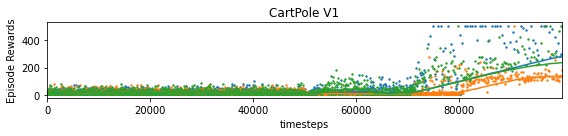

In [14]:
from stable_baselines3.common import results_plotter


# Helper from the library
results_plotter.plot_results(
    logs_dirs, 1e5, results_plotter.X_TIMESTEPS, "CartPole V1"
)

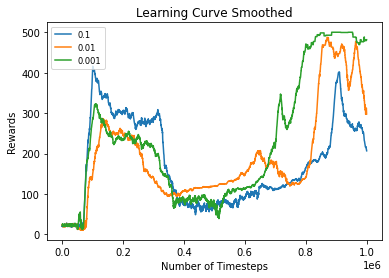

In [15]:
from logging_utils import plot_results


plot_results(logs_dirs_with_tag)